In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns


from sklearn.datasets import make_blobs
from sklearn.metrics import f1_score,accuracy_score
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report
from sklearn.metrics import matthews_corrcoef,cohen_kappa_score,balanced_accuracy_score


import lightgbm as lgb
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb
from catboost import CatBoostClassifier

from modAL.models import ActiveLearner, Committee
from modAL.uncertainty import uncertainty_sampling,margin_sampling,entropy_sampling
from functools import partial
from modAL.batch import uncertainty_batch_sampling

import warnings

warnings.filterwarnings('ignore')

In [2]:
data_source1="./dataset/6903102_all.csv"
data_source2="./dataset/3901890_all.csv"
df1= pd.read_csv(data_source1)
df2=pd.read_csv(data_source2)
data = pd.concat([df1, df2])

In [3]:
row,col=data.shape

In [4]:
#def compute ratio
def comp_ratio(data):
    instance = data[(data['label']==1)]
    rate=len(instance)/len(data)*100
    print(rate)
    return rate

In [5]:
dirty_ratio = comp_ratio(data)
dirty_ratio

12.349058534588622


12.349058534588622

In [6]:
def plotCluster(data,name1,name2,name3,label,start,end):   
    %matplotlib notebook

    data1=data.loc[data[label] == 1]

    x1 = data1.loc[:,[name1]].iloc[start:end, :]  
    y1 = data1.loc[:,[name2]].iloc[start:end, :]  
    z1 = data1.loc[:,[name3]].iloc[start:end, :]  


    data2=data.loc[data[label] == 0]

    x2 = data2.loc[:,[name1]].iloc[start:end, :]  
    y2 = data2.loc[:,[name2]].iloc[start:end, :]  
    z2 = data2.loc[:,[name3]].iloc[start:end, :]  

    fig = plt.figure()
    ax = fig.add_subplot(projection="3d")
    ax.scatter(x1, y1, z1, c='r',s=10, label='Low-quality Data')
    ax.scatter(x2, y2, z2, c='g',s=10, label='Normal Data')
    
    ax.legend(loc='best')

    ax.set_zlabel(name1, fontdict={'size': 15, 'color': 'black'})
    ax.set_ylabel(name2, fontdict={'size': 15, 'color': 'black'})
    ax.set_xlabel(name3, fontdict={'size': 15, 'color': 'black'})
    plt.show()
    plt.savefig('6903102_scatter.png')
    
    #violin
#     fig = px.violin(data, y=name1,color=label)
#     fig.show()
#     fig = px.violin(data, y=name2,color=label)
#     fig.show()
#     fig = px.violin(data, y=name3,color=label)
#     fig.show()
    


<IPython.core.display.Javascript object>


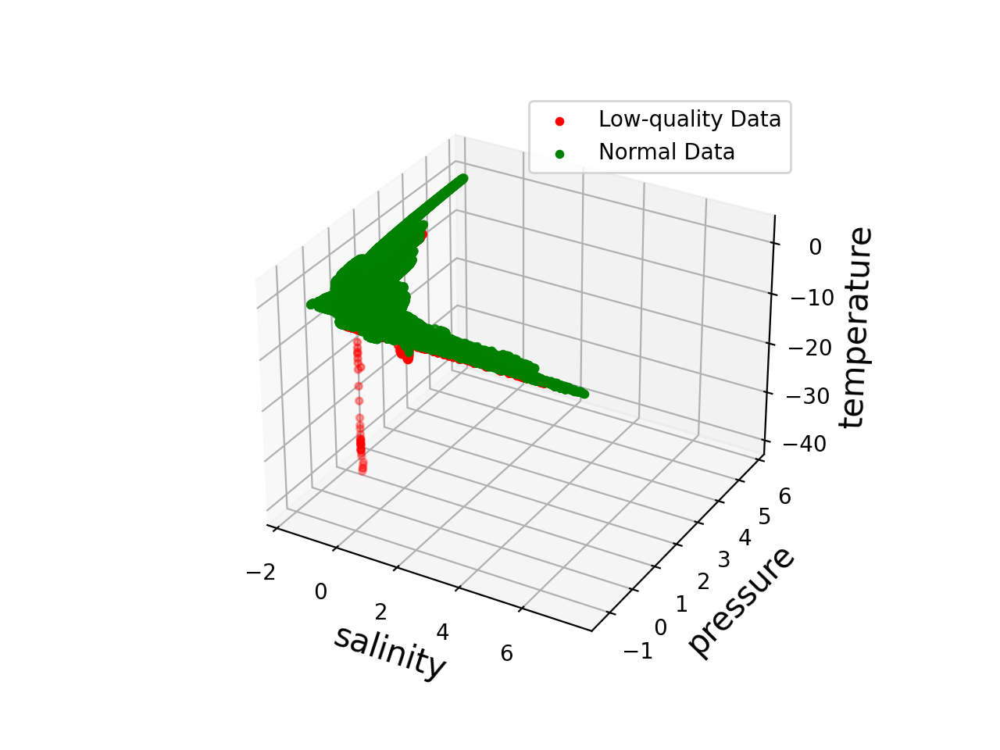

In [7]:
dataplot=data.copy()

plotCluster(dataplot,'temperature','pressure','salinity','label',0,data.shape[0])

# Splite Dataset

In [8]:
train1=pd.read_csv('./randomtrain/6903102.csv')
train2=pd.read_csv('./randomtrain/3901890.csv')
test1=pd.read_csv('./randomtest/6903102.csv')
# test2=pd.read_csv('./randomtest/3901890.csv')
train_set= pd.concat([train1, train2])
test_set= test1
len(train_set),len(test_set)

(300774, 36992)

In [9]:
#train_set2,test_set2=getLastSplit(data,0.3,dirty_ratio)

In [10]:
comp_ratio(train_set)
comp_ratio(test_set)

12.335507723406943
0.29195501730103807


0.29195501730103807

In [11]:
#this function use random grid search to find best parameters
def getPar(model,dist,data,niter):
    import numpy as np
    import pandas as pd
    from sklearn.model_selection import RandomizedSearchCV
    x,y=data.shape

    clf = model

    param_dist = dist
    grid = RandomizedSearchCV(clf,param_dist,cv = 3,scoring = "balanced_accuracy",n_iter=niter,n_jobs = -1)

    #train
    grid.fit(data.iloc[:,0:y-1],data.iloc[:,y-1])
    #get best parameter
    print(grid.best_score_)
    return grid.best_params_

In [12]:
# metric
def computeMetric(y_tru,y_pre):
    acc = accuracy_score(y_tru,y_pre)
    pre=precision_score(y_tru,y_pre)
    recall=recall_score(y_tru,y_pre)
    cm=confusion_matrix(y_tru,y_pre)
    f1 = f1_score(y_tru,y_pre)
    mcc=matthews_corrcoef(y_tru, y_pre)
    kappa=cohen_kappa_score(y_tru, y_pre)
    bac=balanced_accuracy_score(y_tru,y_pre)
    print("acc:",acc)
    print("balanced acc:",bac)
    print("precision:",pre)
    print("recall:",recall)
    print("cm:",cm)
    print("f1:",f1)
    print("MCC:", mcc)
    print("Kappa:",kappa)
    
    # confusion matrix
#     cmap1 = sns.diverging_palette(260,-10,s=50, l=75, n=5, as_cmap=True)
#     plt.subplots(figsize=(12,8))
#     cf_matrix = confusion_matrix(y_tru, y_pre)
#     sns.heatmap(cf_matrix/np.sum(cf_matrix), cmap = cmap1, annot = True, annot_kws = {'size':15})
    
    return kappa

In [13]:
def draw(performance_history):
    fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)
    ax.plot(performance_history)
    ax.scatter(range(len(performance_history)), performance_history, s=13)
    ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=5, integer=True))
    ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=10))
    ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(xmax=1))
    ax.set_ylim(bottom=0, top=1)
    ax.grid(True)
    ax.set_title('Incremental classification accuracy')
    ax.set_xlabel('Query iteration')
    ax.set_ylabel('Classification Accuracy')
    plt.show()

# splite train(pool), test, Labeled, Unlabeled

In [14]:
x,y=train_set.shape
#pool 
X_Pool = train_set.iloc[:,0:y-1].values
y_Pool = train_set.iloc[:,y-1].values

In [15]:
#test set
X_test=test_set.iloc[:,0:y-1]
y_true=test_set.iloc[:,y-1]
print(len(X_test),len(y_true))

36992 36992


In [16]:
#Pool
def initial_data(n_initial,X_Pool,y_Pool):
    #inital
    initial_idx = np.random.choice(range(len(X_Pool)), size=n_initial, replace=False)
    #initial Labeled data
    #X_initial, y_initial = X_train[], y_train[initial_idx]
    X_L = X_Pool[initial_idx]
    y_L = y_Pool[initial_idx]
    # Unlabeled data
    # X_U = Pool_X[ini_num:]
    # y_U = Pool_X[ini_num:]
    X_U, y_U = np.delete(X_Pool, initial_idx, axis=0), np.delete(y_Pool, initial_idx, axis=0)
    return X_L,y_L,X_U,y_U

In [17]:
# Set RNG seed for reproducibility.
RANDOM_STATE_SEED = 123
np.random.seed(RANDOM_STATE_SEED)

#n_initial= 100
n_initial = 1000
N_QUERIES = 200

In [18]:
# X_initial,y_initial,X_re,y_re=initial_data(n_initial,X_Pool,y_Pool)
# df_X_i = pd.DataFrame(X_initial)
# df_y_i = pd.DataFrame(y_initial)
# df_X_r = pd.DataFrame(X_re)
# df_y_r = pd.DataFrame(y_re)


# df_X_i.to_csv('./randomtrain/6903102_X_initial.csv', index=False)
# df_y_i.to_csv('./randomtrain/6903102_y_initial.csv', index=False)
# df_X_r.to_csv('./randomtrain/6903102_X_re.csv', index=False)
# df_y_r.to_csv('./randomtrain/6903102_y_re.csv', index=False)

X_initial1=pd.read_csv('./randomtrain/6903102_X_initial_1.csv').values
y_initial1=pd.read_csv('./randomtrain/6903102_y_initial_1.csv').values.ravel()
X_re1=pd.read_csv('./randomtrain/6903102_X_re_1.csv').values
y_re1=pd.read_csv('./randomtrain/6903102_y_re_1.csv').values.ravel()
X_initial2=pd.read_csv('./randomtrain/3901890_X_initial_1.csv').values
y_initial2=pd.read_csv('./randomtrain/3901890_y_initial_1.csv').values.ravel()
X_re2=pd.read_csv('./randomtrain/3901890_X_re_1.csv').values
y_re2=pd.read_csv('./randomtrain/3901890_y_re_1.csv').values.ravel()

X_initial = np.concatenate((X_initial1, X_initial2), axis=0)
X_re = np.concatenate((X_re1, X_re2), axis=0)
y_initial = np.concatenate((y_initial1, y_initial2), axis=0)
y_re = np.concatenate((y_re1, y_re2), axis=0)

print(X_re.shape,X_initial.shape)
print(y_re.shape,y_initial.shape)

(143818, 6) (1100, 6)
(143818,) (1100,)


# molAL

In [19]:
def random_sampling(classifier, X_pool):
    n_samples = len(X_pool)
    query_idx = np.random.choice(range(n_samples))
    return query_idx, X_pool[query_idx]

In [20]:
def al(clf,strategy,X_L,y_L):

#         learner = ActiveLearner(estimator=clf,
#                                 query_strategy=random_sampling,
#                                 X_training=X_L, y_training=y_L)
#     else:
    learner = ActiveLearner(estimator=clf,
                            query_strategy=strategy,
                            X_training=X_L, y_training=y_L)
    return learner

In [21]:
def al_learn(clf,sampling,X_initial,y_initial,X_re,y_re):
    X_L = X_initial.copy()
    y_L = y_initial.copy()
    X_U,y_U =X_re.copy(),y_re.copy()
    #print(len(X_U),len(y_U))
    learner = al(clf,sampling,X_L,y_L)
    y_pre=learner.predict(X_test)
    unqueried_kappa=cohen_kappa_score(y_true, y_pre)
    unqueried_f1=f1_score(y_true,y_pre)
    #print("unqueried --------------------->",unqueried_score)
    kappa_history = [unqueried_kappa]
    f1_history = [unqueried_f1]
    # Query
    for index in range(N_QUERIES):
        query_index, query_instance = learner.query(X_U)
        # Teach ActiveLearner model the record it has requested.
        X, y = X_U[query_index].reshape(1, -1), y_U[query_index].reshape(1, )
        print(index+1,"query label --------------------->",y)
        learner.teach(X=X, y=y)
        
        X_U, y_U = np.delete(X_U, query_index, axis=0), np.delete(y_U, query_index)
        y_pre=learner.predict(X_test)
        kappa=cohen_kappa_score(y_true, y_pre)
        f1=f1_score(y_true,y_pre)
        print(index+1,"-------------------->",kappa)
        print(index+1,"-------------------->",f1)
        # Recall precision F1
        kappa_history.append(kappa)
        f1_history.append(f1)
    #print(len(X_U))
    df_scores= pd.concat([pd.DataFrame(kappa_history,columns=['kappa']), 
                          pd.DataFrame(f1_history,columns=['f1'])],
                         axis=1)
    return df_scores


In [22]:
# clf1 KNN
clf1 = KNeighborsClassifier()
dic1={'n_neighbors':[1,2,3,4,5,6,7,8]}
para1=getPar(clf1,dic1,test_set,10)
clf1 = KNeighborsClassifier(n_neighbors=para1['n_neighbors'],n_jobs=-1)
clf1.fit(X_Pool, y_Pool)
y_pre=clf1.predict(X_test)
computeMetric(y_true,y_pre)

0.7914633275672771
acc: 0.998378027681661
balanced acc: 0.8099276209296815
precision: 0.7790697674418605
recall: 0.6203703703703703
cm: [[36865    19]
 [   41    67]]
f1: 0.6907216494845362
MCC: 0.6944219632518656
Kappa: 0.6899190150368713


0.6899190150368713

In [23]:
# clf2 lightgbm
clf2 = lgb.LGBMClassifier()

dic2 = {'learning_rate' : [0.01, 0.02, 0.03, 0.04, 0.05, 0.08, 0.1, 0.2, 0.3, 0.4],
              'n_estimators' : [100, 200, 300, 400, 500, 600, 800, 900, 1000, 1500, 2000],
              'num_leaves': range(6, 50), 
              'min_child_samples': range(10, 200, 10), 
              'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
              'max_depth': [-1, 1, 2, 3, 4, 5, 6, 7],
              'reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
              'reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]}
para2=getPar(clf2,dic2,test_set,10)

    
clf2 = lgb.LGBMClassifier(boosting_type='gbdt', num_leaves=para2['num_leaves'], max_depth=-1, 
                              learning_rate=para2['learning_rate'], n_estimators=para2['n_estimators'], 
                              subsample_for_bin=200000, 
                              objective=None, class_weight=None, min_split_gain=0.0, 
                              min_child_weight=para2['min_child_weight'],
                              min_child_samples=para2['min_child_samples'], 
                              subsample=1.0, 
                              subsample_freq=0, colsample_bytree=1.0, reg_alpha=para2['reg_alpha'], 
                              reg_lambda=para2['reg_lambda'], random_state=None, n_jobs=-1, importance_type='split')
clf2.fit(X_Pool, y_Pool)
y_pre=clf2.predict(X_test)
computeMetric(y_true,y_pre)

0.7870370370370369
acc: 0.9986753892733564
balanced acc: 0.7777642217643302
precision: 0.9836065573770492
recall: 0.5555555555555556
cm: [[36883     1]
 [   48    60]]
f1: 0.7100591715976332
MCC: 0.738714686346299
Kappa: 0.7094468004344654


0.7094468004344654

In [24]:
#XGBOOST
clf3 = xgb.XGBClassifier()
dic3 = {'n_estimators':range(80,2000,4),
        'max_depth':range(2,15,1),
        'learning_rate':np.linspace(0.01,2,20),
        'subsample':np.linspace(0.7,0.9,20),
        'colsample_bytree':np.linspace(0.5,0.98,10)
        }
para3=getPar(clf3,dic3,test_set,10)
clf3 = xgb.XGBClassifier(n_estimators=para3['n_estimators'], learning_rate=para3['learning_rate'],
                    max_depth=para3['max_depth'],subsample=para3['subsample'],
                    colsample_bytree=para3['colsample_bytree'],n_jobs=-1)
clf3.fit(X_Pool, y_Pool)
y_pre=clf3.predict(X_test)
computeMetric(y_true,y_pre)

0.805541999909629
acc: 0.9804282006920415
balanced acc: 0.49164949571629973
precision: 0.0
recall: 0.0
cm: [[36268   616]
 [  108     0]]
f1: 0.0
MCC: -0.007041671427918936
Kappa: -0.004992879323139521


-0.004992879323139521

In [25]:
#clf4 catboost
clf4 = CatBoostClassifier(loss_function='Logloss')
# dic4 = {'learning_rate': [0.03, 0.1],
#         'depth': [4, 6, 10],
#         'l2_leaf_reg': [1, 3, 5, 7, 9]}
# #para3=getPar(clf4,dic4,test_set,10)

# grid_search_result = clf4.grid_search(dic4, 
#                                        X=X_Pool, 
#                                        y=y_Pool)

clf4.fit(X_Pool, y_Pool)
y_pre=clf4.predict(X_test)
computeMetric(y_true,y_pre)

Learning rate set to 0.117799
0:	learn: 0.3970787	total: 85.4ms	remaining: 1m 25s
1:	learn: 0.2390307	total: 109ms	remaining: 54.6s
2:	learn: 0.1491569	total: 131ms	remaining: 43.5s
3:	learn: 0.0947699	total: 153ms	remaining: 38s
4:	learn: 0.0668289	total: 175ms	remaining: 34.8s
5:	learn: 0.0489476	total: 195ms	remaining: 32.2s
6:	learn: 0.0376216	total: 218ms	remaining: 30.9s
7:	learn: 0.0310605	total: 238ms	remaining: 29.5s
8:	learn: 0.0260345	total: 259ms	remaining: 28.5s
9:	learn: 0.0230725	total: 281ms	remaining: 27.8s
10:	learn: 0.0208750	total: 306ms	remaining: 27.6s
11:	learn: 0.0193841	total: 330ms	remaining: 27.2s
12:	learn: 0.0181854	total: 354ms	remaining: 26.9s
13:	learn: 0.0172009	total: 377ms	remaining: 26.5s
14:	learn: 0.0161469	total: 398ms	remaining: 26.1s
15:	learn: 0.0153752	total: 419ms	remaining: 25.8s
16:	learn: 0.0144734	total: 442ms	remaining: 25.6s
17:	learn: 0.0140854	total: 464ms	remaining: 25.3s
18:	learn: 0.0136824	total: 488ms	remaining: 25.2s
19:	learn: 

161:	learn: 0.0080063	total: 3.69s	remaining: 19.1s
162:	learn: 0.0080063	total: 3.71s	remaining: 19s
163:	learn: 0.0080063	total: 3.73s	remaining: 19s
164:	learn: 0.0080063	total: 3.74s	remaining: 18.9s
165:	learn: 0.0080063	total: 3.76s	remaining: 18.9s
166:	learn: 0.0080062	total: 3.78s	remaining: 18.9s
167:	learn: 0.0080062	total: 3.8s	remaining: 18.8s
168:	learn: 0.0080062	total: 3.81s	remaining: 18.8s
169:	learn: 0.0080062	total: 3.83s	remaining: 18.7s
170:	learn: 0.0080062	total: 3.85s	remaining: 18.7s
171:	learn: 0.0080062	total: 3.86s	remaining: 18.6s
172:	learn: 0.0080062	total: 3.88s	remaining: 18.5s
173:	learn: 0.0080062	total: 3.9s	remaining: 18.5s
174:	learn: 0.0080062	total: 3.92s	remaining: 18.5s
175:	learn: 0.0080062	total: 3.93s	remaining: 18.4s
176:	learn: 0.0080062	total: 3.95s	remaining: 18.4s
177:	learn: 0.0080062	total: 3.97s	remaining: 18.3s
178:	learn: 0.0080062	total: 3.99s	remaining: 18.3s
179:	learn: 0.0080062	total: 4.01s	remaining: 18.3s
180:	learn: 0.0080

323:	learn: 0.0078049	total: 6.87s	remaining: 14.3s
324:	learn: 0.0078049	total: 6.89s	remaining: 14.3s
325:	learn: 0.0078049	total: 6.91s	remaining: 14.3s
326:	learn: 0.0078049	total: 6.93s	remaining: 14.3s
327:	learn: 0.0078049	total: 6.95s	remaining: 14.2s
328:	learn: 0.0078049	total: 6.97s	remaining: 14.2s
329:	learn: 0.0078049	total: 6.98s	remaining: 14.2s
330:	learn: 0.0078049	total: 7s	remaining: 14.2s
331:	learn: 0.0078049	total: 7.02s	remaining: 14.1s
332:	learn: 0.0078049	total: 7.04s	remaining: 14.1s
333:	learn: 0.0078049	total: 7.06s	remaining: 14.1s
334:	learn: 0.0078049	total: 7.08s	remaining: 14s
335:	learn: 0.0078049	total: 7.09s	remaining: 14s
336:	learn: 0.0078049	total: 7.11s	remaining: 14s
337:	learn: 0.0078048	total: 7.13s	remaining: 14s
338:	learn: 0.0078048	total: 7.14s	remaining: 13.9s
339:	learn: 0.0078048	total: 7.16s	remaining: 13.9s
340:	learn: 0.0078047	total: 7.18s	remaining: 13.9s
341:	learn: 0.0078047	total: 7.22s	remaining: 13.9s
342:	learn: 0.0078047	t

490:	learn: 0.0078047	total: 10.3s	remaining: 10.6s
491:	learn: 0.0078047	total: 10.3s	remaining: 10.6s
492:	learn: 0.0078047	total: 10.3s	remaining: 10.6s
493:	learn: 0.0078047	total: 10.3s	remaining: 10.6s
494:	learn: 0.0078047	total: 10.3s	remaining: 10.5s
495:	learn: 0.0078047	total: 10.4s	remaining: 10.5s
496:	learn: 0.0078047	total: 10.4s	remaining: 10.5s
497:	learn: 0.0078047	total: 10.4s	remaining: 10.5s
498:	learn: 0.0078047	total: 10.4s	remaining: 10.5s
499:	learn: 0.0078047	total: 10.4s	remaining: 10.4s
500:	learn: 0.0078047	total: 10.4s	remaining: 10.4s
501:	learn: 0.0078047	total: 10.5s	remaining: 10.4s
502:	learn: 0.0078047	total: 10.5s	remaining: 10.4s
503:	learn: 0.0078047	total: 10.5s	remaining: 10.3s
504:	learn: 0.0078047	total: 10.5s	remaining: 10.3s
505:	learn: 0.0078047	total: 10.5s	remaining: 10.3s
506:	learn: 0.0078047	total: 10.6s	remaining: 10.3s
507:	learn: 0.0078047	total: 10.6s	remaining: 10.2s
508:	learn: 0.0078047	total: 10.6s	remaining: 10.2s
509:	learn: 

660:	learn: 0.0078047	total: 13.4s	remaining: 6.88s
661:	learn: 0.0078047	total: 13.4s	remaining: 6.86s
662:	learn: 0.0078047	total: 13.5s	remaining: 6.84s
663:	learn: 0.0078047	total: 13.5s	remaining: 6.82s
664:	learn: 0.0078047	total: 13.5s	remaining: 6.79s
665:	learn: 0.0078047	total: 13.5s	remaining: 6.78s
666:	learn: 0.0078047	total: 13.5s	remaining: 6.75s
667:	learn: 0.0078047	total: 13.5s	remaining: 6.73s
668:	learn: 0.0078047	total: 13.6s	remaining: 6.71s
669:	learn: 0.0078047	total: 13.6s	remaining: 6.69s
670:	learn: 0.0078047	total: 13.6s	remaining: 6.67s
671:	learn: 0.0078047	total: 13.6s	remaining: 6.64s
672:	learn: 0.0078047	total: 13.6s	remaining: 6.62s
673:	learn: 0.0078047	total: 13.7s	remaining: 6.6s
674:	learn: 0.0078047	total: 13.7s	remaining: 6.58s
675:	learn: 0.0078047	total: 13.7s	remaining: 6.56s
676:	learn: 0.0078047	total: 13.7s	remaining: 6.54s
677:	learn: 0.0078047	total: 13.7s	remaining: 6.52s
678:	learn: 0.0078047	total: 13.7s	remaining: 6.5s
679:	learn: 0.

825:	learn: 0.0078047	total: 16.4s	remaining: 3.44s
826:	learn: 0.0078047	total: 16.4s	remaining: 3.42s
827:	learn: 0.0078047	total: 16.4s	remaining: 3.4s
828:	learn: 0.0078047	total: 16.4s	remaining: 3.38s
829:	learn: 0.0078047	total: 16.4s	remaining: 3.37s
830:	learn: 0.0078047	total: 16.4s	remaining: 3.34s
831:	learn: 0.0078047	total: 16.5s	remaining: 3.32s
832:	learn: 0.0078047	total: 16.5s	remaining: 3.3s
833:	learn: 0.0078047	total: 16.5s	remaining: 3.28s
834:	learn: 0.0078047	total: 16.5s	remaining: 3.26s
835:	learn: 0.0078047	total: 16.5s	remaining: 3.24s
836:	learn: 0.0078047	total: 16.6s	remaining: 3.22s
837:	learn: 0.0078047	total: 16.6s	remaining: 3.2s
838:	learn: 0.0078047	total: 16.6s	remaining: 3.18s
839:	learn: 0.0078047	total: 16.6s	remaining: 3.16s
840:	learn: 0.0078047	total: 16.6s	remaining: 3.14s
841:	learn: 0.0078047	total: 16.6s	remaining: 3.12s
842:	learn: 0.0078047	total: 16.7s	remaining: 3.1s
843:	learn: 0.0078047	total: 16.7s	remaining: 3.08s
844:	learn: 0.00

984:	learn: 0.0078047	total: 19.3s	remaining: 293ms
985:	learn: 0.0078047	total: 19.3s	remaining: 274ms
986:	learn: 0.0078047	total: 19.3s	remaining: 254ms
987:	learn: 0.0078047	total: 19.3s	remaining: 235ms
988:	learn: 0.0078047	total: 19.3s	remaining: 215ms
989:	learn: 0.0078047	total: 19.3s	remaining: 195ms
990:	learn: 0.0078047	total: 19.4s	remaining: 176ms
991:	learn: 0.0078047	total: 19.4s	remaining: 156ms
992:	learn: 0.0078047	total: 19.4s	remaining: 137ms
993:	learn: 0.0078047	total: 19.4s	remaining: 117ms
994:	learn: 0.0078047	total: 19.4s	remaining: 97.6ms
995:	learn: 0.0078047	total: 19.4s	remaining: 78.1ms
996:	learn: 0.0078047	total: 19.5s	remaining: 58.5ms
997:	learn: 0.0078047	total: 19.5s	remaining: 39ms
998:	learn: 0.0078047	total: 19.5s	remaining: 19.5ms
999:	learn: 0.0078047	total: 19.5s	remaining: 0us
acc: 0.9987564878892734
balanced acc: 0.7916531106532192
precision: 0.984375
recall: 0.5833333333333334
cm: [[36883     1]
 [   45    63]]
f1: 0.7325581395348837
MCC: 

0.7319758064516129

## random sampling

In [26]:
sampling=random_sampling

In [27]:
metric01 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)

1 query label ---------------------> [0]
1 --------------------> 0.33780718903094953
1 --------------------> 0.3384615384615384
2 query label ---------------------> [0]
2 --------------------> 0.33780718903094953
2 --------------------> 0.3384615384615384
3 query label ---------------------> [1]
3 --------------------> 0.33780718903094953
3 --------------------> 0.3384615384615384
4 query label ---------------------> [1]
4 --------------------> 0.33780718903094953
4 --------------------> 0.3384615384615384
5 query label ---------------------> [0]
5 --------------------> 0.33780718903094953
5 --------------------> 0.3384615384615384
6 query label ---------------------> [0]
6 --------------------> 0.33780718903094953
6 --------------------> 0.3384615384615384
7 query label ---------------------> [1]
7 --------------------> 0.33780718903094953
7 --------------------> 0.3384615384615384
8 query label ---------------------> [0]
8 --------------------> 0.33780718903094953
8 -----------------

64 --------------------> 0.33780718903094953
64 --------------------> 0.3384615384615384
65 query label ---------------------> [0]
65 --------------------> 0.33780718903094953
65 --------------------> 0.3384615384615384
66 query label ---------------------> [1]
66 --------------------> 0.33780718903094953
66 --------------------> 0.3384615384615384
67 query label ---------------------> [0]
67 --------------------> 0.33780718903094953
67 --------------------> 0.3384615384615384
68 query label ---------------------> [0]
68 --------------------> 0.33780718903094953
68 --------------------> 0.3384615384615384
69 query label ---------------------> [0]
69 --------------------> 0.33780718903094953
69 --------------------> 0.3384615384615384
70 query label ---------------------> [0]
70 --------------------> 0.33780718903094953
70 --------------------> 0.3384615384615384
71 query label ---------------------> [0]
71 --------------------> 0.33780718903094953
71 --------------------> 0.33846153846

126 --------------------> 0.33780718903094953
126 --------------------> 0.3384615384615384
127 query label ---------------------> [0]
127 --------------------> 0.33780718903094953
127 --------------------> 0.3384615384615384
128 query label ---------------------> [0]
128 --------------------> 0.33780718903094953
128 --------------------> 0.3384615384615384
129 query label ---------------------> [0]
129 --------------------> 0.33780718903094953
129 --------------------> 0.3384615384615384
130 query label ---------------------> [1]
130 --------------------> 0.33780718903094953
130 --------------------> 0.3384615384615384
131 query label ---------------------> [0]
131 --------------------> 0.33780718903094953
131 --------------------> 0.3384615384615384
132 query label ---------------------> [1]
132 --------------------> 0.33780718903094953
132 --------------------> 0.3384615384615384
133 query label ---------------------> [0]
133 --------------------> 0.33780718903094953
133 ------------

188 --------------------> 0.33780718903094953
188 --------------------> 0.3384615384615384
189 query label ---------------------> [0]
189 --------------------> 0.33780718903094953
189 --------------------> 0.3384615384615384
190 query label ---------------------> [0]
190 --------------------> 0.33780718903094953
190 --------------------> 0.3384615384615384
191 query label ---------------------> [0]
191 --------------------> 0.33780718903094953
191 --------------------> 0.3384615384615384
192 query label ---------------------> [1]
192 --------------------> 0.33780718903094953
192 --------------------> 0.3384615384615384
193 query label ---------------------> [0]
193 --------------------> 0.33780718903094953
193 --------------------> 0.3384615384615384
194 query label ---------------------> [0]
194 --------------------> 0.33780718903094953
194 --------------------> 0.3384615384615384
195 query label ---------------------> [0]
195 --------------------> 0.33780718903094953
195 ------------

In [28]:
metric02 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)

1 query label ---------------------> [0]
1 --------------------> 0.0712348874039167
1 --------------------> 0.07142857142857142
2 query label ---------------------> [0]
2 --------------------> 0.0712348874039167
2 --------------------> 0.07142857142857142
3 query label ---------------------> [0]
3 --------------------> 0.0712348874039167
3 --------------------> 0.07142857142857142
4 query label ---------------------> [0]
4 --------------------> 0.0
4 --------------------> 0.0
5 query label ---------------------> [0]
5 --------------------> 0.0712348874039167
5 --------------------> 0.07142857142857142
6 query label ---------------------> [0]
6 --------------------> 0.0712348874039167
6 --------------------> 0.07142857142857142
7 query label ---------------------> [0]
7 --------------------> 0.0712348874039167
7 --------------------> 0.07142857142857142
8 query label ---------------------> [0]
8 --------------------> 0.0712348874039167
8 --------------------> 0.07142857142857142
9 query

77 --------------------> 0.0
77 --------------------> 0.0
78 query label ---------------------> [0]
78 --------------------> 0.0
78 --------------------> 0.0
79 query label ---------------------> [1]
79 --------------------> 0.0
79 --------------------> 0.0
80 query label ---------------------> [0]
80 --------------------> 0.0
80 --------------------> 0.0
81 query label ---------------------> [1]
81 --------------------> 0.0
81 --------------------> 0.0
82 query label ---------------------> [1]
82 --------------------> 0.0
82 --------------------> 0.0
83 query label ---------------------> [0]
83 --------------------> 0.0
83 --------------------> 0.0
84 query label ---------------------> [0]
84 --------------------> 0.0
84 --------------------> 0.0
85 query label ---------------------> [0]
85 --------------------> 0.0
85 --------------------> 0.0
86 query label ---------------------> [1]
86 --------------------> 0.0
86 --------------------> 0.0
87 query label ---------------------> [0]


158 --------------------> 0.0
158 --------------------> 0.0
159 query label ---------------------> [0]
159 --------------------> 0.0
159 --------------------> 0.0
160 query label ---------------------> [0]
160 --------------------> 0.0
160 --------------------> 0.0
161 query label ---------------------> [0]
161 --------------------> 0.0
161 --------------------> 0.0
162 query label ---------------------> [1]
162 --------------------> 0.0
162 --------------------> 0.0
163 query label ---------------------> [0]
163 --------------------> 0.03626132060261189
163 --------------------> 0.03636363636363636
164 query label ---------------------> [1]
164 --------------------> 0.0
164 --------------------> 0.0
165 query label ---------------------> [0]
165 --------------------> -5.357259781457735e-05
165 --------------------> 0.0
166 query label ---------------------> [1]
166 --------------------> 0.0
166 --------------------> 0.0
167 query label ---------------------> [1]
167 ------------------

In [29]:
metric03 = al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)

1 query label ---------------------> [1]
1 --------------------> 0.15080215070577985
1 --------------------> 0.15126050420168063
2 query label ---------------------> [0]
2 --------------------> 0.1273069790716157
2 --------------------> 0.128
3 query label ---------------------> [0]
3 --------------------> 0.27142142289465165
3 --------------------> 0.272
4 query label ---------------------> [0]
4 --------------------> 0.052852633251464054
4 --------------------> 0.05309734513274336
5 query label ---------------------> [1]
5 --------------------> 0.08299876152614649
5 --------------------> 0.08484848484848484
6 query label ---------------------> [1]
6 --------------------> 0.0698895960711533
6 --------------------> 0.07017543859649122
7 query label ---------------------> [0]
7 --------------------> 0.3548020804765273
7 --------------------> 0.3555555555555555
8 query label ---------------------> [0]
8 --------------------> 0.05337401985399193
8 --------------------> 0.05357142857142857

64 --------------------> 0.06271021647787978
64 --------------------> 0.06349206349206349
65 query label ---------------------> [0]
65 --------------------> 0.08279776974732944
65 --------------------> 0.08333333333333333
66 query label ---------------------> [1]
66 --------------------> 0.17679912871065928
66 --------------------> 0.17741935483870966
67 query label ---------------------> [0]
67 --------------------> 0.11569530824001717
67 --------------------> 0.11678832116788321
68 query label ---------------------> [0]
68 --------------------> 0.30761235060745584
68 --------------------> 0.3087248322147651
69 query label ---------------------> [0]
69 --------------------> 0.25993014300912276
69 --------------------> 0.2608695652173913
70 query label ---------------------> [1]
70 --------------------> 0.05085573215722172
70 --------------------> 0.05128205128205128
71 query label ---------------------> [0]
71 --------------------> 0.06494722838137468
71 --------------------> 0.065573

126 --------------------> 0.3989357761747485
126 --------------------> 0.4
127 query label ---------------------> [1]
127 --------------------> 0.09132335404481606
127 --------------------> 0.09454545454545456
128 query label ---------------------> [0]
128 --------------------> 0.11289427917238393
128 --------------------> 0.11538461538461538
129 query label ---------------------> [0]
129 --------------------> 0.10945827332611824
129 --------------------> 0.11023622047244094
130 query label ---------------------> [0]
130 --------------------> 0.05206158602391242
130 --------------------> 0.05434782608695652
131 query label ---------------------> [1]
131 --------------------> 0.39885921054769813
131 --------------------> 0.4
132 query label ---------------------> [0]
132 --------------------> 0.0021482857355455964
132 --------------------> 0.007943600436898025
133 query label ---------------------> [0]
133 --------------------> 0.052852633251464054
133 --------------------> 0.0530973451

188 --------------------> 0.3499540099691927
188 --------------------> 0.35185185185185186
189 query label ---------------------> [1]
189 --------------------> -0.004414215864184889
189 --------------------> 0.0012523481527864746
190 query label ---------------------> [0]
190 --------------------> 0.014256605681819967
190 --------------------> 0.015267175572519082
191 query label ---------------------> [0]
191 --------------------> 0.1853820581163823
191 --------------------> 0.1871345029239766
192 query label ---------------------> [0]
192 --------------------> 0.3523672610805154
192 --------------------> 0.3536585365853659
193 query label ---------------------> [1]
193 --------------------> 0.24687325875444688
193 --------------------> 0.2485875706214689
194 query label ---------------------> [0]
194 --------------------> 0.03842787949155624
194 --------------------> 0.04
195 query label ---------------------> [0]
195 --------------------> 0.11129426309127843
195 --------------------

In [30]:
metric04 = al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)

Learning rate set to 0.01073
0:	learn: 0.6663487	total: 2.87ms	remaining: 2.86s
1:	learn: 0.6408137	total: 4.35ms	remaining: 2.17s
2:	learn: 0.6235689	total: 5.78ms	remaining: 1.92s
3:	learn: 0.6027015	total: 7.28ms	remaining: 1.81s
4:	learn: 0.5823524	total: 8.98ms	remaining: 1.79s
5:	learn: 0.5624096	total: 10.5ms	remaining: 1.75s
6:	learn: 0.5448767	total: 12.1ms	remaining: 1.71s
7:	learn: 0.5270949	total: 13.7ms	remaining: 1.7s
8:	learn: 0.5094343	total: 15.2ms	remaining: 1.68s
9:	learn: 0.4938966	total: 16.6ms	remaining: 1.65s
10:	learn: 0.4803033	total: 18.1ms	remaining: 1.63s
11:	learn: 0.4618191	total: 19.5ms	remaining: 1.61s
12:	learn: 0.4453784	total: 21.2ms	remaining: 1.61s
13:	learn: 0.4334373	total: 22.5ms	remaining: 1.59s
14:	learn: 0.4219514	total: 24.1ms	remaining: 1.58s
15:	learn: 0.4057484	total: 25.6ms	remaining: 1.57s
16:	learn: 0.3904853	total: 27.2ms	remaining: 1.57s
17:	learn: 0.3775197	total: 28.6ms	remaining: 1.56s
18:	learn: 0.3659289	total: 30.1ms	remaining: 

213:	learn: 0.0180626	total: 339ms	remaining: 1.25s
214:	learn: 0.0179611	total: 341ms	remaining: 1.25s
215:	learn: 0.0178248	total: 343ms	remaining: 1.25s
216:	learn: 0.0177221	total: 345ms	remaining: 1.24s
217:	learn: 0.0176723	total: 347ms	remaining: 1.24s
218:	learn: 0.0176178	total: 348ms	remaining: 1.24s
219:	learn: 0.0175143	total: 350ms	remaining: 1.24s
220:	learn: 0.0174446	total: 351ms	remaining: 1.24s
221:	learn: 0.0173833	total: 352ms	remaining: 1.23s
222:	learn: 0.0172831	total: 354ms	remaining: 1.23s
223:	learn: 0.0172353	total: 355ms	remaining: 1.23s
224:	learn: 0.0171778	total: 356ms	remaining: 1.23s
225:	learn: 0.0170490	total: 357ms	remaining: 1.22s
226:	learn: 0.0169250	total: 359ms	remaining: 1.22s
227:	learn: 0.0168796	total: 360ms	remaining: 1.22s
228:	learn: 0.0168209	total: 361ms	remaining: 1.22s
229:	learn: 0.0166933	total: 362ms	remaining: 1.21s
230:	learn: 0.0166345	total: 364ms	remaining: 1.21s
231:	learn: 0.0165731	total: 365ms	remaining: 1.21s
232:	learn: 

501:	learn: 0.0071266	total: 701ms	remaining: 696ms
502:	learn: 0.0071096	total: 703ms	remaining: 694ms
503:	learn: 0.0070869	total: 704ms	remaining: 693ms
504:	learn: 0.0070791	total: 705ms	remaining: 691ms
505:	learn: 0.0070752	total: 707ms	remaining: 690ms
506:	learn: 0.0070632	total: 708ms	remaining: 688ms
507:	learn: 0.0070448	total: 709ms	remaining: 687ms
508:	learn: 0.0070076	total: 710ms	remaining: 685ms
509:	learn: 0.0069863	total: 712ms	remaining: 684ms
510:	learn: 0.0069726	total: 713ms	remaining: 682ms
511:	learn: 0.0069479	total: 714ms	remaining: 681ms
512:	learn: 0.0069429	total: 715ms	remaining: 679ms
513:	learn: 0.0069381	total: 717ms	remaining: 678ms
514:	learn: 0.0069039	total: 718ms	remaining: 676ms
515:	learn: 0.0068838	total: 719ms	remaining: 674ms
516:	learn: 0.0068640	total: 720ms	remaining: 673ms
517:	learn: 0.0068408	total: 722ms	remaining: 671ms
518:	learn: 0.0068384	total: 723ms	remaining: 670ms
519:	learn: 0.0068190	total: 724ms	remaining: 668ms
520:	learn: 

670:	learn: 0.0048987	total: 914ms	remaining: 448ms
671:	learn: 0.0048904	total: 916ms	remaining: 447ms
672:	learn: 0.0048837	total: 917ms	remaining: 446ms
673:	learn: 0.0048658	total: 918ms	remaining: 444ms
674:	learn: 0.0048536	total: 920ms	remaining: 443ms
675:	learn: 0.0048410	total: 921ms	remaining: 441ms
676:	learn: 0.0048335	total: 922ms	remaining: 440ms
677:	learn: 0.0048181	total: 923ms	remaining: 438ms
678:	learn: 0.0048079	total: 924ms	remaining: 437ms
679:	learn: 0.0047988	total: 926ms	remaining: 436ms
680:	learn: 0.0047776	total: 927ms	remaining: 434ms
681:	learn: 0.0047629	total: 928ms	remaining: 433ms
682:	learn: 0.0047510	total: 930ms	remaining: 432ms
683:	learn: 0.0047374	total: 931ms	remaining: 430ms
684:	learn: 0.0047350	total: 932ms	remaining: 429ms
685:	learn: 0.0047298	total: 933ms	remaining: 427ms
686:	learn: 0.0047227	total: 935ms	remaining: 426ms
687:	learn: 0.0047091	total: 936ms	remaining: 424ms
688:	learn: 0.0047078	total: 937ms	remaining: 423ms
689:	learn: 

923:	learn: 0.0030326	total: 1.27s	remaining: 105ms
924:	learn: 0.0030281	total: 1.27s	remaining: 103ms
925:	learn: 0.0030223	total: 1.27s	remaining: 102ms
926:	learn: 0.0030210	total: 1.28s	remaining: 101ms
927:	learn: 0.0030196	total: 1.28s	remaining: 99.2ms
928:	learn: 0.0030128	total: 1.28s	remaining: 97.9ms
929:	learn: 0.0030074	total: 1.28s	remaining: 96.5ms
930:	learn: 0.0030012	total: 1.28s	remaining: 95.1ms
931:	learn: 0.0029955	total: 1.28s	remaining: 93.8ms
932:	learn: 0.0029899	total: 1.29s	remaining: 92.4ms
933:	learn: 0.0029889	total: 1.29s	remaining: 91ms
934:	learn: 0.0029830	total: 1.29s	remaining: 89.6ms
935:	learn: 0.0029782	total: 1.29s	remaining: 88.2ms
936:	learn: 0.0029761	total: 1.29s	remaining: 86.8ms
937:	learn: 0.0029717	total: 1.29s	remaining: 85.5ms
938:	learn: 0.0029704	total: 1.29s	remaining: 84.1ms
939:	learn: 0.0029643	total: 1.29s	remaining: 82.7ms
940:	learn: 0.0029584	total: 1.3s	remaining: 81.3ms
941:	learn: 0.0029527	total: 1.3s	remaining: 79.9ms
9

169:	learn: 0.0233752	total: 215ms	remaining: 1.05s
170:	learn: 0.0232593	total: 217ms	remaining: 1.05s
171:	learn: 0.0231135	total: 218ms	remaining: 1.05s
172:	learn: 0.0229518	total: 219ms	remaining: 1.05s
173:	learn: 0.0228463	total: 221ms	remaining: 1.05s
174:	learn: 0.0226611	total: 222ms	remaining: 1.05s
175:	learn: 0.0225336	total: 224ms	remaining: 1.05s
176:	learn: 0.0223245	total: 225ms	remaining: 1.05s
177:	learn: 0.0221248	total: 226ms	remaining: 1.04s
178:	learn: 0.0220136	total: 228ms	remaining: 1.04s
179:	learn: 0.0219192	total: 229ms	remaining: 1.04s
180:	learn: 0.0218327	total: 230ms	remaining: 1.04s
181:	learn: 0.0216386	total: 232ms	remaining: 1.04s
182:	learn: 0.0214840	total: 233ms	remaining: 1.04s
183:	learn: 0.0213718	total: 234ms	remaining: 1.04s
184:	learn: 0.0212301	total: 236ms	remaining: 1.04s
185:	learn: 0.0210376	total: 237ms	remaining: 1.04s
186:	learn: 0.0209130	total: 238ms	remaining: 1.04s
187:	learn: 0.0208532	total: 241ms	remaining: 1.04s
188:	learn: 

331:	learn: 0.0120129	total: 429ms	remaining: 863ms
332:	learn: 0.0119887	total: 431ms	remaining: 863ms
333:	learn: 0.0119213	total: 432ms	remaining: 862ms
334:	learn: 0.0119016	total: 433ms	remaining: 860ms
335:	learn: 0.0118744	total: 435ms	remaining: 859ms
336:	learn: 0.0118501	total: 436ms	remaining: 857ms
337:	learn: 0.0117895	total: 437ms	remaining: 856ms
338:	learn: 0.0117292	total: 438ms	remaining: 855ms
339:	learn: 0.0116830	total: 440ms	remaining: 853ms
340:	learn: 0.0116344	total: 441ms	remaining: 852ms
341:	learn: 0.0116172	total: 442ms	remaining: 850ms
342:	learn: 0.0115996	total: 443ms	remaining: 849ms
343:	learn: 0.0115795	total: 444ms	remaining: 848ms
344:	learn: 0.0115309	total: 446ms	remaining: 846ms
345:	learn: 0.0114988	total: 447ms	remaining: 845ms
346:	learn: 0.0114779	total: 448ms	remaining: 843ms
347:	learn: 0.0114198	total: 449ms	remaining: 842ms
348:	learn: 0.0113880	total: 451ms	remaining: 840ms
349:	learn: 0.0113553	total: 452ms	remaining: 839ms
350:	learn: 

618:	learn: 0.0052462	total: 783ms	remaining: 482ms
619:	learn: 0.0052283	total: 785ms	remaining: 481ms
620:	learn: 0.0052239	total: 786ms	remaining: 480ms
621:	learn: 0.0052003	total: 788ms	remaining: 479ms
622:	learn: 0.0051779	total: 789ms	remaining: 477ms
623:	learn: 0.0051648	total: 790ms	remaining: 476ms
624:	learn: 0.0051420	total: 791ms	remaining: 475ms
625:	learn: 0.0051381	total: 793ms	remaining: 474ms
626:	learn: 0.0051221	total: 794ms	remaining: 472ms
627:	learn: 0.0051187	total: 795ms	remaining: 471ms
628:	learn: 0.0051053	total: 796ms	remaining: 470ms
629:	learn: 0.0050914	total: 798ms	remaining: 468ms
630:	learn: 0.0050669	total: 799ms	remaining: 467ms
631:	learn: 0.0050554	total: 800ms	remaining: 466ms
632:	learn: 0.0050526	total: 801ms	remaining: 465ms
633:	learn: 0.0050360	total: 803ms	remaining: 463ms
634:	learn: 0.0050318	total: 804ms	remaining: 462ms
635:	learn: 0.0050256	total: 805ms	remaining: 461ms
636:	learn: 0.0050242	total: 806ms	remaining: 459ms
637:	learn: 

788:	learn: 0.0036977	total: 997ms	remaining: 267ms
789:	learn: 0.0036894	total: 999ms	remaining: 266ms
790:	learn: 0.0036827	total: 1s	remaining: 264ms
791:	learn: 0.0036784	total: 1s	remaining: 263ms
792:	learn: 0.0036752	total: 1s	remaining: 262ms
793:	learn: 0.0036650	total: 1s	remaining: 260ms
794:	learn: 0.0036572	total: 1s	remaining: 259ms
795:	learn: 0.0036504	total: 1.01s	remaining: 258ms
796:	learn: 0.0036351	total: 1.01s	remaining: 257ms
797:	learn: 0.0036275	total: 1.01s	remaining: 255ms
798:	learn: 0.0036256	total: 1.01s	remaining: 254ms
799:	learn: 0.0036166	total: 1.01s	remaining: 253ms
800:	learn: 0.0036102	total: 1.01s	remaining: 252ms
801:	learn: 0.0036083	total: 1.01s	remaining: 250ms
802:	learn: 0.0036045	total: 1.01s	remaining: 249ms
803:	learn: 0.0035965	total: 1.02s	remaining: 248ms
804:	learn: 0.0035941	total: 1.02s	remaining: 246ms
805:	learn: 0.0035861	total: 1.02s	remaining: 245ms
806:	learn: 0.0035788	total: 1.02s	remaining: 244ms
807:	learn: 0.0035759	total

3:	learn: 0.6025308	total: 5.74ms	remaining: 1.43s
4:	learn: 0.5821182	total: 7.27ms	remaining: 1.45s
5:	learn: 0.5621123	total: 8.57ms	remaining: 1.42s
6:	learn: 0.5445890	total: 9.81ms	remaining: 1.39s
7:	learn: 0.5267813	total: 11.1ms	remaining: 1.37s
8:	learn: 0.5091042	total: 12.3ms	remaining: 1.35s
9:	learn: 0.4935531	total: 13.6ms	remaining: 1.35s
10:	learn: 0.4799566	total: 14.9ms	remaining: 1.34s
11:	learn: 0.4613467	total: 16.2ms	remaining: 1.33s
12:	learn: 0.4448871	total: 17.5ms	remaining: 1.32s
13:	learn: 0.4329235	total: 18.7ms	remaining: 1.31s
14:	learn: 0.4214518	total: 19.8ms	remaining: 1.3s
15:	learn: 0.4053103	total: 21ms	remaining: 1.29s
16:	learn: 0.3899458	total: 22.2ms	remaining: 1.28s
17:	learn: 0.3767493	total: 23.4ms	remaining: 1.28s
18:	learn: 0.3657854	total: 24.5ms	remaining: 1.26s
19:	learn: 0.3538779	total: 25.7ms	remaining: 1.26s
20:	learn: 0.3415374	total: 26.9ms	remaining: 1.25s
21:	learn: 0.3296026	total: 28ms	remaining: 1.25s
22:	learn: 0.3179802	tot

170:	learn: 0.0234343	total: 219ms	remaining: 1.06s
171:	learn: 0.0232847	total: 220ms	remaining: 1.06s
172:	learn: 0.0230943	total: 222ms	remaining: 1.06s
173:	learn: 0.0229031	total: 223ms	remaining: 1.06s
174:	learn: 0.0227131	total: 224ms	remaining: 1.06s
175:	learn: 0.0225851	total: 225ms	remaining: 1.05s
176:	learn: 0.0223767	total: 227ms	remaining: 1.05s
177:	learn: 0.0221748	total: 228ms	remaining: 1.05s
178:	learn: 0.0220617	total: 229ms	remaining: 1.05s
179:	learn: 0.0219738	total: 230ms	remaining: 1.05s
180:	learn: 0.0218268	total: 231ms	remaining: 1.05s
181:	learn: 0.0216307	total: 233ms	remaining: 1.04s
182:	learn: 0.0214976	total: 234ms	remaining: 1.04s
183:	learn: 0.0214000	total: 235ms	remaining: 1.04s
184:	learn: 0.0213200	total: 237ms	remaining: 1.04s
185:	learn: 0.0211798	total: 238ms	remaining: 1.04s
186:	learn: 0.0210536	total: 239ms	remaining: 1.04s
187:	learn: 0.0209804	total: 240ms	remaining: 1.04s
188:	learn: 0.0209103	total: 242ms	remaining: 1.04s
189:	learn: 

458:	learn: 0.0078831	total: 576ms	remaining: 679ms
459:	learn: 0.0078584	total: 578ms	remaining: 678ms
460:	learn: 0.0078371	total: 579ms	remaining: 677ms
461:	learn: 0.0078158	total: 580ms	remaining: 675ms
462:	learn: 0.0077929	total: 581ms	remaining: 674ms
463:	learn: 0.0077385	total: 583ms	remaining: 673ms
464:	learn: 0.0076928	total: 584ms	remaining: 672ms
465:	learn: 0.0076703	total: 585ms	remaining: 670ms
466:	learn: 0.0076522	total: 586ms	remaining: 669ms
467:	learn: 0.0076289	total: 587ms	remaining: 668ms
468:	learn: 0.0076212	total: 589ms	remaining: 667ms
469:	learn: 0.0075719	total: 590ms	remaining: 665ms
470:	learn: 0.0075608	total: 591ms	remaining: 664ms
471:	learn: 0.0075325	total: 592ms	remaining: 663ms
472:	learn: 0.0074854	total: 594ms	remaining: 661ms
473:	learn: 0.0074725	total: 595ms	remaining: 660ms
474:	learn: 0.0074576	total: 596ms	remaining: 659ms
475:	learn: 0.0074454	total: 597ms	remaining: 658ms
476:	learn: 0.0074258	total: 599ms	remaining: 657ms
477:	learn: 

628:	learn: 0.0050832	total: 787ms	remaining: 464ms
629:	learn: 0.0050699	total: 789ms	remaining: 463ms
630:	learn: 0.0050454	total: 790ms	remaining: 462ms
631:	learn: 0.0050335	total: 791ms	remaining: 461ms
632:	learn: 0.0050292	total: 792ms	remaining: 459ms
633:	learn: 0.0050169	total: 794ms	remaining: 458ms
634:	learn: 0.0050127	total: 795ms	remaining: 457ms
635:	learn: 0.0050066	total: 796ms	remaining: 456ms
636:	learn: 0.0050053	total: 798ms	remaining: 454ms
637:	learn: 0.0049906	total: 799ms	remaining: 453ms
638:	learn: 0.0049856	total: 800ms	remaining: 452ms
639:	learn: 0.0049786	total: 801ms	remaining: 451ms
640:	learn: 0.0049626	total: 802ms	remaining: 449ms
641:	learn: 0.0049573	total: 804ms	remaining: 448ms
642:	learn: 0.0049467	total: 805ms	remaining: 447ms
643:	learn: 0.0049415	total: 806ms	remaining: 446ms
644:	learn: 0.0049319	total: 807ms	remaining: 444ms
645:	learn: 0.0049291	total: 809ms	remaining: 443ms
646:	learn: 0.0049149	total: 810ms	remaining: 442ms
647:	learn: 

918:	learn: 0.0029717	total: 1.15s	remaining: 101ms
919:	learn: 0.0029651	total: 1.15s	remaining: 99.8ms
920:	learn: 0.0029596	total: 1.15s	remaining: 98.6ms
921:	learn: 0.0029537	total: 1.15s	remaining: 97.3ms
922:	learn: 0.0029522	total: 1.15s	remaining: 96.1ms
923:	learn: 0.0029420	total: 1.15s	remaining: 94.8ms
924:	learn: 0.0029341	total: 1.15s	remaining: 93.6ms
925:	learn: 0.0029259	total: 1.16s	remaining: 92.3ms
926:	learn: 0.0029214	total: 1.16s	remaining: 91.1ms
927:	learn: 0.0029159	total: 1.16s	remaining: 89.8ms
928:	learn: 0.0029115	total: 1.16s	remaining: 88.6ms
929:	learn: 0.0029088	total: 1.16s	remaining: 87.3ms
930:	learn: 0.0029071	total: 1.16s	remaining: 86.1ms
931:	learn: 0.0029054	total: 1.16s	remaining: 84.8ms
932:	learn: 0.0029042	total: 1.16s	remaining: 83.6ms
933:	learn: 0.0028987	total: 1.16s	remaining: 82.3ms
934:	learn: 0.0028975	total: 1.17s	remaining: 81.1ms
935:	learn: 0.0028930	total: 1.17s	remaining: 79.9ms
936:	learn: 0.0028877	total: 1.17s	remaining: 7

160:	learn: 0.0254110	total: 204ms	remaining: 1.06s
161:	learn: 0.0251719	total: 206ms	remaining: 1.06s
162:	learn: 0.0248578	total: 207ms	remaining: 1.06s
163:	learn: 0.0246676	total: 209ms	remaining: 1.06s
164:	learn: 0.0244995	total: 210ms	remaining: 1.06s
165:	learn: 0.0242363	total: 211ms	remaining: 1.06s
166:	learn: 0.0241101	total: 212ms	remaining: 1.06s
167:	learn: 0.0239432	total: 213ms	remaining: 1.06s
168:	learn: 0.0236777	total: 215ms	remaining: 1.05s
169:	learn: 0.0234535	total: 216ms	remaining: 1.05s
170:	learn: 0.0233464	total: 217ms	remaining: 1.05s
171:	learn: 0.0232017	total: 218ms	remaining: 1.05s
172:	learn: 0.0229589	total: 220ms	remaining: 1.05s
173:	learn: 0.0227179	total: 221ms	remaining: 1.05s
174:	learn: 0.0225326	total: 222ms	remaining: 1.05s
175:	learn: 0.0223720	total: 223ms	remaining: 1.04s
176:	learn: 0.0221896	total: 225ms	remaining: 1.04s
177:	learn: 0.0220268	total: 227ms	remaining: 1.05s
178:	learn: 0.0219172	total: 228ms	remaining: 1.04s
179:	learn: 

329:	learn: 0.0119153	total: 415ms	remaining: 843ms
330:	learn: 0.0118743	total: 417ms	remaining: 842ms
331:	learn: 0.0118190	total: 418ms	remaining: 841ms
332:	learn: 0.0117967	total: 419ms	remaining: 839ms
333:	learn: 0.0117527	total: 420ms	remaining: 838ms
334:	learn: 0.0117208	total: 422ms	remaining: 837ms
335:	learn: 0.0117017	total: 423ms	remaining: 835ms
336:	learn: 0.0116827	total: 424ms	remaining: 834ms
337:	learn: 0.0116355	total: 425ms	remaining: 833ms
338:	learn: 0.0115922	total: 426ms	remaining: 831ms
339:	learn: 0.0115450	total: 428ms	remaining: 830ms
340:	learn: 0.0114996	total: 429ms	remaining: 829ms
341:	learn: 0.0114857	total: 430ms	remaining: 827ms
342:	learn: 0.0114310	total: 431ms	remaining: 826ms
343:	learn: 0.0114145	total: 432ms	remaining: 825ms
344:	learn: 0.0113595	total: 434ms	remaining: 823ms
345:	learn: 0.0113149	total: 435ms	remaining: 822ms
346:	learn: 0.0112673	total: 436ms	remaining: 821ms
347:	learn: 0.0112345	total: 437ms	remaining: 819ms
348:	learn: 

617:	learn: 0.0052114	total: 772ms	remaining: 477ms
618:	learn: 0.0051985	total: 774ms	remaining: 476ms
619:	learn: 0.0051688	total: 775ms	remaining: 475ms
620:	learn: 0.0051655	total: 776ms	remaining: 474ms
621:	learn: 0.0051546	total: 777ms	remaining: 472ms
622:	learn: 0.0051415	total: 779ms	remaining: 471ms
623:	learn: 0.0051370	total: 780ms	remaining: 470ms
624:	learn: 0.0051255	total: 781ms	remaining: 468ms
625:	learn: 0.0051052	total: 782ms	remaining: 467ms
626:	learn: 0.0051007	total: 783ms	remaining: 466ms
627:	learn: 0.0050758	total: 785ms	remaining: 465ms
628:	learn: 0.0050698	total: 786ms	remaining: 463ms
629:	learn: 0.0050660	total: 787ms	remaining: 462ms
630:	learn: 0.0050563	total: 788ms	remaining: 461ms
631:	learn: 0.0050395	total: 789ms	remaining: 460ms
632:	learn: 0.0050346	total: 791ms	remaining: 458ms
633:	learn: 0.0050298	total: 792ms	remaining: 457ms
634:	learn: 0.0050166	total: 794ms	remaining: 456ms
635:	learn: 0.0050014	total: 795ms	remaining: 455ms
636:	learn: 

787:	learn: 0.0036698	total: 984ms	remaining: 265ms
788:	learn: 0.0036584	total: 985ms	remaining: 263ms
789:	learn: 0.0036501	total: 987ms	remaining: 262ms
790:	learn: 0.0036395	total: 988ms	remaining: 261ms
791:	learn: 0.0036354	total: 989ms	remaining: 260ms
792:	learn: 0.0036280	total: 990ms	remaining: 258ms
793:	learn: 0.0036198	total: 991ms	remaining: 257ms
794:	learn: 0.0036162	total: 993ms	remaining: 256ms
795:	learn: 0.0036110	total: 994ms	remaining: 255ms
796:	learn: 0.0036083	total: 995ms	remaining: 253ms
797:	learn: 0.0036017	total: 996ms	remaining: 252ms
798:	learn: 0.0035866	total: 998ms	remaining: 251ms
799:	learn: 0.0035784	total: 999ms	remaining: 250ms
800:	learn: 0.0035680	total: 1000ms	remaining: 248ms
801:	learn: 0.0035600	total: 1s	remaining: 247ms
802:	learn: 0.0035534	total: 1s	remaining: 246ms
803:	learn: 0.0035467	total: 1s	remaining: 245ms
804:	learn: 0.0035441	total: 1s	remaining: 243ms
805:	learn: 0.0035345	total: 1.01s	remaining: 242ms
806:	learn: 0.0035249	t

17:	learn: 0.3800078	total: 23.7ms	remaining: 1.29s
18:	learn: 0.3685056	total: 25.3ms	remaining: 1.31s
19:	learn: 0.3565897	total: 26.6ms	remaining: 1.3s
20:	learn: 0.3445685	total: 27.8ms	remaining: 1.29s
21:	learn: 0.3329246	total: 29ms	remaining: 1.29s
22:	learn: 0.3214520	total: 30.2ms	remaining: 1.28s
23:	learn: 0.3105561	total: 31.4ms	remaining: 1.27s
24:	learn: 0.3019995	total: 32.5ms	remaining: 1.27s
25:	learn: 0.2926421	total: 33.7ms	remaining: 1.26s
26:	learn: 0.2837455	total: 35ms	remaining: 1.26s
27:	learn: 0.2747339	total: 36.2ms	remaining: 1.26s
28:	learn: 0.2668242	total: 37.4ms	remaining: 1.25s
29:	learn: 0.2573829	total: 38.5ms	remaining: 1.25s
30:	learn: 0.2493169	total: 39.7ms	remaining: 1.24s
31:	learn: 0.2416223	total: 40.9ms	remaining: 1.24s
32:	learn: 0.2356984	total: 42.2ms	remaining: 1.24s
33:	learn: 0.2284836	total: 44ms	remaining: 1.25s
34:	learn: 0.2214172	total: 45.5ms	remaining: 1.25s
35:	learn: 0.2144600	total: 46.8ms	remaining: 1.25s
36:	learn: 0.208271

184:	learn: 0.0213534	total: 233ms	remaining: 1.03s
185:	learn: 0.0211632	total: 235ms	remaining: 1.03s
186:	learn: 0.0210587	total: 236ms	remaining: 1.03s
187:	learn: 0.0209867	total: 238ms	remaining: 1.03s
188:	learn: 0.0208894	total: 239ms	remaining: 1.03s
189:	learn: 0.0207960	total: 240ms	remaining: 1.02s
190:	learn: 0.0207221	total: 242ms	remaining: 1.02s
191:	learn: 0.0206667	total: 243ms	remaining: 1.02s
192:	learn: 0.0205334	total: 245ms	remaining: 1.02s
193:	learn: 0.0203662	total: 247ms	remaining: 1.02s
194:	learn: 0.0202455	total: 248ms	remaining: 1.02s
195:	learn: 0.0200946	total: 250ms	remaining: 1.02s
196:	learn: 0.0199374	total: 251ms	remaining: 1.02s
197:	learn: 0.0198446	total: 252ms	remaining: 1.02s
198:	learn: 0.0197564	total: 254ms	remaining: 1.02s
199:	learn: 0.0196063	total: 256ms	remaining: 1.02s
200:	learn: 0.0195252	total: 258ms	remaining: 1.02s
201:	learn: 0.0194697	total: 259ms	remaining: 1.02s
202:	learn: 0.0193667	total: 261ms	remaining: 1.02s
203:	learn: 

459:	learn: 0.0082018	total: 593ms	remaining: 696ms
460:	learn: 0.0081688	total: 594ms	remaining: 695ms
461:	learn: 0.0081377	total: 595ms	remaining: 693ms
462:	learn: 0.0081024	total: 597ms	remaining: 693ms
463:	learn: 0.0080537	total: 599ms	remaining: 692ms
464:	learn: 0.0080291	total: 601ms	remaining: 692ms
465:	learn: 0.0079876	total: 606ms	remaining: 694ms
466:	learn: 0.0079552	total: 607ms	remaining: 693ms
467:	learn: 0.0079351	total: 609ms	remaining: 692ms
468:	learn: 0.0079106	total: 611ms	remaining: 692ms
469:	learn: 0.0078862	total: 612ms	remaining: 690ms
470:	learn: 0.0078620	total: 614ms	remaining: 690ms
471:	learn: 0.0078480	total: 616ms	remaining: 689ms
472:	learn: 0.0078253	total: 618ms	remaining: 688ms
473:	learn: 0.0078169	total: 619ms	remaining: 687ms
474:	learn: 0.0077966	total: 620ms	remaining: 686ms
475:	learn: 0.0077718	total: 622ms	remaining: 684ms
476:	learn: 0.0077609	total: 623ms	remaining: 683ms
477:	learn: 0.0077179	total: 624ms	remaining: 682ms
478:	learn: 

623:	learn: 0.0051977	total: 805ms	remaining: 485ms
624:	learn: 0.0051832	total: 807ms	remaining: 484ms
625:	learn: 0.0051658	total: 808ms	remaining: 483ms
626:	learn: 0.0051542	total: 809ms	remaining: 481ms
627:	learn: 0.0051413	total: 810ms	remaining: 480ms
628:	learn: 0.0051235	total: 812ms	remaining: 479ms
629:	learn: 0.0051193	total: 813ms	remaining: 477ms
630:	learn: 0.0051063	total: 814ms	remaining: 476ms
631:	learn: 0.0050978	total: 815ms	remaining: 475ms
632:	learn: 0.0050847	total: 817ms	remaining: 473ms
633:	learn: 0.0050802	total: 818ms	remaining: 472ms
634:	learn: 0.0050739	total: 819ms	remaining: 471ms
635:	learn: 0.0050724	total: 820ms	remaining: 470ms
636:	learn: 0.0050591	total: 822ms	remaining: 468ms
637:	learn: 0.0050508	total: 823ms	remaining: 467ms
638:	learn: 0.0050323	total: 824ms	remaining: 466ms
639:	learn: 0.0050186	total: 825ms	remaining: 464ms
640:	learn: 0.0050013	total: 827ms	remaining: 463ms
641:	learn: 0.0049871	total: 828ms	remaining: 462ms
642:	learn: 

895:	learn: 0.0031175	total: 1.16s	remaining: 135ms
896:	learn: 0.0031123	total: 1.16s	remaining: 134ms
897:	learn: 0.0031072	total: 1.16s	remaining: 132ms
898:	learn: 0.0030996	total: 1.17s	remaining: 131ms
899:	learn: 0.0030972	total: 1.17s	remaining: 130ms
900:	learn: 0.0030920	total: 1.17s	remaining: 128ms
901:	learn: 0.0030898	total: 1.17s	remaining: 127ms
902:	learn: 0.0030840	total: 1.17s	remaining: 126ms
903:	learn: 0.0030769	total: 1.17s	remaining: 124ms
904:	learn: 0.0030716	total: 1.17s	remaining: 123ms
905:	learn: 0.0030697	total: 1.17s	remaining: 122ms
906:	learn: 0.0030685	total: 1.18s	remaining: 121ms
907:	learn: 0.0030633	total: 1.18s	remaining: 119ms
908:	learn: 0.0030619	total: 1.18s	remaining: 118ms
909:	learn: 0.0030597	total: 1.18s	remaining: 117ms
910:	learn: 0.0030540	total: 1.18s	remaining: 115ms
911:	learn: 0.0030483	total: 1.18s	remaining: 114ms
912:	learn: 0.0030470	total: 1.18s	remaining: 113ms
913:	learn: 0.0030415	total: 1.18s	remaining: 111ms
914:	learn: 

152:	learn: 0.0266430	total: 188ms	remaining: 1.04s
153:	learn: 0.0264721	total: 190ms	remaining: 1.04s
154:	learn: 0.0262479	total: 191ms	remaining: 1.04s
155:	learn: 0.0260208	total: 192ms	remaining: 1.04s
156:	learn: 0.0257511	total: 194ms	remaining: 1.04s
157:	learn: 0.0256205	total: 195ms	remaining: 1.04s
158:	learn: 0.0254813	total: 196ms	remaining: 1.04s
159:	learn: 0.0253731	total: 198ms	remaining: 1.04s
160:	learn: 0.0252014	total: 199ms	remaining: 1.03s
161:	learn: 0.0249947	total: 200ms	remaining: 1.03s
162:	learn: 0.0247513	total: 201ms	remaining: 1.03s
163:	learn: 0.0245662	total: 203ms	remaining: 1.03s
164:	learn: 0.0244136	total: 204ms	remaining: 1.03s
165:	learn: 0.0242368	total: 205ms	remaining: 1.03s
166:	learn: 0.0241164	total: 206ms	remaining: 1.03s
167:	learn: 0.0239876	total: 207ms	remaining: 1.03s
168:	learn: 0.0238079	total: 209ms	remaining: 1.03s
169:	learn: 0.0236618	total: 210ms	remaining: 1.03s
170:	learn: 0.0234679	total: 212ms	remaining: 1.03s
171:	learn: 

319:	learn: 0.0126195	total: 397ms	remaining: 844ms
320:	learn: 0.0126031	total: 399ms	remaining: 844ms
321:	learn: 0.0125624	total: 400ms	remaining: 843ms
322:	learn: 0.0125301	total: 401ms	remaining: 842ms
323:	learn: 0.0124954	total: 403ms	remaining: 840ms
324:	learn: 0.0124365	total: 404ms	remaining: 839ms
325:	learn: 0.0124161	total: 405ms	remaining: 838ms
326:	learn: 0.0123766	total: 406ms	remaining: 837ms
327:	learn: 0.0123528	total: 408ms	remaining: 835ms
328:	learn: 0.0122894	total: 409ms	remaining: 834ms
329:	learn: 0.0122740	total: 410ms	remaining: 833ms
330:	learn: 0.0122449	total: 411ms	remaining: 831ms
331:	learn: 0.0121798	total: 413ms	remaining: 830ms
332:	learn: 0.0121567	total: 414ms	remaining: 829ms
333:	learn: 0.0121121	total: 415ms	remaining: 828ms
334:	learn: 0.0120915	total: 416ms	remaining: 826ms
335:	learn: 0.0120728	total: 417ms	remaining: 825ms
336:	learn: 0.0120261	total: 419ms	remaining: 824ms
337:	learn: 0.0119411	total: 420ms	remaining: 822ms
338:	learn: 

610:	learn: 0.0054485	total: 759ms	remaining: 483ms
611:	learn: 0.0054284	total: 760ms	remaining: 482ms
612:	learn: 0.0054229	total: 761ms	remaining: 481ms
613:	learn: 0.0054163	total: 763ms	remaining: 479ms
614:	learn: 0.0054022	total: 764ms	remaining: 478ms
615:	learn: 0.0053776	total: 765ms	remaining: 477ms
616:	learn: 0.0053538	total: 766ms	remaining: 476ms
617:	learn: 0.0053390	total: 768ms	remaining: 474ms
618:	learn: 0.0053230	total: 769ms	remaining: 473ms
619:	learn: 0.0053165	total: 770ms	remaining: 472ms
620:	learn: 0.0052907	total: 771ms	remaining: 471ms
621:	learn: 0.0052755	total: 772ms	remaining: 469ms
622:	learn: 0.0052553	total: 774ms	remaining: 468ms
623:	learn: 0.0052480	total: 775ms	remaining: 467ms
624:	learn: 0.0052439	total: 776ms	remaining: 466ms
625:	learn: 0.0052152	total: 778ms	remaining: 465ms
626:	learn: 0.0052125	total: 779ms	remaining: 464ms
627:	learn: 0.0052068	total: 781ms	remaining: 462ms
628:	learn: 0.0051956	total: 782ms	remaining: 461ms
629:	learn: 

778:	learn: 0.0037857	total: 967ms	remaining: 274ms
779:	learn: 0.0037759	total: 969ms	remaining: 273ms
780:	learn: 0.0037653	total: 970ms	remaining: 272ms
781:	learn: 0.0037637	total: 971ms	remaining: 271ms
782:	learn: 0.0037606	total: 973ms	remaining: 270ms
783:	learn: 0.0037562	total: 974ms	remaining: 268ms
784:	learn: 0.0037489	total: 975ms	remaining: 267ms
785:	learn: 0.0037420	total: 976ms	remaining: 266ms
786:	learn: 0.0037317	total: 978ms	remaining: 265ms
787:	learn: 0.0037247	total: 979ms	remaining: 263ms
788:	learn: 0.0037241	total: 980ms	remaining: 262ms
789:	learn: 0.0037186	total: 981ms	remaining: 261ms
790:	learn: 0.0037140	total: 983ms	remaining: 260ms
791:	learn: 0.0037067	total: 984ms	remaining: 258ms
792:	learn: 0.0036983	total: 985ms	remaining: 257ms
793:	learn: 0.0036979	total: 986ms	remaining: 256ms
794:	learn: 0.0036872	total: 988ms	remaining: 255ms
795:	learn: 0.0036840	total: 989ms	remaining: 253ms
796:	learn: 0.0036738	total: 990ms	remaining: 252ms
797:	learn: 

18:	learn: 0.3641883	total: 25.2ms	remaining: 1.3s
19:	learn: 0.3523439	total: 26.8ms	remaining: 1.31s
20:	learn: 0.3398866	total: 28.1ms	remaining: 1.31s
21:	learn: 0.3281844	total: 29.3ms	remaining: 1.3s
22:	learn: 0.3167922	total: 30.6ms	remaining: 1.3s
23:	learn: 0.3058470	total: 31.9ms	remaining: 1.29s
24:	learn: 0.2975380	total: 33.2ms	remaining: 1.29s
25:	learn: 0.2881295	total: 34.4ms	remaining: 1.29s
26:	learn: 0.2796914	total: 35.6ms	remaining: 1.28s
27:	learn: 0.2709830	total: 36.8ms	remaining: 1.28s
28:	learn: 0.2642584	total: 38ms	remaining: 1.27s
29:	learn: 0.2553460	total: 39.2ms	remaining: 1.27s
30:	learn: 0.2474900	total: 40.5ms	remaining: 1.27s
31:	learn: 0.2398437	total: 41.8ms	remaining: 1.26s
32:	learn: 0.2340314	total: 43.6ms	remaining: 1.28s
33:	learn: 0.2267089	total: 45.2ms	remaining: 1.28s
34:	learn: 0.2193827	total: 46.5ms	remaining: 1.28s
35:	learn: 0.2124268	total: 47.8ms	remaining: 1.28s
36:	learn: 0.2062643	total: 49ms	remaining: 1.27s
37:	learn: 0.200722

307:	learn: 0.0138369	total: 405ms	remaining: 911ms
308:	learn: 0.0138168	total: 407ms	remaining: 910ms
309:	learn: 0.0137912	total: 408ms	remaining: 909ms
310:	learn: 0.0137214	total: 410ms	remaining: 908ms
311:	learn: 0.0136835	total: 411ms	remaining: 906ms
312:	learn: 0.0136082	total: 412ms	remaining: 905ms
313:	learn: 0.0135660	total: 413ms	remaining: 903ms
314:	learn: 0.0134744	total: 415ms	remaining: 902ms
315:	learn: 0.0134256	total: 416ms	remaining: 901ms
316:	learn: 0.0133768	total: 417ms	remaining: 899ms
317:	learn: 0.0133029	total: 419ms	remaining: 898ms
318:	learn: 0.0132427	total: 420ms	remaining: 896ms
319:	learn: 0.0131681	total: 421ms	remaining: 895ms
320:	learn: 0.0131231	total: 423ms	remaining: 895ms
321:	learn: 0.0130816	total: 425ms	remaining: 895ms
322:	learn: 0.0130536	total: 427ms	remaining: 894ms
323:	learn: 0.0130299	total: 428ms	remaining: 893ms
324:	learn: 0.0129851	total: 429ms	remaining: 892ms
325:	learn: 0.0129667	total: 431ms	remaining: 890ms
326:	learn: 

472:	learn: 0.0080398	total: 613ms	remaining: 683ms
473:	learn: 0.0080242	total: 614ms	remaining: 681ms
474:	learn: 0.0080180	total: 615ms	remaining: 680ms
475:	learn: 0.0079918	total: 617ms	remaining: 679ms
476:	learn: 0.0079829	total: 618ms	remaining: 678ms
477:	learn: 0.0079547	total: 619ms	remaining: 676ms
478:	learn: 0.0079476	total: 620ms	remaining: 675ms
479:	learn: 0.0079116	total: 622ms	remaining: 673ms
480:	learn: 0.0078745	total: 623ms	remaining: 672ms
481:	learn: 0.0078644	total: 624ms	remaining: 671ms
482:	learn: 0.0078509	total: 625ms	remaining: 669ms
483:	learn: 0.0078100	total: 626ms	remaining: 668ms
484:	learn: 0.0077868	total: 628ms	remaining: 667ms
485:	learn: 0.0077639	total: 629ms	remaining: 665ms
486:	learn: 0.0077586	total: 630ms	remaining: 664ms
487:	learn: 0.0077513	total: 631ms	remaining: 662ms
488:	learn: 0.0077166	total: 633ms	remaining: 661ms
489:	learn: 0.0076866	total: 634ms	remaining: 660ms
490:	learn: 0.0076807	total: 635ms	remaining: 658ms
491:	learn: 

763:	learn: 0.0040738	total: 975ms	remaining: 301ms
764:	learn: 0.0040634	total: 977ms	remaining: 300ms
765:	learn: 0.0040465	total: 978ms	remaining: 299ms
766:	learn: 0.0040357	total: 980ms	remaining: 298ms
767:	learn: 0.0040343	total: 981ms	remaining: 296ms
768:	learn: 0.0040252	total: 982ms	remaining: 295ms
769:	learn: 0.0040169	total: 983ms	remaining: 294ms
770:	learn: 0.0040104	total: 984ms	remaining: 292ms
771:	learn: 0.0040001	total: 985ms	remaining: 291ms
772:	learn: 0.0039845	total: 987ms	remaining: 290ms
773:	learn: 0.0039727	total: 988ms	remaining: 288ms
774:	learn: 0.0039683	total: 989ms	remaining: 287ms
775:	learn: 0.0039568	total: 990ms	remaining: 286ms
776:	learn: 0.0039542	total: 992ms	remaining: 285ms
777:	learn: 0.0039455	total: 993ms	remaining: 283ms
778:	learn: 0.0039353	total: 995ms	remaining: 282ms
779:	learn: 0.0039305	total: 996ms	remaining: 281ms
780:	learn: 0.0039223	total: 997ms	remaining: 280ms
781:	learn: 0.0039210	total: 998ms	remaining: 278ms
782:	learn: 

927:	learn: 0.0030813	total: 1.18s	remaining: 91.7ms
928:	learn: 0.0030796	total: 1.18s	remaining: 90.4ms
929:	learn: 0.0030780	total: 1.18s	remaining: 89.2ms
930:	learn: 0.0030769	total: 1.19s	remaining: 87.9ms
931:	learn: 0.0030717	total: 1.19s	remaining: 86.6ms
932:	learn: 0.0030703	total: 1.19s	remaining: 85.3ms
933:	learn: 0.0030684	total: 1.19s	remaining: 84ms
934:	learn: 0.0030624	total: 1.19s	remaining: 82.8ms
935:	learn: 0.0030607	total: 1.19s	remaining: 81.5ms
936:	learn: 0.0030557	total: 1.19s	remaining: 80.2ms
937:	learn: 0.0030541	total: 1.19s	remaining: 78.9ms
938:	learn: 0.0030486	total: 1.2s	remaining: 77.7ms
939:	learn: 0.0030470	total: 1.2s	remaining: 76.4ms
940:	learn: 0.0030417	total: 1.2s	remaining: 75.1ms
941:	learn: 0.0030366	total: 1.2s	remaining: 73.8ms
942:	learn: 0.0030316	total: 1.2s	remaining: 72.6ms
943:	learn: 0.0030303	total: 1.2s	remaining: 71.3ms
944:	learn: 0.0030253	total: 1.2s	remaining: 70ms
945:	learn: 0.0030238	total: 1.2s	remaining: 68.7ms
946:	

170:	learn: 0.0237551	total: 215ms	remaining: 1.04s
171:	learn: 0.0236083	total: 217ms	remaining: 1.04s
172:	learn: 0.0234430	total: 218ms	remaining: 1.04s
173:	learn: 0.0232545	total: 219ms	remaining: 1.04s
174:	learn: 0.0230706	total: 221ms	remaining: 1.04s
175:	learn: 0.0228891	total: 222ms	remaining: 1.04s
176:	learn: 0.0227085	total: 223ms	remaining: 1.04s
177:	learn: 0.0225680	total: 225ms	remaining: 1.04s
178:	learn: 0.0224341	total: 226ms	remaining: 1.03s
179:	learn: 0.0223414	total: 227ms	remaining: 1.03s
180:	learn: 0.0222596	total: 228ms	remaining: 1.03s
181:	learn: 0.0220578	total: 230ms	remaining: 1.03s
182:	learn: 0.0219432	total: 231ms	remaining: 1.03s
183:	learn: 0.0218274	total: 232ms	remaining: 1.03s
184:	learn: 0.0216779	total: 234ms	remaining: 1.03s
185:	learn: 0.0215363	total: 235ms	remaining: 1.03s
186:	learn: 0.0213603	total: 237ms	remaining: 1.03s
187:	learn: 0.0212864	total: 238ms	remaining: 1.03s
188:	learn: 0.0211081	total: 239ms	remaining: 1.02s
189:	learn: 

328:	learn: 0.0125596	total: 424ms	remaining: 864ms
329:	learn: 0.0125351	total: 426ms	remaining: 866ms
330:	learn: 0.0124832	total: 428ms	remaining: 866ms
331:	learn: 0.0124253	total: 430ms	remaining: 865ms
332:	learn: 0.0123962	total: 432ms	remaining: 865ms
333:	learn: 0.0123643	total: 434ms	remaining: 865ms
334:	learn: 0.0123192	total: 436ms	remaining: 865ms
335:	learn: 0.0122909	total: 437ms	remaining: 864ms
336:	learn: 0.0122548	total: 439ms	remaining: 864ms
337:	learn: 0.0122215	total: 441ms	remaining: 864ms
338:	learn: 0.0121798	total: 444ms	remaining: 865ms
339:	learn: 0.0121228	total: 446ms	remaining: 867ms
340:	learn: 0.0120835	total: 449ms	remaining: 867ms
341:	learn: 0.0120542	total: 451ms	remaining: 867ms
342:	learn: 0.0120421	total: 453ms	remaining: 867ms
343:	learn: 0.0119803	total: 456ms	remaining: 869ms
344:	learn: 0.0119453	total: 458ms	remaining: 869ms
345:	learn: 0.0119198	total: 459ms	remaining: 868ms
346:	learn: 0.0118748	total: 460ms	remaining: 866ms
347:	learn: 

592:	learn: 0.0057783	total: 768ms	remaining: 527ms
593:	learn: 0.0057628	total: 769ms	remaining: 526ms
594:	learn: 0.0057561	total: 770ms	remaining: 524ms
595:	learn: 0.0057533	total: 772ms	remaining: 523ms
596:	learn: 0.0057411	total: 773ms	remaining: 522ms
597:	learn: 0.0057351	total: 774ms	remaining: 520ms
598:	learn: 0.0057291	total: 776ms	remaining: 519ms
599:	learn: 0.0057252	total: 777ms	remaining: 518ms
600:	learn: 0.0057138	total: 778ms	remaining: 516ms
601:	learn: 0.0057058	total: 779ms	remaining: 515ms
602:	learn: 0.0057035	total: 780ms	remaining: 514ms
603:	learn: 0.0056966	total: 782ms	remaining: 512ms
604:	learn: 0.0056884	total: 783ms	remaining: 511ms
605:	learn: 0.0056730	total: 784ms	remaining: 510ms
606:	learn: 0.0056655	total: 785ms	remaining: 508ms
607:	learn: 0.0056564	total: 787ms	remaining: 507ms
608:	learn: 0.0056451	total: 788ms	remaining: 506ms
609:	learn: 0.0056287	total: 790ms	remaining: 505ms
610:	learn: 0.0056211	total: 791ms	remaining: 503ms
611:	learn: 

756:	learn: 0.0041312	total: 975ms	remaining: 313ms
757:	learn: 0.0041222	total: 976ms	remaining: 312ms
758:	learn: 0.0041109	total: 977ms	remaining: 310ms
759:	learn: 0.0041055	total: 979ms	remaining: 309ms
760:	learn: 0.0040995	total: 980ms	remaining: 308ms
761:	learn: 0.0040876	total: 981ms	remaining: 306ms
762:	learn: 0.0040796	total: 982ms	remaining: 305ms
763:	learn: 0.0040697	total: 984ms	remaining: 304ms
764:	learn: 0.0040589	total: 985ms	remaining: 303ms
765:	learn: 0.0040470	total: 986ms	remaining: 301ms
766:	learn: 0.0040396	total: 987ms	remaining: 300ms
767:	learn: 0.0040284	total: 989ms	remaining: 299ms
768:	learn: 0.0040224	total: 990ms	remaining: 297ms
769:	learn: 0.0040155	total: 991ms	remaining: 296ms
770:	learn: 0.0040088	total: 992ms	remaining: 295ms
771:	learn: 0.0040022	total: 994ms	remaining: 293ms
772:	learn: 0.0039973	total: 995ms	remaining: 292ms
773:	learn: 0.0039912	total: 996ms	remaining: 291ms
774:	learn: 0.0039841	total: 997ms	remaining: 289ms
775:	learn: 

1:	learn: 0.6396133	total: 3.52ms	remaining: 1.76s
2:	learn: 0.6228468	total: 5.23ms	remaining: 1.74s
3:	learn: 0.6021521	total: 6.46ms	remaining: 1.61s
4:	learn: 0.5816844	total: 7.75ms	remaining: 1.54s
5:	learn: 0.5616727	total: 9.03ms	remaining: 1.5s
6:	learn: 0.5441116	total: 10.3ms	remaining: 1.47s
7:	learn: 0.5262302	total: 11.7ms	remaining: 1.46s
8:	learn: 0.5085593	total: 13.2ms	remaining: 1.45s
9:	learn: 0.4929303	total: 14.5ms	remaining: 1.43s
10:	learn: 0.4794187	total: 15.8ms	remaining: 1.42s
11:	learn: 0.4611019	total: 17.1ms	remaining: 1.41s
12:	learn: 0.4449368	total: 18.4ms	remaining: 1.39s
13:	learn: 0.4326558	total: 19.8ms	remaining: 1.4s
14:	learn: 0.4186845	total: 21.5ms	remaining: 1.42s
15:	learn: 0.4027019	total: 23ms	remaining: 1.41s
16:	learn: 0.3875769	total: 24.2ms	remaining: 1.4s
17:	learn: 0.3747532	total: 25.5ms	remaining: 1.39s
18:	learn: 0.3633914	total: 26.9ms	remaining: 1.39s
19:	learn: 0.3515520	total: 28.2ms	remaining: 1.38s
20:	learn: 0.3391049	total

166:	learn: 0.0248541	total: 209ms	remaining: 1.04s
167:	learn: 0.0247386	total: 211ms	remaining: 1.04s
168:	learn: 0.0244447	total: 212ms	remaining: 1.04s
169:	learn: 0.0242125	total: 213ms	remaining: 1.04s
170:	learn: 0.0240700	total: 215ms	remaining: 1.04s
171:	learn: 0.0239194	total: 216ms	remaining: 1.04s
172:	learn: 0.0237483	total: 217ms	remaining: 1.04s
173:	learn: 0.0236382	total: 218ms	remaining: 1.04s
174:	learn: 0.0234523	total: 220ms	remaining: 1.03s
175:	learn: 0.0232621	total: 221ms	remaining: 1.03s
176:	learn: 0.0230724	total: 222ms	remaining: 1.03s
177:	learn: 0.0228861	total: 223ms	remaining: 1.03s
178:	learn: 0.0227662	total: 225ms	remaining: 1.03s
179:	learn: 0.0225734	total: 226ms	remaining: 1.03s
180:	learn: 0.0224262	total: 227ms	remaining: 1.03s
181:	learn: 0.0222205	total: 228ms	remaining: 1.02s
182:	learn: 0.0220596	total: 229ms	remaining: 1.02s
183:	learn: 0.0219557	total: 231ms	remaining: 1.02s
184:	learn: 0.0218035	total: 232ms	remaining: 1.02s
185:	learn: 

462:	learn: 0.0081802	total: 573ms	remaining: 664ms
463:	learn: 0.0081407	total: 574ms	remaining: 663ms
464:	learn: 0.0081092	total: 575ms	remaining: 662ms
465:	learn: 0.0080830	total: 577ms	remaining: 661ms
466:	learn: 0.0080693	total: 578ms	remaining: 659ms
467:	learn: 0.0080532	total: 579ms	remaining: 658ms
468:	learn: 0.0080446	total: 580ms	remaining: 657ms
469:	learn: 0.0080049	total: 581ms	remaining: 655ms
470:	learn: 0.0079572	total: 583ms	remaining: 654ms
471:	learn: 0.0079193	total: 584ms	remaining: 653ms
472:	learn: 0.0078773	total: 585ms	remaining: 652ms
473:	learn: 0.0078681	total: 586ms	remaining: 650ms
474:	learn: 0.0078536	total: 587ms	remaining: 649ms
475:	learn: 0.0078406	total: 589ms	remaining: 648ms
476:	learn: 0.0078265	total: 590ms	remaining: 647ms
477:	learn: 0.0078236	total: 592ms	remaining: 647ms
478:	learn: 0.0077964	total: 593ms	remaining: 645ms
479:	learn: 0.0077913	total: 595ms	remaining: 644ms
480:	learn: 0.0077681	total: 596ms	remaining: 643ms
481:	learn: 

629:	learn: 0.0052929	total: 781ms	remaining: 458ms
630:	learn: 0.0052739	total: 782ms	remaining: 457ms
631:	learn: 0.0052606	total: 783ms	remaining: 456ms
632:	learn: 0.0052475	total: 785ms	remaining: 455ms
633:	learn: 0.0052277	total: 786ms	remaining: 454ms
634:	learn: 0.0052226	total: 787ms	remaining: 452ms
635:	learn: 0.0052179	total: 788ms	remaining: 451ms
636:	learn: 0.0052135	total: 790ms	remaining: 450ms
637:	learn: 0.0052066	total: 791ms	remaining: 449ms
638:	learn: 0.0052019	total: 792ms	remaining: 447ms
639:	learn: 0.0051923	total: 793ms	remaining: 446ms
640:	learn: 0.0051875	total: 794ms	remaining: 445ms
641:	learn: 0.0051773	total: 796ms	remaining: 444ms
642:	learn: 0.0051723	total: 797ms	remaining: 442ms
643:	learn: 0.0051647	total: 798ms	remaining: 441ms
644:	learn: 0.0051526	total: 799ms	remaining: 440ms
645:	learn: 0.0051403	total: 800ms	remaining: 439ms
646:	learn: 0.0051254	total: 802ms	remaining: 437ms
647:	learn: 0.0051111	total: 803ms	remaining: 436ms
648:	learn: 

919:	learn: 0.0031210	total: 1.14s	remaining: 99.2ms
920:	learn: 0.0031152	total: 1.14s	remaining: 97.9ms
921:	learn: 0.0031138	total: 1.14s	remaining: 96.7ms
922:	learn: 0.0031077	total: 1.14s	remaining: 95.5ms
923:	learn: 0.0031062	total: 1.15s	remaining: 94.3ms
924:	learn: 0.0031008	total: 1.15s	remaining: 93ms
925:	learn: 0.0030975	total: 1.15s	remaining: 91.8ms
926:	learn: 0.0030914	total: 1.15s	remaining: 90.5ms
927:	learn: 0.0030895	total: 1.15s	remaining: 89.3ms
928:	learn: 0.0030837	total: 1.15s	remaining: 88.1ms
929:	learn: 0.0030821	total: 1.15s	remaining: 86.8ms
930:	learn: 0.0030815	total: 1.15s	remaining: 85.6ms
931:	learn: 0.0030800	total: 1.16s	remaining: 84.3ms
932:	learn: 0.0030785	total: 1.16s	remaining: 83.1ms
933:	learn: 0.0030771	total: 1.16s	remaining: 81.9ms
934:	learn: 0.0030716	total: 1.16s	remaining: 80.7ms
935:	learn: 0.0030703	total: 1.16s	remaining: 79.5ms
936:	learn: 0.0030640	total: 1.16s	remaining: 78.2ms
937:	learn: 0.0030589	total: 1.16s	remaining: 77

174:	learn: 0.0230662	total: 218ms	remaining: 1.03s
175:	learn: 0.0228839	total: 220ms	remaining: 1.03s
176:	learn: 0.0226977	total: 221ms	remaining: 1.03s
177:	learn: 0.0225159	total: 222ms	remaining: 1.03s
178:	learn: 0.0224009	total: 224ms	remaining: 1.02s
179:	learn: 0.0222404	total: 225ms	remaining: 1.02s
180:	learn: 0.0220976	total: 226ms	remaining: 1.02s
181:	learn: 0.0218942	total: 227ms	remaining: 1.02s
182:	learn: 0.0217379	total: 228ms	remaining: 1.02s
183:	learn: 0.0216346	total: 230ms	remaining: 1.02s
184:	learn: 0.0214867	total: 231ms	remaining: 1.02s
185:	learn: 0.0213242	total: 232ms	remaining: 1.01s
186:	learn: 0.0212114	total: 233ms	remaining: 1.01s
187:	learn: 0.0211452	total: 235ms	remaining: 1.01s
188:	learn: 0.0209855	total: 236ms	remaining: 1.01s
189:	learn: 0.0209274	total: 238ms	remaining: 1.01s
190:	learn: 0.0208549	total: 239ms	remaining: 1.01s
191:	learn: 0.0207964	total: 240ms	remaining: 1.01s
192:	learn: 0.0207110	total: 241ms	remaining: 1.01s
193:	learn: 

340:	learn: 0.0118167	total: 426ms	remaining: 824ms
341:	learn: 0.0117564	total: 428ms	remaining: 824ms
342:	learn: 0.0117481	total: 430ms	remaining: 823ms
343:	learn: 0.0117302	total: 431ms	remaining: 822ms
344:	learn: 0.0116755	total: 432ms	remaining: 820ms
345:	learn: 0.0116117	total: 433ms	remaining: 819ms
346:	learn: 0.0115579	total: 435ms	remaining: 818ms
347:	learn: 0.0115450	total: 436ms	remaining: 817ms
348:	learn: 0.0114996	total: 437ms	remaining: 815ms
349:	learn: 0.0114539	total: 438ms	remaining: 814ms
350:	learn: 0.0114209	total: 440ms	remaining: 813ms
351:	learn: 0.0114093	total: 441ms	remaining: 812ms
352:	learn: 0.0113936	total: 442ms	remaining: 810ms
353:	learn: 0.0113070	total: 443ms	remaining: 809ms
354:	learn: 0.0112727	total: 445ms	remaining: 808ms
355:	learn: 0.0112392	total: 446ms	remaining: 807ms
356:	learn: 0.0111856	total: 447ms	remaining: 805ms
357:	learn: 0.0111651	total: 448ms	remaining: 804ms
358:	learn: 0.0110928	total: 450ms	remaining: 803ms
359:	learn: 

633:	learn: 0.0050009	total: 789ms	remaining: 455ms
634:	learn: 0.0049940	total: 791ms	remaining: 454ms
635:	learn: 0.0049884	total: 792ms	remaining: 453ms
636:	learn: 0.0049869	total: 793ms	remaining: 452ms
637:	learn: 0.0049801	total: 794ms	remaining: 451ms
638:	learn: 0.0049778	total: 796ms	remaining: 450ms
639:	learn: 0.0049702	total: 797ms	remaining: 448ms
640:	learn: 0.0049644	total: 798ms	remaining: 447ms
641:	learn: 0.0049476	total: 799ms	remaining: 446ms
642:	learn: 0.0049430	total: 801ms	remaining: 445ms
643:	learn: 0.0049362	total: 802ms	remaining: 443ms
644:	learn: 0.0049245	total: 803ms	remaining: 442ms
645:	learn: 0.0049207	total: 804ms	remaining: 441ms
646:	learn: 0.0049064	total: 806ms	remaining: 440ms
647:	learn: 0.0049037	total: 807ms	remaining: 439ms
648:	learn: 0.0048939	total: 809ms	remaining: 438ms
649:	learn: 0.0048847	total: 810ms	remaining: 436ms
650:	learn: 0.0048757	total: 812ms	remaining: 435ms
651:	learn: 0.0048710	total: 813ms	remaining: 434ms
652:	learn: 

795:	learn: 0.0036610	total: 997ms	remaining: 256ms
796:	learn: 0.0036500	total: 999ms	remaining: 254ms
797:	learn: 0.0036401	total: 1s	remaining: 253ms
798:	learn: 0.0036325	total: 1s	remaining: 252ms
799:	learn: 0.0036184	total: 1s	remaining: 251ms
800:	learn: 0.0036101	total: 1s	remaining: 249ms
801:	learn: 0.0036012	total: 1s	remaining: 248ms
802:	learn: 0.0035971	total: 1.01s	remaining: 247ms
803:	learn: 0.0035902	total: 1.01s	remaining: 246ms
804:	learn: 0.0035814	total: 1.01s	remaining: 244ms
805:	learn: 0.0035762	total: 1.01s	remaining: 243ms
806:	learn: 0.0035672	total: 1.01s	remaining: 242ms
807:	learn: 0.0035575	total: 1.01s	remaining: 241ms
808:	learn: 0.0035547	total: 1.01s	remaining: 239ms
809:	learn: 0.0035524	total: 1.01s	remaining: 238ms
810:	learn: 0.0035444	total: 1.02s	remaining: 237ms
811:	learn: 0.0035410	total: 1.02s	remaining: 236ms
812:	learn: 0.0035389	total: 1.02s	remaining: 234ms
813:	learn: 0.0035250	total: 1.02s	remaining: 233ms
814:	learn: 0.0035152	total

35:	learn: 0.2126212	total: 45.6ms	remaining: 1.22s
36:	learn: 0.2064996	total: 47ms	remaining: 1.22s
37:	learn: 0.2010785	total: 48.5ms	remaining: 1.23s
38:	learn: 0.1943133	total: 49.7ms	remaining: 1.22s
39:	learn: 0.1898808	total: 50.9ms	remaining: 1.22s
40:	learn: 0.1867434	total: 52.1ms	remaining: 1.22s
41:	learn: 0.1816043	total: 53.3ms	remaining: 1.22s
42:	learn: 0.1774330	total: 54.5ms	remaining: 1.21s
43:	learn: 0.1720477	total: 55.7ms	remaining: 1.21s
44:	learn: 0.1668450	total: 56.9ms	remaining: 1.21s
45:	learn: 0.1635020	total: 58.1ms	remaining: 1.21s
46:	learn: 0.1579936	total: 59.3ms	remaining: 1.2s
47:	learn: 0.1536964	total: 60.6ms	remaining: 1.2s
48:	learn: 0.1495297	total: 61.8ms	remaining: 1.2s
49:	learn: 0.1453829	total: 63ms	remaining: 1.2s
50:	learn: 0.1415720	total: 64.3ms	remaining: 1.2s
51:	learn: 0.1381356	total: 66ms	remaining: 1.2s
52:	learn: 0.1348489	total: 67.3ms	remaining: 1.2s
53:	learn: 0.1312509	total: 68.5ms	remaining: 1.2s
54:	learn: 0.1278957	total

203:	learn: 0.0187079	total: 255ms	remaining: 997ms
204:	learn: 0.0185843	total: 257ms	remaining: 996ms
205:	learn: 0.0185375	total: 258ms	remaining: 995ms
206:	learn: 0.0184890	total: 259ms	remaining: 993ms
207:	learn: 0.0183759	total: 261ms	remaining: 992ms
208:	learn: 0.0182027	total: 262ms	remaining: 991ms
209:	learn: 0.0181290	total: 263ms	remaining: 990ms
210:	learn: 0.0180512	total: 264ms	remaining: 989ms
211:	learn: 0.0179603	total: 266ms	remaining: 987ms
212:	learn: 0.0179073	total: 267ms	remaining: 986ms
213:	learn: 0.0178184	total: 268ms	remaining: 985ms
214:	learn: 0.0177243	total: 269ms	remaining: 983ms
215:	learn: 0.0175885	total: 270ms	remaining: 982ms
216:	learn: 0.0174888	total: 272ms	remaining: 980ms
217:	learn: 0.0174426	total: 273ms	remaining: 979ms
218:	learn: 0.0173787	total: 274ms	remaining: 977ms
219:	learn: 0.0173108	total: 275ms	remaining: 976ms
220:	learn: 0.0172560	total: 277ms	remaining: 975ms
221:	learn: 0.0171941	total: 278ms	remaining: 973ms
222:	learn: 

489:	learn: 0.0072270	total: 615ms	remaining: 640ms
490:	learn: 0.0072073	total: 616ms	remaining: 639ms
491:	learn: 0.0071975	total: 618ms	remaining: 638ms
492:	learn: 0.0071847	total: 619ms	remaining: 637ms
493:	learn: 0.0071661	total: 620ms	remaining: 635ms
494:	learn: 0.0071401	total: 622ms	remaining: 634ms
495:	learn: 0.0071167	total: 623ms	remaining: 633ms
496:	learn: 0.0070955	total: 624ms	remaining: 632ms
497:	learn: 0.0070637	total: 625ms	remaining: 630ms
498:	learn: 0.0070228	total: 627ms	remaining: 629ms
499:	learn: 0.0069997	total: 628ms	remaining: 628ms
500:	learn: 0.0069790	total: 629ms	remaining: 626ms
501:	learn: 0.0069628	total: 630ms	remaining: 625ms
502:	learn: 0.0069371	total: 631ms	remaining: 624ms
503:	learn: 0.0069137	total: 632ms	remaining: 622ms
504:	learn: 0.0069083	total: 634ms	remaining: 621ms
505:	learn: 0.0068788	total: 635ms	remaining: 620ms
506:	learn: 0.0068611	total: 637ms	remaining: 619ms
507:	learn: 0.0068530	total: 638ms	remaining: 618ms
508:	learn: 

659:	learn: 0.0047239	total: 826ms	remaining: 425ms
660:	learn: 0.0047126	total: 827ms	remaining: 424ms
661:	learn: 0.0047098	total: 829ms	remaining: 423ms
662:	learn: 0.0047012	total: 830ms	remaining: 422ms
663:	learn: 0.0046908	total: 831ms	remaining: 421ms
664:	learn: 0.0046881	total: 833ms	remaining: 419ms
665:	learn: 0.0046775	total: 834ms	remaining: 418ms
666:	learn: 0.0046754	total: 835ms	remaining: 417ms
667:	learn: 0.0046731	total: 836ms	remaining: 416ms
668:	learn: 0.0046676	total: 837ms	remaining: 414ms
669:	learn: 0.0046567	total: 839ms	remaining: 413ms
670:	learn: 0.0046521	total: 840ms	remaining: 412ms
671:	learn: 0.0046476	total: 841ms	remaining: 410ms
672:	learn: 0.0046368	total: 842ms	remaining: 409ms
673:	learn: 0.0046301	total: 843ms	remaining: 408ms
674:	learn: 0.0046250	total: 845ms	remaining: 407ms
675:	learn: 0.0046198	total: 846ms	remaining: 405ms
676:	learn: 0.0046061	total: 847ms	remaining: 404ms
677:	learn: 0.0045911	total: 848ms	remaining: 403ms
678:	learn: 

952:	learn: 0.0028735	total: 1.19s	remaining: 58.5ms
953:	learn: 0.0028666	total: 1.19s	remaining: 57.3ms
954:	learn: 0.0028621	total: 1.19s	remaining: 56ms
955:	learn: 0.0028580	total: 1.19s	remaining: 54.8ms
956:	learn: 0.0028526	total: 1.19s	remaining: 53.5ms
957:	learn: 0.0028472	total: 1.19s	remaining: 52.3ms
958:	learn: 0.0028432	total: 1.19s	remaining: 51ms
959:	learn: 0.0028410	total: 1.19s	remaining: 49.8ms
960:	learn: 0.0028390	total: 1.2s	remaining: 48.5ms
961:	learn: 0.0028344	total: 1.2s	remaining: 47.3ms
962:	learn: 0.0028301	total: 1.2s	remaining: 46.1ms
963:	learn: 0.0028261	total: 1.2s	remaining: 44.8ms
964:	learn: 0.0028251	total: 1.2s	remaining: 43.6ms
965:	learn: 0.0028200	total: 1.2s	remaining: 42.3ms
966:	learn: 0.0028186	total: 1.2s	remaining: 41.1ms
967:	learn: 0.0028134	total: 1.2s	remaining: 39.8ms
968:	learn: 0.0028094	total: 1.21s	remaining: 38.6ms
969:	learn: 0.0028038	total: 1.21s	remaining: 37.4ms
970:	learn: 0.0028011	total: 1.21s	remaining: 36.1ms
971:	

206:	learn: 0.0184850	total: 261ms	remaining: 999ms
207:	learn: 0.0183837	total: 262ms	remaining: 999ms
208:	learn: 0.0183287	total: 264ms	remaining: 998ms
209:	learn: 0.0182486	total: 265ms	remaining: 997ms
210:	learn: 0.0181906	total: 266ms	remaining: 995ms
211:	learn: 0.0181003	total: 267ms	remaining: 994ms
212:	learn: 0.0180462	total: 269ms	remaining: 993ms
213:	learn: 0.0179588	total: 270ms	remaining: 991ms
214:	learn: 0.0178283	total: 271ms	remaining: 990ms
215:	learn: 0.0176885	total: 272ms	remaining: 988ms
216:	learn: 0.0175836	total: 274ms	remaining: 987ms
217:	learn: 0.0174989	total: 275ms	remaining: 986ms
218:	learn: 0.0173874	total: 276ms	remaining: 984ms
219:	learn: 0.0173314	total: 277ms	remaining: 983ms
220:	learn: 0.0172767	total: 278ms	remaining: 981ms
221:	learn: 0.0172152	total: 280ms	remaining: 983ms
222:	learn: 0.0171150	total: 282ms	remaining: 982ms
223:	learn: 0.0170731	total: 283ms	remaining: 980ms
224:	learn: 0.0170179	total: 284ms	remaining: 979ms
225:	learn: 

498:	learn: 0.0069934	total: 640ms	remaining: 642ms
499:	learn: 0.0069675	total: 641ms	remaining: 641ms
500:	learn: 0.0069315	total: 643ms	remaining: 640ms
501:	learn: 0.0069231	total: 644ms	remaining: 639ms
502:	learn: 0.0069057	total: 645ms	remaining: 637ms
503:	learn: 0.0068649	total: 646ms	remaining: 636ms
504:	learn: 0.0068582	total: 647ms	remaining: 634ms
505:	learn: 0.0068233	total: 648ms	remaining: 633ms
506:	learn: 0.0068038	total: 650ms	remaining: 632ms
507:	learn: 0.0067871	total: 651ms	remaining: 630ms
508:	learn: 0.0067718	total: 652ms	remaining: 629ms
509:	learn: 0.0067603	total: 653ms	remaining: 628ms
510:	learn: 0.0067335	total: 655ms	remaining: 626ms
511:	learn: 0.0067026	total: 656ms	remaining: 625ms
512:	learn: 0.0066932	total: 658ms	remaining: 624ms
513:	learn: 0.0066887	total: 659ms	remaining: 623ms
514:	learn: 0.0066558	total: 661ms	remaining: 622ms
515:	learn: 0.0066370	total: 662ms	remaining: 621ms
516:	learn: 0.0066225	total: 663ms	remaining: 620ms
517:	learn: 

664:	learn: 0.0046744	total: 846ms	remaining: 426ms
665:	learn: 0.0046658	total: 848ms	remaining: 425ms
666:	learn: 0.0046540	total: 849ms	remaining: 424ms
667:	learn: 0.0046380	total: 850ms	remaining: 423ms
668:	learn: 0.0046282	total: 851ms	remaining: 421ms
669:	learn: 0.0046258	total: 853ms	remaining: 420ms
670:	learn: 0.0046187	total: 854ms	remaining: 419ms
671:	learn: 0.0046105	total: 855ms	remaining: 417ms
672:	learn: 0.0046076	total: 856ms	remaining: 416ms
673:	learn: 0.0045956	total: 858ms	remaining: 415ms
674:	learn: 0.0045926	total: 859ms	remaining: 414ms
675:	learn: 0.0045798	total: 860ms	remaining: 412ms
676:	learn: 0.0045725	total: 861ms	remaining: 411ms
677:	learn: 0.0045601	total: 863ms	remaining: 410ms
678:	learn: 0.0045480	total: 864ms	remaining: 408ms
679:	learn: 0.0045400	total: 865ms	remaining: 407ms
680:	learn: 0.0045244	total: 866ms	remaining: 406ms
681:	learn: 0.0045194	total: 868ms	remaining: 405ms
682:	learn: 0.0045108	total: 869ms	remaining: 403ms
683:	learn: 

953:	learn: 0.0028032	total: 1.21s	remaining: 58.3ms
954:	learn: 0.0027983	total: 1.21s	remaining: 57ms
955:	learn: 0.0027971	total: 1.21s	remaining: 55.7ms
956:	learn: 0.0027954	total: 1.21s	remaining: 54.5ms
957:	learn: 0.0027916	total: 1.21s	remaining: 53.2ms
958:	learn: 0.0027902	total: 1.21s	remaining: 51.9ms
959:	learn: 0.0027859	total: 1.22s	remaining: 50.7ms
960:	learn: 0.0027823	total: 1.22s	remaining: 49.4ms
961:	learn: 0.0027809	total: 1.22s	remaining: 48.1ms
962:	learn: 0.0027767	total: 1.22s	remaining: 46.9ms
963:	learn: 0.0027726	total: 1.22s	remaining: 45.6ms
964:	learn: 0.0027715	total: 1.22s	remaining: 44.3ms
965:	learn: 0.0027700	total: 1.22s	remaining: 43.1ms
966:	learn: 0.0027689	total: 1.23s	remaining: 41.8ms
967:	learn: 0.0027623	total: 1.23s	remaining: 40.6ms
968:	learn: 0.0027572	total: 1.23s	remaining: 39.3ms
969:	learn: 0.0027558	total: 1.23s	remaining: 38ms
970:	learn: 0.0027545	total: 1.23s	remaining: 36.8ms
971:	learn: 0.0027502	total: 1.23s	remaining: 35.5

209:	learn: 0.0181279	total: 258ms	remaining: 971ms
210:	learn: 0.0180698	total: 260ms	remaining: 970ms
211:	learn: 0.0179778	total: 261ms	remaining: 969ms
212:	learn: 0.0179231	total: 262ms	remaining: 968ms
213:	learn: 0.0178346	total: 263ms	remaining: 967ms
214:	learn: 0.0176887	total: 264ms	remaining: 966ms
215:	learn: 0.0175535	total: 266ms	remaining: 964ms
216:	learn: 0.0174545	total: 267ms	remaining: 963ms
217:	learn: 0.0173705	total: 268ms	remaining: 962ms
218:	learn: 0.0173104	total: 269ms	remaining: 960ms
219:	learn: 0.0172411	total: 271ms	remaining: 959ms
220:	learn: 0.0171865	total: 272ms	remaining: 958ms
221:	learn: 0.0171237	total: 273ms	remaining: 957ms
222:	learn: 0.0170233	total: 274ms	remaining: 955ms
223:	learn: 0.0169659	total: 275ms	remaining: 954ms
224:	learn: 0.0168774	total: 277ms	remaining: 953ms
225:	learn: 0.0167682	total: 279ms	remaining: 954ms
226:	learn: 0.0166498	total: 280ms	remaining: 953ms
227:	learn: 0.0166052	total: 281ms	remaining: 952ms
228:	learn: 

374:	learn: 0.0101179	total: 466ms	remaining: 777ms
375:	learn: 0.0100803	total: 468ms	remaining: 777ms
376:	learn: 0.0100373	total: 469ms	remaining: 776ms
377:	learn: 0.0100225	total: 470ms	remaining: 774ms
378:	learn: 0.0099922	total: 472ms	remaining: 773ms
379:	learn: 0.0099853	total: 473ms	remaining: 772ms
380:	learn: 0.0099468	total: 474ms	remaining: 770ms
381:	learn: 0.0099163	total: 475ms	remaining: 769ms
382:	learn: 0.0099019	total: 477ms	remaining: 768ms
383:	learn: 0.0098717	total: 478ms	remaining: 767ms
384:	learn: 0.0098565	total: 480ms	remaining: 767ms
385:	learn: 0.0098506	total: 483ms	remaining: 768ms
386:	learn: 0.0098057	total: 485ms	remaining: 768ms
387:	learn: 0.0097504	total: 486ms	remaining: 767ms
388:	learn: 0.0097041	total: 488ms	remaining: 766ms
389:	learn: 0.0096917	total: 489ms	remaining: 765ms
390:	learn: 0.0096581	total: 491ms	remaining: 765ms
391:	learn: 0.0096218	total: 492ms	remaining: 763ms
392:	learn: 0.0095789	total: 494ms	remaining: 762ms
393:	learn: 

643:	learn: 0.0047574	total: 826ms	remaining: 457ms
644:	learn: 0.0047441	total: 828ms	remaining: 456ms
645:	learn: 0.0047305	total: 829ms	remaining: 454ms
646:	learn: 0.0047278	total: 830ms	remaining: 453ms
647:	learn: 0.0047107	total: 832ms	remaining: 452ms
648:	learn: 0.0046921	total: 833ms	remaining: 450ms
649:	learn: 0.0046843	total: 834ms	remaining: 449ms
650:	learn: 0.0046797	total: 835ms	remaining: 448ms
651:	learn: 0.0046714	total: 837ms	remaining: 447ms
652:	learn: 0.0046659	total: 838ms	remaining: 445ms
653:	learn: 0.0046553	total: 839ms	remaining: 444ms
654:	learn: 0.0046390	total: 840ms	remaining: 443ms
655:	learn: 0.0046351	total: 841ms	remaining: 441ms
656:	learn: 0.0046188	total: 843ms	remaining: 440ms
657:	learn: 0.0046138	total: 844ms	remaining: 439ms
658:	learn: 0.0046042	total: 845ms	remaining: 437ms
659:	learn: 0.0045884	total: 847ms	remaining: 436ms
660:	learn: 0.0045819	total: 849ms	remaining: 435ms
661:	learn: 0.0045727	total: 850ms	remaining: 434ms
662:	learn: 

813:	learn: 0.0034756	total: 1.03s	remaining: 237ms
814:	learn: 0.0034689	total: 1.04s	remaining: 236ms
815:	learn: 0.0034633	total: 1.04s	remaining: 234ms
816:	learn: 0.0034601	total: 1.04s	remaining: 233ms
817:	learn: 0.0034529	total: 1.04s	remaining: 232ms
818:	learn: 0.0034487	total: 1.04s	remaining: 230ms
819:	learn: 0.0034417	total: 1.04s	remaining: 229ms
820:	learn: 0.0034384	total: 1.04s	remaining: 228ms
821:	learn: 0.0034307	total: 1.05s	remaining: 227ms
822:	learn: 0.0034211	total: 1.05s	remaining: 225ms
823:	learn: 0.0034176	total: 1.05s	remaining: 224ms
824:	learn: 0.0034148	total: 1.05s	remaining: 223ms
825:	learn: 0.0034117	total: 1.05s	remaining: 222ms
826:	learn: 0.0034077	total: 1.05s	remaining: 220ms
827:	learn: 0.0034053	total: 1.05s	remaining: 219ms
828:	learn: 0.0034048	total: 1.05s	remaining: 218ms
829:	learn: 0.0034029	total: 1.06s	remaining: 216ms
830:	learn: 0.0034009	total: 1.06s	remaining: 215ms
831:	learn: 0.0033927	total: 1.06s	remaining: 214ms
832:	learn: 

55:	learn: 0.1263501	total: 70.4ms	remaining: 1.19s
56:	learn: 0.1228403	total: 72.2ms	remaining: 1.19s
57:	learn: 0.1199609	total: 73.5ms	remaining: 1.19s
58:	learn: 0.1170567	total: 74.8ms	remaining: 1.19s
59:	learn: 0.1146635	total: 76.1ms	remaining: 1.19s
60:	learn: 0.1119241	total: 77.3ms	remaining: 1.19s
61:	learn: 0.1089904	total: 78.6ms	remaining: 1.19s
62:	learn: 0.1063697	total: 79.8ms	remaining: 1.19s
63:	learn: 0.1041117	total: 81.2ms	remaining: 1.19s
64:	learn: 0.1018927	total: 82.4ms	remaining: 1.19s
65:	learn: 0.0996701	total: 83.7ms	remaining: 1.18s
66:	learn: 0.0978327	total: 84.9ms	remaining: 1.18s
67:	learn: 0.0954830	total: 86.2ms	remaining: 1.18s
68:	learn: 0.0929657	total: 87.4ms	remaining: 1.18s
69:	learn: 0.0908786	total: 88.7ms	remaining: 1.18s
70:	learn: 0.0892551	total: 90.6ms	remaining: 1.19s
71:	learn: 0.0876490	total: 92.1ms	remaining: 1.19s
72:	learn: 0.0857600	total: 93.4ms	remaining: 1.19s
73:	learn: 0.0835835	total: 94.8ms	remaining: 1.19s
74:	learn: 0

222:	learn: 0.0175413	total: 280ms	remaining: 975ms
223:	learn: 0.0174899	total: 281ms	remaining: 975ms
224:	learn: 0.0174342	total: 283ms	remaining: 974ms
225:	learn: 0.0173217	total: 284ms	remaining: 972ms
226:	learn: 0.0172033	total: 285ms	remaining: 970ms
227:	learn: 0.0171618	total: 286ms	remaining: 969ms
228:	learn: 0.0171135	total: 287ms	remaining: 968ms
229:	learn: 0.0169920	total: 289ms	remaining: 966ms
230:	learn: 0.0169377	total: 290ms	remaining: 965ms
231:	learn: 0.0168277	total: 291ms	remaining: 963ms
232:	learn: 0.0167402	total: 292ms	remaining: 962ms
233:	learn: 0.0166798	total: 293ms	remaining: 961ms
234:	learn: 0.0166016	total: 295ms	remaining: 959ms
235:	learn: 0.0164968	total: 296ms	remaining: 958ms
236:	learn: 0.0164394	total: 297ms	remaining: 956ms
237:	learn: 0.0164018	total: 298ms	remaining: 955ms
238:	learn: 0.0163653	total: 300ms	remaining: 954ms
239:	learn: 0.0163110	total: 301ms	remaining: 953ms
240:	learn: 0.0162417	total: 302ms	remaining: 952ms
241:	learn: 

513:	learn: 0.0067016	total: 640ms	remaining: 605ms
514:	learn: 0.0066655	total: 642ms	remaining: 604ms
515:	learn: 0.0066472	total: 643ms	remaining: 603ms
516:	learn: 0.0066266	total: 644ms	remaining: 602ms
517:	learn: 0.0066005	total: 645ms	remaining: 601ms
518:	learn: 0.0065966	total: 647ms	remaining: 599ms
519:	learn: 0.0065599	total: 648ms	remaining: 598ms
520:	learn: 0.0065421	total: 649ms	remaining: 597ms
521:	learn: 0.0065229	total: 650ms	remaining: 595ms
522:	learn: 0.0065022	total: 651ms	remaining: 594ms
523:	learn: 0.0064926	total: 653ms	remaining: 593ms
524:	learn: 0.0064698	total: 654ms	remaining: 592ms
525:	learn: 0.0064528	total: 656ms	remaining: 591ms
526:	learn: 0.0064406	total: 658ms	remaining: 591ms
527:	learn: 0.0064196	total: 661ms	remaining: 591ms
528:	learn: 0.0063813	total: 662ms	remaining: 589ms
529:	learn: 0.0063669	total: 663ms	remaining: 588ms
530:	learn: 0.0063591	total: 665ms	remaining: 587ms
531:	learn: 0.0063458	total: 666ms	remaining: 586ms
532:	learn: 

792:	learn: 0.0037055	total: 1.02s	remaining: 265ms
793:	learn: 0.0036988	total: 1.02s	remaining: 264ms
794:	learn: 0.0036894	total: 1.02s	remaining: 263ms
795:	learn: 0.0036793	total: 1.02s	remaining: 262ms
796:	learn: 0.0036769	total: 1.02s	remaining: 260ms
797:	learn: 0.0036732	total: 1.02s	remaining: 259ms
798:	learn: 0.0036649	total: 1.02s	remaining: 258ms
799:	learn: 0.0036630	total: 1.03s	remaining: 257ms
800:	learn: 0.0036593	total: 1.03s	remaining: 255ms
801:	learn: 0.0036527	total: 1.03s	remaining: 254ms
802:	learn: 0.0036445	total: 1.03s	remaining: 253ms
803:	learn: 0.0036375	total: 1.03s	remaining: 251ms
804:	learn: 0.0036306	total: 1.03s	remaining: 250ms
805:	learn: 0.0036211	total: 1.03s	remaining: 249ms
806:	learn: 0.0036183	total: 1.03s	remaining: 248ms
807:	learn: 0.0036162	total: 1.04s	remaining: 246ms
808:	learn: 0.0036125	total: 1.04s	remaining: 245ms
809:	learn: 0.0036101	total: 1.04s	remaining: 244ms
810:	learn: 0.0036079	total: 1.04s	remaining: 243ms
811:	learn: 

961:	learn: 0.0028129	total: 1.23s	remaining: 48.5ms
962:	learn: 0.0028114	total: 1.23s	remaining: 47.3ms
963:	learn: 0.0028072	total: 1.23s	remaining: 46ms
964:	learn: 0.0028059	total: 1.23s	remaining: 44.7ms
965:	learn: 0.0028013	total: 1.23s	remaining: 43.5ms
966:	learn: 0.0028000	total: 1.24s	remaining: 42.2ms
967:	learn: 0.0027954	total: 1.24s	remaining: 40.9ms
968:	learn: 0.0027942	total: 1.24s	remaining: 39.6ms
969:	learn: 0.0027929	total: 1.24s	remaining: 38.4ms
970:	learn: 0.0027915	total: 1.24s	remaining: 37.1ms
971:	learn: 0.0027870	total: 1.24s	remaining: 35.8ms
972:	learn: 0.0027754	total: 1.24s	remaining: 34.5ms
973:	learn: 0.0027699	total: 1.25s	remaining: 33.2ms
974:	learn: 0.0027651	total: 1.25s	remaining: 32ms
975:	learn: 0.0027632	total: 1.25s	remaining: 30.7ms
976:	learn: 0.0027614	total: 1.25s	remaining: 29.4ms
977:	learn: 0.0027569	total: 1.25s	remaining: 28.2ms
978:	learn: 0.0027525	total: 1.25s	remaining: 26.9ms
979:	learn: 0.0027514	total: 1.25s	remaining: 25.6

177:	learn: 0.0218516	total: 229ms	remaining: 1.06s
178:	learn: 0.0216682	total: 231ms	remaining: 1.06s
179:	learn: 0.0215745	total: 232ms	remaining: 1.06s
180:	learn: 0.0214400	total: 234ms	remaining: 1.06s
181:	learn: 0.0212512	total: 235ms	remaining: 1.06s
182:	learn: 0.0211162	total: 236ms	remaining: 1.05s
183:	learn: 0.0209509	total: 238ms	remaining: 1.05s
184:	learn: 0.0208096	total: 239ms	remaining: 1.05s
185:	learn: 0.0206744	total: 240ms	remaining: 1.05s
186:	learn: 0.0205702	total: 241ms	remaining: 1.05s
187:	learn: 0.0205055	total: 243ms	remaining: 1.05s
188:	learn: 0.0203670	total: 244ms	remaining: 1.05s
189:	learn: 0.0202769	total: 245ms	remaining: 1.04s
190:	learn: 0.0202075	total: 247ms	remaining: 1.04s
191:	learn: 0.0201563	total: 248ms	remaining: 1.04s
192:	learn: 0.0200296	total: 249ms	remaining: 1.04s
193:	learn: 0.0199097	total: 251ms	remaining: 1.04s
194:	learn: 0.0197682	total: 252ms	remaining: 1.04s
195:	learn: 0.0196911	total: 254ms	remaining: 1.04s
196:	learn: 

343:	learn: 0.0113356	total: 439ms	remaining: 837ms
344:	learn: 0.0112842	total: 440ms	remaining: 836ms
345:	learn: 0.0112576	total: 441ms	remaining: 834ms
346:	learn: 0.0112346	total: 443ms	remaining: 833ms
347:	learn: 0.0111977	total: 444ms	remaining: 832ms
348:	learn: 0.0111504	total: 445ms	remaining: 830ms
349:	learn: 0.0110806	total: 446ms	remaining: 829ms
350:	learn: 0.0110253	total: 448ms	remaining: 828ms
351:	learn: 0.0109711	total: 449ms	remaining: 826ms
352:	learn: 0.0109217	total: 450ms	remaining: 825ms
353:	learn: 0.0108881	total: 451ms	remaining: 823ms
354:	learn: 0.0108553	total: 452ms	remaining: 822ms
355:	learn: 0.0108282	total: 454ms	remaining: 821ms
356:	learn: 0.0107926	total: 455ms	remaining: 819ms
357:	learn: 0.0107698	total: 456ms	remaining: 818ms
358:	learn: 0.0107251	total: 457ms	remaining: 817ms
359:	learn: 0.0106862	total: 459ms	remaining: 815ms
360:	learn: 0.0106625	total: 460ms	remaining: 814ms
361:	learn: 0.0105786	total: 461ms	remaining: 812ms
362:	learn: 

627:	learn: 0.0049892	total: 796ms	remaining: 472ms
628:	learn: 0.0049819	total: 798ms	remaining: 471ms
629:	learn: 0.0049778	total: 800ms	remaining: 470ms
630:	learn: 0.0049756	total: 801ms	remaining: 468ms
631:	learn: 0.0049673	total: 802ms	remaining: 467ms
632:	learn: 0.0049620	total: 804ms	remaining: 466ms
633:	learn: 0.0049572	total: 805ms	remaining: 465ms
634:	learn: 0.0049441	total: 806ms	remaining: 463ms
635:	learn: 0.0049297	total: 807ms	remaining: 462ms
636:	learn: 0.0049149	total: 808ms	remaining: 461ms
637:	learn: 0.0049072	total: 810ms	remaining: 459ms
638:	learn: 0.0048943	total: 811ms	remaining: 458ms
639:	learn: 0.0048840	total: 812ms	remaining: 457ms
640:	learn: 0.0048694	total: 813ms	remaining: 455ms
641:	learn: 0.0048571	total: 814ms	remaining: 454ms
642:	learn: 0.0048511	total: 816ms	remaining: 453ms
643:	learn: 0.0048439	total: 817ms	remaining: 452ms
644:	learn: 0.0048363	total: 818ms	remaining: 450ms
645:	learn: 0.0048218	total: 820ms	remaining: 449ms
646:	learn: 

793:	learn: 0.0036067	total: 1s	remaining: 261ms
794:	learn: 0.0036031	total: 1.01s	remaining: 260ms
795:	learn: 0.0036000	total: 1.01s	remaining: 258ms
796:	learn: 0.0035942	total: 1.01s	remaining: 257ms
797:	learn: 0.0035902	total: 1.01s	remaining: 256ms
798:	learn: 0.0035789	total: 1.01s	remaining: 255ms
799:	learn: 0.0035694	total: 1.01s	remaining: 253ms
800:	learn: 0.0035591	total: 1.01s	remaining: 252ms
801:	learn: 0.0035532	total: 1.01s	remaining: 251ms
802:	learn: 0.0035486	total: 1.02s	remaining: 250ms
803:	learn: 0.0035416	total: 1.02s	remaining: 248ms
804:	learn: 0.0035395	total: 1.02s	remaining: 247ms
805:	learn: 0.0035377	total: 1.02s	remaining: 246ms
806:	learn: 0.0035278	total: 1.02s	remaining: 244ms
807:	learn: 0.0035176	total: 1.02s	remaining: 243ms
808:	learn: 0.0035077	total: 1.02s	remaining: 242ms
809:	learn: 0.0035056	total: 1.02s	remaining: 241ms
810:	learn: 0.0035018	total: 1.03s	remaining: 239ms
811:	learn: 0.0034916	total: 1.03s	remaining: 238ms
812:	learn: 0.0

28:	learn: 0.2643282	total: 38.6ms	remaining: 1.29s
29:	learn: 0.2549866	total: 40.9ms	remaining: 1.32s
30:	learn: 0.2471667	total: 43ms	remaining: 1.34s
31:	learn: 0.2390937	total: 44.8ms	remaining: 1.35s
32:	learn: 0.2332955	total: 46.1ms	remaining: 1.35s
33:	learn: 0.2259678	total: 47.5ms	remaining: 1.35s
34:	learn: 0.2187896	total: 48.9ms	remaining: 1.35s
35:	learn: 0.2119420	total: 50.2ms	remaining: 1.34s
36:	learn: 0.2058126	total: 51.5ms	remaining: 1.34s
37:	learn: 0.2005921	total: 52.9ms	remaining: 1.34s
38:	learn: 0.1938802	total: 54.1ms	remaining: 1.33s
39:	learn: 0.1885444	total: 55.6ms	remaining: 1.33s
40:	learn: 0.1855787	total: 56.9ms	remaining: 1.33s
41:	learn: 0.1806720	total: 58.3ms	remaining: 1.33s
42:	learn: 0.1765249	total: 59.5ms	remaining: 1.32s
43:	learn: 0.1716756	total: 60.7ms	remaining: 1.32s
44:	learn: 0.1665815	total: 62ms	remaining: 1.31s
45:	learn: 0.1625547	total: 63.3ms	remaining: 1.31s
46:	learn: 0.1578027	total: 64.6ms	remaining: 1.31s
47:	learn: 0.153

326:	learn: 0.0124499	total: 417ms	remaining: 858ms
327:	learn: 0.0124261	total: 419ms	remaining: 857ms
328:	learn: 0.0123806	total: 420ms	remaining: 856ms
329:	learn: 0.0123251	total: 421ms	remaining: 855ms
330:	learn: 0.0122352	total: 423ms	remaining: 855ms
331:	learn: 0.0121635	total: 425ms	remaining: 854ms
332:	learn: 0.0121426	total: 426ms	remaining: 853ms
333:	learn: 0.0121086	total: 427ms	remaining: 852ms
334:	learn: 0.0120519	total: 428ms	remaining: 850ms
335:	learn: 0.0120246	total: 430ms	remaining: 849ms
336:	learn: 0.0119983	total: 431ms	remaining: 848ms
337:	learn: 0.0119685	total: 432ms	remaining: 847ms
338:	learn: 0.0119215	total: 434ms	remaining: 846ms
339:	learn: 0.0118714	total: 435ms	remaining: 845ms
340:	learn: 0.0118206	total: 437ms	remaining: 844ms
341:	learn: 0.0117897	total: 438ms	remaining: 843ms
342:	learn: 0.0117505	total: 439ms	remaining: 842ms
343:	learn: 0.0117272	total: 441ms	remaining: 840ms
344:	learn: 0.0117051	total: 442ms	remaining: 839ms
345:	learn: 

623:	learn: 0.0055411	total: 797ms	remaining: 480ms
624:	learn: 0.0055350	total: 798ms	remaining: 479ms
625:	learn: 0.0055264	total: 800ms	remaining: 478ms
626:	learn: 0.0055194	total: 801ms	remaining: 476ms
627:	learn: 0.0055086	total: 803ms	remaining: 475ms
628:	learn: 0.0054929	total: 804ms	remaining: 474ms
629:	learn: 0.0054879	total: 805ms	remaining: 473ms
630:	learn: 0.0054815	total: 807ms	remaining: 472ms
631:	learn: 0.0054737	total: 808ms	remaining: 470ms
632:	learn: 0.0054653	total: 809ms	remaining: 469ms
633:	learn: 0.0054553	total: 810ms	remaining: 468ms
634:	learn: 0.0054404	total: 812ms	remaining: 467ms
635:	learn: 0.0054280	total: 813ms	remaining: 465ms
636:	learn: 0.0054154	total: 814ms	remaining: 464ms
637:	learn: 0.0053977	total: 815ms	remaining: 463ms
638:	learn: 0.0053860	total: 816ms	remaining: 461ms
639:	learn: 0.0053747	total: 818ms	remaining: 460ms
640:	learn: 0.0053695	total: 819ms	remaining: 459ms
641:	learn: 0.0053472	total: 820ms	remaining: 457ms
642:	learn: 

921:	learn: 0.0034662	total: 1.18s	remaining: 99.4ms
922:	learn: 0.0034629	total: 1.18s	remaining: 98.2ms
923:	learn: 0.0034602	total: 1.18s	remaining: 96.9ms
924:	learn: 0.0034583	total: 1.18s	remaining: 95.6ms
925:	learn: 0.0034569	total: 1.18s	remaining: 94.4ms
926:	learn: 0.0034553	total: 1.18s	remaining: 93.1ms
927:	learn: 0.0034493	total: 1.18s	remaining: 91.9ms
928:	learn: 0.0034394	total: 1.19s	remaining: 90.6ms
929:	learn: 0.0034362	total: 1.19s	remaining: 89.3ms
930:	learn: 0.0034346	total: 1.19s	remaining: 88ms
931:	learn: 0.0034290	total: 1.19s	remaining: 86.8ms
932:	learn: 0.0034196	total: 1.19s	remaining: 85.5ms
933:	learn: 0.0034180	total: 1.19s	remaining: 84.2ms
934:	learn: 0.0034125	total: 1.19s	remaining: 82.9ms
935:	learn: 0.0034111	total: 1.19s	remaining: 81.7ms
936:	learn: 0.0034081	total: 1.2s	remaining: 80.4ms
937:	learn: 0.0034026	total: 1.2s	remaining: 79.1ms
938:	learn: 0.0033966	total: 1.2s	remaining: 77.8ms
939:	learn: 0.0033951	total: 1.2s	remaining: 76.5ms

158:	learn: 0.0266866	total: 213ms	remaining: 1.13s
159:	learn: 0.0264665	total: 215ms	remaining: 1.13s
160:	learn: 0.0262016	total: 216ms	remaining: 1.13s
161:	learn: 0.0259593	total: 218ms	remaining: 1.13s
162:	learn: 0.0256923	total: 219ms	remaining: 1.12s
163:	learn: 0.0255011	total: 221ms	remaining: 1.12s
164:	learn: 0.0253012	total: 222ms	remaining: 1.12s
165:	learn: 0.0250793	total: 223ms	remaining: 1.12s
166:	learn: 0.0248545	total: 225ms	remaining: 1.12s
167:	learn: 0.0246884	total: 226ms	remaining: 1.12s
168:	learn: 0.0244102	total: 227ms	remaining: 1.12s
169:	learn: 0.0242568	total: 228ms	remaining: 1.11s
170:	learn: 0.0240992	total: 230ms	remaining: 1.11s
171:	learn: 0.0238921	total: 231ms	remaining: 1.11s
172:	learn: 0.0237073	total: 232ms	remaining: 1.11s
173:	learn: 0.0235137	total: 233ms	remaining: 1.11s
174:	learn: 0.0233331	total: 234ms	remaining: 1.1s
175:	learn: 0.0231983	total: 236ms	remaining: 1.1s
176:	learn: 0.0230905	total: 237ms	remaining: 1.1s
177:	learn: 0.0

455:	learn: 0.0084943	total: 593ms	remaining: 707ms
456:	learn: 0.0084609	total: 595ms	remaining: 706ms
457:	learn: 0.0084385	total: 596ms	remaining: 705ms
458:	learn: 0.0084156	total: 597ms	remaining: 704ms
459:	learn: 0.0083789	total: 599ms	remaining: 703ms
460:	learn: 0.0083546	total: 600ms	remaining: 702ms
461:	learn: 0.0083163	total: 602ms	remaining: 701ms
462:	learn: 0.0082884	total: 603ms	remaining: 699ms
463:	learn: 0.0082635	total: 604ms	remaining: 698ms
464:	learn: 0.0082445	total: 605ms	remaining: 696ms
465:	learn: 0.0082103	total: 607ms	remaining: 695ms
466:	learn: 0.0081665	total: 608ms	remaining: 694ms
467:	learn: 0.0081457	total: 609ms	remaining: 692ms
468:	learn: 0.0081172	total: 610ms	remaining: 691ms
469:	learn: 0.0080880	total: 611ms	remaining: 690ms
470:	learn: 0.0080586	total: 613ms	remaining: 688ms
471:	learn: 0.0080361	total: 614ms	remaining: 687ms
472:	learn: 0.0080150	total: 615ms	remaining: 685ms
473:	learn: 0.0080099	total: 616ms	remaining: 684ms
474:	learn: 

760:	learn: 0.0043721	total: 973ms	remaining: 305ms
761:	learn: 0.0043609	total: 974ms	remaining: 304ms
762:	learn: 0.0043532	total: 976ms	remaining: 303ms
763:	learn: 0.0043469	total: 977ms	remaining: 302ms
764:	learn: 0.0043424	total: 979ms	remaining: 301ms
765:	learn: 0.0043312	total: 980ms	remaining: 299ms
766:	learn: 0.0043285	total: 982ms	remaining: 298ms
767:	learn: 0.0043185	total: 983ms	remaining: 297ms
768:	learn: 0.0043097	total: 984ms	remaining: 296ms
769:	learn: 0.0043032	total: 985ms	remaining: 294ms
770:	learn: 0.0042962	total: 987ms	remaining: 293ms
771:	learn: 0.0042860	total: 988ms	remaining: 292ms
772:	learn: 0.0042791	total: 989ms	remaining: 290ms
773:	learn: 0.0042701	total: 990ms	remaining: 289ms
774:	learn: 0.0042586	total: 992ms	remaining: 288ms
775:	learn: 0.0042498	total: 993ms	remaining: 287ms
776:	learn: 0.0042414	total: 994ms	remaining: 285ms
777:	learn: 0.0042363	total: 995ms	remaining: 284ms
778:	learn: 0.0042267	total: 997ms	remaining: 283ms
779:	learn: 

14:	learn: 0.4171541	total: 20.4ms	remaining: 1.34s
15:	learn: 0.4034196	total: 22ms	remaining: 1.35s
16:	learn: 0.3891220	total: 23.4ms	remaining: 1.35s
17:	learn: 0.3763225	total: 25.2ms	remaining: 1.38s
18:	learn: 0.3655545	total: 26.6ms	remaining: 1.37s
19:	learn: 0.3537929	total: 27.9ms	remaining: 1.37s
20:	learn: 0.3414327	total: 29.2ms	remaining: 1.36s
21:	learn: 0.3293602	total: 30.5ms	remaining: 1.35s
22:	learn: 0.3171738	total: 31.8ms	remaining: 1.35s
23:	learn: 0.3064405	total: 33ms	remaining: 1.34s
24:	learn: 0.2982215	total: 34.3ms	remaining: 1.34s
25:	learn: 0.2891698	total: 35.6ms	remaining: 1.33s
26:	learn: 0.2815574	total: 36.8ms	remaining: 1.33s
27:	learn: 0.2728428	total: 38.1ms	remaining: 1.32s
28:	learn: 0.2652103	total: 39.4ms	remaining: 1.32s
29:	learn: 0.2557142	total: 40.7ms	remaining: 1.32s
30:	learn: 0.2475730	total: 42ms	remaining: 1.31s
31:	learn: 0.2394119	total: 43.2ms	remaining: 1.3s
32:	learn: 0.2336084	total: 44.4ms	remaining: 1.3s
33:	learn: 0.2263217

318:	learn: 0.0126241	total: 399ms	remaining: 852ms
319:	learn: 0.0125457	total: 401ms	remaining: 852ms
320:	learn: 0.0125054	total: 402ms	remaining: 851ms
321:	learn: 0.0124742	total: 404ms	remaining: 851ms
322:	learn: 0.0124386	total: 405ms	remaining: 849ms
323:	learn: 0.0124119	total: 406ms	remaining: 848ms
324:	learn: 0.0123894	total: 408ms	remaining: 847ms
325:	learn: 0.0123800	total: 409ms	remaining: 846ms
326:	learn: 0.0123499	total: 410ms	remaining: 844ms
327:	learn: 0.0123184	total: 411ms	remaining: 843ms
328:	learn: 0.0122516	total: 413ms	remaining: 842ms
329:	learn: 0.0122284	total: 414ms	remaining: 840ms
330:	learn: 0.0121735	total: 415ms	remaining: 839ms
331:	learn: 0.0121030	total: 416ms	remaining: 838ms
332:	learn: 0.0120837	total: 418ms	remaining: 837ms
333:	learn: 0.0120431	total: 419ms	remaining: 836ms
334:	learn: 0.0120062	total: 420ms	remaining: 835ms
335:	learn: 0.0119815	total: 422ms	remaining: 833ms
336:	learn: 0.0119442	total: 423ms	remaining: 832ms
337:	learn: 

623:	learn: 0.0054208	total: 778ms	remaining: 469ms
624:	learn: 0.0054033	total: 780ms	remaining: 468ms
625:	learn: 0.0053838	total: 781ms	remaining: 467ms
626:	learn: 0.0053713	total: 783ms	remaining: 466ms
627:	learn: 0.0053652	total: 784ms	remaining: 464ms
628:	learn: 0.0053610	total: 785ms	remaining: 463ms
629:	learn: 0.0053447	total: 786ms	remaining: 462ms
630:	learn: 0.0053288	total: 788ms	remaining: 461ms
631:	learn: 0.0053146	total: 789ms	remaining: 459ms
632:	learn: 0.0053051	total: 790ms	remaining: 458ms
633:	learn: 0.0052985	total: 792ms	remaining: 457ms
634:	learn: 0.0052968	total: 793ms	remaining: 456ms
635:	learn: 0.0052818	total: 794ms	remaining: 454ms
636:	learn: 0.0052735	total: 795ms	remaining: 453ms
637:	learn: 0.0052551	total: 796ms	remaining: 452ms
638:	learn: 0.0052373	total: 798ms	remaining: 451ms
639:	learn: 0.0052233	total: 799ms	remaining: 449ms
640:	learn: 0.0052122	total: 800ms	remaining: 448ms
641:	learn: 0.0051879	total: 801ms	remaining: 447ms
642:	learn: 

927:	learn: 0.0032670	total: 1.16s	remaining: 89.8ms
928:	learn: 0.0032614	total: 1.16s	remaining: 88.6ms
929:	learn: 0.0032565	total: 1.16s	remaining: 87.3ms
930:	learn: 0.0032548	total: 1.16s	remaining: 86.1ms
931:	learn: 0.0032495	total: 1.16s	remaining: 84.9ms
932:	learn: 0.0032364	total: 1.16s	remaining: 83.6ms
933:	learn: 0.0032347	total: 1.17s	remaining: 82.4ms
934:	learn: 0.0032333	total: 1.17s	remaining: 81.1ms
935:	learn: 0.0032319	total: 1.17s	remaining: 79.9ms
936:	learn: 0.0032288	total: 1.17s	remaining: 78.6ms
937:	learn: 0.0032240	total: 1.17s	remaining: 77.4ms
938:	learn: 0.0032182	total: 1.17s	remaining: 76.1ms
939:	learn: 0.0032165	total: 1.17s	remaining: 74.9ms
940:	learn: 0.0032146	total: 1.17s	remaining: 73.6ms
941:	learn: 0.0032089	total: 1.18s	remaining: 72.4ms
942:	learn: 0.0032066	total: 1.18s	remaining: 71.1ms
943:	learn: 0.0032052	total: 1.18s	remaining: 69.9ms
944:	learn: 0.0032036	total: 1.18s	remaining: 68.6ms
945:	learn: 0.0032005	total: 1.18s	remaining: 

181:	learn: 0.0222424	total: 229ms	remaining: 1.03s
182:	learn: 0.0221387	total: 230ms	remaining: 1.03s
183:	learn: 0.0220430	total: 232ms	remaining: 1.03s
184:	learn: 0.0218825	total: 234ms	remaining: 1.03s
185:	learn: 0.0217399	total: 235ms	remaining: 1.03s
186:	learn: 0.0216296	total: 237ms	remaining: 1.03s
187:	learn: 0.0215611	total: 238ms	remaining: 1.03s
188:	learn: 0.0214580	total: 239ms	remaining: 1.03s
189:	learn: 0.0213170	total: 240ms	remaining: 1.02s
190:	learn: 0.0212447	total: 242ms	remaining: 1.02s
191:	learn: 0.0211901	total: 243ms	remaining: 1.02s
192:	learn: 0.0210881	total: 244ms	remaining: 1.02s
193:	learn: 0.0209527	total: 246ms	remaining: 1.02s
194:	learn: 0.0208390	total: 247ms	remaining: 1.02s
195:	learn: 0.0207588	total: 248ms	remaining: 1.02s
196:	learn: 0.0206930	total: 250ms	remaining: 1.02s
197:	learn: 0.0205897	total: 251ms	remaining: 1.02s
198:	learn: 0.0205383	total: 252ms	remaining: 1.01s
199:	learn: 0.0204712	total: 253ms	remaining: 1.01s
200:	learn: 

484:	learn: 0.0080408	total: 610ms	remaining: 648ms
485:	learn: 0.0080169	total: 612ms	remaining: 647ms
486:	learn: 0.0080105	total: 613ms	remaining: 646ms
487:	learn: 0.0079970	total: 615ms	remaining: 645ms
488:	learn: 0.0079615	total: 616ms	remaining: 644ms
489:	learn: 0.0079528	total: 617ms	remaining: 642ms
490:	learn: 0.0079051	total: 618ms	remaining: 641ms
491:	learn: 0.0078970	total: 620ms	remaining: 640ms
492:	learn: 0.0078764	total: 621ms	remaining: 639ms
493:	learn: 0.0078474	total: 622ms	remaining: 637ms
494:	learn: 0.0078254	total: 623ms	remaining: 636ms
495:	learn: 0.0078100	total: 625ms	remaining: 635ms
496:	learn: 0.0077853	total: 626ms	remaining: 633ms
497:	learn: 0.0077634	total: 627ms	remaining: 632ms
498:	learn: 0.0077341	total: 628ms	remaining: 631ms
499:	learn: 0.0077008	total: 630ms	remaining: 630ms
500:	learn: 0.0076613	total: 631ms	remaining: 628ms
501:	learn: 0.0076295	total: 632ms	remaining: 627ms
502:	learn: 0.0076088	total: 633ms	remaining: 626ms
503:	learn: 

783:	learn: 0.0042090	total: 988ms	remaining: 272ms
784:	learn: 0.0042037	total: 990ms	remaining: 271ms
785:	learn: 0.0042008	total: 992ms	remaining: 270ms
786:	learn: 0.0041968	total: 994ms	remaining: 269ms
787:	learn: 0.0041938	total: 996ms	remaining: 268ms
788:	learn: 0.0041895	total: 997ms	remaining: 267ms
789:	learn: 0.0041867	total: 999ms	remaining: 265ms
790:	learn: 0.0041798	total: 1000ms	remaining: 264ms
791:	learn: 0.0041761	total: 1s	remaining: 263ms
792:	learn: 0.0041708	total: 1s	remaining: 262ms
793:	learn: 0.0041676	total: 1s	remaining: 260ms
794:	learn: 0.0041602	total: 1s	remaining: 259ms
795:	learn: 0.0041475	total: 1.01s	remaining: 258ms
796:	learn: 0.0041382	total: 1.01s	remaining: 257ms
797:	learn: 0.0041283	total: 1.01s	remaining: 255ms
798:	learn: 0.0041150	total: 1.01s	remaining: 254ms
799:	learn: 0.0041115	total: 1.01s	remaining: 253ms
800:	learn: 0.0041019	total: 1.01s	remaining: 252ms
801:	learn: 0.0040983	total: 1.01s	remaining: 250ms
802:	learn: 0.0040959	t

18:	learn: 0.3675691	total: 25.1ms	remaining: 1.3s
19:	learn: 0.3555954	total: 27.2ms	remaining: 1.33s
20:	learn: 0.3431747	total: 28.7ms	remaining: 1.34s
21:	learn: 0.3315965	total: 30ms	remaining: 1.33s
22:	learn: 0.3199825	total: 31.3ms	remaining: 1.33s
23:	learn: 0.3090218	total: 32.5ms	remaining: 1.32s
24:	learn: 0.3007541	total: 33.7ms	remaining: 1.31s
25:	learn: 0.2916037	total: 34.9ms	remaining: 1.31s
26:	learn: 0.2834962	total: 36.2ms	remaining: 1.3s
27:	learn: 0.2746700	total: 37.4ms	remaining: 1.3s
28:	learn: 0.2680067	total: 38.6ms	remaining: 1.29s
29:	learn: 0.2581795	total: 39.8ms	remaining: 1.29s
30:	learn: 0.2501902	total: 41ms	remaining: 1.28s
31:	learn: 0.2425184	total: 42.2ms	remaining: 1.28s
32:	learn: 0.2366141	total: 43.5ms	remaining: 1.27s
33:	learn: 0.2291391	total: 44.7ms	remaining: 1.27s
34:	learn: 0.2217948	total: 46ms	remaining: 1.27s
35:	learn: 0.2148107	total: 47.3ms	remaining: 1.27s
36:	learn: 0.2085562	total: 48.4ms	remaining: 1.26s
37:	learn: 0.2033825	

322:	learn: 0.0131126	total: 404ms	remaining: 846ms
323:	learn: 0.0130659	total: 405ms	remaining: 846ms
324:	learn: 0.0130299	total: 407ms	remaining: 846ms
325:	learn: 0.0130193	total: 409ms	remaining: 845ms
326:	learn: 0.0129712	total: 410ms	remaining: 844ms
327:	learn: 0.0129495	total: 411ms	remaining: 843ms
328:	learn: 0.0129115	total: 413ms	remaining: 841ms
329:	learn: 0.0128647	total: 414ms	remaining: 840ms
330:	learn: 0.0128103	total: 415ms	remaining: 839ms
331:	learn: 0.0127316	total: 416ms	remaining: 838ms
332:	learn: 0.0127093	total: 418ms	remaining: 836ms
333:	learn: 0.0126644	total: 419ms	remaining: 835ms
334:	learn: 0.0126043	total: 420ms	remaining: 834ms
335:	learn: 0.0125767	total: 421ms	remaining: 832ms
336:	learn: 0.0125433	total: 423ms	remaining: 831ms
337:	learn: 0.0125112	total: 424ms	remaining: 830ms
338:	learn: 0.0124866	total: 425ms	remaining: 829ms
339:	learn: 0.0124320	total: 426ms	remaining: 828ms
340:	learn: 0.0123728	total: 428ms	remaining: 827ms
341:	learn: 

609:	learn: 0.0059265	total: 783ms	remaining: 501ms
610:	learn: 0.0059057	total: 785ms	remaining: 500ms
611:	learn: 0.0058902	total: 787ms	remaining: 499ms
612:	learn: 0.0058783	total: 788ms	remaining: 498ms
613:	learn: 0.0058575	total: 790ms	remaining: 496ms
614:	learn: 0.0058441	total: 791ms	remaining: 495ms
615:	learn: 0.0058180	total: 792ms	remaining: 494ms
616:	learn: 0.0058009	total: 793ms	remaining: 492ms
617:	learn: 0.0057912	total: 795ms	remaining: 491ms
618:	learn: 0.0057786	total: 796ms	remaining: 490ms
619:	learn: 0.0057747	total: 797ms	remaining: 489ms
620:	learn: 0.0057527	total: 798ms	remaining: 487ms
621:	learn: 0.0057409	total: 800ms	remaining: 486ms
622:	learn: 0.0057263	total: 801ms	remaining: 485ms
623:	learn: 0.0057210	total: 802ms	remaining: 483ms
624:	learn: 0.0057098	total: 803ms	remaining: 482ms
625:	learn: 0.0056954	total: 804ms	remaining: 481ms
626:	learn: 0.0056821	total: 806ms	remaining: 479ms
627:	learn: 0.0056760	total: 807ms	remaining: 478ms
628:	learn: 

915:	learn: 0.0035557	total: 1.16s	remaining: 107ms
916:	learn: 0.0035484	total: 1.16s	remaining: 105ms
917:	learn: 0.0035411	total: 1.17s	remaining: 104ms
918:	learn: 0.0035390	total: 1.17s	remaining: 103ms
919:	learn: 0.0035372	total: 1.17s	remaining: 102ms
920:	learn: 0.0035283	total: 1.17s	remaining: 100ms
921:	learn: 0.0035228	total: 1.17s	remaining: 99.1ms
922:	learn: 0.0035191	total: 1.17s	remaining: 97.9ms
923:	learn: 0.0035170	total: 1.17s	remaining: 96.6ms
924:	learn: 0.0035153	total: 1.18s	remaining: 95.3ms
925:	learn: 0.0035085	total: 1.18s	remaining: 94ms
926:	learn: 0.0035020	total: 1.18s	remaining: 92.8ms
927:	learn: 0.0034985	total: 1.18s	remaining: 91.5ms
928:	learn: 0.0034923	total: 1.18s	remaining: 90.2ms
929:	learn: 0.0034865	total: 1.18s	remaining: 88.9ms
930:	learn: 0.0034803	total: 1.18s	remaining: 87.7ms
931:	learn: 0.0034745	total: 1.18s	remaining: 86.4ms
932:	learn: 0.0034657	total: 1.19s	remaining: 85.1ms
933:	learn: 0.0034639	total: 1.19s	remaining: 83.9ms
9

167:	learn: 0.0243156	total: 212ms	remaining: 1.05s
168:	learn: 0.0240958	total: 214ms	remaining: 1.05s
169:	learn: 0.0239399	total: 215ms	remaining: 1.05s
170:	learn: 0.0238056	total: 216ms	remaining: 1.05s
171:	learn: 0.0236596	total: 218ms	remaining: 1.05s
172:	learn: 0.0234998	total: 220ms	remaining: 1.05s
173:	learn: 0.0233232	total: 221ms	remaining: 1.05s
174:	learn: 0.0231497	total: 222ms	remaining: 1.05s
175:	learn: 0.0230914	total: 224ms	remaining: 1.05s
176:	learn: 0.0229080	total: 225ms	remaining: 1.04s
177:	learn: 0.0227439	total: 226ms	remaining: 1.04s
178:	learn: 0.0225499	total: 227ms	remaining: 1.04s
179:	learn: 0.0224518	total: 229ms	remaining: 1.04s
180:	learn: 0.0223642	total: 230ms	remaining: 1.04s
181:	learn: 0.0222589	total: 231ms	remaining: 1.04s
182:	learn: 0.0221158	total: 232ms	remaining: 1.04s
183:	learn: 0.0219940	total: 234ms	remaining: 1.03s
184:	learn: 0.0218550	total: 235ms	remaining: 1.03s
185:	learn: 0.0217127	total: 236ms	remaining: 1.03s
186:	learn: 

471:	learn: 0.0080854	total: 593ms	remaining: 663ms
472:	learn: 0.0080658	total: 595ms	remaining: 662ms
473:	learn: 0.0080391	total: 596ms	remaining: 661ms
474:	learn: 0.0080207	total: 598ms	remaining: 661ms
475:	learn: 0.0079960	total: 599ms	remaining: 660ms
476:	learn: 0.0079874	total: 600ms	remaining: 658ms
477:	learn: 0.0079649	total: 602ms	remaining: 657ms
478:	learn: 0.0079596	total: 603ms	remaining: 656ms
479:	learn: 0.0079204	total: 604ms	remaining: 654ms
480:	learn: 0.0079105	total: 605ms	remaining: 653ms
481:	learn: 0.0078877	total: 607ms	remaining: 652ms
482:	learn: 0.0078674	total: 608ms	remaining: 651ms
483:	learn: 0.0078363	total: 609ms	remaining: 649ms
484:	learn: 0.0078254	total: 610ms	remaining: 648ms
485:	learn: 0.0078023	total: 612ms	remaining: 647ms
486:	learn: 0.0077969	total: 613ms	remaining: 645ms
487:	learn: 0.0077683	total: 614ms	remaining: 644ms
488:	learn: 0.0077347	total: 615ms	remaining: 643ms
489:	learn: 0.0077279	total: 616ms	remaining: 642ms
490:	learn: 

778:	learn: 0.0041732	total: 973ms	remaining: 276ms
779:	learn: 0.0041682	total: 974ms	remaining: 275ms
780:	learn: 0.0041607	total: 976ms	remaining: 274ms
781:	learn: 0.0041562	total: 978ms	remaining: 273ms
782:	learn: 0.0041549	total: 979ms	remaining: 271ms
783:	learn: 0.0041515	total: 980ms	remaining: 270ms
784:	learn: 0.0041463	total: 982ms	remaining: 269ms
785:	learn: 0.0041433	total: 983ms	remaining: 268ms
786:	learn: 0.0041393	total: 984ms	remaining: 266ms
787:	learn: 0.0041297	total: 986ms	remaining: 265ms
788:	learn: 0.0041253	total: 987ms	remaining: 264ms
789:	learn: 0.0041162	total: 988ms	remaining: 263ms
790:	learn: 0.0041100	total: 989ms	remaining: 261ms
791:	learn: 0.0041006	total: 991ms	remaining: 260ms
792:	learn: 0.0040953	total: 992ms	remaining: 259ms
793:	learn: 0.0040838	total: 993ms	remaining: 258ms
794:	learn: 0.0040809	total: 994ms	remaining: 256ms
795:	learn: 0.0040765	total: 996ms	remaining: 255ms
796:	learn: 0.0040742	total: 997ms	remaining: 254ms
797:	learn: 

29:	learn: 0.2562423	total: 38.7ms	remaining: 1.25s
30:	learn: 0.2483648	total: 40.6ms	remaining: 1.27s
31:	learn: 0.2407702	total: 42.5ms	remaining: 1.29s
32:	learn: 0.2349269	total: 44ms	remaining: 1.29s
33:	learn: 0.2275894	total: 45.3ms	remaining: 1.28s
34:	learn: 0.2203226	total: 46.5ms	remaining: 1.28s
35:	learn: 0.2133166	total: 47.7ms	remaining: 1.28s
36:	learn: 0.2073788	total: 48.9ms	remaining: 1.27s
37:	learn: 0.2019001	total: 50.2ms	remaining: 1.27s
38:	learn: 0.1950781	total: 51.5ms	remaining: 1.27s
39:	learn: 0.1903832	total: 52.8ms	remaining: 1.27s
40:	learn: 0.1874176	total: 54.1ms	remaining: 1.26s
41:	learn: 0.1821009	total: 55.3ms	remaining: 1.26s
42:	learn: 0.1779920	total: 56.6ms	remaining: 1.26s
43:	learn: 0.1726350	total: 57.8ms	remaining: 1.26s
44:	learn: 0.1673942	total: 59.1ms	remaining: 1.25s
45:	learn: 0.1640308	total: 60.4ms	remaining: 1.25s
46:	learn: 0.1588635	total: 61.7ms	remaining: 1.25s
47:	learn: 0.1541516	total: 63ms	remaining: 1.25s
48:	learn: 0.149

284:	learn: 0.0146410	total: 361ms	remaining: 905ms
285:	learn: 0.0145808	total: 365ms	remaining: 910ms
286:	learn: 0.0145407	total: 366ms	remaining: 910ms
287:	learn: 0.0144715	total: 368ms	remaining: 909ms
288:	learn: 0.0143857	total: 370ms	remaining: 910ms
289:	learn: 0.0143589	total: 371ms	remaining: 909ms
290:	learn: 0.0143295	total: 373ms	remaining: 908ms
291:	learn: 0.0142571	total: 374ms	remaining: 907ms
292:	learn: 0.0141741	total: 375ms	remaining: 906ms
293:	learn: 0.0141497	total: 377ms	remaining: 904ms
294:	learn: 0.0141196	total: 378ms	remaining: 903ms
295:	learn: 0.0140284	total: 379ms	remaining: 902ms
296:	learn: 0.0139847	total: 380ms	remaining: 901ms
297:	learn: 0.0139465	total: 382ms	remaining: 899ms
298:	learn: 0.0138907	total: 383ms	remaining: 898ms
299:	learn: 0.0138743	total: 384ms	remaining: 896ms
300:	learn: 0.0138379	total: 385ms	remaining: 895ms
301:	learn: 0.0137897	total: 387ms	remaining: 894ms
302:	learn: 0.0137330	total: 388ms	remaining: 892ms
303:	learn: 

579:	learn: 0.0062930	total: 739ms	remaining: 535ms
580:	learn: 0.0062832	total: 741ms	remaining: 534ms
581:	learn: 0.0062685	total: 742ms	remaining: 533ms
582:	learn: 0.0062629	total: 744ms	remaining: 532ms
583:	learn: 0.0062297	total: 745ms	remaining: 531ms
584:	learn: 0.0062081	total: 746ms	remaining: 529ms
585:	learn: 0.0061950	total: 747ms	remaining: 528ms
586:	learn: 0.0061930	total: 749ms	remaining: 527ms
587:	learn: 0.0061850	total: 750ms	remaining: 526ms
588:	learn: 0.0061698	total: 752ms	remaining: 525ms
589:	learn: 0.0061525	total: 753ms	remaining: 523ms
590:	learn: 0.0061356	total: 754ms	remaining: 522ms
591:	learn: 0.0061283	total: 756ms	remaining: 521ms
592:	learn: 0.0061258	total: 757ms	remaining: 520ms
593:	learn: 0.0061125	total: 758ms	remaining: 518ms
594:	learn: 0.0061063	total: 760ms	remaining: 517ms
595:	learn: 0.0061013	total: 761ms	remaining: 516ms
596:	learn: 0.0060891	total: 762ms	remaining: 514ms
597:	learn: 0.0060715	total: 764ms	remaining: 513ms
598:	learn: 

877:	learn: 0.0036920	total: 1.12s	remaining: 156ms
878:	learn: 0.0036885	total: 1.12s	remaining: 154ms
879:	learn: 0.0036798	total: 1.12s	remaining: 153ms
880:	learn: 0.0036770	total: 1.12s	remaining: 152ms
881:	learn: 0.0036751	total: 1.13s	remaining: 151ms
882:	learn: 0.0036713	total: 1.13s	remaining: 149ms
883:	learn: 0.0036669	total: 1.13s	remaining: 148ms
884:	learn: 0.0036603	total: 1.13s	remaining: 147ms
885:	learn: 0.0036539	total: 1.13s	remaining: 145ms
886:	learn: 0.0036505	total: 1.13s	remaining: 144ms
887:	learn: 0.0036475	total: 1.13s	remaining: 143ms
888:	learn: 0.0036457	total: 1.13s	remaining: 142ms
889:	learn: 0.0036432	total: 1.14s	remaining: 140ms
890:	learn: 0.0036369	total: 1.14s	remaining: 139ms
891:	learn: 0.0036344	total: 1.14s	remaining: 138ms
892:	learn: 0.0036308	total: 1.14s	remaining: 137ms
893:	learn: 0.0036201	total: 1.14s	remaining: 135ms
894:	learn: 0.0036163	total: 1.14s	remaining: 134ms
895:	learn: 0.0036074	total: 1.14s	remaining: 133ms
896:	learn: 

130:	learn: 0.0344900	total: 185ms	remaining: 1.22s
131:	learn: 0.0340036	total: 186ms	remaining: 1.22s
132:	learn: 0.0337208	total: 188ms	remaining: 1.22s
133:	learn: 0.0334254	total: 190ms	remaining: 1.23s
134:	learn: 0.0332283	total: 192ms	remaining: 1.23s
135:	learn: 0.0329477	total: 194ms	remaining: 1.23s
136:	learn: 0.0325677	total: 196ms	remaining: 1.23s
137:	learn: 0.0321862	total: 198ms	remaining: 1.24s
138:	learn: 0.0318576	total: 199ms	remaining: 1.23s
139:	learn: 0.0316511	total: 202ms	remaining: 1.24s
140:	learn: 0.0313538	total: 203ms	remaining: 1.24s
141:	learn: 0.0309426	total: 205ms	remaining: 1.24s
142:	learn: 0.0306038	total: 207ms	remaining: 1.24s
143:	learn: 0.0302847	total: 210ms	remaining: 1.25s
144:	learn: 0.0299165	total: 212ms	remaining: 1.25s
145:	learn: 0.0296874	total: 214ms	remaining: 1.25s
146:	learn: 0.0293220	total: 216ms	remaining: 1.25s
147:	learn: 0.0289913	total: 217ms	remaining: 1.25s
148:	learn: 0.0286908	total: 219ms	remaining: 1.25s
149:	learn: 

424:	learn: 0.0095316	total: 565ms	remaining: 764ms
425:	learn: 0.0095218	total: 567ms	remaining: 763ms
426:	learn: 0.0094859	total: 568ms	remaining: 762ms
427:	learn: 0.0094698	total: 569ms	remaining: 761ms
428:	learn: 0.0094546	total: 570ms	remaining: 759ms
429:	learn: 0.0094428	total: 572ms	remaining: 758ms
430:	learn: 0.0094151	total: 573ms	remaining: 756ms
431:	learn: 0.0093770	total: 574ms	remaining: 755ms
432:	learn: 0.0093344	total: 575ms	remaining: 753ms
433:	learn: 0.0093167	total: 577ms	remaining: 752ms
434:	learn: 0.0092891	total: 578ms	remaining: 751ms
435:	learn: 0.0092757	total: 579ms	remaining: 749ms
436:	learn: 0.0092639	total: 580ms	remaining: 748ms
437:	learn: 0.0092399	total: 581ms	remaining: 746ms
438:	learn: 0.0092332	total: 583ms	remaining: 745ms
439:	learn: 0.0092080	total: 584ms	remaining: 743ms
440:	learn: 0.0091917	total: 585ms	remaining: 742ms
441:	learn: 0.0091508	total: 586ms	remaining: 740ms
442:	learn: 0.0091154	total: 588ms	remaining: 739ms
443:	learn: 

729:	learn: 0.0046885	total: 944ms	remaining: 349ms
730:	learn: 0.0046772	total: 945ms	remaining: 348ms
731:	learn: 0.0046728	total: 947ms	remaining: 347ms
732:	learn: 0.0046686	total: 948ms	remaining: 345ms
733:	learn: 0.0046599	total: 949ms	remaining: 344ms
734:	learn: 0.0046515	total: 951ms	remaining: 343ms
735:	learn: 0.0046480	total: 952ms	remaining: 341ms
736:	learn: 0.0046440	total: 953ms	remaining: 340ms
737:	learn: 0.0046407	total: 954ms	remaining: 339ms
738:	learn: 0.0046376	total: 956ms	remaining: 338ms
739:	learn: 0.0046255	total: 957ms	remaining: 336ms
740:	learn: 0.0046246	total: 958ms	remaining: 335ms
741:	learn: 0.0046219	total: 959ms	remaining: 334ms
742:	learn: 0.0046132	total: 961ms	remaining: 332ms
743:	learn: 0.0046076	total: 962ms	remaining: 331ms
744:	learn: 0.0046028	total: 963ms	remaining: 330ms
745:	learn: 0.0045932	total: 964ms	remaining: 328ms
746:	learn: 0.0045794	total: 966ms	remaining: 327ms
747:	learn: 0.0045759	total: 967ms	remaining: 326ms
748:	learn: 

22 --------------------> 0.21258713968957865
22 --------------------> 0.21311475409836064
23 query label ---------------------> [1]
Learning rate set to 0.010825
0:	learn: 0.6684449	total: 1.57ms	remaining: 1.57s
1:	learn: 0.6421359	total: 3.47ms	remaining: 1.73s
2:	learn: 0.6216256	total: 5.42ms	remaining: 1.8s
3:	learn: 0.5996608	total: 7.16ms	remaining: 1.78s
4:	learn: 0.5794656	total: 8.48ms	remaining: 1.69s
5:	learn: 0.5596503	total: 10.4ms	remaining: 1.73s
6:	learn: 0.5427146	total: 12.4ms	remaining: 1.76s
7:	learn: 0.5223116	total: 14.4ms	remaining: 1.78s
8:	learn: 0.5061144	total: 16.4ms	remaining: 1.8s
9:	learn: 0.4910202	total: 18.2ms	remaining: 1.8s
10:	learn: 0.4784584	total: 20.3ms	remaining: 1.82s
11:	learn: 0.4600237	total: 21.6ms	remaining: 1.78s
12:	learn: 0.4437120	total: 23.2ms	remaining: 1.76s
13:	learn: 0.4286160	total: 24.8ms	remaining: 1.74s
14:	learn: 0.4125653	total: 26.4ms	remaining: 1.73s
15:	learn: 0.3994357	total: 28.1ms	remaining: 1.73s
16:	learn: 0.384181

289:	learn: 0.0141400	total: 373ms	remaining: 914ms
290:	learn: 0.0141103	total: 375ms	remaining: 913ms
291:	learn: 0.0140739	total: 376ms	remaining: 912ms
292:	learn: 0.0140514	total: 377ms	remaining: 911ms
293:	learn: 0.0140202	total: 379ms	remaining: 910ms
294:	learn: 0.0140007	total: 380ms	remaining: 908ms
295:	learn: 0.0139483	total: 381ms	remaining: 907ms
296:	learn: 0.0139142	total: 383ms	remaining: 906ms
297:	learn: 0.0138597	total: 384ms	remaining: 904ms
298:	learn: 0.0138114	total: 385ms	remaining: 903ms
299:	learn: 0.0137750	total: 386ms	remaining: 902ms
300:	learn: 0.0137388	total: 388ms	remaining: 900ms
301:	learn: 0.0136805	total: 389ms	remaining: 899ms
302:	learn: 0.0136433	total: 390ms	remaining: 898ms
303:	learn: 0.0136075	total: 392ms	remaining: 896ms
304:	learn: 0.0135751	total: 393ms	remaining: 895ms
305:	learn: 0.0135294	total: 394ms	remaining: 894ms
306:	learn: 0.0134797	total: 395ms	remaining: 892ms
307:	learn: 0.0134665	total: 397ms	remaining: 891ms
308:	learn: 

568:	learn: 0.0063267	total: 755ms	remaining: 572ms
569:	learn: 0.0063164	total: 757ms	remaining: 571ms
570:	learn: 0.0062938	total: 758ms	remaining: 569ms
571:	learn: 0.0062824	total: 759ms	remaining: 568ms
572:	learn: 0.0062788	total: 760ms	remaining: 567ms
573:	learn: 0.0062736	total: 762ms	remaining: 565ms
574:	learn: 0.0062527	total: 763ms	remaining: 564ms
575:	learn: 0.0062377	total: 764ms	remaining: 562ms
576:	learn: 0.0062214	total: 765ms	remaining: 561ms
577:	learn: 0.0062024	total: 767ms	remaining: 560ms
578:	learn: 0.0061818	total: 768ms	remaining: 558ms
579:	learn: 0.0061695	total: 769ms	remaining: 557ms
580:	learn: 0.0061388	total: 770ms	remaining: 555ms
581:	learn: 0.0061310	total: 772ms	remaining: 554ms
582:	learn: 0.0061133	total: 773ms	remaining: 553ms
583:	learn: 0.0060978	total: 774ms	remaining: 551ms
584:	learn: 0.0060783	total: 775ms	remaining: 550ms
585:	learn: 0.0060666	total: 776ms	remaining: 549ms
586:	learn: 0.0060539	total: 778ms	remaining: 547ms
587:	learn: 

875:	learn: 0.0033561	total: 1.13s	remaining: 161ms
876:	learn: 0.0033503	total: 1.14s	remaining: 159ms
877:	learn: 0.0033435	total: 1.14s	remaining: 158ms
878:	learn: 0.0033354	total: 1.14s	remaining: 157ms
879:	learn: 0.0033324	total: 1.14s	remaining: 155ms
880:	learn: 0.0033229	total: 1.14s	remaining: 154ms
881:	learn: 0.0033159	total: 1.14s	remaining: 153ms
882:	learn: 0.0033141	total: 1.14s	remaining: 152ms
883:	learn: 0.0033073	total: 1.15s	remaining: 150ms
884:	learn: 0.0033054	total: 1.15s	remaining: 149ms
885:	learn: 0.0033023	total: 1.15s	remaining: 148ms
886:	learn: 0.0032962	total: 1.15s	remaining: 146ms
887:	learn: 0.0032902	total: 1.15s	remaining: 145ms
888:	learn: 0.0032899	total: 1.15s	remaining: 144ms
889:	learn: 0.0032833	total: 1.15s	remaining: 143ms
890:	learn: 0.0032800	total: 1.15s	remaining: 141ms
891:	learn: 0.0032742	total: 1.16s	remaining: 140ms
892:	learn: 0.0032645	total: 1.16s	remaining: 139ms
893:	learn: 0.0032577	total: 1.16s	remaining: 137ms
894:	learn: 

149:	learn: 0.0270729	total: 185ms	remaining: 1.05s
150:	learn: 0.0269209	total: 186ms	remaining: 1.05s
151:	learn: 0.0266143	total: 188ms	remaining: 1.05s
152:	learn: 0.0262638	total: 189ms	remaining: 1.05s
153:	learn: 0.0260981	total: 190ms	remaining: 1.04s
154:	learn: 0.0259751	total: 192ms	remaining: 1.04s
155:	learn: 0.0257466	total: 193ms	remaining: 1.04s
156:	learn: 0.0254723	total: 194ms	remaining: 1.04s
157:	learn: 0.0253346	total: 195ms	remaining: 1.04s
158:	learn: 0.0251765	total: 196ms	remaining: 1.04s
159:	learn: 0.0249929	total: 198ms	remaining: 1.04s
160:	learn: 0.0248720	total: 199ms	remaining: 1.04s
161:	learn: 0.0246625	total: 200ms	remaining: 1.03s
162:	learn: 0.0244160	total: 201ms	remaining: 1.03s
163:	learn: 0.0242275	total: 202ms	remaining: 1.03s
164:	learn: 0.0240381	total: 204ms	remaining: 1.03s
165:	learn: 0.0239161	total: 205ms	remaining: 1.03s
166:	learn: 0.0237888	total: 206ms	remaining: 1.03s
167:	learn: 0.0236030	total: 207ms	remaining: 1.03s
168:	learn: 

456:	learn: 0.0081852	total: 563ms	remaining: 669ms
457:	learn: 0.0081642	total: 565ms	remaining: 669ms
458:	learn: 0.0081270	total: 567ms	remaining: 668ms
459:	learn: 0.0081015	total: 568ms	remaining: 666ms
460:	learn: 0.0080714	total: 569ms	remaining: 665ms
461:	learn: 0.0080207	total: 570ms	remaining: 664ms
462:	learn: 0.0080009	total: 571ms	remaining: 663ms
463:	learn: 0.0079793	total: 573ms	remaining: 661ms
464:	learn: 0.0079578	total: 574ms	remaining: 660ms
465:	learn: 0.0079371	total: 575ms	remaining: 659ms
466:	learn: 0.0079318	total: 576ms	remaining: 658ms
467:	learn: 0.0079118	total: 577ms	remaining: 656ms
468:	learn: 0.0078904	total: 579ms	remaining: 655ms
469:	learn: 0.0078664	total: 580ms	remaining: 654ms
470:	learn: 0.0078407	total: 581ms	remaining: 653ms
471:	learn: 0.0078239	total: 582ms	remaining: 651ms
472:	learn: 0.0077900	total: 584ms	remaining: 650ms
473:	learn: 0.0077850	total: 585ms	remaining: 649ms
474:	learn: 0.0077814	total: 586ms	remaining: 648ms
475:	learn: 

763:	learn: 0.0040232	total: 944ms	remaining: 291ms
764:	learn: 0.0040175	total: 945ms	remaining: 290ms
765:	learn: 0.0040059	total: 946ms	remaining: 289ms
766:	learn: 0.0039970	total: 948ms	remaining: 288ms
767:	learn: 0.0039847	total: 949ms	remaining: 287ms
768:	learn: 0.0039734	total: 950ms	remaining: 285ms
769:	learn: 0.0039696	total: 951ms	remaining: 284ms
770:	learn: 0.0039609	total: 953ms	remaining: 283ms
771:	learn: 0.0039585	total: 954ms	remaining: 282ms
772:	learn: 0.0039523	total: 955ms	remaining: 281ms
773:	learn: 0.0039491	total: 956ms	remaining: 279ms
774:	learn: 0.0039342	total: 958ms	remaining: 278ms
775:	learn: 0.0039236	total: 959ms	remaining: 277ms
776:	learn: 0.0039151	total: 960ms	remaining: 276ms
777:	learn: 0.0039121	total: 961ms	remaining: 274ms
778:	learn: 0.0039093	total: 963ms	remaining: 273ms
779:	learn: 0.0039076	total: 964ms	remaining: 272ms
780:	learn: 0.0039000	total: 965ms	remaining: 271ms
781:	learn: 0.0038954	total: 966ms	remaining: 269ms
782:	learn: 

19:	learn: 0.3497507	total: 26.6ms	remaining: 1.3s
20:	learn: 0.3374962	total: 28.3ms	remaining: 1.32s
21:	learn: 0.3265876	total: 29.6ms	remaining: 1.31s
22:	learn: 0.3157972	total: 30.8ms	remaining: 1.31s
23:	learn: 0.3052587	total: 32ms	remaining: 1.3s
24:	learn: 0.2965595	total: 33.2ms	remaining: 1.3s
25:	learn: 0.2875110	total: 34.4ms	remaining: 1.29s
26:	learn: 0.2789796	total: 35.6ms	remaining: 1.28s
27:	learn: 0.2702518	total: 36.8ms	remaining: 1.28s
28:	learn: 0.2626926	total: 38.1ms	remaining: 1.27s
29:	learn: 0.2539741	total: 39.3ms	remaining: 1.27s
30:	learn: 0.2462015	total: 40.6ms	remaining: 1.27s
31:	learn: 0.2380569	total: 41.8ms	remaining: 1.26s
32:	learn: 0.2322663	total: 43ms	remaining: 1.26s
33:	learn: 0.2250117	total: 44.2ms	remaining: 1.26s
34:	learn: 0.2180902	total: 45.5ms	remaining: 1.25s
35:	learn: 0.2112186	total: 46.6ms	remaining: 1.25s
36:	learn: 0.2051230	total: 47.9ms	remaining: 1.25s
37:	learn: 0.1989475	total: 49.1ms	remaining: 1.24s
38:	learn: 0.192977

327:	learn: 0.0125371	total: 406ms	remaining: 831ms
328:	learn: 0.0124908	total: 407ms	remaining: 831ms
329:	learn: 0.0124699	total: 409ms	remaining: 830ms
330:	learn: 0.0124592	total: 410ms	remaining: 829ms
331:	learn: 0.0124350	total: 412ms	remaining: 828ms
332:	learn: 0.0123888	total: 413ms	remaining: 827ms
333:	learn: 0.0123369	total: 414ms	remaining: 826ms
334:	learn: 0.0123165	total: 415ms	remaining: 825ms
335:	learn: 0.0122809	total: 417ms	remaining: 824ms
336:	learn: 0.0122618	total: 418ms	remaining: 822ms
337:	learn: 0.0122370	total: 419ms	remaining: 821ms
338:	learn: 0.0122173	total: 420ms	remaining: 820ms
339:	learn: 0.0121694	total: 422ms	remaining: 819ms
340:	learn: 0.0121382	total: 423ms	remaining: 818ms
341:	learn: 0.0120774	total: 424ms	remaining: 816ms
342:	learn: 0.0120661	total: 426ms	remaining: 815ms
343:	learn: 0.0120518	total: 427ms	remaining: 814ms
344:	learn: 0.0120039	total: 428ms	remaining: 813ms
345:	learn: 0.0119705	total: 429ms	remaining: 812ms
346:	learn: 

631:	learn: 0.0053630	total: 786ms	remaining: 458ms
632:	learn: 0.0053549	total: 788ms	remaining: 457ms
633:	learn: 0.0053525	total: 790ms	remaining: 456ms
634:	learn: 0.0053380	total: 791ms	remaining: 455ms
635:	learn: 0.0053245	total: 792ms	remaining: 453ms
636:	learn: 0.0053185	total: 794ms	remaining: 452ms
637:	learn: 0.0053021	total: 795ms	remaining: 451ms
638:	learn: 0.0052854	total: 796ms	remaining: 450ms
639:	learn: 0.0052674	total: 797ms	remaining: 448ms
640:	learn: 0.0052623	total: 798ms	remaining: 447ms
641:	learn: 0.0052474	total: 800ms	remaining: 446ms
642:	learn: 0.0052411	total: 801ms	remaining: 445ms
643:	learn: 0.0052264	total: 802ms	remaining: 443ms
644:	learn: 0.0052205	total: 803ms	remaining: 442ms
645:	learn: 0.0051984	total: 805ms	remaining: 441ms
646:	learn: 0.0051954	total: 806ms	remaining: 440ms
647:	learn: 0.0051920	total: 807ms	remaining: 438ms
648:	learn: 0.0051756	total: 808ms	remaining: 437ms
649:	learn: 0.0051673	total: 809ms	remaining: 436ms
650:	learn: 

917:	learn: 0.0031927	total: 1.16s	remaining: 104ms
918:	learn: 0.0031863	total: 1.17s	remaining: 103ms
919:	learn: 0.0031806	total: 1.17s	remaining: 102ms
920:	learn: 0.0031723	total: 1.17s	remaining: 100ms
921:	learn: 0.0031646	total: 1.17s	remaining: 99.1ms
922:	learn: 0.0031582	total: 1.17s	remaining: 97.8ms
923:	learn: 0.0031574	total: 1.17s	remaining: 96.5ms
924:	learn: 0.0031560	total: 1.17s	remaining: 95.2ms
925:	learn: 0.0031549	total: 1.18s	remaining: 94ms
926:	learn: 0.0031464	total: 1.18s	remaining: 92.7ms
927:	learn: 0.0031443	total: 1.18s	remaining: 91.4ms
928:	learn: 0.0031382	total: 1.18s	remaining: 90.2ms
929:	learn: 0.0031316	total: 1.18s	remaining: 88.9ms
930:	learn: 0.0031255	total: 1.18s	remaining: 87.6ms
931:	learn: 0.0031200	total: 1.18s	remaining: 86.4ms
932:	learn: 0.0031184	total: 1.18s	remaining: 85.1ms
933:	learn: 0.0031181	total: 1.19s	remaining: 83.8ms
934:	learn: 0.0031120	total: 1.19s	remaining: 82.5ms
935:	learn: 0.0031052	total: 1.19s	remaining: 81.3ms

174:	learn: 0.0230693	total: 216ms	remaining: 1.02s
175:	learn: 0.0229000	total: 218ms	remaining: 1.02s
176:	learn: 0.0227263	total: 220ms	remaining: 1.02s
177:	learn: 0.0225923	total: 221ms	remaining: 1.02s
178:	learn: 0.0223984	total: 222ms	remaining: 1.02s
179:	learn: 0.0223000	total: 223ms	remaining: 1.02s
180:	learn: 0.0222048	total: 224ms	remaining: 1.01s
181:	learn: 0.0220983	total: 226ms	remaining: 1.01s
182:	learn: 0.0219941	total: 227ms	remaining: 1.01s
183:	learn: 0.0218970	total: 228ms	remaining: 1.01s
184:	learn: 0.0217473	total: 229ms	remaining: 1.01s
185:	learn: 0.0216055	total: 230ms	remaining: 1.01s
186:	learn: 0.0214925	total: 232ms	remaining: 1.01s
187:	learn: 0.0214261	total: 233ms	remaining: 1s
188:	learn: 0.0212527	total: 234ms	remaining: 1s
189:	learn: 0.0211106	total: 235ms	remaining: 1s
190:	learn: 0.0209156	total: 237ms	remaining: 1s
191:	learn: 0.0208617	total: 238ms	remaining: 1s
192:	learn: 0.0207591	total: 239ms	remaining: 1000ms
193:	learn: 0.0206250	tota

463:	learn: 0.0083808	total: 597ms	remaining: 690ms
464:	learn: 0.0083603	total: 600ms	remaining: 690ms
465:	learn: 0.0083256	total: 602ms	remaining: 690ms
466:	learn: 0.0082938	total: 604ms	remaining: 690ms
467:	learn: 0.0082727	total: 605ms	remaining: 688ms
468:	learn: 0.0082436	total: 607ms	remaining: 687ms
469:	learn: 0.0082158	total: 609ms	remaining: 687ms
470:	learn: 0.0081891	total: 611ms	remaining: 686ms
471:	learn: 0.0081654	total: 613ms	remaining: 686ms
472:	learn: 0.0081422	total: 615ms	remaining: 686ms
473:	learn: 0.0081369	total: 618ms	remaining: 686ms
474:	learn: 0.0081326	total: 620ms	remaining: 686ms
475:	learn: 0.0081068	total: 623ms	remaining: 686ms
476:	learn: 0.0080971	total: 625ms	remaining: 685ms
477:	learn: 0.0080738	total: 628ms	remaining: 685ms
478:	learn: 0.0080435	total: 630ms	remaining: 685ms
479:	learn: 0.0080070	total: 632ms	remaining: 684ms
480:	learn: 0.0079755	total: 634ms	remaining: 684ms
481:	learn: 0.0079514	total: 636ms	remaining: 684ms
482:	learn: 

713:	learn: 0.0048009	total: 974ms	remaining: 390ms
714:	learn: 0.0047968	total: 976ms	remaining: 389ms
715:	learn: 0.0047948	total: 977ms	remaining: 387ms
716:	learn: 0.0047897	total: 978ms	remaining: 386ms
717:	learn: 0.0047800	total: 979ms	remaining: 385ms
718:	learn: 0.0047695	total: 981ms	remaining: 383ms
719:	learn: 0.0047597	total: 982ms	remaining: 382ms
720:	learn: 0.0047495	total: 983ms	remaining: 380ms
721:	learn: 0.0047487	total: 984ms	remaining: 379ms
722:	learn: 0.0047435	total: 985ms	remaining: 377ms
723:	learn: 0.0047292	total: 986ms	remaining: 376ms
724:	learn: 0.0047253	total: 988ms	remaining: 375ms
725:	learn: 0.0047222	total: 989ms	remaining: 373ms
726:	learn: 0.0047165	total: 990ms	remaining: 372ms
727:	learn: 0.0047128	total: 992ms	remaining: 370ms
728:	learn: 0.0047079	total: 993ms	remaining: 369ms
729:	learn: 0.0047046	total: 994ms	remaining: 368ms
730:	learn: 0.0046951	total: 995ms	remaining: 366ms
731:	learn: 0.0046870	total: 996ms	remaining: 365ms
732:	learn: 

26 --------------------> 0.2270918998428777
26 --------------------> 0.22764227642276424
27 query label ---------------------> [1]
Learning rate set to 0.010842
0:	learn: 0.6680743	total: 1.45ms	remaining: 1.45s
1:	learn: 0.6419544	total: 2.78ms	remaining: 1.39s
2:	learn: 0.6212768	total: 4.05ms	remaining: 1.35s
3:	learn: 0.5997149	total: 5.39ms	remaining: 1.34s
4:	learn: 0.5795849	total: 6.75ms	remaining: 1.34s
5:	learn: 0.5598194	total: 8.04ms	remaining: 1.33s
6:	learn: 0.5395640	total: 9.47ms	remaining: 1.34s
7:	learn: 0.5203361	total: 10.7ms	remaining: 1.33s
8:	learn: 0.5040020	total: 12ms	remaining: 1.32s
9:	learn: 0.4890965	total: 13.3ms	remaining: 1.32s
10:	learn: 0.4732063	total: 14.6ms	remaining: 1.31s
11:	learn: 0.4548219	total: 15.8ms	remaining: 1.3s
12:	learn: 0.4387459	total: 17.1ms	remaining: 1.3s
13:	learn: 0.4238493	total: 18.3ms	remaining: 1.29s
14:	learn: 0.4087355	total: 19.6ms	remaining: 1.29s
15:	learn: 0.3952594	total: 20.8ms	remaining: 1.28s
16:	learn: 0.3812593	

294:	learn: 0.0141221	total: 374ms	remaining: 894ms
295:	learn: 0.0140864	total: 376ms	remaining: 894ms
296:	learn: 0.0140538	total: 377ms	remaining: 893ms
297:	learn: 0.0140315	total: 378ms	remaining: 892ms
298:	learn: 0.0139809	total: 380ms	remaining: 890ms
299:	learn: 0.0139011	total: 381ms	remaining: 889ms
300:	learn: 0.0138404	total: 382ms	remaining: 888ms
301:	learn: 0.0137833	total: 383ms	remaining: 886ms
302:	learn: 0.0137283	total: 385ms	remaining: 885ms
303:	learn: 0.0136939	total: 386ms	remaining: 884ms
304:	learn: 0.0136845	total: 387ms	remaining: 881ms
305:	learn: 0.0136293	total: 388ms	remaining: 880ms
306:	learn: 0.0135558	total: 389ms	remaining: 879ms
307:	learn: 0.0135253	total: 391ms	remaining: 877ms
308:	learn: 0.0135095	total: 392ms	remaining: 876ms
309:	learn: 0.0134886	total: 393ms	remaining: 875ms
310:	learn: 0.0134533	total: 394ms	remaining: 874ms
311:	learn: 0.0134193	total: 396ms	remaining: 873ms
312:	learn: 0.0133494	total: 397ms	remaining: 871ms
313:	learn: 

563:	learn: 0.0064059	total: 755ms	remaining: 584ms
564:	learn: 0.0064009	total: 790ms	remaining: 608ms
565:	learn: 0.0063908	total: 792ms	remaining: 607ms
566:	learn: 0.0063700	total: 795ms	remaining: 607ms
567:	learn: 0.0063609	total: 798ms	remaining: 607ms
568:	learn: 0.0063464	total: 800ms	remaining: 606ms
569:	learn: 0.0063378	total: 802ms	remaining: 605ms
570:	learn: 0.0063182	total: 804ms	remaining: 604ms
571:	learn: 0.0063088	total: 806ms	remaining: 603ms
572:	learn: 0.0062837	total: 808ms	remaining: 602ms
573:	learn: 0.0062615	total: 809ms	remaining: 601ms
574:	learn: 0.0062546	total: 811ms	remaining: 600ms
575:	learn: 0.0062335	total: 814ms	remaining: 599ms
576:	learn: 0.0062077	total: 816ms	remaining: 598ms
577:	learn: 0.0061947	total: 818ms	remaining: 598ms
578:	learn: 0.0061831	total: 821ms	remaining: 597ms
579:	learn: 0.0061662	total: 822ms	remaining: 595ms
580:	learn: 0.0061568	total: 824ms	remaining: 594ms
581:	learn: 0.0061450	total: 826ms	remaining: 593ms
582:	learn: 

817:	learn: 0.0039971	total: 1.14s	remaining: 253ms
818:	learn: 0.0039909	total: 1.14s	remaining: 252ms
819:	learn: 0.0039884	total: 1.14s	remaining: 250ms
820:	learn: 0.0039854	total: 1.14s	remaining: 249ms
821:	learn: 0.0039823	total: 1.14s	remaining: 247ms
822:	learn: 0.0039744	total: 1.14s	remaining: 246ms
823:	learn: 0.0039713	total: 1.15s	remaining: 245ms
824:	learn: 0.0039681	total: 1.15s	remaining: 243ms
825:	learn: 0.0039661	total: 1.15s	remaining: 242ms
826:	learn: 0.0039643	total: 1.15s	remaining: 240ms
827:	learn: 0.0039610	total: 1.15s	remaining: 239ms
828:	learn: 0.0039579	total: 1.15s	remaining: 238ms
829:	learn: 0.0039555	total: 1.15s	remaining: 236ms
830:	learn: 0.0039529	total: 1.15s	remaining: 235ms
831:	learn: 0.0039477	total: 1.16s	remaining: 233ms
832:	learn: 0.0039351	total: 1.16s	remaining: 232ms
833:	learn: 0.0039311	total: 1.16s	remaining: 231ms
834:	learn: 0.0039243	total: 1.16s	remaining: 229ms
835:	learn: 0.0039207	total: 1.16s	remaining: 228ms
836:	learn: 

56:	learn: 0.1223882	total: 72.1ms	remaining: 1.19s
57:	learn: 0.1195400	total: 73.7ms	remaining: 1.2s
58:	learn: 0.1163803	total: 75ms	remaining: 1.2s
59:	learn: 0.1131563	total: 76.3ms	remaining: 1.19s
60:	learn: 0.1095681	total: 77.4ms	remaining: 1.19s
61:	learn: 0.1068353	total: 78.6ms	remaining: 1.19s
62:	learn: 0.1040668	total: 79.8ms	remaining: 1.19s
63:	learn: 0.1022197	total: 81.1ms	remaining: 1.19s
64:	learn: 0.0998308	total: 82.2ms	remaining: 1.18s
65:	learn: 0.0975961	total: 83.5ms	remaining: 1.18s
66:	learn: 0.0957017	total: 84.6ms	remaining: 1.18s
67:	learn: 0.0934803	total: 85.9ms	remaining: 1.18s
68:	learn: 0.0910536	total: 87ms	remaining: 1.17s
69:	learn: 0.0889167	total: 88.2ms	remaining: 1.17s
70:	learn: 0.0873334	total: 89.5ms	remaining: 1.17s
71:	learn: 0.0858345	total: 90.6ms	remaining: 1.17s
72:	learn: 0.0837536	total: 91.9ms	remaining: 1.17s
73:	learn: 0.0815730	total: 93.1ms	remaining: 1.16s
74:	learn: 0.0797586	total: 94.3ms	remaining: 1.16s
75:	learn: 0.07792

343:	learn: 0.0119687	total: 449ms	remaining: 857ms
344:	learn: 0.0119564	total: 451ms	remaining: 856ms
345:	learn: 0.0119190	total: 452ms	remaining: 855ms
346:	learn: 0.0118874	total: 454ms	remaining: 855ms
347:	learn: 0.0118440	total: 455ms	remaining: 853ms
348:	learn: 0.0117764	total: 457ms	remaining: 852ms
349:	learn: 0.0117295	total: 458ms	remaining: 851ms
350:	learn: 0.0116918	total: 460ms	remaining: 850ms
351:	learn: 0.0116446	total: 462ms	remaining: 850ms
352:	learn: 0.0116061	total: 463ms	remaining: 849ms
353:	learn: 0.0115783	total: 466ms	remaining: 850ms
354:	learn: 0.0115244	total: 468ms	remaining: 850ms
355:	learn: 0.0114916	total: 470ms	remaining: 850ms
356:	learn: 0.0114595	total: 471ms	remaining: 849ms
357:	learn: 0.0114161	total: 473ms	remaining: 848ms
358:	learn: 0.0113813	total: 474ms	remaining: 847ms
359:	learn: 0.0113658	total: 475ms	remaining: 845ms
360:	learn: 0.0113420	total: 477ms	remaining: 844ms
361:	learn: 0.0113224	total: 478ms	remaining: 843ms
362:	learn: 

616:	learn: 0.0058575	total: 829ms	remaining: 515ms
617:	learn: 0.0058433	total: 830ms	remaining: 513ms
618:	learn: 0.0058300	total: 832ms	remaining: 512ms
619:	learn: 0.0058059	total: 833ms	remaining: 511ms
620:	learn: 0.0057861	total: 834ms	remaining: 509ms
621:	learn: 0.0057663	total: 835ms	remaining: 508ms
622:	learn: 0.0057468	total: 837ms	remaining: 506ms
623:	learn: 0.0057414	total: 838ms	remaining: 505ms
624:	learn: 0.0057294	total: 839ms	remaining: 503ms
625:	learn: 0.0057143	total: 840ms	remaining: 502ms
626:	learn: 0.0057006	total: 842ms	remaining: 501ms
627:	learn: 0.0056904	total: 843ms	remaining: 499ms
628:	learn: 0.0056696	total: 844ms	remaining: 498ms
629:	learn: 0.0056662	total: 845ms	remaining: 496ms
630:	learn: 0.0056611	total: 847ms	remaining: 495ms
631:	learn: 0.0056469	total: 848ms	remaining: 494ms
632:	learn: 0.0056276	total: 849ms	remaining: 492ms
633:	learn: 0.0056251	total: 850ms	remaining: 491ms
634:	learn: 0.0056197	total: 851ms	remaining: 489ms
635:	learn: 

920:	learn: 0.0035649	total: 1.21s	remaining: 104ms
921:	learn: 0.0035581	total: 1.21s	remaining: 102ms
922:	learn: 0.0035557	total: 1.21s	remaining: 101ms
923:	learn: 0.0035544	total: 1.21s	remaining: 99.8ms
924:	learn: 0.0035529	total: 1.21s	remaining: 98.5ms
925:	learn: 0.0035516	total: 1.22s	remaining: 97.1ms
926:	learn: 0.0035450	total: 1.22s	remaining: 95.8ms
927:	learn: 0.0035425	total: 1.22s	remaining: 94.5ms
928:	learn: 0.0035358	total: 1.22s	remaining: 93.2ms
929:	learn: 0.0035312	total: 1.22s	remaining: 91.9ms
930:	learn: 0.0035249	total: 1.22s	remaining: 90.5ms
931:	learn: 0.0035186	total: 1.22s	remaining: 89.2ms
932:	learn: 0.0035035	total: 1.22s	remaining: 87.9ms
933:	learn: 0.0034989	total: 1.23s	remaining: 86.6ms
934:	learn: 0.0034972	total: 1.23s	remaining: 85.3ms
935:	learn: 0.0034888	total: 1.23s	remaining: 84ms
936:	learn: 0.0034866	total: 1.23s	remaining: 82.7ms
937:	learn: 0.0034809	total: 1.23s	remaining: 81.4ms
938:	learn: 0.0034747	total: 1.23s	remaining: 80ms


174:	learn: 0.0230391	total: 220ms	remaining: 1.03s
175:	learn: 0.0228244	total: 221ms	remaining: 1.04s
176:	learn: 0.0226753	total: 223ms	remaining: 1.03s
177:	learn: 0.0225081	total: 224ms	remaining: 1.03s
178:	learn: 0.0224206	total: 225ms	remaining: 1.03s
179:	learn: 0.0223305	total: 227ms	remaining: 1.03s
180:	learn: 0.0222262	total: 228ms	remaining: 1.03s
181:	learn: 0.0221577	total: 229ms	remaining: 1.03s
182:	learn: 0.0220460	total: 230ms	remaining: 1.03s
183:	learn: 0.0219466	total: 232ms	remaining: 1.03s
184:	learn: 0.0217676	total: 233ms	remaining: 1.02s
185:	learn: 0.0216103	total: 234ms	remaining: 1.02s
186:	learn: 0.0214824	total: 235ms	remaining: 1.02s
187:	learn: 0.0213910	total: 237ms	remaining: 1.02s
188:	learn: 0.0212702	total: 238ms	remaining: 1.02s
189:	learn: 0.0210981	total: 239ms	remaining: 1.02s
190:	learn: 0.0210266	total: 240ms	remaining: 1.02s
191:	learn: 0.0208995	total: 242ms	remaining: 1.02s
192:	learn: 0.0208683	total: 243ms	remaining: 1.01s
193:	learn: 

475:	learn: 0.0083750	total: 600ms	remaining: 660ms
476:	learn: 0.0083487	total: 601ms	remaining: 659ms
477:	learn: 0.0083381	total: 602ms	remaining: 658ms
478:	learn: 0.0083148	total: 604ms	remaining: 657ms
479:	learn: 0.0082853	total: 605ms	remaining: 656ms
480:	learn: 0.0082485	total: 606ms	remaining: 654ms
481:	learn: 0.0082124	total: 608ms	remaining: 653ms
482:	learn: 0.0081869	total: 609ms	remaining: 652ms
483:	learn: 0.0081733	total: 610ms	remaining: 651ms
484:	learn: 0.0081405	total: 611ms	remaining: 649ms
485:	learn: 0.0081165	total: 613ms	remaining: 648ms
486:	learn: 0.0080867	total: 614ms	remaining: 647ms
487:	learn: 0.0080745	total: 615ms	remaining: 645ms
488:	learn: 0.0080458	total: 616ms	remaining: 644ms
489:	learn: 0.0080097	total: 618ms	remaining: 643ms
490:	learn: 0.0080033	total: 619ms	remaining: 642ms
491:	learn: 0.0079959	total: 620ms	remaining: 640ms
492:	learn: 0.0079881	total: 621ms	remaining: 639ms
493:	learn: 0.0079611	total: 623ms	remaining: 638ms
494:	learn: 

763:	learn: 0.0044780	total: 980ms	remaining: 303ms
764:	learn: 0.0044710	total: 981ms	remaining: 301ms
765:	learn: 0.0044669	total: 982ms	remaining: 300ms
766:	learn: 0.0044536	total: 984ms	remaining: 299ms
767:	learn: 0.0044505	total: 985ms	remaining: 298ms
768:	learn: 0.0044418	total: 986ms	remaining: 296ms
769:	learn: 0.0044358	total: 988ms	remaining: 295ms
770:	learn: 0.0044280	total: 989ms	remaining: 294ms
771:	learn: 0.0044190	total: 990ms	remaining: 292ms
772:	learn: 0.0044094	total: 991ms	remaining: 291ms
773:	learn: 0.0043946	total: 992ms	remaining: 290ms
774:	learn: 0.0043912	total: 994ms	remaining: 288ms
775:	learn: 0.0043707	total: 995ms	remaining: 287ms
776:	learn: 0.0043667	total: 996ms	remaining: 286ms
777:	learn: 0.0043568	total: 997ms	remaining: 285ms
778:	learn: 0.0043548	total: 999ms	remaining: 283ms
779:	learn: 0.0043430	total: 1s	remaining: 282ms
780:	learn: 0.0043385	total: 1s	remaining: 281ms
781:	learn: 0.0043299	total: 1s	remaining: 280ms
782:	learn: 0.0043251

12:	learn: 0.4395209	total: 17.2ms	remaining: 1.3s
13:	learn: 0.4255322	total: 18.8ms	remaining: 1.32s
14:	learn: 0.4108154	total: 20.1ms	remaining: 1.32s
15:	learn: 0.3985836	total: 21.3ms	remaining: 1.31s
16:	learn: 0.3844083	total: 22.6ms	remaining: 1.3s
17:	learn: 0.3717475	total: 23.9ms	remaining: 1.3s
18:	learn: 0.3606966	total: 25.1ms	remaining: 1.3s
19:	learn: 0.3488551	total: 26.5ms	remaining: 1.3s
20:	learn: 0.3362823	total: 27.7ms	remaining: 1.29s
21:	learn: 0.3254335	total: 29ms	remaining: 1.29s
22:	learn: 0.3146952	total: 30.2ms	remaining: 1.28s
23:	learn: 0.3042356	total: 31.4ms	remaining: 1.27s
24:	learn: 0.2955663	total: 32.6ms	remaining: 1.27s
25:	learn: 0.2866558	total: 33.8ms	remaining: 1.26s
26:	learn: 0.2781004	total: 35ms	remaining: 1.26s
27:	learn: 0.2696570	total: 36.2ms	remaining: 1.25s
28:	learn: 0.2623392	total: 37.4ms	remaining: 1.25s
29:	learn: 0.2537423	total: 38.6ms	remaining: 1.25s
30:	learn: 0.2455999	total: 39.9ms	remaining: 1.25s
31:	learn: 0.2374254	

315:	learn: 0.0134641	total: 397ms	remaining: 860ms
316:	learn: 0.0133977	total: 399ms	remaining: 860ms
317:	learn: 0.0133733	total: 400ms	remaining: 858ms
318:	learn: 0.0133337	total: 402ms	remaining: 857ms
319:	learn: 0.0132666	total: 403ms	remaining: 856ms
320:	learn: 0.0132261	total: 404ms	remaining: 855ms
321:	learn: 0.0131681	total: 405ms	remaining: 853ms
322:	learn: 0.0131264	total: 407ms	remaining: 852ms
323:	learn: 0.0130947	total: 408ms	remaining: 851ms
324:	learn: 0.0130702	total: 409ms	remaining: 849ms
325:	learn: 0.0130511	total: 410ms	remaining: 848ms
326:	learn: 0.0129755	total: 411ms	remaining: 847ms
327:	learn: 0.0129506	total: 412ms	remaining: 845ms
328:	learn: 0.0129138	total: 414ms	remaining: 844ms
329:	learn: 0.0128734	total: 415ms	remaining: 842ms
330:	learn: 0.0128277	total: 416ms	remaining: 841ms
331:	learn: 0.0127523	total: 417ms	remaining: 840ms
332:	learn: 0.0127156	total: 419ms	remaining: 838ms
333:	learn: 0.0126779	total: 420ms	remaining: 837ms
334:	learn: 

620:	learn: 0.0058003	total: 777ms	remaining: 474ms
621:	learn: 0.0057861	total: 778ms	remaining: 473ms
622:	learn: 0.0057662	total: 780ms	remaining: 472ms
623:	learn: 0.0057607	total: 781ms	remaining: 471ms
624:	learn: 0.0057483	total: 782ms	remaining: 469ms
625:	learn: 0.0057366	total: 784ms	remaining: 468ms
626:	learn: 0.0057232	total: 785ms	remaining: 467ms
627:	learn: 0.0057123	total: 786ms	remaining: 466ms
628:	learn: 0.0057046	total: 787ms	remaining: 464ms
629:	learn: 0.0057034	total: 789ms	remaining: 463ms
630:	learn: 0.0057007	total: 790ms	remaining: 462ms
631:	learn: 0.0056885	total: 791ms	remaining: 461ms
632:	learn: 0.0056709	total: 793ms	remaining: 459ms
633:	learn: 0.0056632	total: 794ms	remaining: 458ms
634:	learn: 0.0056575	total: 795ms	remaining: 457ms
635:	learn: 0.0056442	total: 796ms	remaining: 456ms
636:	learn: 0.0056306	total: 798ms	remaining: 455ms
637:	learn: 0.0056134	total: 799ms	remaining: 453ms
638:	learn: 0.0055977	total: 800ms	remaining: 452ms
639:	learn: 

898:	learn: 0.0036045	total: 1.16s	remaining: 130ms
899:	learn: 0.0035980	total: 1.16s	remaining: 129ms
900:	learn: 0.0035947	total: 1.16s	remaining: 127ms
901:	learn: 0.0035922	total: 1.16s	remaining: 126ms
902:	learn: 0.0035863	total: 1.16s	remaining: 125ms
903:	learn: 0.0035805	total: 1.16s	remaining: 124ms
904:	learn: 0.0035777	total: 1.16s	remaining: 122ms
905:	learn: 0.0035766	total: 1.17s	remaining: 121ms
906:	learn: 0.0035741	total: 1.17s	remaining: 120ms
907:	learn: 0.0035678	total: 1.17s	remaining: 118ms
908:	learn: 0.0035650	total: 1.17s	remaining: 117ms
909:	learn: 0.0035622	total: 1.17s	remaining: 116ms
910:	learn: 0.0035514	total: 1.17s	remaining: 114ms
911:	learn: 0.0035511	total: 1.17s	remaining: 113ms
912:	learn: 0.0035498	total: 1.17s	remaining: 112ms
913:	learn: 0.0035477	total: 1.17s	remaining: 111ms
914:	learn: 0.0035419	total: 1.18s	remaining: 109ms
915:	learn: 0.0035356	total: 1.18s	remaining: 108ms
916:	learn: 0.0035328	total: 1.18s	remaining: 107ms
917:	learn: 

147:	learn: 0.0289473	total: 188ms	remaining: 1.08s
148:	learn: 0.0286704	total: 190ms	remaining: 1.08s
149:	learn: 0.0284838	total: 191ms	remaining: 1.08s
150:	learn: 0.0283130	total: 192ms	remaining: 1.08s
151:	learn: 0.0280181	total: 194ms	remaining: 1.08s
152:	learn: 0.0276660	total: 195ms	remaining: 1.08s
153:	learn: 0.0274704	total: 196ms	remaining: 1.08s
154:	learn: 0.0273188	total: 197ms	remaining: 1.07s
155:	learn: 0.0270765	total: 199ms	remaining: 1.07s
156:	learn: 0.0268116	total: 204ms	remaining: 1.09s
157:	learn: 0.0266697	total: 205ms	remaining: 1.09s
158:	learn: 0.0264017	total: 207ms	remaining: 1.09s
159:	learn: 0.0261918	total: 208ms	remaining: 1.09s
160:	learn: 0.0259795	total: 210ms	remaining: 1.09s
161:	learn: 0.0257392	total: 211ms	remaining: 1.09s
162:	learn: 0.0255166	total: 212ms	remaining: 1.09s
163:	learn: 0.0252909	total: 214ms	remaining: 1.09s
164:	learn: 0.0251011	total: 215ms	remaining: 1.09s
165:	learn: 0.0248902	total: 216ms	remaining: 1.09s
166:	learn: 

424:	learn: 0.0096962	total: 566ms	remaining: 766ms
425:	learn: 0.0096709	total: 568ms	remaining: 766ms
426:	learn: 0.0096332	total: 570ms	remaining: 765ms
427:	learn: 0.0096174	total: 572ms	remaining: 764ms
428:	learn: 0.0095659	total: 574ms	remaining: 764ms
429:	learn: 0.0095530	total: 576ms	remaining: 763ms
430:	learn: 0.0095216	total: 577ms	remaining: 762ms
431:	learn: 0.0095050	total: 579ms	remaining: 761ms
432:	learn: 0.0094564	total: 580ms	remaining: 760ms
433:	learn: 0.0094097	total: 582ms	remaining: 759ms
434:	learn: 0.0093824	total: 584ms	remaining: 758ms
435:	learn: 0.0093685	total: 585ms	remaining: 757ms
436:	learn: 0.0093561	total: 587ms	remaining: 756ms
437:	learn: 0.0093327	total: 593ms	remaining: 761ms
438:	learn: 0.0093249	total: 595ms	remaining: 760ms
439:	learn: 0.0092992	total: 597ms	remaining: 759ms
440:	learn: 0.0092828	total: 598ms	remaining: 758ms
441:	learn: 0.0092502	total: 600ms	remaining: 757ms
442:	learn: 0.0092148	total: 602ms	remaining: 757ms
443:	learn: 

696:	learn: 0.0050649	total: 945ms	remaining: 411ms
697:	learn: 0.0050595	total: 947ms	remaining: 410ms
698:	learn: 0.0050481	total: 949ms	remaining: 409ms
699:	learn: 0.0050369	total: 950ms	remaining: 407ms
700:	learn: 0.0050316	total: 951ms	remaining: 406ms
701:	learn: 0.0050292	total: 953ms	remaining: 404ms
702:	learn: 0.0050163	total: 954ms	remaining: 403ms
703:	learn: 0.0050089	total: 955ms	remaining: 402ms
704:	learn: 0.0049952	total: 960ms	remaining: 402ms
705:	learn: 0.0049851	total: 962ms	remaining: 400ms
706:	learn: 0.0049644	total: 963ms	remaining: 399ms
707:	learn: 0.0049607	total: 964ms	remaining: 398ms
708:	learn: 0.0049455	total: 966ms	remaining: 396ms
709:	learn: 0.0049418	total: 967ms	remaining: 395ms
710:	learn: 0.0049381	total: 968ms	remaining: 394ms
711:	learn: 0.0049242	total: 970ms	remaining: 392ms
712:	learn: 0.0049178	total: 971ms	remaining: 391ms
713:	learn: 0.0049059	total: 972ms	remaining: 389ms
714:	learn: 0.0048964	total: 974ms	remaining: 388ms
715:	learn: 

965:	learn: 0.0034064	total: 1.33s	remaining: 46.7ms
966:	learn: 0.0034001	total: 1.33s	remaining: 45.3ms
967:	learn: 0.0033947	total: 1.33s	remaining: 44ms
968:	learn: 0.0033883	total: 1.33s	remaining: 42.6ms
969:	learn: 0.0033816	total: 1.33s	remaining: 41.2ms
970:	learn: 0.0033801	total: 1.33s	remaining: 39.8ms
971:	learn: 0.0033776	total: 1.33s	remaining: 38.4ms
972:	learn: 0.0033717	total: 1.34s	remaining: 37.1ms
973:	learn: 0.0033671	total: 1.34s	remaining: 35.7ms
974:	learn: 0.0033652	total: 1.34s	remaining: 34.3ms
975:	learn: 0.0033596	total: 1.34s	remaining: 33ms
976:	learn: 0.0033581	total: 1.34s	remaining: 31.6ms
977:	learn: 0.0033530	total: 1.34s	remaining: 30.2ms
978:	learn: 0.0033485	total: 1.34s	remaining: 28.8ms
979:	learn: 0.0033423	total: 1.34s	remaining: 27.5ms
980:	learn: 0.0033379	total: 1.35s	remaining: 26.1ms
981:	learn: 0.0033317	total: 1.35s	remaining: 24.7ms
982:	learn: 0.0033256	total: 1.35s	remaining: 23.3ms
983:	learn: 0.0033239	total: 1.35s	remaining: 22ms

204:	learn: 0.0196622	total: 268ms	remaining: 1.04s
205:	learn: 0.0196108	total: 269ms	remaining: 1.04s
206:	learn: 0.0195237	total: 271ms	remaining: 1.04s
207:	learn: 0.0194283	total: 272ms	remaining: 1.03s
208:	learn: 0.0193348	total: 273ms	remaining: 1.03s
209:	learn: 0.0192472	total: 274ms	remaining: 1.03s
210:	learn: 0.0192096	total: 276ms	remaining: 1.03s
211:	learn: 0.0190774	total: 277ms	remaining: 1.03s
212:	learn: 0.0189542	total: 278ms	remaining: 1.03s
213:	learn: 0.0188855	total: 280ms	remaining: 1.03s
214:	learn: 0.0188251	total: 281ms	remaining: 1.02s
215:	learn: 0.0187259	total: 282ms	remaining: 1.02s
216:	learn: 0.0186332	total: 283ms	remaining: 1.02s
217:	learn: 0.0185568	total: 285ms	remaining: 1.02s
218:	learn: 0.0184946	total: 286ms	remaining: 1.02s
219:	learn: 0.0184515	total: 288ms	remaining: 1.02s
220:	learn: 0.0183950	total: 289ms	remaining: 1.02s
221:	learn: 0.0183284	total: 290ms	remaining: 1.02s
222:	learn: 0.0182251	total: 291ms	remaining: 1.01s
223:	learn: 

471:	learn: 0.0083806	total: 648ms	remaining: 725ms
472:	learn: 0.0083562	total: 650ms	remaining: 724ms
473:	learn: 0.0083509	total: 651ms	remaining: 722ms
474:	learn: 0.0083304	total: 652ms	remaining: 721ms
475:	learn: 0.0082923	total: 654ms	remaining: 719ms
476:	learn: 0.0082840	total: 655ms	remaining: 718ms
477:	learn: 0.0082557	total: 657ms	remaining: 717ms
478:	learn: 0.0082504	total: 658ms	remaining: 716ms
479:	learn: 0.0082233	total: 659ms	remaining: 714ms
480:	learn: 0.0081860	total: 661ms	remaining: 713ms
481:	learn: 0.0081548	total: 662ms	remaining: 711ms
482:	learn: 0.0081419	total: 663ms	remaining: 710ms
483:	learn: 0.0081171	total: 664ms	remaining: 708ms
484:	learn: 0.0080887	total: 666ms	remaining: 707ms
485:	learn: 0.0080590	total: 667ms	remaining: 705ms
486:	learn: 0.0080523	total: 668ms	remaining: 704ms
487:	learn: 0.0080389	total: 669ms	remaining: 702ms
488:	learn: 0.0080037	total: 671ms	remaining: 701ms
489:	learn: 0.0079921	total: 672ms	remaining: 699ms
490:	learn: 

755:	learn: 0.0044729	total: 1.02s	remaining: 331ms
756:	learn: 0.0044641	total: 1.03s	remaining: 330ms
757:	learn: 0.0044528	total: 1.03s	remaining: 328ms
758:	learn: 0.0044480	total: 1.03s	remaining: 327ms
759:	learn: 0.0044439	total: 1.03s	remaining: 326ms
760:	learn: 0.0044301	total: 1.03s	remaining: 324ms
761:	learn: 0.0044213	total: 1.03s	remaining: 323ms
762:	learn: 0.0044082	total: 1.03s	remaining: 322ms
763:	learn: 0.0043960	total: 1.04s	remaining: 320ms
764:	learn: 0.0043858	total: 1.04s	remaining: 319ms
765:	learn: 0.0043822	total: 1.04s	remaining: 317ms
766:	learn: 0.0043792	total: 1.04s	remaining: 316ms
767:	learn: 0.0043721	total: 1.04s	remaining: 315ms
768:	learn: 0.0043687	total: 1.04s	remaining: 313ms
769:	learn: 0.0043656	total: 1.04s	remaining: 312ms
770:	learn: 0.0043614	total: 1.05s	remaining: 311ms
771:	learn: 0.0043595	total: 1.05s	remaining: 309ms
772:	learn: 0.0043498	total: 1.05s	remaining: 308ms
773:	learn: 0.0043439	total: 1.05s	remaining: 307ms
774:	learn: 

Learning rate set to 0.010867
0:	learn: 0.6676103	total: 1.72ms	remaining: 1.72s
1:	learn: 0.6414351	total: 2.99ms	remaining: 1.49s
2:	learn: 0.6211163	total: 4.33ms	remaining: 1.44s
3:	learn: 0.5994603	total: 5.71ms	remaining: 1.42s
4:	learn: 0.5793079	total: 7.09ms	remaining: 1.41s
5:	learn: 0.5595124	total: 8.44ms	remaining: 1.4s
6:	learn: 0.5425386	total: 9.73ms	remaining: 1.38s
7:	learn: 0.5213667	total: 11ms	remaining: 1.37s
8:	learn: 0.5063203	total: 12.4ms	remaining: 1.36s
9:	learn: 0.4912565	total: 13.7ms	remaining: 1.35s
10:	learn: 0.4753300	total: 15ms	remaining: 1.34s
11:	learn: 0.4568761	total: 16.2ms	remaining: 1.34s
12:	learn: 0.4406107	total: 17.5ms	remaining: 1.33s
13:	learn: 0.4264073	total: 18.9ms	remaining: 1.33s
14:	learn: 0.4116484	total: 20.2ms	remaining: 1.32s
15:	learn: 0.3991824	total: 21.4ms	remaining: 1.31s
16:	learn: 0.3841875	total: 22.6ms	remaining: 1.31s
17:	learn: 0.3714083	total: 23.9ms	remaining: 1.3s
18:	learn: 0.3603429	total: 25.2ms	remaining: 1.3s

288:	learn: 0.0146498	total: 379ms	remaining: 934ms
289:	learn: 0.0146223	total: 381ms	remaining: 934ms
290:	learn: 0.0145701	total: 383ms	remaining: 933ms
291:	learn: 0.0144964	total: 384ms	remaining: 932ms
292:	learn: 0.0144709	total: 386ms	remaining: 931ms
293:	learn: 0.0144453	total: 387ms	remaining: 930ms
294:	learn: 0.0143928	total: 388ms	remaining: 928ms
295:	learn: 0.0143212	total: 390ms	remaining: 927ms
296:	learn: 0.0142976	total: 391ms	remaining: 926ms
297:	learn: 0.0142667	total: 392ms	remaining: 924ms
298:	learn: 0.0142170	total: 394ms	remaining: 924ms
299:	learn: 0.0141711	total: 395ms	remaining: 922ms
300:	learn: 0.0141321	total: 397ms	remaining: 922ms
301:	learn: 0.0140804	total: 398ms	remaining: 920ms
302:	learn: 0.0140376	total: 400ms	remaining: 919ms
303:	learn: 0.0140030	total: 401ms	remaining: 918ms
304:	learn: 0.0139922	total: 402ms	remaining: 916ms
305:	learn: 0.0139412	total: 403ms	remaining: 914ms
306:	learn: 0.0138942	total: 404ms	remaining: 913ms
307:	learn: 

564:	learn: 0.0065837	total: 758ms	remaining: 583ms
565:	learn: 0.0065763	total: 760ms	remaining: 582ms
566:	learn: 0.0065558	total: 761ms	remaining: 581ms
567:	learn: 0.0065464	total: 763ms	remaining: 580ms
568:	learn: 0.0065332	total: 764ms	remaining: 579ms
569:	learn: 0.0065205	total: 765ms	remaining: 577ms
570:	learn: 0.0065137	total: 767ms	remaining: 576ms
571:	learn: 0.0064956	total: 769ms	remaining: 575ms
572:	learn: 0.0064812	total: 770ms	remaining: 574ms
573:	learn: 0.0064644	total: 772ms	remaining: 573ms
574:	learn: 0.0064585	total: 773ms	remaining: 571ms
575:	learn: 0.0064444	total: 775ms	remaining: 570ms
576:	learn: 0.0064249	total: 777ms	remaining: 569ms
577:	learn: 0.0064112	total: 778ms	remaining: 568ms
578:	learn: 0.0063993	total: 779ms	remaining: 567ms
579:	learn: 0.0063909	total: 781ms	remaining: 565ms
580:	learn: 0.0063801	total: 782ms	remaining: 564ms
581:	learn: 0.0063677	total: 784ms	remaining: 563ms
582:	learn: 0.0063616	total: 785ms	remaining: 561ms
583:	learn: 

822:	learn: 0.0040756	total: 1.14s	remaining: 244ms
823:	learn: 0.0040722	total: 1.14s	remaining: 243ms
824:	learn: 0.0040690	total: 1.14s	remaining: 242ms
825:	learn: 0.0040663	total: 1.14s	remaining: 240ms
826:	learn: 0.0040597	total: 1.14s	remaining: 239ms
827:	learn: 0.0040572	total: 1.14s	remaining: 237ms
828:	learn: 0.0040545	total: 1.14s	remaining: 236ms
829:	learn: 0.0040501	total: 1.15s	remaining: 235ms
830:	learn: 0.0040460	total: 1.15s	remaining: 233ms
831:	learn: 0.0040376	total: 1.15s	remaining: 232ms
832:	learn: 0.0040210	total: 1.15s	remaining: 230ms
833:	learn: 0.0040165	total: 1.15s	remaining: 229ms
834:	learn: 0.0040137	total: 1.15s	remaining: 228ms
835:	learn: 0.0040132	total: 1.15s	remaining: 226ms
836:	learn: 0.0040066	total: 1.15s	remaining: 225ms
837:	learn: 0.0039986	total: 1.16s	remaining: 223ms
838:	learn: 0.0039902	total: 1.16s	remaining: 222ms
839:	learn: 0.0039824	total: 1.16s	remaining: 221ms
840:	learn: 0.0039751	total: 1.16s	remaining: 219ms
841:	learn: 

40:	learn: 0.1842925	total: 60.2ms	remaining: 1.41s
41:	learn: 0.1794830	total: 62.3ms	remaining: 1.42s
42:	learn: 0.1749362	total: 63.7ms	remaining: 1.42s
43:	learn: 0.1705174	total: 64.9ms	remaining: 1.41s
44:	learn: 0.1653841	total: 66.7ms	remaining: 1.41s
45:	learn: 0.1619528	total: 68.8ms	remaining: 1.43s
46:	learn: 0.1573570	total: 70.3ms	remaining: 1.43s
47:	learn: 0.1531455	total: 71.7ms	remaining: 1.42s
48:	learn: 0.1489283	total: 73.1ms	remaining: 1.42s
49:	learn: 0.1454969	total: 74.6ms	remaining: 1.42s
50:	learn: 0.1420525	total: 75.9ms	remaining: 1.41s
51:	learn: 0.1382584	total: 77.5ms	remaining: 1.41s
52:	learn: 0.1353478	total: 78.9ms	remaining: 1.41s
53:	learn: 0.1319087	total: 80.4ms	remaining: 1.41s
54:	learn: 0.1285927	total: 82ms	remaining: 1.41s
55:	learn: 0.1247476	total: 84.1ms	remaining: 1.42s
56:	learn: 0.1214175	total: 85.6ms	remaining: 1.42s
57:	learn: 0.1191143	total: 87.2ms	remaining: 1.42s
58:	learn: 0.1159795	total: 88.6ms	remaining: 1.41s
59:	learn: 0.1

292:	learn: 0.0144243	total: 435ms	remaining: 1.05s
293:	learn: 0.0143964	total: 437ms	remaining: 1.05s
294:	learn: 0.0143542	total: 438ms	remaining: 1.05s
295:	learn: 0.0142864	total: 440ms	remaining: 1.04s
296:	learn: 0.0142573	total: 444ms	remaining: 1.05s
297:	learn: 0.0142359	total: 446ms	remaining: 1.05s
298:	learn: 0.0141877	total: 447ms	remaining: 1.05s
299:	learn: 0.0141218	total: 449ms	remaining: 1.05s
300:	learn: 0.0140861	total: 450ms	remaining: 1.04s
301:	learn: 0.0140452	total: 451ms	remaining: 1.04s
302:	learn: 0.0139847	total: 453ms	remaining: 1.04s
303:	learn: 0.0139512	total: 454ms	remaining: 1.04s
304:	learn: 0.0139406	total: 455ms	remaining: 1.04s
305:	learn: 0.0138800	total: 457ms	remaining: 1.04s
306:	learn: 0.0138124	total: 458ms	remaining: 1.03s
307:	learn: 0.0137762	total: 460ms	remaining: 1.03s
308:	learn: 0.0137117	total: 461ms	remaining: 1.03s
309:	learn: 0.0136518	total: 462ms	remaining: 1.03s
310:	learn: 0.0136167	total: 464ms	remaining: 1.03s
311:	learn: 

577:	learn: 0.0063379	total: 813ms	remaining: 593ms
578:	learn: 0.0063223	total: 814ms	remaining: 592ms
579:	learn: 0.0063094	total: 816ms	remaining: 591ms
580:	learn: 0.0062932	total: 817ms	remaining: 589ms
581:	learn: 0.0062882	total: 819ms	remaining: 588ms
582:	learn: 0.0062819	total: 820ms	remaining: 586ms
583:	learn: 0.0062678	total: 821ms	remaining: 585ms
584:	learn: 0.0062484	total: 822ms	remaining: 583ms
585:	learn: 0.0062223	total: 824ms	remaining: 582ms
586:	learn: 0.0061993	total: 825ms	remaining: 580ms
587:	learn: 0.0061789	total: 826ms	remaining: 579ms
588:	learn: 0.0061662	total: 828ms	remaining: 577ms
589:	learn: 0.0061462	total: 829ms	remaining: 576ms
590:	learn: 0.0061132	total: 830ms	remaining: 574ms
591:	learn: 0.0061065	total: 831ms	remaining: 573ms
592:	learn: 0.0061004	total: 833ms	remaining: 571ms
593:	learn: 0.0060951	total: 834ms	remaining: 570ms
594:	learn: 0.0060859	total: 835ms	remaining: 568ms
595:	learn: 0.0060686	total: 836ms	remaining: 567ms
596:	learn: 

823:	learn: 0.0040223	total: 1.19s	remaining: 254ms
824:	learn: 0.0040200	total: 1.19s	remaining: 253ms
825:	learn: 0.0040175	total: 1.19s	remaining: 251ms
826:	learn: 0.0040153	total: 1.19s	remaining: 250ms
827:	learn: 0.0040057	total: 1.2s	remaining: 248ms
828:	learn: 0.0040053	total: 1.2s	remaining: 247ms
829:	learn: 0.0040041	total: 1.2s	remaining: 245ms
830:	learn: 0.0040011	total: 1.2s	remaining: 244ms
831:	learn: 0.0039987	total: 1.2s	remaining: 243ms
832:	learn: 0.0039895	total: 1.2s	remaining: 241ms
833:	learn: 0.0039788	total: 1.2s	remaining: 240ms
834:	learn: 0.0039700	total: 1.21s	remaining: 238ms
835:	learn: 0.0039620	total: 1.21s	remaining: 237ms
836:	learn: 0.0039595	total: 1.21s	remaining: 235ms
837:	learn: 0.0039525	total: 1.21s	remaining: 234ms
838:	learn: 0.0039498	total: 1.21s	remaining: 233ms
839:	learn: 0.0039343	total: 1.21s	remaining: 231ms
840:	learn: 0.0039270	total: 1.21s	remaining: 230ms
841:	learn: 0.0039249	total: 1.22s	remaining: 228ms
842:	learn: 0.00392

30:	learn: 0.2478697	total: 44.5ms	remaining: 1.39s
31:	learn: 0.2395769	total: 46.7ms	remaining: 1.41s
32:	learn: 0.2337720	total: 48ms	remaining: 1.41s
33:	learn: 0.2263863	total: 49.4ms	remaining: 1.4s
34:	learn: 0.2193858	total: 50.7ms	remaining: 1.4s
35:	learn: 0.2124173	total: 52.1ms	remaining: 1.39s
36:	learn: 0.2063079	total: 57.3ms	remaining: 1.49s
37:	learn: 0.2018108	total: 58.7ms	remaining: 1.49s
38:	learn: 0.1948254	total: 60.1ms	remaining: 1.48s
39:	learn: 0.1893338	total: 61.3ms	remaining: 1.47s
40:	learn: 0.1844261	total: 62.7ms	remaining: 1.47s
41:	learn: 0.1791232	total: 64ms	remaining: 1.46s
42:	learn: 0.1745922	total: 65.3ms	remaining: 1.45s
43:	learn: 0.1699735	total: 66.7ms	remaining: 1.45s
44:	learn: 0.1648478	total: 68ms	remaining: 1.44s
45:	learn: 0.1614390	total: 69.5ms	remaining: 1.44s
46:	learn: 0.1563961	total: 70.9ms	remaining: 1.44s
47:	learn: 0.1523837	total: 72.2ms	remaining: 1.43s
48:	learn: 0.1481887	total: 73.5ms	remaining: 1.43s
49:	learn: 0.1448709

309:	learn: 0.0138014	total: 423ms	remaining: 942ms
310:	learn: 0.0137668	total: 425ms	remaining: 941ms
311:	learn: 0.0137333	total: 426ms	remaining: 940ms
312:	learn: 0.0136709	total: 428ms	remaining: 939ms
313:	learn: 0.0136094	total: 429ms	remaining: 938ms
314:	learn: 0.0135541	total: 431ms	remaining: 936ms
315:	learn: 0.0134981	total: 432ms	remaining: 935ms
316:	learn: 0.0134278	total: 433ms	remaining: 934ms
317:	learn: 0.0134098	total: 435ms	remaining: 932ms
318:	learn: 0.0133716	total: 436ms	remaining: 931ms
319:	learn: 0.0133301	total: 438ms	remaining: 930ms
320:	learn: 0.0132886	total: 439ms	remaining: 929ms
321:	learn: 0.0132324	total: 440ms	remaining: 927ms
322:	learn: 0.0132104	total: 442ms	remaining: 926ms
323:	learn: 0.0131591	total: 443ms	remaining: 924ms
324:	learn: 0.0131410	total: 444ms	remaining: 923ms
325:	learn: 0.0131057	total: 446ms	remaining: 922ms
326:	learn: 0.0130789	total: 447ms	remaining: 920ms
327:	learn: 0.0130552	total: 448ms	remaining: 919ms
328:	learn: 

581:	learn: 0.0063054	total: 801ms	remaining: 576ms
582:	learn: 0.0062905	total: 803ms	remaining: 574ms
583:	learn: 0.0062843	total: 804ms	remaining: 573ms
584:	learn: 0.0062675	total: 806ms	remaining: 572ms
585:	learn: 0.0062379	total: 807ms	remaining: 570ms
586:	learn: 0.0062253	total: 808ms	remaining: 569ms
587:	learn: 0.0062226	total: 809ms	remaining: 567ms
588:	learn: 0.0061965	total: 811ms	remaining: 566ms
589:	learn: 0.0061737	total: 812ms	remaining: 564ms
590:	learn: 0.0061530	total: 813ms	remaining: 563ms
591:	learn: 0.0061368	total: 814ms	remaining: 561ms
592:	learn: 0.0061159	total: 816ms	remaining: 560ms
593:	learn: 0.0061031	total: 817ms	remaining: 558ms
594:	learn: 0.0060968	total: 818ms	remaining: 557ms
595:	learn: 0.0060905	total: 819ms	remaining: 555ms
596:	learn: 0.0060872	total: 820ms	remaining: 554ms
597:	learn: 0.0060747	total: 822ms	remaining: 552ms
598:	learn: 0.0060676	total: 823ms	remaining: 551ms
599:	learn: 0.0060616	total: 824ms	remaining: 549ms
600:	learn: 

877:	learn: 0.0037492	total: 1.18s	remaining: 164ms
878:	learn: 0.0037405	total: 1.18s	remaining: 163ms
879:	learn: 0.0037346	total: 1.18s	remaining: 161ms
880:	learn: 0.0037327	total: 1.19s	remaining: 160ms
881:	learn: 0.0037305	total: 1.19s	remaining: 159ms
882:	learn: 0.0037287	total: 1.19s	remaining: 157ms
883:	learn: 0.0037217	total: 1.19s	remaining: 156ms
884:	learn: 0.0037198	total: 1.19s	remaining: 155ms
885:	learn: 0.0037059	total: 1.19s	remaining: 153ms
886:	learn: 0.0036996	total: 1.19s	remaining: 152ms
887:	learn: 0.0036937	total: 1.2s	remaining: 151ms
888:	learn: 0.0036874	total: 1.2s	remaining: 149ms
889:	learn: 0.0036751	total: 1.2s	remaining: 148ms
890:	learn: 0.0036730	total: 1.2s	remaining: 147ms
891:	learn: 0.0036704	total: 1.2s	remaining: 145ms
892:	learn: 0.0036648	total: 1.2s	remaining: 144ms
893:	learn: 0.0036620	total: 1.2s	remaining: 143ms
894:	learn: 0.0036535	total: 1.2s	remaining: 141ms
895:	learn: 0.0036515	total: 1.21s	remaining: 140ms
896:	learn: 0.003649

118:	learn: 0.0386181	total: 182ms	remaining: 1.35s
119:	learn: 0.0381406	total: 184ms	remaining: 1.35s
120:	learn: 0.0376871	total: 185ms	remaining: 1.34s
121:	learn: 0.0371972	total: 187ms	remaining: 1.34s
122:	learn: 0.0366537	total: 188ms	remaining: 1.34s
123:	learn: 0.0361940	total: 189ms	remaining: 1.33s
124:	learn: 0.0356471	total: 190ms	remaining: 1.33s
125:	learn: 0.0352266	total: 192ms	remaining: 1.33s
126:	learn: 0.0348210	total: 193ms	remaining: 1.33s
127:	learn: 0.0343372	total: 195ms	remaining: 1.32s
128:	learn: 0.0339577	total: 196ms	remaining: 1.32s
129:	learn: 0.0336897	total: 198ms	remaining: 1.32s
130:	learn: 0.0333036	total: 199ms	remaining: 1.32s
131:	learn: 0.0328410	total: 200ms	remaining: 1.32s
132:	learn: 0.0325128	total: 202ms	remaining: 1.31s
133:	learn: 0.0322342	total: 203ms	remaining: 1.31s
134:	learn: 0.0320462	total: 204ms	remaining: 1.31s
135:	learn: 0.0318378	total: 206ms	remaining: 1.3s
136:	learn: 0.0314831	total: 207ms	remaining: 1.3s
137:	learn: 0.

370:	learn: 0.0115412	total: 559ms	remaining: 948ms
371:	learn: 0.0115186	total: 562ms	remaining: 949ms
372:	learn: 0.0114939	total: 565ms	remaining: 949ms
373:	learn: 0.0114481	total: 567ms	remaining: 949ms
374:	learn: 0.0114176	total: 569ms	remaining: 948ms
375:	learn: 0.0113644	total: 571ms	remaining: 948ms
376:	learn: 0.0113478	total: 573ms	remaining: 947ms
377:	learn: 0.0113100	total: 576ms	remaining: 947ms
378:	learn: 0.0112945	total: 578ms	remaining: 946ms
379:	learn: 0.0112677	total: 580ms	remaining: 946ms
380:	learn: 0.0112214	total: 582ms	remaining: 945ms
381:	learn: 0.0111638	total: 584ms	remaining: 945ms
382:	learn: 0.0111147	total: 587ms	remaining: 945ms
383:	learn: 0.0110865	total: 589ms	remaining: 945ms
384:	learn: 0.0110598	total: 592ms	remaining: 945ms
385:	learn: 0.0110268	total: 594ms	remaining: 945ms
386:	learn: 0.0109525	total: 597ms	remaining: 945ms
387:	learn: 0.0109312	total: 599ms	remaining: 945ms
388:	learn: 0.0108895	total: 602ms	remaining: 945ms
389:	learn: 

613:	learn: 0.0060416	total: 935ms	remaining: 588ms
614:	learn: 0.0060260	total: 937ms	remaining: 587ms
615:	learn: 0.0060135	total: 939ms	remaining: 585ms
616:	learn: 0.0060054	total: 940ms	remaining: 584ms
617:	learn: 0.0059889	total: 941ms	remaining: 582ms
618:	learn: 0.0059753	total: 943ms	remaining: 580ms
619:	learn: 0.0059621	total: 944ms	remaining: 579ms
620:	learn: 0.0059463	total: 946ms	remaining: 578ms
621:	learn: 0.0059322	total: 948ms	remaining: 576ms
622:	learn: 0.0059130	total: 950ms	remaining: 575ms
623:	learn: 0.0059075	total: 951ms	remaining: 573ms
624:	learn: 0.0058948	total: 953ms	remaining: 572ms
625:	learn: 0.0058817	total: 954ms	remaining: 570ms
626:	learn: 0.0058734	total: 955ms	remaining: 568ms
627:	learn: 0.0058677	total: 957ms	remaining: 567ms
628:	learn: 0.0058457	total: 958ms	remaining: 565ms
629:	learn: 0.0058423	total: 960ms	remaining: 564ms
630:	learn: 0.0058357	total: 961ms	remaining: 562ms
631:	learn: 0.0058226	total: 963ms	remaining: 561ms
632:	learn: 

890:	learn: 0.0037953	total: 1.31s	remaining: 161ms
891:	learn: 0.0037890	total: 1.31s	remaining: 159ms
892:	learn: 0.0037845	total: 1.32s	remaining: 158ms
893:	learn: 0.0037757	total: 1.32s	remaining: 156ms
894:	learn: 0.0037736	total: 1.32s	remaining: 155ms
895:	learn: 0.0037650	total: 1.32s	remaining: 153ms
896:	learn: 0.0037576	total: 1.32s	remaining: 152ms
897:	learn: 0.0037542	total: 1.32s	remaining: 150ms
898:	learn: 0.0037505	total: 1.32s	remaining: 149ms
899:	learn: 0.0037381	total: 1.32s	remaining: 147ms
900:	learn: 0.0037293	total: 1.33s	remaining: 146ms
901:	learn: 0.0037227	total: 1.33s	remaining: 144ms
902:	learn: 0.0037160	total: 1.33s	remaining: 143ms
903:	learn: 0.0037100	total: 1.33s	remaining: 141ms
904:	learn: 0.0037015	total: 1.33s	remaining: 140ms
905:	learn: 0.0037011	total: 1.33s	remaining: 138ms
906:	learn: 0.0036976	total: 1.33s	remaining: 137ms
907:	learn: 0.0036852	total: 1.34s	remaining: 135ms
908:	learn: 0.0036831	total: 1.34s	remaining: 134ms
909:	learn: 

144:	learn: 0.0297792	total: 186ms	remaining: 1.09s
145:	learn: 0.0294445	total: 187ms	remaining: 1.1s
146:	learn: 0.0291306	total: 189ms	remaining: 1.1s
147:	learn: 0.0288041	total: 190ms	remaining: 1.09s
148:	learn: 0.0284568	total: 191ms	remaining: 1.09s
149:	learn: 0.0282665	total: 193ms	remaining: 1.09s
150:	learn: 0.0280513	total: 195ms	remaining: 1.09s
151:	learn: 0.0277679	total: 196ms	remaining: 1.09s
152:	learn: 0.0274968	total: 198ms	remaining: 1.09s
153:	learn: 0.0271232	total: 199ms	remaining: 1.09s
154:	learn: 0.0270011	total: 200ms	remaining: 1.09s
155:	learn: 0.0268028	total: 202ms	remaining: 1.09s
156:	learn: 0.0265481	total: 203ms	remaining: 1.09s
157:	learn: 0.0263353	total: 205ms	remaining: 1.09s
158:	learn: 0.0261915	total: 206ms	remaining: 1.09s
159:	learn: 0.0260591	total: 208ms	remaining: 1.09s
160:	learn: 0.0257765	total: 210ms	remaining: 1.09s
161:	learn: 0.0255427	total: 211ms	remaining: 1.09s
162:	learn: 0.0253421	total: 213ms	remaining: 1.09s
163:	learn: 0.

372:	learn: 0.0110911	total: 562ms	remaining: 945ms
373:	learn: 0.0110684	total: 564ms	remaining: 944ms
374:	learn: 0.0110544	total: 565ms	remaining: 942ms
375:	learn: 0.0110324	total: 566ms	remaining: 940ms
376:	learn: 0.0109901	total: 568ms	remaining: 938ms
377:	learn: 0.0109564	total: 569ms	remaining: 936ms
378:	learn: 0.0109207	total: 570ms	remaining: 934ms
379:	learn: 0.0109036	total: 572ms	remaining: 933ms
380:	learn: 0.0108488	total: 573ms	remaining: 931ms
381:	learn: 0.0108121	total: 574ms	remaining: 929ms
382:	learn: 0.0107775	total: 576ms	remaining: 928ms
383:	learn: 0.0107673	total: 577ms	remaining: 926ms
384:	learn: 0.0107518	total: 579ms	remaining: 924ms
385:	learn: 0.0107160	total: 580ms	remaining: 923ms
386:	learn: 0.0106754	total: 581ms	remaining: 921ms
387:	learn: 0.0106407	total: 583ms	remaining: 919ms
388:	learn: 0.0106100	total: 584ms	remaining: 917ms
389:	learn: 0.0105782	total: 585ms	remaining: 915ms
390:	learn: 0.0105646	total: 587ms	remaining: 914ms
391:	learn: 

643:	learn: 0.0054269	total: 935ms	remaining: 517ms
644:	learn: 0.0054100	total: 937ms	remaining: 516ms
645:	learn: 0.0053961	total: 938ms	remaining: 514ms
646:	learn: 0.0053807	total: 940ms	remaining: 513ms
647:	learn: 0.0053664	total: 942ms	remaining: 511ms
648:	learn: 0.0053522	total: 943ms	remaining: 510ms
649:	learn: 0.0053424	total: 944ms	remaining: 508ms
650:	learn: 0.0053140	total: 946ms	remaining: 507ms
651:	learn: 0.0053005	total: 948ms	remaining: 506ms
652:	learn: 0.0052898	total: 950ms	remaining: 505ms
653:	learn: 0.0052780	total: 952ms	remaining: 504ms
654:	learn: 0.0052666	total: 954ms	remaining: 502ms
655:	learn: 0.0052612	total: 955ms	remaining: 501ms
656:	learn: 0.0052516	total: 957ms	remaining: 500ms
657:	learn: 0.0052337	total: 958ms	remaining: 498ms
658:	learn: 0.0052069	total: 960ms	remaining: 497ms
659:	learn: 0.0052009	total: 961ms	remaining: 495ms
660:	learn: 0.0051841	total: 962ms	remaining: 494ms
661:	learn: 0.0051811	total: 964ms	remaining: 492ms
662:	learn: 

914:	learn: 0.0034401	total: 1.31s	remaining: 122ms
915:	learn: 0.0034382	total: 1.31s	remaining: 120ms
916:	learn: 0.0034328	total: 1.31s	remaining: 119ms
917:	learn: 0.0034296	total: 1.32s	remaining: 118ms
918:	learn: 0.0034234	total: 1.32s	remaining: 116ms
919:	learn: 0.0034215	total: 1.32s	remaining: 115ms
920:	learn: 0.0034122	total: 1.32s	remaining: 113ms
921:	learn: 0.0034071	total: 1.32s	remaining: 112ms
922:	learn: 0.0033983	total: 1.32s	remaining: 110ms
923:	learn: 0.0033925	total: 1.32s	remaining: 109ms
924:	learn: 0.0033908	total: 1.33s	remaining: 108ms
925:	learn: 0.0033882	total: 1.33s	remaining: 106ms
926:	learn: 0.0033811	total: 1.33s	remaining: 105ms
927:	learn: 0.0033808	total: 1.33s	remaining: 103ms
928:	learn: 0.0033720	total: 1.33s	remaining: 102ms
929:	learn: 0.0033687	total: 1.33s	remaining: 100ms
930:	learn: 0.0033631	total: 1.33s	remaining: 99ms
931:	learn: 0.0033526	total: 1.34s	remaining: 97.6ms
932:	learn: 0.0033442	total: 1.34s	remaining: 96.2ms
933:	learn:

146:	learn: 0.0289874	total: 188ms	remaining: 1.09s
147:	learn: 0.0286296	total: 189ms	remaining: 1.09s
148:	learn: 0.0283008	total: 191ms	remaining: 1.09s
149:	learn: 0.0281330	total: 192ms	remaining: 1.09s
150:	learn: 0.0279617	total: 193ms	remaining: 1.09s
151:	learn: 0.0277735	total: 195ms	remaining: 1.09s
152:	learn: 0.0274252	total: 196ms	remaining: 1.08s
153:	learn: 0.0272493	total: 197ms	remaining: 1.08s
154:	learn: 0.0270970	total: 199ms	remaining: 1.08s
155:	learn: 0.0268615	total: 200ms	remaining: 1.08s
156:	learn: 0.0265963	total: 201ms	remaining: 1.08s
157:	learn: 0.0264523	total: 202ms	remaining: 1.08s
158:	learn: 0.0261581	total: 203ms	remaining: 1.07s
159:	learn: 0.0259681	total: 205ms	remaining: 1.07s
160:	learn: 0.0257814	total: 206ms	remaining: 1.07s
161:	learn: 0.0255429	total: 208ms	remaining: 1.07s
162:	learn: 0.0252690	total: 209ms	remaining: 1.07s
163:	learn: 0.0250537	total: 210ms	remaining: 1.07s
164:	learn: 0.0249461	total: 211ms	remaining: 1.07s
165:	learn: 

401:	learn: 0.0104029	total: 565ms	remaining: 841ms
402:	learn: 0.0103573	total: 568ms	remaining: 841ms
403:	learn: 0.0103230	total: 570ms	remaining: 841ms
404:	learn: 0.0103027	total: 572ms	remaining: 840ms
405:	learn: 0.0102647	total: 574ms	remaining: 839ms
406:	learn: 0.0102251	total: 575ms	remaining: 838ms
407:	learn: 0.0102176	total: 577ms	remaining: 838ms
408:	learn: 0.0101968	total: 579ms	remaining: 837ms
409:	learn: 0.0101640	total: 581ms	remaining: 836ms
410:	learn: 0.0101252	total: 583ms	remaining: 835ms
411:	learn: 0.0100883	total: 585ms	remaining: 835ms
412:	learn: 0.0100482	total: 588ms	remaining: 835ms
413:	learn: 0.0100220	total: 590ms	remaining: 835ms
414:	learn: 0.0099876	total: 591ms	remaining: 834ms
415:	learn: 0.0099632	total: 593ms	remaining: 833ms
416:	learn: 0.0099299	total: 595ms	remaining: 832ms
417:	learn: 0.0099026	total: 597ms	remaining: 831ms
418:	learn: 0.0098826	total: 598ms	remaining: 830ms
419:	learn: 0.0098548	total: 600ms	remaining: 828ms
420:	learn: 

634:	learn: 0.0057519	total: 942ms	remaining: 541ms
635:	learn: 0.0057345	total: 944ms	remaining: 540ms
636:	learn: 0.0057170	total: 945ms	remaining: 539ms
637:	learn: 0.0057003	total: 947ms	remaining: 537ms
638:	learn: 0.0056889	total: 948ms	remaining: 536ms
639:	learn: 0.0056807	total: 950ms	remaining: 534ms
640:	learn: 0.0056789	total: 952ms	remaining: 533ms
641:	learn: 0.0056641	total: 953ms	remaining: 532ms
642:	learn: 0.0056477	total: 955ms	remaining: 530ms
643:	learn: 0.0056351	total: 957ms	remaining: 529ms
644:	learn: 0.0056271	total: 959ms	remaining: 528ms
645:	learn: 0.0056126	total: 961ms	remaining: 526ms
646:	learn: 0.0056065	total: 962ms	remaining: 525ms
647:	learn: 0.0055934	total: 964ms	remaining: 524ms
648:	learn: 0.0055758	total: 966ms	remaining: 522ms
649:	learn: 0.0055696	total: 967ms	remaining: 521ms
650:	learn: 0.0055658	total: 969ms	remaining: 520ms
651:	learn: 0.0055536	total: 971ms	remaining: 518ms
652:	learn: 0.0055488	total: 973ms	remaining: 517ms
653:	learn: 

872:	learn: 0.0037102	total: 1.29s	remaining: 188ms
873:	learn: 0.0037023	total: 1.29s	remaining: 186ms
874:	learn: 0.0037010	total: 1.29s	remaining: 185ms
875:	learn: 0.0036968	total: 1.29s	remaining: 183ms
876:	learn: 0.0036871	total: 1.29s	remaining: 182ms
877:	learn: 0.0036809	total: 1.3s	remaining: 180ms
878:	learn: 0.0036773	total: 1.3s	remaining: 179ms
879:	learn: 0.0036676	total: 1.3s	remaining: 177ms
880:	learn: 0.0036673	total: 1.3s	remaining: 176ms
881:	learn: 0.0036608	total: 1.3s	remaining: 174ms
882:	learn: 0.0036490	total: 1.3s	remaining: 173ms
883:	learn: 0.0036430	total: 1.3s	remaining: 171ms
884:	learn: 0.0036395	total: 1.31s	remaining: 170ms
885:	learn: 0.0036337	total: 1.31s	remaining: 168ms
886:	learn: 0.0036323	total: 1.31s	remaining: 167ms
887:	learn: 0.0036206	total: 1.31s	remaining: 165ms
888:	learn: 0.0036185	total: 1.31s	remaining: 164ms
889:	learn: 0.0036168	total: 1.31s	remaining: 162ms
890:	learn: 0.0036115	total: 1.31s	remaining: 161ms
891:	learn: 0.00360

146:	learn: 0.0286562	total: 184ms	remaining: 1.07s
147:	learn: 0.0283914	total: 185ms	remaining: 1.07s
148:	learn: 0.0281600	total: 187ms	remaining: 1.07s
149:	learn: 0.0279752	total: 188ms	remaining: 1.06s
150:	learn: 0.0277242	total: 189ms	remaining: 1.06s
151:	learn: 0.0274504	total: 191ms	remaining: 1.06s
152:	learn: 0.0272256	total: 192ms	remaining: 1.06s
153:	learn: 0.0270324	total: 193ms	remaining: 1.06s
154:	learn: 0.0268853	total: 194ms	remaining: 1.06s
155:	learn: 0.0266130	total: 196ms	remaining: 1.06s
156:	learn: 0.0264848	total: 197ms	remaining: 1.06s
157:	learn: 0.0263190	total: 198ms	remaining: 1.05s
158:	learn: 0.0261032	total: 199ms	remaining: 1.05s
159:	learn: 0.0258781	total: 201ms	remaining: 1.05s
160:	learn: 0.0256608	total: 202ms	remaining: 1.05s
161:	learn: 0.0254061	total: 203ms	remaining: 1.05s
162:	learn: 0.0251165	total: 205ms	remaining: 1.05s
163:	learn: 0.0249244	total: 206ms	remaining: 1.05s
164:	learn: 0.0248120	total: 207ms	remaining: 1.05s
165:	learn: 

347:	learn: 0.0120279	total: 558ms	remaining: 1.04s
348:	learn: 0.0120027	total: 559ms	remaining: 1.04s
349:	learn: 0.0119578	total: 561ms	remaining: 1.04s
350:	learn: 0.0119168	total: 563ms	remaining: 1.04s
351:	learn: 0.0118938	total: 565ms	remaining: 1.04s
352:	learn: 0.0118355	total: 567ms	remaining: 1.04s
353:	learn: 0.0117979	total: 568ms	remaining: 1.04s
354:	learn: 0.0117472	total: 569ms	remaining: 1.03s
355:	learn: 0.0117123	total: 571ms	remaining: 1.03s
356:	learn: 0.0116860	total: 572ms	remaining: 1.03s
357:	learn: 0.0116577	total: 574ms	remaining: 1.03s
358:	learn: 0.0116125	total: 575ms	remaining: 1.03s
359:	learn: 0.0115651	total: 577ms	remaining: 1.02s
360:	learn: 0.0115375	total: 578ms	remaining: 1.02s
361:	learn: 0.0114643	total: 580ms	remaining: 1.02s
362:	learn: 0.0114012	total: 581ms	remaining: 1.02s
363:	learn: 0.0113524	total: 583ms	remaining: 1.02s
364:	learn: 0.0113305	total: 584ms	remaining: 1.02s
365:	learn: 0.0112952	total: 586ms	remaining: 1.01s
366:	learn: 

641:	learn: 0.0053546	total: 936ms	remaining: 522ms
642:	learn: 0.0053371	total: 938ms	remaining: 521ms
643:	learn: 0.0053280	total: 939ms	remaining: 519ms
644:	learn: 0.0053195	total: 941ms	remaining: 518ms
645:	learn: 0.0053047	total: 942ms	remaining: 516ms
646:	learn: 0.0053012	total: 943ms	remaining: 515ms
647:	learn: 0.0052894	total: 944ms	remaining: 513ms
648:	learn: 0.0052765	total: 946ms	remaining: 511ms
649:	learn: 0.0052742	total: 947ms	remaining: 510ms
650:	learn: 0.0052704	total: 948ms	remaining: 508ms
651:	learn: 0.0052535	total: 950ms	remaining: 507ms
652:	learn: 0.0052517	total: 951ms	remaining: 505ms
653:	learn: 0.0052389	total: 952ms	remaining: 504ms
654:	learn: 0.0052353	total: 953ms	remaining: 502ms
655:	learn: 0.0052307	total: 955ms	remaining: 501ms
656:	learn: 0.0052247	total: 956ms	remaining: 499ms
657:	learn: 0.0052181	total: 957ms	remaining: 497ms
658:	learn: 0.0052099	total: 958ms	remaining: 496ms
659:	learn: 0.0052012	total: 960ms	remaining: 494ms
660:	learn: 

942:	learn: 0.0034795	total: 1.31s	remaining: 79.5ms
943:	learn: 0.0034778	total: 1.32s	remaining: 78.1ms
944:	learn: 0.0034760	total: 1.32s	remaining: 76.7ms
945:	learn: 0.0034741	total: 1.32s	remaining: 75.3ms
946:	learn: 0.0034718	total: 1.32s	remaining: 73.9ms
947:	learn: 0.0034668	total: 1.32s	remaining: 72.5ms
948:	learn: 0.0034615	total: 1.32s	remaining: 71.1ms
949:	learn: 0.0034601	total: 1.32s	remaining: 69.7ms
950:	learn: 0.0034584	total: 1.32s	remaining: 68.3ms
951:	learn: 0.0034560	total: 1.33s	remaining: 66.9ms
952:	learn: 0.0034528	total: 1.33s	remaining: 65.5ms
953:	learn: 0.0034482	total: 1.33s	remaining: 64.1ms
954:	learn: 0.0034450	total: 1.33s	remaining: 62.7ms
955:	learn: 0.0034433	total: 1.33s	remaining: 61.3ms
956:	learn: 0.0034378	total: 1.33s	remaining: 59.9ms
957:	learn: 0.0034364	total: 1.33s	remaining: 58.5ms
958:	learn: 0.0034345	total: 1.33s	remaining: 57.1ms
959:	learn: 0.0034324	total: 1.34s	remaining: 55.7ms
960:	learn: 0.0034294	total: 1.34s	remaining: 

195:	learn: 0.0212062	total: 245ms	remaining: 1.01s
196:	learn: 0.0211222	total: 247ms	remaining: 1.01s
197:	learn: 0.0210278	total: 248ms	remaining: 1s
198:	learn: 0.0209686	total: 250ms	remaining: 1s
199:	learn: 0.0207894	total: 251ms	remaining: 1s
200:	learn: 0.0206576	total: 252ms	remaining: 1s
201:	learn: 0.0205790	total: 253ms	remaining: 1s
202:	learn: 0.0205032	total: 255ms	remaining: 1s
203:	learn: 0.0204347	total: 256ms	remaining: 999ms
204:	learn: 0.0203034	total: 257ms	remaining: 998ms
205:	learn: 0.0202557	total: 259ms	remaining: 997ms
206:	learn: 0.0201832	total: 260ms	remaining: 996ms
207:	learn: 0.0200708	total: 261ms	remaining: 994ms
208:	learn: 0.0199725	total: 263ms	remaining: 994ms
209:	learn: 0.0198937	total: 265ms	remaining: 996ms
210:	learn: 0.0198109	total: 266ms	remaining: 996ms
211:	learn: 0.0197087	total: 268ms	remaining: 995ms
212:	learn: 0.0195833	total: 269ms	remaining: 995ms
213:	learn: 0.0195102	total: 270ms	remaining: 993ms
214:	learn: 0.0194374	total: 2

471:	learn: 0.0084426	total: 609ms	remaining: 681ms
472:	learn: 0.0084129	total: 611ms	remaining: 681ms
473:	learn: 0.0083984	total: 612ms	remaining: 680ms
474:	learn: 0.0083937	total: 614ms	remaining: 678ms
475:	learn: 0.0083672	total: 616ms	remaining: 678ms
476:	learn: 0.0083570	total: 618ms	remaining: 677ms
477:	learn: 0.0083397	total: 619ms	remaining: 676ms
478:	learn: 0.0083320	total: 621ms	remaining: 675ms
479:	learn: 0.0082895	total: 622ms	remaining: 674ms
480:	learn: 0.0082524	total: 624ms	remaining: 673ms
481:	learn: 0.0082284	total: 625ms	remaining: 672ms
482:	learn: 0.0082130	total: 627ms	remaining: 671ms
483:	learn: 0.0081762	total: 628ms	remaining: 670ms
484:	learn: 0.0081505	total: 630ms	remaining: 669ms
485:	learn: 0.0081223	total: 631ms	remaining: 668ms
486:	learn: 0.0081149	total: 633ms	remaining: 667ms
487:	learn: 0.0081011	total: 634ms	remaining: 665ms
488:	learn: 0.0080648	total: 636ms	remaining: 664ms
489:	learn: 0.0080579	total: 637ms	remaining: 663ms
490:	learn: 

768:	learn: 0.0044138	total: 988ms	remaining: 297ms
769:	learn: 0.0044107	total: 990ms	remaining: 296ms
770:	learn: 0.0044065	total: 991ms	remaining: 294ms
771:	learn: 0.0044046	total: 993ms	remaining: 293ms
772:	learn: 0.0044013	total: 994ms	remaining: 292ms
773:	learn: 0.0043909	total: 995ms	remaining: 291ms
774:	learn: 0.0043883	total: 996ms	remaining: 289ms
775:	learn: 0.0043840	total: 998ms	remaining: 288ms
776:	learn: 0.0043794	total: 999ms	remaining: 287ms
777:	learn: 0.0043686	total: 1000ms	remaining: 285ms
778:	learn: 0.0043679	total: 1s	remaining: 284ms
779:	learn: 0.0043628	total: 1s	remaining: 283ms
780:	learn: 0.0043600	total: 1s	remaining: 281ms
781:	learn: 0.0043469	total: 1s	remaining: 280ms
782:	learn: 0.0043433	total: 1.01s	remaining: 279ms
783:	learn: 0.0043242	total: 1.01s	remaining: 278ms
784:	learn: 0.0043195	total: 1.01s	remaining: 276ms
785:	learn: 0.0043152	total: 1.01s	remaining: 275ms
786:	learn: 0.0043028	total: 1.01s	remaining: 274ms
787:	learn: 0.0043008	t

6:	learn: 0.5387284	total: 16.3ms	remaining: 2.31s
7:	learn: 0.5186287	total: 18.7ms	remaining: 2.31s
8:	learn: 0.5021957	total: 20ms	remaining: 2.2s
9:	learn: 0.4858839	total: 21.7ms	remaining: 2.15s
10:	learn: 0.4735564	total: 23.4ms	remaining: 2.1s
11:	learn: 0.4555446	total: 25ms	remaining: 2.06s
12:	learn: 0.4409206	total: 26.6ms	remaining: 2.02s
13:	learn: 0.4264315	total: 27.8ms	remaining: 1.96s
14:	learn: 0.4117103	total: 29.2ms	remaining: 1.92s
15:	learn: 0.3981744	total: 30.4ms	remaining: 1.87s
16:	learn: 0.3839660	total: 31.8ms	remaining: 1.84s
17:	learn: 0.3713114	total: 33ms	remaining: 1.8s
18:	learn: 0.3602427	total: 34.4ms	remaining: 1.77s
19:	learn: 0.3484532	total: 35.7ms	remaining: 1.75s
20:	learn: 0.3358684	total: 37.3ms	remaining: 1.74s
21:	learn: 0.3250474	total: 38.7ms	remaining: 1.72s
22:	learn: 0.3142764	total: 40ms	remaining: 1.7s
23:	learn: 0.3038438	total: 41.3ms	remaining: 1.68s
24:	learn: 0.2950917	total: 42.6ms	remaining: 1.66s
25:	learn: 0.2860829	total: 

298:	learn: 0.0143042	total: 397ms	remaining: 930ms
299:	learn: 0.0142872	total: 398ms	remaining: 929ms
300:	learn: 0.0142511	total: 400ms	remaining: 928ms
301:	learn: 0.0142151	total: 401ms	remaining: 927ms
302:	learn: 0.0141589	total: 402ms	remaining: 925ms
303:	learn: 0.0141238	total: 403ms	remaining: 923ms
304:	learn: 0.0140925	total: 405ms	remaining: 922ms
305:	learn: 0.0140370	total: 406ms	remaining: 921ms
306:	learn: 0.0139518	total: 407ms	remaining: 919ms
307:	learn: 0.0139400	total: 408ms	remaining: 918ms
308:	learn: 0.0138937	total: 410ms	remaining: 916ms
309:	learn: 0.0138489	total: 411ms	remaining: 915ms
310:	learn: 0.0138241	total: 412ms	remaining: 913ms
311:	learn: 0.0137824	total: 413ms	remaining: 912ms
312:	learn: 0.0137056	total: 415ms	remaining: 911ms
313:	learn: 0.0136630	total: 416ms	remaining: 909ms
314:	learn: 0.0135975	total: 417ms	remaining: 908ms
315:	learn: 0.0135754	total: 419ms	remaining: 906ms
316:	learn: 0.0135300	total: 420ms	remaining: 905ms
317:	learn: 

595:	learn: 0.0062066	total: 777ms	remaining: 527ms
596:	learn: 0.0061941	total: 778ms	remaining: 526ms
597:	learn: 0.0061903	total: 780ms	remaining: 524ms
598:	learn: 0.0061738	total: 781ms	remaining: 523ms
599:	learn: 0.0061693	total: 782ms	remaining: 522ms
600:	learn: 0.0061530	total: 784ms	remaining: 520ms
601:	learn: 0.0061342	total: 785ms	remaining: 519ms
602:	learn: 0.0061323	total: 786ms	remaining: 518ms
603:	learn: 0.0061293	total: 787ms	remaining: 516ms
604:	learn: 0.0061251	total: 789ms	remaining: 515ms
605:	learn: 0.0061103	total: 790ms	remaining: 514ms
606:	learn: 0.0060906	total: 791ms	remaining: 512ms
607:	learn: 0.0060819	total: 793ms	remaining: 511ms
608:	learn: 0.0060673	total: 794ms	remaining: 510ms
609:	learn: 0.0060601	total: 795ms	remaining: 508ms
610:	learn: 0.0060475	total: 796ms	remaining: 507ms
611:	learn: 0.0060390	total: 798ms	remaining: 506ms
612:	learn: 0.0060322	total: 799ms	remaining: 504ms
613:	learn: 0.0060185	total: 800ms	remaining: 503ms
614:	learn: 

898:	learn: 0.0036716	total: 1.16s	remaining: 130ms
899:	learn: 0.0036626	total: 1.16s	remaining: 129ms
900:	learn: 0.0036575	total: 1.16s	remaining: 127ms
901:	learn: 0.0036504	total: 1.16s	remaining: 126ms
902:	learn: 0.0036443	total: 1.16s	remaining: 125ms
903:	learn: 0.0036369	total: 1.16s	remaining: 124ms
904:	learn: 0.0036316	total: 1.16s	remaining: 122ms
905:	learn: 0.0036284	total: 1.17s	remaining: 121ms
906:	learn: 0.0036211	total: 1.17s	remaining: 120ms
907:	learn: 0.0036153	total: 1.17s	remaining: 118ms
908:	learn: 0.0036077	total: 1.17s	remaining: 117ms
909:	learn: 0.0036010	total: 1.17s	remaining: 116ms
910:	learn: 0.0036007	total: 1.17s	remaining: 114ms
911:	learn: 0.0035941	total: 1.17s	remaining: 113ms
912:	learn: 0.0035881	total: 1.17s	remaining: 112ms
913:	learn: 0.0035824	total: 1.18s	remaining: 111ms
914:	learn: 0.0035793	total: 1.18s	remaining: 109ms
915:	learn: 0.0035769	total: 1.18s	remaining: 108ms
916:	learn: 0.0035752	total: 1.18s	remaining: 107ms
917:	learn: 

155:	learn: 0.0256934	total: 195ms	remaining: 1.05s
156:	learn: 0.0254255	total: 197ms	remaining: 1.06s
157:	learn: 0.0252948	total: 198ms	remaining: 1.05s
158:	learn: 0.0250197	total: 199ms	remaining: 1.05s
159:	learn: 0.0249204	total: 201ms	remaining: 1.05s
160:	learn: 0.0246323	total: 202ms	remaining: 1.05s
161:	learn: 0.0244661	total: 203ms	remaining: 1.05s
162:	learn: 0.0241883	total: 204ms	remaining: 1.05s
163:	learn: 0.0240843	total: 206ms	remaining: 1.05s
164:	learn: 0.0239773	total: 207ms	remaining: 1.05s
165:	learn: 0.0238425	total: 208ms	remaining: 1.04s
166:	learn: 0.0237340	total: 209ms	remaining: 1.04s
167:	learn: 0.0235853	total: 211ms	remaining: 1.04s
168:	learn: 0.0233834	total: 212ms	remaining: 1.04s
169:	learn: 0.0230979	total: 213ms	remaining: 1.04s
170:	learn: 0.0228073	total: 214ms	remaining: 1.04s
171:	learn: 0.0226702	total: 216ms	remaining: 1.04s
172:	learn: 0.0225164	total: 217ms	remaining: 1.04s
173:	learn: 0.0224190	total: 218ms	remaining: 1.03s
174:	learn: 

454:	learn: 0.0082999	total: 575ms	remaining: 688ms
455:	learn: 0.0082951	total: 577ms	remaining: 688ms
456:	learn: 0.0082407	total: 578ms	remaining: 687ms
457:	learn: 0.0082184	total: 579ms	remaining: 686ms
458:	learn: 0.0081956	total: 581ms	remaining: 684ms
459:	learn: 0.0081661	total: 582ms	remaining: 683ms
460:	learn: 0.0081377	total: 584ms	remaining: 682ms
461:	learn: 0.0080960	total: 585ms	remaining: 681ms
462:	learn: 0.0080822	total: 587ms	remaining: 681ms
463:	learn: 0.0080590	total: 589ms	remaining: 681ms
464:	learn: 0.0080370	total: 591ms	remaining: 680ms
465:	learn: 0.0080075	total: 593ms	remaining: 679ms
466:	learn: 0.0079650	total: 594ms	remaining: 678ms
467:	learn: 0.0079425	total: 597ms	remaining: 678ms
468:	learn: 0.0079123	total: 600ms	remaining: 679ms
469:	learn: 0.0079010	total: 602ms	remaining: 678ms
470:	learn: 0.0078697	total: 604ms	remaining: 678ms
471:	learn: 0.0078494	total: 607ms	remaining: 679ms
472:	learn: 0.0078273	total: 608ms	remaining: 678ms
473:	learn: 

725:	learn: 0.0042769	total: 954ms	remaining: 360ms
726:	learn: 0.0042652	total: 956ms	remaining: 359ms
727:	learn: 0.0042557	total: 957ms	remaining: 358ms
728:	learn: 0.0042439	total: 958ms	remaining: 356ms
729:	learn: 0.0042378	total: 960ms	remaining: 355ms
730:	learn: 0.0042307	total: 961ms	remaining: 354ms
731:	learn: 0.0042247	total: 962ms	remaining: 352ms
732:	learn: 0.0042196	total: 963ms	remaining: 351ms
733:	learn: 0.0042087	total: 965ms	remaining: 350ms
734:	learn: 0.0041977	total: 966ms	remaining: 348ms
735:	learn: 0.0041808	total: 967ms	remaining: 347ms
736:	learn: 0.0041764	total: 968ms	remaining: 346ms
737:	learn: 0.0041715	total: 970ms	remaining: 344ms
738:	learn: 0.0041679	total: 971ms	remaining: 343ms
739:	learn: 0.0041552	total: 972ms	remaining: 342ms
740:	learn: 0.0041483	total: 974ms	remaining: 340ms
741:	learn: 0.0041364	total: 975ms	remaining: 339ms
742:	learn: 0.0041332	total: 976ms	remaining: 338ms
743:	learn: 0.0041146	total: 978ms	remaining: 336ms
744:	learn: 

960:	learn: 0.0031055	total: 1.32s	remaining: 53.8ms
961:	learn: 0.0030988	total: 1.33s	remaining: 52.5ms
962:	learn: 0.0030977	total: 1.33s	remaining: 51.1ms
963:	learn: 0.0030965	total: 1.33s	remaining: 49.8ms
964:	learn: 0.0030955	total: 1.33s	remaining: 48.4ms
965:	learn: 0.0030945	total: 1.34s	remaining: 47.1ms
966:	learn: 0.0030929	total: 1.34s	remaining: 45.7ms
967:	learn: 0.0030918	total: 1.34s	remaining: 44.3ms
968:	learn: 0.0030908	total: 1.34s	remaining: 43ms
969:	learn: 0.0030897	total: 1.34s	remaining: 41.6ms
970:	learn: 0.0030859	total: 1.35s	remaining: 40.2ms
971:	learn: 0.0030844	total: 1.35s	remaining: 38.9ms
972:	learn: 0.0030834	total: 1.35s	remaining: 37.5ms
973:	learn: 0.0030818	total: 1.35s	remaining: 36.1ms
974:	learn: 0.0030806	total: 1.35s	remaining: 34.8ms
975:	learn: 0.0030759	total: 1.36s	remaining: 33.4ms
976:	learn: 0.0030750	total: 1.36s	remaining: 32ms
977:	learn: 0.0030735	total: 1.36s	remaining: 30.6ms
978:	learn: 0.0030726	total: 1.36s	remaining: 29.3

125:	learn: 0.0343117	total: 188ms	remaining: 1.3s
126:	learn: 0.0337772	total: 190ms	remaining: 1.3s
127:	learn: 0.0334589	total: 191ms	remaining: 1.3s
128:	learn: 0.0330859	total: 193ms	remaining: 1.3s
129:	learn: 0.0327278	total: 194ms	remaining: 1.3s
130:	learn: 0.0323189	total: 196ms	remaining: 1.3s
131:	learn: 0.0318562	total: 197ms	remaining: 1.29s
132:	learn: 0.0315960	total: 199ms	remaining: 1.29s
133:	learn: 0.0311921	total: 200ms	remaining: 1.29s
134:	learn: 0.0307917	total: 202ms	remaining: 1.29s
135:	learn: 0.0304701	total: 203ms	remaining: 1.29s
136:	learn: 0.0301131	total: 204ms	remaining: 1.29s
137:	learn: 0.0297937	total: 206ms	remaining: 1.28s
138:	learn: 0.0294909	total: 207ms	remaining: 1.28s
139:	learn: 0.0292291	total: 208ms	remaining: 1.28s
140:	learn: 0.0290138	total: 210ms	remaining: 1.28s
141:	learn: 0.0287720	total: 211ms	remaining: 1.28s
142:	learn: 0.0283962	total: 213ms	remaining: 1.27s
143:	learn: 0.0282185	total: 214ms	remaining: 1.27s
144:	learn: 0.0279

373:	learn: 0.0105693	total: 563ms	remaining: 943ms
374:	learn: 0.0105349	total: 565ms	remaining: 942ms
375:	learn: 0.0104916	total: 567ms	remaining: 941ms
376:	learn: 0.0104614	total: 569ms	remaining: 940ms
377:	learn: 0.0104353	total: 571ms	remaining: 939ms
378:	learn: 0.0104057	total: 572ms	remaining: 938ms
379:	learn: 0.0103821	total: 574ms	remaining: 936ms
380:	learn: 0.0103404	total: 575ms	remaining: 934ms
381:	learn: 0.0103155	total: 577ms	remaining: 933ms
382:	learn: 0.0102804	total: 578ms	remaining: 932ms
383:	learn: 0.0102663	total: 580ms	remaining: 930ms
384:	learn: 0.0102413	total: 582ms	remaining: 930ms
385:	learn: 0.0102113	total: 584ms	remaining: 928ms
386:	learn: 0.0101674	total: 585ms	remaining: 927ms
387:	learn: 0.0101316	total: 587ms	remaining: 926ms
388:	learn: 0.0100766	total: 588ms	remaining: 924ms
389:	learn: 0.0100598	total: 590ms	remaining: 922ms
390:	learn: 0.0100245	total: 591ms	remaining: 921ms
391:	learn: 0.0099981	total: 593ms	remaining: 919ms
392:	learn: 

596:	learn: 0.0056024	total: 930ms	remaining: 628ms
597:	learn: 0.0055970	total: 932ms	remaining: 627ms
598:	learn: 0.0055916	total: 935ms	remaining: 626ms
599:	learn: 0.0055763	total: 936ms	remaining: 624ms
600:	learn: 0.0055602	total: 938ms	remaining: 623ms
601:	learn: 0.0055462	total: 940ms	remaining: 621ms
602:	learn: 0.0055437	total: 942ms	remaining: 620ms
603:	learn: 0.0055411	total: 943ms	remaining: 618ms
604:	learn: 0.0055320	total: 945ms	remaining: 617ms
605:	learn: 0.0055169	total: 947ms	remaining: 615ms
606:	learn: 0.0055100	total: 948ms	remaining: 614ms
607:	learn: 0.0054972	total: 950ms	remaining: 612ms
608:	learn: 0.0054843	total: 951ms	remaining: 611ms
609:	learn: 0.0054813	total: 954ms	remaining: 610ms
610:	learn: 0.0054704	total: 955ms	remaining: 608ms
611:	learn: 0.0054482	total: 957ms	remaining: 607ms
612:	learn: 0.0054391	total: 958ms	remaining: 605ms
613:	learn: 0.0054278	total: 960ms	remaining: 603ms
614:	learn: 0.0054163	total: 961ms	remaining: 602ms
615:	learn: 

865:	learn: 0.0034893	total: 1.31s	remaining: 202ms
866:	learn: 0.0034830	total: 1.31s	remaining: 201ms
867:	learn: 0.0034796	total: 1.31s	remaining: 199ms
868:	learn: 0.0034706	total: 1.31s	remaining: 198ms
869:	learn: 0.0034622	total: 1.31s	remaining: 196ms
870:	learn: 0.0034569	total: 1.31s	remaining: 195ms
871:	learn: 0.0034528	total: 1.32s	remaining: 193ms
872:	learn: 0.0034507	total: 1.32s	remaining: 192ms
873:	learn: 0.0034447	total: 1.32s	remaining: 190ms
874:	learn: 0.0034352	total: 1.32s	remaining: 189ms
875:	learn: 0.0034294	total: 1.32s	remaining: 187ms
876:	learn: 0.0034225	total: 1.32s	remaining: 186ms
877:	learn: 0.0034162	total: 1.32s	remaining: 184ms
878:	learn: 0.0034071	total: 1.32s	remaining: 182ms
879:	learn: 0.0034015	total: 1.33s	remaining: 181ms
880:	learn: 0.0033996	total: 1.33s	remaining: 179ms
881:	learn: 0.0033979	total: 1.33s	remaining: 178ms
882:	learn: 0.0033962	total: 1.33s	remaining: 176ms
883:	learn: 0.0033902	total: 1.33s	remaining: 175ms
884:	learn: 

55:	learn: 0.1241772	total: 97.9ms	remaining: 1.65s
56:	learn: 0.1209002	total: 102ms	remaining: 1.68s
57:	learn: 0.1185140	total: 104ms	remaining: 1.68s
58:	learn: 0.1153568	total: 105ms	remaining: 1.68s
59:	learn: 0.1128311	total: 107ms	remaining: 1.68s
60:	learn: 0.1105942	total: 108ms	remaining: 1.67s
61:	learn: 0.1076457	total: 110ms	remaining: 1.67s
62:	learn: 0.1048112	total: 112ms	remaining: 1.67s
63:	learn: 0.1026678	total: 114ms	remaining: 1.67s
64:	learn: 0.1002172	total: 116ms	remaining: 1.66s
65:	learn: 0.0980036	total: 118ms	remaining: 1.68s
66:	learn: 0.0956694	total: 120ms	remaining: 1.67s
67:	learn: 0.0933935	total: 122ms	remaining: 1.67s
68:	learn: 0.0909437	total: 123ms	remaining: 1.66s
69:	learn: 0.0889566	total: 125ms	remaining: 1.66s
70:	learn: 0.0872490	total: 127ms	remaining: 1.66s
71:	learn: 0.0854897	total: 129ms	remaining: 1.66s
72:	learn: 0.0833896	total: 132ms	remaining: 1.68s
73:	learn: 0.0815253	total: 134ms	remaining: 1.67s
74:	learn: 0.0797385	total: 13

243:	learn: 0.0161949	total: 466ms	remaining: 1.44s
244:	learn: 0.0161345	total: 468ms	remaining: 1.44s
245:	learn: 0.0161131	total: 470ms	remaining: 1.44s
246:	learn: 0.0160718	total: 472ms	remaining: 1.44s
247:	learn: 0.0160299	total: 473ms	remaining: 1.44s
248:	learn: 0.0159704	total: 476ms	remaining: 1.44s
249:	learn: 0.0159242	total: 478ms	remaining: 1.43s
250:	learn: 0.0158569	total: 480ms	remaining: 1.43s
251:	learn: 0.0157926	total: 481ms	remaining: 1.43s
252:	learn: 0.0157557	total: 483ms	remaining: 1.43s
253:	learn: 0.0157240	total: 485ms	remaining: 1.42s
254:	learn: 0.0156945	total: 486ms	remaining: 1.42s
255:	learn: 0.0156354	total: 488ms	remaining: 1.42s
256:	learn: 0.0156045	total: 491ms	remaining: 1.42s
257:	learn: 0.0155052	total: 492ms	remaining: 1.42s
258:	learn: 0.0154064	total: 495ms	remaining: 1.42s
259:	learn: 0.0153705	total: 496ms	remaining: 1.41s
260:	learn: 0.0152550	total: 498ms	remaining: 1.41s
261:	learn: 0.0151914	total: 499ms	remaining: 1.41s
262:	learn: 

439:	learn: 0.0085336	total: 833ms	remaining: 1.06s
440:	learn: 0.0085180	total: 837ms	remaining: 1.06s
441:	learn: 0.0084735	total: 838ms	remaining: 1.06s
442:	learn: 0.0084387	total: 841ms	remaining: 1.06s
443:	learn: 0.0084264	total: 843ms	remaining: 1.05s
444:	learn: 0.0083944	total: 845ms	remaining: 1.05s
445:	learn: 0.0083813	total: 846ms	remaining: 1.05s
446:	learn: 0.0083475	total: 848ms	remaining: 1.05s
447:	learn: 0.0083174	total: 849ms	remaining: 1.05s
448:	learn: 0.0082845	total: 851ms	remaining: 1.04s
449:	learn: 0.0082709	total: 852ms	remaining: 1.04s
450:	learn: 0.0082421	total: 853ms	remaining: 1.04s
451:	learn: 0.0082141	total: 855ms	remaining: 1.04s
452:	learn: 0.0081809	total: 856ms	remaining: 1.03s
453:	learn: 0.0081739	total: 857ms	remaining: 1.03s
454:	learn: 0.0081390	total: 859ms	remaining: 1.03s
455:	learn: 0.0081344	total: 860ms	remaining: 1.03s
456:	learn: 0.0081066	total: 862ms	remaining: 1.02s
457:	learn: 0.0080722	total: 863ms	remaining: 1.02s
458:	learn: 

630:	learn: 0.0051701	total: 1.18s	remaining: 692ms
631:	learn: 0.0051565	total: 1.19s	remaining: 690ms
632:	learn: 0.0051531	total: 1.19s	remaining: 688ms
633:	learn: 0.0051481	total: 1.19s	remaining: 686ms
634:	learn: 0.0051425	total: 1.19s	remaining: 684ms
635:	learn: 0.0051356	total: 1.19s	remaining: 681ms
636:	learn: 0.0051242	total: 1.19s	remaining: 679ms
637:	learn: 0.0051045	total: 1.19s	remaining: 677ms
638:	learn: 0.0050886	total: 1.2s	remaining: 675ms
639:	learn: 0.0050828	total: 1.2s	remaining: 673ms
640:	learn: 0.0050799	total: 1.2s	remaining: 672ms
641:	learn: 0.0050677	total: 1.2s	remaining: 669ms
642:	learn: 0.0050529	total: 1.2s	remaining: 668ms
643:	learn: 0.0050419	total: 1.2s	remaining: 666ms
644:	learn: 0.0050339	total: 1.21s	remaining: 663ms
645:	learn: 0.0050190	total: 1.21s	remaining: 661ms
646:	learn: 0.0050165	total: 1.21s	remaining: 659ms
647:	learn: 0.0049990	total: 1.21s	remaining: 657ms
648:	learn: 0.0049749	total: 1.21s	remaining: 655ms
649:	learn: 0.0049

821:	learn: 0.0036394	total: 1.5s	remaining: 326ms
822:	learn: 0.0036378	total: 1.51s	remaining: 324ms
823:	learn: 0.0036353	total: 1.51s	remaining: 322ms
824:	learn: 0.0036269	total: 1.51s	remaining: 320ms
825:	learn: 0.0036172	total: 1.51s	remaining: 318ms
826:	learn: 0.0036129	total: 1.51s	remaining: 316ms
827:	learn: 0.0036104	total: 1.51s	remaining: 315ms
828:	learn: 0.0036083	total: 1.51s	remaining: 313ms
829:	learn: 0.0036060	total: 1.52s	remaining: 311ms
830:	learn: 0.0035979	total: 1.52s	remaining: 309ms
831:	learn: 0.0035901	total: 1.52s	remaining: 307ms
832:	learn: 0.0035814	total: 1.52s	remaining: 305ms
833:	learn: 0.0035763	total: 1.52s	remaining: 303ms
834:	learn: 0.0035684	total: 1.52s	remaining: 302ms
835:	learn: 0.0035663	total: 1.53s	remaining: 300ms
836:	learn: 0.0035605	total: 1.53s	remaining: 298ms
837:	learn: 0.0035581	total: 1.53s	remaining: 296ms
838:	learn: 0.0035553	total: 1.53s	remaining: 294ms
839:	learn: 0.0035463	total: 1.53s	remaining: 292ms
840:	learn: 0

21:	learn: 0.3240204	total: 36.1ms	remaining: 1.6s
22:	learn: 0.3134682	total: 37.9ms	remaining: 1.61s
23:	learn: 0.3030427	total: 39.7ms	remaining: 1.61s
24:	learn: 0.2927116	total: 41.7ms	remaining: 1.63s
25:	learn: 0.2836938	total: 43.2ms	remaining: 1.62s
26:	learn: 0.2752700	total: 44.7ms	remaining: 1.61s
27:	learn: 0.2665562	total: 46.4ms	remaining: 1.61s
28:	learn: 0.2587375	total: 48ms	remaining: 1.6s
29:	learn: 0.2502100	total: 49.3ms	remaining: 1.59s
30:	learn: 0.2422139	total: 50.7ms	remaining: 1.58s
31:	learn: 0.2347706	total: 52.1ms	remaining: 1.57s
32:	learn: 0.2290790	total: 53.5ms	remaining: 1.57s
33:	learn: 0.2221683	total: 54.8ms	remaining: 1.56s
34:	learn: 0.2153486	total: 56.2ms	remaining: 1.55s
35:	learn: 0.2085638	total: 57.6ms	remaining: 1.54s
36:	learn: 0.2024810	total: 58.9ms	remaining: 1.53s
37:	learn: 0.1959213	total: 60.2ms	remaining: 1.52s
38:	learn: 0.1891106	total: 61.5ms	remaining: 1.51s
39:	learn: 0.1834526	total: 62.8ms	remaining: 1.51s
40:	learn: 0.180

251:	learn: 0.0159317	total: 411ms	remaining: 1.22s
252:	learn: 0.0158804	total: 415ms	remaining: 1.23s
253:	learn: 0.0158428	total: 418ms	remaining: 1.23s
254:	learn: 0.0157525	total: 420ms	remaining: 1.23s
255:	learn: 0.0156689	total: 422ms	remaining: 1.23s
256:	learn: 0.0155753	total: 425ms	remaining: 1.23s
257:	learn: 0.0155427	total: 428ms	remaining: 1.23s
258:	learn: 0.0155078	total: 430ms	remaining: 1.23s
259:	learn: 0.0153751	total: 433ms	remaining: 1.23s
260:	learn: 0.0152883	total: 435ms	remaining: 1.23s
261:	learn: 0.0152559	total: 437ms	remaining: 1.23s
262:	learn: 0.0151773	total: 440ms	remaining: 1.23s
263:	learn: 0.0151663	total: 442ms	remaining: 1.23s
264:	learn: 0.0151338	total: 444ms	remaining: 1.23s
265:	learn: 0.0151014	total: 447ms	remaining: 1.23s
266:	learn: 0.0150524	total: 448ms	remaining: 1.23s
267:	learn: 0.0150126	total: 450ms	remaining: 1.23s
268:	learn: 0.0149158	total: 453ms	remaining: 1.23s
269:	learn: 0.0148225	total: 455ms	remaining: 1.23s
270:	learn: 

443:	learn: 0.0085956	total: 782ms	remaining: 980ms
444:	learn: 0.0085630	total: 785ms	remaining: 979ms
445:	learn: 0.0085504	total: 787ms	remaining: 978ms
446:	learn: 0.0085215	total: 789ms	remaining: 976ms
447:	learn: 0.0084927	total: 792ms	remaining: 976ms
448:	learn: 0.0084716	total: 794ms	remaining: 974ms
449:	learn: 0.0084637	total: 796ms	remaining: 973ms
450:	learn: 0.0084326	total: 798ms	remaining: 971ms
451:	learn: 0.0084038	total: 799ms	remaining: 969ms
452:	learn: 0.0083682	total: 801ms	remaining: 967ms
453:	learn: 0.0083611	total: 803ms	remaining: 966ms
454:	learn: 0.0083242	total: 804ms	remaining: 964ms
455:	learn: 0.0083195	total: 807ms	remaining: 963ms
456:	learn: 0.0082851	total: 810ms	remaining: 963ms
457:	learn: 0.0082618	total: 812ms	remaining: 961ms
458:	learn: 0.0082571	total: 814ms	remaining: 959ms
459:	learn: 0.0082249	total: 816ms	remaining: 958ms
460:	learn: 0.0081899	total: 817ms	remaining: 956ms
461:	learn: 0.0081489	total: 820ms	remaining: 954ms
462:	learn: 

688:	learn: 0.0047021	total: 1.15s	remaining: 521ms
689:	learn: 0.0046917	total: 1.16s	remaining: 519ms
690:	learn: 0.0046763	total: 1.16s	remaining: 517ms
691:	learn: 0.0046607	total: 1.16s	remaining: 516ms
692:	learn: 0.0046406	total: 1.16s	remaining: 514ms
693:	learn: 0.0046270	total: 1.16s	remaining: 512ms
694:	learn: 0.0046090	total: 1.16s	remaining: 510ms
695:	learn: 0.0045982	total: 1.16s	remaining: 508ms
696:	learn: 0.0045861	total: 1.16s	remaining: 506ms
697:	learn: 0.0045729	total: 1.17s	remaining: 504ms
698:	learn: 0.0045693	total: 1.17s	remaining: 503ms
699:	learn: 0.0045594	total: 1.17s	remaining: 501ms
700:	learn: 0.0045452	total: 1.17s	remaining: 499ms
701:	learn: 0.0045310	total: 1.17s	remaining: 497ms
702:	learn: 0.0045161	total: 1.17s	remaining: 495ms
703:	learn: 0.0045060	total: 1.17s	remaining: 493ms
704:	learn: 0.0044921	total: 1.17s	remaining: 492ms
705:	learn: 0.0044802	total: 1.18s	remaining: 490ms
706:	learn: 0.0044779	total: 1.18s	remaining: 488ms
707:	learn: 

980:	learn: 0.0029781	total: 1.53s	remaining: 29.7ms
981:	learn: 0.0029770	total: 1.54s	remaining: 28.2ms
982:	learn: 0.0029758	total: 1.54s	remaining: 26.6ms
983:	learn: 0.0029742	total: 1.54s	remaining: 25ms
984:	learn: 0.0029699	total: 1.54s	remaining: 23.5ms
985:	learn: 0.0029688	total: 1.54s	remaining: 21.9ms
986:	learn: 0.0029677	total: 1.54s	remaining: 20.3ms
987:	learn: 0.0029661	total: 1.54s	remaining: 18.8ms
988:	learn: 0.0029645	total: 1.54s	remaining: 17.2ms
989:	learn: 0.0029631	total: 1.55s	remaining: 15.6ms
990:	learn: 0.0029615	total: 1.55s	remaining: 14.1ms
991:	learn: 0.0029600	total: 1.55s	remaining: 12.5ms
992:	learn: 0.0029588	total: 1.55s	remaining: 10.9ms
993:	learn: 0.0029573	total: 1.55s	remaining: 9.37ms
994:	learn: 0.0029561	total: 1.55s	remaining: 7.81ms
995:	learn: 0.0029544	total: 1.55s	remaining: 6.25ms
996:	learn: 0.0029530	total: 1.56s	remaining: 4.68ms
997:	learn: 0.0029488	total: 1.56s	remaining: 3.12ms
998:	learn: 0.0029473	total: 1.56s	remaining: 1.

221:	learn: 0.0183646	total: 294ms	remaining: 1.03s
222:	learn: 0.0182598	total: 296ms	remaining: 1.03s
223:	learn: 0.0182094	total: 297ms	remaining: 1.03s
224:	learn: 0.0181522	total: 298ms	remaining: 1.03s
225:	learn: 0.0181016	total: 300ms	remaining: 1.03s
226:	learn: 0.0180301	total: 301ms	remaining: 1.02s
227:	learn: 0.0179925	total: 302ms	remaining: 1.02s
228:	learn: 0.0179372	total: 304ms	remaining: 1.02s
229:	learn: 0.0178479	total: 305ms	remaining: 1.02s
230:	learn: 0.0178240	total: 306ms	remaining: 1.02s
231:	learn: 0.0177091	total: 307ms	remaining: 1.02s
232:	learn: 0.0176203	total: 309ms	remaining: 1.02s
233:	learn: 0.0175618	total: 310ms	remaining: 1.01s
234:	learn: 0.0174868	total: 312ms	remaining: 1.01s
235:	learn: 0.0173832	total: 313ms	remaining: 1.01s
236:	learn: 0.0173031	total: 315ms	remaining: 1.01s
237:	learn: 0.0172703	total: 316ms	remaining: 1.01s
238:	learn: 0.0172090	total: 317ms	remaining: 1.01s
239:	learn: 0.0171645	total: 319ms	remaining: 1.01s
240:	learn: 

449:	learn: 0.0087976	total: 670ms	remaining: 818ms
450:	learn: 0.0087664	total: 671ms	remaining: 817ms
451:	learn: 0.0087332	total: 674ms	remaining: 817ms
452:	learn: 0.0086984	total: 675ms	remaining: 815ms
453:	learn: 0.0086632	total: 676ms	remaining: 813ms
454:	learn: 0.0086470	total: 678ms	remaining: 812ms
455:	learn: 0.0086394	total: 679ms	remaining: 811ms
456:	learn: 0.0086186	total: 682ms	remaining: 810ms
457:	learn: 0.0085819	total: 684ms	remaining: 809ms
458:	learn: 0.0085575	total: 685ms	remaining: 808ms
459:	learn: 0.0085330	total: 687ms	remaining: 806ms
460:	learn: 0.0085016	total: 688ms	remaining: 805ms
461:	learn: 0.0084587	total: 690ms	remaining: 803ms
462:	learn: 0.0084459	total: 691ms	remaining: 801ms
463:	learn: 0.0084215	total: 692ms	remaining: 799ms
464:	learn: 0.0083980	total: 694ms	remaining: 798ms
465:	learn: 0.0083578	total: 695ms	remaining: 797ms
466:	learn: 0.0083172	total: 698ms	remaining: 796ms
467:	learn: 0.0082748	total: 699ms	remaining: 795ms
468:	learn: 

711:	learn: 0.0047280	total: 1.03s	remaining: 416ms
712:	learn: 0.0047197	total: 1.03s	remaining: 414ms
713:	learn: 0.0047103	total: 1.03s	remaining: 413ms
714:	learn: 0.0047066	total: 1.03s	remaining: 412ms
715:	learn: 0.0046981	total: 1.03s	remaining: 410ms
716:	learn: 0.0046952	total: 1.03s	remaining: 409ms
717:	learn: 0.0046817	total: 1.04s	remaining: 407ms
718:	learn: 0.0046758	total: 1.04s	remaining: 406ms
719:	learn: 0.0046664	total: 1.04s	remaining: 404ms
720:	learn: 0.0046518	total: 1.04s	remaining: 403ms
721:	learn: 0.0046390	total: 1.04s	remaining: 401ms
722:	learn: 0.0046330	total: 1.04s	remaining: 400ms
723:	learn: 0.0046295	total: 1.04s	remaining: 398ms
724:	learn: 0.0046153	total: 1.05s	remaining: 397ms
725:	learn: 0.0046132	total: 1.05s	remaining: 395ms
726:	learn: 0.0046064	total: 1.05s	remaining: 394ms
727:	learn: 0.0045960	total: 1.05s	remaining: 392ms
728:	learn: 0.0045869	total: 1.05s	remaining: 391ms
729:	learn: 0.0045733	total: 1.05s	remaining: 389ms
730:	learn: 

962:	learn: 0.0032670	total: 1.4s	remaining: 54ms
963:	learn: 0.0032607	total: 1.41s	remaining: 52.5ms
964:	learn: 0.0032588	total: 1.41s	remaining: 51.1ms
965:	learn: 0.0032531	total: 1.41s	remaining: 49.6ms
966:	learn: 0.0032507	total: 1.41s	remaining: 48.2ms
967:	learn: 0.0032494	total: 1.41s	remaining: 46.7ms
968:	learn: 0.0032480	total: 1.41s	remaining: 45.3ms
969:	learn: 0.0032429	total: 1.42s	remaining: 43.8ms
970:	learn: 0.0032384	total: 1.42s	remaining: 42.3ms
971:	learn: 0.0032343	total: 1.42s	remaining: 40.9ms
972:	learn: 0.0032318	total: 1.42s	remaining: 39.4ms
973:	learn: 0.0032254	total: 1.42s	remaining: 38ms
974:	learn: 0.0032211	total: 1.42s	remaining: 36.5ms
975:	learn: 0.0032188	total: 1.43s	remaining: 35.1ms
976:	learn: 0.0032113	total: 1.43s	remaining: 33.6ms
977:	learn: 0.0032057	total: 1.43s	remaining: 32.2ms
978:	learn: 0.0031982	total: 1.43s	remaining: 30.7ms
979:	learn: 0.0031902	total: 1.43s	remaining: 29.2ms
980:	learn: 0.0031889	total: 1.43s	remaining: 27.8m

171:	learn: 0.0239417	total: 248ms	remaining: 1.19s
172:	learn: 0.0237808	total: 250ms	remaining: 1.19s
173:	learn: 0.0235640	total: 251ms	remaining: 1.19s
174:	learn: 0.0234224	total: 253ms	remaining: 1.19s
175:	learn: 0.0232459	total: 254ms	remaining: 1.19s
176:	learn: 0.0230781	total: 255ms	remaining: 1.19s
177:	learn: 0.0229451	total: 256ms	remaining: 1.18s
178:	learn: 0.0228310	total: 258ms	remaining: 1.18s
179:	learn: 0.0227231	total: 259ms	remaining: 1.18s
180:	learn: 0.0226535	total: 260ms	remaining: 1.18s
181:	learn: 0.0225525	total: 261ms	remaining: 1.17s
182:	learn: 0.0224517	total: 262ms	remaining: 1.17s
183:	learn: 0.0223548	total: 264ms	remaining: 1.17s
184:	learn: 0.0222013	total: 265ms	remaining: 1.17s
185:	learn: 0.0221483	total: 266ms	remaining: 1.16s
186:	learn: 0.0219641	total: 267ms	remaining: 1.16s
187:	learn: 0.0218982	total: 269ms	remaining: 1.16s
188:	learn: 0.0217324	total: 270ms	remaining: 1.16s
189:	learn: 0.0216417	total: 271ms	remaining: 1.16s
190:	learn: 

460:	learn: 0.0086650	total: 628ms	remaining: 735ms
461:	learn: 0.0086265	total: 630ms	remaining: 734ms
462:	learn: 0.0086146	total: 631ms	remaining: 732ms
463:	learn: 0.0085635	total: 633ms	remaining: 731ms
464:	learn: 0.0085399	total: 634ms	remaining: 730ms
465:	learn: 0.0085157	total: 636ms	remaining: 729ms
466:	learn: 0.0084811	total: 637ms	remaining: 727ms
467:	learn: 0.0084587	total: 639ms	remaining: 726ms
468:	learn: 0.0084190	total: 640ms	remaining: 725ms
469:	learn: 0.0084082	total: 642ms	remaining: 724ms
470:	learn: 0.0083752	total: 643ms	remaining: 723ms
471:	learn: 0.0083426	total: 645ms	remaining: 721ms
472:	learn: 0.0083206	total: 646ms	remaining: 720ms
473:	learn: 0.0083068	total: 647ms	remaining: 718ms
474:	learn: 0.0083012	total: 649ms	remaining: 717ms
475:	learn: 0.0082744	total: 650ms	remaining: 716ms
476:	learn: 0.0082644	total: 652ms	remaining: 715ms
477:	learn: 0.0082446	total: 653ms	remaining: 713ms
478:	learn: 0.0082336	total: 655ms	remaining: 712ms
479:	learn: 

734:	learn: 0.0046234	total: 1.01s	remaining: 363ms
735:	learn: 0.0046101	total: 1.01s	remaining: 362ms
736:	learn: 0.0045977	total: 1.01s	remaining: 361ms
737:	learn: 0.0045886	total: 1.01s	remaining: 359ms
738:	learn: 0.0045719	total: 1.01s	remaining: 358ms
739:	learn: 0.0045671	total: 1.01s	remaining: 356ms
740:	learn: 0.0045526	total: 1.01s	remaining: 355ms
741:	learn: 0.0045453	total: 1.02s	remaining: 353ms
742:	learn: 0.0045311	total: 1.02s	remaining: 352ms
743:	learn: 0.0045209	total: 1.02s	remaining: 351ms
744:	learn: 0.0045075	total: 1.02s	remaining: 349ms
745:	learn: 0.0045004	total: 1.02s	remaining: 348ms
746:	learn: 0.0044878	total: 1.02s	remaining: 347ms
747:	learn: 0.0044744	total: 1.02s	remaining: 345ms
748:	learn: 0.0044628	total: 1.02s	remaining: 344ms
749:	learn: 0.0044449	total: 1.03s	remaining: 342ms
750:	learn: 0.0044276	total: 1.03s	remaining: 341ms
751:	learn: 0.0044147	total: 1.03s	remaining: 340ms
752:	learn: 0.0044036	total: 1.03s	remaining: 338ms
753:	learn: 

47 --------------------> 0.2270918998428777
47 --------------------> 0.22764227642276424
48 query label ---------------------> [0]
Learning rate set to 0.010928
0:	learn: 0.6683225	total: 1.4ms	remaining: 1.39s
1:	learn: 0.6419094	total: 2.91ms	remaining: 1.45s
2:	learn: 0.6214769	total: 4.13ms	remaining: 1.37s
3:	learn: 0.5995370	total: 5.47ms	remaining: 1.36s
4:	learn: 0.5797591	total: 6.81ms	remaining: 1.35s
5:	learn: 0.5601868	total: 8.09ms	remaining: 1.34s
6:	learn: 0.5398703	total: 9.39ms	remaining: 1.33s
7:	learn: 0.5205369	total: 10.7ms	remaining: 1.33s
8:	learn: 0.5039632	total: 12ms	remaining: 1.32s
9:	learn: 0.4877761	total: 13.2ms	remaining: 1.31s
10:	learn: 0.4721792	total: 14.5ms	remaining: 1.3s
11:	learn: 0.4540982	total: 15.8ms	remaining: 1.3s
12:	learn: 0.4380459	total: 17ms	remaining: 1.29s
13:	learn: 0.4236406	total: 18.2ms	remaining: 1.28s
14:	learn: 0.4089477	total: 19.4ms	remaining: 1.27s
15:	learn: 0.3962520	total: 20.6ms	remaining: 1.27s
16:	learn: 0.3821683	tot

285:	learn: 0.0147250	total: 358ms	remaining: 893ms
286:	learn: 0.0146983	total: 359ms	remaining: 892ms
287:	learn: 0.0146576	total: 361ms	remaining: 891ms
288:	learn: 0.0145784	total: 362ms	remaining: 890ms
289:	learn: 0.0145512	total: 363ms	remaining: 889ms
290:	learn: 0.0145183	total: 364ms	remaining: 888ms
291:	learn: 0.0144495	total: 366ms	remaining: 887ms
292:	learn: 0.0144061	total: 367ms	remaining: 885ms
293:	learn: 0.0143803	total: 368ms	remaining: 884ms
294:	learn: 0.0143377	total: 369ms	remaining: 883ms
295:	learn: 0.0142983	total: 371ms	remaining: 881ms
296:	learn: 0.0142749	total: 372ms	remaining: 880ms
297:	learn: 0.0141963	total: 373ms	remaining: 879ms
298:	learn: 0.0141468	total: 374ms	remaining: 877ms
299:	learn: 0.0140812	total: 375ms	remaining: 876ms
300:	learn: 0.0140444	total: 377ms	remaining: 875ms
301:	learn: 0.0140150	total: 378ms	remaining: 873ms
302:	learn: 0.0139577	total: 379ms	remaining: 872ms
303:	learn: 0.0139230	total: 380ms	remaining: 871ms
304:	learn: 

579:	learn: 0.0062024	total: 736ms	remaining: 533ms
580:	learn: 0.0061833	total: 738ms	remaining: 532ms
581:	learn: 0.0061787	total: 740ms	remaining: 531ms
582:	learn: 0.0061742	total: 741ms	remaining: 530ms
583:	learn: 0.0061543	total: 743ms	remaining: 529ms
584:	learn: 0.0061489	total: 744ms	remaining: 528ms
585:	learn: 0.0061373	total: 746ms	remaining: 527ms
586:	learn: 0.0061130	total: 747ms	remaining: 526ms
587:	learn: 0.0060896	total: 749ms	remaining: 524ms
588:	learn: 0.0060772	total: 750ms	remaining: 523ms
589:	learn: 0.0060627	total: 752ms	remaining: 522ms
590:	learn: 0.0060454	total: 753ms	remaining: 521ms
591:	learn: 0.0060262	total: 755ms	remaining: 520ms
592:	learn: 0.0060207	total: 756ms	remaining: 519ms
593:	learn: 0.0060157	total: 758ms	remaining: 518ms
594:	learn: 0.0060024	total: 759ms	remaining: 517ms
595:	learn: 0.0059862	total: 761ms	remaining: 516ms
596:	learn: 0.0059691	total: 762ms	remaining: 514ms
597:	learn: 0.0059492	total: 764ms	remaining: 513ms
598:	learn: 

810:	learn: 0.0039788	total: 1.11s	remaining: 260ms
811:	learn: 0.0039703	total: 1.11s	remaining: 258ms
812:	learn: 0.0039609	total: 1.12s	remaining: 257ms
813:	learn: 0.0039477	total: 1.12s	remaining: 256ms
814:	learn: 0.0039412	total: 1.12s	remaining: 254ms
815:	learn: 0.0039376	total: 1.12s	remaining: 253ms
816:	learn: 0.0039344	total: 1.12s	remaining: 252ms
817:	learn: 0.0039317	total: 1.13s	remaining: 250ms
818:	learn: 0.0039288	total: 1.13s	remaining: 249ms
819:	learn: 0.0039258	total: 1.13s	remaining: 248ms
820:	learn: 0.0039248	total: 1.13s	remaining: 247ms
821:	learn: 0.0039177	total: 1.13s	remaining: 245ms
822:	learn: 0.0039070	total: 1.13s	remaining: 244ms
823:	learn: 0.0038997	total: 1.14s	remaining: 242ms
824:	learn: 0.0038962	total: 1.14s	remaining: 241ms
825:	learn: 0.0038866	total: 1.14s	remaining: 240ms
826:	learn: 0.0038844	total: 1.14s	remaining: 238ms
827:	learn: 0.0038752	total: 1.14s	remaining: 237ms
828:	learn: 0.0038736	total: 1.14s	remaining: 236ms
829:	learn: 

10:	learn: 0.4763325	total: 16.2ms	remaining: 1.46s
11:	learn: 0.4575492	total: 18.2ms	remaining: 1.5s
12:	learn: 0.4413059	total: 19.5ms	remaining: 1.48s
13:	learn: 0.4273151	total: 20.8ms	remaining: 1.47s
14:	learn: 0.4124434	total: 22.4ms	remaining: 1.47s
15:	learn: 0.3989314	total: 23.7ms	remaining: 1.46s
16:	learn: 0.3855674	total: 25ms	remaining: 1.45s
17:	learn: 0.3728866	total: 26.3ms	remaining: 1.44s
18:	learn: 0.3618156	total: 27.9ms	remaining: 1.44s
19:	learn: 0.3500092	total: 29.1ms	remaining: 1.43s
20:	learn: 0.3373739	total: 30.6ms	remaining: 1.43s
21:	learn: 0.3272385	total: 32.2ms	remaining: 1.43s
22:	learn: 0.3167862	total: 33.5ms	remaining: 1.42s
23:	learn: 0.3062073	total: 34.9ms	remaining: 1.42s
24:	learn: 0.2954329	total: 36.3ms	remaining: 1.42s
25:	learn: 0.2862983	total: 37.8ms	remaining: 1.42s
26:	learn: 0.2778565	total: 39ms	remaining: 1.41s
27:	learn: 0.2695886	total: 40.5ms	remaining: 1.4s
28:	learn: 0.2624345	total: 41.8ms	remaining: 1.4s
29:	learn: 0.254145

273:	learn: 0.0148064	total: 395ms	remaining: 1.04s
274:	learn: 0.0147805	total: 396ms	remaining: 1.04s
275:	learn: 0.0147115	total: 398ms	remaining: 1.04s
276:	learn: 0.0146403	total: 400ms	remaining: 1.04s
277:	learn: 0.0146009	total: 401ms	remaining: 1.04s
278:	learn: 0.0145522	total: 403ms	remaining: 1.04s
279:	learn: 0.0144899	total: 404ms	remaining: 1.04s
280:	learn: 0.0144068	total: 406ms	remaining: 1.04s
281:	learn: 0.0143645	total: 407ms	remaining: 1.04s
282:	learn: 0.0143327	total: 409ms	remaining: 1.03s
283:	learn: 0.0142725	total: 410ms	remaining: 1.03s
284:	learn: 0.0142261	total: 411ms	remaining: 1.03s
285:	learn: 0.0142147	total: 413ms	remaining: 1.03s
286:	learn: 0.0141800	total: 414ms	remaining: 1.03s
287:	learn: 0.0141363	total: 416ms	remaining: 1.03s
288:	learn: 0.0140519	total: 418ms	remaining: 1.03s
289:	learn: 0.0140260	total: 419ms	remaining: 1.03s
290:	learn: 0.0140089	total: 421ms	remaining: 1.03s
291:	learn: 0.0139451	total: 423ms	remaining: 1.02s
292:	learn: 

502:	learn: 0.0075187	total: 770ms	remaining: 761ms
503:	learn: 0.0074977	total: 772ms	remaining: 760ms
504:	learn: 0.0074801	total: 774ms	remaining: 759ms
505:	learn: 0.0074652	total: 775ms	remaining: 757ms
506:	learn: 0.0074523	total: 777ms	remaining: 755ms
507:	learn: 0.0074352	total: 778ms	remaining: 754ms
508:	learn: 0.0074086	total: 780ms	remaining: 752ms
509:	learn: 0.0073909	total: 781ms	remaining: 751ms
510:	learn: 0.0073801	total: 783ms	remaining: 749ms
511:	learn: 0.0073530	total: 784ms	remaining: 747ms
512:	learn: 0.0073252	total: 785ms	remaining: 746ms
513:	learn: 0.0072994	total: 787ms	remaining: 744ms
514:	learn: 0.0072753	total: 788ms	remaining: 742ms
515:	learn: 0.0072579	total: 790ms	remaining: 741ms
516:	learn: 0.0072412	total: 791ms	remaining: 739ms
517:	learn: 0.0072248	total: 792ms	remaining: 737ms
518:	learn: 0.0072027	total: 794ms	remaining: 736ms
519:	learn: 0.0071893	total: 795ms	remaining: 734ms
520:	learn: 0.0071728	total: 796ms	remaining: 732ms
521:	learn: 

767:	learn: 0.0042313	total: 1.15s	remaining: 348ms
768:	learn: 0.0042194	total: 1.15s	remaining: 346ms
769:	learn: 0.0042064	total: 1.15s	remaining: 345ms
770:	learn: 0.0041973	total: 1.16s	remaining: 343ms
771:	learn: 0.0041882	total: 1.16s	remaining: 342ms
772:	learn: 0.0041787	total: 1.16s	remaining: 340ms
773:	learn: 0.0041758	total: 1.16s	remaining: 339ms
774:	learn: 0.0041707	total: 1.16s	remaining: 337ms
775:	learn: 0.0041675	total: 1.16s	remaining: 335ms
776:	learn: 0.0041567	total: 1.16s	remaining: 334ms
777:	learn: 0.0041464	total: 1.16s	remaining: 332ms
778:	learn: 0.0041362	total: 1.17s	remaining: 331ms
779:	learn: 0.0041228	total: 1.17s	remaining: 329ms
780:	learn: 0.0041204	total: 1.17s	remaining: 328ms
781:	learn: 0.0041184	total: 1.17s	remaining: 326ms
782:	learn: 0.0041096	total: 1.17s	remaining: 325ms
783:	learn: 0.0040972	total: 1.17s	remaining: 323ms
784:	learn: 0.0040874	total: 1.17s	remaining: 322ms
785:	learn: 0.0040785	total: 1.18s	remaining: 320ms
786:	learn: 

Learning rate set to 0.010936
0:	learn: 0.6669105	total: 1.6ms	remaining: 1.6s
1:	learn: 0.6403607	total: 3.1ms	remaining: 1.54s
2:	learn: 0.6201528	total: 4.58ms	remaining: 1.52s
3:	learn: 0.5986733	total: 6.24ms	remaining: 1.55s
4:	learn: 0.5789125	total: 7.79ms	remaining: 1.55s
5:	learn: 0.5592572	total: 9.64ms	remaining: 1.6s
6:	learn: 0.5422678	total: 11ms	remaining: 1.56s
7:	learn: 0.5218417	total: 12.5ms	remaining: 1.55s
8:	learn: 0.5067430	total: 13.9ms	remaining: 1.53s
9:	learn: 0.4904674	total: 15.3ms	remaining: 1.52s
10:	learn: 0.4747008	total: 16.9ms	remaining: 1.52s
11:	learn: 0.4567303	total: 18.2ms	remaining: 1.5s
12:	learn: 0.4404681	total: 19.5ms	remaining: 1.48s
13:	learn: 0.4264612	total: 21.4ms	remaining: 1.51s
14:	learn: 0.4115935	total: 22.9ms	remaining: 1.5s
15:	learn: 0.3976021	total: 24.3ms	remaining: 1.49s
16:	learn: 0.3843598	total: 25.6ms	remaining: 1.48s
17:	learn: 0.3715993	total: 27ms	remaining: 1.47s
18:	learn: 0.3605660	total: 28.4ms	remaining: 1.46s
19

288:	learn: 0.0143532	total: 377ms	remaining: 927ms
289:	learn: 0.0143261	total: 379ms	remaining: 927ms
290:	learn: 0.0142631	total: 380ms	remaining: 926ms
291:	learn: 0.0141986	total: 381ms	remaining: 924ms
292:	learn: 0.0141755	total: 383ms	remaining: 923ms
293:	learn: 0.0141487	total: 384ms	remaining: 922ms
294:	learn: 0.0141112	total: 385ms	remaining: 921ms
295:	learn: 0.0140792	total: 387ms	remaining: 920ms
296:	learn: 0.0140405	total: 388ms	remaining: 919ms
297:	learn: 0.0140206	total: 389ms	remaining: 917ms
298:	learn: 0.0139719	total: 391ms	remaining: 916ms
299:	learn: 0.0139152	total: 392ms	remaining: 915ms
300:	learn: 0.0138787	total: 393ms	remaining: 914ms
301:	learn: 0.0138483	total: 395ms	remaining: 912ms
302:	learn: 0.0138004	total: 396ms	remaining: 911ms
303:	learn: 0.0137658	total: 397ms	remaining: 910ms
304:	learn: 0.0137357	total: 399ms	remaining: 909ms
305:	learn: 0.0137059	total: 400ms	remaining: 907ms
306:	learn: 0.0136262	total: 401ms	remaining: 906ms
307:	learn: 

569:	learn: 0.0063735	total: 738ms	remaining: 557ms
570:	learn: 0.0063600	total: 740ms	remaining: 556ms
571:	learn: 0.0063541	total: 741ms	remaining: 554ms
572:	learn: 0.0063398	total: 742ms	remaining: 553ms
573:	learn: 0.0063252	total: 744ms	remaining: 552ms
574:	learn: 0.0063045	total: 745ms	remaining: 551ms
575:	learn: 0.0062938	total: 746ms	remaining: 549ms
576:	learn: 0.0062821	total: 748ms	remaining: 548ms
577:	learn: 0.0062767	total: 749ms	remaining: 547ms
578:	learn: 0.0062621	total: 750ms	remaining: 546ms
579:	learn: 0.0062464	total: 752ms	remaining: 544ms
580:	learn: 0.0062359	total: 753ms	remaining: 543ms
581:	learn: 0.0062275	total: 755ms	remaining: 542ms
582:	learn: 0.0062199	total: 756ms	remaining: 541ms
583:	learn: 0.0061997	total: 757ms	remaining: 539ms
584:	learn: 0.0061754	total: 759ms	remaining: 538ms
585:	learn: 0.0061557	total: 760ms	remaining: 537ms
586:	learn: 0.0061331	total: 762ms	remaining: 536ms
587:	learn: 0.0061133	total: 763ms	remaining: 535ms
588:	learn: 

818:	learn: 0.0039439	total: 1.12s	remaining: 247ms
819:	learn: 0.0039371	total: 1.12s	remaining: 245ms
820:	learn: 0.0039305	total: 1.12s	remaining: 244ms
821:	learn: 0.0039270	total: 1.12s	remaining: 243ms
822:	learn: 0.0039246	total: 1.12s	remaining: 241ms
823:	learn: 0.0039208	total: 1.12s	remaining: 240ms
824:	learn: 0.0039142	total: 1.13s	remaining: 239ms
825:	learn: 0.0039107	total: 1.13s	remaining: 237ms
826:	learn: 0.0039073	total: 1.13s	remaining: 236ms
827:	learn: 0.0039012	total: 1.13s	remaining: 235ms
828:	learn: 0.0038976	total: 1.13s	remaining: 233ms
829:	learn: 0.0038942	total: 1.13s	remaining: 232ms
830:	learn: 0.0038899	total: 1.13s	remaining: 231ms
831:	learn: 0.0038783	total: 1.13s	remaining: 229ms
832:	learn: 0.0038764	total: 1.14s	remaining: 228ms
833:	learn: 0.0038667	total: 1.14s	remaining: 227ms
834:	learn: 0.0038631	total: 1.14s	remaining: 225ms
835:	learn: 0.0038557	total: 1.14s	remaining: 224ms
836:	learn: 0.0038539	total: 1.14s	remaining: 222ms
837:	learn: 

55:	learn: 0.1260597	total: 72.9ms	remaining: 1.23s
56:	learn: 0.1226991	total: 74.6ms	remaining: 1.23s
57:	learn: 0.1204226	total: 75.9ms	remaining: 1.23s
58:	learn: 0.1172202	total: 77.3ms	remaining: 1.23s
59:	learn: 0.1145896	total: 78.6ms	remaining: 1.23s
60:	learn: 0.1116503	total: 79.9ms	remaining: 1.23s
61:	learn: 0.1090346	total: 81.3ms	remaining: 1.23s
62:	learn: 0.1069920	total: 82.7ms	remaining: 1.23s
63:	learn: 0.1048763	total: 84.1ms	remaining: 1.23s
64:	learn: 0.1025674	total: 85.5ms	remaining: 1.23s
65:	learn: 0.1003088	total: 86.8ms	remaining: 1.23s
66:	learn: 0.0980196	total: 88.3ms	remaining: 1.23s
67:	learn: 0.0959573	total: 89.6ms	remaining: 1.23s
68:	learn: 0.0942305	total: 90.9ms	remaining: 1.23s
69:	learn: 0.0918758	total: 92.2ms	remaining: 1.22s
70:	learn: 0.0903002	total: 93.5ms	remaining: 1.22s
71:	learn: 0.0885883	total: 95ms	remaining: 1.22s
72:	learn: 0.0864208	total: 96.5ms	remaining: 1.23s
73:	learn: 0.0844770	total: 97.9ms	remaining: 1.23s
74:	learn: 0.0

314:	learn: 0.0132357	total: 451ms	remaining: 981ms
315:	learn: 0.0132101	total: 453ms	remaining: 980ms
316:	learn: 0.0131806	total: 454ms	remaining: 979ms
317:	learn: 0.0131371	total: 456ms	remaining: 978ms
318:	learn: 0.0130853	total: 458ms	remaining: 977ms
319:	learn: 0.0130178	total: 459ms	remaining: 976ms
320:	learn: 0.0129665	total: 461ms	remaining: 974ms
321:	learn: 0.0129295	total: 462ms	remaining: 973ms
322:	learn: 0.0129003	total: 464ms	remaining: 972ms
323:	learn: 0.0128779	total: 465ms	remaining: 970ms
324:	learn: 0.0128256	total: 466ms	remaining: 969ms
325:	learn: 0.0127730	total: 468ms	remaining: 968ms
326:	learn: 0.0126965	total: 469ms	remaining: 966ms
327:	learn: 0.0126302	total: 471ms	remaining: 965ms
328:	learn: 0.0126014	total: 472ms	remaining: 963ms
329:	learn: 0.0125817	total: 474ms	remaining: 962ms
330:	learn: 0.0125591	total: 476ms	remaining: 962ms
331:	learn: 0.0125220	total: 477ms	remaining: 961ms
332:	learn: 0.0124958	total: 479ms	remaining: 959ms
333:	learn: 

571:	learn: 0.0064775	total: 831ms	remaining: 622ms
572:	learn: 0.0064562	total: 833ms	remaining: 621ms
573:	learn: 0.0064505	total: 836ms	remaining: 620ms
574:	learn: 0.0064354	total: 838ms	remaining: 619ms
575:	learn: 0.0064297	total: 840ms	remaining: 618ms
576:	learn: 0.0064100	total: 842ms	remaining: 617ms
577:	learn: 0.0063974	total: 844ms	remaining: 616ms
578:	learn: 0.0063856	total: 846ms	remaining: 615ms
579:	learn: 0.0063664	total: 848ms	remaining: 614ms
580:	learn: 0.0063550	total: 850ms	remaining: 613ms
581:	learn: 0.0063264	total: 852ms	remaining: 612ms
582:	learn: 0.0063048	total: 854ms	remaining: 611ms
583:	learn: 0.0062780	total: 856ms	remaining: 610ms
584:	learn: 0.0062492	total: 858ms	remaining: 609ms
585:	learn: 0.0062380	total: 859ms	remaining: 607ms
586:	learn: 0.0062328	total: 862ms	remaining: 606ms
587:	learn: 0.0062073	total: 863ms	remaining: 605ms
588:	learn: 0.0061958	total: 865ms	remaining: 604ms
589:	learn: 0.0061757	total: 867ms	remaining: 603ms
590:	learn: 

821:	learn: 0.0042060	total: 1.21s	remaining: 262ms
822:	learn: 0.0041950	total: 1.21s	remaining: 261ms
823:	learn: 0.0041910	total: 1.22s	remaining: 260ms
824:	learn: 0.0041882	total: 1.22s	remaining: 258ms
825:	learn: 0.0041835	total: 1.22s	remaining: 257ms
826:	learn: 0.0041734	total: 1.22s	remaining: 255ms
827:	learn: 0.0041694	total: 1.22s	remaining: 254ms
828:	learn: 0.0041659	total: 1.22s	remaining: 252ms
829:	learn: 0.0041578	total: 1.22s	remaining: 251ms
830:	learn: 0.0041531	total: 1.23s	remaining: 249ms
831:	learn: 0.0041468	total: 1.23s	remaining: 248ms
832:	learn: 0.0041406	total: 1.23s	remaining: 246ms
833:	learn: 0.0041367	total: 1.23s	remaining: 245ms
834:	learn: 0.0041264	total: 1.23s	remaining: 243ms
835:	learn: 0.0041201	total: 1.23s	remaining: 242ms
836:	learn: 0.0041176	total: 1.23s	remaining: 240ms
837:	learn: 0.0041117	total: 1.24s	remaining: 239ms
838:	learn: 0.0041018	total: 1.24s	remaining: 237ms
839:	learn: 0.0040912	total: 1.24s	remaining: 236ms
840:	learn: 

31:	learn: 0.2369874	total: 47.8ms	remaining: 1.45s
32:	learn: 0.2313464	total: 49.6ms	remaining: 1.45s
33:	learn: 0.2237383	total: 51.4ms	remaining: 1.46s
34:	learn: 0.2167345	total: 52.7ms	remaining: 1.45s
35:	learn: 0.2100060	total: 54.3ms	remaining: 1.46s
36:	learn: 0.2037703	total: 55.7ms	remaining: 1.45s
37:	learn: 0.1972414	total: 57.8ms	remaining: 1.46s
38:	learn: 0.1905111	total: 59.5ms	remaining: 1.47s
39:	learn: 0.1852004	total: 60.8ms	remaining: 1.46s
40:	learn: 0.1825923	total: 62.4ms	remaining: 1.46s
41:	learn: 0.1776491	total: 64.2ms	remaining: 1.46s
42:	learn: 0.1731374	total: 66.2ms	remaining: 1.47s
43:	learn: 0.1680264	total: 67.7ms	remaining: 1.47s
44:	learn: 0.1636404	total: 69ms	remaining: 1.47s
45:	learn: 0.1596730	total: 70.6ms	remaining: 1.47s
46:	learn: 0.1552744	total: 72.4ms	remaining: 1.47s
47:	learn: 0.1513228	total: 74.3ms	remaining: 1.47s
48:	learn: 0.1472549	total: 75.8ms	remaining: 1.47s
49:	learn: 0.1436313	total: 77.5ms	remaining: 1.47s
50:	learn: 0.1

304:	learn: 0.0136942	total: 423ms	remaining: 964ms
305:	learn: 0.0136722	total: 425ms	remaining: 963ms
306:	learn: 0.0136205	total: 426ms	remaining: 962ms
307:	learn: 0.0135989	total: 428ms	remaining: 961ms
308:	learn: 0.0135784	total: 429ms	remaining: 959ms
309:	learn: 0.0135519	total: 430ms	remaining: 958ms
310:	learn: 0.0135107	total: 432ms	remaining: 956ms
311:	learn: 0.0134825	total: 433ms	remaining: 955ms
312:	learn: 0.0134563	total: 434ms	remaining: 954ms
313:	learn: 0.0134366	total: 436ms	remaining: 952ms
314:	learn: 0.0134266	total: 437ms	remaining: 951ms
315:	learn: 0.0133486	total: 439ms	remaining: 949ms
316:	learn: 0.0132672	total: 440ms	remaining: 948ms
317:	learn: 0.0132313	total: 441ms	remaining: 947ms
318:	learn: 0.0131964	total: 443ms	remaining: 945ms
319:	learn: 0.0131275	total: 444ms	remaining: 944ms
320:	learn: 0.0130844	total: 445ms	remaining: 942ms
321:	learn: 0.0130334	total: 447ms	remaining: 940ms
322:	learn: 0.0130192	total: 448ms	remaining: 939ms
323:	learn: 

583:	learn: 0.0061371	total: 802ms	remaining: 571ms
584:	learn: 0.0061307	total: 805ms	remaining: 571ms
585:	learn: 0.0061238	total: 807ms	remaining: 570ms
586:	learn: 0.0060990	total: 809ms	remaining: 570ms
587:	learn: 0.0060759	total: 812ms	remaining: 569ms
588:	learn: 0.0060628	total: 814ms	remaining: 568ms
589:	learn: 0.0060477	total: 815ms	remaining: 567ms
590:	learn: 0.0060329	total: 817ms	remaining: 566ms
591:	learn: 0.0060146	total: 819ms	remaining: 564ms
592:	learn: 0.0060086	total: 821ms	remaining: 564ms
593:	learn: 0.0060037	total: 823ms	remaining: 563ms
594:	learn: 0.0059769	total: 825ms	remaining: 562ms
595:	learn: 0.0059622	total: 827ms	remaining: 560ms
596:	learn: 0.0059429	total: 829ms	remaining: 560ms
597:	learn: 0.0059241	total: 831ms	remaining: 559ms
598:	learn: 0.0059224	total: 832ms	remaining: 557ms
599:	learn: 0.0058917	total: 834ms	remaining: 556ms
600:	learn: 0.0058735	total: 837ms	remaining: 556ms
601:	learn: 0.0058612	total: 839ms	remaining: 555ms
602:	learn: 

789:	learn: 0.0039924	total: 1.11s	remaining: 296ms
790:	learn: 0.0039847	total: 1.11s	remaining: 295ms
791:	learn: 0.0039812	total: 1.12s	remaining: 293ms
792:	learn: 0.0039744	total: 1.12s	remaining: 292ms
793:	learn: 0.0039698	total: 1.12s	remaining: 290ms
794:	learn: 0.0039607	total: 1.12s	remaining: 289ms
795:	learn: 0.0039574	total: 1.12s	remaining: 288ms
796:	learn: 0.0039483	total: 1.12s	remaining: 286ms
797:	learn: 0.0039456	total: 1.12s	remaining: 285ms
798:	learn: 0.0039351	total: 1.13s	remaining: 283ms
799:	learn: 0.0039324	total: 1.13s	remaining: 282ms
800:	learn: 0.0039292	total: 1.13s	remaining: 281ms
801:	learn: 0.0039246	total: 1.13s	remaining: 279ms
802:	learn: 0.0039139	total: 1.13s	remaining: 278ms
803:	learn: 0.0039118	total: 1.13s	remaining: 276ms
804:	learn: 0.0039007	total: 1.13s	remaining: 275ms
805:	learn: 0.0038924	total: 1.14s	remaining: 274ms
806:	learn: 0.0038864	total: 1.14s	remaining: 272ms
807:	learn: 0.0038756	total: 1.14s	remaining: 271ms
808:	learn: 

25:	learn: 0.2867347	total: 38.7ms	remaining: 1.45s
26:	learn: 0.2783532	total: 40.4ms	remaining: 1.45s
27:	learn: 0.2695446	total: 41.8ms	remaining: 1.45s
28:	learn: 0.2611605	total: 43.2ms	remaining: 1.45s
29:	learn: 0.2528329	total: 44.6ms	remaining: 1.44s
30:	learn: 0.2448915	total: 45.9ms	remaining: 1.43s
31:	learn: 0.2366685	total: 47.3ms	remaining: 1.43s
32:	learn: 0.2310206	total: 48.9ms	remaining: 1.43s
33:	learn: 0.2234165	total: 50.5ms	remaining: 1.43s
34:	learn: 0.2164159	total: 51.9ms	remaining: 1.43s
35:	learn: 0.2096943	total: 53.3ms	remaining: 1.43s
36:	learn: 0.2039744	total: 54.9ms	remaining: 1.43s
37:	learn: 0.1974221	total: 56.3ms	remaining: 1.43s
38:	learn: 0.1906808	total: 58.3ms	remaining: 1.44s
39:	learn: 0.1853514	total: 59.9ms	remaining: 1.44s
40:	learn: 0.1827450	total: 61.3ms	remaining: 1.43s
41:	learn: 0.1780133	total: 62.7ms	remaining: 1.43s
42:	learn: 0.1734336	total: 63.9ms	remaining: 1.42s
43:	learn: 0.1690892	total: 65.2ms	remaining: 1.42s
44:	learn: 0

291:	learn: 0.0137318	total: 393ms	remaining: 952ms
292:	learn: 0.0136765	total: 394ms	remaining: 952ms
293:	learn: 0.0136543	total: 396ms	remaining: 950ms
294:	learn: 0.0136185	total: 397ms	remaining: 949ms
295:	learn: 0.0135740	total: 398ms	remaining: 947ms
296:	learn: 0.0135377	total: 400ms	remaining: 946ms
297:	learn: 0.0134847	total: 401ms	remaining: 944ms
298:	learn: 0.0134581	total: 402ms	remaining: 943ms
299:	learn: 0.0134191	total: 404ms	remaining: 942ms
300:	learn: 0.0133759	total: 405ms	remaining: 940ms
301:	learn: 0.0133472	total: 406ms	remaining: 939ms
302:	learn: 0.0133246	total: 408ms	remaining: 938ms
303:	learn: 0.0132968	total: 409ms	remaining: 937ms
304:	learn: 0.0132415	total: 410ms	remaining: 935ms
305:	learn: 0.0132156	total: 412ms	remaining: 934ms
306:	learn: 0.0131824	total: 413ms	remaining: 933ms
307:	learn: 0.0131322	total: 414ms	remaining: 931ms
308:	learn: 0.0131065	total: 416ms	remaining: 930ms
309:	learn: 0.0130643	total: 417ms	remaining: 929ms
310:	learn: 

562:	learn: 0.0060787	total: 772ms	remaining: 599ms
563:	learn: 0.0060599	total: 773ms	remaining: 598ms
564:	learn: 0.0060484	total: 775ms	remaining: 596ms
565:	learn: 0.0060322	total: 776ms	remaining: 595ms
566:	learn: 0.0060178	total: 778ms	remaining: 594ms
567:	learn: 0.0059989	total: 779ms	remaining: 592ms
568:	learn: 0.0059871	total: 780ms	remaining: 591ms
569:	learn: 0.0059751	total: 782ms	remaining: 590ms
570:	learn: 0.0059685	total: 783ms	remaining: 588ms
571:	learn: 0.0059566	total: 784ms	remaining: 587ms
572:	learn: 0.0059299	total: 786ms	remaining: 586ms
573:	learn: 0.0059150	total: 787ms	remaining: 584ms
574:	learn: 0.0059027	total: 789ms	remaining: 583ms
575:	learn: 0.0058973	total: 790ms	remaining: 582ms
576:	learn: 0.0058906	total: 792ms	remaining: 581ms
577:	learn: 0.0058841	total: 793ms	remaining: 579ms
578:	learn: 0.0058728	total: 795ms	remaining: 578ms
579:	learn: 0.0058652	total: 796ms	remaining: 577ms
580:	learn: 0.0058437	total: 798ms	remaining: 575ms
581:	learn: 

847:	learn: 0.0035923	total: 1.15s	remaining: 206ms
848:	learn: 0.0035840	total: 1.15s	remaining: 205ms
849:	learn: 0.0035739	total: 1.15s	remaining: 203ms
850:	learn: 0.0035735	total: 1.15s	remaining: 202ms
851:	learn: 0.0035677	total: 1.15s	remaining: 201ms
852:	learn: 0.0035620	total: 1.16s	remaining: 199ms
853:	learn: 0.0035555	total: 1.16s	remaining: 198ms
854:	learn: 0.0035517	total: 1.16s	remaining: 196ms
855:	learn: 0.0035455	total: 1.16s	remaining: 195ms
856:	learn: 0.0035432	total: 1.16s	remaining: 194ms
857:	learn: 0.0035392	total: 1.16s	remaining: 192ms
858:	learn: 0.0035369	total: 1.16s	remaining: 191ms
859:	learn: 0.0035305	total: 1.17s	remaining: 190ms
860:	learn: 0.0035265	total: 1.17s	remaining: 188ms
861:	learn: 0.0035190	total: 1.17s	remaining: 187ms
862:	learn: 0.0035125	total: 1.17s	remaining: 186ms
863:	learn: 0.0035044	total: 1.17s	remaining: 184ms
864:	learn: 0.0034997	total: 1.17s	remaining: 183ms
865:	learn: 0.0034915	total: 1.17s	remaining: 182ms
866:	learn: 

75:	learn: 0.0783834	total: 116ms	remaining: 1.41s
76:	learn: 0.0767212	total: 118ms	remaining: 1.41s
77:	learn: 0.0757268	total: 119ms	remaining: 1.41s
78:	learn: 0.0742416	total: 121ms	remaining: 1.41s
79:	learn: 0.0731694	total: 122ms	remaining: 1.4s
80:	learn: 0.0716723	total: 123ms	remaining: 1.4s
81:	learn: 0.0702249	total: 124ms	remaining: 1.39s
82:	learn: 0.0688449	total: 126ms	remaining: 1.39s
83:	learn: 0.0674988	total: 127ms	remaining: 1.38s
84:	learn: 0.0667071	total: 128ms	remaining: 1.38s
85:	learn: 0.0651950	total: 130ms	remaining: 1.38s
86:	learn: 0.0637784	total: 131ms	remaining: 1.38s
87:	learn: 0.0624256	total: 133ms	remaining: 1.37s
88:	learn: 0.0611532	total: 134ms	remaining: 1.37s
89:	learn: 0.0603118	total: 136ms	remaining: 1.37s
90:	learn: 0.0596299	total: 137ms	remaining: 1.37s
91:	learn: 0.0583131	total: 138ms	remaining: 1.37s
92:	learn: 0.0574422	total: 140ms	remaining: 1.36s
93:	learn: 0.0566148	total: 141ms	remaining: 1.36s
94:	learn: 0.0556693	total: 142ms

342:	learn: 0.0128235	total: 489ms	remaining: 937ms
343:	learn: 0.0128089	total: 491ms	remaining: 937ms
344:	learn: 0.0127964	total: 493ms	remaining: 936ms
345:	learn: 0.0127619	total: 494ms	remaining: 934ms
346:	learn: 0.0127364	total: 496ms	remaining: 933ms
347:	learn: 0.0127133	total: 497ms	remaining: 932ms
348:	learn: 0.0126877	total: 499ms	remaining: 930ms
349:	learn: 0.0126698	total: 500ms	remaining: 929ms
350:	learn: 0.0126116	total: 501ms	remaining: 927ms
351:	learn: 0.0126064	total: 503ms	remaining: 926ms
352:	learn: 0.0125425	total: 504ms	remaining: 925ms
353:	learn: 0.0125307	total: 506ms	remaining: 923ms
354:	learn: 0.0125096	total: 507ms	remaining: 922ms
355:	learn: 0.0124831	total: 509ms	remaining: 920ms
356:	learn: 0.0124229	total: 510ms	remaining: 918ms
357:	learn: 0.0123707	total: 511ms	remaining: 917ms
358:	learn: 0.0123180	total: 513ms	remaining: 916ms
359:	learn: 0.0122722	total: 514ms	remaining: 914ms
360:	learn: 0.0122525	total: 516ms	remaining: 914ms
361:	learn: 

561:	learn: 0.0070757	total: 808ms	remaining: 629ms
562:	learn: 0.0070714	total: 809ms	remaining: 628ms
563:	learn: 0.0070602	total: 811ms	remaining: 627ms
564:	learn: 0.0070331	total: 812ms	remaining: 625ms
565:	learn: 0.0070264	total: 814ms	remaining: 624ms
566:	learn: 0.0070019	total: 815ms	remaining: 623ms
567:	learn: 0.0069925	total: 817ms	remaining: 621ms
568:	learn: 0.0069721	total: 818ms	remaining: 620ms
569:	learn: 0.0069615	total: 819ms	remaining: 618ms
570:	learn: 0.0069385	total: 821ms	remaining: 617ms
571:	learn: 0.0069243	total: 822ms	remaining: 615ms
572:	learn: 0.0069205	total: 824ms	remaining: 614ms
573:	learn: 0.0068889	total: 825ms	remaining: 612ms
574:	learn: 0.0068635	total: 827ms	remaining: 611ms
575:	learn: 0.0068402	total: 828ms	remaining: 610ms
576:	learn: 0.0068233	total: 830ms	remaining: 608ms
577:	learn: 0.0068203	total: 831ms	remaining: 607ms
578:	learn: 0.0067985	total: 833ms	remaining: 605ms
579:	learn: 0.0067792	total: 834ms	remaining: 604ms
580:	learn: 

833:	learn: 0.0043535	total: 1.18s	remaining: 236ms
834:	learn: 0.0043426	total: 1.19s	remaining: 234ms
835:	learn: 0.0043315	total: 1.19s	remaining: 233ms
836:	learn: 0.0043276	total: 1.19s	remaining: 231ms
837:	learn: 0.0043200	total: 1.19s	remaining: 230ms
838:	learn: 0.0043180	total: 1.19s	remaining: 228ms
839:	learn: 0.0043130	total: 1.19s	remaining: 227ms
840:	learn: 0.0043105	total: 1.19s	remaining: 226ms
841:	learn: 0.0043087	total: 1.19s	remaining: 224ms
842:	learn: 0.0043051	total: 1.2s	remaining: 223ms
843:	learn: 0.0043012	total: 1.2s	remaining: 221ms
844:	learn: 0.0042980	total: 1.2s	remaining: 220ms
845:	learn: 0.0042801	total: 1.2s	remaining: 219ms
846:	learn: 0.0042749	total: 1.2s	remaining: 217ms
847:	learn: 0.0042574	total: 1.2s	remaining: 216ms
848:	learn: 0.0042538	total: 1.2s	remaining: 214ms
849:	learn: 0.0042414	total: 1.21s	remaining: 213ms
850:	learn: 0.0042410	total: 1.21s	remaining: 211ms
851:	learn: 0.0042337	total: 1.21s	remaining: 210ms
852:	learn: 0.00423

66:	learn: 0.0953886	total: 93.6ms	remaining: 1.3s
67:	learn: 0.0934141	total: 95.1ms	remaining: 1.3s
68:	learn: 0.0915797	total: 96.4ms	remaining: 1.3s
69:	learn: 0.0897078	total: 97.8ms	remaining: 1.3s
70:	learn: 0.0879501	total: 99.1ms	remaining: 1.3s
71:	learn: 0.0862886	total: 100ms	remaining: 1.29s
72:	learn: 0.0841900	total: 102ms	remaining: 1.29s
73:	learn: 0.0828572	total: 104ms	remaining: 1.3s
74:	learn: 0.0808459	total: 105ms	remaining: 1.29s
75:	learn: 0.0789685	total: 106ms	remaining: 1.29s
76:	learn: 0.0772664	total: 108ms	remaining: 1.29s
77:	learn: 0.0762985	total: 109ms	remaining: 1.29s
78:	learn: 0.0749948	total: 111ms	remaining: 1.29s
79:	learn: 0.0739770	total: 112ms	remaining: 1.29s
80:	learn: 0.0725020	total: 113ms	remaining: 1.28s
81:	learn: 0.0710311	total: 115ms	remaining: 1.28s
82:	learn: 0.0694385	total: 116ms	remaining: 1.29s
83:	learn: 0.0686007	total: 118ms	remaining: 1.29s
84:	learn: 0.0676520	total: 119ms	remaining: 1.28s
85:	learn: 0.0667637	total: 121m

338:	learn: 0.0133215	total: 471ms	remaining: 918ms
339:	learn: 0.0132528	total: 472ms	remaining: 917ms
340:	learn: 0.0132287	total: 474ms	remaining: 916ms
341:	learn: 0.0131388	total: 475ms	remaining: 914ms
342:	learn: 0.0131191	total: 477ms	remaining: 913ms
343:	learn: 0.0130517	total: 478ms	remaining: 912ms
344:	learn: 0.0130433	total: 480ms	remaining: 910ms
345:	learn: 0.0129776	total: 481ms	remaining: 909ms
346:	learn: 0.0129514	total: 482ms	remaining: 908ms
347:	learn: 0.0129260	total: 484ms	remaining: 907ms
348:	learn: 0.0129042	total: 485ms	remaining: 905ms
349:	learn: 0.0128779	total: 487ms	remaining: 904ms
350:	learn: 0.0128251	total: 488ms	remaining: 903ms
351:	learn: 0.0127960	total: 490ms	remaining: 901ms
352:	learn: 0.0127681	total: 491ms	remaining: 900ms
353:	learn: 0.0127236	total: 493ms	remaining: 899ms
354:	learn: 0.0127056	total: 494ms	remaining: 898ms
355:	learn: 0.0126814	total: 496ms	remaining: 897ms
356:	learn: 0.0126309	total: 497ms	remaining: 896ms
357:	learn: 

585:	learn: 0.0068289	total: 847ms	remaining: 598ms
586:	learn: 0.0068131	total: 849ms	remaining: 597ms
587:	learn: 0.0068097	total: 850ms	remaining: 596ms
588:	learn: 0.0067839	total: 852ms	remaining: 594ms
589:	learn: 0.0067706	total: 853ms	remaining: 593ms
590:	learn: 0.0067481	total: 854ms	remaining: 591ms
591:	learn: 0.0067409	total: 856ms	remaining: 590ms
592:	learn: 0.0067342	total: 857ms	remaining: 588ms
593:	learn: 0.0067260	total: 859ms	remaining: 587ms
594:	learn: 0.0067078	total: 860ms	remaining: 585ms
595:	learn: 0.0067010	total: 861ms	remaining: 584ms
596:	learn: 0.0066980	total: 863ms	remaining: 582ms
597:	learn: 0.0066827	total: 864ms	remaining: 581ms
598:	learn: 0.0066782	total: 866ms	remaining: 580ms
599:	learn: 0.0066589	total: 867ms	remaining: 578ms
600:	learn: 0.0066542	total: 869ms	remaining: 577ms
601:	learn: 0.0066325	total: 870ms	remaining: 575ms
602:	learn: 0.0066238	total: 872ms	remaining: 574ms
603:	learn: 0.0066214	total: 873ms	remaining: 572ms
604:	learn: 

854:	learn: 0.0043790	total: 1.22s	remaining: 207ms
855:	learn: 0.0043705	total: 1.22s	remaining: 206ms
856:	learn: 0.0043684	total: 1.23s	remaining: 205ms
857:	learn: 0.0043646	total: 1.23s	remaining: 203ms
858:	learn: 0.0043564	total: 1.23s	remaining: 202ms
859:	learn: 0.0043528	total: 1.23s	remaining: 200ms
860:	learn: 0.0043475	total: 1.23s	remaining: 199ms
861:	learn: 0.0043399	total: 1.23s	remaining: 197ms
862:	learn: 0.0043348	total: 1.23s	remaining: 196ms
863:	learn: 0.0043332	total: 1.24s	remaining: 194ms
864:	learn: 0.0043261	total: 1.24s	remaining: 193ms
865:	learn: 0.0043128	total: 1.24s	remaining: 192ms
866:	learn: 0.0042997	total: 1.24s	remaining: 190ms
867:	learn: 0.0042922	total: 1.24s	remaining: 189ms
868:	learn: 0.0042893	total: 1.24s	remaining: 187ms
869:	learn: 0.0042705	total: 1.24s	remaining: 186ms
870:	learn: 0.0042670	total: 1.25s	remaining: 184ms
871:	learn: 0.0042653	total: 1.25s	remaining: 183ms
872:	learn: 0.0042638	total: 1.25s	remaining: 182ms
873:	learn: 

85:	learn: 0.0666786	total: 118ms	remaining: 1.25s
86:	learn: 0.0652555	total: 119ms	remaining: 1.25s
87:	learn: 0.0639158	total: 121ms	remaining: 1.25s
88:	learn: 0.0630056	total: 122ms	remaining: 1.25s
89:	learn: 0.0621535	total: 124ms	remaining: 1.25s
90:	learn: 0.0613833	total: 125ms	remaining: 1.25s
91:	learn: 0.0601762	total: 126ms	remaining: 1.24s
92:	learn: 0.0590226	total: 127ms	remaining: 1.24s
93:	learn: 0.0581012	total: 129ms	remaining: 1.24s
94:	learn: 0.0571534	total: 130ms	remaining: 1.24s
95:	learn: 0.0560653	total: 131ms	remaining: 1.24s
96:	learn: 0.0549674	total: 133ms	remaining: 1.23s
97:	learn: 0.0540265	total: 134ms	remaining: 1.23s
98:	learn: 0.0530784	total: 135ms	remaining: 1.23s
99:	learn: 0.0521694	total: 137ms	remaining: 1.23s
100:	learn: 0.0513861	total: 138ms	remaining: 1.23s
101:	learn: 0.0507637	total: 140ms	remaining: 1.23s
102:	learn: 0.0501109	total: 141ms	remaining: 1.23s
103:	learn: 0.0493174	total: 142ms	remaining: 1.23s
104:	learn: 0.0484824	total

358:	learn: 0.0122876	total: 495ms	remaining: 885ms
359:	learn: 0.0122264	total: 497ms	remaining: 884ms
360:	learn: 0.0121975	total: 499ms	remaining: 883ms
361:	learn: 0.0121594	total: 500ms	remaining: 881ms
362:	learn: 0.0121321	total: 501ms	remaining: 880ms
363:	learn: 0.0120674	total: 503ms	remaining: 878ms
364:	learn: 0.0120003	total: 504ms	remaining: 877ms
365:	learn: 0.0119769	total: 505ms	remaining: 876ms
366:	learn: 0.0119313	total: 507ms	remaining: 874ms
367:	learn: 0.0119023	total: 508ms	remaining: 873ms
368:	learn: 0.0118657	total: 510ms	remaining: 871ms
369:	learn: 0.0118283	total: 511ms	remaining: 870ms
370:	learn: 0.0117924	total: 512ms	remaining: 869ms
371:	learn: 0.0117766	total: 514ms	remaining: 867ms
372:	learn: 0.0117165	total: 515ms	remaining: 866ms
373:	learn: 0.0116688	total: 517ms	remaining: 865ms
374:	learn: 0.0116344	total: 518ms	remaining: 863ms
375:	learn: 0.0115842	total: 519ms	remaining: 862ms
376:	learn: 0.0115339	total: 521ms	remaining: 861ms
377:	learn: 

614:	learn: 0.0063982	total: 873ms	remaining: 547ms
615:	learn: 0.0063861	total: 875ms	remaining: 545ms
616:	learn: 0.0063752	total: 877ms	remaining: 544ms
617:	learn: 0.0063486	total: 878ms	remaining: 543ms
618:	learn: 0.0063328	total: 879ms	remaining: 541ms
619:	learn: 0.0063205	total: 881ms	remaining: 540ms
620:	learn: 0.0062982	total: 882ms	remaining: 538ms
621:	learn: 0.0062796	total: 883ms	remaining: 537ms
622:	learn: 0.0062678	total: 885ms	remaining: 536ms
623:	learn: 0.0062468	total: 886ms	remaining: 534ms
624:	learn: 0.0062344	total: 888ms	remaining: 533ms
625:	learn: 0.0062178	total: 889ms	remaining: 531ms
626:	learn: 0.0062109	total: 890ms	remaining: 530ms
627:	learn: 0.0062057	total: 892ms	remaining: 528ms
628:	learn: 0.0061894	total: 893ms	remaining: 527ms
629:	learn: 0.0061647	total: 895ms	remaining: 525ms
630:	learn: 0.0061471	total: 896ms	remaining: 524ms
631:	learn: 0.0061332	total: 897ms	remaining: 523ms
632:	learn: 0.0061118	total: 899ms	remaining: 521ms
633:	learn: 

891:	learn: 0.0042734	total: 1.25s	remaining: 151ms
892:	learn: 0.0042708	total: 1.25s	remaining: 150ms
893:	learn: 0.0042667	total: 1.25s	remaining: 149ms
894:	learn: 0.0042642	total: 1.25s	remaining: 147ms
895:	learn: 0.0042614	total: 1.26s	remaining: 146ms
896:	learn: 0.0042585	total: 1.26s	remaining: 144ms
897:	learn: 0.0042554	total: 1.26s	remaining: 143ms
898:	learn: 0.0042524	total: 1.26s	remaining: 142ms
899:	learn: 0.0042496	total: 1.26s	remaining: 140ms
900:	learn: 0.0042428	total: 1.26s	remaining: 139ms
901:	learn: 0.0042402	total: 1.26s	remaining: 137ms
902:	learn: 0.0042382	total: 1.27s	remaining: 136ms
903:	learn: 0.0042352	total: 1.27s	remaining: 135ms
904:	learn: 0.0042286	total: 1.27s	remaining: 133ms
905:	learn: 0.0042252	total: 1.27s	remaining: 132ms
906:	learn: 0.0042184	total: 1.27s	remaining: 130ms
907:	learn: 0.0042156	total: 1.27s	remaining: 129ms
908:	learn: 0.0042126	total: 1.27s	remaining: 128ms
909:	learn: 0.0042106	total: 1.27s	remaining: 126ms
910:	learn: 

136:	learn: 0.0324903	total: 183ms	remaining: 1.15s
137:	learn: 0.0320551	total: 184ms	remaining: 1.15s
138:	learn: 0.0317862	total: 186ms	remaining: 1.15s
139:	learn: 0.0315594	total: 187ms	remaining: 1.15s
140:	learn: 0.0312470	total: 189ms	remaining: 1.15s
141:	learn: 0.0308758	total: 190ms	remaining: 1.15s
142:	learn: 0.0306152	total: 191ms	remaining: 1.15s
143:	learn: 0.0304307	total: 193ms	remaining: 1.15s
144:	learn: 0.0301346	total: 194ms	remaining: 1.14s
145:	learn: 0.0298460	total: 195ms	remaining: 1.14s
146:	learn: 0.0294938	total: 197ms	remaining: 1.14s
147:	learn: 0.0291796	total: 198ms	remaining: 1.14s
148:	learn: 0.0289073	total: 199ms	remaining: 1.14s
149:	learn: 0.0287340	total: 201ms	remaining: 1.14s
150:	learn: 0.0285800	total: 202ms	remaining: 1.14s
151:	learn: 0.0284245	total: 203ms	remaining: 1.13s
152:	learn: 0.0280633	total: 205ms	remaining: 1.13s
153:	learn: 0.0279870	total: 206ms	remaining: 1.13s
154:	learn: 0.0278339	total: 207ms	remaining: 1.13s
155:	learn: 

411:	learn: 0.0109169	total: 557ms	remaining: 795ms
412:	learn: 0.0108779	total: 559ms	remaining: 795ms
413:	learn: 0.0108499	total: 560ms	remaining: 793ms
414:	learn: 0.0108384	total: 562ms	remaining: 792ms
415:	learn: 0.0107784	total: 563ms	remaining: 791ms
416:	learn: 0.0107606	total: 565ms	remaining: 790ms
417:	learn: 0.0107235	total: 566ms	remaining: 789ms
418:	learn: 0.0106931	total: 568ms	remaining: 787ms
419:	learn: 0.0106899	total: 569ms	remaining: 785ms
420:	learn: 0.0106622	total: 570ms	remaining: 784ms
421:	learn: 0.0106097	total: 572ms	remaining: 783ms
422:	learn: 0.0105880	total: 573ms	remaining: 782ms
423:	learn: 0.0105486	total: 574ms	remaining: 780ms
424:	learn: 0.0105116	total: 576ms	remaining: 779ms
425:	learn: 0.0104436	total: 577ms	remaining: 778ms
426:	learn: 0.0104068	total: 579ms	remaining: 777ms
427:	learn: 0.0103853	total: 580ms	remaining: 776ms
428:	learn: 0.0103477	total: 582ms	remaining: 775ms
429:	learn: 0.0103244	total: 584ms	remaining: 774ms
430:	learn: 

640:	learn: 0.0060835	total: 935ms	remaining: 524ms
641:	learn: 0.0060742	total: 937ms	remaining: 522ms
642:	learn: 0.0060691	total: 938ms	remaining: 521ms
643:	learn: 0.0060529	total: 939ms	remaining: 519ms
644:	learn: 0.0060435	total: 941ms	remaining: 518ms
645:	learn: 0.0060402	total: 943ms	remaining: 517ms
646:	learn: 0.0060207	total: 944ms	remaining: 515ms
647:	learn: 0.0060052	total: 945ms	remaining: 513ms
648:	learn: 0.0059955	total: 947ms	remaining: 512ms
649:	learn: 0.0059807	total: 948ms	remaining: 511ms
650:	learn: 0.0059731	total: 950ms	remaining: 509ms
651:	learn: 0.0059675	total: 951ms	remaining: 508ms
652:	learn: 0.0059584	total: 952ms	remaining: 506ms
653:	learn: 0.0059544	total: 954ms	remaining: 505ms
654:	learn: 0.0059387	total: 955ms	remaining: 503ms
655:	learn: 0.0059331	total: 957ms	remaining: 502ms
656:	learn: 0.0059226	total: 959ms	remaining: 500ms
657:	learn: 0.0059037	total: 960ms	remaining: 499ms
658:	learn: 0.0058926	total: 962ms	remaining: 498ms
659:	learn: 

911:	learn: 0.0041425	total: 1.31s	remaining: 126ms
912:	learn: 0.0041403	total: 1.31s	remaining: 125ms
913:	learn: 0.0041379	total: 1.31s	remaining: 124ms
914:	learn: 0.0041348	total: 1.32s	remaining: 122ms
915:	learn: 0.0041317	total: 1.32s	remaining: 121ms
916:	learn: 0.0041292	total: 1.32s	remaining: 119ms
917:	learn: 0.0041224	total: 1.32s	remaining: 118ms
918:	learn: 0.0041195	total: 1.32s	remaining: 117ms
919:	learn: 0.0041166	total: 1.32s	remaining: 115ms
920:	learn: 0.0041137	total: 1.32s	remaining: 114ms
921:	learn: 0.0041070	total: 1.32s	remaining: 112ms
922:	learn: 0.0041008	total: 1.33s	remaining: 111ms
923:	learn: 0.0040980	total: 1.33s	remaining: 109ms
924:	learn: 0.0040872	total: 1.33s	remaining: 108ms
925:	learn: 0.0040847	total: 1.33s	remaining: 106ms
926:	learn: 0.0040826	total: 1.33s	remaining: 105ms
927:	learn: 0.0040804	total: 1.33s	remaining: 104ms
928:	learn: 0.0040753	total: 1.34s	remaining: 102ms
929:	learn: 0.0040725	total: 1.34s	remaining: 101ms
930:	learn: 

127:	learn: 0.0353597	total: 185ms	remaining: 1.26s
128:	learn: 0.0349271	total: 187ms	remaining: 1.26s
129:	learn: 0.0346624	total: 189ms	remaining: 1.26s
130:	learn: 0.0342354	total: 190ms	remaining: 1.26s
131:	learn: 0.0337580	total: 191ms	remaining: 1.26s
132:	learn: 0.0335560	total: 193ms	remaining: 1.25s
133:	learn: 0.0331206	total: 194ms	remaining: 1.25s
134:	learn: 0.0329201	total: 196ms	remaining: 1.25s
135:	learn: 0.0324982	total: 197ms	remaining: 1.25s
136:	learn: 0.0321526	total: 198ms	remaining: 1.25s
137:	learn: 0.0317354	total: 200ms	remaining: 1.25s
138:	learn: 0.0314186	total: 201ms	remaining: 1.25s
139:	learn: 0.0312041	total: 203ms	remaining: 1.24s
140:	learn: 0.0308747	total: 204ms	remaining: 1.24s
141:	learn: 0.0305398	total: 205ms	remaining: 1.24s
142:	learn: 0.0301226	total: 207ms	remaining: 1.24s
143:	learn: 0.0298213	total: 208ms	remaining: 1.24s
144:	learn: 0.0295452	total: 209ms	remaining: 1.23s
145:	learn: 0.0292557	total: 211ms	remaining: 1.23s
146:	learn: 

408:	learn: 0.0103672	total: 562ms	remaining: 812ms
409:	learn: 0.0103354	total: 564ms	remaining: 812ms
410:	learn: 0.0103066	total: 565ms	remaining: 810ms
411:	learn: 0.0102702	total: 567ms	remaining: 809ms
412:	learn: 0.0102272	total: 568ms	remaining: 807ms
413:	learn: 0.0102102	total: 569ms	remaining: 806ms
414:	learn: 0.0101714	total: 571ms	remaining: 804ms
415:	learn: 0.0101642	total: 572ms	remaining: 803ms
416:	learn: 0.0101483	total: 573ms	remaining: 802ms
417:	learn: 0.0101198	total: 575ms	remaining: 800ms
418:	learn: 0.0100969	total: 576ms	remaining: 799ms
419:	learn: 0.0100690	total: 578ms	remaining: 798ms
420:	learn: 0.0100503	total: 579ms	remaining: 796ms
421:	learn: 0.0099953	total: 580ms	remaining: 795ms
422:	learn: 0.0099792	total: 582ms	remaining: 793ms
423:	learn: 0.0099617	total: 583ms	remaining: 792ms
424:	learn: 0.0099191	total: 584ms	remaining: 791ms
425:	learn: 0.0099050	total: 586ms	remaining: 789ms
426:	learn: 0.0098729	total: 587ms	remaining: 788ms
427:	learn: 

690:	learn: 0.0053375	total: 942ms	remaining: 421ms
691:	learn: 0.0053300	total: 944ms	remaining: 420ms
692:	learn: 0.0053265	total: 945ms	remaining: 419ms
693:	learn: 0.0053146	total: 946ms	remaining: 417ms
694:	learn: 0.0053021	total: 948ms	remaining: 416ms
695:	learn: 0.0052877	total: 949ms	remaining: 415ms
696:	learn: 0.0052841	total: 950ms	remaining: 413ms
697:	learn: 0.0052808	total: 952ms	remaining: 412ms
698:	learn: 0.0052744	total: 953ms	remaining: 410ms
699:	learn: 0.0052699	total: 954ms	remaining: 409ms
700:	learn: 0.0052668	total: 956ms	remaining: 408ms
701:	learn: 0.0052560	total: 957ms	remaining: 406ms
702:	learn: 0.0052518	total: 958ms	remaining: 405ms
703:	learn: 0.0052487	total: 960ms	remaining: 404ms
704:	learn: 0.0052423	total: 961ms	remaining: 402ms
705:	learn: 0.0052329	total: 963ms	remaining: 401ms
706:	learn: 0.0052226	total: 964ms	remaining: 400ms
707:	learn: 0.0052119	total: 966ms	remaining: 398ms
708:	learn: 0.0052021	total: 967ms	remaining: 397ms
709:	learn: 

946:	learn: 0.0039007	total: 1.32s	remaining: 73.8ms
947:	learn: 0.0038980	total: 1.32s	remaining: 72.5ms
948:	learn: 0.0038918	total: 1.32s	remaining: 71.1ms
949:	learn: 0.0038891	total: 1.32s	remaining: 69.7ms
950:	learn: 0.0038830	total: 1.32s	remaining: 68.3ms
951:	learn: 0.0038805	total: 1.33s	remaining: 66.9ms
952:	learn: 0.0038787	total: 1.33s	remaining: 65.5ms
953:	learn: 0.0038730	total: 1.33s	remaining: 64.1ms
954:	learn: 0.0038703	total: 1.33s	remaining: 62.7ms
955:	learn: 0.0038674	total: 1.33s	remaining: 61.3ms
956:	learn: 0.0038648	total: 1.33s	remaining: 59.9ms
957:	learn: 0.0038627	total: 1.33s	remaining: 58.5ms
958:	learn: 0.0038598	total: 1.34s	remaining: 57.1ms
959:	learn: 0.0038552	total: 1.34s	remaining: 55.8ms
960:	learn: 0.0038535	total: 1.34s	remaining: 54.4ms
961:	learn: 0.0038473	total: 1.34s	remaining: 53ms
962:	learn: 0.0038444	total: 1.34s	remaining: 51.6ms
963:	learn: 0.0038414	total: 1.34s	remaining: 50.2ms
964:	learn: 0.0038330	total: 1.34s	remaining: 48

153:	learn: 0.0271803	total: 240ms	remaining: 1.32s
154:	learn: 0.0270482	total: 242ms	remaining: 1.32s
155:	learn: 0.0267678	total: 243ms	remaining: 1.31s
156:	learn: 0.0264897	total: 244ms	remaining: 1.31s
157:	learn: 0.0263516	total: 246ms	remaining: 1.31s
158:	learn: 0.0261859	total: 247ms	remaining: 1.31s
159:	learn: 0.0259652	total: 248ms	remaining: 1.3s
160:	learn: 0.0257582	total: 250ms	remaining: 1.3s
161:	learn: 0.0255180	total: 251ms	remaining: 1.3s
162:	learn: 0.0252202	total: 252ms	remaining: 1.29s
163:	learn: 0.0249915	total: 254ms	remaining: 1.29s
164:	learn: 0.0248894	total: 255ms	remaining: 1.29s
165:	learn: 0.0246663	total: 257ms	remaining: 1.29s
166:	learn: 0.0245066	total: 258ms	remaining: 1.29s
167:	learn: 0.0243493	total: 260ms	remaining: 1.29s
168:	learn: 0.0241524	total: 261ms	remaining: 1.28s
169:	learn: 0.0238998	total: 262ms	remaining: 1.28s
170:	learn: 0.0237300	total: 264ms	remaining: 1.28s
171:	learn: 0.0236146	total: 265ms	remaining: 1.28s
172:	learn: 0.0

421:	learn: 0.0098132	total: 615ms	remaining: 842ms
422:	learn: 0.0097979	total: 616ms	remaining: 841ms
423:	learn: 0.0097570	total: 618ms	remaining: 839ms
424:	learn: 0.0097453	total: 619ms	remaining: 837ms
425:	learn: 0.0097364	total: 620ms	remaining: 836ms
426:	learn: 0.0097007	total: 622ms	remaining: 834ms
427:	learn: 0.0096861	total: 623ms	remaining: 832ms
428:	learn: 0.0096404	total: 624ms	remaining: 831ms
429:	learn: 0.0096003	total: 626ms	remaining: 829ms
430:	learn: 0.0095571	total: 627ms	remaining: 828ms
431:	learn: 0.0095158	total: 628ms	remaining: 826ms
432:	learn: 0.0095028	total: 630ms	remaining: 824ms
433:	learn: 0.0094620	total: 631ms	remaining: 823ms
434:	learn: 0.0094256	total: 632ms	remaining: 821ms
435:	learn: 0.0094116	total: 634ms	remaining: 820ms
436:	learn: 0.0094018	total: 635ms	remaining: 819ms
437:	learn: 0.0093598	total: 637ms	remaining: 817ms
438:	learn: 0.0093327	total: 638ms	remaining: 815ms
439:	learn: 0.0093060	total: 640ms	remaining: 814ms
440:	learn: 

701:	learn: 0.0052419	total: 991ms	remaining: 421ms
702:	learn: 0.0052379	total: 993ms	remaining: 420ms
703:	learn: 0.0052345	total: 994ms	remaining: 418ms
704:	learn: 0.0052289	total: 996ms	remaining: 417ms
705:	learn: 0.0052189	total: 997ms	remaining: 415ms
706:	learn: 0.0052092	total: 999ms	remaining: 414ms
707:	learn: 0.0051979	total: 1s	remaining: 413ms
708:	learn: 0.0051853	total: 1s	remaining: 411ms
709:	learn: 0.0051820	total: 1s	remaining: 410ms
710:	learn: 0.0051792	total: 1s	remaining: 408ms
711:	learn: 0.0051716	total: 1.01s	remaining: 407ms
712:	learn: 0.0051628	total: 1.01s	remaining: 406ms
713:	learn: 0.0051525	total: 1.01s	remaining: 404ms
714:	learn: 0.0051476	total: 1.01s	remaining: 403ms
715:	learn: 0.0051385	total: 1.01s	remaining: 402ms
716:	learn: 0.0051337	total: 1.01s	remaining: 400ms
717:	learn: 0.0051265	total: 1.01s	remaining: 399ms
718:	learn: 0.0051114	total: 1.02s	remaining: 397ms
719:	learn: 0.0051071	total: 1.02s	remaining: 396ms
720:	learn: 0.0050942	to

976:	learn: 0.0037375	total: 1.37s	remaining: 32.2ms
977:	learn: 0.0037359	total: 1.37s	remaining: 30.8ms
978:	learn: 0.0037342	total: 1.37s	remaining: 29.4ms
979:	learn: 0.0037322	total: 1.37s	remaining: 28ms
980:	learn: 0.0037296	total: 1.38s	remaining: 26.6ms
981:	learn: 0.0037275	total: 1.38s	remaining: 25.2ms
982:	learn: 0.0037260	total: 1.38s	remaining: 23.8ms
983:	learn: 0.0037213	total: 1.38s	remaining: 22.4ms
984:	learn: 0.0037192	total: 1.38s	remaining: 21ms
985:	learn: 0.0037172	total: 1.38s	remaining: 19.6ms
986:	learn: 0.0037152	total: 1.38s	remaining: 18.2ms
987:	learn: 0.0037138	total: 1.39s	remaining: 16.8ms
988:	learn: 0.0037117	total: 1.39s	remaining: 15.4ms
989:	learn: 0.0037095	total: 1.39s	remaining: 14ms
990:	learn: 0.0037077	total: 1.39s	remaining: 12.6ms
991:	learn: 0.0037061	total: 1.39s	remaining: 11.2ms
992:	learn: 0.0037038	total: 1.39s	remaining: 9.82ms
993:	learn: 0.0036995	total: 1.39s	remaining: 8.41ms
994:	learn: 0.0036938	total: 1.4s	remaining: 7.01ms


186:	learn: 0.0207521	total: 281ms	remaining: 1.22s
187:	learn: 0.0206852	total: 284ms	remaining: 1.22s
188:	learn: 0.0205854	total: 285ms	remaining: 1.22s
189:	learn: 0.0204480	total: 287ms	remaining: 1.22s
190:	learn: 0.0203803	total: 288ms	remaining: 1.22s
191:	learn: 0.0202526	total: 289ms	remaining: 1.22s
192:	learn: 0.0201535	total: 291ms	remaining: 1.22s
193:	learn: 0.0200830	total: 292ms	remaining: 1.21s
194:	learn: 0.0199644	total: 294ms	remaining: 1.21s
195:	learn: 0.0198881	total: 295ms	remaining: 1.21s
196:	learn: 0.0197964	total: 296ms	remaining: 1.21s
197:	learn: 0.0196892	total: 298ms	remaining: 1.21s
198:	learn: 0.0195865	total: 300ms	remaining: 1.21s
199:	learn: 0.0195072	total: 301ms	remaining: 1.21s
200:	learn: 0.0193693	total: 303ms	remaining: 1.2s
201:	learn: 0.0193157	total: 304ms	remaining: 1.2s
202:	learn: 0.0192507	total: 306ms	remaining: 1.2s
203:	learn: 0.0191214	total: 307ms	remaining: 1.2s
204:	learn: 0.0189716	total: 309ms	remaining: 1.2s
205:	learn: 0.018

454:	learn: 0.0082972	total: 658ms	remaining: 788ms
455:	learn: 0.0082925	total: 660ms	remaining: 787ms
456:	learn: 0.0082792	total: 661ms	remaining: 786ms
457:	learn: 0.0082447	total: 663ms	remaining: 784ms
458:	learn: 0.0082196	total: 664ms	remaining: 783ms
459:	learn: 0.0081893	total: 665ms	remaining: 781ms
460:	learn: 0.0081654	total: 667ms	remaining: 779ms
461:	learn: 0.0081456	total: 668ms	remaining: 778ms
462:	learn: 0.0081275	total: 669ms	remaining: 776ms
463:	learn: 0.0081160	total: 671ms	remaining: 775ms
464:	learn: 0.0080932	total: 672ms	remaining: 774ms
465:	learn: 0.0080670	total: 674ms	remaining: 773ms
466:	learn: 0.0080344	total: 676ms	remaining: 771ms
467:	learn: 0.0080126	total: 677ms	remaining: 770ms
468:	learn: 0.0079610	total: 679ms	remaining: 768ms
469:	learn: 0.0079447	total: 680ms	remaining: 767ms
470:	learn: 0.0079203	total: 681ms	remaining: 765ms
471:	learn: 0.0078999	total: 683ms	remaining: 764ms
472:	learn: 0.0078797	total: 685ms	remaining: 763ms
473:	learn: 

715:	learn: 0.0045340	total: 1.04s	remaining: 411ms
716:	learn: 0.0045195	total: 1.04s	remaining: 410ms
717:	learn: 0.0045138	total: 1.04s	remaining: 408ms
718:	learn: 0.0045001	total: 1.04s	remaining: 407ms
719:	learn: 0.0044841	total: 1.04s	remaining: 405ms
720:	learn: 0.0044729	total: 1.04s	remaining: 404ms
721:	learn: 0.0044644	total: 1.04s	remaining: 402ms
722:	learn: 0.0044526	total: 1.05s	remaining: 401ms
723:	learn: 0.0044413	total: 1.05s	remaining: 400ms
724:	learn: 0.0044222	total: 1.05s	remaining: 398ms
725:	learn: 0.0044155	total: 1.05s	remaining: 397ms
726:	learn: 0.0044125	total: 1.05s	remaining: 396ms
727:	learn: 0.0044019	total: 1.05s	remaining: 394ms
728:	learn: 0.0043929	total: 1.06s	remaining: 393ms
729:	learn: 0.0043850	total: 1.06s	remaining: 391ms
730:	learn: 0.0043818	total: 1.06s	remaining: 390ms
731:	learn: 0.0043774	total: 1.06s	remaining: 388ms
732:	learn: 0.0043743	total: 1.06s	remaining: 387ms
733:	learn: 0.0043687	total: 1.06s	remaining: 385ms
734:	learn: 

978:	learn: 0.0032651	total: 1.41s	remaining: 30.3ms
979:	learn: 0.0032639	total: 1.42s	remaining: 28.9ms
980:	learn: 0.0032593	total: 1.42s	remaining: 27.4ms
981:	learn: 0.0032581	total: 1.42s	remaining: 26ms
982:	learn: 0.0032528	total: 1.42s	remaining: 24.6ms
983:	learn: 0.0032515	total: 1.42s	remaining: 23.1ms
984:	learn: 0.0032501	total: 1.42s	remaining: 21.7ms
985:	learn: 0.0032483	total: 1.43s	remaining: 20.2ms
986:	learn: 0.0032465	total: 1.43s	remaining: 18.8ms
987:	learn: 0.0032446	total: 1.43s	remaining: 17.4ms
988:	learn: 0.0032429	total: 1.43s	remaining: 15.9ms
989:	learn: 0.0032417	total: 1.43s	remaining: 14.5ms
990:	learn: 0.0032398	total: 1.43s	remaining: 13ms
991:	learn: 0.0032328	total: 1.44s	remaining: 11.6ms
992:	learn: 0.0032318	total: 1.44s	remaining: 10.1ms
993:	learn: 0.0032302	total: 1.44s	remaining: 8.68ms
994:	learn: 0.0032261	total: 1.44s	remaining: 7.24ms
995:	learn: 0.0032244	total: 1.44s	remaining: 5.79ms
996:	learn: 0.0032227	total: 1.44s	remaining: 4.34

190:	learn: 0.0199781	total: 275ms	remaining: 1.16s
191:	learn: 0.0198666	total: 277ms	remaining: 1.17s
192:	learn: 0.0197757	total: 278ms	remaining: 1.16s
193:	learn: 0.0196986	total: 280ms	remaining: 1.16s
194:	learn: 0.0195700	total: 281ms	remaining: 1.16s
195:	learn: 0.0194961	total: 283ms	remaining: 1.16s
196:	learn: 0.0194153	total: 284ms	remaining: 1.16s
197:	learn: 0.0193113	total: 286ms	remaining: 1.16s
198:	learn: 0.0192439	total: 287ms	remaining: 1.16s
199:	learn: 0.0191634	total: 288ms	remaining: 1.15s
200:	learn: 0.0190465	total: 290ms	remaining: 1.15s
201:	learn: 0.0189919	total: 291ms	remaining: 1.15s
202:	learn: 0.0189285	total: 293ms	remaining: 1.15s
203:	learn: 0.0188092	total: 294ms	remaining: 1.15s
204:	learn: 0.0186902	total: 296ms	remaining: 1.15s
205:	learn: 0.0186462	total: 297ms	remaining: 1.14s
206:	learn: 0.0185748	total: 298ms	remaining: 1.14s
207:	learn: 0.0184326	total: 300ms	remaining: 1.14s
208:	learn: 0.0183039	total: 301ms	remaining: 1.14s
209:	learn: 

469:	learn: 0.0078027	total: 652ms	remaining: 736ms
470:	learn: 0.0077564	total: 654ms	remaining: 734ms
471:	learn: 0.0077096	total: 655ms	remaining: 733ms
472:	learn: 0.0076897	total: 657ms	remaining: 732ms
473:	learn: 0.0076562	total: 658ms	remaining: 731ms
474:	learn: 0.0076303	total: 660ms	remaining: 729ms
475:	learn: 0.0076078	total: 661ms	remaining: 728ms
476:	learn: 0.0075581	total: 663ms	remaining: 727ms
477:	learn: 0.0075518	total: 664ms	remaining: 725ms
478:	learn: 0.0075237	total: 666ms	remaining: 724ms
479:	learn: 0.0075081	total: 667ms	remaining: 723ms
480:	learn: 0.0074741	total: 668ms	remaining: 721ms
481:	learn: 0.0074625	total: 670ms	remaining: 720ms
482:	learn: 0.0074341	total: 671ms	remaining: 719ms
483:	learn: 0.0073936	total: 673ms	remaining: 717ms
484:	learn: 0.0073577	total: 674ms	remaining: 716ms
485:	learn: 0.0073332	total: 676ms	remaining: 715ms
486:	learn: 0.0072980	total: 677ms	remaining: 713ms
487:	learn: 0.0072916	total: 679ms	remaining: 712ms
488:	learn: 

753:	learn: 0.0041858	total: 1.03s	remaining: 336ms
754:	learn: 0.0041837	total: 1.03s	remaining: 335ms
755:	learn: 0.0041793	total: 1.03s	remaining: 333ms
756:	learn: 0.0041773	total: 1.03s	remaining: 332ms
757:	learn: 0.0041649	total: 1.03s	remaining: 331ms
758:	learn: 0.0041614	total: 1.04s	remaining: 329ms
759:	learn: 0.0041575	total: 1.04s	remaining: 328ms
760:	learn: 0.0041461	total: 1.04s	remaining: 327ms
761:	learn: 0.0041403	total: 1.04s	remaining: 325ms
762:	learn: 0.0041371	total: 1.04s	remaining: 324ms
763:	learn: 0.0041294	total: 1.04s	remaining: 323ms
764:	learn: 0.0041257	total: 1.04s	remaining: 321ms
765:	learn: 0.0041102	total: 1.05s	remaining: 320ms
766:	learn: 0.0041083	total: 1.05s	remaining: 319ms
767:	learn: 0.0040979	total: 1.05s	remaining: 317ms
768:	learn: 0.0040944	total: 1.05s	remaining: 316ms
769:	learn: 0.0040869	total: 1.05s	remaining: 315ms
770:	learn: 0.0040783	total: 1.05s	remaining: 313ms
771:	learn: 0.0040708	total: 1.05s	remaining: 312ms
772:	learn: 

998:	learn: 0.0030773	total: 1.41s	remaining: 1.41ms
999:	learn: 0.0030761	total: 1.41s	remaining: 0us
61 --------------------> 0.21258713968957865
61 --------------------> 0.21311475409836064
62 query label ---------------------> [0]
Learning rate set to 0.010984
0:	learn: 0.6684589	total: 1.45ms	remaining: 1.45s
1:	learn: 0.6421706	total: 2.91ms	remaining: 1.45s
2:	learn: 0.6218448	total: 4.23ms	remaining: 1.41s
3:	learn: 0.6003965	total: 5.56ms	remaining: 1.38s
4:	learn: 0.5808304	total: 6.88ms	remaining: 1.37s
5:	learn: 0.5615025	total: 8.27ms	remaining: 1.37s
6:	learn: 0.5456021	total: 9.65ms	remaining: 1.37s
7:	learn: 0.5261277	total: 11ms	remaining: 1.37s
8:	learn: 0.5099132	total: 12.3ms	remaining: 1.36s
9:	learn: 0.4942679	total: 13.9ms	remaining: 1.37s
10:	learn: 0.4787630	total: 15.3ms	remaining: 1.37s
11:	learn: 0.4608814	total: 16.6ms	remaining: 1.37s
12:	learn: 0.4463556	total: 18ms	remaining: 1.36s
13:	learn: 0.4322375	total: 19.3ms	remaining: 1.36s
14:	learn: 0.4172782	

224:	learn: 0.0174162	total: 309ms	remaining: 1.06s
225:	learn: 0.0173652	total: 311ms	remaining: 1.06s
226:	learn: 0.0173258	total: 312ms	remaining: 1.06s
227:	learn: 0.0172665	total: 314ms	remaining: 1.06s
228:	learn: 0.0172330	total: 315ms	remaining: 1.06s
229:	learn: 0.0171429	total: 316ms	remaining: 1.06s
230:	learn: 0.0170549	total: 318ms	remaining: 1.06s
231:	learn: 0.0169879	total: 319ms	remaining: 1.06s
232:	learn: 0.0169536	total: 321ms	remaining: 1.05s
233:	learn: 0.0169026	total: 322ms	remaining: 1.05s
234:	learn: 0.0168674	total: 323ms	remaining: 1.05s
235:	learn: 0.0167695	total: 325ms	remaining: 1.05s
236:	learn: 0.0166995	total: 326ms	remaining: 1.05s
237:	learn: 0.0166200	total: 328ms	remaining: 1.05s
238:	learn: 0.0165701	total: 329ms	remaining: 1.05s
239:	learn: 0.0165420	total: 331ms	remaining: 1.05s
240:	learn: 0.0165016	total: 332ms	remaining: 1.04s
241:	learn: 0.0164070	total: 334ms	remaining: 1.04s
242:	learn: 0.0163168	total: 335ms	remaining: 1.04s
243:	learn: 

491:	learn: 0.0073203	total: 687ms	remaining: 709ms
492:	learn: 0.0073122	total: 689ms	remaining: 708ms
493:	learn: 0.0073078	total: 690ms	remaining: 707ms
494:	learn: 0.0072826	total: 691ms	remaining: 705ms
495:	learn: 0.0072628	total: 693ms	remaining: 704ms
496:	learn: 0.0072466	total: 694ms	remaining: 702ms
497:	learn: 0.0072133	total: 695ms	remaining: 701ms
498:	learn: 0.0071857	total: 697ms	remaining: 700ms
499:	learn: 0.0071716	total: 698ms	remaining: 698ms
500:	learn: 0.0071675	total: 700ms	remaining: 697ms
501:	learn: 0.0071497	total: 701ms	remaining: 695ms
502:	learn: 0.0071334	total: 702ms	remaining: 694ms
503:	learn: 0.0071268	total: 704ms	remaining: 692ms
504:	learn: 0.0071035	total: 705ms	remaining: 691ms
505:	learn: 0.0070714	total: 706ms	remaining: 690ms
506:	learn: 0.0070525	total: 708ms	remaining: 688ms
507:	learn: 0.0070465	total: 709ms	remaining: 687ms
508:	learn: 0.0070434	total: 710ms	remaining: 685ms
509:	learn: 0.0070411	total: 712ms	remaining: 684ms
510:	learn: 

774:	learn: 0.0039214	total: 1.06s	remaining: 309ms
775:	learn: 0.0039185	total: 1.06s	remaining: 307ms
776:	learn: 0.0039143	total: 1.07s	remaining: 306ms
777:	learn: 0.0039043	total: 1.07s	remaining: 305ms
778:	learn: 0.0038977	total: 1.07s	remaining: 304ms
779:	learn: 0.0038864	total: 1.07s	remaining: 302ms
780:	learn: 0.0038671	total: 1.07s	remaining: 301ms
781:	learn: 0.0038625	total: 1.07s	remaining: 299ms
782:	learn: 0.0038587	total: 1.07s	remaining: 298ms
783:	learn: 0.0038500	total: 1.08s	remaining: 297ms
784:	learn: 0.0038449	total: 1.08s	remaining: 295ms
785:	learn: 0.0038340	total: 1.08s	remaining: 294ms
786:	learn: 0.0038269	total: 1.08s	remaining: 293ms
787:	learn: 0.0038222	total: 1.08s	remaining: 291ms
788:	learn: 0.0038213	total: 1.08s	remaining: 290ms
789:	learn: 0.0038177	total: 1.08s	remaining: 289ms
790:	learn: 0.0038146	total: 1.09s	remaining: 287ms
791:	learn: 0.0038106	total: 1.09s	remaining: 286ms
792:	learn: 0.0037981	total: 1.09s	remaining: 285ms
793:	learn: 

2:	learn: 0.6204974	total: 4.92ms	remaining: 1.64s
3:	learn: 0.5985026	total: 6.64ms	remaining: 1.65s
4:	learn: 0.5790449	total: 8.01ms	remaining: 1.59s
5:	learn: 0.5598085	total: 9.38ms	remaining: 1.55s
6:	learn: 0.5402516	total: 10.9ms	remaining: 1.54s
7:	learn: 0.5210153	total: 12.8ms	remaining: 1.59s
8:	learn: 0.5044927	total: 14.3ms	remaining: 1.58s
9:	learn: 0.4885046	total: 15.7ms	remaining: 1.56s
10:	learn: 0.4758185	total: 17.2ms	remaining: 1.54s
11:	learn: 0.4580493	total: 18.9ms	remaining: 1.56s
12:	learn: 0.4420359	total: 20.3ms	remaining: 1.54s
13:	learn: 0.4276267	total: 21.6ms	remaining: 1.52s
14:	learn: 0.4125152	total: 22.9ms	remaining: 1.51s
15:	learn: 0.3980782	total: 24.3ms	remaining: 1.5s
16:	learn: 0.3830427	total: 25.8ms	remaining: 1.49s
17:	learn: 0.3707933	total: 27.4ms	remaining: 1.49s
18:	learn: 0.3603170	total: 28.7ms	remaining: 1.48s
19:	learn: 0.3486910	total: 42.4ms	remaining: 2.08s
20:	learn: 0.3357620	total: 44.7ms	remaining: 2.08s
21:	learn: 0.3259888	

263:	learn: 0.0151752	total: 382ms	remaining: 1.06s
264:	learn: 0.0151385	total: 384ms	remaining: 1.06s
265:	learn: 0.0150995	total: 385ms	remaining: 1.06s
266:	learn: 0.0150688	total: 386ms	remaining: 1.06s
267:	learn: 0.0150276	total: 388ms	remaining: 1.06s
268:	learn: 0.0149447	total: 389ms	remaining: 1.06s
269:	learn: 0.0148455	total: 391ms	remaining: 1.05s
270:	learn: 0.0147567	total: 392ms	remaining: 1.05s
271:	learn: 0.0147382	total: 393ms	remaining: 1.05s
272:	learn: 0.0147068	total: 394ms	remaining: 1.05s
273:	learn: 0.0146676	total: 396ms	remaining: 1.05s
274:	learn: 0.0146429	total: 397ms	remaining: 1.05s
275:	learn: 0.0146248	total: 398ms	remaining: 1.04s
276:	learn: 0.0145820	total: 400ms	remaining: 1.04s
277:	learn: 0.0145535	total: 401ms	remaining: 1.04s
278:	learn: 0.0144668	total: 403ms	remaining: 1.04s
279:	learn: 0.0144309	total: 404ms	remaining: 1.04s
280:	learn: 0.0144091	total: 406ms	remaining: 1.04s
281:	learn: 0.0143496	total: 407ms	remaining: 1.04s
282:	learn: 

554:	learn: 0.0062645	total: 761ms	remaining: 610ms
555:	learn: 0.0062533	total: 763ms	remaining: 609ms
556:	learn: 0.0062346	total: 764ms	remaining: 608ms
557:	learn: 0.0062180	total: 766ms	remaining: 606ms
558:	learn: 0.0062035	total: 767ms	remaining: 605ms
559:	learn: 0.0061822	total: 768ms	remaining: 604ms
560:	learn: 0.0061684	total: 770ms	remaining: 602ms
561:	learn: 0.0061535	total: 771ms	remaining: 601ms
562:	learn: 0.0061495	total: 773ms	remaining: 600ms
563:	learn: 0.0061329	total: 774ms	remaining: 598ms
564:	learn: 0.0061194	total: 775ms	remaining: 597ms
565:	learn: 0.0061148	total: 777ms	remaining: 596ms
566:	learn: 0.0061012	total: 778ms	remaining: 594ms
567:	learn: 0.0060986	total: 780ms	remaining: 593ms
568:	learn: 0.0060702	total: 781ms	remaining: 592ms
569:	learn: 0.0060637	total: 782ms	remaining: 590ms
570:	learn: 0.0060584	total: 784ms	remaining: 589ms
571:	learn: 0.0060469	total: 785ms	remaining: 588ms
572:	learn: 0.0060448	total: 787ms	remaining: 586ms
573:	learn: 

839:	learn: 0.0036222	total: 1.14s	remaining: 217ms
840:	learn: 0.0036132	total: 1.14s	remaining: 216ms
841:	learn: 0.0036110	total: 1.14s	remaining: 215ms
842:	learn: 0.0036025	total: 1.15s	remaining: 213ms
843:	learn: 0.0035961	total: 1.15s	remaining: 212ms
844:	learn: 0.0035941	total: 1.15s	remaining: 211ms
845:	learn: 0.0035874	total: 1.15s	remaining: 209ms
846:	learn: 0.0035799	total: 1.15s	remaining: 208ms
847:	learn: 0.0035733	total: 1.15s	remaining: 206ms
848:	learn: 0.0035711	total: 1.15s	remaining: 205ms
849:	learn: 0.0035670	total: 1.15s	remaining: 204ms
850:	learn: 0.0035572	total: 1.16s	remaining: 202ms
851:	learn: 0.0035514	total: 1.16s	remaining: 201ms
852:	learn: 0.0035455	total: 1.16s	remaining: 200ms
853:	learn: 0.0035451	total: 1.16s	remaining: 198ms
854:	learn: 0.0035335	total: 1.16s	remaining: 197ms
855:	learn: 0.0035274	total: 1.16s	remaining: 196ms
856:	learn: 0.0035254	total: 1.16s	remaining: 194ms
857:	learn: 0.0035168	total: 1.17s	remaining: 193ms
858:	learn: 

83:	learn: 0.0664513	total: 105ms	remaining: 1.14s
84:	learn: 0.0653726	total: 106ms	remaining: 1.15s
85:	learn: 0.0645412	total: 108ms	remaining: 1.15s
86:	learn: 0.0633221	total: 109ms	remaining: 1.14s
87:	learn: 0.0621220	total: 110ms	remaining: 1.14s
88:	learn: 0.0612257	total: 112ms	remaining: 1.14s
89:	learn: 0.0603846	total: 113ms	remaining: 1.14s
90:	learn: 0.0593969	total: 114ms	remaining: 1.14s
91:	learn: 0.0580871	total: 116ms	remaining: 1.14s
92:	learn: 0.0574064	total: 117ms	remaining: 1.14s
93:	learn: 0.0565402	total: 118ms	remaining: 1.14s
94:	learn: 0.0557429	total: 120ms	remaining: 1.14s
95:	learn: 0.0545989	total: 121ms	remaining: 1.14s
96:	learn: 0.0534561	total: 122ms	remaining: 1.14s
97:	learn: 0.0525507	total: 124ms	remaining: 1.14s
98:	learn: 0.0515633	total: 125ms	remaining: 1.14s
99:	learn: 0.0505783	total: 126ms	remaining: 1.14s
100:	learn: 0.0499029	total: 128ms	remaining: 1.14s
101:	learn: 0.0492768	total: 129ms	remaining: 1.13s
102:	learn: 0.0487807	total: 

366:	learn: 0.0108366	total: 484ms	remaining: 834ms
367:	learn: 0.0108219	total: 485ms	remaining: 833ms
368:	learn: 0.0107870	total: 487ms	remaining: 832ms
369:	learn: 0.0107399	total: 488ms	remaining: 831ms
370:	learn: 0.0107095	total: 489ms	remaining: 829ms
371:	learn: 0.0106917	total: 491ms	remaining: 828ms
372:	learn: 0.0106382	total: 492ms	remaining: 827ms
373:	learn: 0.0105960	total: 493ms	remaining: 826ms
374:	learn: 0.0105643	total: 495ms	remaining: 825ms
375:	learn: 0.0105155	total: 496ms	remaining: 824ms
376:	learn: 0.0104781	total: 498ms	remaining: 822ms
377:	learn: 0.0104544	total: 499ms	remaining: 821ms
378:	learn: 0.0104229	total: 500ms	remaining: 820ms
379:	learn: 0.0104061	total: 502ms	remaining: 819ms
380:	learn: 0.0103673	total: 503ms	remaining: 817ms
381:	learn: 0.0103556	total: 504ms	remaining: 816ms
382:	learn: 0.0103103	total: 506ms	remaining: 815ms
383:	learn: 0.0102824	total: 507ms	remaining: 813ms
384:	learn: 0.0102325	total: 508ms	remaining: 812ms
385:	learn: 

668:	learn: 0.0049003	total: 864ms	remaining: 428ms
669:	learn: 0.0048833	total: 866ms	remaining: 427ms
670:	learn: 0.0048776	total: 867ms	remaining: 425ms
671:	learn: 0.0048718	total: 869ms	remaining: 424ms
672:	learn: 0.0048693	total: 870ms	remaining: 423ms
673:	learn: 0.0048558	total: 871ms	remaining: 421ms
674:	learn: 0.0048403	total: 873ms	remaining: 420ms
675:	learn: 0.0048347	total: 874ms	remaining: 419ms
676:	learn: 0.0048287	total: 875ms	remaining: 418ms
677:	learn: 0.0048135	total: 876ms	remaining: 416ms
678:	learn: 0.0048020	total: 878ms	remaining: 415ms
679:	learn: 0.0047920	total: 879ms	remaining: 414ms
680:	learn: 0.0047771	total: 880ms	remaining: 412ms
681:	learn: 0.0047718	total: 882ms	remaining: 411ms
682:	learn: 0.0047626	total: 883ms	remaining: 410ms
683:	learn: 0.0047497	total: 884ms	remaining: 409ms
684:	learn: 0.0047350	total: 886ms	remaining: 407ms
685:	learn: 0.0047323	total: 887ms	remaining: 406ms
686:	learn: 0.0047257	total: 888ms	remaining: 405ms
687:	learn: 

966:	learn: 0.0029302	total: 1.24s	remaining: 42.4ms
967:	learn: 0.0029287	total: 1.24s	remaining: 41.2ms
968:	learn: 0.0029235	total: 1.25s	remaining: 39.9ms
969:	learn: 0.0029163	total: 1.25s	remaining: 38.6ms
970:	learn: 0.0029087	total: 1.25s	remaining: 37.3ms
971:	learn: 0.0029073	total: 1.25s	remaining: 36ms
972:	learn: 0.0029000	total: 1.25s	remaining: 34.7ms
973:	learn: 0.0028989	total: 1.25s	remaining: 33.4ms
974:	learn: 0.0028916	total: 1.25s	remaining: 32.2ms
975:	learn: 0.0028876	total: 1.25s	remaining: 30.9ms
976:	learn: 0.0028865	total: 1.26s	remaining: 29.6ms
977:	learn: 0.0028843	total: 1.26s	remaining: 28.3ms
978:	learn: 0.0028771	total: 1.26s	remaining: 27ms
979:	learn: 0.0028761	total: 1.26s	remaining: 25.7ms
980:	learn: 0.0028688	total: 1.26s	remaining: 24.4ms
981:	learn: 0.0028636	total: 1.26s	remaining: 23.2ms
982:	learn: 0.0028563	total: 1.26s	remaining: 21.9ms
983:	learn: 0.0028548	total: 1.27s	remaining: 20.6ms
984:	learn: 0.0028537	total: 1.27s	remaining: 19.3

211:	learn: 0.0181145	total: 272ms	remaining: 1.01s
212:	learn: 0.0180010	total: 273ms	remaining: 1.01s
213:	learn: 0.0179246	total: 275ms	remaining: 1.01s
214:	learn: 0.0178025	total: 276ms	remaining: 1.01s
215:	learn: 0.0176876	total: 278ms	remaining: 1.01s
216:	learn: 0.0175919	total: 279ms	remaining: 1.01s
217:	learn: 0.0175533	total: 280ms	remaining: 1.01s
218:	learn: 0.0174871	total: 282ms	remaining: 1s
219:	learn: 0.0174464	total: 283ms	remaining: 1s
220:	learn: 0.0173738	total: 285ms	remaining: 1s
221:	learn: 0.0172909	total: 286ms	remaining: 1s
222:	learn: 0.0172111	total: 287ms	remaining: 1s
223:	learn: 0.0171367	total: 289ms	remaining: 1s
224:	learn: 0.0170472	total: 290ms	remaining: 999ms
225:	learn: 0.0169998	total: 291ms	remaining: 998ms
226:	learn: 0.0168839	total: 293ms	remaining: 998ms
227:	learn: 0.0168438	total: 295ms	remaining: 998ms
228:	learn: 0.0168017	total: 296ms	remaining: 997ms
229:	learn: 0.0167273	total: 297ms	remaining: 996ms
230:	learn: 0.0166743	total: 2

461:	learn: 0.0081279	total: 649ms	remaining: 755ms
462:	learn: 0.0080974	total: 650ms	remaining: 754ms
463:	learn: 0.0080759	total: 652ms	remaining: 753ms
464:	learn: 0.0080540	total: 653ms	remaining: 751ms
465:	learn: 0.0080473	total: 654ms	remaining: 750ms
466:	learn: 0.0080247	total: 656ms	remaining: 748ms
467:	learn: 0.0080177	total: 657ms	remaining: 747ms
468:	learn: 0.0079954	total: 658ms	remaining: 745ms
469:	learn: 0.0079696	total: 660ms	remaining: 744ms
470:	learn: 0.0079495	total: 661ms	remaining: 743ms
471:	learn: 0.0079401	total: 663ms	remaining: 741ms
472:	learn: 0.0079075	total: 664ms	remaining: 740ms
473:	learn: 0.0078867	total: 666ms	remaining: 739ms
474:	learn: 0.0078653	total: 667ms	remaining: 737ms
475:	learn: 0.0078429	total: 669ms	remaining: 736ms
476:	learn: 0.0078268	total: 670ms	remaining: 735ms
477:	learn: 0.0077969	total: 671ms	remaining: 733ms
478:	learn: 0.0077931	total: 673ms	remaining: 732ms
479:	learn: 0.0077491	total: 674ms	remaining: 730ms
480:	learn: 

735:	learn: 0.0043045	total: 1.02s	remaining: 367ms
736:	learn: 0.0042905	total: 1.02s	remaining: 366ms
737:	learn: 0.0042791	total: 1.03s	remaining: 365ms
738:	learn: 0.0042746	total: 1.03s	remaining: 363ms
739:	learn: 0.0042648	total: 1.03s	remaining: 362ms
740:	learn: 0.0042606	total: 1.03s	remaining: 361ms
741:	learn: 0.0042478	total: 1.03s	remaining: 359ms
742:	learn: 0.0042442	total: 1.03s	remaining: 358ms
743:	learn: 0.0042309	total: 1.03s	remaining: 356ms
744:	learn: 0.0042214	total: 1.04s	remaining: 355ms
745:	learn: 0.0042144	total: 1.04s	remaining: 354ms
746:	learn: 0.0042113	total: 1.04s	remaining: 352ms
747:	learn: 0.0042027	total: 1.04s	remaining: 351ms
748:	learn: 0.0041972	total: 1.04s	remaining: 350ms
749:	learn: 0.0041889	total: 1.04s	remaining: 348ms
750:	learn: 0.0041783	total: 1.05s	remaining: 347ms
751:	learn: 0.0041621	total: 1.05s	remaining: 345ms
752:	learn: 0.0041495	total: 1.05s	remaining: 344ms
753:	learn: 0.0041387	total: 1.05s	remaining: 343ms
754:	learn: 

998:	learn: 0.0028144	total: 1.4s	remaining: 1.41ms
999:	learn: 0.0028071	total: 1.41s	remaining: 0us
65 --------------------> 0.21258713968957865
65 --------------------> 0.21311475409836064
66 query label ---------------------> [0]
Learning rate set to 0.011001
0:	learn: 0.6675274	total: 1.49ms	remaining: 1.48s
1:	learn: 0.6418672	total: 3.05ms	remaining: 1.52s
2:	learn: 0.6216170	total: 4.45ms	remaining: 1.48s
3:	learn: 0.5999409	total: 5.75ms	remaining: 1.43s
4:	learn: 0.5802164	total: 6.99ms	remaining: 1.39s
5:	learn: 0.5610424	total: 8.25ms	remaining: 1.37s
6:	learn: 0.5414788	total: 9.56ms	remaining: 1.35s
7:	learn: 0.5214646	total: 10.8ms	remaining: 1.34s
8:	learn: 0.5045449	total: 12.6ms	remaining: 1.38s
9:	learn: 0.4886401	total: 13.9ms	remaining: 1.38s
10:	learn: 0.4762316	total: 15.5ms	remaining: 1.39s
11:	learn: 0.4577642	total: 16.8ms	remaining: 1.38s
12:	learn: 0.4418798	total: 18.1ms	remaining: 1.37s
13:	learn: 0.4276040	total: 19.3ms	remaining: 1.36s
14:	learn: 0.41215

241:	learn: 0.0173790	total: 315ms	remaining: 987ms
242:	learn: 0.0172796	total: 317ms	remaining: 986ms
243:	learn: 0.0172503	total: 318ms	remaining: 986ms
244:	learn: 0.0171804	total: 319ms	remaining: 984ms
245:	learn: 0.0171277	total: 321ms	remaining: 983ms
246:	learn: 0.0170834	total: 322ms	remaining: 982ms
247:	learn: 0.0170400	total: 324ms	remaining: 981ms
248:	learn: 0.0169690	total: 325ms	remaining: 980ms
249:	learn: 0.0168731	total: 326ms	remaining: 978ms
250:	learn: 0.0168249	total: 327ms	remaining: 977ms
251:	learn: 0.0167793	total: 329ms	remaining: 976ms
252:	learn: 0.0167370	total: 330ms	remaining: 975ms
253:	learn: 0.0166991	total: 332ms	remaining: 974ms
254:	learn: 0.0166544	total: 333ms	remaining: 972ms
255:	learn: 0.0165827	total: 334ms	remaining: 971ms
256:	learn: 0.0165395	total: 336ms	remaining: 970ms
257:	learn: 0.0164658	total: 337ms	remaining: 969ms
258:	learn: 0.0163859	total: 338ms	remaining: 967ms
259:	learn: 0.0163520	total: 339ms	remaining: 966ms
260:	learn: 

506:	learn: 0.0079371	total: 694ms	remaining: 675ms
507:	learn: 0.0079296	total: 696ms	remaining: 674ms
508:	learn: 0.0079097	total: 697ms	remaining: 672ms
509:	learn: 0.0078808	total: 698ms	remaining: 671ms
510:	learn: 0.0078612	total: 700ms	remaining: 670ms
511:	learn: 0.0078282	total: 701ms	remaining: 668ms
512:	learn: 0.0078228	total: 703ms	remaining: 667ms
513:	learn: 0.0078181	total: 704ms	remaining: 666ms
514:	learn: 0.0077739	total: 705ms	remaining: 664ms
515:	learn: 0.0077446	total: 707ms	remaining: 663ms
516:	learn: 0.0077273	total: 708ms	remaining: 661ms
517:	learn: 0.0077158	total: 709ms	remaining: 660ms
518:	learn: 0.0076999	total: 711ms	remaining: 659ms
519:	learn: 0.0076825	total: 712ms	remaining: 657ms
520:	learn: 0.0076717	total: 714ms	remaining: 656ms
521:	learn: 0.0076537	total: 715ms	remaining: 655ms
522:	learn: 0.0076262	total: 716ms	remaining: 653ms
523:	learn: 0.0076153	total: 718ms	remaining: 652ms
524:	learn: 0.0075895	total: 719ms	remaining: 651ms
525:	learn: 

792:	learn: 0.0045788	total: 1.07s	remaining: 280ms
793:	learn: 0.0045755	total: 1.07s	remaining: 278ms
794:	learn: 0.0045674	total: 1.07s	remaining: 277ms
795:	learn: 0.0045670	total: 1.08s	remaining: 276ms
796:	learn: 0.0045581	total: 1.08s	remaining: 274ms
797:	learn: 0.0045547	total: 1.08s	remaining: 273ms
798:	learn: 0.0045490	total: 1.08s	remaining: 272ms
799:	learn: 0.0045468	total: 1.08s	remaining: 270ms
800:	learn: 0.0045430	total: 1.08s	remaining: 269ms
801:	learn: 0.0045313	total: 1.08s	remaining: 268ms
802:	learn: 0.0045265	total: 1.08s	remaining: 266ms
803:	learn: 0.0045233	total: 1.09s	remaining: 265ms
804:	learn: 0.0045186	total: 1.09s	remaining: 264ms
805:	learn: 0.0045108	total: 1.09s	remaining: 262ms
806:	learn: 0.0045068	total: 1.09s	remaining: 261ms
807:	learn: 0.0045042	total: 1.09s	remaining: 260ms
808:	learn: 0.0044988	total: 1.09s	remaining: 258ms
809:	learn: 0.0044953	total: 1.09s	remaining: 257ms
810:	learn: 0.0044924	total: 1.1s	remaining: 256ms
811:	learn: 0

36:	learn: 0.2054384	total: 47.2ms	remaining: 1.23s
37:	learn: 0.1988962	total: 48.9ms	remaining: 1.24s
38:	learn: 0.1921801	total: 50.3ms	remaining: 1.24s
39:	learn: 0.1860545	total: 51.6ms	remaining: 1.24s
40:	learn: 0.1815141	total: 53ms	remaining: 1.24s
41:	learn: 0.1769050	total: 54.2ms	remaining: 1.24s
42:	learn: 0.1723641	total: 55.6ms	remaining: 1.24s
43:	learn: 0.1676814	total: 56.9ms	remaining: 1.24s
44:	learn: 0.1629103	total: 58.4ms	remaining: 1.24s
45:	learn: 0.1582005	total: 59.8ms	remaining: 1.24s
46:	learn: 0.1536691	total: 61.2ms	remaining: 1.24s
47:	learn: 0.1497895	total: 62.5ms	remaining: 1.24s
48:	learn: 0.1455955	total: 63.8ms	remaining: 1.24s
49:	learn: 0.1427688	total: 65.2ms	remaining: 1.24s
50:	learn: 0.1390259	total: 66.6ms	remaining: 1.24s
51:	learn: 0.1354958	total: 67.9ms	remaining: 1.24s
52:	learn: 0.1319852	total: 69.3ms	remaining: 1.24s
53:	learn: 0.1289002	total: 70.6ms	remaining: 1.24s
54:	learn: 0.1254798	total: 71.9ms	remaining: 1.24s
55:	learn: 0.1

325:	learn: 0.0128116	total: 427ms	remaining: 882ms
326:	learn: 0.0127529	total: 428ms	remaining: 881ms
327:	learn: 0.0127289	total: 430ms	remaining: 880ms
328:	learn: 0.0126761	total: 431ms	remaining: 879ms
329:	learn: 0.0126260	total: 432ms	remaining: 877ms
330:	learn: 0.0125805	total: 434ms	remaining: 876ms
331:	learn: 0.0125363	total: 435ms	remaining: 875ms
332:	learn: 0.0125112	total: 436ms	remaining: 874ms
333:	learn: 0.0124627	total: 438ms	remaining: 873ms
334:	learn: 0.0124372	total: 439ms	remaining: 871ms
335:	learn: 0.0124071	total: 440ms	remaining: 870ms
336:	learn: 0.0123677	total: 442ms	remaining: 869ms
337:	learn: 0.0123400	total: 443ms	remaining: 867ms
338:	learn: 0.0123184	total: 444ms	remaining: 866ms
339:	learn: 0.0122695	total: 446ms	remaining: 865ms
340:	learn: 0.0122492	total: 447ms	remaining: 864ms
341:	learn: 0.0121917	total: 448ms	remaining: 863ms
342:	learn: 0.0121842	total: 450ms	remaining: 861ms
343:	learn: 0.0121689	total: 451ms	remaining: 860ms
344:	learn: 

620:	learn: 0.0059704	total: 807ms	remaining: 492ms
621:	learn: 0.0059549	total: 808ms	remaining: 491ms
622:	learn: 0.0059437	total: 810ms	remaining: 490ms
623:	learn: 0.0059355	total: 811ms	remaining: 489ms
624:	learn: 0.0059311	total: 812ms	remaining: 487ms
625:	learn: 0.0059140	total: 814ms	remaining: 486ms
626:	learn: 0.0059065	total: 815ms	remaining: 485ms
627:	learn: 0.0059020	total: 816ms	remaining: 484ms
628:	learn: 0.0058929	total: 818ms	remaining: 482ms
629:	learn: 0.0058866	total: 819ms	remaining: 481ms
630:	learn: 0.0058644	total: 820ms	remaining: 480ms
631:	learn: 0.0058515	total: 822ms	remaining: 479ms
632:	learn: 0.0058425	total: 823ms	remaining: 477ms
633:	learn: 0.0058352	total: 824ms	remaining: 476ms
634:	learn: 0.0058324	total: 826ms	remaining: 475ms
635:	learn: 0.0058292	total: 827ms	remaining: 474ms
636:	learn: 0.0058152	total: 829ms	remaining: 472ms
637:	learn: 0.0058068	total: 830ms	remaining: 471ms
638:	learn: 0.0057895	total: 831ms	remaining: 470ms
639:	learn: 

896:	learn: 0.0039201	total: 1.19s	remaining: 136ms
897:	learn: 0.0039179	total: 1.19s	remaining: 135ms
898:	learn: 0.0039159	total: 1.19s	remaining: 134ms
899:	learn: 0.0039140	total: 1.19s	remaining: 132ms
900:	learn: 0.0039120	total: 1.19s	remaining: 131ms
901:	learn: 0.0039047	total: 1.19s	remaining: 130ms
902:	learn: 0.0038986	total: 1.2s	remaining: 128ms
903:	learn: 0.0038967	total: 1.2s	remaining: 127ms
904:	learn: 0.0038952	total: 1.2s	remaining: 126ms
905:	learn: 0.0038935	total: 1.2s	remaining: 125ms
906:	learn: 0.0038845	total: 1.2s	remaining: 123ms
907:	learn: 0.0038830	total: 1.2s	remaining: 122ms
908:	learn: 0.0038810	total: 1.2s	remaining: 121ms
909:	learn: 0.0038793	total: 1.21s	remaining: 119ms
910:	learn: 0.0038774	total: 1.21s	remaining: 118ms
911:	learn: 0.0038752	total: 1.21s	remaining: 117ms
912:	learn: 0.0038678	total: 1.21s	remaining: 115ms
913:	learn: 0.0038659	total: 1.21s	remaining: 114ms
914:	learn: 0.0038628	total: 1.21s	remaining: 113ms
915:	learn: 0.00385

147:	learn: 0.0284747	total: 188ms	remaining: 1.08s
148:	learn: 0.0283166	total: 190ms	remaining: 1.08s
149:	learn: 0.0280682	total: 191ms	remaining: 1.08s
150:	learn: 0.0277663	total: 193ms	remaining: 1.08s
151:	learn: 0.0275862	total: 194ms	remaining: 1.08s
152:	learn: 0.0272618	total: 195ms	remaining: 1.08s
153:	learn: 0.0271499	total: 197ms	remaining: 1.08s
154:	learn: 0.0269680	total: 198ms	remaining: 1.08s
155:	learn: 0.0268145	total: 199ms	remaining: 1.08s
156:	learn: 0.0265326	total: 201ms	remaining: 1.08s
157:	learn: 0.0263741	total: 202ms	remaining: 1.08s
158:	learn: 0.0262340	total: 204ms	remaining: 1.08s
159:	learn: 0.0260180	total: 205ms	remaining: 1.07s
160:	learn: 0.0257591	total: 206ms	remaining: 1.07s
161:	learn: 0.0255351	total: 208ms	remaining: 1.07s
162:	learn: 0.0252245	total: 209ms	remaining: 1.07s
163:	learn: 0.0250289	total: 210ms	remaining: 1.07s
164:	learn: 0.0249284	total: 212ms	remaining: 1.07s
165:	learn: 0.0247827	total: 213ms	remaining: 1.07s
166:	learn: 

430:	learn: 0.0093851	total: 568ms	remaining: 750ms
431:	learn: 0.0093449	total: 570ms	remaining: 749ms
432:	learn: 0.0093137	total: 571ms	remaining: 748ms
433:	learn: 0.0093005	total: 572ms	remaining: 746ms
434:	learn: 0.0092758	total: 574ms	remaining: 745ms
435:	learn: 0.0092694	total: 575ms	remaining: 744ms
436:	learn: 0.0092591	total: 576ms	remaining: 742ms
437:	learn: 0.0092240	total: 578ms	remaining: 741ms
438:	learn: 0.0091980	total: 579ms	remaining: 740ms
439:	learn: 0.0091703	total: 580ms	remaining: 738ms
440:	learn: 0.0091495	total: 582ms	remaining: 737ms
441:	learn: 0.0091198	total: 583ms	remaining: 736ms
442:	learn: 0.0090843	total: 584ms	remaining: 735ms
443:	learn: 0.0090602	total: 586ms	remaining: 733ms
444:	learn: 0.0090038	total: 587ms	remaining: 732ms
445:	learn: 0.0089971	total: 588ms	remaining: 731ms
446:	learn: 0.0089926	total: 590ms	remaining: 729ms
447:	learn: 0.0089673	total: 591ms	remaining: 728ms
448:	learn: 0.0089314	total: 592ms	remaining: 727ms
449:	learn: 

717:	learn: 0.0050051	total: 949ms	remaining: 373ms
718:	learn: 0.0049911	total: 951ms	remaining: 372ms
719:	learn: 0.0049797	total: 952ms	remaining: 370ms
720:	learn: 0.0049672	total: 953ms	remaining: 369ms
721:	learn: 0.0049578	total: 955ms	remaining: 368ms
722:	learn: 0.0049520	total: 956ms	remaining: 366ms
723:	learn: 0.0049486	total: 957ms	remaining: 365ms
724:	learn: 0.0049427	total: 959ms	remaining: 364ms
725:	learn: 0.0049324	total: 960ms	remaining: 362ms
726:	learn: 0.0049176	total: 962ms	remaining: 361ms
727:	learn: 0.0049067	total: 963ms	remaining: 360ms
728:	learn: 0.0048978	total: 964ms	remaining: 358ms
729:	learn: 0.0048933	total: 966ms	remaining: 357ms
730:	learn: 0.0048892	total: 967ms	remaining: 356ms
731:	learn: 0.0048839	total: 969ms	remaining: 355ms
732:	learn: 0.0048707	total: 970ms	remaining: 353ms
733:	learn: 0.0048659	total: 971ms	remaining: 352ms
734:	learn: 0.0048616	total: 973ms	remaining: 351ms
735:	learn: 0.0048440	total: 974ms	remaining: 349ms
736:	learn: 

68 --------------------> 0.30942108875386165
68 --------------------> 0.31007751937984496
69 query label ---------------------> [0]
Learning rate set to 0.011013
0:	learn: 0.6688192	total: 1.34ms	remaining: 1.34s
1:	learn: 0.6424209	total: 2.59ms	remaining: 1.29s
2:	learn: 0.6223896	total: 4.07ms	remaining: 1.35s
3:	learn: 0.6008447	total: 5.27ms	remaining: 1.31s
4:	learn: 0.5807685	total: 6.6ms	remaining: 1.31s
5:	learn: 0.5614030	total: 7.95ms	remaining: 1.32s
6:	learn: 0.5418300	total: 9.32ms	remaining: 1.32s
7:	learn: 0.5215147	total: 10.9ms	remaining: 1.35s
8:	learn: 0.5056529	total: 12.2ms	remaining: 1.35s
9:	learn: 0.4904073	total: 13.4ms	remaining: 1.32s
10:	learn: 0.4748225	total: 14.7ms	remaining: 1.32s
11:	learn: 0.4564880	total: 16ms	remaining: 1.31s
12:	learn: 0.4402057	total: 17.3ms	remaining: 1.31s
13:	learn: 0.4256919	total: 19.1ms	remaining: 1.35s
14:	learn: 0.4109930	total: 20.5ms	remaining: 1.34s
15:	learn: 0.3962177	total: 21.7ms	remaining: 1.34s
16:	learn: 0.382361

268:	learn: 0.0153846	total: 372ms	remaining: 1.01s
269:	learn: 0.0153265	total: 374ms	remaining: 1.01s
270:	learn: 0.0152929	total: 375ms	remaining: 1.01s
271:	learn: 0.0152116	total: 376ms	remaining: 1.01s
272:	learn: 0.0151549	total: 378ms	remaining: 1.01s
273:	learn: 0.0151011	total: 379ms	remaining: 1s
274:	learn: 0.0150765	total: 381ms	remaining: 1s
275:	learn: 0.0150264	total: 382ms	remaining: 1s
276:	learn: 0.0149703	total: 383ms	remaining: 1s
277:	learn: 0.0149327	total: 385ms	remaining: 999ms
278:	learn: 0.0148896	total: 386ms	remaining: 998ms
279:	learn: 0.0148647	total: 387ms	remaining: 996ms
280:	learn: 0.0148506	total: 389ms	remaining: 995ms
281:	learn: 0.0148291	total: 390ms	remaining: 993ms
282:	learn: 0.0147527	total: 391ms	remaining: 992ms
283:	learn: 0.0146570	total: 393ms	remaining: 990ms
284:	learn: 0.0146120	total: 394ms	remaining: 989ms
285:	learn: 0.0145839	total: 396ms	remaining: 988ms
286:	learn: 0.0145550	total: 397ms	remaining: 986ms
287:	learn: 0.0145243	to

558:	learn: 0.0067575	total: 750ms	remaining: 592ms
559:	learn: 0.0067397	total: 752ms	remaining: 591ms
560:	learn: 0.0067253	total: 754ms	remaining: 590ms
561:	learn: 0.0067091	total: 755ms	remaining: 588ms
562:	learn: 0.0067055	total: 756ms	remaining: 587ms
563:	learn: 0.0066949	total: 758ms	remaining: 586ms
564:	learn: 0.0066722	total: 759ms	remaining: 584ms
565:	learn: 0.0066671	total: 761ms	remaining: 583ms
566:	learn: 0.0066500	total: 763ms	remaining: 582ms
567:	learn: 0.0066424	total: 764ms	remaining: 581ms
568:	learn: 0.0066253	total: 765ms	remaining: 580ms
569:	learn: 0.0066114	total: 767ms	remaining: 578ms
570:	learn: 0.0065919	total: 768ms	remaining: 577ms
571:	learn: 0.0065785	total: 769ms	remaining: 576ms
572:	learn: 0.0065761	total: 771ms	remaining: 574ms
573:	learn: 0.0065646	total: 772ms	remaining: 573ms
574:	learn: 0.0065509	total: 773ms	remaining: 572ms
575:	learn: 0.0065304	total: 775ms	remaining: 570ms
576:	learn: 0.0065149	total: 776ms	remaining: 569ms
577:	learn: 

821:	learn: 0.0042767	total: 1.13s	remaining: 245ms
822:	learn: 0.0042639	total: 1.13s	remaining: 244ms
823:	learn: 0.0042627	total: 1.13s	remaining: 242ms
824:	learn: 0.0042598	total: 1.14s	remaining: 241ms
825:	learn: 0.0042513	total: 1.14s	remaining: 240ms
826:	learn: 0.0042398	total: 1.14s	remaining: 239ms
827:	learn: 0.0042378	total: 1.14s	remaining: 237ms
828:	learn: 0.0042341	total: 1.14s	remaining: 236ms
829:	learn: 0.0042308	total: 1.15s	remaining: 235ms
830:	learn: 0.0042193	total: 1.15s	remaining: 233ms
831:	learn: 0.0042168	total: 1.15s	remaining: 232ms
832:	learn: 0.0042132	total: 1.15s	remaining: 231ms
833:	learn: 0.0042022	total: 1.15s	remaining: 229ms
834:	learn: 0.0041981	total: 1.15s	remaining: 228ms
835:	learn: 0.0041928	total: 1.16s	remaining: 227ms
836:	learn: 0.0041901	total: 1.16s	remaining: 225ms
837:	learn: 0.0041827	total: 1.16s	remaining: 224ms
838:	learn: 0.0041777	total: 1.16s	remaining: 223ms
839:	learn: 0.0041739	total: 1.16s	remaining: 222ms
840:	learn: 

36:	learn: 0.2043904	total: 47.3ms	remaining: 1.23s
37:	learn: 0.1978345	total: 49ms	remaining: 1.24s
38:	learn: 0.1910900	total: 50.3ms	remaining: 1.24s
39:	learn: 0.1858121	total: 51.7ms	remaining: 1.24s
40:	learn: 0.1812672	total: 53.1ms	remaining: 1.24s
41:	learn: 0.1765896	total: 54.6ms	remaining: 1.24s
42:	learn: 0.1719635	total: 55.9ms	remaining: 1.24s
43:	learn: 0.1674789	total: 57.3ms	remaining: 1.24s
44:	learn: 0.1624773	total: 58.7ms	remaining: 1.25s
45:	learn: 0.1580769	total: 60ms	remaining: 1.24s
46:	learn: 0.1535345	total: 61.2ms	remaining: 1.24s
47:	learn: 0.1494736	total: 62.6ms	remaining: 1.24s
48:	learn: 0.1453933	total: 64ms	remaining: 1.24s
49:	learn: 0.1420502	total: 65.3ms	remaining: 1.24s
50:	learn: 0.1384599	total: 66.7ms	remaining: 1.24s
51:	learn: 0.1348553	total: 68ms	remaining: 1.24s
52:	learn: 0.1313427	total: 69.3ms	remaining: 1.24s
53:	learn: 0.1282440	total: 70.6ms	remaining: 1.24s
54:	learn: 0.1250175	total: 71.9ms	remaining: 1.24s
55:	learn: 0.1222546

330:	learn: 0.0122824	total: 425ms	remaining: 858ms
331:	learn: 0.0122392	total: 426ms	remaining: 858ms
332:	learn: 0.0122121	total: 428ms	remaining: 857ms
333:	learn: 0.0121552	total: 429ms	remaining: 856ms
334:	learn: 0.0121295	total: 430ms	remaining: 854ms
335:	learn: 0.0121057	total: 432ms	remaining: 853ms
336:	learn: 0.0120764	total: 433ms	remaining: 852ms
337:	learn: 0.0120606	total: 434ms	remaining: 851ms
338:	learn: 0.0120392	total: 436ms	remaining: 849ms
339:	learn: 0.0119917	total: 437ms	remaining: 848ms
340:	learn: 0.0119727	total: 438ms	remaining: 847ms
341:	learn: 0.0119158	total: 440ms	remaining: 846ms
342:	learn: 0.0119083	total: 441ms	remaining: 845ms
343:	learn: 0.0118950	total: 443ms	remaining: 844ms
344:	learn: 0.0118810	total: 444ms	remaining: 843ms
345:	learn: 0.0118507	total: 445ms	remaining: 842ms
346:	learn: 0.0118228	total: 447ms	remaining: 841ms
347:	learn: 0.0118021	total: 449ms	remaining: 841ms
348:	learn: 0.0117822	total: 450ms	remaining: 840ms
349:	learn: 

627:	learn: 0.0057541	total: 804ms	remaining: 476ms
628:	learn: 0.0057443	total: 806ms	remaining: 475ms
629:	learn: 0.0057230	total: 807ms	remaining: 474ms
630:	learn: 0.0057102	total: 809ms	remaining: 473ms
631:	learn: 0.0057069	total: 810ms	remaining: 472ms
632:	learn: 0.0056883	total: 811ms	remaining: 470ms
633:	learn: 0.0056826	total: 812ms	remaining: 469ms
634:	learn: 0.0056806	total: 814ms	remaining: 468ms
635:	learn: 0.0056774	total: 815ms	remaining: 467ms
636:	learn: 0.0056632	total: 816ms	remaining: 465ms
637:	learn: 0.0056434	total: 818ms	remaining: 464ms
638:	learn: 0.0056183	total: 819ms	remaining: 463ms
639:	learn: 0.0056101	total: 820ms	remaining: 461ms
640:	learn: 0.0055999	total: 822ms	remaining: 460ms
641:	learn: 0.0055959	total: 823ms	remaining: 459ms
642:	learn: 0.0055840	total: 824ms	remaining: 458ms
643:	learn: 0.0055699	total: 826ms	remaining: 456ms
644:	learn: 0.0055638	total: 827ms	remaining: 455ms
645:	learn: 0.0055448	total: 828ms	remaining: 454ms
646:	learn: 

923:	learn: 0.0037560	total: 1.18s	remaining: 97.3ms
924:	learn: 0.0037470	total: 1.18s	remaining: 96ms
925:	learn: 0.0037454	total: 1.19s	remaining: 94.7ms
926:	learn: 0.0037451	total: 1.19s	remaining: 93.5ms
927:	learn: 0.0037371	total: 1.19s	remaining: 92.2ms
928:	learn: 0.0037355	total: 1.19s	remaining: 90.9ms
929:	learn: 0.0037284	total: 1.19s	remaining: 89.6ms
930:	learn: 0.0037222	total: 1.19s	remaining: 88.4ms
931:	learn: 0.0037198	total: 1.19s	remaining: 87.1ms
932:	learn: 0.0037133	total: 1.2s	remaining: 85.8ms
933:	learn: 0.0037038	total: 1.2s	remaining: 84.5ms
934:	learn: 0.0036958	total: 1.2s	remaining: 83.3ms
935:	learn: 0.0036942	total: 1.2s	remaining: 82ms
936:	learn: 0.0036928	total: 1.2s	remaining: 80.7ms
937:	learn: 0.0036904	total: 1.2s	remaining: 79.5ms
938:	learn: 0.0036841	total: 1.2s	remaining: 78.2ms
939:	learn: 0.0036776	total: 1.2s	remaining: 76.9ms
940:	learn: 0.0036762	total: 1.21s	remaining: 75.6ms
941:	learn: 0.0036746	total: 1.21s	remaining: 74.4ms
942:	

151:	learn: 0.0267493	total: 198ms	remaining: 1.11s
152:	learn: 0.0264635	total: 200ms	remaining: 1.11s
153:	learn: 0.0263781	total: 202ms	remaining: 1.11s
154:	learn: 0.0262394	total: 203ms	remaining: 1.11s
155:	learn: 0.0259131	total: 204ms	remaining: 1.1s
156:	learn: 0.0256418	total: 206ms	remaining: 1.11s
157:	learn: 0.0254881	total: 207ms	remaining: 1.1s
158:	learn: 0.0253541	total: 209ms	remaining: 1.1s
159:	learn: 0.0252529	total: 210ms	remaining: 1.1s
160:	learn: 0.0250071	total: 211ms	remaining: 1.1s
161:	learn: 0.0248060	total: 213ms	remaining: 1.1s
162:	learn: 0.0245139	total: 214ms	remaining: 1.1s
163:	learn: 0.0243032	total: 215ms	remaining: 1.1s
164:	learn: 0.0240771	total: 217ms	remaining: 1.1s
165:	learn: 0.0238936	total: 218ms	remaining: 1.09s
166:	learn: 0.0237188	total: 219ms	remaining: 1.09s
167:	learn: 0.0236221	total: 221ms	remaining: 1.09s
168:	learn: 0.0233731	total: 222ms	remaining: 1.09s
169:	learn: 0.0231585	total: 223ms	remaining: 1.09s
170:	learn: 0.0230220

450:	learn: 0.0089250	total: 578ms	remaining: 704ms
451:	learn: 0.0088926	total: 580ms	remaining: 703ms
452:	learn: 0.0088591	total: 581ms	remaining: 702ms
453:	learn: 0.0088489	total: 582ms	remaining: 700ms
454:	learn: 0.0088312	total: 584ms	remaining: 699ms
455:	learn: 0.0088270	total: 585ms	remaining: 698ms
456:	learn: 0.0087979	total: 586ms	remaining: 697ms
457:	learn: 0.0087727	total: 588ms	remaining: 696ms
458:	learn: 0.0087682	total: 589ms	remaining: 694ms
459:	learn: 0.0087320	total: 591ms	remaining: 693ms
460:	learn: 0.0086992	total: 592ms	remaining: 692ms
461:	learn: 0.0086466	total: 593ms	remaining: 691ms
462:	learn: 0.0086371	total: 594ms	remaining: 689ms
463:	learn: 0.0086141	total: 596ms	remaining: 688ms
464:	learn: 0.0085898	total: 597ms	remaining: 687ms
465:	learn: 0.0085608	total: 598ms	remaining: 686ms
466:	learn: 0.0085132	total: 600ms	remaining: 685ms
467:	learn: 0.0084904	total: 601ms	remaining: 683ms
468:	learn: 0.0084604	total: 602ms	remaining: 682ms
469:	learn: 

746:	learn: 0.0047761	total: 957ms	remaining: 324ms
747:	learn: 0.0047624	total: 959ms	remaining: 323ms
748:	learn: 0.0047565	total: 960ms	remaining: 322ms
749:	learn: 0.0047476	total: 961ms	remaining: 320ms
750:	learn: 0.0047439	total: 963ms	remaining: 319ms
751:	learn: 0.0047237	total: 964ms	remaining: 318ms
752:	learn: 0.0047205	total: 965ms	remaining: 317ms
753:	learn: 0.0047175	total: 967ms	remaining: 315ms
754:	learn: 0.0047120	total: 968ms	remaining: 314ms
755:	learn: 0.0047075	total: 969ms	remaining: 313ms
756:	learn: 0.0047029	total: 971ms	remaining: 312ms
757:	learn: 0.0046994	total: 972ms	remaining: 310ms
758:	learn: 0.0046972	total: 973ms	remaining: 309ms
759:	learn: 0.0046940	total: 975ms	remaining: 308ms
760:	learn: 0.0046906	total: 976ms	remaining: 307ms
761:	learn: 0.0046861	total: 978ms	remaining: 305ms
762:	learn: 0.0046798	total: 979ms	remaining: 304ms
763:	learn: 0.0046748	total: 980ms	remaining: 303ms
764:	learn: 0.0046557	total: 982ms	remaining: 302ms
765:	learn: 

Learning rate set to 0.011025
0:	learn: 0.6679376	total: 1.39ms	remaining: 1.39s
1:	learn: 0.6414980	total: 2.78ms	remaining: 1.39s
2:	learn: 0.6212857	total: 4.15ms	remaining: 1.38s
3:	learn: 0.5994166	total: 5.48ms	remaining: 1.36s
4:	learn: 0.5798342	total: 6.8ms	remaining: 1.35s
5:	learn: 0.5605248	total: 8.05ms	remaining: 1.33s
6:	learn: 0.5409558	total: 9.51ms	remaining: 1.35s
7:	learn: 0.5216096	total: 10.9ms	remaining: 1.35s
8:	learn: 0.5050550	total: 12.3ms	remaining: 1.35s
9:	learn: 0.4889665	total: 13.7ms	remaining: 1.35s
10:	learn: 0.4761654	total: 15ms	remaining: 1.35s
11:	learn: 0.4577123	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4415211	total: 17.6ms	remaining: 1.34s
13:	learn: 0.4270229	total: 19ms	remaining: 1.34s
14:	learn: 0.4119862	total: 20.4ms	remaining: 1.34s
15:	learn: 0.3977294	total: 21.7ms	remaining: 1.33s
16:	learn: 0.3827645	total: 23ms	remaining: 1.33s
17:	learn: 0.3704732	total: 24.3ms	remaining: 1.33s
18:	learn: 0.3597921	total: 25.7ms	remaining: 1.33s

277:	learn: 0.0149457	total: 379ms	remaining: 983ms
278:	learn: 0.0149175	total: 380ms	remaining: 983ms
279:	learn: 0.0148917	total: 382ms	remaining: 982ms
280:	learn: 0.0148767	total: 383ms	remaining: 980ms
281:	learn: 0.0148275	total: 384ms	remaining: 979ms
282:	learn: 0.0147479	total: 386ms	remaining: 977ms
283:	learn: 0.0146928	total: 387ms	remaining: 976ms
284:	learn: 0.0146465	total: 389ms	remaining: 975ms
285:	learn: 0.0145886	total: 390ms	remaining: 973ms
286:	learn: 0.0145623	total: 391ms	remaining: 972ms
287:	learn: 0.0145369	total: 393ms	remaining: 971ms
288:	learn: 0.0144498	total: 394ms	remaining: 969ms
289:	learn: 0.0144199	total: 395ms	remaining: 968ms
290:	learn: 0.0143855	total: 397ms	remaining: 966ms
291:	learn: 0.0143211	total: 398ms	remaining: 965ms
292:	learn: 0.0142468	total: 399ms	remaining: 963ms
293:	learn: 0.0142032	total: 401ms	remaining: 962ms
294:	learn: 0.0141634	total: 402ms	remaining: 961ms
295:	learn: 0.0140795	total: 403ms	remaining: 959ms
296:	learn: 

570:	learn: 0.0065657	total: 758ms	remaining: 570ms
571:	learn: 0.0065456	total: 760ms	remaining: 568ms
572:	learn: 0.0065235	total: 761ms	remaining: 567ms
573:	learn: 0.0065161	total: 762ms	remaining: 566ms
574:	learn: 0.0064932	total: 764ms	remaining: 564ms
575:	learn: 0.0064833	total: 765ms	remaining: 563ms
576:	learn: 0.0064677	total: 766ms	remaining: 562ms
577:	learn: 0.0064654	total: 768ms	remaining: 560ms
578:	learn: 0.0064582	total: 769ms	remaining: 559ms
579:	learn: 0.0064411	total: 770ms	remaining: 558ms
580:	learn: 0.0064278	total: 772ms	remaining: 557ms
581:	learn: 0.0064183	total: 773ms	remaining: 555ms
582:	learn: 0.0064094	total: 775ms	remaining: 554ms
583:	learn: 0.0063947	total: 776ms	remaining: 553ms
584:	learn: 0.0063873	total: 777ms	remaining: 552ms
585:	learn: 0.0063791	total: 779ms	remaining: 550ms
586:	learn: 0.0063473	total: 780ms	remaining: 549ms
587:	learn: 0.0063364	total: 782ms	remaining: 548ms
588:	learn: 0.0063228	total: 783ms	remaining: 546ms
589:	learn: 

864:	learn: 0.0040837	total: 1.14s	remaining: 178ms
865:	learn: 0.0040807	total: 1.14s	remaining: 176ms
866:	learn: 0.0040776	total: 1.14s	remaining: 175ms
867:	learn: 0.0040746	total: 1.14s	remaining: 174ms
868:	learn: 0.0040716	total: 1.14s	remaining: 172ms
869:	learn: 0.0040688	total: 1.14s	remaining: 171ms
870:	learn: 0.0040643	total: 1.15s	remaining: 170ms
871:	learn: 0.0040623	total: 1.15s	remaining: 168ms
872:	learn: 0.0040595	total: 1.15s	remaining: 167ms
873:	learn: 0.0040501	total: 1.15s	remaining: 166ms
874:	learn: 0.0040475	total: 1.15s	remaining: 165ms
875:	learn: 0.0040383	total: 1.15s	remaining: 163ms
876:	learn: 0.0040336	total: 1.15s	remaining: 162ms
877:	learn: 0.0040212	total: 1.16s	remaining: 161ms
878:	learn: 0.0040169	total: 1.16s	remaining: 159ms
879:	learn: 0.0040077	total: 1.16s	remaining: 158ms
880:	learn: 0.0040059	total: 1.16s	remaining: 157ms
881:	learn: 0.0040030	total: 1.16s	remaining: 155ms
882:	learn: 0.0039989	total: 1.16s	remaining: 154ms
883:	learn: 

129:	learn: 0.0335403	total: 181ms	remaining: 1.21s
130:	learn: 0.0331563	total: 183ms	remaining: 1.22s
131:	learn: 0.0326803	total: 185ms	remaining: 1.21s
132:	learn: 0.0324052	total: 186ms	remaining: 1.21s
133:	learn: 0.0320009	total: 187ms	remaining: 1.21s
134:	learn: 0.0318195	total: 189ms	remaining: 1.21s
135:	learn: 0.0316018	total: 190ms	remaining: 1.21s
136:	learn: 0.0312756	total: 192ms	remaining: 1.21s
137:	learn: 0.0309594	total: 193ms	remaining: 1.21s
138:	learn: 0.0306574	total: 195ms	remaining: 1.21s
139:	learn: 0.0302872	total: 196ms	remaining: 1.2s
140:	learn: 0.0300524	total: 197ms	remaining: 1.2s
141:	learn: 0.0297558	total: 199ms	remaining: 1.2s
142:	learn: 0.0295225	total: 200ms	remaining: 1.2s
143:	learn: 0.0292805	total: 202ms	remaining: 1.2s
144:	learn: 0.0289427	total: 203ms	remaining: 1.2s
145:	learn: 0.0286493	total: 205ms	remaining: 1.2s
146:	learn: 0.0284074	total: 207ms	remaining: 1.2s
147:	learn: 0.0280868	total: 208ms	remaining: 1.2s
148:	learn: 0.0278421

386:	learn: 0.0109133	total: 560ms	remaining: 887ms
387:	learn: 0.0108743	total: 562ms	remaining: 886ms
388:	learn: 0.0108558	total: 563ms	remaining: 884ms
389:	learn: 0.0108374	total: 564ms	remaining: 883ms
390:	learn: 0.0108005	total: 566ms	remaining: 881ms
391:	learn: 0.0107705	total: 567ms	remaining: 880ms
392:	learn: 0.0107270	total: 569ms	remaining: 879ms
393:	learn: 0.0106699	total: 570ms	remaining: 877ms
394:	learn: 0.0106524	total: 572ms	remaining: 876ms
395:	learn: 0.0106470	total: 573ms	remaining: 875ms
396:	learn: 0.0106267	total: 575ms	remaining: 873ms
397:	learn: 0.0105899	total: 576ms	remaining: 872ms
398:	learn: 0.0105757	total: 578ms	remaining: 870ms
399:	learn: 0.0105603	total: 579ms	remaining: 869ms
400:	learn: 0.0105427	total: 581ms	remaining: 867ms
401:	learn: 0.0105224	total: 582ms	remaining: 866ms
402:	learn: 0.0104711	total: 584ms	remaining: 865ms
403:	learn: 0.0104379	total: 585ms	remaining: 863ms
404:	learn: 0.0104174	total: 587ms	remaining: 862ms
405:	learn: 

671:	learn: 0.0055290	total: 939ms	remaining: 458ms
672:	learn: 0.0055198	total: 940ms	remaining: 457ms
673:	learn: 0.0055120	total: 942ms	remaining: 455ms
674:	learn: 0.0054931	total: 943ms	remaining: 454ms
675:	learn: 0.0054806	total: 945ms	remaining: 453ms
676:	learn: 0.0054723	total: 946ms	remaining: 451ms
677:	learn: 0.0054704	total: 948ms	remaining: 450ms
678:	learn: 0.0054566	total: 949ms	remaining: 449ms
679:	learn: 0.0054551	total: 951ms	remaining: 447ms
680:	learn: 0.0054445	total: 952ms	remaining: 446ms
681:	learn: 0.0054286	total: 954ms	remaining: 445ms
682:	learn: 0.0054237	total: 955ms	remaining: 443ms
683:	learn: 0.0054113	total: 956ms	remaining: 442ms
684:	learn: 0.0054057	total: 958ms	remaining: 440ms
685:	learn: 0.0053989	total: 959ms	remaining: 439ms
686:	learn: 0.0053952	total: 961ms	remaining: 438ms
687:	learn: 0.0053843	total: 962ms	remaining: 436ms
688:	learn: 0.0053691	total: 963ms	remaining: 435ms
689:	learn: 0.0053605	total: 965ms	remaining: 434ms
690:	learn: 

940:	learn: 0.0037904	total: 1.31s	remaining: 82.4ms
941:	learn: 0.0037880	total: 1.32s	remaining: 81.1ms
942:	learn: 0.0037851	total: 1.32s	remaining: 79.7ms
943:	learn: 0.0037834	total: 1.32s	remaining: 78.3ms
944:	learn: 0.0037818	total: 1.32s	remaining: 76.9ms
945:	learn: 0.0037754	total: 1.32s	remaining: 75.5ms
946:	learn: 0.0037733	total: 1.32s	remaining: 74.2ms
947:	learn: 0.0037716	total: 1.33s	remaining: 72.8ms
948:	learn: 0.0037652	total: 1.33s	remaining: 71.4ms
949:	learn: 0.0037617	total: 1.33s	remaining: 70ms
950:	learn: 0.0037468	total: 1.33s	remaining: 68.6ms
951:	learn: 0.0037451	total: 1.33s	remaining: 67.2ms
952:	learn: 0.0037432	total: 1.33s	remaining: 65.8ms
953:	learn: 0.0037374	total: 1.33s	remaining: 64.4ms
954:	learn: 0.0037356	total: 1.34s	remaining: 63ms
955:	learn: 0.0037328	total: 1.34s	remaining: 61.6ms
956:	learn: 0.0037238	total: 1.34s	remaining: 60.2ms
957:	learn: 0.0037096	total: 1.34s	remaining: 58.8ms
958:	learn: 0.0037078	total: 1.34s	remaining: 57.4

125:	learn: 0.0359075	total: 188ms	remaining: 1.3s
126:	learn: 0.0354945	total: 189ms	remaining: 1.3s
127:	learn: 0.0350169	total: 191ms	remaining: 1.3s
128:	learn: 0.0346564	total: 193ms	remaining: 1.3s
129:	learn: 0.0344106	total: 194ms	remaining: 1.3s
130:	learn: 0.0340115	total: 195ms	remaining: 1.3s
131:	learn: 0.0337007	total: 197ms	remaining: 1.29s
132:	learn: 0.0334743	total: 198ms	remaining: 1.29s
133:	learn: 0.0332095	total: 200ms	remaining: 1.29s
134:	learn: 0.0330076	total: 201ms	remaining: 1.29s
135:	learn: 0.0328174	total: 203ms	remaining: 1.29s
136:	learn: 0.0324546	total: 204ms	remaining: 1.29s
137:	learn: 0.0320493	total: 206ms	remaining: 1.29s
138:	learn: 0.0317367	total: 207ms	remaining: 1.28s
139:	learn: 0.0315001	total: 209ms	remaining: 1.28s
140:	learn: 0.0312107	total: 210ms	remaining: 1.28s
141:	learn: 0.0309216	total: 212ms	remaining: 1.28s
142:	learn: 0.0306083	total: 213ms	remaining: 1.28s
143:	learn: 0.0302892	total: 215ms	remaining: 1.28s
144:	learn: 0.0300

384:	learn: 0.0118200	total: 565ms	remaining: 902ms
385:	learn: 0.0117839	total: 567ms	remaining: 902ms
386:	learn: 0.0117647	total: 568ms	remaining: 900ms
387:	learn: 0.0117006	total: 570ms	remaining: 899ms
388:	learn: 0.0116383	total: 571ms	remaining: 897ms
389:	learn: 0.0116121	total: 573ms	remaining: 896ms
390:	learn: 0.0115725	total: 574ms	remaining: 894ms
391:	learn: 0.0115231	total: 576ms	remaining: 893ms
392:	learn: 0.0114832	total: 577ms	remaining: 891ms
393:	learn: 0.0114685	total: 578ms	remaining: 890ms
394:	learn: 0.0114482	total: 580ms	remaining: 888ms
395:	learn: 0.0113963	total: 581ms	remaining: 887ms
396:	learn: 0.0113756	total: 583ms	remaining: 885ms
397:	learn: 0.0113348	total: 584ms	remaining: 884ms
398:	learn: 0.0112908	total: 586ms	remaining: 882ms
399:	learn: 0.0112725	total: 587ms	remaining: 880ms
400:	learn: 0.0112285	total: 588ms	remaining: 879ms
401:	learn: 0.0111849	total: 590ms	remaining: 878ms
402:	learn: 0.0111350	total: 592ms	remaining: 876ms
403:	learn: 

659:	learn: 0.0060148	total: 943ms	remaining: 486ms
660:	learn: 0.0060015	total: 945ms	remaining: 484ms
661:	learn: 0.0059883	total: 946ms	remaining: 483ms
662:	learn: 0.0059795	total: 947ms	remaining: 482ms
663:	learn: 0.0059695	total: 949ms	remaining: 480ms
664:	learn: 0.0059583	total: 950ms	remaining: 479ms
665:	learn: 0.0059451	total: 952ms	remaining: 477ms
666:	learn: 0.0059370	total: 953ms	remaining: 476ms
667:	learn: 0.0059289	total: 955ms	remaining: 474ms
668:	learn: 0.0059167	total: 956ms	remaining: 473ms
669:	learn: 0.0059137	total: 958ms	remaining: 472ms
670:	learn: 0.0058896	total: 959ms	remaining: 470ms
671:	learn: 0.0058803	total: 961ms	remaining: 469ms
672:	learn: 0.0058773	total: 962ms	remaining: 468ms
673:	learn: 0.0058649	total: 964ms	remaining: 466ms
674:	learn: 0.0058575	total: 965ms	remaining: 465ms
675:	learn: 0.0058517	total: 967ms	remaining: 463ms
676:	learn: 0.0058430	total: 968ms	remaining: 462ms
677:	learn: 0.0058395	total: 969ms	remaining: 460ms
678:	learn: 

900:	learn: 0.0042970	total: 1.32s	remaining: 145ms
901:	learn: 0.0042951	total: 1.32s	remaining: 144ms
902:	learn: 0.0042920	total: 1.32s	remaining: 142ms
903:	learn: 0.0042749	total: 1.33s	remaining: 141ms
904:	learn: 0.0042673	total: 1.33s	remaining: 139ms
905:	learn: 0.0042515	total: 1.33s	remaining: 138ms
906:	learn: 0.0042484	total: 1.33s	remaining: 136ms
907:	learn: 0.0042454	total: 1.33s	remaining: 135ms
908:	learn: 0.0042418	total: 1.33s	remaining: 133ms
909:	learn: 0.0042399	total: 1.33s	remaining: 132ms
910:	learn: 0.0042363	total: 1.34s	remaining: 131ms
911:	learn: 0.0042334	total: 1.34s	remaining: 129ms
912:	learn: 0.0042314	total: 1.34s	remaining: 128ms
913:	learn: 0.0042285	total: 1.34s	remaining: 126ms
914:	learn: 0.0042266	total: 1.34s	remaining: 125ms
915:	learn: 0.0042236	total: 1.34s	remaining: 123ms
916:	learn: 0.0042207	total: 1.34s	remaining: 122ms
917:	learn: 0.0042178	total: 1.34s	remaining: 120ms
918:	learn: 0.0042150	total: 1.35s	remaining: 119ms
919:	learn: 

131:	learn: 0.0329448	total: 182ms	remaining: 1.2s
132:	learn: 0.0326808	total: 183ms	remaining: 1.2s
133:	learn: 0.0323192	total: 185ms	remaining: 1.19s
134:	learn: 0.0321223	total: 186ms	remaining: 1.19s
135:	learn: 0.0318903	total: 188ms	remaining: 1.19s
136:	learn: 0.0315280	total: 189ms	remaining: 1.19s
137:	learn: 0.0311253	total: 190ms	remaining: 1.19s
138:	learn: 0.0308037	total: 191ms	remaining: 1.18s
139:	learn: 0.0305633	total: 193ms	remaining: 1.18s
140:	learn: 0.0303616	total: 194ms	remaining: 1.18s
141:	learn: 0.0299652	total: 195ms	remaining: 1.18s
142:	learn: 0.0295878	total: 197ms	remaining: 1.18s
143:	learn: 0.0292904	total: 198ms	remaining: 1.18s
144:	learn: 0.0289454	total: 199ms	remaining: 1.17s
145:	learn: 0.0286131	total: 201ms	remaining: 1.17s
146:	learn: 0.0284034	total: 202ms	remaining: 1.17s
147:	learn: 0.0281594	total: 203ms	remaining: 1.17s
148:	learn: 0.0279881	total: 205ms	remaining: 1.17s
149:	learn: 0.0277715	total: 206ms	remaining: 1.17s
150:	learn: 0.

404:	learn: 0.0106473	total: 562ms	remaining: 826ms
405:	learn: 0.0106161	total: 564ms	remaining: 825ms
406:	learn: 0.0105839	total: 565ms	remaining: 824ms
407:	learn: 0.0105722	total: 567ms	remaining: 822ms
408:	learn: 0.0105496	total: 568ms	remaining: 821ms
409:	learn: 0.0105171	total: 570ms	remaining: 820ms
410:	learn: 0.0105003	total: 571ms	remaining: 818ms
411:	learn: 0.0104685	total: 572ms	remaining: 817ms
412:	learn: 0.0104125	total: 574ms	remaining: 815ms
413:	learn: 0.0103677	total: 575ms	remaining: 814ms
414:	learn: 0.0103137	total: 576ms	remaining: 813ms
415:	learn: 0.0102973	total: 578ms	remaining: 811ms
416:	learn: 0.0102817	total: 579ms	remaining: 810ms
417:	learn: 0.0102386	total: 580ms	remaining: 808ms
418:	learn: 0.0102110	total: 582ms	remaining: 807ms
419:	learn: 0.0101870	total: 583ms	remaining: 806ms
420:	learn: 0.0101657	total: 585ms	remaining: 804ms
421:	learn: 0.0101270	total: 586ms	remaining: 803ms
422:	learn: 0.0100795	total: 587ms	remaining: 801ms
423:	learn: 

687:	learn: 0.0055726	total: 942ms	remaining: 427ms
688:	learn: 0.0055489	total: 943ms	remaining: 426ms
689:	learn: 0.0055382	total: 945ms	remaining: 424ms
690:	learn: 0.0055301	total: 946ms	remaining: 423ms
691:	learn: 0.0055217	total: 948ms	remaining: 422ms
692:	learn: 0.0055138	total: 949ms	remaining: 420ms
693:	learn: 0.0054947	total: 950ms	remaining: 419ms
694:	learn: 0.0054882	total: 952ms	remaining: 418ms
695:	learn: 0.0054713	total: 953ms	remaining: 416ms
696:	learn: 0.0054575	total: 954ms	remaining: 415ms
697:	learn: 0.0054563	total: 956ms	remaining: 414ms
698:	learn: 0.0054548	total: 957ms	remaining: 412ms
699:	learn: 0.0054487	total: 959ms	remaining: 411ms
700:	learn: 0.0054425	total: 960ms	remaining: 409ms
701:	learn: 0.0054418	total: 962ms	remaining: 408ms
702:	learn: 0.0054263	total: 963ms	remaining: 407ms
703:	learn: 0.0054198	total: 964ms	remaining: 405ms
704:	learn: 0.0054087	total: 966ms	remaining: 404ms
705:	learn: 0.0053979	total: 967ms	remaining: 403ms
706:	learn: 

958:	learn: 0.0040152	total: 1.32s	remaining: 56.4ms
959:	learn: 0.0040089	total: 1.32s	remaining: 55.1ms
960:	learn: 0.0040065	total: 1.32s	remaining: 53.7ms
961:	learn: 0.0040041	total: 1.32s	remaining: 52.3ms
962:	learn: 0.0039978	total: 1.33s	remaining: 51ms
963:	learn: 0.0039927	total: 1.33s	remaining: 49.6ms
964:	learn: 0.0039904	total: 1.33s	remaining: 48.2ms
965:	learn: 0.0039881	total: 1.33s	remaining: 46.8ms
966:	learn: 0.0039858	total: 1.33s	remaining: 45.4ms
967:	learn: 0.0039833	total: 1.33s	remaining: 44.1ms
968:	learn: 0.0039806	total: 1.33s	remaining: 42.7ms
969:	learn: 0.0039783	total: 1.33s	remaining: 41.3ms
970:	learn: 0.0039761	total: 1.34s	remaining: 39.9ms
971:	learn: 0.0039738	total: 1.34s	remaining: 38.6ms
972:	learn: 0.0039716	total: 1.34s	remaining: 37.2ms
973:	learn: 0.0039692	total: 1.34s	remaining: 35.8ms
974:	learn: 0.0039671	total: 1.34s	remaining: 34.4ms
975:	learn: 0.0039646	total: 1.34s	remaining: 33.1ms
976:	learn: 0.0039623	total: 1.35s	remaining: 31

164:	learn: 0.0252528	total: 255ms	remaining: 1.29s
165:	learn: 0.0250270	total: 257ms	remaining: 1.29s
166:	learn: 0.0249030	total: 258ms	remaining: 1.29s
167:	learn: 0.0247221	total: 259ms	remaining: 1.28s
168:	learn: 0.0244672	total: 261ms	remaining: 1.28s
169:	learn: 0.0243548	total: 262ms	remaining: 1.28s
170:	learn: 0.0242482	total: 264ms	remaining: 1.28s
171:	learn: 0.0241462	total: 265ms	remaining: 1.27s
172:	learn: 0.0239665	total: 266ms	remaining: 1.27s
173:	learn: 0.0237812	total: 267ms	remaining: 1.27s
174:	learn: 0.0236561	total: 269ms	remaining: 1.27s
175:	learn: 0.0236040	total: 270ms	remaining: 1.27s
176:	learn: 0.0234188	total: 272ms	remaining: 1.26s
177:	learn: 0.0231807	total: 273ms	remaining: 1.26s
178:	learn: 0.0230079	total: 275ms	remaining: 1.26s
179:	learn: 0.0228783	total: 276ms	remaining: 1.26s
180:	learn: 0.0227777	total: 278ms	remaining: 1.26s
181:	learn: 0.0225751	total: 279ms	remaining: 1.25s
182:	learn: 0.0224695	total: 281ms	remaining: 1.25s
183:	learn: 

443:	learn: 0.0095850	total: 634ms	remaining: 794ms
444:	learn: 0.0095727	total: 636ms	remaining: 793ms
445:	learn: 0.0095622	total: 637ms	remaining: 791ms
446:	learn: 0.0095507	total: 638ms	remaining: 790ms
447:	learn: 0.0095302	total: 640ms	remaining: 788ms
448:	learn: 0.0095023	total: 641ms	remaining: 787ms
449:	learn: 0.0094888	total: 643ms	remaining: 785ms
450:	learn: 0.0094839	total: 644ms	remaining: 784ms
451:	learn: 0.0094462	total: 645ms	remaining: 782ms
452:	learn: 0.0094108	total: 647ms	remaining: 781ms
453:	learn: 0.0093910	total: 648ms	remaining: 779ms
454:	learn: 0.0093589	total: 649ms	remaining: 778ms
455:	learn: 0.0093042	total: 651ms	remaining: 776ms
456:	learn: 0.0092793	total: 652ms	remaining: 775ms
457:	learn: 0.0092508	total: 653ms	remaining: 773ms
458:	learn: 0.0092163	total: 655ms	remaining: 772ms
459:	learn: 0.0092003	total: 656ms	remaining: 770ms
460:	learn: 0.0091893	total: 658ms	remaining: 769ms
461:	learn: 0.0091658	total: 659ms	remaining: 767ms
462:	learn: 

715:	learn: 0.0054373	total: 1.01s	remaining: 401ms
716:	learn: 0.0054266	total: 1.01s	remaining: 400ms
717:	learn: 0.0054173	total: 1.01s	remaining: 398ms
718:	learn: 0.0054031	total: 1.01s	remaining: 397ms
719:	learn: 0.0053988	total: 1.02s	remaining: 396ms
720:	learn: 0.0053938	total: 1.02s	remaining: 394ms
721:	learn: 0.0053857	total: 1.02s	remaining: 393ms
722:	learn: 0.0053727	total: 1.02s	remaining: 391ms
723:	learn: 0.0053659	total: 1.02s	remaining: 390ms
724:	learn: 0.0053602	total: 1.02s	remaining: 389ms
725:	learn: 0.0053579	total: 1.03s	remaining: 387ms
726:	learn: 0.0053532	total: 1.03s	remaining: 386ms
727:	learn: 0.0053391	total: 1.03s	remaining: 385ms
728:	learn: 0.0053296	total: 1.03s	remaining: 383ms
729:	learn: 0.0053234	total: 1.03s	remaining: 382ms
730:	learn: 0.0053104	total: 1.03s	remaining: 380ms
731:	learn: 0.0053050	total: 1.03s	remaining: 379ms
732:	learn: 0.0052836	total: 1.04s	remaining: 377ms
733:	learn: 0.0052785	total: 1.04s	remaining: 376ms
734:	learn: 

943:	learn: 0.0041060	total: 1.37s	remaining: 81.2ms
944:	learn: 0.0040958	total: 1.37s	remaining: 79.7ms
945:	learn: 0.0040892	total: 1.37s	remaining: 78.3ms
946:	learn: 0.0040874	total: 1.37s	remaining: 76.9ms
947:	learn: 0.0040857	total: 1.38s	remaining: 75.4ms
948:	learn: 0.0040790	total: 1.38s	remaining: 74ms
949:	learn: 0.0040761	total: 1.38s	remaining: 72.5ms
950:	learn: 0.0040668	total: 1.38s	remaining: 71.1ms
951:	learn: 0.0040603	total: 1.38s	remaining: 69.6ms
952:	learn: 0.0040442	total: 1.38s	remaining: 68.2ms
953:	learn: 0.0040379	total: 1.38s	remaining: 66.7ms
954:	learn: 0.0040351	total: 1.39s	remaining: 65.3ms
955:	learn: 0.0040318	total: 1.39s	remaining: 63.8ms
956:	learn: 0.0040160	total: 1.39s	remaining: 62.4ms
957:	learn: 0.0040085	total: 1.39s	remaining: 60.9ms
958:	learn: 0.0040050	total: 1.39s	remaining: 59.5ms
959:	learn: 0.0040023	total: 1.39s	remaining: 58ms
960:	learn: 0.0039994	total: 1.39s	remaining: 56.6ms
961:	learn: 0.0039917	total: 1.4s	remaining: 55.2m

167:	learn: 0.0247343	total: 231ms	remaining: 1.15s
168:	learn: 0.0245402	total: 233ms	remaining: 1.15s
169:	learn: 0.0244318	total: 235ms	remaining: 1.15s
170:	learn: 0.0242688	total: 236ms	remaining: 1.14s
171:	learn: 0.0241954	total: 237ms	remaining: 1.14s
172:	learn: 0.0240078	total: 238ms	remaining: 1.14s
173:	learn: 0.0238064	total: 240ms	remaining: 1.14s
174:	learn: 0.0236930	total: 241ms	remaining: 1.14s
175:	learn: 0.0235615	total: 242ms	remaining: 1.13s
176:	learn: 0.0234001	total: 244ms	remaining: 1.13s
177:	learn: 0.0232747	total: 245ms	remaining: 1.13s
178:	learn: 0.0230769	total: 247ms	remaining: 1.13s
179:	learn: 0.0229094	total: 248ms	remaining: 1.13s
180:	learn: 0.0228334	total: 249ms	remaining: 1.13s
181:	learn: 0.0227427	total: 251ms	remaining: 1.13s
182:	learn: 0.0226380	total: 252ms	remaining: 1.12s
183:	learn: 0.0225385	total: 253ms	remaining: 1.12s
184:	learn: 0.0223986	total: 255ms	remaining: 1.12s
185:	learn: 0.0223054	total: 256ms	remaining: 1.12s
186:	learn: 

445:	learn: 0.0097209	total: 607ms	remaining: 754ms
446:	learn: 0.0097168	total: 609ms	remaining: 753ms
447:	learn: 0.0096837	total: 610ms	remaining: 752ms
448:	learn: 0.0096474	total: 612ms	remaining: 751ms
449:	learn: 0.0096091	total: 613ms	remaining: 749ms
450:	learn: 0.0095759	total: 614ms	remaining: 748ms
451:	learn: 0.0095409	total: 616ms	remaining: 747ms
452:	learn: 0.0095053	total: 617ms	remaining: 745ms
453:	learn: 0.0094979	total: 619ms	remaining: 744ms
454:	learn: 0.0094575	total: 620ms	remaining: 743ms
455:	learn: 0.0094501	total: 622ms	remaining: 742ms
456:	learn: 0.0094150	total: 623ms	remaining: 740ms
457:	learn: 0.0093982	total: 624ms	remaining: 739ms
458:	learn: 0.0093717	total: 626ms	remaining: 738ms
459:	learn: 0.0093417	total: 627ms	remaining: 736ms
460:	learn: 0.0093159	total: 629ms	remaining: 735ms
461:	learn: 0.0092735	total: 630ms	remaining: 734ms
462:	learn: 0.0092594	total: 631ms	remaining: 732ms
463:	learn: 0.0092458	total: 633ms	remaining: 731ms
464:	learn: 

716:	learn: 0.0054139	total: 983ms	remaining: 388ms
717:	learn: 0.0054009	total: 985ms	remaining: 387ms
718:	learn: 0.0053928	total: 987ms	remaining: 386ms
719:	learn: 0.0053862	total: 988ms	remaining: 384ms
720:	learn: 0.0053818	total: 990ms	remaining: 383ms
721:	learn: 0.0053762	total: 991ms	remaining: 382ms
722:	learn: 0.0053703	total: 992ms	remaining: 380ms
723:	learn: 0.0053681	total: 994ms	remaining: 379ms
724:	learn: 0.0053621	total: 996ms	remaining: 378ms
725:	learn: 0.0053578	total: 997ms	remaining: 376ms
726:	learn: 0.0053458	total: 998ms	remaining: 375ms
727:	learn: 0.0053398	total: 1000ms	remaining: 374ms
728:	learn: 0.0053259	total: 1s	remaining: 372ms
729:	learn: 0.0053071	total: 1s	remaining: 371ms
730:	learn: 0.0052952	total: 1s	remaining: 369ms
731:	learn: 0.0052862	total: 1s	remaining: 368ms
732:	learn: 0.0052720	total: 1.01s	remaining: 367ms
733:	learn: 0.0052622	total: 1.01s	remaining: 365ms
734:	learn: 0.0052582	total: 1.01s	remaining: 364ms
735:	learn: 0.0052523	t

984:	learn: 0.0039385	total: 1.36s	remaining: 20.7ms
985:	learn: 0.0039363	total: 1.36s	remaining: 19.4ms
986:	learn: 0.0039340	total: 1.36s	remaining: 18ms
987:	learn: 0.0039317	total: 1.37s	remaining: 16.6ms
988:	learn: 0.0039302	total: 1.37s	remaining: 15.2ms
989:	learn: 0.0039286	total: 1.37s	remaining: 13.8ms
990:	learn: 0.0039264	total: 1.37s	remaining: 12.4ms
991:	learn: 0.0039241	total: 1.37s	remaining: 11.1ms
992:	learn: 0.0039219	total: 1.37s	remaining: 9.68ms
993:	learn: 0.0039204	total: 1.38s	remaining: 8.3ms
994:	learn: 0.0039158	total: 1.38s	remaining: 6.92ms
995:	learn: 0.0039136	total: 1.38s	remaining: 5.53ms
996:	learn: 0.0039115	total: 1.38s	remaining: 4.15ms
997:	learn: 0.0039014	total: 1.38s	remaining: 2.77ms
998:	learn: 0.0038876	total: 1.38s	remaining: 1.38ms
999:	learn: 0.0038854	total: 1.38s	remaining: 0us
77 --------------------> 0.21258713968957865
77 --------------------> 0.21311475409836064
78 query label ---------------------> [1]
Learning rate set to 0.011

218:	learn: 0.0194227	total: 294ms	remaining: 1.05s
219:	learn: 0.0193730	total: 295ms	remaining: 1.05s
220:	learn: 0.0193056	total: 297ms	remaining: 1.05s
221:	learn: 0.0192462	total: 298ms	remaining: 1.04s
222:	learn: 0.0191591	total: 300ms	remaining: 1.04s
223:	learn: 0.0191134	total: 301ms	remaining: 1.04s
224:	learn: 0.0190448	total: 302ms	remaining: 1.04s
225:	learn: 0.0190064	total: 304ms	remaining: 1.04s
226:	learn: 0.0188989	total: 305ms	remaining: 1.04s
227:	learn: 0.0188593	total: 307ms	remaining: 1.04s
228:	learn: 0.0188045	total: 308ms	remaining: 1.04s
229:	learn: 0.0187593	total: 309ms	remaining: 1.03s
230:	learn: 0.0187131	total: 311ms	remaining: 1.03s
231:	learn: 0.0185948	total: 312ms	remaining: 1.03s
232:	learn: 0.0184878	total: 314ms	remaining: 1.03s
233:	learn: 0.0184362	total: 315ms	remaining: 1.03s
234:	learn: 0.0183378	total: 316ms	remaining: 1.03s
235:	learn: 0.0182260	total: 318ms	remaining: 1.03s
236:	learn: 0.0181869	total: 319ms	remaining: 1.03s
237:	learn: 

511:	learn: 0.0083359	total: 673ms	remaining: 642ms
512:	learn: 0.0083207	total: 675ms	remaining: 641ms
513:	learn: 0.0083158	total: 676ms	remaining: 639ms
514:	learn: 0.0082902	total: 677ms	remaining: 638ms
515:	learn: 0.0082631	total: 679ms	remaining: 637ms
516:	learn: 0.0082384	total: 680ms	remaining: 635ms
517:	learn: 0.0082248	total: 681ms	remaining: 634ms
518:	learn: 0.0082059	total: 683ms	remaining: 633ms
519:	learn: 0.0081892	total: 684ms	remaining: 631ms
520:	learn: 0.0081670	total: 685ms	remaining: 630ms
521:	learn: 0.0081469	total: 687ms	remaining: 629ms
522:	learn: 0.0081367	total: 688ms	remaining: 628ms
523:	learn: 0.0081258	total: 690ms	remaining: 626ms
524:	learn: 0.0080960	total: 691ms	remaining: 625ms
525:	learn: 0.0080656	total: 692ms	remaining: 624ms
526:	learn: 0.0080537	total: 694ms	remaining: 623ms
527:	learn: 0.0080401	total: 695ms	remaining: 621ms
528:	learn: 0.0080209	total: 696ms	remaining: 620ms
529:	learn: 0.0080021	total: 698ms	remaining: 619ms
530:	learn: 

805:	learn: 0.0049586	total: 1.05s	remaining: 253ms
806:	learn: 0.0049529	total: 1.05s	remaining: 252ms
807:	learn: 0.0049484	total: 1.05s	remaining: 251ms
808:	learn: 0.0049423	total: 1.06s	remaining: 249ms
809:	learn: 0.0049333	total: 1.06s	remaining: 248ms
810:	learn: 0.0049287	total: 1.06s	remaining: 247ms
811:	learn: 0.0049267	total: 1.06s	remaining: 246ms
812:	learn: 0.0049218	total: 1.06s	remaining: 244ms
813:	learn: 0.0048980	total: 1.06s	remaining: 243ms
814:	learn: 0.0048892	total: 1.06s	remaining: 242ms
815:	learn: 0.0048845	total: 1.07s	remaining: 240ms
816:	learn: 0.0048801	total: 1.07s	remaining: 239ms
817:	learn: 0.0048755	total: 1.07s	remaining: 238ms
818:	learn: 0.0048700	total: 1.07s	remaining: 237ms
819:	learn: 0.0048640	total: 1.07s	remaining: 235ms
820:	learn: 0.0048575	total: 1.07s	remaining: 234ms
821:	learn: 0.0048522	total: 1.07s	remaining: 233ms
822:	learn: 0.0048386	total: 1.07s	remaining: 231ms
823:	learn: 0.0048329	total: 1.08s	remaining: 230ms
824:	learn: 

35:	learn: 0.2119336	total: 49.2ms	remaining: 1.32s
36:	learn: 0.2045758	total: 50.9ms	remaining: 1.32s
37:	learn: 0.1978806	total: 52.2ms	remaining: 1.32s
38:	learn: 0.1911450	total: 53.6ms	remaining: 1.32s
39:	learn: 0.1860607	total: 55.1ms	remaining: 1.32s
40:	learn: 0.1816234	total: 56.5ms	remaining: 1.32s
41:	learn: 0.1769243	total: 57.8ms	remaining: 1.32s
42:	learn: 0.1723180	total: 59.1ms	remaining: 1.31s
43:	learn: 0.1677429	total: 60.7ms	remaining: 1.32s
44:	learn: 0.1627554	total: 62.2ms	remaining: 1.32s
45:	learn: 0.1585429	total: 63.5ms	remaining: 1.32s
46:	learn: 0.1540257	total: 64.9ms	remaining: 1.32s
47:	learn: 0.1499518	total: 66.2ms	remaining: 1.31s
48:	learn: 0.1457891	total: 67.5ms	remaining: 1.31s
49:	learn: 0.1419823	total: 69ms	remaining: 1.31s
50:	learn: 0.1387120	total: 70.4ms	remaining: 1.31s
51:	learn: 0.1351733	total: 71.8ms	remaining: 1.31s
52:	learn: 0.1318677	total: 73.1ms	remaining: 1.31s
53:	learn: 0.1289015	total: 74.5ms	remaining: 1.3s
54:	learn: 0.12

291:	learn: 0.0148357	total: 429ms	remaining: 1.04s
292:	learn: 0.0147590	total: 431ms	remaining: 1.04s
293:	learn: 0.0147168	total: 432ms	remaining: 1.04s
294:	learn: 0.0146736	total: 434ms	remaining: 1.04s
295:	learn: 0.0146145	total: 435ms	remaining: 1.03s
296:	learn: 0.0145914	total: 436ms	remaining: 1.03s
297:	learn: 0.0145688	total: 437ms	remaining: 1.03s
298:	learn: 0.0145232	total: 439ms	remaining: 1.03s
299:	learn: 0.0144695	total: 440ms	remaining: 1.03s
300:	learn: 0.0144356	total: 442ms	remaining: 1.02s
301:	learn: 0.0143940	total: 443ms	remaining: 1.02s
302:	learn: 0.0143330	total: 444ms	remaining: 1.02s
303:	learn: 0.0142980	total: 446ms	remaining: 1.02s
304:	learn: 0.0142763	total: 447ms	remaining: 1.02s
305:	learn: 0.0142512	total: 448ms	remaining: 1.02s
306:	learn: 0.0142063	total: 450ms	remaining: 1.02s
307:	learn: 0.0141829	total: 452ms	remaining: 1.01s
308:	learn: 0.0141399	total: 454ms	remaining: 1.01s
309:	learn: 0.0140955	total: 456ms	remaining: 1.01s
310:	learn: 

572:	learn: 0.0070765	total: 809ms	remaining: 603ms
573:	learn: 0.0070551	total: 810ms	remaining: 601ms
574:	learn: 0.0070493	total: 812ms	remaining: 600ms
575:	learn: 0.0070394	total: 813ms	remaining: 599ms
576:	learn: 0.0070281	total: 815ms	remaining: 597ms
577:	learn: 0.0070123	total: 816ms	remaining: 596ms
578:	learn: 0.0070000	total: 817ms	remaining: 594ms
579:	learn: 0.0069887	total: 819ms	remaining: 593ms
580:	learn: 0.0069807	total: 820ms	remaining: 591ms
581:	learn: 0.0069559	total: 821ms	remaining: 590ms
582:	learn: 0.0069439	total: 823ms	remaining: 588ms
583:	learn: 0.0069141	total: 824ms	remaining: 587ms
584:	learn: 0.0068984	total: 825ms	remaining: 586ms
585:	learn: 0.0068829	total: 827ms	remaining: 584ms
586:	learn: 0.0068793	total: 828ms	remaining: 583ms
587:	learn: 0.0068585	total: 829ms	remaining: 581ms
588:	learn: 0.0068453	total: 831ms	remaining: 580ms
589:	learn: 0.0068334	total: 832ms	remaining: 578ms
590:	learn: 0.0068232	total: 834ms	remaining: 577ms
591:	learn: 

836:	learn: 0.0046176	total: 1.19s	remaining: 232ms
837:	learn: 0.0046093	total: 1.19s	remaining: 230ms
838:	learn: 0.0046008	total: 1.19s	remaining: 229ms
839:	learn: 0.0045967	total: 1.19s	remaining: 227ms
840:	learn: 0.0045933	total: 1.19s	remaining: 226ms
841:	learn: 0.0045882	total: 1.2s	remaining: 224ms
842:	learn: 0.0045843	total: 1.2s	remaining: 223ms
843:	learn: 0.0045755	total: 1.2s	remaining: 222ms
844:	learn: 0.0045712	total: 1.2s	remaining: 220ms
845:	learn: 0.0045600	total: 1.2s	remaining: 219ms
846:	learn: 0.0045554	total: 1.2s	remaining: 217ms
847:	learn: 0.0045523	total: 1.2s	remaining: 216ms
848:	learn: 0.0045480	total: 1.21s	remaining: 214ms
849:	learn: 0.0045431	total: 1.21s	remaining: 213ms
850:	learn: 0.0045351	total: 1.21s	remaining: 212ms
851:	learn: 0.0045271	total: 1.21s	remaining: 210ms
852:	learn: 0.0045118	total: 1.21s	remaining: 209ms
853:	learn: 0.0045011	total: 1.21s	remaining: 207ms
854:	learn: 0.0044957	total: 1.21s	remaining: 206ms
855:	learn: 0.00449

66:	learn: 0.0930396	total: 92.6ms	remaining: 1.29s
67:	learn: 0.0910198	total: 94.2ms	remaining: 1.29s
68:	learn: 0.0887919	total: 95.6ms	remaining: 1.29s
69:	learn: 0.0868013	total: 97ms	remaining: 1.29s
70:	learn: 0.0854137	total: 98.3ms	remaining: 1.29s
71:	learn: 0.0837139	total: 99.7ms	remaining: 1.28s
72:	learn: 0.0816796	total: 101ms	remaining: 1.28s
73:	learn: 0.0798943	total: 102ms	remaining: 1.28s
74:	learn: 0.0783201	total: 104ms	remaining: 1.28s
75:	learn: 0.0767212	total: 105ms	remaining: 1.28s
76:	learn: 0.0752640	total: 107ms	remaining: 1.28s
77:	learn: 0.0743535	total: 108ms	remaining: 1.27s
78:	learn: 0.0729584	total: 109ms	remaining: 1.27s
79:	learn: 0.0720489	total: 111ms	remaining: 1.27s
80:	learn: 0.0705023	total: 112ms	remaining: 1.27s
81:	learn: 0.0692521	total: 114ms	remaining: 1.27s
82:	learn: 0.0677223	total: 115ms	remaining: 1.27s
83:	learn: 0.0665225	total: 117ms	remaining: 1.27s
84:	learn: 0.0654790	total: 118ms	remaining: 1.27s
85:	learn: 0.0644371	total:

341:	learn: 0.0135078	total: 467ms	remaining: 899ms
342:	learn: 0.0134825	total: 469ms	remaining: 899ms
343:	learn: 0.0134655	total: 471ms	remaining: 897ms
344:	learn: 0.0134532	total: 472ms	remaining: 896ms
345:	learn: 0.0134183	total: 473ms	remaining: 895ms
346:	learn: 0.0133891	total: 475ms	remaining: 893ms
347:	learn: 0.0133690	total: 476ms	remaining: 892ms
348:	learn: 0.0133209	total: 477ms	remaining: 891ms
349:	learn: 0.0133031	total: 479ms	remaining: 889ms
350:	learn: 0.0132990	total: 480ms	remaining: 888ms
351:	learn: 0.0132936	total: 482ms	remaining: 887ms
352:	learn: 0.0132521	total: 483ms	remaining: 886ms
353:	learn: 0.0132156	total: 485ms	remaining: 884ms
354:	learn: 0.0131785	total: 486ms	remaining: 883ms
355:	learn: 0.0131481	total: 488ms	remaining: 883ms
356:	learn: 0.0131026	total: 490ms	remaining: 882ms
357:	learn: 0.0130724	total: 491ms	remaining: 880ms
358:	learn: 0.0130336	total: 492ms	remaining: 879ms
359:	learn: 0.0130182	total: 494ms	remaining: 878ms
360:	learn: 

622:	learn: 0.0065714	total: 847ms	remaining: 512ms
623:	learn: 0.0065640	total: 848ms	remaining: 511ms
624:	learn: 0.0065480	total: 850ms	remaining: 510ms
625:	learn: 0.0065280	total: 851ms	remaining: 509ms
626:	learn: 0.0065194	total: 853ms	remaining: 507ms
627:	learn: 0.0065096	total: 854ms	remaining: 506ms
628:	learn: 0.0064983	total: 856ms	remaining: 505ms
629:	learn: 0.0064673	total: 857ms	remaining: 504ms
630:	learn: 0.0064424	total: 859ms	remaining: 502ms
631:	learn: 0.0064389	total: 860ms	remaining: 501ms
632:	learn: 0.0064184	total: 862ms	remaining: 500ms
633:	learn: 0.0064149	total: 863ms	remaining: 498ms
634:	learn: 0.0064113	total: 864ms	remaining: 497ms
635:	learn: 0.0064072	total: 866ms	remaining: 495ms
636:	learn: 0.0063889	total: 867ms	remaining: 494ms
637:	learn: 0.0063773	total: 869ms	remaining: 493ms
638:	learn: 0.0063492	total: 870ms	remaining: 491ms
639:	learn: 0.0063246	total: 871ms	remaining: 490ms
640:	learn: 0.0063108	total: 873ms	remaining: 489ms
641:	learn: 

884:	learn: 0.0045380	total: 1.22s	remaining: 159ms
885:	learn: 0.0045272	total: 1.23s	remaining: 158ms
886:	learn: 0.0045238	total: 1.23s	remaining: 157ms
887:	learn: 0.0045205	total: 1.23s	remaining: 155ms
888:	learn: 0.0045173	total: 1.23s	remaining: 154ms
889:	learn: 0.0045093	total: 1.24s	remaining: 153ms
890:	learn: 0.0045059	total: 1.24s	remaining: 151ms
891:	learn: 0.0045025	total: 1.24s	remaining: 150ms
892:	learn: 0.0044993	total: 1.24s	remaining: 149ms
893:	learn: 0.0044943	total: 1.24s	remaining: 147ms
894:	learn: 0.0044914	total: 1.25s	remaining: 146ms
895:	learn: 0.0044867	total: 1.25s	remaining: 145ms
896:	learn: 0.0044834	total: 1.25s	remaining: 144ms
897:	learn: 0.0044803	total: 1.25s	remaining: 142ms
898:	learn: 0.0044774	total: 1.25s	remaining: 141ms
899:	learn: 0.0044742	total: 1.26s	remaining: 140ms
900:	learn: 0.0044712	total: 1.26s	remaining: 138ms
901:	learn: 0.0044684	total: 1.26s	remaining: 137ms
902:	learn: 0.0044584	total: 1.26s	remaining: 136ms
903:	learn: 

60:	learn: 0.1058506	total: 85.7ms	remaining: 1.32s
61:	learn: 0.1031923	total: 87.3ms	remaining: 1.32s
62:	learn: 0.1012031	total: 88.8ms	remaining: 1.32s
63:	learn: 0.0984698	total: 90.3ms	remaining: 1.32s
64:	learn: 0.0961483	total: 91.8ms	remaining: 1.32s
65:	learn: 0.0944902	total: 93.3ms	remaining: 1.32s
66:	learn: 0.0924615	total: 94.6ms	remaining: 1.32s
67:	learn: 0.0906238	total: 96.2ms	remaining: 1.32s
68:	learn: 0.0885621	total: 97.7ms	remaining: 1.32s
69:	learn: 0.0865989	total: 99.3ms	remaining: 1.32s
70:	learn: 0.0851663	total: 101ms	remaining: 1.32s
71:	learn: 0.0834654	total: 102ms	remaining: 1.31s
72:	learn: 0.0813818	total: 103ms	remaining: 1.31s
73:	learn: 0.0795965	total: 105ms	remaining: 1.31s
74:	learn: 0.0777338	total: 106ms	remaining: 1.31s
75:	learn: 0.0761040	total: 108ms	remaining: 1.31s
76:	learn: 0.0747542	total: 109ms	remaining: 1.31s
77:	learn: 0.0740792	total: 111ms	remaining: 1.31s
78:	learn: 0.0725859	total: 112ms	remaining: 1.31s
79:	learn: 0.0710561	

297:	learn: 0.0150689	total: 434ms	remaining: 1.02s
298:	learn: 0.0150474	total: 436ms	remaining: 1.02s
299:	learn: 0.0149611	total: 437ms	remaining: 1.02s
300:	learn: 0.0149043	total: 439ms	remaining: 1.02s
301:	learn: 0.0148718	total: 440ms	remaining: 1.02s
302:	learn: 0.0148626	total: 441ms	remaining: 1.01s
303:	learn: 0.0148258	total: 443ms	remaining: 1.01s
304:	learn: 0.0148044	total: 444ms	remaining: 1.01s
305:	learn: 0.0147686	total: 445ms	remaining: 1.01s
306:	learn: 0.0147326	total: 447ms	remaining: 1.01s
307:	learn: 0.0146837	total: 448ms	remaining: 1.01s
308:	learn: 0.0146395	total: 449ms	remaining: 1s
309:	learn: 0.0146115	total: 451ms	remaining: 1s
310:	learn: 0.0145713	total: 452ms	remaining: 1s
311:	learn: 0.0145504	total: 453ms	remaining: 1000ms
312:	learn: 0.0145094	total: 455ms	remaining: 998ms
313:	learn: 0.0144758	total: 456ms	remaining: 997ms
314:	learn: 0.0144177	total: 457ms	remaining: 995ms
315:	learn: 0.0144028	total: 459ms	remaining: 993ms
316:	learn: 0.014356

579:	learn: 0.0068787	total: 815ms	remaining: 590ms
580:	learn: 0.0068710	total: 816ms	remaining: 589ms
581:	learn: 0.0068440	total: 818ms	remaining: 587ms
582:	learn: 0.0068267	total: 819ms	remaining: 586ms
583:	learn: 0.0068123	total: 820ms	remaining: 584ms
584:	learn: 0.0068028	total: 822ms	remaining: 583ms
585:	learn: 0.0067849	total: 823ms	remaining: 582ms
586:	learn: 0.0067662	total: 825ms	remaining: 580ms
587:	learn: 0.0067522	total: 826ms	remaining: 579ms
588:	learn: 0.0067409	total: 827ms	remaining: 577ms
589:	learn: 0.0067240	total: 829ms	remaining: 576ms
590:	learn: 0.0067186	total: 830ms	remaining: 574ms
591:	learn: 0.0067084	total: 831ms	remaining: 573ms
592:	learn: 0.0066989	total: 833ms	remaining: 571ms
593:	learn: 0.0066893	total: 834ms	remaining: 570ms
594:	learn: 0.0066817	total: 835ms	remaining: 569ms
595:	learn: 0.0066621	total: 837ms	remaining: 567ms
596:	learn: 0.0066476	total: 838ms	remaining: 566ms
597:	learn: 0.0066306	total: 840ms	remaining: 564ms
598:	learn: 

849:	learn: 0.0045268	total: 1.19s	remaining: 211ms
850:	learn: 0.0045188	total: 1.2s	remaining: 209ms
851:	learn: 0.0045119	total: 1.2s	remaining: 208ms
852:	learn: 0.0045077	total: 1.2s	remaining: 207ms
853:	learn: 0.0044965	total: 1.2s	remaining: 205ms
854:	learn: 0.0044894	total: 1.2s	remaining: 204ms
855:	learn: 0.0044860	total: 1.2s	remaining: 202ms
856:	learn: 0.0044834	total: 1.2s	remaining: 201ms
857:	learn: 0.0044809	total: 1.21s	remaining: 200ms
858:	learn: 0.0044777	total: 1.21s	remaining: 198ms
859:	learn: 0.0044751	total: 1.21s	remaining: 197ms
860:	learn: 0.0044714	total: 1.21s	remaining: 195ms
861:	learn: 0.0044706	total: 1.21s	remaining: 194ms
862:	learn: 0.0044627	total: 1.21s	remaining: 193ms
863:	learn: 0.0044589	total: 1.21s	remaining: 191ms
864:	learn: 0.0044555	total: 1.22s	remaining: 190ms
865:	learn: 0.0044532	total: 1.22s	remaining: 188ms
866:	learn: 0.0044508	total: 1.22s	remaining: 187ms
867:	learn: 0.0044489	total: 1.22s	remaining: 186ms
868:	learn: 0.00444

79:	learn: 0.0717815	total: 105ms	remaining: 1.21s
80:	learn: 0.0704116	total: 107ms	remaining: 1.22s
81:	learn: 0.0690578	total: 109ms	remaining: 1.22s
82:	learn: 0.0676041	total: 110ms	remaining: 1.22s
83:	learn: 0.0660743	total: 111ms	remaining: 1.21s
84:	learn: 0.0647355	total: 113ms	remaining: 1.21s
85:	learn: 0.0638326	total: 114ms	remaining: 1.21s
86:	learn: 0.0623892	total: 115ms	remaining: 1.21s
87:	learn: 0.0612272	total: 117ms	remaining: 1.21s
88:	learn: 0.0603923	total: 118ms	remaining: 1.21s
89:	learn: 0.0592003	total: 120ms	remaining: 1.21s
90:	learn: 0.0582833	total: 121ms	remaining: 1.21s
91:	learn: 0.0569607	total: 123ms	remaining: 1.21s
92:	learn: 0.0560169	total: 124ms	remaining: 1.21s
93:	learn: 0.0552317	total: 125ms	remaining: 1.21s
94:	learn: 0.0544852	total: 127ms	remaining: 1.21s
95:	learn: 0.0533751	total: 128ms	remaining: 1.21s
96:	learn: 0.0523826	total: 129ms	remaining: 1.2s
97:	learn: 0.0515478	total: 131ms	remaining: 1.2s
98:	learn: 0.0504952	total: 132ms

346:	learn: 0.0127832	total: 483ms	remaining: 909ms
347:	learn: 0.0127591	total: 485ms	remaining: 909ms
348:	learn: 0.0127038	total: 486ms	remaining: 907ms
349:	learn: 0.0126850	total: 488ms	remaining: 906ms
350:	learn: 0.0126270	total: 489ms	remaining: 904ms
351:	learn: 0.0126220	total: 491ms	remaining: 903ms
352:	learn: 0.0125989	total: 492ms	remaining: 902ms
353:	learn: 0.0125767	total: 494ms	remaining: 901ms
354:	learn: 0.0125548	total: 495ms	remaining: 900ms
355:	learn: 0.0125206	total: 497ms	remaining: 899ms
356:	learn: 0.0124555	total: 498ms	remaining: 898ms
357:	learn: 0.0124250	total: 500ms	remaining: 896ms
358:	learn: 0.0123660	total: 501ms	remaining: 895ms
359:	learn: 0.0123535	total: 503ms	remaining: 894ms
360:	learn: 0.0123145	total: 504ms	remaining: 893ms
361:	learn: 0.0122799	total: 506ms	remaining: 892ms
362:	learn: 0.0122420	total: 508ms	remaining: 891ms
363:	learn: 0.0122293	total: 509ms	remaining: 890ms
364:	learn: 0.0122019	total: 511ms	remaining: 889ms
365:	learn: 

613:	learn: 0.0064642	total: 861ms	remaining: 541ms
614:	learn: 0.0064527	total: 863ms	remaining: 540ms
615:	learn: 0.0064220	total: 864ms	remaining: 539ms
616:	learn: 0.0064019	total: 866ms	remaining: 537ms
617:	learn: 0.0063896	total: 867ms	remaining: 536ms
618:	learn: 0.0063746	total: 868ms	remaining: 534ms
619:	learn: 0.0063704	total: 870ms	remaining: 533ms
620:	learn: 0.0063432	total: 871ms	remaining: 532ms
621:	learn: 0.0063354	total: 872ms	remaining: 530ms
622:	learn: 0.0063067	total: 874ms	remaining: 529ms
623:	learn: 0.0063013	total: 875ms	remaining: 527ms
624:	learn: 0.0062886	total: 877ms	remaining: 526ms
625:	learn: 0.0062821	total: 878ms	remaining: 525ms
626:	learn: 0.0062769	total: 879ms	remaining: 523ms
627:	learn: 0.0062653	total: 881ms	remaining: 522ms
628:	learn: 0.0062615	total: 882ms	remaining: 520ms
629:	learn: 0.0062585	total: 884ms	remaining: 519ms
630:	learn: 0.0062536	total: 885ms	remaining: 518ms
631:	learn: 0.0062361	total: 887ms	remaining: 516ms
632:	learn: 

885:	learn: 0.0045029	total: 1.24s	remaining: 159ms
886:	learn: 0.0044996	total: 1.24s	remaining: 158ms
887:	learn: 0.0044972	total: 1.24s	remaining: 156ms
888:	learn: 0.0044873	total: 1.24s	remaining: 155ms
889:	learn: 0.0044836	total: 1.24s	remaining: 153ms
890:	learn: 0.0044822	total: 1.24s	remaining: 152ms
891:	learn: 0.0044794	total: 1.24s	remaining: 151ms
892:	learn: 0.0044588	total: 1.25s	remaining: 149ms
893:	learn: 0.0044564	total: 1.25s	remaining: 148ms
894:	learn: 0.0044480	total: 1.25s	remaining: 146ms
895:	learn: 0.0044454	total: 1.25s	remaining: 145ms
896:	learn: 0.0044420	total: 1.25s	remaining: 144ms
897:	learn: 0.0044387	total: 1.25s	remaining: 142ms
898:	learn: 0.0044317	total: 1.25s	remaining: 141ms
899:	learn: 0.0044243	total: 1.25s	remaining: 139ms
900:	learn: 0.0044225	total: 1.26s	remaining: 138ms
901:	learn: 0.0044187	total: 1.26s	remaining: 137ms
902:	learn: 0.0044165	total: 1.26s	remaining: 135ms
903:	learn: 0.0043965	total: 1.26s	remaining: 134ms
904:	learn: 

131:	learn: 0.0330329	total: 182ms	remaining: 1.2s
132:	learn: 0.0327674	total: 184ms	remaining: 1.2s
133:	learn: 0.0323774	total: 186ms	remaining: 1.2s
134:	learn: 0.0321820	total: 187ms	remaining: 1.2s
135:	learn: 0.0319538	total: 189ms	remaining: 1.2s
136:	learn: 0.0316061	total: 190ms	remaining: 1.2s
137:	learn: 0.0312918	total: 191ms	remaining: 1.2s
138:	learn: 0.0310018	total: 193ms	remaining: 1.19s
139:	learn: 0.0307020	total: 194ms	remaining: 1.19s
140:	learn: 0.0304904	total: 196ms	remaining: 1.19s
141:	learn: 0.0302127	total: 198ms	remaining: 1.19s
142:	learn: 0.0298480	total: 199ms	remaining: 1.19s
143:	learn: 0.0296077	total: 200ms	remaining: 1.19s
144:	learn: 0.0293060	total: 202ms	remaining: 1.19s
145:	learn: 0.0290111	total: 203ms	remaining: 1.19s
146:	learn: 0.0287976	total: 205ms	remaining: 1.19s
147:	learn: 0.0285126	total: 206ms	remaining: 1.19s
148:	learn: 0.0282069	total: 208ms	remaining: 1.19s
149:	learn: 0.0280488	total: 210ms	remaining: 1.19s
150:	learn: 0.02794

392:	learn: 0.0110650	total: 561ms	remaining: 866ms
393:	learn: 0.0110116	total: 562ms	remaining: 865ms
394:	learn: 0.0109645	total: 564ms	remaining: 863ms
395:	learn: 0.0109465	total: 565ms	remaining: 861ms
396:	learn: 0.0109093	total: 566ms	remaining: 860ms
397:	learn: 0.0108677	total: 567ms	remaining: 858ms
398:	learn: 0.0108570	total: 569ms	remaining: 857ms
399:	learn: 0.0108259	total: 570ms	remaining: 855ms
400:	learn: 0.0107882	total: 571ms	remaining: 854ms
401:	learn: 0.0107476	total: 573ms	remaining: 852ms
402:	learn: 0.0107069	total: 574ms	remaining: 851ms
403:	learn: 0.0106807	total: 576ms	remaining: 849ms
404:	learn: 0.0106294	total: 577ms	remaining: 847ms
405:	learn: 0.0105722	total: 578ms	remaining: 846ms
406:	learn: 0.0105614	total: 580ms	remaining: 844ms
407:	learn: 0.0105369	total: 581ms	remaining: 843ms
408:	learn: 0.0105189	total: 582ms	remaining: 841ms
409:	learn: 0.0105046	total: 584ms	remaining: 840ms
410:	learn: 0.0104747	total: 585ms	remaining: 838ms
411:	learn: 

661:	learn: 0.0058512	total: 939ms	remaining: 480ms
662:	learn: 0.0058337	total: 941ms	remaining: 478ms
663:	learn: 0.0058299	total: 943ms	remaining: 477ms
664:	learn: 0.0058258	total: 944ms	remaining: 476ms
665:	learn: 0.0058149	total: 945ms	remaining: 474ms
666:	learn: 0.0058120	total: 947ms	remaining: 473ms
667:	learn: 0.0058091	total: 948ms	remaining: 471ms
668:	learn: 0.0058032	total: 950ms	remaining: 470ms
669:	learn: 0.0057981	total: 951ms	remaining: 468ms
670:	learn: 0.0057843	total: 952ms	remaining: 467ms
671:	learn: 0.0057681	total: 954ms	remaining: 466ms
672:	learn: 0.0057644	total: 955ms	remaining: 464ms
673:	learn: 0.0057519	total: 956ms	remaining: 463ms
674:	learn: 0.0057480	total: 958ms	remaining: 461ms
675:	learn: 0.0057376	total: 959ms	remaining: 460ms
676:	learn: 0.0057271	total: 961ms	remaining: 458ms
677:	learn: 0.0057202	total: 962ms	remaining: 457ms
678:	learn: 0.0057163	total: 964ms	remaining: 456ms
679:	learn: 0.0056995	total: 965ms	remaining: 454ms
680:	learn: 

924:	learn: 0.0043588	total: 1.31s	remaining: 107ms
925:	learn: 0.0043561	total: 1.32s	remaining: 105ms
926:	learn: 0.0043552	total: 1.32s	remaining: 104ms
927:	learn: 0.0043358	total: 1.32s	remaining: 102ms
928:	learn: 0.0043332	total: 1.32s	remaining: 101ms
929:	learn: 0.0043306	total: 1.32s	remaining: 99.6ms
930:	learn: 0.0043273	total: 1.32s	remaining: 98.1ms
931:	learn: 0.0043197	total: 1.32s	remaining: 96.7ms
932:	learn: 0.0043162	total: 1.33s	remaining: 95.3ms
933:	learn: 0.0043143	total: 1.33s	remaining: 93.9ms
934:	learn: 0.0043045	total: 1.33s	remaining: 92.5ms
935:	learn: 0.0043019	total: 1.33s	remaining: 91.1ms
936:	learn: 0.0042994	total: 1.33s	remaining: 89.6ms
937:	learn: 0.0042969	total: 1.33s	remaining: 88.2ms
938:	learn: 0.0042880	total: 1.34s	remaining: 86.8ms
939:	learn: 0.0042810	total: 1.34s	remaining: 85.4ms
940:	learn: 0.0042696	total: 1.34s	remaining: 84ms
941:	learn: 0.0042594	total: 1.34s	remaining: 82.5ms
942:	learn: 0.0042573	total: 1.34s	remaining: 81.1ms


145:	learn: 0.0287574	total: 208ms	remaining: 1.22s
146:	learn: 0.0285889	total: 210ms	remaining: 1.22s
147:	learn: 0.0284007	total: 211ms	remaining: 1.22s
148:	learn: 0.0281201	total: 213ms	remaining: 1.22s
149:	learn: 0.0279409	total: 214ms	remaining: 1.21s
150:	learn: 0.0277335	total: 216ms	remaining: 1.21s
151:	learn: 0.0274406	total: 217ms	remaining: 1.21s
152:	learn: 0.0271111	total: 218ms	remaining: 1.21s
153:	learn: 0.0268449	total: 220ms	remaining: 1.21s
154:	learn: 0.0265620	total: 221ms	remaining: 1.21s
155:	learn: 0.0262997	total: 222ms	remaining: 1.2s
156:	learn: 0.0260826	total: 224ms	remaining: 1.2s
157:	learn: 0.0258843	total: 225ms	remaining: 1.2s
158:	learn: 0.0257582	total: 226ms	remaining: 1.2s
159:	learn: 0.0256099	total: 228ms	remaining: 1.2s
160:	learn: 0.0254171	total: 229ms	remaining: 1.19s
161:	learn: 0.0253045	total: 231ms	remaining: 1.19s
162:	learn: 0.0251351	total: 232ms	remaining: 1.19s
163:	learn: 0.0248558	total: 234ms	remaining: 1.19s
164:	learn: 0.024

423:	learn: 0.0101811	total: 586ms	remaining: 796ms
424:	learn: 0.0101568	total: 588ms	remaining: 795ms
425:	learn: 0.0100917	total: 589ms	remaining: 794ms
426:	learn: 0.0100471	total: 591ms	remaining: 793ms
427:	learn: 0.0100203	total: 592ms	remaining: 792ms
428:	learn: 0.0099865	total: 594ms	remaining: 790ms
429:	learn: 0.0099236	total: 595ms	remaining: 789ms
430:	learn: 0.0099138	total: 596ms	remaining: 787ms
431:	learn: 0.0098800	total: 598ms	remaining: 786ms
432:	learn: 0.0098536	total: 600ms	remaining: 785ms
433:	learn: 0.0098287	total: 601ms	remaining: 784ms
434:	learn: 0.0098044	total: 602ms	remaining: 782ms
435:	learn: 0.0097691	total: 604ms	remaining: 781ms
436:	learn: 0.0097626	total: 605ms	remaining: 780ms
437:	learn: 0.0097529	total: 607ms	remaining: 778ms
438:	learn: 0.0097292	total: 608ms	remaining: 777ms
439:	learn: 0.0097236	total: 610ms	remaining: 776ms
440:	learn: 0.0096943	total: 611ms	remaining: 775ms
441:	learn: 0.0096650	total: 613ms	remaining: 774ms
442:	learn: 

687:	learn: 0.0055400	total: 963ms	remaining: 437ms
688:	learn: 0.0055371	total: 965ms	remaining: 436ms
689:	learn: 0.0055241	total: 967ms	remaining: 434ms
690:	learn: 0.0055219	total: 968ms	remaining: 433ms
691:	learn: 0.0055143	total: 970ms	remaining: 432ms
692:	learn: 0.0055109	total: 971ms	remaining: 430ms
693:	learn: 0.0054885	total: 973ms	remaining: 429ms
694:	learn: 0.0054818	total: 974ms	remaining: 427ms
695:	learn: 0.0054791	total: 975ms	remaining: 426ms
696:	learn: 0.0054781	total: 977ms	remaining: 425ms
697:	learn: 0.0054736	total: 978ms	remaining: 423ms
698:	learn: 0.0054698	total: 980ms	remaining: 422ms
699:	learn: 0.0054674	total: 981ms	remaining: 421ms
700:	learn: 0.0054586	total: 983ms	remaining: 419ms
701:	learn: 0.0054539	total: 984ms	remaining: 418ms
702:	learn: 0.0054505	total: 986ms	remaining: 416ms
703:	learn: 0.0054464	total: 987ms	remaining: 415ms
704:	learn: 0.0054427	total: 989ms	remaining: 414ms
705:	learn: 0.0054396	total: 990ms	remaining: 412ms
706:	learn: 

950:	learn: 0.0039882	total: 1.34s	remaining: 69ms
951:	learn: 0.0039857	total: 1.34s	remaining: 67.6ms
952:	learn: 0.0039761	total: 1.34s	remaining: 66.2ms
953:	learn: 0.0039757	total: 1.34s	remaining: 64.8ms
954:	learn: 0.0039681	total: 1.34s	remaining: 63.4ms
955:	learn: 0.0039582	total: 1.35s	remaining: 62ms
956:	learn: 0.0039508	total: 1.35s	remaining: 60.6ms
957:	learn: 0.0039422	total: 1.35s	remaining: 59.2ms
958:	learn: 0.0039338	total: 1.35s	remaining: 57.8ms
959:	learn: 0.0039329	total: 1.35s	remaining: 56.4ms
960:	learn: 0.0039245	total: 1.35s	remaining: 55ms
961:	learn: 0.0039222	total: 1.35s	remaining: 53.6ms
962:	learn: 0.0039201	total: 1.36s	remaining: 52.1ms
963:	learn: 0.0039128	total: 1.36s	remaining: 50.7ms
964:	learn: 0.0039053	total: 1.36s	remaining: 49.3ms
965:	learn: 0.0038973	total: 1.36s	remaining: 47.9ms
966:	learn: 0.0038934	total: 1.36s	remaining: 46.5ms
967:	learn: 0.0038912	total: 1.36s	remaining: 45.1ms
968:	learn: 0.0038874	total: 1.37s	remaining: 43.7ms

150:	learn: 0.0280653	total: 243ms	remaining: 1.36s
151:	learn: 0.0277827	total: 244ms	remaining: 1.36s
152:	learn: 0.0274282	total: 246ms	remaining: 1.36s
153:	learn: 0.0273105	total: 247ms	remaining: 1.36s
154:	learn: 0.0271443	total: 249ms	remaining: 1.36s
155:	learn: 0.0269269	total: 250ms	remaining: 1.35s
156:	learn: 0.0268384	total: 252ms	remaining: 1.35s
157:	learn: 0.0266760	total: 253ms	remaining: 1.35s
158:	learn: 0.0263856	total: 255ms	remaining: 1.35s
159:	learn: 0.0261784	total: 256ms	remaining: 1.34s
160:	learn: 0.0259794	total: 258ms	remaining: 1.34s
161:	learn: 0.0258338	total: 259ms	remaining: 1.34s
162:	learn: 0.0256088	total: 261ms	remaining: 1.34s
163:	learn: 0.0254082	total: 263ms	remaining: 1.34s
164:	learn: 0.0253105	total: 264ms	remaining: 1.33s
165:	learn: 0.0250539	total: 265ms	remaining: 1.33s
166:	learn: 0.0249272	total: 267ms	remaining: 1.33s
167:	learn: 0.0247332	total: 269ms	remaining: 1.33s
168:	learn: 0.0245359	total: 270ms	remaining: 1.33s
169:	learn: 

420:	learn: 0.0104590	total: 619ms	remaining: 852ms
421:	learn: 0.0104339	total: 621ms	remaining: 851ms
422:	learn: 0.0103993	total: 622ms	remaining: 849ms
423:	learn: 0.0103817	total: 624ms	remaining: 847ms
424:	learn: 0.0103704	total: 625ms	remaining: 846ms
425:	learn: 0.0103407	total: 627ms	remaining: 844ms
426:	learn: 0.0103061	total: 628ms	remaining: 843ms
427:	learn: 0.0102879	total: 630ms	remaining: 841ms
428:	learn: 0.0102413	total: 631ms	remaining: 840ms
429:	learn: 0.0101974	total: 632ms	remaining: 838ms
430:	learn: 0.0101564	total: 634ms	remaining: 837ms
431:	learn: 0.0101424	total: 635ms	remaining: 835ms
432:	learn: 0.0101291	total: 637ms	remaining: 834ms
433:	learn: 0.0101223	total: 638ms	remaining: 832ms
434:	learn: 0.0100872	total: 639ms	remaining: 830ms
435:	learn: 0.0100486	total: 641ms	remaining: 829ms
436:	learn: 0.0100201	total: 642ms	remaining: 827ms
437:	learn: 0.0099691	total: 644ms	remaining: 826ms
438:	learn: 0.0099459	total: 645ms	remaining: 825ms
439:	learn: 

687:	learn: 0.0057397	total: 1000ms	remaining: 453ms
688:	learn: 0.0057368	total: 1s	remaining: 452ms
689:	learn: 0.0057240	total: 1s	remaining: 450ms
690:	learn: 0.0057170	total: 1s	remaining: 449ms
691:	learn: 0.0057092	total: 1s	remaining: 447ms
692:	learn: 0.0057059	total: 1.01s	remaining: 446ms
693:	learn: 0.0056984	total: 1.01s	remaining: 444ms
694:	learn: 0.0056877	total: 1.01s	remaining: 443ms
695:	learn: 0.0056847	total: 1.01s	remaining: 441ms
696:	learn: 0.0056837	total: 1.01s	remaining: 440ms
697:	learn: 0.0056777	total: 1.01s	remaining: 438ms
698:	learn: 0.0056736	total: 1.01s	remaining: 437ms
699:	learn: 0.0056656	total: 1.01s	remaining: 435ms
700:	learn: 0.0056584	total: 1.02s	remaining: 434ms
701:	learn: 0.0056536	total: 1.02s	remaining: 432ms
702:	learn: 0.0056510	total: 1.02s	remaining: 431ms
703:	learn: 0.0056469	total: 1.02s	remaining: 429ms
704:	learn: 0.0056437	total: 1.02s	remaining: 428ms
705:	learn: 0.0056402	total: 1.02s	remaining: 426ms
706:	learn: 0.0056345	t

937:	learn: 0.0042567	total: 1.38s	remaining: 91.1ms
938:	learn: 0.0042532	total: 1.38s	remaining: 89.6ms
939:	learn: 0.0042496	total: 1.38s	remaining: 88.2ms
940:	learn: 0.0042464	total: 1.38s	remaining: 86.7ms
941:	learn: 0.0042372	total: 1.38s	remaining: 85.2ms
942:	learn: 0.0042340	total: 1.39s	remaining: 83.8ms
943:	learn: 0.0042242	total: 1.39s	remaining: 82.3ms
944:	learn: 0.0042208	total: 1.39s	remaining: 80.8ms
945:	learn: 0.0042188	total: 1.39s	remaining: 79.3ms
946:	learn: 0.0042123	total: 1.39s	remaining: 77.9ms
947:	learn: 0.0042093	total: 1.39s	remaining: 76.4ms
948:	learn: 0.0042075	total: 1.39s	remaining: 74.9ms
949:	learn: 0.0041969	total: 1.4s	remaining: 73.4ms
950:	learn: 0.0041939	total: 1.4s	remaining: 72ms
951:	learn: 0.0041907	total: 1.4s	remaining: 70.5ms
952:	learn: 0.0041817	total: 1.4s	remaining: 69ms
953:	learn: 0.0041788	total: 1.4s	remaining: 67.6ms
954:	learn: 0.0041699	total: 1.4s	remaining: 66.1ms
955:	learn: 0.0041600	total: 1.4s	remaining: 64.6ms
956:

155:	learn: 0.0248846	total: 230ms	remaining: 1.24s
156:	learn: 0.0246643	total: 232ms	remaining: 1.24s
157:	learn: 0.0245120	total: 233ms	remaining: 1.24s
158:	learn: 0.0243679	total: 235ms	remaining: 1.24s
159:	learn: 0.0242332	total: 236ms	remaining: 1.24s
160:	learn: 0.0240117	total: 238ms	remaining: 1.24s
161:	learn: 0.0238186	total: 239ms	remaining: 1.24s
162:	learn: 0.0235287	total: 240ms	remaining: 1.23s
163:	learn: 0.0234455	total: 242ms	remaining: 1.23s
164:	learn: 0.0232623	total: 243ms	remaining: 1.23s
165:	learn: 0.0230849	total: 245ms	remaining: 1.23s
166:	learn: 0.0229057	total: 246ms	remaining: 1.23s
167:	learn: 0.0227585	total: 248ms	remaining: 1.23s
168:	learn: 0.0225507	total: 250ms	remaining: 1.23s
169:	learn: 0.0223311	total: 252ms	remaining: 1.23s
170:	learn: 0.0221734	total: 253ms	remaining: 1.23s
171:	learn: 0.0220869	total: 255ms	remaining: 1.23s
172:	learn: 0.0219417	total: 256ms	remaining: 1.22s
173:	learn: 0.0217620	total: 257ms	remaining: 1.22s
174:	learn: 

429:	learn: 0.0088333	total: 606ms	remaining: 803ms
430:	learn: 0.0087966	total: 609ms	remaining: 803ms
431:	learn: 0.0087717	total: 610ms	remaining: 802ms
432:	learn: 0.0087495	total: 612ms	remaining: 802ms
433:	learn: 0.0087279	total: 614ms	remaining: 801ms
434:	learn: 0.0086895	total: 616ms	remaining: 800ms
435:	learn: 0.0086754	total: 617ms	remaining: 799ms
436:	learn: 0.0086643	total: 619ms	remaining: 797ms
437:	learn: 0.0086561	total: 620ms	remaining: 795ms
438:	learn: 0.0086420	total: 621ms	remaining: 794ms
439:	learn: 0.0086210	total: 623ms	remaining: 793ms
440:	learn: 0.0086114	total: 624ms	remaining: 791ms
441:	learn: 0.0085811	total: 626ms	remaining: 790ms
442:	learn: 0.0085458	total: 627ms	remaining: 789ms
443:	learn: 0.0085341	total: 629ms	remaining: 787ms
444:	learn: 0.0084800	total: 630ms	remaining: 786ms
445:	learn: 0.0084727	total: 632ms	remaining: 785ms
446:	learn: 0.0084692	total: 633ms	remaining: 783ms
447:	learn: 0.0084487	total: 634ms	remaining: 782ms
448:	learn: 

695:	learn: 0.0046492	total: 982ms	remaining: 429ms
696:	learn: 0.0046349	total: 984ms	remaining: 428ms
697:	learn: 0.0046309	total: 985ms	remaining: 426ms
698:	learn: 0.0046187	total: 986ms	remaining: 425ms
699:	learn: 0.0046159	total: 988ms	remaining: 423ms
700:	learn: 0.0046147	total: 989ms	remaining: 422ms
701:	learn: 0.0046049	total: 991ms	remaining: 421ms
702:	learn: 0.0046018	total: 992ms	remaining: 419ms
703:	learn: 0.0045988	total: 993ms	remaining: 418ms
704:	learn: 0.0045926	total: 995ms	remaining: 416ms
705:	learn: 0.0045853	total: 997ms	remaining: 415ms
706:	learn: 0.0045774	total: 998ms	remaining: 414ms
707:	learn: 0.0045678	total: 999ms	remaining: 412ms
708:	learn: 0.0045575	total: 1s	remaining: 411ms
709:	learn: 0.0045549	total: 1s	remaining: 409ms
710:	learn: 0.0045494	total: 1s	remaining: 408ms
711:	learn: 0.0045355	total: 1s	remaining: 407ms
712:	learn: 0.0045283	total: 1.01s	remaining: 405ms
713:	learn: 0.0045196	total: 1.01s	remaining: 404ms
714:	learn: 0.0045168	to

972:	learn: 0.0030151	total: 1.36s	remaining: 37.7ms
973:	learn: 0.0030106	total: 1.36s	remaining: 36.3ms
974:	learn: 0.0030062	total: 1.36s	remaining: 34.9ms
975:	learn: 0.0030044	total: 1.36s	remaining: 33.5ms
976:	learn: 0.0030031	total: 1.36s	remaining: 32.1ms
977:	learn: 0.0030019	total: 1.36s	remaining: 30.7ms
978:	learn: 0.0029942	total: 1.37s	remaining: 29.3ms
979:	learn: 0.0029928	total: 1.37s	remaining: 27.9ms
980:	learn: 0.0029883	total: 1.37s	remaining: 26.5ms
981:	learn: 0.0029808	total: 1.37s	remaining: 25.1ms
982:	learn: 0.0029758	total: 1.37s	remaining: 23.7ms
983:	learn: 0.0029743	total: 1.37s	remaining: 22.3ms
984:	learn: 0.0029700	total: 1.38s	remaining: 20.9ms
985:	learn: 0.0029686	total: 1.38s	remaining: 19.5ms
986:	learn: 0.0029672	total: 1.38s	remaining: 18.1ms
987:	learn: 0.0029655	total: 1.38s	remaining: 16.8ms
988:	learn: 0.0029642	total: 1.38s	remaining: 15.4ms
989:	learn: 0.0029568	total: 1.38s	remaining: 14ms
990:	learn: 0.0029527	total: 1.38s	remaining: 12

213:	learn: 0.0179105	total: 280ms	remaining: 1.03s
214:	learn: 0.0178369	total: 282ms	remaining: 1.03s
215:	learn: 0.0177099	total: 283ms	remaining: 1.03s
216:	learn: 0.0176125	total: 284ms	remaining: 1.03s
217:	learn: 0.0175377	total: 286ms	remaining: 1.02s
218:	learn: 0.0174756	total: 287ms	remaining: 1.02s
219:	learn: 0.0174354	total: 288ms	remaining: 1.02s
220:	learn: 0.0173704	total: 290ms	remaining: 1.02s
221:	learn: 0.0173067	total: 291ms	remaining: 1.02s
222:	learn: 0.0172277	total: 293ms	remaining: 1.02s
223:	learn: 0.0171154	total: 294ms	remaining: 1.02s
224:	learn: 0.0169999	total: 295ms	remaining: 1.02s
225:	learn: 0.0169661	total: 297ms	remaining: 1.02s
226:	learn: 0.0168920	total: 298ms	remaining: 1.02s
227:	learn: 0.0168560	total: 300ms	remaining: 1.01s
228:	learn: 0.0168120	total: 301ms	remaining: 1.01s
229:	learn: 0.0167382	total: 303ms	remaining: 1.01s
230:	learn: 0.0166979	total: 304ms	remaining: 1.01s
231:	learn: 0.0166208	total: 305ms	remaining: 1.01s
232:	learn: 

468:	learn: 0.0078170	total: 657ms	remaining: 744ms
469:	learn: 0.0078078	total: 659ms	remaining: 743ms
470:	learn: 0.0077838	total: 661ms	remaining: 742ms
471:	learn: 0.0077658	total: 662ms	remaining: 741ms
472:	learn: 0.0077448	total: 664ms	remaining: 739ms
473:	learn: 0.0077407	total: 665ms	remaining: 738ms
474:	learn: 0.0077227	total: 667ms	remaining: 737ms
475:	learn: 0.0076989	total: 668ms	remaining: 736ms
476:	learn: 0.0076899	total: 670ms	remaining: 734ms
477:	learn: 0.0076620	total: 671ms	remaining: 733ms
478:	learn: 0.0076314	total: 673ms	remaining: 732ms
479:	learn: 0.0076096	total: 674ms	remaining: 730ms
480:	learn: 0.0075763	total: 676ms	remaining: 729ms
481:	learn: 0.0075546	total: 677ms	remaining: 728ms
482:	learn: 0.0075417	total: 678ms	remaining: 726ms
483:	learn: 0.0075209	total: 680ms	remaining: 725ms
484:	learn: 0.0075010	total: 682ms	remaining: 724ms
485:	learn: 0.0074812	total: 683ms	remaining: 722ms
486:	learn: 0.0074553	total: 684ms	remaining: 721ms
487:	learn: 

749:	learn: 0.0042356	total: 1.03s	remaining: 345ms
750:	learn: 0.0042318	total: 1.04s	remaining: 344ms
751:	learn: 0.0042288	total: 1.04s	remaining: 342ms
752:	learn: 0.0042248	total: 1.04s	remaining: 341ms
753:	learn: 0.0042206	total: 1.04s	remaining: 339ms
754:	learn: 0.0042171	total: 1.04s	remaining: 338ms
755:	learn: 0.0042057	total: 1.04s	remaining: 337ms
756:	learn: 0.0042037	total: 1.04s	remaining: 335ms
757:	learn: 0.0042010	total: 1.04s	remaining: 334ms
758:	learn: 0.0041877	total: 1.05s	remaining: 332ms
759:	learn: 0.0041831	total: 1.05s	remaining: 331ms
760:	learn: 0.0041730	total: 1.05s	remaining: 330ms
761:	learn: 0.0041657	total: 1.05s	remaining: 328ms
762:	learn: 0.0041632	total: 1.05s	remaining: 327ms
763:	learn: 0.0041582	total: 1.05s	remaining: 326ms
764:	learn: 0.0041545	total: 1.05s	remaining: 324ms
765:	learn: 0.0041394	total: 1.06s	remaining: 323ms
766:	learn: 0.0041323	total: 1.06s	remaining: 321ms
767:	learn: 0.0041249	total: 1.06s	remaining: 320ms
768:	learn: 

87 --------------------> 0.19784388172825695
87 --------------------> 0.1983471074380165
88 query label ---------------------> [0]
Learning rate set to 0.011089
0:	learn: 0.6675308	total: 1.46ms	remaining: 1.46s
1:	learn: 0.6414915	total: 2.86ms	remaining: 1.43s
2:	learn: 0.6217357	total: 4.5ms	remaining: 1.5s
3:	learn: 0.5999384	total: 5.98ms	remaining: 1.49s
4:	learn: 0.5801158	total: 7.38ms	remaining: 1.47s
5:	learn: 0.5610664	total: 9ms	remaining: 1.49s
6:	learn: 0.5420457	total: 10.4ms	remaining: 1.48s
7:	learn: 0.5218331	total: 11.8ms	remaining: 1.46s
8:	learn: 0.5045862	total: 13.1ms	remaining: 1.45s
9:	learn: 0.4896625	total: 14.7ms	remaining: 1.45s
10:	learn: 0.4767649	total: 16.1ms	remaining: 1.45s
11:	learn: 0.4591345	total: 17.5ms	remaining: 1.44s
12:	learn: 0.4429136	total: 19ms	remaining: 1.44s
13:	learn: 0.4285006	total: 20.4ms	remaining: 1.44s
14:	learn: 0.4139302	total: 22ms	remaining: 1.44s
15:	learn: 0.3988923	total: 23.5ms	remaining: 1.44s
16:	learn: 0.3841025	total

267:	learn: 0.0148925	total: 371ms	remaining: 1.01s
268:	learn: 0.0148302	total: 373ms	remaining: 1.01s
269:	learn: 0.0147664	total: 374ms	remaining: 1.01s
270:	learn: 0.0147435	total: 375ms	remaining: 1.01s
271:	learn: 0.0147287	total: 377ms	remaining: 1.01s
272:	learn: 0.0146293	total: 378ms	remaining: 1.01s
273:	learn: 0.0145915	total: 380ms	remaining: 1s
274:	learn: 0.0145713	total: 381ms	remaining: 1s
275:	learn: 0.0145052	total: 382ms	remaining: 1s
276:	learn: 0.0144181	total: 384ms	remaining: 1s
277:	learn: 0.0143814	total: 385ms	remaining: 1000ms
278:	learn: 0.0143399	total: 386ms	remaining: 998ms
279:	learn: 0.0143320	total: 388ms	remaining: 997ms
280:	learn: 0.0142826	total: 389ms	remaining: 995ms
281:	learn: 0.0142638	total: 390ms	remaining: 994ms
282:	learn: 0.0142477	total: 392ms	remaining: 992ms
283:	learn: 0.0141891	total: 393ms	remaining: 991ms
284:	learn: 0.0141532	total: 394ms	remaining: 989ms
285:	learn: 0.0141277	total: 396ms	remaining: 989ms
286:	learn: 0.0140779	t

549:	learn: 0.0064900	total: 752ms	remaining: 615ms
550:	learn: 0.0064824	total: 754ms	remaining: 614ms
551:	learn: 0.0064702	total: 755ms	remaining: 613ms
552:	learn: 0.0064460	total: 756ms	remaining: 611ms
553:	learn: 0.0064201	total: 758ms	remaining: 610ms
554:	learn: 0.0064059	total: 759ms	remaining: 609ms
555:	learn: 0.0063859	total: 761ms	remaining: 608ms
556:	learn: 0.0063698	total: 762ms	remaining: 606ms
557:	learn: 0.0063465	total: 764ms	remaining: 605ms
558:	learn: 0.0063313	total: 765ms	remaining: 603ms
559:	learn: 0.0063299	total: 766ms	remaining: 602ms
560:	learn: 0.0062988	total: 768ms	remaining: 601ms
561:	learn: 0.0062843	total: 769ms	remaining: 599ms
562:	learn: 0.0062765	total: 771ms	remaining: 598ms
563:	learn: 0.0062640	total: 772ms	remaining: 597ms
564:	learn: 0.0062481	total: 773ms	remaining: 595ms
565:	learn: 0.0062396	total: 775ms	remaining: 594ms
566:	learn: 0.0062224	total: 776ms	remaining: 593ms
567:	learn: 0.0062034	total: 777ms	remaining: 591ms
568:	learn: 

838:	learn: 0.0037564	total: 1.13s	remaining: 217ms
839:	learn: 0.0037474	total: 1.13s	remaining: 216ms
840:	learn: 0.0037446	total: 1.13s	remaining: 214ms
841:	learn: 0.0037423	total: 1.13s	remaining: 213ms
842:	learn: 0.0037351	total: 1.14s	remaining: 212ms
843:	learn: 0.0037325	total: 1.14s	remaining: 210ms
844:	learn: 0.0037284	total: 1.14s	remaining: 209ms
845:	learn: 0.0037210	total: 1.14s	remaining: 208ms
846:	learn: 0.0037181	total: 1.14s	remaining: 206ms
847:	learn: 0.0037155	total: 1.14s	remaining: 205ms
848:	learn: 0.0037111	total: 1.14s	remaining: 203ms
849:	learn: 0.0037073	total: 1.15s	remaining: 202ms
850:	learn: 0.0037007	total: 1.15s	remaining: 201ms
851:	learn: 0.0036940	total: 1.15s	remaining: 199ms
852:	learn: 0.0036862	total: 1.15s	remaining: 198ms
853:	learn: 0.0036770	total: 1.15s	remaining: 197ms
854:	learn: 0.0036695	total: 1.15s	remaining: 195ms
855:	learn: 0.0036674	total: 1.15s	remaining: 194ms
856:	learn: 0.0036628	total: 1.15s	remaining: 193ms
857:	learn: 

37:	learn: 0.1916026	total: 57.2ms	remaining: 1.45s
38:	learn: 0.1857861	total: 58.8ms	remaining: 1.45s
39:	learn: 0.1818767	total: 60.3ms	remaining: 1.45s
40:	learn: 0.1793924	total: 61.8ms	remaining: 1.44s
41:	learn: 0.1751902	total: 63.1ms	remaining: 1.44s
42:	learn: 0.1714857	total: 64.3ms	remaining: 1.43s
43:	learn: 0.1662649	total: 65.7ms	remaining: 1.43s
44:	learn: 0.1612782	total: 67ms	remaining: 1.42s
45:	learn: 0.1568209	total: 68.5ms	remaining: 1.42s
46:	learn: 0.1519888	total: 69.9ms	remaining: 1.42s
47:	learn: 0.1476012	total: 71.3ms	remaining: 1.41s
48:	learn: 0.1436699	total: 72.6ms	remaining: 1.41s
49:	learn: 0.1397901	total: 73.9ms	remaining: 1.4s
50:	learn: 0.1359554	total: 75.6ms	remaining: 1.41s
51:	learn: 0.1324865	total: 77ms	remaining: 1.4s
52:	learn: 0.1286281	total: 78.3ms	remaining: 1.4s
53:	learn: 0.1255365	total: 79.8ms	remaining: 1.4s
54:	learn: 0.1222792	total: 81.2ms	remaining: 1.4s
55:	learn: 0.1187852	total: 82.8ms	remaining: 1.4s
56:	learn: 0.1152452	t

306:	learn: 0.0129248	total: 434ms	remaining: 980ms
307:	learn: 0.0128696	total: 436ms	remaining: 980ms
308:	learn: 0.0128467	total: 438ms	remaining: 979ms
309:	learn: 0.0128063	total: 439ms	remaining: 977ms
310:	learn: 0.0127828	total: 441ms	remaining: 976ms
311:	learn: 0.0127103	total: 442ms	remaining: 974ms
312:	learn: 0.0126310	total: 443ms	remaining: 973ms
313:	learn: 0.0126014	total: 445ms	remaining: 972ms
314:	learn: 0.0124994	total: 446ms	remaining: 971ms
315:	learn: 0.0124718	total: 448ms	remaining: 969ms
316:	learn: 0.0124165	total: 449ms	remaining: 968ms
317:	learn: 0.0124011	total: 451ms	remaining: 966ms
318:	learn: 0.0123856	total: 452ms	remaining: 965ms
319:	learn: 0.0123322	total: 454ms	remaining: 964ms
320:	learn: 0.0123173	total: 455ms	remaining: 963ms
321:	learn: 0.0122793	total: 456ms	remaining: 961ms
322:	learn: 0.0122477	total: 458ms	remaining: 960ms
323:	learn: 0.0122235	total: 459ms	remaining: 958ms
324:	learn: 0.0121695	total: 461ms	remaining: 957ms
325:	learn: 

581:	learn: 0.0057875	total: 812ms	remaining: 583ms
582:	learn: 0.0057832	total: 814ms	remaining: 582ms
583:	learn: 0.0057708	total: 815ms	remaining: 581ms
584:	learn: 0.0057629	total: 817ms	remaining: 579ms
585:	learn: 0.0057515	total: 818ms	remaining: 578ms
586:	learn: 0.0057280	total: 820ms	remaining: 577ms
587:	learn: 0.0057212	total: 821ms	remaining: 575ms
588:	learn: 0.0057098	total: 823ms	remaining: 574ms
589:	learn: 0.0056959	total: 824ms	remaining: 573ms
590:	learn: 0.0056741	total: 826ms	remaining: 571ms
591:	learn: 0.0056571	total: 827ms	remaining: 570ms
592:	learn: 0.0056511	total: 829ms	remaining: 569ms
593:	learn: 0.0056465	total: 830ms	remaining: 568ms
594:	learn: 0.0056203	total: 832ms	remaining: 566ms
595:	learn: 0.0056036	total: 833ms	remaining: 565ms
596:	learn: 0.0055734	total: 835ms	remaining: 563ms
597:	learn: 0.0055586	total: 836ms	remaining: 562ms
598:	learn: 0.0055573	total: 837ms	remaining: 560ms
599:	learn: 0.0055292	total: 839ms	remaining: 559ms
600:	learn: 

835:	learn: 0.0036982	total: 1.19s	remaining: 234ms
836:	learn: 0.0036956	total: 1.19s	remaining: 232ms
837:	learn: 0.0036890	total: 1.19s	remaining: 231ms
838:	learn: 0.0036849	total: 1.2s	remaining: 229ms
839:	learn: 0.0036818	total: 1.2s	remaining: 228ms
840:	learn: 0.0036791	total: 1.2s	remaining: 227ms
841:	learn: 0.0036770	total: 1.2s	remaining: 225ms
842:	learn: 0.0036746	total: 1.2s	remaining: 224ms
843:	learn: 0.0036682	total: 1.2s	remaining: 222ms
844:	learn: 0.0036657	total: 1.2s	remaining: 221ms
845:	learn: 0.0036542	total: 1.21s	remaining: 219ms
846:	learn: 0.0036465	total: 1.21s	remaining: 218ms
847:	learn: 0.0036438	total: 1.21s	remaining: 217ms
848:	learn: 0.0036394	total: 1.21s	remaining: 215ms
849:	learn: 0.0036318	total: 1.21s	remaining: 214ms
850:	learn: 0.0036254	total: 1.21s	remaining: 212ms
851:	learn: 0.0036190	total: 1.21s	remaining: 211ms
852:	learn: 0.0036114	total: 1.21s	remaining: 209ms
853:	learn: 0.0036024	total: 1.22s	remaining: 208ms
854:	learn: 0.00359

65:	learn: 0.0919862	total: 92.2ms	remaining: 1.3s
66:	learn: 0.0897268	total: 93.9ms	remaining: 1.31s
67:	learn: 0.0875971	total: 95.4ms	remaining: 1.31s
68:	learn: 0.0854265	total: 96.8ms	remaining: 1.31s
69:	learn: 0.0835311	total: 98.3ms	remaining: 1.3s
70:	learn: 0.0820499	total: 99.6ms	remaining: 1.3s
71:	learn: 0.0804711	total: 101ms	remaining: 1.3s
72:	learn: 0.0784074	total: 102ms	remaining: 1.3s
73:	learn: 0.0770296	total: 104ms	remaining: 1.3s
74:	learn: 0.0751622	total: 105ms	remaining: 1.3s
75:	learn: 0.0733461	total: 107ms	remaining: 1.3s
76:	learn: 0.0714611	total: 108ms	remaining: 1.3s
77:	learn: 0.0705849	total: 110ms	remaining: 1.3s
78:	learn: 0.0690566	total: 111ms	remaining: 1.3s
79:	learn: 0.0681976	total: 113ms	remaining: 1.3s
80:	learn: 0.0669178	total: 114ms	remaining: 1.3s
81:	learn: 0.0657599	total: 116ms	remaining: 1.3s
82:	learn: 0.0643827	total: 117ms	remaining: 1.29s
83:	learn: 0.0635061	total: 119ms	remaining: 1.3s
84:	learn: 0.0623926	total: 121ms	remain

331:	learn: 0.0116789	total: 470ms	remaining: 946ms
332:	learn: 0.0116585	total: 472ms	remaining: 945ms
333:	learn: 0.0116048	total: 474ms	remaining: 945ms
334:	learn: 0.0115677	total: 475ms	remaining: 944ms
335:	learn: 0.0115465	total: 477ms	remaining: 942ms
336:	learn: 0.0115215	total: 478ms	remaining: 941ms
337:	learn: 0.0115066	total: 480ms	remaining: 941ms
338:	learn: 0.0114892	total: 482ms	remaining: 940ms
339:	learn: 0.0114551	total: 484ms	remaining: 939ms
340:	learn: 0.0114330	total: 485ms	remaining: 938ms
341:	learn: 0.0113776	total: 487ms	remaining: 937ms
342:	learn: 0.0113655	total: 489ms	remaining: 936ms
343:	learn: 0.0113511	total: 491ms	remaining: 935ms
344:	learn: 0.0113034	total: 492ms	remaining: 934ms
345:	learn: 0.0112720	total: 494ms	remaining: 933ms
346:	learn: 0.0112106	total: 495ms	remaining: 932ms
347:	learn: 0.0111878	total: 496ms	remaining: 930ms
348:	learn: 0.0111249	total: 498ms	remaining: 929ms
349:	learn: 0.0110685	total: 499ms	remaining: 927ms
350:	learn: 

582:	learn: 0.0057371	total: 849ms	remaining: 608ms
583:	learn: 0.0057231	total: 851ms	remaining: 606ms
584:	learn: 0.0057109	total: 853ms	remaining: 605ms
585:	learn: 0.0056994	total: 854ms	remaining: 603ms
586:	learn: 0.0056979	total: 855ms	remaining: 602ms
587:	learn: 0.0056753	total: 857ms	remaining: 600ms
588:	learn: 0.0056633	total: 858ms	remaining: 599ms
589:	learn: 0.0056531	total: 860ms	remaining: 597ms
590:	learn: 0.0056415	total: 861ms	remaining: 596ms
591:	learn: 0.0056218	total: 862ms	remaining: 594ms
592:	learn: 0.0056039	total: 864ms	remaining: 593ms
593:	learn: 0.0055857	total: 865ms	remaining: 591ms
594:	learn: 0.0055689	total: 867ms	remaining: 590ms
595:	learn: 0.0055666	total: 868ms	remaining: 589ms
596:	learn: 0.0055608	total: 870ms	remaining: 587ms
597:	learn: 0.0055531	total: 871ms	remaining: 586ms
598:	learn: 0.0055469	total: 872ms	remaining: 584ms
599:	learn: 0.0055434	total: 874ms	remaining: 583ms
600:	learn: 0.0055345	total: 876ms	remaining: 581ms
601:	learn: 

851:	learn: 0.0035149	total: 1.23s	remaining: 213ms
852:	learn: 0.0035034	total: 1.23s	remaining: 212ms
853:	learn: 0.0034966	total: 1.23s	remaining: 210ms
854:	learn: 0.0034949	total: 1.23s	remaining: 209ms
855:	learn: 0.0034876	total: 1.23s	remaining: 207ms
856:	learn: 0.0034813	total: 1.23s	remaining: 206ms
857:	learn: 0.0034694	total: 1.24s	remaining: 205ms
858:	learn: 0.0034580	total: 1.24s	remaining: 203ms
859:	learn: 0.0034518	total: 1.24s	remaining: 202ms
860:	learn: 0.0034429	total: 1.24s	remaining: 200ms
861:	learn: 0.0034339	total: 1.24s	remaining: 199ms
862:	learn: 0.0034232	total: 1.24s	remaining: 197ms
863:	learn: 0.0034122	total: 1.24s	remaining: 196ms
864:	learn: 0.0034029	total: 1.25s	remaining: 195ms
865:	learn: 0.0033937	total: 1.25s	remaining: 193ms
866:	learn: 0.0033916	total: 1.25s	remaining: 192ms
867:	learn: 0.0033803	total: 1.25s	remaining: 190ms
868:	learn: 0.0033782	total: 1.25s	remaining: 189ms
869:	learn: 0.0033778	total: 1.25s	remaining: 187ms
870:	learn: 

78:	learn: 0.0691079	total: 107ms	remaining: 1.25s
79:	learn: 0.0684503	total: 108ms	remaining: 1.25s
80:	learn: 0.0668589	total: 110ms	remaining: 1.25s
81:	learn: 0.0655993	total: 111ms	remaining: 1.24s
82:	learn: 0.0641262	total: 113ms	remaining: 1.24s
83:	learn: 0.0626026	total: 114ms	remaining: 1.24s
84:	learn: 0.0615403	total: 115ms	remaining: 1.24s
85:	learn: 0.0604148	total: 117ms	remaining: 1.24s
86:	learn: 0.0592405	total: 118ms	remaining: 1.24s
87:	learn: 0.0583115	total: 119ms	remaining: 1.23s
88:	learn: 0.0570269	total: 121ms	remaining: 1.24s
89:	learn: 0.0562927	total: 122ms	remaining: 1.24s
90:	learn: 0.0552582	total: 124ms	remaining: 1.23s
91:	learn: 0.0541147	total: 125ms	remaining: 1.23s
92:	learn: 0.0531595	total: 126ms	remaining: 1.23s
93:	learn: 0.0524830	total: 128ms	remaining: 1.23s
94:	learn: 0.0516274	total: 129ms	remaining: 1.23s
95:	learn: 0.0504971	total: 131ms	remaining: 1.23s
96:	learn: 0.0495959	total: 132ms	remaining: 1.23s
97:	learn: 0.0488182	total: 133

362:	learn: 0.0110761	total: 484ms	remaining: 850ms
363:	learn: 0.0110329	total: 486ms	remaining: 849ms
364:	learn: 0.0110091	total: 487ms	remaining: 848ms
365:	learn: 0.0109645	total: 489ms	remaining: 847ms
366:	learn: 0.0109267	total: 490ms	remaining: 845ms
367:	learn: 0.0109035	total: 491ms	remaining: 844ms
368:	learn: 0.0108718	total: 493ms	remaining: 842ms
369:	learn: 0.0108146	total: 494ms	remaining: 841ms
370:	learn: 0.0107895	total: 495ms	remaining: 840ms
371:	learn: 0.0107726	total: 497ms	remaining: 839ms
372:	learn: 0.0107277	total: 498ms	remaining: 837ms
373:	learn: 0.0106883	total: 500ms	remaining: 836ms
374:	learn: 0.0106538	total: 501ms	remaining: 835ms
375:	learn: 0.0106185	total: 502ms	remaining: 834ms
376:	learn: 0.0105992	total: 504ms	remaining: 832ms
377:	learn: 0.0105569	total: 505ms	remaining: 831ms
378:	learn: 0.0105258	total: 506ms	remaining: 830ms
379:	learn: 0.0105162	total: 508ms	remaining: 828ms
380:	learn: 0.0104774	total: 509ms	remaining: 827ms
381:	learn: 

645:	learn: 0.0051338	total: 864ms	remaining: 474ms
646:	learn: 0.0051259	total: 866ms	remaining: 473ms
647:	learn: 0.0051135	total: 867ms	remaining: 471ms
648:	learn: 0.0051016	total: 869ms	remaining: 470ms
649:	learn: 0.0050926	total: 870ms	remaining: 468ms
650:	learn: 0.0050881	total: 871ms	remaining: 467ms
651:	learn: 0.0050700	total: 873ms	remaining: 466ms
652:	learn: 0.0050544	total: 874ms	remaining: 464ms
653:	learn: 0.0050518	total: 876ms	remaining: 463ms
654:	learn: 0.0050453	total: 877ms	remaining: 462ms
655:	learn: 0.0050330	total: 879ms	remaining: 461ms
656:	learn: 0.0050183	total: 880ms	remaining: 460ms
657:	learn: 0.0050079	total: 881ms	remaining: 458ms
658:	learn: 0.0049966	total: 883ms	remaining: 457ms
659:	learn: 0.0049850	total: 884ms	remaining: 456ms
660:	learn: 0.0049821	total: 886ms	remaining: 454ms
661:	learn: 0.0049730	total: 887ms	remaining: 453ms
662:	learn: 0.0049694	total: 889ms	remaining: 452ms
663:	learn: 0.0049659	total: 890ms	remaining: 450ms
664:	learn: 

938:	learn: 0.0032159	total: 1.24s	remaining: 80.8ms
939:	learn: 0.0032066	total: 1.25s	remaining: 79.5ms
940:	learn: 0.0032012	total: 1.25s	remaining: 78.2ms
941:	learn: 0.0031921	total: 1.25s	remaining: 76.9ms
942:	learn: 0.0031906	total: 1.25s	remaining: 75.6ms
943:	learn: 0.0031891	total: 1.25s	remaining: 74.2ms
944:	learn: 0.0031859	total: 1.25s	remaining: 72.9ms
945:	learn: 0.0031808	total: 1.25s	remaining: 71.6ms
946:	learn: 0.0031795	total: 1.25s	remaining: 70.3ms
947:	learn: 0.0031781	total: 1.26s	remaining: 69ms
948:	learn: 0.0031730	total: 1.26s	remaining: 67.6ms
949:	learn: 0.0031640	total: 1.26s	remaining: 66.3ms
950:	learn: 0.0031591	total: 1.26s	remaining: 65ms
951:	learn: 0.0031500	total: 1.26s	remaining: 63.7ms
952:	learn: 0.0031413	total: 1.26s	remaining: 62.3ms
953:	learn: 0.0031364	total: 1.26s	remaining: 61ms
954:	learn: 0.0031301	total: 1.27s	remaining: 59.7ms
955:	learn: 0.0031188	total: 1.27s	remaining: 58.4ms
956:	learn: 0.0031175	total: 1.27s	remaining: 57ms
9

170:	learn: 0.0220824	total: 234ms	remaining: 1.13s
171:	learn: 0.0219547	total: 236ms	remaining: 1.13s
172:	learn: 0.0217742	total: 237ms	remaining: 1.13s
173:	learn: 0.0216022	total: 239ms	remaining: 1.13s
174:	learn: 0.0215201	total: 240ms	remaining: 1.13s
175:	learn: 0.0214080	total: 241ms	remaining: 1.13s
176:	learn: 0.0212533	total: 243ms	remaining: 1.13s
177:	learn: 0.0211403	total: 244ms	remaining: 1.13s
178:	learn: 0.0209510	total: 246ms	remaining: 1.13s
179:	learn: 0.0207900	total: 247ms	remaining: 1.13s
180:	learn: 0.0206446	total: 249ms	remaining: 1.12s
181:	learn: 0.0205490	total: 250ms	remaining: 1.12s
182:	learn: 0.0204413	total: 252ms	remaining: 1.12s
183:	learn: 0.0203124	total: 253ms	remaining: 1.12s
184:	learn: 0.0201883	total: 254ms	remaining: 1.12s
185:	learn: 0.0200999	total: 256ms	remaining: 1.12s
186:	learn: 0.0200040	total: 257ms	remaining: 1.12s
187:	learn: 0.0199352	total: 259ms	remaining: 1.12s
188:	learn: 0.0197850	total: 260ms	remaining: 1.12s
189:	learn: 

421:	learn: 0.0088475	total: 613ms	remaining: 840ms
422:	learn: 0.0088116	total: 615ms	remaining: 839ms
423:	learn: 0.0087864	total: 617ms	remaining: 838ms
424:	learn: 0.0087599	total: 618ms	remaining: 836ms
425:	learn: 0.0087335	total: 619ms	remaining: 834ms
426:	learn: 0.0087090	total: 621ms	remaining: 833ms
427:	learn: 0.0086734	total: 622ms	remaining: 831ms
428:	learn: 0.0086664	total: 623ms	remaining: 829ms
429:	learn: 0.0086568	total: 625ms	remaining: 828ms
430:	learn: 0.0086310	total: 626ms	remaining: 826ms
431:	learn: 0.0086068	total: 627ms	remaining: 825ms
432:	learn: 0.0085859	total: 629ms	remaining: 824ms
433:	learn: 0.0085733	total: 630ms	remaining: 822ms
434:	learn: 0.0085174	total: 632ms	remaining: 820ms
435:	learn: 0.0085028	total: 633ms	remaining: 819ms
436:	learn: 0.0084894	total: 634ms	remaining: 817ms
437:	learn: 0.0084691	total: 636ms	remaining: 816ms
438:	learn: 0.0084525	total: 637ms	remaining: 814ms
439:	learn: 0.0084311	total: 639ms	remaining: 813ms
440:	learn: 

710:	learn: 0.0044328	total: 991ms	remaining: 403ms
711:	learn: 0.0044264	total: 992ms	remaining: 401ms
712:	learn: 0.0044227	total: 994ms	remaining: 400ms
713:	learn: 0.0044205	total: 995ms	remaining: 399ms
714:	learn: 0.0044135	total: 996ms	remaining: 397ms
715:	learn: 0.0044002	total: 998ms	remaining: 396ms
716:	learn: 0.0043940	total: 999ms	remaining: 394ms
717:	learn: 0.0043919	total: 1s	remaining: 393ms
718:	learn: 0.0043847	total: 1s	remaining: 392ms
719:	learn: 0.0043809	total: 1s	remaining: 390ms
720:	learn: 0.0043751	total: 1s	remaining: 389ms
721:	learn: 0.0043596	total: 1.01s	remaining: 387ms
722:	learn: 0.0043590	total: 1.01s	remaining: 386ms
723:	learn: 0.0043428	total: 1.01s	remaining: 384ms
724:	learn: 0.0043310	total: 1.01s	remaining: 383ms
725:	learn: 0.0043302	total: 1.01s	remaining: 382ms
726:	learn: 0.0043280	total: 1.01s	remaining: 380ms
727:	learn: 0.0043194	total: 1.01s	remaining: 379ms
728:	learn: 0.0043163	total: 1.01s	remaining: 377ms
729:	learn: 0.0043125	to

968:	learn: 0.0031937	total: 1.37s	remaining: 43.9ms
969:	learn: 0.0031919	total: 1.37s	remaining: 42.5ms
970:	learn: 0.0031900	total: 1.38s	remaining: 41.1ms
971:	learn: 0.0031883	total: 1.38s	remaining: 39.7ms
972:	learn: 0.0031866	total: 1.38s	remaining: 38.2ms
973:	learn: 0.0031852	total: 1.38s	remaining: 36.8ms
974:	learn: 0.0031836	total: 1.38s	remaining: 35.4ms
975:	learn: 0.0031819	total: 1.38s	remaining: 34ms
976:	learn: 0.0031804	total: 1.38s	remaining: 32.6ms
977:	learn: 0.0031787	total: 1.39s	remaining: 31.2ms
978:	learn: 0.0031771	total: 1.39s	remaining: 29.7ms
979:	learn: 0.0031756	total: 1.39s	remaining: 28.3ms
980:	learn: 0.0031740	total: 1.39s	remaining: 26.9ms
981:	learn: 0.0031724	total: 1.39s	remaining: 25.5ms
982:	learn: 0.0031708	total: 1.39s	remaining: 24.1ms
983:	learn: 0.0031659	total: 1.39s	remaining: 22.7ms
984:	learn: 0.0031559	total: 1.39s	remaining: 21.2ms
985:	learn: 0.0031511	total: 1.4s	remaining: 19.8ms
986:	learn: 0.0031497	total: 1.4s	remaining: 18.4

215:	learn: 0.0177211	total: 276ms	remaining: 1s
216:	learn: 0.0176309	total: 278ms	remaining: 1s
217:	learn: 0.0175931	total: 279ms	remaining: 1s
218:	learn: 0.0174689	total: 281ms	remaining: 1s
219:	learn: 0.0174298	total: 282ms	remaining: 1s
220:	learn: 0.0173652	total: 283ms	remaining: 999ms
221:	learn: 0.0173502	total: 285ms	remaining: 998ms
222:	learn: 0.0172703	total: 286ms	remaining: 997ms
223:	learn: 0.0171821	total: 287ms	remaining: 996ms
224:	learn: 0.0171324	total: 289ms	remaining: 995ms
225:	learn: 0.0170976	total: 290ms	remaining: 994ms
226:	learn: 0.0169896	total: 292ms	remaining: 993ms
227:	learn: 0.0169507	total: 293ms	remaining: 992ms
228:	learn: 0.0169019	total: 294ms	remaining: 991ms
229:	learn: 0.0168266	total: 296ms	remaining: 990ms
230:	learn: 0.0167812	total: 297ms	remaining: 989ms
231:	learn: 0.0166991	total: 299ms	remaining: 988ms
232:	learn: 0.0165570	total: 300ms	remaining: 987ms
233:	learn: 0.0165124	total: 301ms	remaining: 986ms
234:	learn: 0.0164241	total

508:	learn: 0.0073141	total: 657ms	remaining: 634ms
509:	learn: 0.0072841	total: 659ms	remaining: 633ms
510:	learn: 0.0072608	total: 660ms	remaining: 632ms
511:	learn: 0.0072243	total: 661ms	remaining: 630ms
512:	learn: 0.0072153	total: 663ms	remaining: 629ms
513:	learn: 0.0071890	total: 664ms	remaining: 628ms
514:	learn: 0.0071691	total: 665ms	remaining: 627ms
515:	learn: 0.0071497	total: 667ms	remaining: 626ms
516:	learn: 0.0071309	total: 668ms	remaining: 624ms
517:	learn: 0.0071144	total: 670ms	remaining: 623ms
518:	learn: 0.0070957	total: 671ms	remaining: 622ms
519:	learn: 0.0070835	total: 672ms	remaining: 621ms
520:	learn: 0.0070400	total: 674ms	remaining: 619ms
521:	learn: 0.0070205	total: 675ms	remaining: 618ms
522:	learn: 0.0069955	total: 676ms	remaining: 617ms
523:	learn: 0.0069777	total: 678ms	remaining: 616ms
524:	learn: 0.0069600	total: 679ms	remaining: 615ms
525:	learn: 0.0069304	total: 680ms	remaining: 613ms
526:	learn: 0.0069108	total: 682ms	remaining: 612ms
527:	learn: 

784:	learn: 0.0040866	total: 1.04s	remaining: 284ms
785:	learn: 0.0040804	total: 1.04s	remaining: 283ms
786:	learn: 0.0040787	total: 1.04s	remaining: 282ms
787:	learn: 0.0040753	total: 1.04s	remaining: 280ms
788:	learn: 0.0040706	total: 1.04s	remaining: 279ms
789:	learn: 0.0040680	total: 1.04s	remaining: 278ms
790:	learn: 0.0040663	total: 1.05s	remaining: 277ms
791:	learn: 0.0040642	total: 1.05s	remaining: 275ms
792:	learn: 0.0040569	total: 1.05s	remaining: 274ms
793:	learn: 0.0040522	total: 1.05s	remaining: 273ms
794:	learn: 0.0040423	total: 1.05s	remaining: 271ms
795:	learn: 0.0040276	total: 1.05s	remaining: 270ms
796:	learn: 0.0040180	total: 1.05s	remaining: 269ms
797:	learn: 0.0040149	total: 1.06s	remaining: 267ms
798:	learn: 0.0040025	total: 1.06s	remaining: 266ms
799:	learn: 0.0039982	total: 1.06s	remaining: 265ms
800:	learn: 0.0039958	total: 1.06s	remaining: 263ms
801:	learn: 0.0039908	total: 1.06s	remaining: 262ms
802:	learn: 0.0039774	total: 1.06s	remaining: 261ms
803:	learn: 

24:	learn: 0.2952760	total: 34.1ms	remaining: 1.33s
25:	learn: 0.2864104	total: 35.8ms	remaining: 1.34s
26:	learn: 0.2779723	total: 37.1ms	remaining: 1.34s
27:	learn: 0.2693103	total: 38.5ms	remaining: 1.34s
28:	learn: 0.2609065	total: 39.8ms	remaining: 1.33s
29:	learn: 0.2509138	total: 41.2ms	remaining: 1.33s
30:	learn: 0.2434439	total: 43ms	remaining: 1.34s
31:	learn: 0.2353129	total: 44.6ms	remaining: 1.35s
32:	learn: 0.2297841	total: 45.9ms	remaining: 1.34s
33:	learn: 0.2224149	total: 47.2ms	remaining: 1.34s
34:	learn: 0.2153422	total: 48.5ms	remaining: 1.34s
35:	learn: 0.2082799	total: 50.1ms	remaining: 1.34s
36:	learn: 0.2014516	total: 51.5ms	remaining: 1.34s
37:	learn: 0.1951201	total: 53ms	remaining: 1.34s
38:	learn: 0.1885089	total: 54.5ms	remaining: 1.34s
39:	learn: 0.1833803	total: 55.8ms	remaining: 1.34s
40:	learn: 0.1790567	total: 57.6ms	remaining: 1.35s
41:	learn: 0.1744081	total: 59.1ms	remaining: 1.35s
42:	learn: 0.1682800	total: 60.4ms	remaining: 1.34s
43:	learn: 0.163

273:	learn: 0.0148851	total: 412ms	remaining: 1.09s
274:	learn: 0.0148612	total: 414ms	remaining: 1.09s
275:	learn: 0.0147962	total: 415ms	remaining: 1.09s
276:	learn: 0.0147558	total: 417ms	remaining: 1.09s
277:	learn: 0.0147192	total: 418ms	remaining: 1.08s
278:	learn: 0.0146418	total: 419ms	remaining: 1.08s
279:	learn: 0.0145941	total: 421ms	remaining: 1.08s
280:	learn: 0.0144969	total: 422ms	remaining: 1.08s
281:	learn: 0.0144682	total: 424ms	remaining: 1.08s
282:	learn: 0.0144432	total: 425ms	remaining: 1.08s
283:	learn: 0.0143736	total: 426ms	remaining: 1.07s
284:	learn: 0.0143249	total: 428ms	remaining: 1.07s
285:	learn: 0.0142979	total: 429ms	remaining: 1.07s
286:	learn: 0.0142724	total: 431ms	remaining: 1.07s
287:	learn: 0.0141900	total: 432ms	remaining: 1.07s
288:	learn: 0.0141031	total: 434ms	remaining: 1.07s
289:	learn: 0.0140787	total: 435ms	remaining: 1.06s
290:	learn: 0.0140607	total: 437ms	remaining: 1.06s
291:	learn: 0.0140164	total: 438ms	remaining: 1.06s
292:	learn: 

535:	learn: 0.0066475	total: 788ms	remaining: 682ms
536:	learn: 0.0066337	total: 791ms	remaining: 682ms
537:	learn: 0.0066274	total: 792ms	remaining: 680ms
538:	learn: 0.0066199	total: 793ms	remaining: 678ms
539:	learn: 0.0065951	total: 794ms	remaining: 677ms
540:	learn: 0.0065782	total: 796ms	remaining: 675ms
541:	learn: 0.0065679	total: 797ms	remaining: 673ms
542:	learn: 0.0065444	total: 798ms	remaining: 672ms
543:	learn: 0.0065410	total: 799ms	remaining: 670ms
544:	learn: 0.0065274	total: 801ms	remaining: 668ms
545:	learn: 0.0065196	total: 802ms	remaining: 667ms
546:	learn: 0.0065031	total: 804ms	remaining: 666ms
547:	learn: 0.0064889	total: 805ms	remaining: 664ms
548:	learn: 0.0064693	total: 807ms	remaining: 663ms
549:	learn: 0.0064483	total: 808ms	remaining: 661ms
550:	learn: 0.0064339	total: 810ms	remaining: 660ms
551:	learn: 0.0064148	total: 811ms	remaining: 658ms
552:	learn: 0.0064045	total: 813ms	remaining: 657ms
553:	learn: 0.0063880	total: 814ms	remaining: 655ms
554:	learn: 

806:	learn: 0.0039415	total: 1.16s	remaining: 278ms
807:	learn: 0.0039369	total: 1.17s	remaining: 277ms
808:	learn: 0.0039260	total: 1.17s	remaining: 276ms
809:	learn: 0.0039211	total: 1.17s	remaining: 274ms
810:	learn: 0.0039171	total: 1.17s	remaining: 273ms
811:	learn: 0.0039142	total: 1.17s	remaining: 271ms
812:	learn: 0.0039133	total: 1.17s	remaining: 270ms
813:	learn: 0.0039103	total: 1.17s	remaining: 268ms
814:	learn: 0.0038969	total: 1.18s	remaining: 267ms
815:	learn: 0.0038898	total: 1.18s	remaining: 265ms
816:	learn: 0.0038867	total: 1.18s	remaining: 264ms
817:	learn: 0.0038843	total: 1.18s	remaining: 263ms
818:	learn: 0.0038791	total: 1.18s	remaining: 261ms
819:	learn: 0.0038707	total: 1.18s	remaining: 260ms
820:	learn: 0.0038675	total: 1.18s	remaining: 258ms
821:	learn: 0.0038653	total: 1.19s	remaining: 257ms
822:	learn: 0.0038571	total: 1.19s	remaining: 255ms
823:	learn: 0.0038436	total: 1.19s	remaining: 254ms
824:	learn: 0.0038368	total: 1.19s	remaining: 253ms
825:	learn: 

50:	learn: 0.1355558	total: 64.4ms	remaining: 1.2s
51:	learn: 0.1321724	total: 66.1ms	remaining: 1.2s
52:	learn: 0.1283218	total: 67.5ms	remaining: 1.21s
53:	learn: 0.1253335	total: 68.9ms	remaining: 1.21s
54:	learn: 0.1221569	total: 70.2ms	remaining: 1.21s
55:	learn: 0.1187964	total: 71.7ms	remaining: 1.21s
56:	learn: 0.1162751	total: 73.1ms	remaining: 1.21s
57:	learn: 0.1131850	total: 74.5ms	remaining: 1.21s
58:	learn: 0.1100904	total: 75.9ms	remaining: 1.21s
59:	learn: 0.1075358	total: 77.2ms	remaining: 1.21s
60:	learn: 0.1052475	total: 78.7ms	remaining: 1.21s
61:	learn: 0.1024252	total: 80.2ms	remaining: 1.21s
62:	learn: 0.0997805	total: 81.5ms	remaining: 1.21s
63:	learn: 0.0976513	total: 82.8ms	remaining: 1.21s
64:	learn: 0.0951843	total: 84.2ms	remaining: 1.21s
65:	learn: 0.0924892	total: 85.5ms	remaining: 1.21s
66:	learn: 0.0905736	total: 86.8ms	remaining: 1.21s
67:	learn: 0.0881627	total: 88.2ms	remaining: 1.21s
68:	learn: 0.0861729	total: 89.6ms	remaining: 1.21s
69:	learn: 0.0

324:	learn: 0.0126540	total: 444ms	remaining: 922ms
325:	learn: 0.0126349	total: 446ms	remaining: 922ms
326:	learn: 0.0125764	total: 447ms	remaining: 921ms
327:	learn: 0.0125447	total: 449ms	remaining: 919ms
328:	learn: 0.0125040	total: 450ms	remaining: 918ms
329:	learn: 0.0124856	total: 451ms	remaining: 917ms
330:	learn: 0.0124667	total: 453ms	remaining: 915ms
331:	learn: 0.0124207	total: 454ms	remaining: 914ms
332:	learn: 0.0123909	total: 456ms	remaining: 912ms
333:	learn: 0.0123003	total: 457ms	remaining: 911ms
334:	learn: 0.0122735	total: 458ms	remaining: 910ms
335:	learn: 0.0122331	total: 460ms	remaining: 908ms
336:	learn: 0.0121557	total: 461ms	remaining: 907ms
337:	learn: 0.0121411	total: 463ms	remaining: 906ms
338:	learn: 0.0121227	total: 464ms	remaining: 905ms
339:	learn: 0.0120893	total: 465ms	remaining: 903ms
340:	learn: 0.0120454	total: 467ms	remaining: 902ms
341:	learn: 0.0119873	total: 468ms	remaining: 900ms
342:	learn: 0.0119821	total: 469ms	remaining: 899ms
343:	learn: 

620:	learn: 0.0056082	total: 823ms	remaining: 503ms
621:	learn: 0.0055915	total: 825ms	remaining: 501ms
622:	learn: 0.0055703	total: 827ms	remaining: 500ms
623:	learn: 0.0055593	total: 828ms	remaining: 499ms
624:	learn: 0.0055557	total: 829ms	remaining: 497ms
625:	learn: 0.0055395	total: 831ms	remaining: 496ms
626:	learn: 0.0055273	total: 832ms	remaining: 495ms
627:	learn: 0.0055241	total: 833ms	remaining: 494ms
628:	learn: 0.0055010	total: 835ms	remaining: 492ms
629:	learn: 0.0054812	total: 836ms	remaining: 491ms
630:	learn: 0.0054683	total: 837ms	remaining: 490ms
631:	learn: 0.0054653	total: 839ms	remaining: 488ms
632:	learn: 0.0054519	total: 840ms	remaining: 487ms
633:	learn: 0.0054330	total: 841ms	remaining: 486ms
634:	learn: 0.0054304	total: 843ms	remaining: 484ms
635:	learn: 0.0054268	total: 844ms	remaining: 483ms
636:	learn: 0.0054128	total: 845ms	remaining: 482ms
637:	learn: 0.0053964	total: 847ms	remaining: 480ms
638:	learn: 0.0053719	total: 848ms	remaining: 479ms
639:	learn: 

912:	learn: 0.0033429	total: 1.2s	remaining: 115ms
913:	learn: 0.0033412	total: 1.2s	remaining: 113ms
914:	learn: 0.0033354	total: 1.21s	remaining: 112ms
915:	learn: 0.0033335	total: 1.21s	remaining: 111ms
916:	learn: 0.0033281	total: 1.21s	remaining: 109ms
917:	learn: 0.0033259	total: 1.21s	remaining: 108ms
918:	learn: 0.0033162	total: 1.21s	remaining: 107ms
919:	learn: 0.0033146	total: 1.21s	remaining: 105ms
920:	learn: 0.0033128	total: 1.21s	remaining: 104ms
921:	learn: 0.0033076	total: 1.21s	remaining: 103ms
922:	learn: 0.0032969	total: 1.22s	remaining: 101ms
923:	learn: 0.0032918	total: 1.22s	remaining: 100ms
924:	learn: 0.0032837	total: 1.22s	remaining: 98.8ms
925:	learn: 0.0032819	total: 1.22s	remaining: 97.5ms
926:	learn: 0.0032712	total: 1.22s	remaining: 96.2ms
927:	learn: 0.0032698	total: 1.22s	remaining: 94.9ms
928:	learn: 0.0032682	total: 1.22s	remaining: 93.6ms
929:	learn: 0.0032665	total: 1.23s	remaining: 92.2ms
930:	learn: 0.0032653	total: 1.23s	remaining: 90.9ms
931:	le

137:	learn: 0.0295776	total: 185ms	remaining: 1.15s
138:	learn: 0.0293979	total: 186ms	remaining: 1.15s
139:	learn: 0.0290988	total: 188ms	remaining: 1.15s
140:	learn: 0.0289184	total: 189ms	remaining: 1.15s
141:	learn: 0.0286191	total: 191ms	remaining: 1.15s
142:	learn: 0.0282810	total: 192ms	remaining: 1.15s
143:	learn: 0.0280457	total: 193ms	remaining: 1.15s
144:	learn: 0.0277423	total: 195ms	remaining: 1.15s
145:	learn: 0.0273876	total: 196ms	remaining: 1.15s
146:	learn: 0.0271537	total: 197ms	remaining: 1.15s
147:	learn: 0.0268765	total: 199ms	remaining: 1.14s
148:	learn: 0.0267518	total: 200ms	remaining: 1.14s
149:	learn: 0.0264927	total: 201ms	remaining: 1.14s
150:	learn: 0.0263247	total: 203ms	remaining: 1.14s
151:	learn: 0.0261734	total: 204ms	remaining: 1.14s
152:	learn: 0.0259525	total: 205ms	remaining: 1.14s
153:	learn: 0.0257932	total: 207ms	remaining: 1.14s
154:	learn: 0.0256561	total: 208ms	remaining: 1.13s
155:	learn: 0.0254738	total: 209ms	remaining: 1.13s
156:	learn: 

407:	learn: 0.0097719	total: 565ms	remaining: 820ms
408:	learn: 0.0097590	total: 567ms	remaining: 819ms
409:	learn: 0.0097295	total: 569ms	remaining: 818ms
410:	learn: 0.0097230	total: 570ms	remaining: 817ms
411:	learn: 0.0096715	total: 571ms	remaining: 815ms
412:	learn: 0.0096444	total: 573ms	remaining: 814ms
413:	learn: 0.0096016	total: 574ms	remaining: 813ms
414:	learn: 0.0095754	total: 575ms	remaining: 811ms
415:	learn: 0.0095575	total: 577ms	remaining: 810ms
416:	learn: 0.0095330	total: 578ms	remaining: 808ms
417:	learn: 0.0095053	total: 580ms	remaining: 807ms
418:	learn: 0.0094899	total: 581ms	remaining: 806ms
419:	learn: 0.0094627	total: 582ms	remaining: 804ms
420:	learn: 0.0094388	total: 584ms	remaining: 803ms
421:	learn: 0.0094227	total: 585ms	remaining: 801ms
422:	learn: 0.0094032	total: 587ms	remaining: 800ms
423:	learn: 0.0093649	total: 588ms	remaining: 799ms
424:	learn: 0.0093196	total: 589ms	remaining: 797ms
425:	learn: 0.0093111	total: 591ms	remaining: 796ms
426:	learn: 

701:	learn: 0.0047581	total: 946ms	remaining: 402ms
702:	learn: 0.0047551	total: 948ms	remaining: 400ms
703:	learn: 0.0047484	total: 949ms	remaining: 399ms
704:	learn: 0.0047406	total: 950ms	remaining: 398ms
705:	learn: 0.0047315	total: 952ms	remaining: 396ms
706:	learn: 0.0047214	total: 953ms	remaining: 395ms
707:	learn: 0.0047078	total: 954ms	remaining: 394ms
708:	learn: 0.0047052	total: 956ms	remaining: 392ms
709:	learn: 0.0046995	total: 957ms	remaining: 391ms
710:	learn: 0.0046849	total: 958ms	remaining: 390ms
711:	learn: 0.0046802	total: 960ms	remaining: 388ms
712:	learn: 0.0046710	total: 961ms	remaining: 387ms
713:	learn: 0.0046680	total: 962ms	remaining: 385ms
714:	learn: 0.0046597	total: 964ms	remaining: 384ms
715:	learn: 0.0046562	total: 965ms	remaining: 383ms
716:	learn: 0.0046432	total: 966ms	remaining: 381ms
717:	learn: 0.0046311	total: 968ms	remaining: 380ms
718:	learn: 0.0046272	total: 969ms	remaining: 379ms
719:	learn: 0.0046251	total: 970ms	remaining: 377ms
720:	learn: 

977:	learn: 0.0029860	total: 1.32s	remaining: 29.7ms
978:	learn: 0.0029762	total: 1.32s	remaining: 28.4ms
979:	learn: 0.0029681	total: 1.32s	remaining: 27.1ms
980:	learn: 0.0029666	total: 1.33s	remaining: 25.7ms
981:	learn: 0.0029657	total: 1.33s	remaining: 24.4ms
982:	learn: 0.0029646	total: 1.33s	remaining: 23ms
983:	learn: 0.0029621	total: 1.33s	remaining: 21.6ms
984:	learn: 0.0029605	total: 1.33s	remaining: 20.3ms
985:	learn: 0.0029592	total: 1.33s	remaining: 18.9ms
986:	learn: 0.0029577	total: 1.33s	remaining: 17.6ms
987:	learn: 0.0029502	total: 1.34s	remaining: 16.2ms
988:	learn: 0.0029424	total: 1.34s	remaining: 14.9ms
989:	learn: 0.0029382	total: 1.34s	remaining: 13.5ms
990:	learn: 0.0029369	total: 1.34s	remaining: 12.2ms
991:	learn: 0.0029354	total: 1.34s	remaining: 10.8ms
992:	learn: 0.0029338	total: 1.34s	remaining: 9.47ms
993:	learn: 0.0029279	total: 1.34s	remaining: 8.12ms
994:	learn: 0.0029264	total: 1.35s	remaining: 6.76ms
995:	learn: 0.0029221	total: 1.35s	remaining: 5.

219:	learn: 0.0190665	total: 283ms	remaining: 1s
220:	learn: 0.0190094	total: 284ms	remaining: 1s
221:	learn: 0.0189942	total: 286ms	remaining: 1s
222:	learn: 0.0189105	total: 287ms	remaining: 1s
223:	learn: 0.0188629	total: 289ms	remaining: 1s
224:	learn: 0.0188082	total: 290ms	remaining: 999ms
225:	learn: 0.0187713	total: 291ms	remaining: 998ms
226:	learn: 0.0186575	total: 293ms	remaining: 997ms
227:	learn: 0.0186171	total: 294ms	remaining: 997ms
228:	learn: 0.0185382	total: 296ms	remaining: 996ms
229:	learn: 0.0184429	total: 297ms	remaining: 994ms
230:	learn: 0.0183880	total: 298ms	remaining: 993ms
231:	learn: 0.0183454	total: 300ms	remaining: 992ms
232:	learn: 0.0181998	total: 301ms	remaining: 991ms
233:	learn: 0.0181477	total: 302ms	remaining: 989ms
234:	learn: 0.0180751	total: 304ms	remaining: 988ms
235:	learn: 0.0179649	total: 305ms	remaining: 987ms
236:	learn: 0.0178658	total: 306ms	remaining: 987ms
237:	learn: 0.0178343	total: 308ms	remaining: 986ms
238:	learn: 0.0177065	total

486:	learn: 0.0089094	total: 663ms	remaining: 698ms
487:	learn: 0.0088983	total: 665ms	remaining: 697ms
488:	learn: 0.0088624	total: 666ms	remaining: 696ms
489:	learn: 0.0088489	total: 668ms	remaining: 695ms
490:	learn: 0.0088361	total: 669ms	remaining: 693ms
491:	learn: 0.0088006	total: 670ms	remaining: 692ms
492:	learn: 0.0087767	total: 672ms	remaining: 691ms
493:	learn: 0.0087499	total: 673ms	remaining: 689ms
494:	learn: 0.0087078	total: 674ms	remaining: 688ms
495:	learn: 0.0086733	total: 676ms	remaining: 687ms
496:	learn: 0.0086360	total: 677ms	remaining: 685ms
497:	learn: 0.0086129	total: 678ms	remaining: 684ms
498:	learn: 0.0085873	total: 680ms	remaining: 683ms
499:	learn: 0.0085439	total: 681ms	remaining: 681ms
500:	learn: 0.0085239	total: 682ms	remaining: 680ms
501:	learn: 0.0085191	total: 684ms	remaining: 678ms
502:	learn: 0.0084975	total: 685ms	remaining: 677ms
503:	learn: 0.0084471	total: 687ms	remaining: 676ms
504:	learn: 0.0084300	total: 688ms	remaining: 674ms
505:	learn: 

765:	learn: 0.0052898	total: 1.04s	remaining: 318ms
766:	learn: 0.0052800	total: 1.04s	remaining: 317ms
767:	learn: 0.0052763	total: 1.04s	remaining: 315ms
768:	learn: 0.0052707	total: 1.04s	remaining: 314ms
769:	learn: 0.0052683	total: 1.05s	remaining: 313ms
770:	learn: 0.0052590	total: 1.05s	remaining: 311ms
771:	learn: 0.0052559	total: 1.05s	remaining: 310ms
772:	learn: 0.0052511	total: 1.05s	remaining: 309ms
773:	learn: 0.0052422	total: 1.05s	remaining: 307ms
774:	learn: 0.0052397	total: 1.05s	remaining: 306ms
775:	learn: 0.0052366	total: 1.05s	remaining: 305ms
776:	learn: 0.0052350	total: 1.06s	remaining: 303ms
777:	learn: 0.0052328	total: 1.06s	remaining: 302ms
778:	learn: 0.0052286	total: 1.06s	remaining: 301ms
779:	learn: 0.0052241	total: 1.06s	remaining: 299ms
780:	learn: 0.0052204	total: 1.06s	remaining: 298ms
781:	learn: 0.0052190	total: 1.06s	remaining: 297ms
782:	learn: 0.0052146	total: 1.06s	remaining: 295ms
783:	learn: 0.0052104	total: 1.07s	remaining: 294ms
784:	learn: 

98 query label ---------------------> [0]
Learning rate set to 0.011128
0:	learn: 0.6679728	total: 1.65ms	remaining: 1.65s
1:	learn: 0.6415722	total: 3.04ms	remaining: 1.52s
2:	learn: 0.6203606	total: 4.5ms	remaining: 1.5s
3:	learn: 0.5989263	total: 5.96ms	remaining: 1.48s
4:	learn: 0.5792982	total: 7.45ms	remaining: 1.48s
5:	learn: 0.5601034	total: 8.98ms	remaining: 1.49s
6:	learn: 0.5421265	total: 10.3ms	remaining: 1.45s
7:	learn: 0.5208354	total: 11.7ms	remaining: 1.45s
8:	learn: 0.5037732	total: 13.1ms	remaining: 1.44s
9:	learn: 0.4885494	total: 14.4ms	remaining: 1.42s
10:	learn: 0.4730076	total: 15.8ms	remaining: 1.42s
11:	learn: 0.4555063	total: 17.1ms	remaining: 1.41s
12:	learn: 0.4394744	total: 18.5ms	remaining: 1.4s
13:	learn: 0.4255483	total: 19.8ms	remaining: 1.39s
14:	learn: 0.4111500	total: 21.1ms	remaining: 1.39s
15:	learn: 0.3972481	total: 22.5ms	remaining: 1.38s
16:	learn: 0.3831290	total: 23.8ms	remaining: 1.38s
17:	learn: 0.3706414	total: 25.2ms	remaining: 1.37s
18:	l

266:	learn: 0.0163257	total: 377ms	remaining: 1.03s
267:	learn: 0.0162716	total: 379ms	remaining: 1.03s
268:	learn: 0.0161844	total: 380ms	remaining: 1.03s
269:	learn: 0.0161341	total: 381ms	remaining: 1.03s
270:	learn: 0.0160675	total: 383ms	remaining: 1.03s
271:	learn: 0.0159629	total: 384ms	remaining: 1.03s
272:	learn: 0.0159299	total: 386ms	remaining: 1.03s
273:	learn: 0.0159013	total: 387ms	remaining: 1.02s
274:	learn: 0.0158683	total: 388ms	remaining: 1.02s
275:	learn: 0.0157991	total: 390ms	remaining: 1.02s
276:	learn: 0.0157621	total: 391ms	remaining: 1.02s
277:	learn: 0.0157252	total: 393ms	remaining: 1.02s
278:	learn: 0.0157095	total: 394ms	remaining: 1.02s
279:	learn: 0.0156465	total: 395ms	remaining: 1.02s
280:	learn: 0.0156056	total: 397ms	remaining: 1.01s
281:	learn: 0.0155253	total: 398ms	remaining: 1.01s
282:	learn: 0.0154718	total: 400ms	remaining: 1.01s
283:	learn: 0.0154560	total: 401ms	remaining: 1.01s
284:	learn: 0.0154290	total: 402ms	remaining: 1.01s
285:	learn: 

529:	learn: 0.0079041	total: 755ms	remaining: 670ms
530:	learn: 0.0078922	total: 757ms	remaining: 669ms
531:	learn: 0.0078745	total: 759ms	remaining: 667ms
532:	learn: 0.0078519	total: 760ms	remaining: 666ms
533:	learn: 0.0078207	total: 761ms	remaining: 664ms
534:	learn: 0.0077954	total: 763ms	remaining: 663ms
535:	learn: 0.0077825	total: 764ms	remaining: 661ms
536:	learn: 0.0077671	total: 766ms	remaining: 660ms
537:	learn: 0.0077624	total: 767ms	remaining: 659ms
538:	learn: 0.0077509	total: 769ms	remaining: 657ms
539:	learn: 0.0077409	total: 770ms	remaining: 656ms
540:	learn: 0.0077341	total: 771ms	remaining: 655ms
541:	learn: 0.0077281	total: 773ms	remaining: 653ms
542:	learn: 0.0077003	total: 774ms	remaining: 652ms
543:	learn: 0.0076959	total: 775ms	remaining: 650ms
544:	learn: 0.0076803	total: 777ms	remaining: 648ms
545:	learn: 0.0076710	total: 778ms	remaining: 647ms
546:	learn: 0.0076415	total: 780ms	remaining: 646ms
547:	learn: 0.0076323	total: 781ms	remaining: 644ms
548:	learn: 

796:	learn: 0.0051321	total: 1.13s	remaining: 288ms
797:	learn: 0.0051269	total: 1.13s	remaining: 287ms
798:	learn: 0.0051161	total: 1.13s	remaining: 285ms
799:	learn: 0.0051080	total: 1.14s	remaining: 284ms
800:	learn: 0.0051056	total: 1.14s	remaining: 283ms
801:	learn: 0.0051032	total: 1.14s	remaining: 281ms
802:	learn: 0.0050978	total: 1.14s	remaining: 280ms
803:	learn: 0.0050927	total: 1.14s	remaining: 278ms
804:	learn: 0.0050888	total: 1.14s	remaining: 277ms
805:	learn: 0.0050854	total: 1.14s	remaining: 275ms
806:	learn: 0.0050830	total: 1.15s	remaining: 274ms
807:	learn: 0.0050773	total: 1.15s	remaining: 273ms
808:	learn: 0.0050742	total: 1.15s	remaining: 271ms
809:	learn: 0.0050696	total: 1.15s	remaining: 270ms
810:	learn: 0.0050606	total: 1.15s	remaining: 268ms
811:	learn: 0.0050537	total: 1.15s	remaining: 267ms
812:	learn: 0.0050515	total: 1.15s	remaining: 266ms
813:	learn: 0.0050440	total: 1.16s	remaining: 264ms
814:	learn: 0.0050434	total: 1.16s	remaining: 263ms
815:	learn: 

11:	learn: 0.4558154	total: 23.8ms	remaining: 1.96s
12:	learn: 0.4401524	total: 26.6ms	remaining: 2.02s
13:	learn: 0.4259679	total: 29.4ms	remaining: 2.07s
14:	learn: 0.4114315	total: 31.8ms	remaining: 2.09s
15:	learn: 0.3963860	total: 33.7ms	remaining: 2.07s
16:	learn: 0.3816695	total: 35.9ms	remaining: 2.08s
17:	learn: 0.3709153	total: 38.2ms	remaining: 2.08s
18:	learn: 0.3593355	total: 39.6ms	remaining: 2.04s
19:	learn: 0.3483579	total: 41.5ms	remaining: 2.04s
20:	learn: 0.3355315	total: 43.8ms	remaining: 2.04s
21:	learn: 0.3252869	total: 46.2ms	remaining: 2.05s
22:	learn: 0.3144791	total: 48.3ms	remaining: 2.05s
23:	learn: 0.3034936	total: 50.6ms	remaining: 2.06s
24:	learn: 0.2946401	total: 52.6ms	remaining: 2.05s
25:	learn: 0.2857676	total: 54.2ms	remaining: 2.03s
26:	learn: 0.2778892	total: 55.6ms	remaining: 2s
27:	learn: 0.2693777	total: 57ms	remaining: 1.98s
28:	learn: 0.2602091	total: 58.5ms	remaining: 1.96s
29:	learn: 0.2515648	total: 60.4ms	remaining: 1.95s
30:	learn: 0.2440

276:	learn: 0.0158858	total: 402ms	remaining: 1.05s
277:	learn: 0.0158385	total: 404ms	remaining: 1.05s
278:	learn: 0.0157607	total: 405ms	remaining: 1.05s
279:	learn: 0.0157128	total: 406ms	remaining: 1.04s
280:	learn: 0.0156701	total: 407ms	remaining: 1.04s
281:	learn: 0.0156290	total: 409ms	remaining: 1.04s
282:	learn: 0.0155975	total: 410ms	remaining: 1.04s
283:	learn: 0.0155363	total: 411ms	remaining: 1.04s
284:	learn: 0.0154844	total: 413ms	remaining: 1.03s
285:	learn: 0.0154570	total: 414ms	remaining: 1.03s
286:	learn: 0.0154099	total: 415ms	remaining: 1.03s
287:	learn: 0.0153509	total: 417ms	remaining: 1.03s
288:	learn: 0.0153233	total: 418ms	remaining: 1.03s
289:	learn: 0.0152964	total: 419ms	remaining: 1.03s
290:	learn: 0.0152581	total: 421ms	remaining: 1.02s
291:	learn: 0.0151845	total: 422ms	remaining: 1.02s
292:	learn: 0.0150890	total: 424ms	remaining: 1.02s
293:	learn: 0.0150804	total: 425ms	remaining: 1.02s
294:	learn: 0.0150577	total: 426ms	remaining: 1.02s
295:	learn: 

571:	learn: 0.0072847	total: 780ms	remaining: 584ms
572:	learn: 0.0072755	total: 782ms	remaining: 583ms
573:	learn: 0.0072649	total: 783ms	remaining: 581ms
574:	learn: 0.0072439	total: 785ms	remaining: 580ms
575:	learn: 0.0072336	total: 786ms	remaining: 578ms
576:	learn: 0.0072229	total: 787ms	remaining: 577ms
577:	learn: 0.0072111	total: 789ms	remaining: 576ms
578:	learn: 0.0071941	total: 790ms	remaining: 575ms
579:	learn: 0.0071702	total: 791ms	remaining: 573ms
580:	learn: 0.0071630	total: 793ms	remaining: 572ms
581:	learn: 0.0071528	total: 794ms	remaining: 570ms
582:	learn: 0.0071357	total: 796ms	remaining: 569ms
583:	learn: 0.0071197	total: 797ms	remaining: 568ms
584:	learn: 0.0071125	total: 798ms	remaining: 566ms
585:	learn: 0.0070962	total: 800ms	remaining: 565ms
586:	learn: 0.0070747	total: 801ms	remaining: 564ms
587:	learn: 0.0070558	total: 803ms	remaining: 562ms
588:	learn: 0.0070472	total: 804ms	remaining: 561ms
589:	learn: 0.0070381	total: 805ms	remaining: 559ms
590:	learn: 

825:	learn: 0.0047436	total: 1.16s	remaining: 244ms
826:	learn: 0.0047396	total: 1.16s	remaining: 243ms
827:	learn: 0.0047308	total: 1.16s	remaining: 241ms
828:	learn: 0.0047271	total: 1.16s	remaining: 240ms
829:	learn: 0.0047234	total: 1.16s	remaining: 239ms
830:	learn: 0.0047167	total: 1.17s	remaining: 237ms
831:	learn: 0.0047117	total: 1.17s	remaining: 236ms
832:	learn: 0.0047084	total: 1.17s	remaining: 234ms
833:	learn: 0.0046933	total: 1.17s	remaining: 233ms
834:	learn: 0.0046903	total: 1.17s	remaining: 232ms
835:	learn: 0.0046863	total: 1.17s	remaining: 230ms
836:	learn: 0.0046827	total: 1.18s	remaining: 229ms
837:	learn: 0.0046756	total: 1.18s	remaining: 227ms
838:	learn: 0.0046718	total: 1.18s	remaining: 226ms
839:	learn: 0.0046689	total: 1.18s	remaining: 225ms
840:	learn: 0.0046636	total: 1.18s	remaining: 223ms
841:	learn: 0.0046589	total: 1.18s	remaining: 222ms
842:	learn: 0.0046542	total: 1.18s	remaining: 220ms
843:	learn: 0.0046507	total: 1.19s	remaining: 219ms
844:	learn: 

53:	learn: 0.1277686	total: 68.9ms	remaining: 1.21s
54:	learn: 0.1243216	total: 70.8ms	remaining: 1.22s
55:	learn: 0.1208549	total: 72.1ms	remaining: 1.22s
56:	learn: 0.1175119	total: 73.4ms	remaining: 1.21s
57:	learn: 0.1145067	total: 74.8ms	remaining: 1.21s
58:	learn: 0.1114379	total: 76.2ms	remaining: 1.22s
59:	learn: 0.1088059	total: 77.6ms	remaining: 1.22s
60:	learn: 0.1057196	total: 78.9ms	remaining: 1.21s
61:	learn: 0.1030256	total: 80.3ms	remaining: 1.22s
62:	learn: 0.1010507	total: 81.8ms	remaining: 1.22s
63:	learn: 0.0982539	total: 83.4ms	remaining: 1.22s
64:	learn: 0.0957181	total: 84.7ms	remaining: 1.22s
65:	learn: 0.0936321	total: 86ms	remaining: 1.22s
66:	learn: 0.0915488	total: 87.5ms	remaining: 1.22s
67:	learn: 0.0891256	total: 88.9ms	remaining: 1.22s
68:	learn: 0.0869616	total: 90.4ms	remaining: 1.22s
69:	learn: 0.0852094	total: 92.5ms	remaining: 1.23s
70:	learn: 0.0831356	total: 94.1ms	remaining: 1.23s
71:	learn: 0.0817286	total: 95.5ms	remaining: 1.23s
72:	learn: 0.0

325:	learn: 0.0136637	total: 449ms	remaining: 928ms
326:	learn: 0.0136194	total: 451ms	remaining: 928ms
327:	learn: 0.0135839	total: 453ms	remaining: 927ms
328:	learn: 0.0135656	total: 454ms	remaining: 926ms
329:	learn: 0.0135489	total: 455ms	remaining: 925ms
330:	learn: 0.0135254	total: 457ms	remaining: 924ms
331:	learn: 0.0134946	total: 459ms	remaining: 923ms
332:	learn: 0.0134514	total: 460ms	remaining: 921ms
333:	learn: 0.0134108	total: 461ms	remaining: 920ms
334:	learn: 0.0133918	total: 462ms	remaining: 918ms
335:	learn: 0.0133536	total: 464ms	remaining: 917ms
336:	learn: 0.0132756	total: 465ms	remaining: 915ms
337:	learn: 0.0132570	total: 467ms	remaining: 915ms
338:	learn: 0.0132378	total: 469ms	remaining: 914ms
339:	learn: 0.0132011	total: 470ms	remaining: 913ms
340:	learn: 0.0131627	total: 472ms	remaining: 911ms
341:	learn: 0.0130615	total: 473ms	remaining: 910ms
342:	learn: 0.0130383	total: 475ms	remaining: 909ms
343:	learn: 0.0130222	total: 477ms	remaining: 910ms
344:	learn: 

587:	learn: 0.0069529	total: 827ms	remaining: 579ms
588:	learn: 0.0069409	total: 829ms	remaining: 578ms
589:	learn: 0.0069220	total: 830ms	remaining: 577ms
590:	learn: 0.0068999	total: 832ms	remaining: 576ms
591:	learn: 0.0068736	total: 833ms	remaining: 574ms
592:	learn: 0.0068631	total: 834ms	remaining: 573ms
593:	learn: 0.0068569	total: 836ms	remaining: 571ms
594:	learn: 0.0068337	total: 837ms	remaining: 570ms
595:	learn: 0.0068301	total: 838ms	remaining: 568ms
596:	learn: 0.0068221	total: 840ms	remaining: 567ms
597:	learn: 0.0068191	total: 841ms	remaining: 566ms
598:	learn: 0.0067898	total: 843ms	remaining: 564ms
599:	learn: 0.0067854	total: 844ms	remaining: 563ms
600:	learn: 0.0067526	total: 846ms	remaining: 561ms
601:	learn: 0.0067359	total: 847ms	remaining: 560ms
602:	learn: 0.0067333	total: 848ms	remaining: 559ms
603:	learn: 0.0067133	total: 850ms	remaining: 557ms
604:	learn: 0.0066980	total: 851ms	remaining: 556ms
605:	learn: 0.0066908	total: 853ms	remaining: 555ms
606:	learn: 

847:	learn: 0.0046996	total: 1.2s	remaining: 216ms
848:	learn: 0.0046966	total: 1.21s	remaining: 214ms
849:	learn: 0.0046862	total: 1.21s	remaining: 213ms
850:	learn: 0.0046821	total: 1.21s	remaining: 212ms
851:	learn: 0.0046793	total: 1.21s	remaining: 210ms
852:	learn: 0.0046759	total: 1.21s	remaining: 209ms
853:	learn: 0.0046725	total: 1.21s	remaining: 207ms
854:	learn: 0.0046695	total: 1.21s	remaining: 206ms
855:	learn: 0.0046661	total: 1.22s	remaining: 204ms
856:	learn: 0.0046631	total: 1.22s	remaining: 203ms
857:	learn: 0.0046604	total: 1.22s	remaining: 202ms
858:	learn: 0.0046572	total: 1.22s	remaining: 200ms
859:	learn: 0.0046543	total: 1.22s	remaining: 199ms
860:	learn: 0.0046510	total: 1.22s	remaining: 197ms
861:	learn: 0.0046380	total: 1.22s	remaining: 196ms
862:	learn: 0.0046353	total: 1.23s	remaining: 194ms
863:	learn: 0.0046317	total: 1.23s	remaining: 193ms
864:	learn: 0.0046287	total: 1.23s	remaining: 192ms
865:	learn: 0.0046263	total: 1.23s	remaining: 190ms
866:	learn: 0

87:	learn: 0.0575480	total: 114ms	remaining: 1.19s
88:	learn: 0.0563831	total: 116ms	remaining: 1.19s
89:	learn: 0.0557207	total: 117ms	remaining: 1.19s
90:	learn: 0.0545850	total: 119ms	remaining: 1.19s
91:	learn: 0.0535124	total: 120ms	remaining: 1.19s
92:	learn: 0.0525860	total: 121ms	remaining: 1.18s
93:	learn: 0.0517446	total: 123ms	remaining: 1.18s
94:	learn: 0.0509083	total: 124ms	remaining: 1.19s
95:	learn: 0.0499042	total: 126ms	remaining: 1.19s
96:	learn: 0.0489312	total: 127ms	remaining: 1.19s
97:	learn: 0.0481363	total: 129ms	remaining: 1.18s
98:	learn: 0.0472949	total: 130ms	remaining: 1.18s
99:	learn: 0.0464042	total: 131ms	remaining: 1.18s
100:	learn: 0.0454949	total: 133ms	remaining: 1.18s
101:	learn: 0.0448346	total: 134ms	remaining: 1.18s
102:	learn: 0.0442210	total: 135ms	remaining: 1.18s
103:	learn: 0.0434833	total: 137ms	remaining: 1.18s
104:	learn: 0.0428559	total: 138ms	remaining: 1.18s
105:	learn: 0.0423419	total: 140ms	remaining: 1.18s
106:	learn: 0.0416086	tot

360:	learn: 0.0110014	total: 495ms	remaining: 877ms
361:	learn: 0.0109704	total: 497ms	remaining: 876ms
362:	learn: 0.0108986	total: 498ms	remaining: 875ms
363:	learn: 0.0108295	total: 500ms	remaining: 873ms
364:	learn: 0.0108047	total: 501ms	remaining: 872ms
365:	learn: 0.0107697	total: 502ms	remaining: 870ms
366:	learn: 0.0107253	total: 504ms	remaining: 869ms
367:	learn: 0.0106971	total: 505ms	remaining: 867ms
368:	learn: 0.0106662	total: 506ms	remaining: 866ms
369:	learn: 0.0106515	total: 508ms	remaining: 864ms
370:	learn: 0.0106245	total: 509ms	remaining: 863ms
371:	learn: 0.0106075	total: 510ms	remaining: 862ms
372:	learn: 0.0105931	total: 512ms	remaining: 860ms
373:	learn: 0.0105647	total: 513ms	remaining: 859ms
374:	learn: 0.0105384	total: 515ms	remaining: 858ms
375:	learn: 0.0105043	total: 516ms	remaining: 856ms
376:	learn: 0.0104683	total: 517ms	remaining: 855ms
377:	learn: 0.0104178	total: 519ms	remaining: 854ms
378:	learn: 0.0103873	total: 520ms	remaining: 852ms
379:	learn: 

653:	learn: 0.0049631	total: 874ms	remaining: 463ms
654:	learn: 0.0049531	total: 876ms	remaining: 461ms
655:	learn: 0.0049457	total: 878ms	remaining: 460ms
656:	learn: 0.0049351	total: 879ms	remaining: 459ms
657:	learn: 0.0049172	total: 880ms	remaining: 458ms
658:	learn: 0.0049066	total: 882ms	remaining: 456ms
659:	learn: 0.0049044	total: 883ms	remaining: 455ms
660:	learn: 0.0048913	total: 884ms	remaining: 454ms
661:	learn: 0.0048886	total: 886ms	remaining: 452ms
662:	learn: 0.0048852	total: 887ms	remaining: 451ms
663:	learn: 0.0048796	total: 888ms	remaining: 450ms
664:	learn: 0.0048764	total: 890ms	remaining: 448ms
665:	learn: 0.0048659	total: 891ms	remaining: 447ms
666:	learn: 0.0048638	total: 892ms	remaining: 446ms
667:	learn: 0.0048614	total: 894ms	remaining: 444ms
668:	learn: 0.0048554	total: 895ms	remaining: 443ms
669:	learn: 0.0048508	total: 896ms	remaining: 441ms
670:	learn: 0.0048455	total: 898ms	remaining: 440ms
671:	learn: 0.0048386	total: 899ms	remaining: 439ms
672:	learn: 

947:	learn: 0.0032075	total: 1.25s	remaining: 68.7ms
948:	learn: 0.0032018	total: 1.25s	remaining: 67.4ms
949:	learn: 0.0031958	total: 1.25s	remaining: 66ms
950:	learn: 0.0031890	total: 1.26s	remaining: 64.7ms
951:	learn: 0.0031876	total: 1.26s	remaining: 63.4ms
952:	learn: 0.0031863	total: 1.26s	remaining: 62.1ms
953:	learn: 0.0031803	total: 1.26s	remaining: 60.8ms
954:	learn: 0.0031777	total: 1.26s	remaining: 59.4ms
955:	learn: 0.0031728	total: 1.26s	remaining: 58.1ms
956:	learn: 0.0031678	total: 1.26s	remaining: 56.8ms
957:	learn: 0.0031664	total: 1.26s	remaining: 55.5ms
958:	learn: 0.0031617	total: 1.27s	remaining: 54.2ms
959:	learn: 0.0031538	total: 1.27s	remaining: 52.8ms
960:	learn: 0.0031525	total: 1.27s	remaining: 51.5ms
961:	learn: 0.0031511	total: 1.27s	remaining: 50.2ms
962:	learn: 0.0031492	total: 1.27s	remaining: 48.9ms
963:	learn: 0.0031425	total: 1.27s	remaining: 47.6ms
964:	learn: 0.0031411	total: 1.27s	remaining: 46.2ms
965:	learn: 0.0031398	total: 1.28s	remaining: 44

195:	learn: 0.0197299	total: 251ms	remaining: 1.03s
196:	learn: 0.0195788	total: 253ms	remaining: 1.03s
197:	learn: 0.0194755	total: 254ms	remaining: 1.03s
198:	learn: 0.0193181	total: 256ms	remaining: 1.03s
199:	learn: 0.0192069	total: 257ms	remaining: 1.03s
200:	learn: 0.0190976	total: 258ms	remaining: 1.03s
201:	learn: 0.0189702	total: 260ms	remaining: 1.03s
202:	learn: 0.0189143	total: 261ms	remaining: 1.02s
203:	learn: 0.0188327	total: 263ms	remaining: 1.02s
204:	learn: 0.0187208	total: 264ms	remaining: 1.02s
205:	learn: 0.0186712	total: 265ms	remaining: 1.02s
206:	learn: 0.0186243	total: 267ms	remaining: 1.02s
207:	learn: 0.0185110	total: 268ms	remaining: 1.02s
208:	learn: 0.0184030	total: 269ms	remaining: 1.02s
209:	learn: 0.0183414	total: 271ms	remaining: 1.02s
210:	learn: 0.0182318	total: 272ms	remaining: 1.02s
211:	learn: 0.0181132	total: 273ms	remaining: 1.02s
212:	learn: 0.0180048	total: 275ms	remaining: 1.01s
213:	learn: 0.0179514	total: 276ms	remaining: 1.01s
214:	learn: 

491:	learn: 0.0073560	total: 631ms	remaining: 651ms
492:	learn: 0.0073186	total: 632ms	remaining: 650ms
493:	learn: 0.0072958	total: 634ms	remaining: 649ms
494:	learn: 0.0072739	total: 635ms	remaining: 648ms
495:	learn: 0.0072551	total: 636ms	remaining: 646ms
496:	learn: 0.0072169	total: 638ms	remaining: 645ms
497:	learn: 0.0072014	total: 639ms	remaining: 644ms
498:	learn: 0.0071840	total: 640ms	remaining: 643ms
499:	learn: 0.0071601	total: 642ms	remaining: 642ms
500:	learn: 0.0071442	total: 643ms	remaining: 641ms
501:	learn: 0.0071145	total: 645ms	remaining: 640ms
502:	learn: 0.0070903	total: 646ms	remaining: 638ms
503:	learn: 0.0070845	total: 647ms	remaining: 637ms
504:	learn: 0.0070592	total: 649ms	remaining: 636ms
505:	learn: 0.0070335	total: 650ms	remaining: 635ms
506:	learn: 0.0070114	total: 651ms	remaining: 633ms
507:	learn: 0.0069948	total: 653ms	remaining: 632ms
508:	learn: 0.0069630	total: 654ms	remaining: 631ms
509:	learn: 0.0069391	total: 656ms	remaining: 630ms
510:	learn: 

754:	learn: 0.0040133	total: 1.01s	remaining: 328ms
755:	learn: 0.0040096	total: 1.01s	remaining: 327ms
756:	learn: 0.0039985	total: 1.01s	remaining: 326ms
757:	learn: 0.0039882	total: 1.01s	remaining: 324ms
758:	learn: 0.0039779	total: 1.02s	remaining: 323ms
759:	learn: 0.0039687	total: 1.02s	remaining: 322ms
760:	learn: 0.0039616	total: 1.02s	remaining: 320ms
761:	learn: 0.0039579	total: 1.02s	remaining: 319ms
762:	learn: 0.0039525	total: 1.02s	remaining: 318ms
763:	learn: 0.0039460	total: 1.02s	remaining: 316ms
764:	learn: 0.0039376	total: 1.02s	remaining: 315ms
765:	learn: 0.0039316	total: 1.03s	remaining: 314ms
766:	learn: 0.0039311	total: 1.03s	remaining: 312ms
767:	learn: 0.0039290	total: 1.03s	remaining: 311ms
768:	learn: 0.0039216	total: 1.03s	remaining: 310ms
769:	learn: 0.0039160	total: 1.03s	remaining: 308ms
770:	learn: 0.0039019	total: 1.03s	remaining: 307ms
771:	learn: 0.0038986	total: 1.03s	remaining: 306ms
772:	learn: 0.0038847	total: 1.04s	remaining: 304ms
773:	learn: 

0:	learn: 0.6658116	total: 1.43ms	remaining: 1.43s
1:	learn: 0.6386865	total: 3.2ms	remaining: 1.6s
2:	learn: 0.6194753	total: 4.63ms	remaining: 1.54s
3:	learn: 0.5978093	total: 5.96ms	remaining: 1.49s
4:	learn: 0.5791000	total: 7.37ms	remaining: 1.47s
5:	learn: 0.5604099	total: 8.81ms	remaining: 1.46s
6:	learn: 0.5408868	total: 10.3ms	remaining: 1.46s
7:	learn: 0.5208013	total: 11.7ms	remaining: 1.45s
8:	learn: 0.5038470	total: 13.1ms	remaining: 1.44s
9:	learn: 0.4891716	total: 14.5ms	remaining: 1.44s
10:	learn: 0.4762019	total: 15.8ms	remaining: 1.42s
11:	learn: 0.4579112	total: 17.2ms	remaining: 1.41s
12:	learn: 0.4424615	total: 18.6ms	remaining: 1.41s
13:	learn: 0.4285274	total: 20.1ms	remaining: 1.42s
14:	learn: 0.4149986	total: 21.6ms	remaining: 1.42s
15:	learn: 0.3987925	total: 23ms	remaining: 1.41s
16:	learn: 0.3841241	total: 24.4ms	remaining: 1.41s
17:	learn: 0.3721904	total: 25.7ms	remaining: 1.4s
18:	learn: 0.3601699	total: 27.3ms	remaining: 1.41s
19:	learn: 0.3488256	total:

278:	learn: 0.0146339	total: 381ms	remaining: 984ms
279:	learn: 0.0145685	total: 382ms	remaining: 983ms
280:	learn: 0.0145474	total: 384ms	remaining: 981ms
281:	learn: 0.0144438	total: 385ms	remaining: 980ms
282:	learn: 0.0144009	total: 386ms	remaining: 979ms
283:	learn: 0.0143277	total: 388ms	remaining: 977ms
284:	learn: 0.0143041	total: 389ms	remaining: 976ms
285:	learn: 0.0142872	total: 391ms	remaining: 975ms
286:	learn: 0.0142379	total: 392ms	remaining: 973ms
287:	learn: 0.0141727	total: 393ms	remaining: 972ms
288:	learn: 0.0140857	total: 395ms	remaining: 971ms
289:	learn: 0.0140639	total: 396ms	remaining: 969ms
290:	learn: 0.0140341	total: 397ms	remaining: 968ms
291:	learn: 0.0140014	total: 399ms	remaining: 966ms
292:	learn: 0.0139227	total: 400ms	remaining: 965ms
293:	learn: 0.0138990	total: 401ms	remaining: 964ms
294:	learn: 0.0138616	total: 403ms	remaining: 963ms
295:	learn: 0.0138144	total: 404ms	remaining: 962ms
296:	learn: 0.0137953	total: 406ms	remaining: 960ms
297:	learn: 

571:	learn: 0.0060585	total: 759ms	remaining: 568ms
572:	learn: 0.0060485	total: 761ms	remaining: 567ms
573:	learn: 0.0060476	total: 762ms	remaining: 565ms
574:	learn: 0.0060299	total: 763ms	remaining: 564ms
575:	learn: 0.0060176	total: 764ms	remaining: 563ms
576:	learn: 0.0059894	total: 766ms	remaining: 561ms
577:	learn: 0.0059809	total: 767ms	remaining: 560ms
578:	learn: 0.0059746	total: 768ms	remaining: 559ms
579:	learn: 0.0059604	total: 770ms	remaining: 557ms
580:	learn: 0.0059389	total: 771ms	remaining: 556ms
581:	learn: 0.0059306	total: 772ms	remaining: 555ms
582:	learn: 0.0059095	total: 774ms	remaining: 553ms
583:	learn: 0.0058944	total: 775ms	remaining: 552ms
584:	learn: 0.0058906	total: 776ms	remaining: 551ms
585:	learn: 0.0058620	total: 778ms	remaining: 550ms
586:	learn: 0.0058490	total: 779ms	remaining: 548ms
587:	learn: 0.0058385	total: 781ms	remaining: 547ms
588:	learn: 0.0058159	total: 782ms	remaining: 546ms
589:	learn: 0.0058009	total: 783ms	remaining: 544ms
590:	learn: 

866:	learn: 0.0034228	total: 1.14s	remaining: 175ms
867:	learn: 0.0034215	total: 1.14s	remaining: 174ms
868:	learn: 0.0034117	total: 1.14s	remaining: 172ms
869:	learn: 0.0034083	total: 1.14s	remaining: 171ms
870:	learn: 0.0034070	total: 1.15s	remaining: 170ms
871:	learn: 0.0033979	total: 1.15s	remaining: 168ms
872:	learn: 0.0033949	total: 1.15s	remaining: 167ms
873:	learn: 0.0033811	total: 1.15s	remaining: 166ms
874:	learn: 0.0033783	total: 1.15s	remaining: 165ms
875:	learn: 0.0033752	total: 1.15s	remaining: 163ms
876:	learn: 0.0033710	total: 1.15s	remaining: 162ms
877:	learn: 0.0033655	total: 1.16s	remaining: 161ms
878:	learn: 0.0033638	total: 1.16s	remaining: 159ms
879:	learn: 0.0033517	total: 1.16s	remaining: 158ms
880:	learn: 0.0033412	total: 1.16s	remaining: 157ms
881:	learn: 0.0033393	total: 1.16s	remaining: 155ms
882:	learn: 0.0033368	total: 1.16s	remaining: 154ms
883:	learn: 0.0033341	total: 1.16s	remaining: 153ms
884:	learn: 0.0033302	total: 1.17s	remaining: 151ms
885:	learn: 

139:	learn: 0.0284909	total: 184ms	remaining: 1.13s
140:	learn: 0.0281571	total: 186ms	remaining: 1.13s
141:	learn: 0.0278224	total: 188ms	remaining: 1.13s
142:	learn: 0.0275281	total: 189ms	remaining: 1.13s
143:	learn: 0.0272536	total: 190ms	remaining: 1.13s
144:	learn: 0.0269539	total: 192ms	remaining: 1.13s
145:	learn: 0.0266507	total: 193ms	remaining: 1.13s
146:	learn: 0.0264532	total: 195ms	remaining: 1.13s
147:	learn: 0.0262268	total: 196ms	remaining: 1.13s
148:	learn: 0.0259389	total: 198ms	remaining: 1.13s
149:	learn: 0.0257833	total: 199ms	remaining: 1.13s
150:	learn: 0.0254589	total: 200ms	remaining: 1.13s
151:	learn: 0.0252107	total: 202ms	remaining: 1.13s
152:	learn: 0.0249365	total: 203ms	remaining: 1.12s
153:	learn: 0.0247110	total: 204ms	remaining: 1.12s
154:	learn: 0.0245728	total: 206ms	remaining: 1.12s
155:	learn: 0.0244272	total: 207ms	remaining: 1.12s
156:	learn: 0.0243219	total: 209ms	remaining: 1.12s
157:	learn: 0.0242058	total: 210ms	remaining: 1.12s
158:	learn: 

423:	learn: 0.0089699	total: 561ms	remaining: 763ms
424:	learn: 0.0089268	total: 564ms	remaining: 762ms
425:	learn: 0.0088994	total: 565ms	remaining: 761ms
426:	learn: 0.0088850	total: 566ms	remaining: 760ms
427:	learn: 0.0088720	total: 568ms	remaining: 759ms
428:	learn: 0.0088490	total: 569ms	remaining: 757ms
429:	learn: 0.0088222	total: 571ms	remaining: 757ms
430:	learn: 0.0087876	total: 572ms	remaining: 755ms
431:	learn: 0.0087827	total: 574ms	remaining: 754ms
432:	learn: 0.0087685	total: 575ms	remaining: 753ms
433:	learn: 0.0087619	total: 576ms	remaining: 751ms
434:	learn: 0.0087178	total: 578ms	remaining: 750ms
435:	learn: 0.0087124	total: 579ms	remaining: 749ms
436:	learn: 0.0086783	total: 580ms	remaining: 748ms
437:	learn: 0.0086322	total: 582ms	remaining: 747ms
438:	learn: 0.0086063	total: 583ms	remaining: 745ms
439:	learn: 0.0085912	total: 585ms	remaining: 744ms
440:	learn: 0.0085637	total: 586ms	remaining: 743ms
441:	learn: 0.0085209	total: 588ms	remaining: 742ms
442:	learn: 

673:	learn: 0.0048175	total: 940ms	remaining: 455ms
674:	learn: 0.0047974	total: 942ms	remaining: 454ms
675:	learn: 0.0047903	total: 943ms	remaining: 452ms
676:	learn: 0.0047838	total: 945ms	remaining: 451ms
677:	learn: 0.0047755	total: 946ms	remaining: 449ms
678:	learn: 0.0047704	total: 948ms	remaining: 448ms
679:	learn: 0.0047626	total: 949ms	remaining: 447ms
680:	learn: 0.0047539	total: 950ms	remaining: 445ms
681:	learn: 0.0047519	total: 952ms	remaining: 444ms
682:	learn: 0.0047419	total: 953ms	remaining: 442ms
683:	learn: 0.0047292	total: 955ms	remaining: 441ms
684:	learn: 0.0047141	total: 956ms	remaining: 440ms
685:	learn: 0.0047014	total: 957ms	remaining: 438ms
686:	learn: 0.0046925	total: 959ms	remaining: 437ms
687:	learn: 0.0046846	total: 960ms	remaining: 436ms
688:	learn: 0.0046747	total: 962ms	remaining: 434ms
689:	learn: 0.0046647	total: 963ms	remaining: 433ms
690:	learn: 0.0046524	total: 965ms	remaining: 431ms
691:	learn: 0.0046448	total: 966ms	remaining: 430ms
692:	learn: 

945:	learn: 0.0031274	total: 1.32s	remaining: 75.3ms
946:	learn: 0.0031261	total: 1.32s	remaining: 73.9ms
947:	learn: 0.0031163	total: 1.32s	remaining: 72.5ms
948:	learn: 0.0031129	total: 1.32s	remaining: 71.1ms
949:	learn: 0.0031057	total: 1.32s	remaining: 69.7ms
950:	learn: 0.0031041	total: 1.32s	remaining: 68.3ms
951:	learn: 0.0031027	total: 1.33s	remaining: 66.9ms
952:	learn: 0.0030984	total: 1.33s	remaining: 65.5ms
953:	learn: 0.0030970	total: 1.33s	remaining: 64.1ms
954:	learn: 0.0030956	total: 1.33s	remaining: 62.7ms
955:	learn: 0.0030915	total: 1.33s	remaining: 61.3ms
956:	learn: 0.0030901	total: 1.33s	remaining: 59.9ms
957:	learn: 0.0030888	total: 1.33s	remaining: 58.6ms
958:	learn: 0.0030872	total: 1.34s	remaining: 57.2ms
959:	learn: 0.0030831	total: 1.34s	remaining: 55.8ms
960:	learn: 0.0030817	total: 1.34s	remaining: 54.4ms
961:	learn: 0.0030804	total: 1.34s	remaining: 53ms
962:	learn: 0.0030790	total: 1.34s	remaining: 51.6ms
963:	learn: 0.0030748	total: 1.34s	remaining: 50

170:	learn: 0.0228209	total: 240ms	remaining: 1.16s
171:	learn: 0.0226801	total: 242ms	remaining: 1.16s
172:	learn: 0.0225275	total: 243ms	remaining: 1.16s
173:	learn: 0.0223789	total: 244ms	remaining: 1.16s
174:	learn: 0.0222298	total: 246ms	remaining: 1.16s
175:	learn: 0.0221218	total: 247ms	remaining: 1.16s
176:	learn: 0.0220502	total: 249ms	remaining: 1.16s
177:	learn: 0.0218588	total: 250ms	remaining: 1.15s
178:	learn: 0.0216754	total: 251ms	remaining: 1.15s
179:	learn: 0.0215655	total: 253ms	remaining: 1.15s
180:	learn: 0.0214898	total: 254ms	remaining: 1.15s
181:	learn: 0.0213421	total: 255ms	remaining: 1.15s
182:	learn: 0.0212350	total: 257ms	remaining: 1.15s
183:	learn: 0.0211191	total: 258ms	remaining: 1.14s
184:	learn: 0.0209824	total: 259ms	remaining: 1.14s
185:	learn: 0.0208919	total: 261ms	remaining: 1.14s
186:	learn: 0.0207966	total: 262ms	remaining: 1.14s
187:	learn: 0.0207116	total: 263ms	remaining: 1.14s
188:	learn: 0.0206137	total: 265ms	remaining: 1.14s
189:	learn: 

444:	learn: 0.0088360	total: 619ms	remaining: 771ms
445:	learn: 0.0088271	total: 620ms	remaining: 770ms
446:	learn: 0.0088233	total: 622ms	remaining: 769ms
447:	learn: 0.0087916	total: 623ms	remaining: 767ms
448:	learn: 0.0087598	total: 624ms	remaining: 766ms
449:	learn: 0.0087512	total: 626ms	remaining: 765ms
450:	learn: 0.0087231	total: 627ms	remaining: 763ms
451:	learn: 0.0086865	total: 628ms	remaining: 762ms
452:	learn: 0.0086517	total: 630ms	remaining: 760ms
453:	learn: 0.0086128	total: 631ms	remaining: 759ms
454:	learn: 0.0085806	total: 632ms	remaining: 757ms
455:	learn: 0.0085760	total: 634ms	remaining: 756ms
456:	learn: 0.0085403	total: 635ms	remaining: 754ms
457:	learn: 0.0085330	total: 636ms	remaining: 753ms
458:	learn: 0.0085092	total: 638ms	remaining: 752ms
459:	learn: 0.0084726	total: 639ms	remaining: 750ms
460:	learn: 0.0084465	total: 641ms	remaining: 749ms
461:	learn: 0.0084150	total: 642ms	remaining: 748ms
462:	learn: 0.0083845	total: 643ms	remaining: 746ms
463:	learn: 

735:	learn: 0.0043647	total: 998ms	remaining: 358ms
736:	learn: 0.0043590	total: 1000ms	remaining: 357ms
737:	learn: 0.0043505	total: 1s	remaining: 355ms
738:	learn: 0.0043417	total: 1s	remaining: 354ms
739:	learn: 0.0043357	total: 1s	remaining: 353ms
740:	learn: 0.0043324	total: 1s	remaining: 351ms
741:	learn: 0.0043282	total: 1.01s	remaining: 350ms
742:	learn: 0.0043222	total: 1.01s	remaining: 349ms
743:	learn: 0.0043191	total: 1.01s	remaining: 347ms
744:	learn: 0.0042957	total: 1.01s	remaining: 346ms
745:	learn: 0.0042855	total: 1.01s	remaining: 345ms
746:	learn: 0.0042754	total: 1.01s	remaining: 343ms
747:	learn: 0.0042655	total: 1.01s	remaining: 342ms
748:	learn: 0.0042567	total: 1.02s	remaining: 341ms
749:	learn: 0.0042462	total: 1.02s	remaining: 339ms
750:	learn: 0.0042399	total: 1.02s	remaining: 338ms
751:	learn: 0.0042356	total: 1.02s	remaining: 337ms
752:	learn: 0.0042298	total: 1.02s	remaining: 335ms
753:	learn: 0.0042236	total: 1.02s	remaining: 334ms
754:	learn: 0.0042216	t

105 --------------------> 0.2413639029294311
105 --------------------> 0.24193548387096778
106 query label ---------------------> [0]
Learning rate set to 0.01116
0:	learn: 0.6666882	total: 1.55ms	remaining: 1.54s
1:	learn: 0.6408855	total: 3.02ms	remaining: 1.51s
2:	learn: 0.6207272	total: 4.43ms	remaining: 1.47s
3:	learn: 0.5988293	total: 5.7ms	remaining: 1.42s
4:	learn: 0.5791073	total: 7ms	remaining: 1.39s
5:	learn: 0.5575514	total: 8.34ms	remaining: 1.38s
6:	learn: 0.5380884	total: 9.7ms	remaining: 1.38s
7:	learn: 0.5171883	total: 11.2ms	remaining: 1.38s
8:	learn: 0.5007571	total: 12.5ms	remaining: 1.38s
9:	learn: 0.4862459	total: 13.8ms	remaining: 1.36s
10:	learn: 0.4713548	total: 15ms	remaining: 1.35s
11:	learn: 0.4532374	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4355804	total: 17.6ms	remaining: 1.33s
13:	learn: 0.4215374	total: 18.8ms	remaining: 1.32s
14:	learn: 0.4075120	total: 20.1ms	remaining: 1.32s
15:	learn: 0.3924271	total: 21.4ms	remaining: 1.32s
16:	learn: 0.3777638	t

268:	learn: 0.0152095	total: 357ms	remaining: 969ms
269:	learn: 0.0151070	total: 359ms	remaining: 970ms
270:	learn: 0.0150172	total: 360ms	remaining: 969ms
271:	learn: 0.0150010	total: 361ms	remaining: 966ms
272:	learn: 0.0149604	total: 362ms	remaining: 965ms
273:	learn: 0.0149249	total: 364ms	remaining: 964ms
274:	learn: 0.0148958	total: 365ms	remaining: 963ms
275:	learn: 0.0148826	total: 367ms	remaining: 961ms
276:	learn: 0.0148306	total: 368ms	remaining: 960ms
277:	learn: 0.0148096	total: 369ms	remaining: 959ms
278:	learn: 0.0147597	total: 371ms	remaining: 958ms
279:	learn: 0.0147293	total: 372ms	remaining: 957ms
280:	learn: 0.0147092	total: 374ms	remaining: 957ms
281:	learn: 0.0146511	total: 378ms	remaining: 961ms
282:	learn: 0.0146079	total: 380ms	remaining: 963ms
283:	learn: 0.0145732	total: 382ms	remaining: 962ms
284:	learn: 0.0144828	total: 383ms	remaining: 961ms
285:	learn: 0.0144674	total: 385ms	remaining: 960ms
286:	learn: 0.0144123	total: 386ms	remaining: 959ms
287:	learn: 

527:	learn: 0.0068872	total: 735ms	remaining: 657ms
528:	learn: 0.0068738	total: 737ms	remaining: 656ms
529:	learn: 0.0068436	total: 738ms	remaining: 655ms
530:	learn: 0.0068346	total: 739ms	remaining: 653ms
531:	learn: 0.0068169	total: 741ms	remaining: 652ms
532:	learn: 0.0068001	total: 742ms	remaining: 650ms
533:	learn: 0.0067950	total: 744ms	remaining: 649ms
534:	learn: 0.0067739	total: 745ms	remaining: 648ms
535:	learn: 0.0067600	total: 746ms	remaining: 646ms
536:	learn: 0.0067443	total: 748ms	remaining: 645ms
537:	learn: 0.0067297	total: 750ms	remaining: 644ms
538:	learn: 0.0067224	total: 752ms	remaining: 643ms
539:	learn: 0.0067040	total: 753ms	remaining: 641ms
540:	learn: 0.0066714	total: 754ms	remaining: 640ms
541:	learn: 0.0066485	total: 755ms	remaining: 638ms
542:	learn: 0.0066436	total: 757ms	remaining: 637ms
543:	learn: 0.0066247	total: 759ms	remaining: 636ms
544:	learn: 0.0066077	total: 760ms	remaining: 635ms
545:	learn: 0.0065906	total: 762ms	remaining: 633ms
546:	learn: 

798:	learn: 0.0038886	total: 1.11s	remaining: 280ms
799:	learn: 0.0038820	total: 1.12s	remaining: 279ms
800:	learn: 0.0038785	total: 1.12s	remaining: 278ms
801:	learn: 0.0038689	total: 1.12s	remaining: 276ms
802:	learn: 0.0038553	total: 1.12s	remaining: 275ms
803:	learn: 0.0038516	total: 1.12s	remaining: 274ms
804:	learn: 0.0038428	total: 1.12s	remaining: 272ms
805:	learn: 0.0038361	total: 1.13s	remaining: 271ms
806:	learn: 0.0038275	total: 1.13s	remaining: 269ms
807:	learn: 0.0038244	total: 1.13s	remaining: 268ms
808:	learn: 0.0038193	total: 1.13s	remaining: 267ms
809:	learn: 0.0038124	total: 1.13s	remaining: 265ms
810:	learn: 0.0038102	total: 1.13s	remaining: 264ms
811:	learn: 0.0038033	total: 1.13s	remaining: 263ms
812:	learn: 0.0038008	total: 1.14s	remaining: 261ms
813:	learn: 0.0037979	total: 1.14s	remaining: 260ms
814:	learn: 0.0037917	total: 1.14s	remaining: 259ms
815:	learn: 0.0037853	total: 1.14s	remaining: 257ms
816:	learn: 0.0037819	total: 1.14s	remaining: 256ms
817:	learn: 

22:	learn: 0.3168074	total: 30.7ms	remaining: 1.3s
23:	learn: 0.3061191	total: 32.3ms	remaining: 1.31s
24:	learn: 0.2972184	total: 33.8ms	remaining: 1.32s
25:	learn: 0.2886777	total: 35.5ms	remaining: 1.33s
26:	learn: 0.2813352	total: 37ms	remaining: 1.33s
27:	learn: 0.2720608	total: 38.3ms	remaining: 1.33s
28:	learn: 0.2636782	total: 39.7ms	remaining: 1.33s
29:	learn: 0.2547102	total: 41.1ms	remaining: 1.33s
30:	learn: 0.2471747	total: 42.5ms	remaining: 1.33s
31:	learn: 0.2397082	total: 43.9ms	remaining: 1.33s
32:	learn: 0.2329610	total: 45.2ms	remaining: 1.32s
33:	learn: 0.2246550	total: 46.7ms	remaining: 1.32s
34:	learn: 0.2165366	total: 48.1ms	remaining: 1.33s
35:	learn: 0.2098871	total: 49.5ms	remaining: 1.32s
36:	learn: 0.2025972	total: 50.8ms	remaining: 1.32s
37:	learn: 0.1962788	total: 52.3ms	remaining: 1.32s
38:	learn: 0.1897618	total: 53.7ms	remaining: 1.32s
39:	learn: 0.1838539	total: 55ms	remaining: 1.32s
40:	learn: 0.1810259	total: 56.6ms	remaining: 1.32s
41:	learn: 0.1763

274:	learn: 0.0149865	total: 412ms	remaining: 1.08s
275:	learn: 0.0149721	total: 413ms	remaining: 1.08s
276:	learn: 0.0149191	total: 415ms	remaining: 1.08s
277:	learn: 0.0148973	total: 416ms	remaining: 1.08s
278:	learn: 0.0148127	total: 417ms	remaining: 1.08s
279:	learn: 0.0147814	total: 419ms	remaining: 1.08s
280:	learn: 0.0147436	total: 420ms	remaining: 1.07s
281:	learn: 0.0146643	total: 421ms	remaining: 1.07s
282:	learn: 0.0146040	total: 423ms	remaining: 1.07s
283:	learn: 0.0145706	total: 424ms	remaining: 1.07s
284:	learn: 0.0145019	total: 426ms	remaining: 1.07s
285:	learn: 0.0144852	total: 427ms	remaining: 1.07s
286:	learn: 0.0144342	total: 429ms	remaining: 1.06s
287:	learn: 0.0143906	total: 430ms	remaining: 1.06s
288:	learn: 0.0143166	total: 432ms	remaining: 1.06s
289:	learn: 0.0142977	total: 433ms	remaining: 1.06s
290:	learn: 0.0142700	total: 434ms	remaining: 1.06s
291:	learn: 0.0142057	total: 436ms	remaining: 1.06s
292:	learn: 0.0140945	total: 437ms	remaining: 1.05s
293:	learn: 

528:	learn: 0.0069306	total: 789ms	remaining: 703ms
529:	learn: 0.0068951	total: 791ms	remaining: 701ms
530:	learn: 0.0068841	total: 792ms	remaining: 700ms
531:	learn: 0.0068655	total: 794ms	remaining: 698ms
532:	learn: 0.0068307	total: 795ms	remaining: 697ms
533:	learn: 0.0068251	total: 796ms	remaining: 695ms
534:	learn: 0.0068031	total: 798ms	remaining: 693ms
535:	learn: 0.0067888	total: 799ms	remaining: 692ms
536:	learn: 0.0067702	total: 800ms	remaining: 690ms
537:	learn: 0.0067529	total: 802ms	remaining: 688ms
538:	learn: 0.0067388	total: 803ms	remaining: 687ms
539:	learn: 0.0067025	total: 804ms	remaining: 685ms
540:	learn: 0.0066940	total: 806ms	remaining: 684ms
541:	learn: 0.0066697	total: 807ms	remaining: 682ms
542:	learn: 0.0066511	total: 809ms	remaining: 681ms
543:	learn: 0.0066334	total: 810ms	remaining: 679ms
544:	learn: 0.0066256	total: 812ms	remaining: 678ms
545:	learn: 0.0066208	total: 813ms	remaining: 676ms
546:	learn: 0.0066128	total: 815ms	remaining: 675ms
547:	learn: 

817:	learn: 0.0037367	total: 1.17s	remaining: 260ms
818:	learn: 0.0037297	total: 1.17s	remaining: 258ms
819:	learn: 0.0037270	total: 1.17s	remaining: 257ms
820:	learn: 0.0037244	total: 1.17s	remaining: 255ms
821:	learn: 0.0037162	total: 1.17s	remaining: 254ms
822:	learn: 0.0037089	total: 1.17s	remaining: 253ms
823:	learn: 0.0037057	total: 1.18s	remaining: 251ms
824:	learn: 0.0036995	total: 1.18s	remaining: 250ms
825:	learn: 0.0036910	total: 1.18s	remaining: 248ms
826:	learn: 0.0036877	total: 1.18s	remaining: 247ms
827:	learn: 0.0036772	total: 1.18s	remaining: 245ms
828:	learn: 0.0036717	total: 1.18s	remaining: 244ms
829:	learn: 0.0036682	total: 1.18s	remaining: 243ms
830:	learn: 0.0036635	total: 1.19s	remaining: 241ms
831:	learn: 0.0036599	total: 1.19s	remaining: 240ms
832:	learn: 0.0036515	total: 1.19s	remaining: 238ms
833:	learn: 0.0036442	total: 1.19s	remaining: 237ms
834:	learn: 0.0036359	total: 1.19s	remaining: 235ms
835:	learn: 0.0036279	total: 1.19s	remaining: 234ms
836:	learn: 

60:	learn: 0.1029396	total: 76.9ms	remaining: 1.18s
61:	learn: 0.1003748	total: 78.6ms	remaining: 1.19s
62:	learn: 0.0983471	total: 80.1ms	remaining: 1.19s
63:	learn: 0.0955892	total: 81.5ms	remaining: 1.19s
64:	learn: 0.0933588	total: 82.9ms	remaining: 1.19s
65:	learn: 0.0912567	total: 84.3ms	remaining: 1.19s
66:	learn: 0.0891100	total: 85.7ms	remaining: 1.19s
67:	learn: 0.0868911	total: 87ms	remaining: 1.19s
68:	learn: 0.0849989	total: 88.3ms	remaining: 1.19s
69:	learn: 0.0830438	total: 89.7ms	remaining: 1.19s
70:	learn: 0.0812624	total: 91.3ms	remaining: 1.19s
71:	learn: 0.0796504	total: 92.6ms	remaining: 1.19s
72:	learn: 0.0780158	total: 94ms	remaining: 1.19s
73:	learn: 0.0767244	total: 95.3ms	remaining: 1.19s
74:	learn: 0.0749018	total: 96.7ms	remaining: 1.19s
75:	learn: 0.0734721	total: 98.1ms	remaining: 1.19s
76:	learn: 0.0718605	total: 99.7ms	remaining: 1.19s
77:	learn: 0.0701202	total: 101ms	remaining: 1.2s
78:	learn: 0.0687523	total: 103ms	remaining: 1.2s
79:	learn: 0.0675170

313:	learn: 0.0133030	total: 455ms	remaining: 993ms
314:	learn: 0.0131929	total: 457ms	remaining: 993ms
315:	learn: 0.0131790	total: 458ms	remaining: 991ms
316:	learn: 0.0130848	total: 459ms	remaining: 990ms
317:	learn: 0.0130688	total: 461ms	remaining: 988ms
318:	learn: 0.0130511	total: 462ms	remaining: 987ms
319:	learn: 0.0129686	total: 464ms	remaining: 985ms
320:	learn: 0.0129403	total: 465ms	remaining: 984ms
321:	learn: 0.0129083	total: 466ms	remaining: 982ms
322:	learn: 0.0128631	total: 468ms	remaining: 981ms
323:	learn: 0.0128443	total: 469ms	remaining: 979ms
324:	learn: 0.0127980	total: 471ms	remaining: 978ms
325:	learn: 0.0127097	total: 472ms	remaining: 976ms
326:	learn: 0.0126733	total: 474ms	remaining: 975ms
327:	learn: 0.0126389	total: 475ms	remaining: 973ms
328:	learn: 0.0125813	total: 476ms	remaining: 971ms
329:	learn: 0.0125643	total: 478ms	remaining: 970ms
330:	learn: 0.0125454	total: 479ms	remaining: 968ms
331:	learn: 0.0125145	total: 481ms	remaining: 967ms
332:	learn: 

599:	learn: 0.0057229	total: 833ms	remaining: 555ms
600:	learn: 0.0057149	total: 834ms	remaining: 554ms
601:	learn: 0.0056959	total: 836ms	remaining: 553ms
602:	learn: 0.0056771	total: 837ms	remaining: 551ms
603:	learn: 0.0056750	total: 839ms	remaining: 550ms
604:	learn: 0.0056719	total: 840ms	remaining: 549ms
605:	learn: 0.0056570	total: 842ms	remaining: 547ms
606:	learn: 0.0056397	total: 843ms	remaining: 546ms
607:	learn: 0.0056219	total: 845ms	remaining: 545ms
608:	learn: 0.0056100	total: 846ms	remaining: 543ms
609:	learn: 0.0056030	total: 847ms	remaining: 542ms
610:	learn: 0.0055939	total: 849ms	remaining: 540ms
611:	learn: 0.0055816	total: 850ms	remaining: 539ms
612:	learn: 0.0055807	total: 851ms	remaining: 537ms
613:	learn: 0.0055796	total: 853ms	remaining: 536ms
614:	learn: 0.0055678	total: 854ms	remaining: 535ms
615:	learn: 0.0055447	total: 856ms	remaining: 533ms
616:	learn: 0.0055403	total: 857ms	remaining: 532ms
617:	learn: 0.0055241	total: 858ms	remaining: 531ms
618:	learn: 

863:	learn: 0.0035221	total: 1.21s	remaining: 191ms
864:	learn: 0.0035197	total: 1.21s	remaining: 189ms
865:	learn: 0.0035181	total: 1.21s	remaining: 188ms
866:	learn: 0.0035154	total: 1.22s	remaining: 186ms
867:	learn: 0.0035130	total: 1.22s	remaining: 185ms
868:	learn: 0.0035034	total: 1.22s	remaining: 184ms
869:	learn: 0.0035000	total: 1.22s	remaining: 182ms
870:	learn: 0.0034934	total: 1.22s	remaining: 181ms
871:	learn: 0.0034834	total: 1.22s	remaining: 179ms
872:	learn: 0.0034776	total: 1.22s	remaining: 178ms
873:	learn: 0.0034687	total: 1.23s	remaining: 177ms
874:	learn: 0.0034649	total: 1.23s	remaining: 175ms
875:	learn: 0.0034602	total: 1.23s	remaining: 174ms
876:	learn: 0.0034565	total: 1.23s	remaining: 172ms
877:	learn: 0.0034435	total: 1.23s	remaining: 171ms
878:	learn: 0.0034398	total: 1.23s	remaining: 170ms
879:	learn: 0.0034308	total: 1.23s	remaining: 168ms
880:	learn: 0.0034297	total: 1.24s	remaining: 167ms
881:	learn: 0.0034215	total: 1.24s	remaining: 165ms
882:	learn: 

94:	learn: 0.0518664	total: 122ms	remaining: 1.16s
95:	learn: 0.0508150	total: 124ms	remaining: 1.16s
96:	learn: 0.0498244	total: 125ms	remaining: 1.16s
97:	learn: 0.0490491	total: 126ms	remaining: 1.16s
98:	learn: 0.0482329	total: 128ms	remaining: 1.16s
99:	learn: 0.0477941	total: 129ms	remaining: 1.17s
100:	learn: 0.0473568	total: 131ms	remaining: 1.16s
101:	learn: 0.0466693	total: 132ms	remaining: 1.16s
102:	learn: 0.0459800	total: 134ms	remaining: 1.16s
103:	learn: 0.0452807	total: 135ms	remaining: 1.16s
104:	learn: 0.0445113	total: 136ms	remaining: 1.16s
105:	learn: 0.0441432	total: 138ms	remaining: 1.16s
106:	learn: 0.0434282	total: 139ms	remaining: 1.16s
107:	learn: 0.0428236	total: 141ms	remaining: 1.16s
108:	learn: 0.0422912	total: 142ms	remaining: 1.16s
109:	learn: 0.0416013	total: 144ms	remaining: 1.17s
110:	learn: 0.0410324	total: 146ms	remaining: 1.17s
111:	learn: 0.0404870	total: 147ms	remaining: 1.16s
112:	learn: 0.0400319	total: 148ms	remaining: 1.16s
113:	learn: 0.0394

384:	learn: 0.0123317	total: 501ms	remaining: 800ms
385:	learn: 0.0122802	total: 502ms	remaining: 799ms
386:	learn: 0.0122470	total: 504ms	remaining: 798ms
387:	learn: 0.0121965	total: 505ms	remaining: 797ms
388:	learn: 0.0121710	total: 507ms	remaining: 796ms
389:	learn: 0.0121158	total: 508ms	remaining: 794ms
390:	learn: 0.0120783	total: 509ms	remaining: 793ms
391:	learn: 0.0120584	total: 511ms	remaining: 792ms
392:	learn: 0.0120461	total: 512ms	remaining: 791ms
393:	learn: 0.0120038	total: 514ms	remaining: 790ms
394:	learn: 0.0119743	total: 515ms	remaining: 789ms
395:	learn: 0.0119238	total: 516ms	remaining: 787ms
396:	learn: 0.0118629	total: 518ms	remaining: 786ms
397:	learn: 0.0118224	total: 519ms	remaining: 785ms
398:	learn: 0.0117880	total: 521ms	remaining: 784ms
399:	learn: 0.0117754	total: 522ms	remaining: 783ms
400:	learn: 0.0117351	total: 523ms	remaining: 782ms
401:	learn: 0.0117257	total: 525ms	remaining: 781ms
402:	learn: 0.0117091	total: 526ms	remaining: 780ms
403:	learn: 

644:	learn: 0.0066696	total: 880ms	remaining: 485ms
645:	learn: 0.0066616	total: 882ms	remaining: 483ms
646:	learn: 0.0066437	total: 883ms	remaining: 482ms
647:	learn: 0.0066280	total: 885ms	remaining: 480ms
648:	learn: 0.0066246	total: 886ms	remaining: 479ms
649:	learn: 0.0066176	total: 887ms	remaining: 478ms
650:	learn: 0.0066088	total: 889ms	remaining: 476ms
651:	learn: 0.0065950	total: 890ms	remaining: 475ms
652:	learn: 0.0065599	total: 891ms	remaining: 474ms
653:	learn: 0.0065397	total: 893ms	remaining: 472ms
654:	learn: 0.0065353	total: 894ms	remaining: 471ms
655:	learn: 0.0065202	total: 895ms	remaining: 469ms
656:	learn: 0.0065108	total: 897ms	remaining: 468ms
657:	learn: 0.0064911	total: 898ms	remaining: 467ms
658:	learn: 0.0064729	total: 899ms	remaining: 465ms
659:	learn: 0.0064579	total: 901ms	remaining: 464ms
660:	learn: 0.0064515	total: 902ms	remaining: 463ms
661:	learn: 0.0064459	total: 903ms	remaining: 461ms
662:	learn: 0.0064388	total: 905ms	remaining: 460ms
663:	learn: 

937:	learn: 0.0044280	total: 1.26s	remaining: 83.2ms
938:	learn: 0.0044256	total: 1.26s	remaining: 81.9ms
939:	learn: 0.0044127	total: 1.26s	remaining: 80.6ms
940:	learn: 0.0044103	total: 1.26s	remaining: 79.2ms
941:	learn: 0.0044079	total: 1.26s	remaining: 77.9ms
942:	learn: 0.0044059	total: 1.27s	remaining: 76.5ms
943:	learn: 0.0044039	total: 1.27s	remaining: 75.2ms
944:	learn: 0.0043958	total: 1.27s	remaining: 73.9ms
945:	learn: 0.0043882	total: 1.27s	remaining: 72.5ms
946:	learn: 0.0043773	total: 1.27s	remaining: 71.2ms
947:	learn: 0.0043696	total: 1.27s	remaining: 69.8ms
948:	learn: 0.0043538	total: 1.27s	remaining: 68.5ms
949:	learn: 0.0043517	total: 1.28s	remaining: 67.2ms
950:	learn: 0.0043491	total: 1.28s	remaining: 65.8ms
951:	learn: 0.0043467	total: 1.28s	remaining: 64.5ms
952:	learn: 0.0043443	total: 1.28s	remaining: 63.2ms
953:	learn: 0.0043371	total: 1.28s	remaining: 61.8ms
954:	learn: 0.0043347	total: 1.28s	remaining: 60.5ms
955:	learn: 0.0043326	total: 1.28s	remaining: 

152:	learn: 0.0265550	total: 209ms	remaining: 1.15s
153:	learn: 0.0264787	total: 210ms	remaining: 1.16s
154:	learn: 0.0263366	total: 212ms	remaining: 1.16s
155:	learn: 0.0260996	total: 213ms	remaining: 1.15s
156:	learn: 0.0259026	total: 215ms	remaining: 1.15s
157:	learn: 0.0257901	total: 216ms	remaining: 1.15s
158:	learn: 0.0256385	total: 218ms	remaining: 1.15s
159:	learn: 0.0255266	total: 219ms	remaining: 1.15s
160:	learn: 0.0253282	total: 220ms	remaining: 1.15s
161:	learn: 0.0251185	total: 221ms	remaining: 1.15s
162:	learn: 0.0248767	total: 223ms	remaining: 1.14s
163:	learn: 0.0246563	total: 224ms	remaining: 1.14s
164:	learn: 0.0245738	total: 226ms	remaining: 1.14s
165:	learn: 0.0243236	total: 227ms	remaining: 1.14s
166:	learn: 0.0242254	total: 229ms	remaining: 1.14s
167:	learn: 0.0240730	total: 230ms	remaining: 1.14s
168:	learn: 0.0239950	total: 232ms	remaining: 1.14s
169:	learn: 0.0238200	total: 233ms	remaining: 1.14s
170:	learn: 0.0236919	total: 235ms	remaining: 1.14s
171:	learn: 

426:	learn: 0.0104079	total: 587ms	remaining: 787ms
427:	learn: 0.0103970	total: 588ms	remaining: 786ms
428:	learn: 0.0103745	total: 590ms	remaining: 785ms
429:	learn: 0.0103649	total: 591ms	remaining: 783ms
430:	learn: 0.0103341	total: 592ms	remaining: 782ms
431:	learn: 0.0103158	total: 594ms	remaining: 780ms
432:	learn: 0.0103033	total: 595ms	remaining: 779ms
433:	learn: 0.0102892	total: 596ms	remaining: 778ms
434:	learn: 0.0102496	total: 598ms	remaining: 776ms
435:	learn: 0.0102426	total: 599ms	remaining: 775ms
436:	learn: 0.0102270	total: 600ms	remaining: 774ms
437:	learn: 0.0102101	total: 602ms	remaining: 772ms
438:	learn: 0.0102012	total: 603ms	remaining: 771ms
439:	learn: 0.0101707	total: 605ms	remaining: 770ms
440:	learn: 0.0101544	total: 606ms	remaining: 768ms
441:	learn: 0.0101113	total: 607ms	remaining: 767ms
442:	learn: 0.0100885	total: 609ms	remaining: 766ms
443:	learn: 0.0100546	total: 610ms	remaining: 764ms
444:	learn: 0.0099910	total: 612ms	remaining: 763ms
445:	learn: 

713:	learn: 0.0056364	total: 966ms	remaining: 387ms
714:	learn: 0.0056216	total: 967ms	remaining: 386ms
715:	learn: 0.0056110	total: 969ms	remaining: 384ms
716:	learn: 0.0056013	total: 970ms	remaining: 383ms
717:	learn: 0.0055950	total: 971ms	remaining: 381ms
718:	learn: 0.0055874	total: 973ms	remaining: 380ms
719:	learn: 0.0055732	total: 974ms	remaining: 379ms
720:	learn: 0.0055698	total: 975ms	remaining: 377ms
721:	learn: 0.0055595	total: 977ms	remaining: 376ms
722:	learn: 0.0055549	total: 978ms	remaining: 375ms
723:	learn: 0.0055482	total: 979ms	remaining: 373ms
724:	learn: 0.0055298	total: 981ms	remaining: 372ms
725:	learn: 0.0055202	total: 982ms	remaining: 371ms
726:	learn: 0.0055141	total: 983ms	remaining: 369ms
727:	learn: 0.0055015	total: 985ms	remaining: 368ms
728:	learn: 0.0054913	total: 986ms	remaining: 367ms
729:	learn: 0.0054840	total: 988ms	remaining: 365ms
730:	learn: 0.0054785	total: 989ms	remaining: 364ms
731:	learn: 0.0054722	total: 991ms	remaining: 363ms
732:	learn: 

110 --------------------> 0.28283807851926335
110 --------------------> 0.28346456692913385
111 query label ---------------------> [1]
Learning rate set to 0.01118
0:	learn: 0.6662165	total: 2.34ms	remaining: 2.34s
1:	learn: 0.6404662	total: 3.91ms	remaining: 1.95s
2:	learn: 0.6221436	total: 6.28ms	remaining: 2.09s
3:	learn: 0.6001621	total: 7.91ms	remaining: 1.97s
4:	learn: 0.5803266	total: 9.37ms	remaining: 1.86s
5:	learn: 0.5587771	total: 11.4ms	remaining: 1.89s
6:	learn: 0.5394547	total: 13.4ms	remaining: 1.89s
7:	learn: 0.5185772	total: 16.1ms	remaining: 2s
8:	learn: 0.5020817	total: 18.5ms	remaining: 2.04s
9:	learn: 0.4875344	total: 20ms	remaining: 1.98s
10:	learn: 0.4725396	total: 22ms	remaining: 1.97s
11:	learn: 0.4545129	total: 23.7ms	remaining: 1.95s
12:	learn: 0.4363192	total: 25.6ms	remaining: 1.94s
13:	learn: 0.4222835	total: 27.6ms	remaining: 1.95s
14:	learn: 0.4080673	total: 29.1ms	remaining: 1.91s
15:	learn: 0.3930737	total: 31ms	remaining: 1.9s
16:	learn: 0.3797429	tot

269:	learn: 0.0156912	total: 374ms	remaining: 1.01s
270:	learn: 0.0155819	total: 376ms	remaining: 1.01s
271:	learn: 0.0155658	total: 376ms	remaining: 1.01s
272:	learn: 0.0155260	total: 378ms	remaining: 1s
273:	learn: 0.0154891	total: 379ms	remaining: 1s
274:	learn: 0.0154604	total: 380ms	remaining: 1s
275:	learn: 0.0154404	total: 382ms	remaining: 1s
276:	learn: 0.0154047	total: 383ms	remaining: 1000ms
277:	learn: 0.0153840	total: 384ms	remaining: 998ms
278:	learn: 0.0153339	total: 386ms	remaining: 997ms
279:	learn: 0.0152761	total: 387ms	remaining: 995ms
280:	learn: 0.0152551	total: 388ms	remaining: 994ms
281:	learn: 0.0151929	total: 390ms	remaining: 992ms
282:	learn: 0.0151568	total: 391ms	remaining: 991ms
283:	learn: 0.0151226	total: 392ms	remaining: 989ms
284:	learn: 0.0150425	total: 394ms	remaining: 988ms
285:	learn: 0.0150262	total: 395ms	remaining: 986ms
286:	learn: 0.0149784	total: 396ms	remaining: 985ms
287:	learn: 0.0149336	total: 398ms	remaining: 983ms
288:	learn: 0.0148664	t

557:	learn: 0.0070473	total: 752ms	remaining: 596ms
558:	learn: 0.0070016	total: 754ms	remaining: 595ms
559:	learn: 0.0069841	total: 755ms	remaining: 593ms
560:	learn: 0.0069633	total: 756ms	remaining: 592ms
561:	learn: 0.0069360	total: 758ms	remaining: 591ms
562:	learn: 0.0069281	total: 759ms	remaining: 589ms
563:	learn: 0.0069191	total: 760ms	remaining: 588ms
564:	learn: 0.0068948	total: 762ms	remaining: 586ms
565:	learn: 0.0068634	total: 763ms	remaining: 585ms
566:	learn: 0.0068422	total: 764ms	remaining: 584ms
567:	learn: 0.0068404	total: 765ms	remaining: 582ms
568:	learn: 0.0068114	total: 766ms	remaining: 580ms
569:	learn: 0.0067943	total: 768ms	remaining: 579ms
570:	learn: 0.0067800	total: 769ms	remaining: 578ms
571:	learn: 0.0067710	total: 770ms	remaining: 576ms
572:	learn: 0.0067617	total: 772ms	remaining: 575ms
573:	learn: 0.0067550	total: 773ms	remaining: 574ms
574:	learn: 0.0067467	total: 774ms	remaining: 572ms
575:	learn: 0.0067325	total: 776ms	remaining: 571ms
576:	learn: 

836:	learn: 0.0046582	total: 1.13s	remaining: 220ms
837:	learn: 0.0046557	total: 1.13s	remaining: 219ms
838:	learn: 0.0046509	total: 1.13s	remaining: 218ms
839:	learn: 0.0046464	total: 1.14s	remaining: 216ms
840:	learn: 0.0046377	total: 1.14s	remaining: 215ms
841:	learn: 0.0046343	total: 1.14s	remaining: 214ms
842:	learn: 0.0046319	total: 1.14s	remaining: 212ms
843:	learn: 0.0046286	total: 1.14s	remaining: 211ms
844:	learn: 0.0046262	total: 1.14s	remaining: 210ms
845:	learn: 0.0046104	total: 1.14s	remaining: 208ms
846:	learn: 0.0046080	total: 1.15s	remaining: 207ms
847:	learn: 0.0046058	total: 1.15s	remaining: 206ms
848:	learn: 0.0045926	total: 1.15s	remaining: 204ms
849:	learn: 0.0045891	total: 1.15s	remaining: 203ms
850:	learn: 0.0045809	total: 1.15s	remaining: 202ms
851:	learn: 0.0045732	total: 1.15s	remaining: 200ms
852:	learn: 0.0045708	total: 1.15s	remaining: 199ms
853:	learn: 0.0045685	total: 1.16s	remaining: 198ms
854:	learn: 0.0045607	total: 1.16s	remaining: 196ms
855:	learn: 

67:	learn: 0.0885630	total: 92.8ms	remaining: 1.27s
68:	learn: 0.0863707	total: 94.6ms	remaining: 1.28s
69:	learn: 0.0843618	total: 95.9ms	remaining: 1.27s
70:	learn: 0.0822730	total: 97.2ms	remaining: 1.27s
71:	learn: 0.0806430	total: 98.6ms	remaining: 1.27s
72:	learn: 0.0786311	total: 100ms	remaining: 1.27s
73:	learn: 0.0772834	total: 101ms	remaining: 1.27s
74:	learn: 0.0752923	total: 103ms	remaining: 1.27s
75:	learn: 0.0737036	total: 104ms	remaining: 1.27s
76:	learn: 0.0719687	total: 105ms	remaining: 1.26s
77:	learn: 0.0702301	total: 107ms	remaining: 1.26s
78:	learn: 0.0686401	total: 108ms	remaining: 1.26s
79:	learn: 0.0672300	total: 110ms	remaining: 1.26s
80:	learn: 0.0658552	total: 111ms	remaining: 1.26s
81:	learn: 0.0646891	total: 112ms	remaining: 1.26s
82:	learn: 0.0632648	total: 114ms	remaining: 1.26s
83:	learn: 0.0618646	total: 115ms	remaining: 1.26s
84:	learn: 0.0606390	total: 117ms	remaining: 1.25s
85:	learn: 0.0594512	total: 118ms	remaining: 1.25s
86:	learn: 0.0580754	total

347:	learn: 0.0127963	total: 472ms	remaining: 884ms
348:	learn: 0.0127487	total: 473ms	remaining: 883ms
349:	learn: 0.0127150	total: 475ms	remaining: 881ms
350:	learn: 0.0126536	total: 476ms	remaining: 880ms
351:	learn: 0.0125844	total: 478ms	remaining: 879ms
352:	learn: 0.0125166	total: 479ms	remaining: 878ms
353:	learn: 0.0124902	total: 480ms	remaining: 877ms
354:	learn: 0.0124521	total: 482ms	remaining: 875ms
355:	learn: 0.0123844	total: 483ms	remaining: 874ms
356:	learn: 0.0123583	total: 485ms	remaining: 873ms
357:	learn: 0.0123047	total: 486ms	remaining: 872ms
358:	learn: 0.0122501	total: 488ms	remaining: 870ms
359:	learn: 0.0122287	total: 489ms	remaining: 869ms
360:	learn: 0.0122050	total: 490ms	remaining: 868ms
361:	learn: 0.0121700	total: 492ms	remaining: 867ms
362:	learn: 0.0121190	total: 493ms	remaining: 866ms
363:	learn: 0.0121139	total: 495ms	remaining: 865ms
364:	learn: 0.0120818	total: 496ms	remaining: 863ms
365:	learn: 0.0120413	total: 497ms	remaining: 862ms
366:	learn: 

615:	learn: 0.0065191	total: 850ms	remaining: 530ms
616:	learn: 0.0064923	total: 852ms	remaining: 529ms
617:	learn: 0.0064753	total: 853ms	remaining: 527ms
618:	learn: 0.0064616	total: 855ms	remaining: 526ms
619:	learn: 0.0064449	total: 856ms	remaining: 525ms
620:	learn: 0.0064367	total: 857ms	remaining: 523ms
621:	learn: 0.0064193	total: 859ms	remaining: 522ms
622:	learn: 0.0064163	total: 860ms	remaining: 520ms
623:	learn: 0.0064079	total: 861ms	remaining: 519ms
624:	learn: 0.0063945	total: 863ms	remaining: 518ms
625:	learn: 0.0063780	total: 864ms	remaining: 516ms
626:	learn: 0.0063648	total: 865ms	remaining: 515ms
627:	learn: 0.0063501	total: 867ms	remaining: 513ms
628:	learn: 0.0063418	total: 868ms	remaining: 512ms
629:	learn: 0.0063346	total: 870ms	remaining: 511ms
630:	learn: 0.0063312	total: 872ms	remaining: 510ms
631:	learn: 0.0063213	total: 873ms	remaining: 508ms
632:	learn: 0.0063070	total: 874ms	remaining: 507ms
633:	learn: 0.0062875	total: 876ms	remaining: 506ms
634:	learn: 

860:	learn: 0.0044834	total: 1.23s	remaining: 199ms
861:	learn: 0.0044805	total: 1.23s	remaining: 197ms
862:	learn: 0.0044731	total: 1.23s	remaining: 196ms
863:	learn: 0.0044702	total: 1.24s	remaining: 194ms
864:	learn: 0.0044665	total: 1.24s	remaining: 193ms
865:	learn: 0.0044628	total: 1.24s	remaining: 192ms
866:	learn: 0.0044606	total: 1.24s	remaining: 190ms
867:	learn: 0.0044585	total: 1.24s	remaining: 189ms
868:	learn: 0.0044560	total: 1.24s	remaining: 187ms
869:	learn: 0.0044539	total: 1.24s	remaining: 186ms
870:	learn: 0.0044376	total: 1.24s	remaining: 184ms
871:	learn: 0.0044351	total: 1.25s	remaining: 183ms
872:	learn: 0.0044320	total: 1.25s	remaining: 182ms
873:	learn: 0.0044298	total: 1.25s	remaining: 180ms
874:	learn: 0.0044276	total: 1.25s	remaining: 179ms
875:	learn: 0.0044206	total: 1.25s	remaining: 177ms
876:	learn: 0.0044080	total: 1.25s	remaining: 176ms
877:	learn: 0.0044058	total: 1.25s	remaining: 174ms
878:	learn: 0.0043986	total: 1.26s	remaining: 173ms
879:	learn: 

79:	learn: 0.0663557	total: 120ms	remaining: 1.38s
80:	learn: 0.0649664	total: 122ms	remaining: 1.38s
81:	learn: 0.0639077	total: 123ms	remaining: 1.38s
82:	learn: 0.0624854	total: 125ms	remaining: 1.38s
83:	learn: 0.0614305	total: 126ms	remaining: 1.38s
84:	learn: 0.0603482	total: 128ms	remaining: 1.38s
85:	learn: 0.0594880	total: 129ms	remaining: 1.37s
86:	learn: 0.0582702	total: 131ms	remaining: 1.37s
87:	learn: 0.0574285	total: 132ms	remaining: 1.37s
88:	learn: 0.0564965	total: 134ms	remaining: 1.37s
89:	learn: 0.0558497	total: 135ms	remaining: 1.36s
90:	learn: 0.0551557	total: 136ms	remaining: 1.36s
91:	learn: 0.0540882	total: 138ms	remaining: 1.36s
92:	learn: 0.0531386	total: 140ms	remaining: 1.36s
93:	learn: 0.0523103	total: 141ms	remaining: 1.36s
94:	learn: 0.0517051	total: 143ms	remaining: 1.36s
95:	learn: 0.0508884	total: 144ms	remaining: 1.36s
96:	learn: 0.0498590	total: 146ms	remaining: 1.36s
97:	learn: 0.0490752	total: 147ms	remaining: 1.35s
98:	learn: 0.0482428	total: 148

282:	learn: 0.0154480	total: 433ms	remaining: 1.09s
283:	learn: 0.0154118	total: 435ms	remaining: 1.1s
284:	learn: 0.0153287	total: 436ms	remaining: 1.09s
285:	learn: 0.0153116	total: 438ms	remaining: 1.09s
286:	learn: 0.0152516	total: 439ms	remaining: 1.09s
287:	learn: 0.0152267	total: 441ms	remaining: 1.09s
288:	learn: 0.0151970	total: 442ms	remaining: 1.09s
289:	learn: 0.0151339	total: 443ms	remaining: 1.08s
290:	learn: 0.0151054	total: 445ms	remaining: 1.08s
291:	learn: 0.0150653	total: 447ms	remaining: 1.08s
292:	learn: 0.0149897	total: 448ms	remaining: 1.08s
293:	learn: 0.0149807	total: 450ms	remaining: 1.08s
294:	learn: 0.0149595	total: 451ms	remaining: 1.08s
295:	learn: 0.0149236	total: 453ms	remaining: 1.08s
296:	learn: 0.0149098	total: 454ms	remaining: 1.07s
297:	learn: 0.0148904	total: 455ms	remaining: 1.07s
298:	learn: 0.0148541	total: 457ms	remaining: 1.07s
299:	learn: 0.0147635	total: 458ms	remaining: 1.07s
300:	learn: 0.0147152	total: 460ms	remaining: 1.07s
301:	learn: 0

516:	learn: 0.0081728	total: 810ms	remaining: 756ms
517:	learn: 0.0081698	total: 812ms	remaining: 755ms
518:	learn: 0.0081499	total: 813ms	remaining: 754ms
519:	learn: 0.0081186	total: 815ms	remaining: 752ms
520:	learn: 0.0081000	total: 816ms	remaining: 751ms
521:	learn: 0.0080939	total: 818ms	remaining: 749ms
522:	learn: 0.0080824	total: 820ms	remaining: 748ms
523:	learn: 0.0080735	total: 821ms	remaining: 746ms
524:	learn: 0.0080483	total: 822ms	remaining: 744ms
525:	learn: 0.0080354	total: 824ms	remaining: 742ms
526:	learn: 0.0080223	total: 825ms	remaining: 741ms
527:	learn: 0.0079975	total: 827ms	remaining: 739ms
528:	learn: 0.0079812	total: 828ms	remaining: 738ms
529:	learn: 0.0079750	total: 830ms	remaining: 736ms
530:	learn: 0.0079525	total: 831ms	remaining: 734ms
531:	learn: 0.0079396	total: 833ms	remaining: 733ms
532:	learn: 0.0079066	total: 834ms	remaining: 731ms
533:	learn: 0.0078951	total: 836ms	remaining: 729ms
534:	learn: 0.0078754	total: 837ms	remaining: 728ms
535:	learn: 

782:	learn: 0.0051171	total: 1.19s	remaining: 329ms
783:	learn: 0.0051103	total: 1.19s	remaining: 328ms
784:	learn: 0.0050983	total: 1.19s	remaining: 326ms
785:	learn: 0.0050953	total: 1.19s	remaining: 325ms
786:	learn: 0.0050859	total: 1.19s	remaining: 323ms
787:	learn: 0.0050803	total: 1.2s	remaining: 322ms
788:	learn: 0.0050749	total: 1.2s	remaining: 320ms
789:	learn: 0.0050503	total: 1.2s	remaining: 318ms
790:	learn: 0.0050461	total: 1.2s	remaining: 317ms
791:	learn: 0.0050360	total: 1.2s	remaining: 315ms
792:	learn: 0.0050267	total: 1.2s	remaining: 314ms
793:	learn: 0.0050233	total: 1.2s	remaining: 312ms
794:	learn: 0.0050114	total: 1.2s	remaining: 311ms
795:	learn: 0.0050043	total: 1.21s	remaining: 309ms
796:	learn: 0.0049926	total: 1.21s	remaining: 307ms
797:	learn: 0.0049878	total: 1.21s	remaining: 306ms
798:	learn: 0.0049715	total: 1.21s	remaining: 304ms
799:	learn: 0.0049621	total: 1.21s	remaining: 303ms
800:	learn: 0.0049583	total: 1.21s	remaining: 301ms
801:	learn: 0.004952

16:	learn: 0.3804623	total: 23.2ms	remaining: 1.34s
17:	learn: 0.3676635	total: 24.9ms	remaining: 1.36s
18:	learn: 0.3564416	total: 26.3ms	remaining: 1.36s
19:	learn: 0.3463954	total: 27.6ms	remaining: 1.35s
20:	learn: 0.3336113	total: 29ms	remaining: 1.35s
21:	learn: 0.3235740	total: 30.5ms	remaining: 1.35s
22:	learn: 0.3136033	total: 31.8ms	remaining: 1.35s
23:	learn: 0.3031027	total: 33.3ms	remaining: 1.35s
24:	learn: 0.2943465	total: 34.7ms	remaining: 1.35s
25:	learn: 0.2858076	total: 36.1ms	remaining: 1.35s
26:	learn: 0.2777226	total: 37.4ms	remaining: 1.35s
27:	learn: 0.2692766	total: 38.7ms	remaining: 1.34s
28:	learn: 0.2604171	total: 40ms	remaining: 1.34s
29:	learn: 0.2520526	total: 41.3ms	remaining: 1.34s
30:	learn: 0.2446181	total: 42.6ms	remaining: 1.33s
31:	learn: 0.2373515	total: 43.9ms	remaining: 1.33s
32:	learn: 0.2306902	total: 45.2ms	remaining: 1.32s
33:	learn: 0.2223137	total: 46.6ms	remaining: 1.32s
34:	learn: 0.2147527	total: 47.9ms	remaining: 1.32s
35:	learn: 0.208

276:	learn: 0.0152044	total: 403ms	remaining: 1.05s
277:	learn: 0.0151828	total: 404ms	remaining: 1.05s
278:	learn: 0.0151405	total: 406ms	remaining: 1.05s
279:	learn: 0.0151103	total: 407ms	remaining: 1.05s
280:	learn: 0.0150897	total: 408ms	remaining: 1.04s
281:	learn: 0.0150295	total: 410ms	remaining: 1.04s
282:	learn: 0.0149872	total: 411ms	remaining: 1.04s
283:	learn: 0.0149533	total: 412ms	remaining: 1.04s
284:	learn: 0.0148740	total: 414ms	remaining: 1.04s
285:	learn: 0.0148590	total: 415ms	remaining: 1.03s
286:	learn: 0.0148111	total: 416ms	remaining: 1.03s
287:	learn: 0.0147872	total: 418ms	remaining: 1.03s
288:	learn: 0.0147094	total: 419ms	remaining: 1.03s
289:	learn: 0.0146306	total: 420ms	remaining: 1.03s
290:	learn: 0.0146019	total: 422ms	remaining: 1.03s
291:	learn: 0.0145556	total: 423ms	remaining: 1.02s
292:	learn: 0.0144974	total: 425ms	remaining: 1.02s
293:	learn: 0.0144883	total: 426ms	remaining: 1.02s
294:	learn: 0.0144692	total: 427ms	remaining: 1.02s
295:	learn: 

565:	learn: 0.0070338	total: 781ms	remaining: 599ms
566:	learn: 0.0070205	total: 783ms	remaining: 598ms
567:	learn: 0.0070007	total: 785ms	remaining: 597ms
568:	learn: 0.0069843	total: 786ms	remaining: 595ms
569:	learn: 0.0069735	total: 787ms	remaining: 594ms
570:	learn: 0.0069674	total: 789ms	remaining: 592ms
571:	learn: 0.0069640	total: 790ms	remaining: 591ms
572:	learn: 0.0069482	total: 791ms	remaining: 590ms
573:	learn: 0.0069391	total: 793ms	remaining: 588ms
574:	learn: 0.0069126	total: 794ms	remaining: 587ms
575:	learn: 0.0069013	total: 796ms	remaining: 586ms
576:	learn: 0.0068864	total: 797ms	remaining: 584ms
577:	learn: 0.0068795	total: 798ms	remaining: 583ms
578:	learn: 0.0068614	total: 800ms	remaining: 581ms
579:	learn: 0.0068451	total: 801ms	remaining: 580ms
580:	learn: 0.0068369	total: 802ms	remaining: 579ms
581:	learn: 0.0068114	total: 804ms	remaining: 577ms
582:	learn: 0.0067960	total: 805ms	remaining: 576ms
583:	learn: 0.0067805	total: 806ms	remaining: 574ms
584:	learn: 

857:	learn: 0.0045508	total: 1.16s	remaining: 192ms
858:	learn: 0.0045476	total: 1.16s	remaining: 191ms
859:	learn: 0.0045445	total: 1.16s	remaining: 189ms
860:	learn: 0.0045413	total: 1.17s	remaining: 188ms
861:	learn: 0.0045384	total: 1.17s	remaining: 187ms
862:	learn: 0.0045306	total: 1.17s	remaining: 185ms
863:	learn: 0.0045279	total: 1.17s	remaining: 184ms
864:	learn: 0.0045245	total: 1.17s	remaining: 183ms
865:	learn: 0.0045211	total: 1.17s	remaining: 181ms
866:	learn: 0.0045191	total: 1.17s	remaining: 180ms
867:	learn: 0.0045157	total: 1.18s	remaining: 179ms
868:	learn: 0.0045134	total: 1.18s	remaining: 177ms
869:	learn: 0.0045121	total: 1.18s	remaining: 176ms
870:	learn: 0.0045087	total: 1.18s	remaining: 175ms
871:	learn: 0.0045046	total: 1.18s	remaining: 173ms
872:	learn: 0.0044905	total: 1.18s	remaining: 172ms
873:	learn: 0.0044885	total: 1.18s	remaining: 171ms
874:	learn: 0.0044855	total: 1.18s	remaining: 169ms
875:	learn: 0.0044782	total: 1.19s	remaining: 168ms
876:	learn: 

86:	learn: 0.0597797	total: 110ms	remaining: 1.15s
87:	learn: 0.0588467	total: 112ms	remaining: 1.16s
88:	learn: 0.0575576	total: 113ms	remaining: 1.16s
89:	learn: 0.0569097	total: 114ms	remaining: 1.16s
90:	learn: 0.0557378	total: 116ms	remaining: 1.16s
91:	learn: 0.0544816	total: 117ms	remaining: 1.16s
92:	learn: 0.0535846	total: 118ms	remaining: 1.16s
93:	learn: 0.0530903	total: 120ms	remaining: 1.16s
94:	learn: 0.0524778	total: 121ms	remaining: 1.16s
95:	learn: 0.0514174	total: 123ms	remaining: 1.16s
96:	learn: 0.0503819	total: 124ms	remaining: 1.15s
97:	learn: 0.0495518	total: 125ms	remaining: 1.15s
98:	learn: 0.0487004	total: 127ms	remaining: 1.15s
99:	learn: 0.0478379	total: 128ms	remaining: 1.15s
100:	learn: 0.0471368	total: 129ms	remaining: 1.15s
101:	learn: 0.0463059	total: 131ms	remaining: 1.15s
102:	learn: 0.0458591	total: 132ms	remaining: 1.15s
103:	learn: 0.0451253	total: 134ms	remaining: 1.15s
104:	learn: 0.0443511	total: 135ms	remaining: 1.15s
105:	learn: 0.0439818	tota

333:	learn: 0.0132000	total: 471ms	remaining: 940ms
334:	learn: 0.0131769	total: 473ms	remaining: 939ms
335:	learn: 0.0131347	total: 474ms	remaining: 938ms
336:	learn: 0.0131008	total: 476ms	remaining: 936ms
337:	learn: 0.0130722	total: 477ms	remaining: 935ms
338:	learn: 0.0130546	total: 479ms	remaining: 934ms
339:	learn: 0.0130172	total: 480ms	remaining: 933ms
340:	learn: 0.0129756	total: 482ms	remaining: 931ms
341:	learn: 0.0129105	total: 483ms	remaining: 930ms
342:	learn: 0.0128948	total: 485ms	remaining: 929ms
343:	learn: 0.0128791	total: 487ms	remaining: 928ms
344:	learn: 0.0128432	total: 488ms	remaining: 926ms
345:	learn: 0.0127482	total: 489ms	remaining: 925ms
346:	learn: 0.0127196	total: 491ms	remaining: 924ms
347:	learn: 0.0126555	total: 492ms	remaining: 922ms
348:	learn: 0.0126074	total: 494ms	remaining: 921ms
349:	learn: 0.0125581	total: 495ms	remaining: 920ms
350:	learn: 0.0124987	total: 497ms	remaining: 918ms
351:	learn: 0.0124710	total: 498ms	remaining: 917ms
352:	learn: 

597:	learn: 0.0066129	total: 829ms	remaining: 557ms
598:	learn: 0.0066113	total: 830ms	remaining: 555ms
599:	learn: 0.0065827	total: 831ms	remaining: 554ms
600:	learn: 0.0065741	total: 833ms	remaining: 553ms
601:	learn: 0.0065676	total: 834ms	remaining: 552ms
602:	learn: 0.0065481	total: 836ms	remaining: 550ms
603:	learn: 0.0065431	total: 837ms	remaining: 549ms
604:	learn: 0.0065359	total: 838ms	remaining: 547ms
605:	learn: 0.0065270	total: 840ms	remaining: 546ms
606:	learn: 0.0064933	total: 841ms	remaining: 545ms
607:	learn: 0.0064804	total: 843ms	remaining: 543ms
608:	learn: 0.0064691	total: 844ms	remaining: 542ms
609:	learn: 0.0064646	total: 845ms	remaining: 540ms
610:	learn: 0.0064635	total: 847ms	remaining: 539ms
611:	learn: 0.0064502	total: 848ms	remaining: 538ms
612:	learn: 0.0064402	total: 850ms	remaining: 536ms
613:	learn: 0.0064272	total: 851ms	remaining: 535ms
614:	learn: 0.0064009	total: 852ms	remaining: 534ms
615:	learn: 0.0063881	total: 854ms	remaining: 532ms
616:	learn: 

866:	learn: 0.0043536	total: 1.21s	remaining: 185ms
867:	learn: 0.0043502	total: 1.21s	remaining: 184ms
868:	learn: 0.0043482	total: 1.21s	remaining: 183ms
869:	learn: 0.0043464	total: 1.21s	remaining: 181ms
870:	learn: 0.0043442	total: 1.21s	remaining: 180ms
871:	learn: 0.0043423	total: 1.22s	remaining: 178ms
872:	learn: 0.0043390	total: 1.22s	remaining: 177ms
873:	learn: 0.0043370	total: 1.22s	remaining: 176ms
874:	learn: 0.0043340	total: 1.22s	remaining: 174ms
875:	learn: 0.0043320	total: 1.22s	remaining: 173ms
876:	learn: 0.0043299	total: 1.22s	remaining: 171ms
877:	learn: 0.0043233	total: 1.22s	remaining: 170ms
878:	learn: 0.0043059	total: 1.23s	remaining: 169ms
879:	learn: 0.0043038	total: 1.23s	remaining: 167ms
880:	learn: 0.0042943	total: 1.23s	remaining: 166ms
881:	learn: 0.0042911	total: 1.23s	remaining: 165ms
882:	learn: 0.0042880	total: 1.23s	remaining: 163ms
883:	learn: 0.0042859	total: 1.23s	remaining: 162ms
884:	learn: 0.0042840	total: 1.23s	remaining: 160ms
885:	learn: 

66:	learn: 0.0907697	total: 91.2ms	remaining: 1.27s
67:	learn: 0.0883226	total: 92.8ms	remaining: 1.27s
68:	learn: 0.0862311	total: 94.4ms	remaining: 1.27s
69:	learn: 0.0844133	total: 95.8ms	remaining: 1.27s
70:	learn: 0.0825873	total: 97.4ms	remaining: 1.27s
71:	learn: 0.0809177	total: 98.7ms	remaining: 1.27s
72:	learn: 0.0788934	total: 100ms	remaining: 1.27s
73:	learn: 0.0775193	total: 102ms	remaining: 1.27s
74:	learn: 0.0757541	total: 103ms	remaining: 1.27s
75:	learn: 0.0744175	total: 104ms	remaining: 1.27s
76:	learn: 0.0727781	total: 106ms	remaining: 1.27s
77:	learn: 0.0714682	total: 107ms	remaining: 1.27s
78:	learn: 0.0698935	total: 109ms	remaining: 1.27s
79:	learn: 0.0684284	total: 110ms	remaining: 1.27s
80:	learn: 0.0670316	total: 112ms	remaining: 1.27s
81:	learn: 0.0653909	total: 113ms	remaining: 1.26s
82:	learn: 0.0638216	total: 115ms	remaining: 1.26s
83:	learn: 0.0630911	total: 116ms	remaining: 1.27s
84:	learn: 0.0621276	total: 118ms	remaining: 1.27s
85:	learn: 0.0609910	tota

349:	learn: 0.0123678	total: 469ms	remaining: 870ms
350:	learn: 0.0123643	total: 470ms	remaining: 870ms
351:	learn: 0.0123594	total: 472ms	remaining: 868ms
352:	learn: 0.0122890	total: 473ms	remaining: 867ms
353:	learn: 0.0122316	total: 474ms	remaining: 866ms
354:	learn: 0.0121923	total: 476ms	remaining: 865ms
355:	learn: 0.0121584	total: 477ms	remaining: 863ms
356:	learn: 0.0121339	total: 479ms	remaining: 862ms
357:	learn: 0.0121092	total: 480ms	remaining: 861ms
358:	learn: 0.0120948	total: 481ms	remaining: 859ms
359:	learn: 0.0120759	total: 483ms	remaining: 858ms
360:	learn: 0.0120373	total: 484ms	remaining: 857ms
361:	learn: 0.0119816	total: 485ms	remaining: 856ms
362:	learn: 0.0119328	total: 487ms	remaining: 854ms
363:	learn: 0.0119192	total: 488ms	remaining: 853ms
364:	learn: 0.0118723	total: 489ms	remaining: 852ms
365:	learn: 0.0118189	total: 491ms	remaining: 850ms
366:	learn: 0.0118046	total: 492ms	remaining: 849ms
367:	learn: 0.0117858	total: 493ms	remaining: 847ms
368:	learn: 

642:	learn: 0.0059659	total: 847ms	remaining: 470ms
643:	learn: 0.0059532	total: 848ms	remaining: 469ms
644:	learn: 0.0059461	total: 850ms	remaining: 468ms
645:	learn: 0.0059366	total: 851ms	remaining: 466ms
646:	learn: 0.0059272	total: 853ms	remaining: 465ms
647:	learn: 0.0059211	total: 854ms	remaining: 464ms
648:	learn: 0.0059100	total: 855ms	remaining: 463ms
649:	learn: 0.0058968	total: 857ms	remaining: 461ms
650:	learn: 0.0058880	total: 858ms	remaining: 460ms
651:	learn: 0.0058768	total: 860ms	remaining: 459ms
652:	learn: 0.0058463	total: 861ms	remaining: 458ms
653:	learn: 0.0058409	total: 862ms	remaining: 456ms
654:	learn: 0.0058309	total: 864ms	remaining: 455ms
655:	learn: 0.0058246	total: 865ms	remaining: 454ms
656:	learn: 0.0058173	total: 866ms	remaining: 452ms
657:	learn: 0.0058146	total: 868ms	remaining: 451ms
658:	learn: 0.0057966	total: 869ms	remaining: 450ms
659:	learn: 0.0057914	total: 870ms	remaining: 448ms
660:	learn: 0.0057880	total: 872ms	remaining: 447ms
661:	learn: 

910:	learn: 0.0041441	total: 1.23s	remaining: 120ms
911:	learn: 0.0041414	total: 1.23s	remaining: 119ms
912:	learn: 0.0041320	total: 1.23s	remaining: 117ms
913:	learn: 0.0041301	total: 1.23s	remaining: 116ms
914:	learn: 0.0041288	total: 1.23s	remaining: 115ms
915:	learn: 0.0041278	total: 1.23s	remaining: 113ms
916:	learn: 0.0041218	total: 1.24s	remaining: 112ms
917:	learn: 0.0041122	total: 1.24s	remaining: 111ms
918:	learn: 0.0041105	total: 1.24s	remaining: 109ms
919:	learn: 0.0041089	total: 1.24s	remaining: 108ms
920:	learn: 0.0041028	total: 1.24s	remaining: 107ms
921:	learn: 0.0040966	total: 1.24s	remaining: 105ms
922:	learn: 0.0040950	total: 1.24s	remaining: 104ms
923:	learn: 0.0040863	total: 1.25s	remaining: 102ms
924:	learn: 0.0040846	total: 1.25s	remaining: 101ms
925:	learn: 0.0040832	total: 1.25s	remaining: 99.8ms
926:	learn: 0.0040808	total: 1.25s	remaining: 98.4ms
927:	learn: 0.0040778	total: 1.25s	remaining: 97.1ms
928:	learn: 0.0040753	total: 1.25s	remaining: 95.7ms
929:	lea

152:	learn: 0.0266218	total: 199ms	remaining: 1.1s
153:	learn: 0.0264059	total: 200ms	remaining: 1.1s
154:	learn: 0.0262696	total: 202ms	remaining: 1.1s
155:	learn: 0.0260926	total: 203ms	remaining: 1.1s
156:	learn: 0.0259720	total: 204ms	remaining: 1.1s
157:	learn: 0.0258113	total: 206ms	remaining: 1.09s
158:	learn: 0.0256696	total: 207ms	remaining: 1.09s
159:	learn: 0.0254866	total: 208ms	remaining: 1.09s
160:	learn: 0.0252840	total: 210ms	remaining: 1.09s
161:	learn: 0.0250174	total: 211ms	remaining: 1.09s
162:	learn: 0.0247511	total: 213ms	remaining: 1.09s
163:	learn: 0.0245518	total: 214ms	remaining: 1.09s
164:	learn: 0.0244013	total: 215ms	remaining: 1.09s
165:	learn: 0.0242703	total: 217ms	remaining: 1.09s
166:	learn: 0.0241687	total: 218ms	remaining: 1.09s
167:	learn: 0.0240142	total: 219ms	remaining: 1.09s
168:	learn: 0.0238888	total: 221ms	remaining: 1.08s
169:	learn: 0.0236655	total: 222ms	remaining: 1.08s
170:	learn: 0.0234986	total: 224ms	remaining: 1.08s
171:	learn: 0.023

445:	learn: 0.0094740	total: 577ms	remaining: 717ms
446:	learn: 0.0094692	total: 579ms	remaining: 716ms
447:	learn: 0.0094408	total: 580ms	remaining: 715ms
448:	learn: 0.0094053	total: 581ms	remaining: 713ms
449:	learn: 0.0093870	total: 583ms	remaining: 712ms
450:	learn: 0.0093596	total: 584ms	remaining: 711ms
451:	learn: 0.0093498	total: 585ms	remaining: 710ms
452:	learn: 0.0093149	total: 587ms	remaining: 708ms
453:	learn: 0.0092690	total: 588ms	remaining: 707ms
454:	learn: 0.0092545	total: 589ms	remaining: 706ms
455:	learn: 0.0092498	total: 591ms	remaining: 705ms
456:	learn: 0.0091940	total: 592ms	remaining: 704ms
457:	learn: 0.0091718	total: 593ms	remaining: 702ms
458:	learn: 0.0091458	total: 595ms	remaining: 701ms
459:	learn: 0.0091295	total: 596ms	remaining: 700ms
460:	learn: 0.0091055	total: 598ms	remaining: 699ms
461:	learn: 0.0090941	total: 600ms	remaining: 699ms
462:	learn: 0.0090561	total: 602ms	remaining: 698ms
463:	learn: 0.0090345	total: 604ms	remaining: 698ms
464:	learn: 

715:	learn: 0.0053501	total: 958ms	remaining: 380ms
716:	learn: 0.0053257	total: 960ms	remaining: 379ms
717:	learn: 0.0053229	total: 961ms	remaining: 377ms
718:	learn: 0.0053120	total: 962ms	remaining: 376ms
719:	learn: 0.0053081	total: 964ms	remaining: 375ms
720:	learn: 0.0053051	total: 965ms	remaining: 373ms
721:	learn: 0.0052981	total: 966ms	remaining: 372ms
722:	learn: 0.0052937	total: 968ms	remaining: 371ms
723:	learn: 0.0052895	total: 969ms	remaining: 369ms
724:	learn: 0.0052801	total: 970ms	remaining: 368ms
725:	learn: 0.0052754	total: 972ms	remaining: 367ms
726:	learn: 0.0052696	total: 973ms	remaining: 365ms
727:	learn: 0.0052583	total: 975ms	remaining: 364ms
728:	learn: 0.0052495	total: 976ms	remaining: 363ms
729:	learn: 0.0052470	total: 977ms	remaining: 361ms
730:	learn: 0.0052417	total: 979ms	remaining: 360ms
731:	learn: 0.0052334	total: 980ms	remaining: 359ms
732:	learn: 0.0052226	total: 981ms	remaining: 357ms
733:	learn: 0.0052195	total: 983ms	remaining: 356ms
734:	learn: 

117 --------------------> 0.2692316942030927
117 --------------------> 0.2698412698412698
118 query label ---------------------> [0]
Learning rate set to 0.011207
0:	learn: 0.6673031	total: 1.47ms	remaining: 1.47s
1:	learn: 0.6397884	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6214248	total: 4.16ms	remaining: 1.38s
3:	learn: 0.5993336	total: 5.43ms	remaining: 1.35s
4:	learn: 0.5796126	total: 6.83ms	remaining: 1.36s
5:	learn: 0.5608131	total: 8.26ms	remaining: 1.37s
6:	learn: 0.5413111	total: 9.61ms	remaining: 1.36s
7:	learn: 0.5212609	total: 10.9ms	remaining: 1.35s
8:	learn: 0.5039253	total: 12.1ms	remaining: 1.33s
9:	learn: 0.4879914	total: 13.4ms	remaining: 1.33s
10:	learn: 0.4752714	total: 14.6ms	remaining: 1.31s
11:	learn: 0.4571018	total: 15.9ms	remaining: 1.31s
12:	learn: 0.4389141	total: 17.1ms	remaining: 1.3s
13:	learn: 0.4250402	total: 18.3ms	remaining: 1.29s
14:	learn: 0.4106976	total: 19.6ms	remaining: 1.29s
15:	learn: 0.3948655	total: 20.9ms	remaining: 1.29s
16:	learn: 0.3801

284:	learn: 0.0146566	total: 373ms	remaining: 935ms
285:	learn: 0.0146295	total: 374ms	remaining: 935ms
286:	learn: 0.0145439	total: 376ms	remaining: 934ms
287:	learn: 0.0144764	total: 377ms	remaining: 933ms
288:	learn: 0.0144111	total: 379ms	remaining: 932ms
289:	learn: 0.0143856	total: 380ms	remaining: 931ms
290:	learn: 0.0143366	total: 382ms	remaining: 930ms
291:	learn: 0.0142996	total: 383ms	remaining: 928ms
292:	learn: 0.0142591	total: 384ms	remaining: 927ms
293:	learn: 0.0142156	total: 386ms	remaining: 926ms
294:	learn: 0.0141812	total: 387ms	remaining: 925ms
295:	learn: 0.0141300	total: 389ms	remaining: 924ms
296:	learn: 0.0140897	total: 390ms	remaining: 923ms
297:	learn: 0.0140408	total: 391ms	remaining: 922ms
298:	learn: 0.0140028	total: 393ms	remaining: 921ms
299:	learn: 0.0139706	total: 394ms	remaining: 919ms
300:	learn: 0.0139384	total: 395ms	remaining: 918ms
301:	learn: 0.0138875	total: 397ms	remaining: 917ms
302:	learn: 0.0138500	total: 398ms	remaining: 916ms
303:	learn: 

548:	learn: 0.0069794	total: 751ms	remaining: 617ms
549:	learn: 0.0069441	total: 752ms	remaining: 616ms
550:	learn: 0.0069296	total: 754ms	remaining: 614ms
551:	learn: 0.0069166	total: 755ms	remaining: 613ms
552:	learn: 0.0069137	total: 757ms	remaining: 612ms
553:	learn: 0.0068864	total: 758ms	remaining: 610ms
554:	learn: 0.0068724	total: 759ms	remaining: 609ms
555:	learn: 0.0068494	total: 761ms	remaining: 607ms
556:	learn: 0.0068210	total: 762ms	remaining: 606ms
557:	learn: 0.0068039	total: 764ms	remaining: 605ms
558:	learn: 0.0067947	total: 765ms	remaining: 603ms
559:	learn: 0.0067769	total: 766ms	remaining: 602ms
560:	learn: 0.0067643	total: 768ms	remaining: 601ms
561:	learn: 0.0067554	total: 769ms	remaining: 599ms
562:	learn: 0.0067485	total: 770ms	remaining: 598ms
563:	learn: 0.0067348	total: 772ms	remaining: 597ms
564:	learn: 0.0067254	total: 773ms	remaining: 595ms
565:	learn: 0.0067020	total: 775ms	remaining: 594ms
566:	learn: 0.0066898	total: 776ms	remaining: 592ms
567:	learn: 

830:	learn: 0.0045277	total: 1.13s	remaining: 230ms
831:	learn: 0.0045247	total: 1.13s	remaining: 229ms
832:	learn: 0.0045217	total: 1.13s	remaining: 227ms
833:	learn: 0.0045145	total: 1.13s	remaining: 226ms
834:	learn: 0.0045107	total: 1.14s	remaining: 224ms
835:	learn: 0.0045005	total: 1.14s	remaining: 223ms
836:	learn: 0.0044968	total: 1.14s	remaining: 222ms
837:	learn: 0.0044939	total: 1.14s	remaining: 220ms
838:	learn: 0.0044897	total: 1.14s	remaining: 219ms
839:	learn: 0.0044849	total: 1.14s	remaining: 218ms
840:	learn: 0.0044817	total: 1.14s	remaining: 216ms
841:	learn: 0.0044729	total: 1.15s	remaining: 215ms
842:	learn: 0.0044691	total: 1.15s	remaining: 214ms
843:	learn: 0.0044661	total: 1.15s	remaining: 212ms
844:	learn: 0.0044624	total: 1.15s	remaining: 211ms
845:	learn: 0.0044569	total: 1.15s	remaining: 210ms
846:	learn: 0.0044542	total: 1.15s	remaining: 208ms
847:	learn: 0.0044517	total: 1.15s	remaining: 207ms
848:	learn: 0.0044398	total: 1.16s	remaining: 205ms
849:	learn: 

69:	learn: 0.0824505	total: 87.5ms	remaining: 1.16s
70:	learn: 0.0805969	total: 89.2ms	remaining: 1.17s
71:	learn: 0.0790421	total: 90.6ms	remaining: 1.17s
72:	learn: 0.0771012	total: 92ms	remaining: 1.17s
73:	learn: 0.0758764	total: 93.3ms	remaining: 1.17s
74:	learn: 0.0742623	total: 94.7ms	remaining: 1.17s
75:	learn: 0.0727005	total: 96ms	remaining: 1.17s
76:	learn: 0.0709244	total: 97.3ms	remaining: 1.17s
77:	learn: 0.0696977	total: 98.6ms	remaining: 1.17s
78:	learn: 0.0685500	total: 100ms	remaining: 1.17s
79:	learn: 0.0671018	total: 101ms	remaining: 1.17s
80:	learn: 0.0657283	total: 103ms	remaining: 1.16s
81:	learn: 0.0645705	total: 104ms	remaining: 1.16s
82:	learn: 0.0632121	total: 105ms	remaining: 1.16s
83:	learn: 0.0618871	total: 107ms	remaining: 1.16s
84:	learn: 0.0608678	total: 108ms	remaining: 1.16s
85:	learn: 0.0601812	total: 110ms	remaining: 1.16s
86:	learn: 0.0588571	total: 111ms	remaining: 1.16s
87:	learn: 0.0577750	total: 112ms	remaining: 1.16s
88:	learn: 0.0570068	total

336:	learn: 0.0124334	total: 467ms	remaining: 918ms
337:	learn: 0.0123953	total: 468ms	remaining: 918ms
338:	learn: 0.0123541	total: 470ms	remaining: 916ms
339:	learn: 0.0123194	total: 471ms	remaining: 915ms
340:	learn: 0.0122771	total: 473ms	remaining: 913ms
341:	learn: 0.0122157	total: 474ms	remaining: 912ms
342:	learn: 0.0122027	total: 475ms	remaining: 910ms
343:	learn: 0.0121884	total: 477ms	remaining: 909ms
344:	learn: 0.0121538	total: 479ms	remaining: 909ms
345:	learn: 0.0121214	total: 481ms	remaining: 908ms
346:	learn: 0.0120970	total: 482ms	remaining: 907ms
347:	learn: 0.0120495	total: 483ms	remaining: 906ms
348:	learn: 0.0120079	total: 485ms	remaining: 905ms
349:	learn: 0.0119338	total: 487ms	remaining: 904ms
350:	learn: 0.0119300	total: 488ms	remaining: 903ms
351:	learn: 0.0119020	total: 490ms	remaining: 901ms
352:	learn: 0.0118489	total: 491ms	remaining: 900ms
353:	learn: 0.0117942	total: 493ms	remaining: 899ms
354:	learn: 0.0117561	total: 494ms	remaining: 898ms
355:	learn: 

611:	learn: 0.0061152	total: 846ms	remaining: 536ms
612:	learn: 0.0061028	total: 847ms	remaining: 535ms
613:	learn: 0.0060904	total: 849ms	remaining: 534ms
614:	learn: 0.0060801	total: 850ms	remaining: 532ms
615:	learn: 0.0060675	total: 852ms	remaining: 531ms
616:	learn: 0.0060438	total: 853ms	remaining: 530ms
617:	learn: 0.0060341	total: 855ms	remaining: 528ms
618:	learn: 0.0060268	total: 856ms	remaining: 527ms
619:	learn: 0.0060087	total: 857ms	remaining: 526ms
620:	learn: 0.0059840	total: 859ms	remaining: 524ms
621:	learn: 0.0059739	total: 860ms	remaining: 523ms
622:	learn: 0.0059661	total: 862ms	remaining: 522ms
623:	learn: 0.0059443	total: 863ms	remaining: 520ms
624:	learn: 0.0059403	total: 865ms	remaining: 519ms
625:	learn: 0.0059222	total: 866ms	remaining: 518ms
626:	learn: 0.0059154	total: 868ms	remaining: 516ms
627:	learn: 0.0059094	total: 869ms	remaining: 515ms
628:	learn: 0.0059032	total: 871ms	remaining: 514ms
629:	learn: 0.0058956	total: 872ms	remaining: 512ms
630:	learn: 

867:	learn: 0.0042901	total: 1.23s	remaining: 186ms
868:	learn: 0.0042885	total: 1.23s	remaining: 185ms
869:	learn: 0.0042853	total: 1.23s	remaining: 184ms
870:	learn: 0.0042841	total: 1.23s	remaining: 182ms
871:	learn: 0.0042829	total: 1.23s	remaining: 181ms
872:	learn: 0.0042805	total: 1.23s	remaining: 179ms
873:	learn: 0.0042718	total: 1.24s	remaining: 178ms
874:	learn: 0.0042687	total: 1.24s	remaining: 177ms
875:	learn: 0.0042563	total: 1.24s	remaining: 175ms
876:	learn: 0.0042527	total: 1.24s	remaining: 174ms
877:	learn: 0.0042499	total: 1.24s	remaining: 172ms
878:	learn: 0.0042482	total: 1.24s	remaining: 171ms
879:	learn: 0.0042397	total: 1.24s	remaining: 170ms
880:	learn: 0.0042385	total: 1.24s	remaining: 168ms
881:	learn: 0.0042353	total: 1.25s	remaining: 167ms
882:	learn: 0.0042340	total: 1.25s	remaining: 165ms
883:	learn: 0.0042317	total: 1.25s	remaining: 164ms
884:	learn: 0.0042290	total: 1.25s	remaining: 162ms
885:	learn: 0.0042278	total: 1.25s	remaining: 161ms
886:	learn: 

144:	learn: 0.0267927	total: 186ms	remaining: 1.09s
145:	learn: 0.0266072	total: 187ms	remaining: 1.09s
146:	learn: 0.0263866	total: 189ms	remaining: 1.09s
147:	learn: 0.0261424	total: 190ms	remaining: 1.09s
148:	learn: 0.0259834	total: 192ms	remaining: 1.09s
149:	learn: 0.0257580	total: 193ms	remaining: 1.09s
150:	learn: 0.0254944	total: 194ms	remaining: 1.09s
151:	learn: 0.0253573	total: 196ms	remaining: 1.09s
152:	learn: 0.0251522	total: 197ms	remaining: 1.09s
153:	learn: 0.0250746	total: 198ms	remaining: 1.09s
154:	learn: 0.0249128	total: 200ms	remaining: 1.09s
155:	learn: 0.0246132	total: 201ms	remaining: 1.09s
156:	learn: 0.0243980	total: 203ms	remaining: 1.09s
157:	learn: 0.0242534	total: 204ms	remaining: 1.08s
158:	learn: 0.0241029	total: 205ms	remaining: 1.08s
159:	learn: 0.0238690	total: 206ms	remaining: 1.08s
160:	learn: 0.0237628	total: 208ms	remaining: 1.08s
161:	learn: 0.0235649	total: 209ms	remaining: 1.08s
162:	learn: 0.0233573	total: 211ms	remaining: 1.08s
163:	learn: 

435:	learn: 0.0088982	total: 566ms	remaining: 732ms
436:	learn: 0.0088875	total: 567ms	remaining: 731ms
437:	learn: 0.0088679	total: 569ms	remaining: 730ms
438:	learn: 0.0088297	total: 570ms	remaining: 729ms
439:	learn: 0.0088075	total: 571ms	remaining: 727ms
440:	learn: 0.0087830	total: 573ms	remaining: 726ms
441:	learn: 0.0087467	total: 574ms	remaining: 725ms
442:	learn: 0.0087265	total: 576ms	remaining: 724ms
443:	learn: 0.0087149	total: 577ms	remaining: 722ms
444:	learn: 0.0086809	total: 578ms	remaining: 721ms
445:	learn: 0.0086644	total: 579ms	remaining: 720ms
446:	learn: 0.0086599	total: 581ms	remaining: 719ms
447:	learn: 0.0086289	total: 582ms	remaining: 717ms
448:	learn: 0.0085998	total: 583ms	remaining: 716ms
449:	learn: 0.0085879	total: 585ms	remaining: 715ms
450:	learn: 0.0085611	total: 586ms	remaining: 713ms
451:	learn: 0.0085327	total: 588ms	remaining: 712ms
452:	learn: 0.0084984	total: 589ms	remaining: 711ms
453:	learn: 0.0084929	total: 590ms	remaining: 710ms
454:	learn: 

709:	learn: 0.0045443	total: 945ms	remaining: 386ms
710:	learn: 0.0045385	total: 947ms	remaining: 385ms
711:	learn: 0.0045341	total: 948ms	remaining: 384ms
712:	learn: 0.0045273	total: 950ms	remaining: 382ms
713:	learn: 0.0045195	total: 951ms	remaining: 381ms
714:	learn: 0.0045176	total: 952ms	remaining: 380ms
715:	learn: 0.0045090	total: 954ms	remaining: 378ms
716:	learn: 0.0045015	total: 955ms	remaining: 377ms
717:	learn: 0.0044848	total: 956ms	remaining: 376ms
718:	learn: 0.0044752	total: 958ms	remaining: 374ms
719:	learn: 0.0044705	total: 959ms	remaining: 373ms
720:	learn: 0.0044541	total: 960ms	remaining: 372ms
721:	learn: 0.0044532	total: 962ms	remaining: 370ms
722:	learn: 0.0044379	total: 963ms	remaining: 369ms
723:	learn: 0.0044348	total: 965ms	remaining: 368ms
724:	learn: 0.0044163	total: 966ms	remaining: 366ms
725:	learn: 0.0044083	total: 967ms	remaining: 365ms
726:	learn: 0.0044037	total: 969ms	remaining: 364ms
727:	learn: 0.0043947	total: 970ms	remaining: 362ms
728:	learn: 

996:	learn: 0.0029628	total: 1.32s	remaining: 3.99ms
997:	learn: 0.0029586	total: 1.33s	remaining: 2.66ms
998:	learn: 0.0029572	total: 1.33s	remaining: 1.33ms
999:	learn: 0.0029520	total: 1.33s	remaining: 0us
120 --------------------> 0.15212281017012552
120 --------------------> 0.15254237288135591
121 query label ---------------------> [0]
Learning rate set to 0.011219
0:	learn: 0.6652407	total: 1.49ms	remaining: 1.49s
1:	learn: 0.6395670	total: 2.66ms	remaining: 1.33s
2:	learn: 0.6188816	total: 4.13ms	remaining: 1.37s
3:	learn: 0.5968475	total: 5.38ms	remaining: 1.34s
4:	learn: 0.5772490	total: 6.75ms	remaining: 1.34s
5:	learn: 0.5557781	total: 8.11ms	remaining: 1.34s
6:	learn: 0.5365902	total: 9.35ms	remaining: 1.33s
7:	learn: 0.5157629	total: 10.6ms	remaining: 1.32s
8:	learn: 0.4992214	total: 11.9ms	remaining: 1.31s
9:	learn: 0.4848530	total: 13.2ms	remaining: 1.31s
10:	learn: 0.4726639	total: 14.6ms	remaining: 1.31s
11:	learn: 0.4546922	total: 15.8ms	remaining: 1.3s
12:	learn: 0.

238:	learn: 0.0158629	total: 309ms	remaining: 984ms
239:	learn: 0.0157987	total: 311ms	remaining: 985ms
240:	learn: 0.0157399	total: 313ms	remaining: 984ms
241:	learn: 0.0156835	total: 314ms	remaining: 983ms
242:	learn: 0.0156010	total: 315ms	remaining: 982ms
243:	learn: 0.0155724	total: 317ms	remaining: 981ms
244:	learn: 0.0155268	total: 318ms	remaining: 980ms
245:	learn: 0.0154904	total: 319ms	remaining: 979ms
246:	learn: 0.0154345	total: 321ms	remaining: 978ms
247:	learn: 0.0153880	total: 322ms	remaining: 976ms
248:	learn: 0.0153569	total: 323ms	remaining: 975ms
249:	learn: 0.0152845	total: 325ms	remaining: 974ms
250:	learn: 0.0152577	total: 326ms	remaining: 973ms
251:	learn: 0.0152057	total: 327ms	remaining: 972ms
252:	learn: 0.0151682	total: 329ms	remaining: 971ms
253:	learn: 0.0150745	total: 330ms	remaining: 970ms
254:	learn: 0.0150332	total: 332ms	remaining: 969ms
255:	learn: 0.0149575	total: 333ms	remaining: 968ms
256:	learn: 0.0149161	total: 334ms	remaining: 967ms
257:	learn: 

527:	learn: 0.0067507	total: 690ms	remaining: 616ms
528:	learn: 0.0067345	total: 691ms	remaining: 615ms
529:	learn: 0.0067296	total: 693ms	remaining: 614ms
530:	learn: 0.0067090	total: 694ms	remaining: 613ms
531:	learn: 0.0066996	total: 695ms	remaining: 612ms
532:	learn: 0.0066939	total: 697ms	remaining: 611ms
533:	learn: 0.0066642	total: 698ms	remaining: 609ms
534:	learn: 0.0066342	total: 700ms	remaining: 608ms
535:	learn: 0.0065993	total: 701ms	remaining: 607ms
536:	learn: 0.0065892	total: 702ms	remaining: 606ms
537:	learn: 0.0065591	total: 704ms	remaining: 604ms
538:	learn: 0.0065409	total: 705ms	remaining: 603ms
539:	learn: 0.0065237	total: 707ms	remaining: 602ms
540:	learn: 0.0064966	total: 708ms	remaining: 601ms
541:	learn: 0.0064835	total: 709ms	remaining: 599ms
542:	learn: 0.0064573	total: 711ms	remaining: 598ms
543:	learn: 0.0064434	total: 712ms	remaining: 597ms
544:	learn: 0.0064311	total: 714ms	remaining: 596ms
545:	learn: 0.0064265	total: 715ms	remaining: 594ms
546:	learn: 

815:	learn: 0.0037975	total: 1.07s	remaining: 241ms
816:	learn: 0.0037916	total: 1.07s	remaining: 240ms
817:	learn: 0.0037843	total: 1.07s	remaining: 239ms
818:	learn: 0.0037753	total: 1.07s	remaining: 237ms
819:	learn: 0.0037708	total: 1.07s	remaining: 236ms
820:	learn: 0.0037678	total: 1.08s	remaining: 235ms
821:	learn: 0.0037568	total: 1.08s	remaining: 233ms
822:	learn: 0.0037540	total: 1.08s	remaining: 232ms
823:	learn: 0.0037438	total: 1.08s	remaining: 231ms
824:	learn: 0.0037360	total: 1.08s	remaining: 230ms
825:	learn: 0.0037332	total: 1.08s	remaining: 228ms
826:	learn: 0.0037245	total: 1.08s	remaining: 227ms
827:	learn: 0.0037207	total: 1.09s	remaining: 226ms
828:	learn: 0.0037182	total: 1.09s	remaining: 224ms
829:	learn: 0.0037132	total: 1.09s	remaining: 223ms
830:	learn: 0.0037065	total: 1.09s	remaining: 222ms
831:	learn: 0.0037036	total: 1.09s	remaining: 220ms
832:	learn: 0.0037011	total: 1.09s	remaining: 219ms
833:	learn: 0.0036982	total: 1.09s	remaining: 218ms
834:	learn: 

59:	learn: 0.1054907	total: 76.5ms	remaining: 1.2s
60:	learn: 0.1034311	total: 78.2ms	remaining: 1.2s
61:	learn: 0.1008180	total: 79.5ms	remaining: 1.2s
62:	learn: 0.0987372	total: 80.8ms	remaining: 1.2s
63:	learn: 0.0965198	total: 82.2ms	remaining: 1.2s
64:	learn: 0.0943915	total: 83.5ms	remaining: 1.2s
65:	learn: 0.0922326	total: 84.8ms	remaining: 1.2s
66:	learn: 0.0896728	total: 86.3ms	remaining: 1.2s
67:	learn: 0.0876060	total: 87.6ms	remaining: 1.2s
68:	learn: 0.0855028	total: 89ms	remaining: 1.2s
69:	learn: 0.0837869	total: 90.3ms	remaining: 1.2s
70:	learn: 0.0815947	total: 91.6ms	remaining: 1.2s
71:	learn: 0.0800322	total: 93ms	remaining: 1.2s
72:	learn: 0.0780416	total: 94.3ms	remaining: 1.2s
73:	learn: 0.0768284	total: 95.7ms	remaining: 1.2s
74:	learn: 0.0751066	total: 97.1ms	remaining: 1.2s
75:	learn: 0.0735967	total: 98.5ms	remaining: 1.2s
76:	learn: 0.0717980	total: 99.9ms	remaining: 1.2s
77:	learn: 0.0705310	total: 101ms	remaining: 1.2s
78:	learn: 0.0688649	total: 103ms	re

331:	learn: 0.0127843	total: 456ms	remaining: 917ms
332:	learn: 0.0127624	total: 457ms	remaining: 916ms
333:	learn: 0.0127179	total: 459ms	remaining: 915ms
334:	learn: 0.0126940	total: 460ms	remaining: 913ms
335:	learn: 0.0126516	total: 461ms	remaining: 912ms
336:	learn: 0.0125817	total: 463ms	remaining: 910ms
337:	learn: 0.0125488	total: 464ms	remaining: 909ms
338:	learn: 0.0125294	total: 465ms	remaining: 908ms
339:	learn: 0.0124940	total: 467ms	remaining: 906ms
340:	learn: 0.0124514	total: 468ms	remaining: 905ms
341:	learn: 0.0123932	total: 469ms	remaining: 903ms
342:	learn: 0.0123719	total: 471ms	remaining: 902ms
343:	learn: 0.0123603	total: 472ms	remaining: 901ms
344:	learn: 0.0123458	total: 474ms	remaining: 899ms
345:	learn: 0.0123129	total: 475ms	remaining: 898ms
346:	learn: 0.0122851	total: 477ms	remaining: 897ms
347:	learn: 0.0122702	total: 478ms	remaining: 896ms
348:	learn: 0.0122259	total: 479ms	remaining: 894ms
349:	learn: 0.0121988	total: 481ms	remaining: 893ms
350:	learn: 

616:	learn: 0.0062242	total: 834ms	remaining: 518ms
617:	learn: 0.0062089	total: 836ms	remaining: 516ms
618:	learn: 0.0061802	total: 837ms	remaining: 515ms
619:	learn: 0.0061625	total: 838ms	remaining: 514ms
620:	learn: 0.0061388	total: 840ms	remaining: 512ms
621:	learn: 0.0061048	total: 841ms	remaining: 511ms
622:	learn: 0.0060983	total: 842ms	remaining: 510ms
623:	learn: 0.0060911	total: 844ms	remaining: 508ms
624:	learn: 0.0060871	total: 845ms	remaining: 507ms
625:	learn: 0.0060710	total: 847ms	remaining: 506ms
626:	learn: 0.0060587	total: 848ms	remaining: 504ms
627:	learn: 0.0060529	total: 849ms	remaining: 503ms
628:	learn: 0.0060480	total: 851ms	remaining: 502ms
629:	learn: 0.0060322	total: 852ms	remaining: 500ms
630:	learn: 0.0060254	total: 854ms	remaining: 499ms
631:	learn: 0.0060152	total: 855ms	remaining: 498ms
632:	learn: 0.0060014	total: 856ms	remaining: 496ms
633:	learn: 0.0059980	total: 857ms	remaining: 495ms
634:	learn: 0.0059801	total: 859ms	remaining: 494ms
635:	learn: 

905:	learn: 0.0041893	total: 1.21s	remaining: 126ms
906:	learn: 0.0041848	total: 1.21s	remaining: 125ms
907:	learn: 0.0041754	total: 1.22s	remaining: 123ms
908:	learn: 0.0041737	total: 1.22s	remaining: 122ms
909:	learn: 0.0041721	total: 1.22s	remaining: 121ms
910:	learn: 0.0041692	total: 1.22s	remaining: 119ms
911:	learn: 0.0041664	total: 1.22s	remaining: 118ms
912:	learn: 0.0041602	total: 1.22s	remaining: 117ms
913:	learn: 0.0041584	total: 1.22s	remaining: 115ms
914:	learn: 0.0041557	total: 1.23s	remaining: 114ms
915:	learn: 0.0041541	total: 1.23s	remaining: 113ms
916:	learn: 0.0041477	total: 1.23s	remaining: 111ms
917:	learn: 0.0041379	total: 1.23s	remaining: 110ms
918:	learn: 0.0041352	total: 1.23s	remaining: 109ms
919:	learn: 0.0041337	total: 1.23s	remaining: 107ms
920:	learn: 0.0041271	total: 1.23s	remaining: 106ms
921:	learn: 0.0041203	total: 1.24s	remaining: 105ms
922:	learn: 0.0041177	total: 1.24s	remaining: 103ms
923:	learn: 0.0041113	total: 1.24s	remaining: 102ms
924:	learn: 

130:	learn: 0.0324686	total: 194ms	remaining: 1.28s
131:	learn: 0.0320402	total: 196ms	remaining: 1.28s
132:	learn: 0.0316878	total: 197ms	remaining: 1.28s
133:	learn: 0.0315076	total: 198ms	remaining: 1.28s
134:	learn: 0.0313109	total: 200ms	remaining: 1.28s
135:	learn: 0.0311167	total: 201ms	remaining: 1.28s
136:	learn: 0.0307740	total: 202ms	remaining: 1.27s
137:	learn: 0.0304383	total: 204ms	remaining: 1.27s
138:	learn: 0.0302817	total: 205ms	remaining: 1.27s
139:	learn: 0.0298980	total: 207ms	remaining: 1.27s
140:	learn: 0.0296942	total: 208ms	remaining: 1.27s
141:	learn: 0.0293276	total: 209ms	remaining: 1.26s
142:	learn: 0.0290231	total: 211ms	remaining: 1.26s
143:	learn: 0.0288481	total: 212ms	remaining: 1.26s
144:	learn: 0.0285749	total: 214ms	remaining: 1.26s
145:	learn: 0.0283799	total: 215ms	remaining: 1.26s
146:	learn: 0.0281335	total: 216ms	remaining: 1.25s
147:	learn: 0.0278617	total: 218ms	remaining: 1.25s
148:	learn: 0.0277015	total: 219ms	remaining: 1.25s
149:	learn: 

418:	learn: 0.0107555	total: 574ms	remaining: 795ms
419:	learn: 0.0107403	total: 575ms	remaining: 794ms
420:	learn: 0.0106989	total: 576ms	remaining: 793ms
421:	learn: 0.0106719	total: 578ms	remaining: 791ms
422:	learn: 0.0106576	total: 579ms	remaining: 790ms
423:	learn: 0.0106278	total: 581ms	remaining: 789ms
424:	learn: 0.0106138	total: 582ms	remaining: 787ms
425:	learn: 0.0105994	total: 583ms	remaining: 786ms
426:	learn: 0.0105347	total: 585ms	remaining: 785ms
427:	learn: 0.0105239	total: 586ms	remaining: 783ms
428:	learn: 0.0104960	total: 587ms	remaining: 782ms
429:	learn: 0.0104881	total: 589ms	remaining: 780ms
430:	learn: 0.0104563	total: 590ms	remaining: 779ms
431:	learn: 0.0104406	total: 591ms	remaining: 778ms
432:	learn: 0.0104281	total: 593ms	remaining: 776ms
433:	learn: 0.0104148	total: 594ms	remaining: 775ms
434:	learn: 0.0103825	total: 595ms	remaining: 773ms
435:	learn: 0.0103757	total: 597ms	remaining: 772ms
436:	learn: 0.0103638	total: 598ms	remaining: 771ms
437:	learn: 

706:	learn: 0.0056321	total: 952ms	remaining: 395ms
707:	learn: 0.0056199	total: 954ms	remaining: 393ms
708:	learn: 0.0056094	total: 955ms	remaining: 392ms
709:	learn: 0.0056027	total: 957ms	remaining: 391ms
710:	learn: 0.0055951	total: 958ms	remaining: 389ms
711:	learn: 0.0055902	total: 959ms	remaining: 388ms
712:	learn: 0.0055803	total: 961ms	remaining: 387ms
713:	learn: 0.0055633	total: 962ms	remaining: 385ms
714:	learn: 0.0055575	total: 964ms	remaining: 384ms
715:	learn: 0.0055466	total: 965ms	remaining: 383ms
716:	learn: 0.0055440	total: 966ms	remaining: 381ms
717:	learn: 0.0055392	total: 968ms	remaining: 380ms
718:	learn: 0.0055277	total: 969ms	remaining: 379ms
719:	learn: 0.0055209	total: 971ms	remaining: 377ms
720:	learn: 0.0055017	total: 972ms	remaining: 376ms
721:	learn: 0.0054955	total: 973ms	remaining: 375ms
722:	learn: 0.0054891	total: 975ms	remaining: 373ms
723:	learn: 0.0054831	total: 976ms	remaining: 372ms
724:	learn: 0.0054589	total: 978ms	remaining: 371ms
725:	learn: 

988:	learn: 0.0039930	total: 1.33s	remaining: 14.8ms
989:	learn: 0.0039863	total: 1.33s	remaining: 13.5ms
990:	learn: 0.0039807	total: 1.33s	remaining: 12.1ms
991:	learn: 0.0039732	total: 1.34s	remaining: 10.8ms
992:	learn: 0.0039660	total: 1.34s	remaining: 9.43ms
993:	learn: 0.0039636	total: 1.34s	remaining: 8.08ms
994:	learn: 0.0039579	total: 1.34s	remaining: 6.73ms
995:	learn: 0.0039556	total: 1.34s	remaining: 5.39ms
996:	learn: 0.0039543	total: 1.34s	remaining: 4.04ms
997:	learn: 0.0039490	total: 1.34s	remaining: 2.69ms
998:	learn: 0.0039477	total: 1.34s	remaining: 1.35ms
999:	learn: 0.0039404	total: 1.35s	remaining: 0us
123 --------------------> 0.21258713968957865
123 --------------------> 0.21311475409836064
124 query label ---------------------> [0]
Learning rate set to 0.011231
0:	learn: 0.6674053	total: 1.39ms	remaining: 1.39s
1:	learn: 0.6415512	total: 2.79ms	remaining: 1.39s
2:	learn: 0.6229316	total: 4.09ms	remaining: 1.36s
3:	learn: 0.6006894	total: 5.49ms	remaining: 1.37

231:	learn: 0.0178827	total: 303ms	remaining: 1s
232:	learn: 0.0178021	total: 305ms	remaining: 1s
233:	learn: 0.0177646	total: 306ms	remaining: 1s
234:	learn: 0.0176642	total: 308ms	remaining: 1s
235:	learn: 0.0175826	total: 309ms	remaining: 1s
236:	learn: 0.0175079	total: 310ms	remaining: 999ms
237:	learn: 0.0174306	total: 312ms	remaining: 998ms
238:	learn: 0.0174095	total: 313ms	remaining: 996ms
239:	learn: 0.0173617	total: 314ms	remaining: 995ms
240:	learn: 0.0172729	total: 316ms	remaining: 994ms
241:	learn: 0.0172326	total: 317ms	remaining: 993ms
242:	learn: 0.0171095	total: 318ms	remaining: 992ms
243:	learn: 0.0170414	total: 320ms	remaining: 991ms
244:	learn: 0.0169890	total: 321ms	remaining: 990ms
245:	learn: 0.0169087	total: 323ms	remaining: 989ms
246:	learn: 0.0168556	total: 324ms	remaining: 988ms
247:	learn: 0.0168190	total: 325ms	remaining: 987ms
248:	learn: 0.0167790	total: 327ms	remaining: 986ms
249:	learn: 0.0166990	total: 328ms	remaining: 985ms
250:	learn: 0.0166304	total

525:	learn: 0.0076746	total: 683ms	remaining: 616ms
526:	learn: 0.0076657	total: 685ms	remaining: 615ms
527:	learn: 0.0076595	total: 686ms	remaining: 613ms
528:	learn: 0.0076407	total: 688ms	remaining: 612ms
529:	learn: 0.0076341	total: 689ms	remaining: 611ms
530:	learn: 0.0076235	total: 690ms	remaining: 610ms
531:	learn: 0.0076152	total: 692ms	remaining: 608ms
532:	learn: 0.0076088	total: 693ms	remaining: 607ms
533:	learn: 0.0075964	total: 694ms	remaining: 606ms
534:	learn: 0.0075601	total: 696ms	remaining: 605ms
535:	learn: 0.0075281	total: 697ms	remaining: 604ms
536:	learn: 0.0075157	total: 699ms	remaining: 602ms
537:	learn: 0.0075062	total: 700ms	remaining: 601ms
538:	learn: 0.0074979	total: 701ms	remaining: 600ms
539:	learn: 0.0074749	total: 703ms	remaining: 599ms
540:	learn: 0.0074435	total: 704ms	remaining: 597ms
541:	learn: 0.0074402	total: 706ms	remaining: 596ms
542:	learn: 0.0074300	total: 707ms	remaining: 595ms
543:	learn: 0.0074235	total: 708ms	remaining: 594ms
544:	learn: 

799:	learn: 0.0047685	total: 1.06s	remaining: 266ms
800:	learn: 0.0047645	total: 1.06s	remaining: 265ms
801:	learn: 0.0047609	total: 1.07s	remaining: 263ms
802:	learn: 0.0047579	total: 1.07s	remaining: 262ms
803:	learn: 0.0047453	total: 1.07s	remaining: 261ms
804:	learn: 0.0047421	total: 1.07s	remaining: 259ms
805:	learn: 0.0047313	total: 1.07s	remaining: 258ms
806:	learn: 0.0047196	total: 1.07s	remaining: 257ms
807:	learn: 0.0047142	total: 1.07s	remaining: 255ms
808:	learn: 0.0047083	total: 1.08s	remaining: 254ms
809:	learn: 0.0047025	total: 1.08s	remaining: 253ms
810:	learn: 0.0047002	total: 1.08s	remaining: 251ms
811:	learn: 0.0046869	total: 1.08s	remaining: 250ms
812:	learn: 0.0046842	total: 1.08s	remaining: 249ms
813:	learn: 0.0046730	total: 1.08s	remaining: 248ms
814:	learn: 0.0046651	total: 1.08s	remaining: 246ms
815:	learn: 0.0046622	total: 1.09s	remaining: 245ms
816:	learn: 0.0046577	total: 1.09s	remaining: 244ms
817:	learn: 0.0046499	total: 1.09s	remaining: 242ms
818:	learn: 

31:	learn: 0.2345080	total: 46ms	remaining: 1.39s
32:	learn: 0.2279932	total: 47.9ms	remaining: 1.4s
33:	learn: 0.2204079	total: 49.8ms	remaining: 1.41s
34:	learn: 0.2144979	total: 51.1ms	remaining: 1.41s
35:	learn: 0.2077325	total: 52.5ms	remaining: 1.41s
36:	learn: 0.2005394	total: 53.9ms	remaining: 1.4s
37:	learn: 0.1940629	total: 55.6ms	remaining: 1.41s
38:	learn: 0.1876934	total: 57ms	remaining: 1.41s
39:	learn: 0.1822213	total: 58.5ms	remaining: 1.4s
40:	learn: 0.1780882	total: 59.8ms	remaining: 1.4s
41:	learn: 0.1725621	total: 61.1ms	remaining: 1.39s
42:	learn: 0.1666372	total: 62.6ms	remaining: 1.39s
43:	learn: 0.1617388	total: 64.2ms	remaining: 1.39s
44:	learn: 0.1571200	total: 65.6ms	remaining: 1.39s
45:	learn: 0.1526910	total: 66.9ms	remaining: 1.39s
46:	learn: 0.1479960	total: 68.3ms	remaining: 1.39s
47:	learn: 0.1435119	total: 69.8ms	remaining: 1.38s
48:	learn: 0.1394849	total: 71.6ms	remaining: 1.39s
49:	learn: 0.1363284	total: 73ms	remaining: 1.39s
50:	learn: 0.1325118	t

303:	learn: 0.0141922	total: 424ms	remaining: 970ms
304:	learn: 0.0141712	total: 426ms	remaining: 971ms
305:	learn: 0.0141113	total: 428ms	remaining: 971ms
306:	learn: 0.0140404	total: 430ms	remaining: 970ms
307:	learn: 0.0140303	total: 432ms	remaining: 970ms
308:	learn: 0.0139883	total: 434ms	remaining: 969ms
309:	learn: 0.0139465	total: 436ms	remaining: 970ms
310:	learn: 0.0139272	total: 438ms	remaining: 971ms
311:	learn: 0.0138649	total: 441ms	remaining: 972ms
312:	learn: 0.0137931	total: 443ms	remaining: 972ms
313:	learn: 0.0137638	total: 445ms	remaining: 973ms
314:	learn: 0.0137198	total: 448ms	remaining: 974ms
315:	learn: 0.0136906	total: 451ms	remaining: 975ms
316:	learn: 0.0136180	total: 453ms	remaining: 976ms
317:	learn: 0.0136024	total: 455ms	remaining: 976ms
318:	learn: 0.0135329	total: 457ms	remaining: 976ms
319:	learn: 0.0135059	total: 460ms	remaining: 978ms
320:	learn: 0.0134769	total: 462ms	remaining: 977ms
321:	learn: 0.0134317	total: 464ms	remaining: 976ms
322:	learn: 

569:	learn: 0.0068612	total: 804ms	remaining: 606ms
570:	learn: 0.0068469	total: 805ms	remaining: 605ms
571:	learn: 0.0068411	total: 807ms	remaining: 604ms
572:	learn: 0.0068298	total: 808ms	remaining: 602ms
573:	learn: 0.0068094	total: 810ms	remaining: 601ms
574:	learn: 0.0068021	total: 811ms	remaining: 599ms
575:	learn: 0.0067963	total: 813ms	remaining: 598ms
576:	learn: 0.0067887	total: 814ms	remaining: 597ms
577:	learn: 0.0067747	total: 815ms	remaining: 595ms
578:	learn: 0.0067595	total: 817ms	remaining: 594ms
579:	learn: 0.0067415	total: 818ms	remaining: 592ms
580:	learn: 0.0067267	total: 820ms	remaining: 591ms
581:	learn: 0.0067111	total: 821ms	remaining: 590ms
582:	learn: 0.0067063	total: 823ms	remaining: 588ms
583:	learn: 0.0066769	total: 824ms	remaining: 587ms
584:	learn: 0.0066626	total: 826ms	remaining: 586ms
585:	learn: 0.0066481	total: 827ms	remaining: 584ms
586:	learn: 0.0066465	total: 828ms	remaining: 583ms
587:	learn: 0.0066311	total: 830ms	remaining: 581ms
588:	learn: 

858:	learn: 0.0044593	total: 1.18s	remaining: 194ms
859:	learn: 0.0044553	total: 1.19s	remaining: 193ms
860:	learn: 0.0044529	total: 1.19s	remaining: 192ms
861:	learn: 0.0044506	total: 1.19s	remaining: 190ms
862:	learn: 0.0044427	total: 1.19s	remaining: 189ms
863:	learn: 0.0044323	total: 1.19s	remaining: 188ms
864:	learn: 0.0044287	total: 1.19s	remaining: 186ms
865:	learn: 0.0044252	total: 1.19s	remaining: 185ms
866:	learn: 0.0044229	total: 1.2s	remaining: 183ms
867:	learn: 0.0044194	total: 1.2s	remaining: 182ms
868:	learn: 0.0044160	total: 1.2s	remaining: 181ms
869:	learn: 0.0044129	total: 1.2s	remaining: 179ms
870:	learn: 0.0044011	total: 1.2s	remaining: 178ms
871:	learn: 0.0043989	total: 1.2s	remaining: 177ms
872:	learn: 0.0043965	total: 1.2s	remaining: 175ms
873:	learn: 0.0043941	total: 1.21s	remaining: 174ms
874:	learn: 0.0043832	total: 1.21s	remaining: 173ms
875:	learn: 0.0043802	total: 1.21s	remaining: 171ms
876:	learn: 0.0043765	total: 1.21s	remaining: 170ms
877:	learn: 0.00437

95:	learn: 0.0511262	total: 123ms	remaining: 1.15s
96:	learn: 0.0502181	total: 124ms	remaining: 1.16s
97:	learn: 0.0493745	total: 126ms	remaining: 1.16s
98:	learn: 0.0485429	total: 127ms	remaining: 1.16s
99:	learn: 0.0477397	total: 129ms	remaining: 1.16s
100:	learn: 0.0473918	total: 130ms	remaining: 1.16s
101:	learn: 0.0466755	total: 131ms	remaining: 1.16s
102:	learn: 0.0462314	total: 133ms	remaining: 1.16s
103:	learn: 0.0454080	total: 134ms	remaining: 1.16s
104:	learn: 0.0446555	total: 135ms	remaining: 1.15s
105:	learn: 0.0438495	total: 137ms	remaining: 1.15s
106:	learn: 0.0431161	total: 138ms	remaining: 1.15s
107:	learn: 0.0425045	total: 140ms	remaining: 1.15s
108:	learn: 0.0418700	total: 141ms	remaining: 1.15s
109:	learn: 0.0414889	total: 142ms	remaining: 1.15s
110:	learn: 0.0408230	total: 144ms	remaining: 1.15s
111:	learn: 0.0401439	total: 145ms	remaining: 1.15s
112:	learn: 0.0398360	total: 147ms	remaining: 1.15s
113:	learn: 0.0392599	total: 148ms	remaining: 1.15s
114:	learn: 0.038

365:	learn: 0.0119999	total: 502ms	remaining: 870ms
366:	learn: 0.0119857	total: 504ms	remaining: 869ms
367:	learn: 0.0119325	total: 505ms	remaining: 868ms
368:	learn: 0.0118992	total: 507ms	remaining: 866ms
369:	learn: 0.0118594	total: 508ms	remaining: 865ms
370:	learn: 0.0118181	total: 509ms	remaining: 864ms
371:	learn: 0.0118039	total: 511ms	remaining: 862ms
372:	learn: 0.0117692	total: 512ms	remaining: 861ms
373:	learn: 0.0117239	total: 513ms	remaining: 859ms
374:	learn: 0.0116939	total: 515ms	remaining: 858ms
375:	learn: 0.0116641	total: 516ms	remaining: 857ms
376:	learn: 0.0116464	total: 518ms	remaining: 855ms
377:	learn: 0.0116212	total: 519ms	remaining: 854ms
378:	learn: 0.0116004	total: 520ms	remaining: 853ms
379:	learn: 0.0115867	total: 522ms	remaining: 851ms
380:	learn: 0.0115667	total: 523ms	remaining: 850ms
381:	learn: 0.0115487	total: 525ms	remaining: 849ms
382:	learn: 0.0115325	total: 526ms	remaining: 847ms
383:	learn: 0.0114940	total: 527ms	remaining: 846ms
384:	learn: 

658:	learn: 0.0058000	total: 882ms	remaining: 456ms
659:	learn: 0.0057877	total: 883ms	remaining: 455ms
660:	learn: 0.0057845	total: 885ms	remaining: 454ms
661:	learn: 0.0057787	total: 886ms	remaining: 453ms
662:	learn: 0.0057581	total: 888ms	remaining: 451ms
663:	learn: 0.0057546	total: 889ms	remaining: 450ms
664:	learn: 0.0057432	total: 890ms	remaining: 449ms
665:	learn: 0.0057409	total: 892ms	remaining: 447ms
666:	learn: 0.0057382	total: 893ms	remaining: 446ms
667:	learn: 0.0057303	total: 895ms	remaining: 445ms
668:	learn: 0.0057258	total: 896ms	remaining: 443ms
669:	learn: 0.0057216	total: 897ms	remaining: 442ms
670:	learn: 0.0057163	total: 898ms	remaining: 441ms
671:	learn: 0.0057094	total: 900ms	remaining: 439ms
672:	learn: 0.0056999	total: 901ms	remaining: 438ms
673:	learn: 0.0056914	total: 903ms	remaining: 437ms
674:	learn: 0.0056862	total: 904ms	remaining: 435ms
675:	learn: 0.0056783	total: 905ms	remaining: 434ms
676:	learn: 0.0056732	total: 907ms	remaining: 433ms
677:	learn: 

946:	learn: 0.0039589	total: 1.26s	remaining: 70.6ms
947:	learn: 0.0039558	total: 1.26s	remaining: 69.3ms
948:	learn: 0.0039497	total: 1.26s	remaining: 67.9ms
949:	learn: 0.0039480	total: 1.26s	remaining: 66.6ms
950:	learn: 0.0039422	total: 1.27s	remaining: 65.3ms
951:	learn: 0.0039397	total: 1.27s	remaining: 63.9ms
952:	learn: 0.0039373	total: 1.27s	remaining: 62.6ms
953:	learn: 0.0039317	total: 1.27s	remaining: 61.3ms
954:	learn: 0.0039293	total: 1.27s	remaining: 59.9ms
955:	learn: 0.0039273	total: 1.27s	remaining: 58.6ms
956:	learn: 0.0039254	total: 1.27s	remaining: 57.3ms
957:	learn: 0.0039196	total: 1.27s	remaining: 55.9ms
958:	learn: 0.0039173	total: 1.28s	remaining: 54.6ms
959:	learn: 0.0039157	total: 1.28s	remaining: 53.3ms
960:	learn: 0.0039134	total: 1.28s	remaining: 51.9ms
961:	learn: 0.0039078	total: 1.28s	remaining: 50.6ms
962:	learn: 0.0039055	total: 1.28s	remaining: 49.3ms
963:	learn: 0.0039032	total: 1.28s	remaining: 48ms
964:	learn: 0.0039009	total: 1.28s	remaining: 46

180:	learn: 0.0219457	total: 240ms	remaining: 1.09s
181:	learn: 0.0218463	total: 242ms	remaining: 1.09s
182:	learn: 0.0216966	total: 243ms	remaining: 1.08s
183:	learn: 0.0215992	total: 244ms	remaining: 1.08s
184:	learn: 0.0215159	total: 246ms	remaining: 1.08s
185:	learn: 0.0213904	total: 247ms	remaining: 1.08s
186:	learn: 0.0213420	total: 249ms	remaining: 1.08s
187:	learn: 0.0212663	total: 250ms	remaining: 1.08s
188:	learn: 0.0211807	total: 251ms	remaining: 1.08s
189:	learn: 0.0211043	total: 253ms	remaining: 1.08s
190:	learn: 0.0210351	total: 254ms	remaining: 1.07s
191:	learn: 0.0209032	total: 255ms	remaining: 1.07s
192:	learn: 0.0207757	total: 257ms	remaining: 1.07s
193:	learn: 0.0206998	total: 258ms	remaining: 1.07s
194:	learn: 0.0206222	total: 260ms	remaining: 1.07s
195:	learn: 0.0205416	total: 261ms	remaining: 1.07s
196:	learn: 0.0204457	total: 262ms	remaining: 1.07s
197:	learn: 0.0203531	total: 264ms	remaining: 1.07s
198:	learn: 0.0202669	total: 265ms	remaining: 1.07s
199:	learn: 

469:	learn: 0.0085624	total: 619ms	remaining: 699ms
470:	learn: 0.0085252	total: 621ms	remaining: 698ms
471:	learn: 0.0085021	total: 622ms	remaining: 696ms
472:	learn: 0.0084804	total: 624ms	remaining: 695ms
473:	learn: 0.0084690	total: 625ms	remaining: 694ms
474:	learn: 0.0084643	total: 626ms	remaining: 692ms
475:	learn: 0.0084360	total: 628ms	remaining: 691ms
476:	learn: 0.0084004	total: 629ms	remaining: 690ms
477:	learn: 0.0083718	total: 630ms	remaining: 688ms
478:	learn: 0.0083653	total: 632ms	remaining: 687ms
479:	learn: 0.0083419	total: 633ms	remaining: 686ms
480:	learn: 0.0083287	total: 635ms	remaining: 685ms
481:	learn: 0.0083217	total: 636ms	remaining: 683ms
482:	learn: 0.0083067	total: 637ms	remaining: 682ms
483:	learn: 0.0082841	total: 639ms	remaining: 681ms
484:	learn: 0.0082761	total: 640ms	remaining: 679ms
485:	learn: 0.0082538	total: 641ms	remaining: 678ms
486:	learn: 0.0082055	total: 643ms	remaining: 677ms
487:	learn: 0.0081906	total: 644ms	remaining: 676ms
488:	learn: 

748:	learn: 0.0048421	total: 999ms	remaining: 335ms
749:	learn: 0.0048377	total: 1s	remaining: 334ms
750:	learn: 0.0048175	total: 1s	remaining: 332ms
751:	learn: 0.0048132	total: 1s	remaining: 331ms
752:	learn: 0.0048090	total: 1s	remaining: 330ms
753:	learn: 0.0048060	total: 1.01s	remaining: 328ms
754:	learn: 0.0048006	total: 1.01s	remaining: 327ms
755:	learn: 0.0047873	total: 1.01s	remaining: 326ms
756:	learn: 0.0047821	total: 1.01s	remaining: 324ms
757:	learn: 0.0047702	total: 1.01s	remaining: 323ms
758:	learn: 0.0047652	total: 1.01s	remaining: 322ms
759:	learn: 0.0047591	total: 1.01s	remaining: 320ms
760:	learn: 0.0047561	total: 1.01s	remaining: 319ms
761:	learn: 0.0047503	total: 1.02s	remaining: 318ms
762:	learn: 0.0047470	total: 1.02s	remaining: 316ms
763:	learn: 0.0047445	total: 1.02s	remaining: 315ms
764:	learn: 0.0047409	total: 1.02s	remaining: 314ms
765:	learn: 0.0047381	total: 1.02s	remaining: 312ms
766:	learn: 0.0047330	total: 1.02s	remaining: 311ms
767:	learn: 0.0047298	to

Learning rate set to 0.011247
0:	learn: 0.6672942	total: 1.47ms	remaining: 1.47s
1:	learn: 0.6411395	total: 2.9ms	remaining: 1.45s
2:	learn: 0.6225849	total: 4.22ms	remaining: 1.4s
3:	learn: 0.6003875	total: 5.52ms	remaining: 1.37s
4:	learn: 0.5806152	total: 6.94ms	remaining: 1.38s
5:	learn: 0.5589994	total: 8.32ms	remaining: 1.38s
6:	learn: 0.5397172	total: 9.75ms	remaining: 1.38s
7:	learn: 0.5187764	total: 11.2ms	remaining: 1.39s
8:	learn: 0.5022502	total: 12.6ms	remaining: 1.39s
9:	learn: 0.4877945	total: 14ms	remaining: 1.39s
10:	learn: 0.4727764	total: 15.4ms	remaining: 1.38s
11:	learn: 0.4548000	total: 16.9ms	remaining: 1.39s
12:	learn: 0.4367275	total: 18.3ms	remaining: 1.39s
13:	learn: 0.4226087	total: 19.7ms	remaining: 1.38s
14:	learn: 0.4082448	total: 21.1ms	remaining: 1.38s
15:	learn: 0.3930216	total: 22.5ms	remaining: 1.38s
16:	learn: 0.3797852	total: 23.9ms	remaining: 1.38s
17:	learn: 0.3669158	total: 25.3ms	remaining: 1.38s
18:	learn: 0.3561533	total: 26.6ms	remaining: 1.

286:	learn: 0.0148051	total: 379ms	remaining: 941ms
287:	learn: 0.0147645	total: 381ms	remaining: 941ms
288:	learn: 0.0146968	total: 382ms	remaining: 940ms
289:	learn: 0.0146616	total: 383ms	remaining: 938ms
290:	learn: 0.0146281	total: 385ms	remaining: 937ms
291:	learn: 0.0145887	total: 386ms	remaining: 936ms
292:	learn: 0.0145536	total: 387ms	remaining: 935ms
293:	learn: 0.0145084	total: 389ms	remaining: 934ms
294:	learn: 0.0144670	total: 390ms	remaining: 932ms
295:	learn: 0.0144379	total: 392ms	remaining: 931ms
296:	learn: 0.0144136	total: 393ms	remaining: 930ms
297:	learn: 0.0143944	total: 394ms	remaining: 929ms
298:	learn: 0.0143646	total: 396ms	remaining: 927ms
299:	learn: 0.0142980	total: 397ms	remaining: 926ms
300:	learn: 0.0142663	total: 398ms	remaining: 925ms
301:	learn: 0.0142230	total: 400ms	remaining: 923ms
302:	learn: 0.0141894	total: 401ms	remaining: 922ms
303:	learn: 0.0141541	total: 402ms	remaining: 921ms
304:	learn: 0.0141335	total: 404ms	remaining: 920ms
305:	learn: 

564:	learn: 0.0066983	total: 762ms	remaining: 587ms
565:	learn: 0.0066835	total: 764ms	remaining: 586ms
566:	learn: 0.0066641	total: 765ms	remaining: 584ms
567:	learn: 0.0066489	total: 766ms	remaining: 583ms
568:	learn: 0.0066290	total: 768ms	remaining: 581ms
569:	learn: 0.0066189	total: 769ms	remaining: 580ms
570:	learn: 0.0066131	total: 770ms	remaining: 579ms
571:	learn: 0.0066074	total: 772ms	remaining: 577ms
572:	learn: 0.0065961	total: 773ms	remaining: 576ms
573:	learn: 0.0065780	total: 774ms	remaining: 575ms
574:	learn: 0.0065714	total: 776ms	remaining: 573ms
575:	learn: 0.0065639	total: 777ms	remaining: 572ms
576:	learn: 0.0065551	total: 778ms	remaining: 571ms
577:	learn: 0.0065421	total: 780ms	remaining: 569ms
578:	learn: 0.0065273	total: 781ms	remaining: 568ms
579:	learn: 0.0065166	total: 782ms	remaining: 567ms
580:	learn: 0.0065012	total: 784ms	remaining: 565ms
581:	learn: 0.0064980	total: 785ms	remaining: 564ms
582:	learn: 0.0064928	total: 787ms	remaining: 563ms
583:	learn: 

836:	learn: 0.0044376	total: 1.14s	remaining: 222ms
837:	learn: 0.0044216	total: 1.14s	remaining: 221ms
838:	learn: 0.0044176	total: 1.14s	remaining: 220ms
839:	learn: 0.0044123	total: 1.15s	remaining: 218ms
840:	learn: 0.0044114	total: 1.15s	remaining: 217ms
841:	learn: 0.0044089	total: 1.15s	remaining: 216ms
842:	learn: 0.0044061	total: 1.15s	remaining: 214ms
843:	learn: 0.0044023	total: 1.15s	remaining: 213ms
844:	learn: 0.0043834	total: 1.15s	remaining: 212ms
845:	learn: 0.0043801	total: 1.15s	remaining: 210ms
846:	learn: 0.0043778	total: 1.16s	remaining: 209ms
847:	learn: 0.0043640	total: 1.16s	remaining: 207ms
848:	learn: 0.0043616	total: 1.16s	remaining: 206ms
849:	learn: 0.0043581	total: 1.16s	remaining: 205ms
850:	learn: 0.0043557	total: 1.16s	remaining: 203ms
851:	learn: 0.0043427	total: 1.16s	remaining: 202ms
852:	learn: 0.0043402	total: 1.16s	remaining: 201ms
853:	learn: 0.0043283	total: 1.17s	remaining: 199ms
854:	learn: 0.0043163	total: 1.17s	remaining: 198ms
855:	learn: 

57:	learn: 0.1129316	total: 88.1ms	remaining: 1.43s
58:	learn: 0.1098094	total: 89.8ms	remaining: 1.43s
59:	learn: 0.1069040	total: 91.3ms	remaining: 1.43s
60:	learn: 0.1048227	total: 93.1ms	remaining: 1.43s
61:	learn: 0.1021115	total: 94.8ms	remaining: 1.43s
62:	learn: 0.0999580	total: 96.5ms	remaining: 1.44s
63:	learn: 0.0974203	total: 98.1ms	remaining: 1.43s
64:	learn: 0.0950802	total: 99.5ms	remaining: 1.43s
65:	learn: 0.0926615	total: 101ms	remaining: 1.43s
66:	learn: 0.0901572	total: 102ms	remaining: 1.43s
67:	learn: 0.0880510	total: 104ms	remaining: 1.42s
68:	learn: 0.0859584	total: 105ms	remaining: 1.42s
69:	learn: 0.0842309	total: 106ms	remaining: 1.41s
70:	learn: 0.0828209	total: 108ms	remaining: 1.41s
71:	learn: 0.0812267	total: 109ms	remaining: 1.41s
72:	learn: 0.0790448	total: 111ms	remaining: 1.41s
73:	learn: 0.0777779	total: 112ms	remaining: 1.4s
74:	learn: 0.0760359	total: 114ms	remaining: 1.4s
75:	learn: 0.0744547	total: 115ms	remaining: 1.4s
76:	learn: 0.0726674	total

325:	learn: 0.0134929	total: 467ms	remaining: 966ms
326:	learn: 0.0134493	total: 469ms	remaining: 966ms
327:	learn: 0.0134145	total: 471ms	remaining: 964ms
328:	learn: 0.0133961	total: 472ms	remaining: 962ms
329:	learn: 0.0133462	total: 473ms	remaining: 961ms
330:	learn: 0.0133357	total: 475ms	remaining: 959ms
331:	learn: 0.0132928	total: 476ms	remaining: 958ms
332:	learn: 0.0132609	total: 478ms	remaining: 956ms
333:	learn: 0.0132145	total: 479ms	remaining: 955ms
334:	learn: 0.0131953	total: 480ms	remaining: 953ms
335:	learn: 0.0131507	total: 482ms	remaining: 952ms
336:	learn: 0.0130705	total: 483ms	remaining: 950ms
337:	learn: 0.0130312	total: 484ms	remaining: 948ms
338:	learn: 0.0130111	total: 486ms	remaining: 947ms
339:	learn: 0.0129950	total: 487ms	remaining: 945ms
340:	learn: 0.0129499	total: 488ms	remaining: 944ms
341:	learn: 0.0128908	total: 490ms	remaining: 942ms
342:	learn: 0.0128667	total: 491ms	remaining: 941ms
343:	learn: 0.0128516	total: 493ms	remaining: 940ms
344:	learn: 

595:	learn: 0.0067913	total: 849ms	remaining: 575ms
596:	learn: 0.0067839	total: 850ms	remaining: 574ms
597:	learn: 0.0067797	total: 852ms	remaining: 572ms
598:	learn: 0.0067696	total: 853ms	remaining: 571ms
599:	learn: 0.0067653	total: 854ms	remaining: 570ms
600:	learn: 0.0067349	total: 856ms	remaining: 568ms
601:	learn: 0.0067177	total: 857ms	remaining: 567ms
602:	learn: 0.0067157	total: 858ms	remaining: 565ms
603:	learn: 0.0067012	total: 860ms	remaining: 564ms
604:	learn: 0.0066835	total: 861ms	remaining: 562ms
605:	learn: 0.0066709	total: 862ms	remaining: 561ms
606:	learn: 0.0066484	total: 864ms	remaining: 559ms
607:	learn: 0.0066389	total: 865ms	remaining: 558ms
608:	learn: 0.0066335	total: 867ms	remaining: 556ms
609:	learn: 0.0066133	total: 868ms	remaining: 555ms
610:	learn: 0.0066069	total: 869ms	remaining: 553ms
611:	learn: 0.0065965	total: 871ms	remaining: 552ms
612:	learn: 0.0065813	total: 872ms	remaining: 550ms
613:	learn: 0.0065731	total: 873ms	remaining: 549ms
614:	learn: 

871:	learn: 0.0045928	total: 1.23s	remaining: 180ms
872:	learn: 0.0045829	total: 1.23s	remaining: 179ms
873:	learn: 0.0045803	total: 1.23s	remaining: 178ms
874:	learn: 0.0045593	total: 1.23s	remaining: 176ms
875:	learn: 0.0045430	total: 1.24s	remaining: 175ms
876:	learn: 0.0045352	total: 1.24s	remaining: 173ms
877:	learn: 0.0045325	total: 1.24s	remaining: 172ms
878:	learn: 0.0045223	total: 1.24s	remaining: 171ms
879:	learn: 0.0045114	total: 1.24s	remaining: 169ms
880:	learn: 0.0045082	total: 1.24s	remaining: 168ms
881:	learn: 0.0045056	total: 1.24s	remaining: 166ms
882:	learn: 0.0045031	total: 1.24s	remaining: 165ms
883:	learn: 0.0045000	total: 1.25s	remaining: 163ms
884:	learn: 0.0044969	total: 1.25s	remaining: 162ms
885:	learn: 0.0044939	total: 1.25s	remaining: 161ms
886:	learn: 0.0044909	total: 1.25s	remaining: 159ms
887:	learn: 0.0044885	total: 1.25s	remaining: 158ms
888:	learn: 0.0044856	total: 1.25s	remaining: 156ms
889:	learn: 0.0044823	total: 1.25s	remaining: 155ms
890:	learn: 

87:	learn: 0.0587109	total: 121ms	remaining: 1.26s
88:	learn: 0.0574645	total: 123ms	remaining: 1.26s
89:	learn: 0.0568229	total: 125ms	remaining: 1.26s
90:	learn: 0.0557514	total: 126ms	remaining: 1.26s
91:	learn: 0.0545922	total: 128ms	remaining: 1.26s
92:	learn: 0.0539203	total: 129ms	remaining: 1.26s
93:	learn: 0.0533580	total: 131ms	remaining: 1.26s
94:	learn: 0.0526263	total: 132ms	remaining: 1.26s
95:	learn: 0.0515983	total: 133ms	remaining: 1.25s
96:	learn: 0.0505643	total: 135ms	remaining: 1.25s
97:	learn: 0.0497585	total: 136ms	remaining: 1.25s
98:	learn: 0.0489289	total: 138ms	remaining: 1.25s
99:	learn: 0.0481390	total: 139ms	remaining: 1.25s
100:	learn: 0.0474620	total: 140ms	remaining: 1.25s
101:	learn: 0.0467468	total: 142ms	remaining: 1.25s
102:	learn: 0.0460071	total: 143ms	remaining: 1.25s
103:	learn: 0.0452345	total: 144ms	remaining: 1.24s
104:	learn: 0.0444772	total: 146ms	remaining: 1.24s
105:	learn: 0.0436822	total: 147ms	remaining: 1.24s
106:	learn: 0.0429646	tot

342:	learn: 0.0130014	total: 501ms	remaining: 960ms
343:	learn: 0.0129880	total: 503ms	remaining: 959ms
344:	learn: 0.0129369	total: 505ms	remaining: 958ms
345:	learn: 0.0128862	total: 506ms	remaining: 956ms
346:	learn: 0.0128307	total: 507ms	remaining: 955ms
347:	learn: 0.0128142	total: 509ms	remaining: 953ms
348:	learn: 0.0127666	total: 510ms	remaining: 952ms
349:	learn: 0.0127151	total: 511ms	remaining: 950ms
350:	learn: 0.0126776	total: 513ms	remaining: 948ms
351:	learn: 0.0126141	total: 514ms	remaining: 947ms
352:	learn: 0.0125440	total: 516ms	remaining: 945ms
353:	learn: 0.0124844	total: 517ms	remaining: 944ms
354:	learn: 0.0124270	total: 519ms	remaining: 943ms
355:	learn: 0.0123943	total: 520ms	remaining: 941ms
356:	learn: 0.0123688	total: 522ms	remaining: 940ms
357:	learn: 0.0123160	total: 523ms	remaining: 938ms
358:	learn: 0.0122855	total: 525ms	remaining: 937ms
359:	learn: 0.0122719	total: 526ms	remaining: 935ms
360:	learn: 0.0122138	total: 528ms	remaining: 934ms
361:	learn: 

610:	learn: 0.0065975	total: 881ms	remaining: 561ms
611:	learn: 0.0065835	total: 883ms	remaining: 560ms
612:	learn: 0.0065757	total: 885ms	remaining: 559ms
613:	learn: 0.0065632	total: 886ms	remaining: 557ms
614:	learn: 0.0065557	total: 888ms	remaining: 556ms
615:	learn: 0.0065414	total: 889ms	remaining: 554ms
616:	learn: 0.0065193	total: 890ms	remaining: 553ms
617:	learn: 0.0064902	total: 892ms	remaining: 551ms
618:	learn: 0.0064628	total: 893ms	remaining: 550ms
619:	learn: 0.0064511	total: 895ms	remaining: 549ms
620:	learn: 0.0064246	total: 896ms	remaining: 547ms
621:	learn: 0.0064182	total: 898ms	remaining: 546ms
622:	learn: 0.0063850	total: 899ms	remaining: 544ms
623:	learn: 0.0063664	total: 901ms	remaining: 543ms
624:	learn: 0.0063622	total: 902ms	remaining: 541ms
625:	learn: 0.0063421	total: 904ms	remaining: 540ms
626:	learn: 0.0063376	total: 905ms	remaining: 538ms
627:	learn: 0.0063325	total: 907ms	remaining: 537ms
628:	learn: 0.0063268	total: 908ms	remaining: 535ms
629:	learn: 

886:	learn: 0.0044648	total: 1.26s	remaining: 161ms
887:	learn: 0.0044542	total: 1.26s	remaining: 159ms
888:	learn: 0.0044466	total: 1.26s	remaining: 158ms
889:	learn: 0.0044433	total: 1.26s	remaining: 156ms
890:	learn: 0.0044404	total: 1.27s	remaining: 155ms
891:	learn: 0.0044383	total: 1.27s	remaining: 154ms
892:	learn: 0.0044350	total: 1.27s	remaining: 152ms
893:	learn: 0.0044230	total: 1.27s	remaining: 151ms
894:	learn: 0.0044209	total: 1.27s	remaining: 149ms
895:	learn: 0.0044090	total: 1.27s	remaining: 148ms
896:	learn: 0.0044016	total: 1.27s	remaining: 146ms
897:	learn: 0.0043992	total: 1.28s	remaining: 145ms
898:	learn: 0.0043879	total: 1.28s	remaining: 144ms
899:	learn: 0.0043799	total: 1.28s	remaining: 142ms
900:	learn: 0.0043725	total: 1.28s	remaining: 141ms
901:	learn: 0.0043682	total: 1.28s	remaining: 139ms
902:	learn: 0.0043661	total: 1.28s	remaining: 138ms
903:	learn: 0.0043633	total: 1.28s	remaining: 136ms
904:	learn: 0.0043563	total: 1.29s	remaining: 135ms
905:	learn: 

140:	learn: 0.0287126	total: 183ms	remaining: 1.12s
141:	learn: 0.0284549	total: 185ms	remaining: 1.12s
142:	learn: 0.0283199	total: 186ms	remaining: 1.12s
143:	learn: 0.0281513	total: 188ms	remaining: 1.12s
144:	learn: 0.0279051	total: 189ms	remaining: 1.11s
145:	learn: 0.0275713	total: 191ms	remaining: 1.11s
146:	learn: 0.0273511	total: 192ms	remaining: 1.11s
147:	learn: 0.0272064	total: 193ms	remaining: 1.11s
148:	learn: 0.0270784	total: 195ms	remaining: 1.11s
149:	learn: 0.0268800	total: 196ms	remaining: 1.11s
150:	learn: 0.0266429	total: 197ms	remaining: 1.11s
151:	learn: 0.0265020	total: 199ms	remaining: 1.11s
152:	learn: 0.0263220	total: 200ms	remaining: 1.11s
153:	learn: 0.0262456	total: 202ms	remaining: 1.11s
154:	learn: 0.0261300	total: 203ms	remaining: 1.11s
155:	learn: 0.0259887	total: 204ms	remaining: 1.1s
156:	learn: 0.0257925	total: 206ms	remaining: 1.1s
157:	learn: 0.0256411	total: 207ms	remaining: 1.1s
158:	learn: 0.0254936	total: 208ms	remaining: 1.1s
159:	learn: 0.02

424:	learn: 0.0103238	total: 563ms	remaining: 762ms
425:	learn: 0.0102608	total: 565ms	remaining: 761ms
426:	learn: 0.0102324	total: 566ms	remaining: 759ms
427:	learn: 0.0102104	total: 567ms	remaining: 758ms
428:	learn: 0.0101780	total: 569ms	remaining: 757ms
429:	learn: 0.0101681	total: 570ms	remaining: 755ms
430:	learn: 0.0101422	total: 571ms	remaining: 754ms
431:	learn: 0.0100883	total: 572ms	remaining: 753ms
432:	learn: 0.0100655	total: 574ms	remaining: 751ms
433:	learn: 0.0100282	total: 575ms	remaining: 750ms
434:	learn: 0.0099768	total: 576ms	remaining: 748ms
435:	learn: 0.0099704	total: 577ms	remaining: 747ms
436:	learn: 0.0099586	total: 579ms	remaining: 745ms
437:	learn: 0.0099501	total: 580ms	remaining: 744ms
438:	learn: 0.0099423	total: 581ms	remaining: 743ms
439:	learn: 0.0099026	total: 583ms	remaining: 742ms
440:	learn: 0.0098861	total: 584ms	remaining: 740ms
441:	learn: 0.0098432	total: 585ms	remaining: 739ms
442:	learn: 0.0097987	total: 587ms	remaining: 738ms
443:	learn: 

706:	learn: 0.0056765	total: 941ms	remaining: 390ms
707:	learn: 0.0056646	total: 943ms	remaining: 389ms
708:	learn: 0.0056594	total: 945ms	remaining: 388ms
709:	learn: 0.0056571	total: 946ms	remaining: 386ms
710:	learn: 0.0056499	total: 947ms	remaining: 385ms
711:	learn: 0.0056454	total: 949ms	remaining: 384ms
712:	learn: 0.0056352	total: 950ms	remaining: 382ms
713:	learn: 0.0056159	total: 952ms	remaining: 381ms
714:	learn: 0.0056139	total: 953ms	remaining: 380ms
715:	learn: 0.0056110	total: 954ms	remaining: 379ms
716:	learn: 0.0055936	total: 956ms	remaining: 377ms
717:	learn: 0.0055777	total: 957ms	remaining: 376ms
718:	learn: 0.0055707	total: 959ms	remaining: 375ms
719:	learn: 0.0055675	total: 960ms	remaining: 373ms
720:	learn: 0.0055570	total: 961ms	remaining: 372ms
721:	learn: 0.0055511	total: 963ms	remaining: 371ms
722:	learn: 0.0055452	total: 964ms	remaining: 369ms
723:	learn: 0.0055384	total: 965ms	remaining: 368ms
724:	learn: 0.0055282	total: 967ms	remaining: 367ms
725:	learn: 

974:	learn: 0.0042404	total: 1.32s	remaining: 33.9ms
975:	learn: 0.0042340	total: 1.32s	remaining: 32.6ms
976:	learn: 0.0042324	total: 1.32s	remaining: 31.2ms
977:	learn: 0.0042310	total: 1.33s	remaining: 29.9ms
978:	learn: 0.0042236	total: 1.33s	remaining: 28.5ms
979:	learn: 0.0042176	total: 1.33s	remaining: 27.1ms
980:	learn: 0.0042156	total: 1.33s	remaining: 25.8ms
981:	learn: 0.0042140	total: 1.33s	remaining: 24.4ms
982:	learn: 0.0042075	total: 1.33s	remaining: 23.1ms
983:	learn: 0.0042054	total: 1.33s	remaining: 21.7ms
984:	learn: 0.0042039	total: 1.34s	remaining: 20.4ms
985:	learn: 0.0042024	total: 1.34s	remaining: 19ms
986:	learn: 0.0041949	total: 1.34s	remaining: 17.6ms
987:	learn: 0.0041929	total: 1.34s	remaining: 16.3ms
988:	learn: 0.0041828	total: 1.34s	remaining: 14.9ms
989:	learn: 0.0041695	total: 1.34s	remaining: 13.6ms
990:	learn: 0.0041680	total: 1.34s	remaining: 12.2ms
991:	learn: 0.0041659	total: 1.35s	remaining: 10.9ms
992:	learn: 0.0041639	total: 1.35s	remaining: 9.

217:	learn: 0.0191787	total: 282ms	remaining: 1.01s
218:	learn: 0.0190983	total: 283ms	remaining: 1.01s
219:	learn: 0.0190637	total: 285ms	remaining: 1.01s
220:	learn: 0.0190086	total: 286ms	remaining: 1.01s
221:	learn: 0.0189928	total: 288ms	remaining: 1.01s
222:	learn: 0.0189751	total: 289ms	remaining: 1.01s
223:	learn: 0.0189185	total: 290ms	remaining: 1s
224:	learn: 0.0188634	total: 292ms	remaining: 1s
225:	learn: 0.0187461	total: 293ms	remaining: 1s
226:	learn: 0.0187078	total: 294ms	remaining: 1s
227:	learn: 0.0186123	total: 296ms	remaining: 1s
228:	learn: 0.0185802	total: 297ms	remaining: 1s
229:	learn: 0.0184822	total: 299ms	remaining: 1000ms
230:	learn: 0.0184015	total: 300ms	remaining: 999ms
231:	learn: 0.0183239	total: 301ms	remaining: 998ms
232:	learn: 0.0182538	total: 303ms	remaining: 997ms
233:	learn: 0.0182167	total: 304ms	remaining: 996ms
234:	learn: 0.0181835	total: 306ms	remaining: 995ms
235:	learn: 0.0181374	total: 307ms	remaining: 994ms
236:	learn: 0.0180593	total: 

509:	learn: 0.0083130	total: 661ms	remaining: 635ms
510:	learn: 0.0082979	total: 663ms	remaining: 635ms
511:	learn: 0.0082868	total: 664ms	remaining: 633ms
512:	learn: 0.0082783	total: 666ms	remaining: 632ms
513:	learn: 0.0082657	total: 667ms	remaining: 631ms
514:	learn: 0.0082300	total: 668ms	remaining: 629ms
515:	learn: 0.0082186	total: 670ms	remaining: 628ms
516:	learn: 0.0081986	total: 671ms	remaining: 627ms
517:	learn: 0.0081805	total: 672ms	remaining: 626ms
518:	learn: 0.0081561	total: 674ms	remaining: 624ms
519:	learn: 0.0081433	total: 675ms	remaining: 623ms
520:	learn: 0.0081105	total: 676ms	remaining: 622ms
521:	learn: 0.0080868	total: 678ms	remaining: 621ms
522:	learn: 0.0080550	total: 679ms	remaining: 620ms
523:	learn: 0.0080407	total: 681ms	remaining: 618ms
524:	learn: 0.0080273	total: 682ms	remaining: 617ms
525:	learn: 0.0080065	total: 683ms	remaining: 616ms
526:	learn: 0.0079908	total: 685ms	remaining: 615ms
527:	learn: 0.0079798	total: 686ms	remaining: 613ms
528:	learn: 

796:	learn: 0.0049566	total: 1.04s	remaining: 266ms
797:	learn: 0.0049526	total: 1.04s	remaining: 264ms
798:	learn: 0.0049480	total: 1.04s	remaining: 263ms
799:	learn: 0.0049439	total: 1.05s	remaining: 262ms
800:	learn: 0.0049335	total: 1.05s	remaining: 261ms
801:	learn: 0.0049234	total: 1.05s	remaining: 259ms
802:	learn: 0.0049191	total: 1.05s	remaining: 258ms
803:	learn: 0.0049164	total: 1.05s	remaining: 257ms
804:	learn: 0.0049151	total: 1.05s	remaining: 255ms
805:	learn: 0.0049118	total: 1.05s	remaining: 254ms
806:	learn: 0.0049069	total: 1.06s	remaining: 253ms
807:	learn: 0.0049022	total: 1.06s	remaining: 252ms
808:	learn: 0.0048960	total: 1.06s	remaining: 250ms
809:	learn: 0.0048807	total: 1.06s	remaining: 249ms
810:	learn: 0.0048782	total: 1.06s	remaining: 248ms
811:	learn: 0.0048723	total: 1.06s	remaining: 246ms
812:	learn: 0.0048676	total: 1.06s	remaining: 245ms
813:	learn: 0.0048429	total: 1.07s	remaining: 244ms
814:	learn: 0.0048372	total: 1.07s	remaining: 242ms
815:	learn: 

36:	learn: 0.1997591	total: 47.9ms	remaining: 1.25s
37:	learn: 0.1929343	total: 49.5ms	remaining: 1.25s
38:	learn: 0.1860060	total: 51.1ms	remaining: 1.26s
39:	learn: 0.1810885	total: 52.4ms	remaining: 1.26s
40:	learn: 0.1773261	total: 53.8ms	remaining: 1.26s
41:	learn: 0.1727125	total: 55.2ms	remaining: 1.26s
42:	learn: 0.1668268	total: 56.6ms	remaining: 1.26s
43:	learn: 0.1618920	total: 58.1ms	remaining: 1.26s
44:	learn: 0.1573446	total: 59.5ms	remaining: 1.26s
45:	learn: 0.1531567	total: 60.8ms	remaining: 1.26s
46:	learn: 0.1483391	total: 62.2ms	remaining: 1.26s
47:	learn: 0.1447277	total: 63.6ms	remaining: 1.26s
48:	learn: 0.1406681	total: 65.1ms	remaining: 1.26s
49:	learn: 0.1370488	total: 66.4ms	remaining: 1.26s
50:	learn: 0.1331999	total: 67.7ms	remaining: 1.26s
51:	learn: 0.1294885	total: 69.1ms	remaining: 1.26s
52:	learn: 0.1256081	total: 70.5ms	remaining: 1.26s
53:	learn: 0.1226320	total: 71.8ms	remaining: 1.26s
54:	learn: 0.1195468	total: 73.2ms	remaining: 1.26s
55:	learn: 0

327:	learn: 0.0118875	total: 428ms	remaining: 876ms
328:	learn: 0.0118602	total: 429ms	remaining: 875ms
329:	learn: 0.0118365	total: 431ms	remaining: 874ms
330:	learn: 0.0117885	total: 432ms	remaining: 873ms
331:	learn: 0.0117360	total: 434ms	remaining: 872ms
332:	learn: 0.0117110	total: 435ms	remaining: 871ms
333:	learn: 0.0116665	total: 437ms	remaining: 871ms
334:	learn: 0.0116296	total: 438ms	remaining: 869ms
335:	learn: 0.0115774	total: 439ms	remaining: 868ms
336:	learn: 0.0115649	total: 441ms	remaining: 867ms
337:	learn: 0.0115487	total: 442ms	remaining: 866ms
338:	learn: 0.0115308	total: 443ms	remaining: 865ms
339:	learn: 0.0114989	total: 445ms	remaining: 864ms
340:	learn: 0.0114500	total: 446ms	remaining: 863ms
341:	learn: 0.0113886	total: 448ms	remaining: 862ms
342:	learn: 0.0113811	total: 449ms	remaining: 861ms
343:	learn: 0.0113697	total: 451ms	remaining: 860ms
344:	learn: 0.0113356	total: 452ms	remaining: 858ms
345:	learn: 0.0113040	total: 454ms	remaining: 857ms
346:	learn: 

616:	learn: 0.0053743	total: 805ms	remaining: 500ms
617:	learn: 0.0053591	total: 807ms	remaining: 499ms
618:	learn: 0.0053490	total: 808ms	remaining: 497ms
619:	learn: 0.0053383	total: 809ms	remaining: 496ms
620:	learn: 0.0053299	total: 811ms	remaining: 495ms
621:	learn: 0.0053162	total: 812ms	remaining: 494ms
622:	learn: 0.0053137	total: 813ms	remaining: 492ms
623:	learn: 0.0053123	total: 815ms	remaining: 491ms
624:	learn: 0.0052987	total: 816ms	remaining: 490ms
625:	learn: 0.0052830	total: 818ms	remaining: 489ms
626:	learn: 0.0052727	total: 819ms	remaining: 487ms
627:	learn: 0.0052689	total: 820ms	remaining: 486ms
628:	learn: 0.0052469	total: 822ms	remaining: 485ms
629:	learn: 0.0052432	total: 823ms	remaining: 483ms
630:	learn: 0.0052411	total: 825ms	remaining: 482ms
631:	learn: 0.0052377	total: 826ms	remaining: 481ms
632:	learn: 0.0052342	total: 827ms	remaining: 480ms
633:	learn: 0.0052277	total: 829ms	remaining: 478ms
634:	learn: 0.0052180	total: 830ms	remaining: 477ms
635:	learn: 

890:	learn: 0.0033108	total: 1.19s	remaining: 145ms
891:	learn: 0.0033015	total: 1.19s	remaining: 144ms
892:	learn: 0.0032954	total: 1.19s	remaining: 142ms
893:	learn: 0.0032950	total: 1.19s	remaining: 141ms
894:	learn: 0.0032879	total: 1.19s	remaining: 140ms
895:	learn: 0.0032828	total: 1.19s	remaining: 138ms
896:	learn: 0.0032807	total: 1.19s	remaining: 137ms
897:	learn: 0.0032790	total: 1.2s	remaining: 136ms
898:	learn: 0.0032736	total: 1.2s	remaining: 134ms
899:	learn: 0.0032669	total: 1.2s	remaining: 133ms
900:	learn: 0.0032616	total: 1.2s	remaining: 132ms
901:	learn: 0.0032565	total: 1.2s	remaining: 131ms
902:	learn: 0.0032498	total: 1.2s	remaining: 129ms
903:	learn: 0.0032473	total: 1.2s	remaining: 128ms
904:	learn: 0.0032449	total: 1.21s	remaining: 127ms
905:	learn: 0.0032426	total: 1.21s	remaining: 125ms
906:	learn: 0.0032373	total: 1.21s	remaining: 124ms
907:	learn: 0.0032307	total: 1.21s	remaining: 123ms
908:	learn: 0.0032284	total: 1.21s	remaining: 121ms
909:	learn: 0.00322

131:	learn: 0.0322170	total: 188ms	remaining: 1.23s
132:	learn: 0.0318578	total: 190ms	remaining: 1.24s
133:	learn: 0.0314582	total: 192ms	remaining: 1.24s
134:	learn: 0.0312697	total: 194ms	remaining: 1.24s
135:	learn: 0.0310679	total: 196ms	remaining: 1.24s
136:	learn: 0.0307568	total: 197ms	remaining: 1.24s
137:	learn: 0.0304035	total: 199ms	remaining: 1.24s
138:	learn: 0.0301876	total: 201ms	remaining: 1.25s
139:	learn: 0.0299141	total: 203ms	remaining: 1.25s
140:	learn: 0.0297384	total: 205ms	remaining: 1.25s
141:	learn: 0.0295278	total: 207ms	remaining: 1.25s
142:	learn: 0.0293429	total: 209ms	remaining: 1.25s
143:	learn: 0.0291694	total: 211ms	remaining: 1.25s
144:	learn: 0.0289436	total: 212ms	remaining: 1.25s
145:	learn: 0.0287871	total: 214ms	remaining: 1.25s
146:	learn: 0.0285224	total: 216ms	remaining: 1.25s
147:	learn: 0.0282536	total: 218ms	remaining: 1.25s
148:	learn: 0.0280426	total: 220ms	remaining: 1.26s
149:	learn: 0.0278247	total: 222ms	remaining: 1.26s
150:	learn: 

391:	learn: 0.0114277	total: 569ms	remaining: 883ms
392:	learn: 0.0113951	total: 571ms	remaining: 882ms
393:	learn: 0.0113551	total: 572ms	remaining: 880ms
394:	learn: 0.0113051	total: 574ms	remaining: 879ms
395:	learn: 0.0112904	total: 575ms	remaining: 877ms
396:	learn: 0.0112381	total: 576ms	remaining: 876ms
397:	learn: 0.0112199	total: 578ms	remaining: 874ms
398:	learn: 0.0111916	total: 579ms	remaining: 873ms
399:	learn: 0.0111601	total: 581ms	remaining: 871ms
400:	learn: 0.0111180	total: 582ms	remaining: 870ms
401:	learn: 0.0110871	total: 584ms	remaining: 868ms
402:	learn: 0.0110822	total: 585ms	remaining: 867ms
403:	learn: 0.0110636	total: 586ms	remaining: 865ms
404:	learn: 0.0110439	total: 588ms	remaining: 863ms
405:	learn: 0.0110200	total: 589ms	remaining: 862ms
406:	learn: 0.0109876	total: 590ms	remaining: 860ms
407:	learn: 0.0109438	total: 592ms	remaining: 859ms
408:	learn: 0.0109374	total: 593ms	remaining: 857ms
409:	learn: 0.0109080	total: 594ms	remaining: 855ms
410:	learn: 

679:	learn: 0.0057105	total: 949ms	remaining: 447ms
680:	learn: 0.0056976	total: 951ms	remaining: 445ms
681:	learn: 0.0056881	total: 952ms	remaining: 444ms
682:	learn: 0.0056823	total: 953ms	remaining: 443ms
683:	learn: 0.0056657	total: 955ms	remaining: 441ms
684:	learn: 0.0056508	total: 956ms	remaining: 440ms
685:	learn: 0.0056359	total: 958ms	remaining: 438ms
686:	learn: 0.0056260	total: 959ms	remaining: 437ms
687:	learn: 0.0056193	total: 960ms	remaining: 435ms
688:	learn: 0.0056183	total: 962ms	remaining: 434ms
689:	learn: 0.0055890	total: 963ms	remaining: 433ms
690:	learn: 0.0055872	total: 964ms	remaining: 431ms
691:	learn: 0.0055791	total: 966ms	remaining: 430ms
692:	learn: 0.0055708	total: 967ms	remaining: 428ms
693:	learn: 0.0055581	total: 968ms	remaining: 427ms
694:	learn: 0.0055481	total: 970ms	remaining: 426ms
695:	learn: 0.0055394	total: 972ms	remaining: 424ms
696:	learn: 0.0055325	total: 973ms	remaining: 423ms
697:	learn: 0.0055168	total: 974ms	remaining: 422ms
698:	learn: 

921:	learn: 0.0039786	total: 1.33s	remaining: 113ms
922:	learn: 0.0039775	total: 1.33s	remaining: 111ms
923:	learn: 0.0039732	total: 1.33s	remaining: 110ms
924:	learn: 0.0039651	total: 1.34s	remaining: 108ms
925:	learn: 0.0039562	total: 1.34s	remaining: 107ms
926:	learn: 0.0039524	total: 1.34s	remaining: 106ms
927:	learn: 0.0039446	total: 1.34s	remaining: 104ms
928:	learn: 0.0039395	total: 1.34s	remaining: 103ms
929:	learn: 0.0039346	total: 1.34s	remaining: 101ms
930:	learn: 0.0039291	total: 1.35s	remaining: 99.9ms
931:	learn: 0.0039237	total: 1.35s	remaining: 98.4ms
932:	learn: 0.0039218	total: 1.35s	remaining: 97ms
933:	learn: 0.0039193	total: 1.35s	remaining: 95.6ms
934:	learn: 0.0039136	total: 1.35s	remaining: 94.1ms
935:	learn: 0.0039114	total: 1.35s	remaining: 92.7ms
936:	learn: 0.0039093	total: 1.36s	remaining: 91.2ms
937:	learn: 0.0038988	total: 1.36s	remaining: 89.8ms
938:	learn: 0.0038984	total: 1.36s	remaining: 88.3ms
939:	learn: 0.0038935	total: 1.36s	remaining: 86.9ms
940:

136:	learn: 0.0306801	total: 190ms	remaining: 1.19s
137:	learn: 0.0303357	total: 191ms	remaining: 1.2s
138:	learn: 0.0301633	total: 193ms	remaining: 1.19s
139:	learn: 0.0297550	total: 194ms	remaining: 1.19s
140:	learn: 0.0295748	total: 195ms	remaining: 1.19s
141:	learn: 0.0293637	total: 197ms	remaining: 1.19s
142:	learn: 0.0290637	total: 198ms	remaining: 1.19s
143:	learn: 0.0288467	total: 200ms	remaining: 1.19s
144:	learn: 0.0286120	total: 201ms	remaining: 1.18s
145:	learn: 0.0283207	total: 202ms	remaining: 1.18s
146:	learn: 0.0280986	total: 204ms	remaining: 1.18s
147:	learn: 0.0278303	total: 205ms	remaining: 1.18s
148:	learn: 0.0276034	total: 206ms	remaining: 1.18s
149:	learn: 0.0273757	total: 208ms	remaining: 1.18s
150:	learn: 0.0272362	total: 209ms	remaining: 1.18s
151:	learn: 0.0270929	total: 211ms	remaining: 1.17s
152:	learn: 0.0268708	total: 212ms	remaining: 1.17s
153:	learn: 0.0267182	total: 213ms	remaining: 1.17s
154:	learn: 0.0266128	total: 215ms	remaining: 1.17s
155:	learn: 0

398:	learn: 0.0109013	total: 543ms	remaining: 818ms
399:	learn: 0.0108429	total: 545ms	remaining: 817ms
400:	learn: 0.0108252	total: 546ms	remaining: 816ms
401:	learn: 0.0107761	total: 547ms	remaining: 814ms
402:	learn: 0.0107351	total: 549ms	remaining: 813ms
403:	learn: 0.0107264	total: 550ms	remaining: 812ms
404:	learn: 0.0106970	total: 552ms	remaining: 810ms
405:	learn: 0.0106650	total: 553ms	remaining: 809ms
406:	learn: 0.0106083	total: 554ms	remaining: 808ms
407:	learn: 0.0105861	total: 556ms	remaining: 806ms
408:	learn: 0.0105706	total: 557ms	remaining: 805ms
409:	learn: 0.0105215	total: 558ms	remaining: 804ms
410:	learn: 0.0105098	total: 560ms	remaining: 802ms
411:	learn: 0.0104616	total: 561ms	remaining: 801ms
412:	learn: 0.0104444	total: 563ms	remaining: 800ms
413:	learn: 0.0104280	total: 564ms	remaining: 799ms
414:	learn: 0.0104079	total: 565ms	remaining: 797ms
415:	learn: 0.0103778	total: 567ms	remaining: 796ms
416:	learn: 0.0103601	total: 568ms	remaining: 794ms
417:	learn: 

688:	learn: 0.0053985	total: 922ms	remaining: 416ms
689:	learn: 0.0053909	total: 924ms	remaining: 415ms
690:	learn: 0.0053633	total: 925ms	remaining: 414ms
691:	learn: 0.0053556	total: 927ms	remaining: 412ms
692:	learn: 0.0053533	total: 928ms	remaining: 411ms
693:	learn: 0.0053448	total: 929ms	remaining: 410ms
694:	learn: 0.0053215	total: 931ms	remaining: 408ms
695:	learn: 0.0053047	total: 932ms	remaining: 407ms
696:	learn: 0.0052930	total: 934ms	remaining: 406ms
697:	learn: 0.0052833	total: 935ms	remaining: 405ms
698:	learn: 0.0052725	total: 936ms	remaining: 403ms
699:	learn: 0.0052624	total: 938ms	remaining: 402ms
700:	learn: 0.0052567	total: 939ms	remaining: 401ms
701:	learn: 0.0052528	total: 941ms	remaining: 399ms
702:	learn: 0.0052513	total: 942ms	remaining: 398ms
703:	learn: 0.0052423	total: 943ms	remaining: 397ms
704:	learn: 0.0052334	total: 945ms	remaining: 395ms
705:	learn: 0.0052263	total: 946ms	remaining: 394ms
706:	learn: 0.0052246	total: 947ms	remaining: 392ms
707:	learn: 

979:	learn: 0.0035744	total: 1.3s	remaining: 26.6ms
980:	learn: 0.0035710	total: 1.3s	remaining: 25.3ms
981:	learn: 0.0035678	total: 1.3s	remaining: 23.9ms
982:	learn: 0.0035644	total: 1.31s	remaining: 22.6ms
983:	learn: 0.0035610	total: 1.31s	remaining: 21.3ms
984:	learn: 0.0035552	total: 1.31s	remaining: 19.9ms
985:	learn: 0.0035519	total: 1.31s	remaining: 18.6ms
986:	learn: 0.0035487	total: 1.31s	remaining: 17.3ms
987:	learn: 0.0035432	total: 1.31s	remaining: 16ms
988:	learn: 0.0035354	total: 1.31s	remaining: 14.6ms
989:	learn: 0.0035323	total: 1.32s	remaining: 13.3ms
990:	learn: 0.0035301	total: 1.32s	remaining: 12ms
991:	learn: 0.0035280	total: 1.32s	remaining: 10.6ms
992:	learn: 0.0035249	total: 1.32s	remaining: 9.3ms
993:	learn: 0.0035227	total: 1.32s	remaining: 7.98ms
994:	learn: 0.0035207	total: 1.32s	remaining: 6.65ms
995:	learn: 0.0035176	total: 1.32s	remaining: 5.32ms
996:	learn: 0.0035146	total: 1.33s	remaining: 3.99ms
997:	learn: 0.0035122	total: 1.33s	remaining: 2.66ms
9

210:	learn: 0.0195553	total: 285ms	remaining: 1.07s
211:	learn: 0.0194115	total: 287ms	remaining: 1.07s
212:	learn: 0.0193336	total: 288ms	remaining: 1.06s
213:	learn: 0.0193082	total: 290ms	remaining: 1.06s
214:	learn: 0.0192508	total: 291ms	remaining: 1.06s
215:	learn: 0.0191757	total: 292ms	remaining: 1.06s
216:	learn: 0.0190662	total: 294ms	remaining: 1.06s
217:	learn: 0.0190011	total: 295ms	remaining: 1.06s
218:	learn: 0.0189413	total: 297ms	remaining: 1.06s
219:	learn: 0.0189023	total: 298ms	remaining: 1.06s
220:	learn: 0.0188474	total: 299ms	remaining: 1.05s
221:	learn: 0.0188323	total: 301ms	remaining: 1.05s
222:	learn: 0.0187283	total: 302ms	remaining: 1.05s
223:	learn: 0.0186806	total: 303ms	remaining: 1.05s
224:	learn: 0.0186025	total: 305ms	remaining: 1.05s
225:	learn: 0.0185675	total: 306ms	remaining: 1.05s
226:	learn: 0.0184846	total: 307ms	remaining: 1.05s
227:	learn: 0.0184430	total: 309ms	remaining: 1.04s
228:	learn: 0.0183909	total: 310ms	remaining: 1.04s
229:	learn: 

496:	learn: 0.0084016	total: 664ms	remaining: 672ms
497:	learn: 0.0083751	total: 666ms	remaining: 671ms
498:	learn: 0.0083327	total: 667ms	remaining: 670ms
499:	learn: 0.0082923	total: 668ms	remaining: 668ms
500:	learn: 0.0082715	total: 670ms	remaining: 667ms
501:	learn: 0.0082494	total: 671ms	remaining: 666ms
502:	learn: 0.0082337	total: 672ms	remaining: 664ms
503:	learn: 0.0081868	total: 674ms	remaining: 663ms
504:	learn: 0.0081613	total: 675ms	remaining: 662ms
505:	learn: 0.0081428	total: 677ms	remaining: 661ms
506:	learn: 0.0081178	total: 678ms	remaining: 659ms
507:	learn: 0.0080879	total: 679ms	remaining: 658ms
508:	learn: 0.0080714	total: 681ms	remaining: 657ms
509:	learn: 0.0080576	total: 682ms	remaining: 655ms
510:	learn: 0.0080355	total: 683ms	remaining: 654ms
511:	learn: 0.0080130	total: 685ms	remaining: 653ms
512:	learn: 0.0080036	total: 686ms	remaining: 651ms
513:	learn: 0.0079985	total: 687ms	remaining: 650ms
514:	learn: 0.0079588	total: 689ms	remaining: 649ms
515:	learn: 

788:	learn: 0.0046030	total: 1.04s	remaining: 279ms
789:	learn: 0.0046018	total: 1.04s	remaining: 278ms
790:	learn: 0.0045886	total: 1.05s	remaining: 276ms
791:	learn: 0.0045755	total: 1.05s	remaining: 275ms
792:	learn: 0.0045702	total: 1.05s	remaining: 274ms
793:	learn: 0.0045580	total: 1.05s	remaining: 273ms
794:	learn: 0.0045464	total: 1.05s	remaining: 271ms
795:	learn: 0.0045335	total: 1.05s	remaining: 270ms
796:	learn: 0.0045287	total: 1.05s	remaining: 269ms
797:	learn: 0.0045219	total: 1.06s	remaining: 267ms
798:	learn: 0.0045173	total: 1.06s	remaining: 266ms
799:	learn: 0.0045112	total: 1.06s	remaining: 265ms
800:	learn: 0.0045048	total: 1.06s	remaining: 263ms
801:	learn: 0.0044957	total: 1.06s	remaining: 262ms
802:	learn: 0.0044882	total: 1.06s	remaining: 261ms
803:	learn: 0.0044801	total: 1.06s	remaining: 259ms
804:	learn: 0.0044738	total: 1.06s	remaining: 258ms
805:	learn: 0.0044658	total: 1.07s	remaining: 257ms
806:	learn: 0.0044637	total: 1.07s	remaining: 256ms
807:	learn: 

6:	learn: 0.5385685	total: 9.65ms	remaining: 1.37s
7:	learn: 0.5179013	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5008371	total: 12.6ms	remaining: 1.39s
9:	learn: 0.4850599	total: 14.1ms	remaining: 1.4s
10:	learn: 0.4728310	total: 15.4ms	remaining: 1.39s
11:	learn: 0.4548154	total: 16.8ms	remaining: 1.39s
12:	learn: 0.4365937	total: 18.2ms	remaining: 1.38s
13:	learn: 0.4226455	total: 19.6ms	remaining: 1.38s
14:	learn: 0.4085662	total: 21ms	remaining: 1.38s
15:	learn: 0.3932040	total: 22.3ms	remaining: 1.37s
16:	learn: 0.3784122	total: 23.6ms	remaining: 1.36s
17:	learn: 0.3654686	total: 25ms	remaining: 1.36s
18:	learn: 0.3518506	total: 26.3ms	remaining: 1.36s
19:	learn: 0.3412591	total: 27.6ms	remaining: 1.35s
20:	learn: 0.3286716	total: 29ms	remaining: 1.35s
21:	learn: 0.3188177	total: 30.5ms	remaining: 1.35s
22:	learn: 0.3071388	total: 31.9ms	remaining: 1.35s
23:	learn: 0.2968367	total: 33.3ms	remaining: 1.35s
24:	learn: 0.2877762	total: 34.9ms	remaining: 1.36s
25:	learn: 0.2795429	tot

284:	learn: 0.0151268	total: 386ms	remaining: 969ms
285:	learn: 0.0151111	total: 388ms	remaining: 970ms
286:	learn: 0.0150584	total: 390ms	remaining: 968ms
287:	learn: 0.0150153	total: 391ms	remaining: 967ms
288:	learn: 0.0149253	total: 393ms	remaining: 966ms
289:	learn: 0.0148616	total: 394ms	remaining: 965ms
290:	learn: 0.0147976	total: 396ms	remaining: 964ms
291:	learn: 0.0147467	total: 397ms	remaining: 962ms
292:	learn: 0.0147036	total: 398ms	remaining: 961ms
293:	learn: 0.0146736	total: 400ms	remaining: 959ms
294:	learn: 0.0145874	total: 401ms	remaining: 958ms
295:	learn: 0.0145574	total: 402ms	remaining: 957ms
296:	learn: 0.0145248	total: 404ms	remaining: 956ms
297:	learn: 0.0144662	total: 405ms	remaining: 954ms
298:	learn: 0.0144126	total: 407ms	remaining: 953ms
299:	learn: 0.0143676	total: 408ms	remaining: 952ms
300:	learn: 0.0143101	total: 410ms	remaining: 951ms
301:	learn: 0.0142649	total: 411ms	remaining: 950ms
302:	learn: 0.0142302	total: 413ms	remaining: 949ms
303:	learn: 

554:	learn: 0.0070841	total: 765ms	remaining: 613ms
555:	learn: 0.0070745	total: 766ms	remaining: 612ms
556:	learn: 0.0070470	total: 768ms	remaining: 611ms
557:	learn: 0.0070145	total: 769ms	remaining: 609ms
558:	learn: 0.0070004	total: 771ms	remaining: 608ms
559:	learn: 0.0069982	total: 772ms	remaining: 607ms
560:	learn: 0.0069784	total: 774ms	remaining: 605ms
561:	learn: 0.0069577	total: 775ms	remaining: 604ms
562:	learn: 0.0069484	total: 776ms	remaining: 602ms
563:	learn: 0.0069333	total: 778ms	remaining: 601ms
564:	learn: 0.0069021	total: 779ms	remaining: 600ms
565:	learn: 0.0068766	total: 781ms	remaining: 599ms
566:	learn: 0.0068512	total: 782ms	remaining: 597ms
567:	learn: 0.0068438	total: 783ms	remaining: 596ms
568:	learn: 0.0068320	total: 785ms	remaining: 594ms
569:	learn: 0.0068220	total: 786ms	remaining: 593ms
570:	learn: 0.0068123	total: 788ms	remaining: 592ms
571:	learn: 0.0068036	total: 789ms	remaining: 590ms
572:	learn: 0.0067772	total: 790ms	remaining: 589ms
573:	learn: 

816:	learn: 0.0047219	total: 1.14s	remaining: 256ms
817:	learn: 0.0047179	total: 1.14s	remaining: 255ms
818:	learn: 0.0047138	total: 1.15s	remaining: 253ms
819:	learn: 0.0047099	total: 1.15s	remaining: 252ms
820:	learn: 0.0047029	total: 1.15s	remaining: 251ms
821:	learn: 0.0047016	total: 1.15s	remaining: 249ms
822:	learn: 0.0046986	total: 1.15s	remaining: 248ms
823:	learn: 0.0046965	total: 1.15s	remaining: 246ms
824:	learn: 0.0046944	total: 1.15s	remaining: 245ms
825:	learn: 0.0046784	total: 1.16s	remaining: 244ms
826:	learn: 0.0046755	total: 1.16s	remaining: 242ms
827:	learn: 0.0046746	total: 1.16s	remaining: 241ms
828:	learn: 0.0046596	total: 1.16s	remaining: 239ms
829:	learn: 0.0046586	total: 1.16s	remaining: 238ms
830:	learn: 0.0046468	total: 1.16s	remaining: 237ms
831:	learn: 0.0046440	total: 1.17s	remaining: 235ms
832:	learn: 0.0046409	total: 1.17s	remaining: 234ms
833:	learn: 0.0046381	total: 1.17s	remaining: 233ms
834:	learn: 0.0046370	total: 1.17s	remaining: 231ms
835:	learn: 

54:	learn: 0.1222370	total: 71.4ms	remaining: 1.23s
55:	learn: 0.1188100	total: 73.2ms	remaining: 1.23s
56:	learn: 0.1168040	total: 74.7ms	remaining: 1.24s
57:	learn: 0.1142594	total: 76.1ms	remaining: 1.24s
58:	learn: 0.1111665	total: 77.5ms	remaining: 1.24s
59:	learn: 0.1085574	total: 78.8ms	remaining: 1.24s
60:	learn: 0.1052826	total: 80.2ms	remaining: 1.24s
61:	learn: 0.1026657	total: 81.6ms	remaining: 1.23s
62:	learn: 0.1005052	total: 82.9ms	remaining: 1.23s
63:	learn: 0.0978900	total: 84.3ms	remaining: 1.23s
64:	learn: 0.0956878	total: 85.5ms	remaining: 1.23s
65:	learn: 0.0933563	total: 86.8ms	remaining: 1.23s
66:	learn: 0.0912945	total: 88.3ms	remaining: 1.23s
67:	learn: 0.0888835	total: 89.6ms	remaining: 1.23s
68:	learn: 0.0871028	total: 91.1ms	remaining: 1.23s
69:	learn: 0.0853507	total: 92.5ms	remaining: 1.23s
70:	learn: 0.0839617	total: 94ms	remaining: 1.23s
71:	learn: 0.0821735	total: 95.4ms	remaining: 1.23s
72:	learn: 0.0801605	total: 96.8ms	remaining: 1.23s
73:	learn: 0.0

326:	learn: 0.0140987	total: 449ms	remaining: 924ms
327:	learn: 0.0140689	total: 450ms	remaining: 923ms
328:	learn: 0.0140396	total: 452ms	remaining: 922ms
329:	learn: 0.0139886	total: 453ms	remaining: 920ms
330:	learn: 0.0139341	total: 455ms	remaining: 919ms
331:	learn: 0.0138844	total: 456ms	remaining: 917ms
332:	learn: 0.0138447	total: 457ms	remaining: 916ms
333:	learn: 0.0137839	total: 459ms	remaining: 915ms
334:	learn: 0.0137684	total: 460ms	remaining: 914ms
335:	learn: 0.0137285	total: 462ms	remaining: 912ms
336:	learn: 0.0136450	total: 463ms	remaining: 911ms
337:	learn: 0.0136261	total: 465ms	remaining: 911ms
338:	learn: 0.0136050	total: 466ms	remaining: 909ms
339:	learn: 0.0135498	total: 468ms	remaining: 908ms
340:	learn: 0.0135181	total: 470ms	remaining: 909ms
341:	learn: 0.0134559	total: 473ms	remaining: 909ms
342:	learn: 0.0134373	total: 474ms	remaining: 909ms
343:	learn: 0.0134227	total: 476ms	remaining: 908ms
344:	learn: 0.0134120	total: 478ms	remaining: 907ms
345:	learn: 

585:	learn: 0.0070234	total: 829ms	remaining: 585ms
586:	learn: 0.0070208	total: 830ms	remaining: 584ms
587:	learn: 0.0069993	total: 832ms	remaining: 583ms
588:	learn: 0.0069788	total: 833ms	remaining: 581ms
589:	learn: 0.0069647	total: 835ms	remaining: 580ms
590:	learn: 0.0069526	total: 836ms	remaining: 579ms
591:	learn: 0.0069297	total: 837ms	remaining: 577ms
592:	learn: 0.0069200	total: 839ms	remaining: 576ms
593:	learn: 0.0069073	total: 840ms	remaining: 574ms
594:	learn: 0.0069036	total: 842ms	remaining: 573ms
595:	learn: 0.0069004	total: 843ms	remaining: 572ms
596:	learn: 0.0068937	total: 845ms	remaining: 570ms
597:	learn: 0.0068604	total: 846ms	remaining: 569ms
598:	learn: 0.0068499	total: 848ms	remaining: 567ms
599:	learn: 0.0068458	total: 849ms	remaining: 566ms
600:	learn: 0.0068178	total: 851ms	remaining: 565ms
601:	learn: 0.0067946	total: 852ms	remaining: 564ms
602:	learn: 0.0067928	total: 854ms	remaining: 562ms
603:	learn: 0.0067894	total: 855ms	remaining: 561ms
604:	learn: 

855:	learn: 0.0046858	total: 1.21s	remaining: 203ms
856:	learn: 0.0046831	total: 1.21s	remaining: 202ms
857:	learn: 0.0046740	total: 1.21s	remaining: 200ms
858:	learn: 0.0046683	total: 1.21s	remaining: 199ms
859:	learn: 0.0046637	total: 1.21s	remaining: 197ms
860:	learn: 0.0046555	total: 1.21s	remaining: 196ms
861:	learn: 0.0046532	total: 1.21s	remaining: 194ms
862:	learn: 0.0046505	total: 1.22s	remaining: 193ms
863:	learn: 0.0046445	total: 1.22s	remaining: 192ms
864:	learn: 0.0046419	total: 1.22s	remaining: 190ms
865:	learn: 0.0046326	total: 1.22s	remaining: 189ms
866:	learn: 0.0046253	total: 1.22s	remaining: 187ms
867:	learn: 0.0046226	total: 1.22s	remaining: 186ms
868:	learn: 0.0046187	total: 1.22s	remaining: 185ms
869:	learn: 0.0046023	total: 1.23s	remaining: 183ms
870:	learn: 0.0045949	total: 1.23s	remaining: 182ms
871:	learn: 0.0045907	total: 1.23s	remaining: 180ms
872:	learn: 0.0045881	total: 1.23s	remaining: 179ms
873:	learn: 0.0045807	total: 1.23s	remaining: 177ms
874:	learn: 

96:	learn: 0.0507390	total: 123ms	remaining: 1.15s
97:	learn: 0.0499532	total: 125ms	remaining: 1.15s
98:	learn: 0.0490118	total: 126ms	remaining: 1.15s
99:	learn: 0.0481545	total: 128ms	remaining: 1.15s
100:	learn: 0.0474251	total: 129ms	remaining: 1.15s
101:	learn: 0.0466274	total: 131ms	remaining: 1.15s
102:	learn: 0.0461995	total: 132ms	remaining: 1.15s
103:	learn: 0.0455022	total: 133ms	remaining: 1.15s
104:	learn: 0.0448562	total: 135ms	remaining: 1.15s
105:	learn: 0.0442893	total: 136ms	remaining: 1.15s
106:	learn: 0.0436301	total: 137ms	remaining: 1.15s
107:	learn: 0.0429503	total: 139ms	remaining: 1.15s
108:	learn: 0.0422645	total: 140ms	remaining: 1.15s
109:	learn: 0.0417156	total: 142ms	remaining: 1.15s
110:	learn: 0.0410660	total: 143ms	remaining: 1.15s
111:	learn: 0.0405616	total: 145ms	remaining: 1.15s
112:	learn: 0.0400534	total: 146ms	remaining: 1.15s
113:	learn: 0.0395385	total: 147ms	remaining: 1.14s
114:	learn: 0.0391492	total: 149ms	remaining: 1.14s
115:	learn: 0.03

345:	learn: 0.0129566	total: 503ms	remaining: 951ms
346:	learn: 0.0129308	total: 505ms	remaining: 950ms
347:	learn: 0.0129178	total: 506ms	remaining: 948ms
348:	learn: 0.0128795	total: 508ms	remaining: 947ms
349:	learn: 0.0128552	total: 509ms	remaining: 945ms
350:	learn: 0.0128132	total: 510ms	remaining: 943ms
351:	learn: 0.0128021	total: 512ms	remaining: 942ms
352:	learn: 0.0127477	total: 513ms	remaining: 940ms
353:	learn: 0.0127083	total: 515ms	remaining: 939ms
354:	learn: 0.0126702	total: 516ms	remaining: 937ms
355:	learn: 0.0126271	total: 517ms	remaining: 936ms
356:	learn: 0.0126045	total: 519ms	remaining: 934ms
357:	learn: 0.0125738	total: 520ms	remaining: 932ms
358:	learn: 0.0125430	total: 521ms	remaining: 931ms
359:	learn: 0.0124958	total: 523ms	remaining: 929ms
360:	learn: 0.0124606	total: 524ms	remaining: 928ms
361:	learn: 0.0124241	total: 525ms	remaining: 926ms
362:	learn: 0.0123938	total: 527ms	remaining: 924ms
363:	learn: 0.0123534	total: 528ms	remaining: 923ms
364:	learn: 

613:	learn: 0.0064545	total: 880ms	remaining: 554ms
614:	learn: 0.0064249	total: 882ms	remaining: 552ms
615:	learn: 0.0064186	total: 884ms	remaining: 551ms
616:	learn: 0.0064049	total: 886ms	remaining: 550ms
617:	learn: 0.0063773	total: 887ms	remaining: 548ms
618:	learn: 0.0063664	total: 888ms	remaining: 547ms
619:	learn: 0.0063556	total: 889ms	remaining: 545ms
620:	learn: 0.0063515	total: 891ms	remaining: 544ms
621:	learn: 0.0063487	total: 893ms	remaining: 543ms
622:	learn: 0.0063354	total: 894ms	remaining: 541ms
623:	learn: 0.0063305	total: 896ms	remaining: 540ms
624:	learn: 0.0063204	total: 897ms	remaining: 538ms
625:	learn: 0.0063059	total: 899ms	remaining: 537ms
626:	learn: 0.0063002	total: 901ms	remaining: 536ms
627:	learn: 0.0062762	total: 902ms	remaining: 534ms
628:	learn: 0.0062692	total: 904ms	remaining: 533ms
629:	learn: 0.0062655	total: 905ms	remaining: 531ms
630:	learn: 0.0062610	total: 907ms	remaining: 530ms
631:	learn: 0.0062569	total: 908ms	remaining: 529ms
632:	learn: 

887:	learn: 0.0044168	total: 1.26s	remaining: 159ms
888:	learn: 0.0044081	total: 1.26s	remaining: 157ms
889:	learn: 0.0044040	total: 1.26s	remaining: 156ms
890:	learn: 0.0044005	total: 1.26s	remaining: 155ms
891:	learn: 0.0043984	total: 1.26s	remaining: 153ms
892:	learn: 0.0043969	total: 1.27s	remaining: 152ms
893:	learn: 0.0043892	total: 1.27s	remaining: 150ms
894:	learn: 0.0043886	total: 1.27s	remaining: 149ms
895:	learn: 0.0043852	total: 1.27s	remaining: 147ms
896:	learn: 0.0043818	total: 1.27s	remaining: 146ms
897:	learn: 0.0043770	total: 1.27s	remaining: 145ms
898:	learn: 0.0043723	total: 1.27s	remaining: 143ms
899:	learn: 0.0043650	total: 1.28s	remaining: 142ms
900:	learn: 0.0043623	total: 1.28s	remaining: 140ms
901:	learn: 0.0043568	total: 1.28s	remaining: 139ms
902:	learn: 0.0043427	total: 1.28s	remaining: 138ms
903:	learn: 0.0043288	total: 1.28s	remaining: 136ms
904:	learn: 0.0043250	total: 1.28s	remaining: 135ms
905:	learn: 0.0043196	total: 1.28s	remaining: 133ms
906:	learn: 

131:	learn: 0.0328134	total: 184ms	remaining: 1.21s
132:	learn: 0.0324407	total: 186ms	remaining: 1.21s
133:	learn: 0.0320688	total: 187ms	remaining: 1.21s
134:	learn: 0.0319129	total: 188ms	remaining: 1.21s
135:	learn: 0.0317225	total: 190ms	remaining: 1.2s
136:	learn: 0.0314332	total: 191ms	remaining: 1.2s
137:	learn: 0.0310714	total: 192ms	remaining: 1.2s
138:	learn: 0.0308888	total: 194ms	remaining: 1.2s
139:	learn: 0.0306536	total: 195ms	remaining: 1.2s
140:	learn: 0.0304826	total: 196ms	remaining: 1.2s
141:	learn: 0.0302638	total: 198ms	remaining: 1.19s
142:	learn: 0.0299577	total: 199ms	remaining: 1.19s
143:	learn: 0.0297501	total: 201ms	remaining: 1.19s
144:	learn: 0.0295042	total: 202ms	remaining: 1.19s
145:	learn: 0.0292096	total: 203ms	remaining: 1.19s
146:	learn: 0.0289450	total: 205ms	remaining: 1.19s
147:	learn: 0.0286811	total: 206ms	remaining: 1.19s
148:	learn: 0.0284655	total: 208ms	remaining: 1.19s
149:	learn: 0.0282646	total: 209ms	remaining: 1.18s
150:	learn: 0.0281

414:	learn: 0.0112608	total: 563ms	remaining: 793ms
415:	learn: 0.0112276	total: 564ms	remaining: 792ms
416:	learn: 0.0112067	total: 566ms	remaining: 791ms
417:	learn: 0.0111760	total: 567ms	remaining: 790ms
418:	learn: 0.0111732	total: 568ms	remaining: 788ms
419:	learn: 0.0111416	total: 570ms	remaining: 787ms
420:	learn: 0.0111294	total: 571ms	remaining: 785ms
421:	learn: 0.0110659	total: 572ms	remaining: 784ms
422:	learn: 0.0110128	total: 574ms	remaining: 783ms
423:	learn: 0.0109734	total: 575ms	remaining: 781ms
424:	learn: 0.0109428	total: 577ms	remaining: 780ms
425:	learn: 0.0109120	total: 578ms	remaining: 779ms
426:	learn: 0.0108856	total: 579ms	remaining: 777ms
427:	learn: 0.0108581	total: 581ms	remaining: 776ms
428:	learn: 0.0108220	total: 582ms	remaining: 775ms
429:	learn: 0.0108098	total: 583ms	remaining: 773ms
430:	learn: 0.0107834	total: 585ms	remaining: 772ms
431:	learn: 0.0107597	total: 586ms	remaining: 771ms
432:	learn: 0.0107193	total: 588ms	remaining: 770ms
433:	learn: 

700:	learn: 0.0059074	total: 943ms	remaining: 402ms
701:	learn: 0.0058984	total: 944ms	remaining: 401ms
702:	learn: 0.0058972	total: 945ms	remaining: 399ms
703:	learn: 0.0058865	total: 947ms	remaining: 398ms
704:	learn: 0.0058782	total: 948ms	remaining: 397ms
705:	learn: 0.0058708	total: 950ms	remaining: 395ms
706:	learn: 0.0058678	total: 951ms	remaining: 394ms
707:	learn: 0.0058637	total: 952ms	remaining: 393ms
708:	learn: 0.0058520	total: 954ms	remaining: 391ms
709:	learn: 0.0058506	total: 955ms	remaining: 390ms
710:	learn: 0.0058417	total: 956ms	remaining: 389ms
711:	learn: 0.0058367	total: 958ms	remaining: 387ms
712:	learn: 0.0058337	total: 959ms	remaining: 386ms
713:	learn: 0.0058146	total: 960ms	remaining: 385ms
714:	learn: 0.0057954	total: 962ms	remaining: 383ms
715:	learn: 0.0057829	total: 963ms	remaining: 382ms
716:	learn: 0.0057797	total: 964ms	remaining: 381ms
717:	learn: 0.0057717	total: 966ms	remaining: 379ms
718:	learn: 0.0057685	total: 967ms	remaining: 378ms
719:	learn: 

988:	learn: 0.0039922	total: 1.32s	remaining: 14.7ms
989:	learn: 0.0039907	total: 1.32s	remaining: 13.4ms
990:	learn: 0.0039868	total: 1.32s	remaining: 12ms
991:	learn: 0.0039816	total: 1.32s	remaining: 10.7ms
992:	learn: 0.0039779	total: 1.33s	remaining: 9.35ms
993:	learn: 0.0039741	total: 1.33s	remaining: 8.01ms
994:	learn: 0.0039669	total: 1.33s	remaining: 6.68ms
995:	learn: 0.0039604	total: 1.33s	remaining: 5.34ms
996:	learn: 0.0039551	total: 1.33s	remaining: 4.01ms
997:	learn: 0.0039505	total: 1.33s	remaining: 2.67ms
998:	learn: 0.0039413	total: 1.33s	remaining: 1.33ms
999:	learn: 0.0039398	total: 1.33s	remaining: 0us
140 --------------------> 0.19784388172825695
140 --------------------> 0.1983471074380165
141 query label ---------------------> [0]
Learning rate set to 0.011297
0:	learn: 0.6677559	total: 1.42ms	remaining: 1.42s
1:	learn: 0.6414014	total: 2.78ms	remaining: 1.39s
2:	learn: 0.6204858	total: 4.23ms	remaining: 1.41s
3:	learn: 0.5985866	total: 5.69ms	remaining: 1.42s
4

233:	learn: 0.0184058	total: 304ms	remaining: 995ms
234:	learn: 0.0183285	total: 306ms	remaining: 995ms
235:	learn: 0.0182838	total: 307ms	remaining: 994ms
236:	learn: 0.0182353	total: 308ms	remaining: 993ms
237:	learn: 0.0181982	total: 310ms	remaining: 992ms
238:	learn: 0.0181593	total: 311ms	remaining: 991ms
239:	learn: 0.0180780	total: 312ms	remaining: 990ms
240:	learn: 0.0180313	total: 314ms	remaining: 989ms
241:	learn: 0.0179328	total: 315ms	remaining: 987ms
242:	learn: 0.0178693	total: 317ms	remaining: 986ms
243:	learn: 0.0178372	total: 318ms	remaining: 985ms
244:	learn: 0.0177693	total: 319ms	remaining: 984ms
245:	learn: 0.0176653	total: 321ms	remaining: 983ms
246:	learn: 0.0176366	total: 322ms	remaining: 982ms
247:	learn: 0.0175934	total: 324ms	remaining: 981ms
248:	learn: 0.0175244	total: 325ms	remaining: 980ms
249:	learn: 0.0174589	total: 326ms	remaining: 979ms
250:	learn: 0.0173847	total: 328ms	remaining: 978ms
251:	learn: 0.0173147	total: 329ms	remaining: 977ms
252:	learn: 

502:	learn: 0.0085057	total: 685ms	remaining: 677ms
503:	learn: 0.0084888	total: 686ms	remaining: 676ms
504:	learn: 0.0084792	total: 688ms	remaining: 674ms
505:	learn: 0.0084751	total: 689ms	remaining: 673ms
506:	learn: 0.0084646	total: 691ms	remaining: 672ms
507:	learn: 0.0084400	total: 692ms	remaining: 670ms
508:	learn: 0.0084237	total: 693ms	remaining: 669ms
509:	learn: 0.0084088	total: 695ms	remaining: 668ms
510:	learn: 0.0083858	total: 696ms	remaining: 666ms
511:	learn: 0.0083455	total: 698ms	remaining: 665ms
512:	learn: 0.0083366	total: 699ms	remaining: 664ms
513:	learn: 0.0083312	total: 700ms	remaining: 662ms
514:	learn: 0.0083058	total: 702ms	remaining: 661ms
515:	learn: 0.0082645	total: 703ms	remaining: 659ms
516:	learn: 0.0082424	total: 704ms	remaining: 658ms
517:	learn: 0.0082317	total: 706ms	remaining: 657ms
518:	learn: 0.0082149	total: 707ms	remaining: 656ms
519:	learn: 0.0081999	total: 709ms	remaining: 654ms
520:	learn: 0.0081866	total: 710ms	remaining: 653ms
521:	learn: 

787:	learn: 0.0050876	total: 1.06s	remaining: 286ms
788:	learn: 0.0050866	total: 1.06s	remaining: 284ms
789:	learn: 0.0050829	total: 1.06s	remaining: 283ms
790:	learn: 0.0050780	total: 1.06s	remaining: 282ms
791:	learn: 0.0050715	total: 1.07s	remaining: 280ms
792:	learn: 0.0050631	total: 1.07s	remaining: 279ms
793:	learn: 0.0050592	total: 1.07s	remaining: 278ms
794:	learn: 0.0050511	total: 1.07s	remaining: 276ms
795:	learn: 0.0050439	total: 1.07s	remaining: 275ms
796:	learn: 0.0050208	total: 1.07s	remaining: 274ms
797:	learn: 0.0050156	total: 1.07s	remaining: 272ms
798:	learn: 0.0050081	total: 1.08s	remaining: 271ms
799:	learn: 0.0049983	total: 1.08s	remaining: 270ms
800:	learn: 0.0049951	total: 1.08s	remaining: 268ms
801:	learn: 0.0049886	total: 1.08s	remaining: 267ms
802:	learn: 0.0049810	total: 1.08s	remaining: 266ms
803:	learn: 0.0049728	total: 1.08s	remaining: 264ms
804:	learn: 0.0049555	total: 1.08s	remaining: 263ms
805:	learn: 0.0049474	total: 1.09s	remaining: 262ms
806:	learn: 

19:	learn: 0.3427828	total: 26.4ms	remaining: 1.29s
20:	learn: 0.3298883	total: 27.9ms	remaining: 1.3s
21:	learn: 0.3203425	total: 29.3ms	remaining: 1.3s
22:	learn: 0.3089652	total: 30.7ms	remaining: 1.3s
23:	learn: 0.2985483	total: 32ms	remaining: 1.3s
24:	learn: 0.2888641	total: 33.4ms	remaining: 1.3s
25:	learn: 0.2805962	total: 34.7ms	remaining: 1.3s
26:	learn: 0.2729422	total: 36.2ms	remaining: 1.3s
27:	learn: 0.2648030	total: 37.4ms	remaining: 1.3s
28:	learn: 0.2558129	total: 38.8ms	remaining: 1.3s
29:	learn: 0.2474767	total: 40.2ms	remaining: 1.3s
30:	learn: 0.2395446	total: 41.5ms	remaining: 1.3s
31:	learn: 0.2315652	total: 42.9ms	remaining: 1.3s
32:	learn: 0.2248797	total: 44.2ms	remaining: 1.3s
33:	learn: 0.2174839	total: 45.6ms	remaining: 1.3s
34:	learn: 0.2100539	total: 46.9ms	remaining: 1.29s
35:	learn: 0.2037102	total: 48.3ms	remaining: 1.29s
36:	learn: 0.1965496	total: 49.7ms	remaining: 1.29s
37:	learn: 0.1898231	total: 51.1ms	remaining: 1.29s
38:	learn: 0.1832374	total: 

306:	learn: 0.0132540	total: 405ms	remaining: 914ms
307:	learn: 0.0132421	total: 406ms	remaining: 913ms
308:	learn: 0.0132258	total: 408ms	remaining: 912ms
309:	learn: 0.0131404	total: 409ms	remaining: 911ms
310:	learn: 0.0131205	total: 411ms	remaining: 910ms
311:	learn: 0.0130779	total: 412ms	remaining: 909ms
312:	learn: 0.0130314	total: 414ms	remaining: 908ms
313:	learn: 0.0129742	total: 415ms	remaining: 907ms
314:	learn: 0.0128724	total: 417ms	remaining: 906ms
315:	learn: 0.0128491	total: 418ms	remaining: 905ms
316:	learn: 0.0127918	total: 420ms	remaining: 904ms
317:	learn: 0.0127790	total: 421ms	remaining: 903ms
318:	learn: 0.0127631	total: 422ms	remaining: 902ms
319:	learn: 0.0126862	total: 424ms	remaining: 900ms
320:	learn: 0.0126709	total: 425ms	remaining: 899ms
321:	learn: 0.0126595	total: 427ms	remaining: 898ms
322:	learn: 0.0126243	total: 428ms	remaining: 897ms
323:	learn: 0.0125992	total: 430ms	remaining: 896ms
324:	learn: 0.0125241	total: 431ms	remaining: 895ms
325:	learn: 

593:	learn: 0.0059231	total: 783ms	remaining: 535ms
594:	learn: 0.0059212	total: 785ms	remaining: 534ms
595:	learn: 0.0059196	total: 786ms	remaining: 533ms
596:	learn: 0.0059133	total: 787ms	remaining: 531ms
597:	learn: 0.0058900	total: 789ms	remaining: 530ms
598:	learn: 0.0058753	total: 790ms	remaining: 529ms
599:	learn: 0.0058715	total: 791ms	remaining: 528ms
600:	learn: 0.0058479	total: 793ms	remaining: 526ms
601:	learn: 0.0058336	total: 794ms	remaining: 525ms
602:	learn: 0.0058317	total: 795ms	remaining: 524ms
603:	learn: 0.0058285	total: 797ms	remaining: 522ms
604:	learn: 0.0058074	total: 798ms	remaining: 521ms
605:	learn: 0.0057956	total: 800ms	remaining: 520ms
606:	learn: 0.0057770	total: 801ms	remaining: 519ms
607:	learn: 0.0057741	total: 802ms	remaining: 517ms
608:	learn: 0.0057630	total: 804ms	remaining: 516ms
609:	learn: 0.0057604	total: 805ms	remaining: 515ms
610:	learn: 0.0057456	total: 806ms	remaining: 513ms
611:	learn: 0.0057444	total: 808ms	remaining: 512ms
612:	learn: 

861:	learn: 0.0036733	total: 1.16s	remaining: 186ms
862:	learn: 0.0036639	total: 1.16s	remaining: 185ms
863:	learn: 0.0036572	total: 1.17s	remaining: 183ms
864:	learn: 0.0036462	total: 1.17s	remaining: 182ms
865:	learn: 0.0036448	total: 1.17s	remaining: 181ms
866:	learn: 0.0036432	total: 1.17s	remaining: 179ms
867:	learn: 0.0036362	total: 1.17s	remaining: 178ms
868:	learn: 0.0036327	total: 1.17s	remaining: 177ms
869:	learn: 0.0036229	total: 1.17s	remaining: 175ms
870:	learn: 0.0036210	total: 1.18s	remaining: 174ms
871:	learn: 0.0036178	total: 1.18s	remaining: 173ms
872:	learn: 0.0036064	total: 1.18s	remaining: 171ms
873:	learn: 0.0035953	total: 1.18s	remaining: 170ms
874:	learn: 0.0035897	total: 1.18s	remaining: 169ms
875:	learn: 0.0035837	total: 1.18s	remaining: 168ms
876:	learn: 0.0035807	total: 1.18s	remaining: 166ms
877:	learn: 0.0035703	total: 1.19s	remaining: 165ms
878:	learn: 0.0035670	total: 1.19s	remaining: 164ms
879:	learn: 0.0035595	total: 1.19s	remaining: 162ms
880:	learn: 

78:	learn: 0.0683168	total: 108ms	remaining: 1.26s
79:	learn: 0.0669222	total: 109ms	remaining: 1.26s
80:	learn: 0.0654908	total: 111ms	remaining: 1.26s
81:	learn: 0.0644710	total: 112ms	remaining: 1.25s
82:	learn: 0.0629944	total: 113ms	remaining: 1.25s
83:	learn: 0.0620494	total: 115ms	remaining: 1.25s
84:	learn: 0.0607935	total: 116ms	remaining: 1.25s
85:	learn: 0.0594757	total: 118ms	remaining: 1.25s
86:	learn: 0.0583286	total: 119ms	remaining: 1.25s
87:	learn: 0.0574169	total: 120ms	remaining: 1.25s
88:	learn: 0.0565034	total: 122ms	remaining: 1.25s
89:	learn: 0.0558831	total: 123ms	remaining: 1.24s
90:	learn: 0.0551683	total: 124ms	remaining: 1.24s
91:	learn: 0.0540134	total: 126ms	remaining: 1.24s
92:	learn: 0.0533609	total: 127ms	remaining: 1.24s
93:	learn: 0.0527685	total: 128ms	remaining: 1.24s
94:	learn: 0.0520378	total: 130ms	remaining: 1.24s
95:	learn: 0.0509701	total: 131ms	remaining: 1.23s
96:	learn: 0.0500280	total: 132ms	remaining: 1.23s
97:	learn: 0.0492163	total: 134

368:	learn: 0.0106635	total: 488ms	remaining: 834ms
369:	learn: 0.0106001	total: 489ms	remaining: 833ms
370:	learn: 0.0105434	total: 491ms	remaining: 832ms
371:	learn: 0.0105287	total: 492ms	remaining: 831ms
372:	learn: 0.0105160	total: 494ms	remaining: 830ms
373:	learn: 0.0104771	total: 495ms	remaining: 828ms
374:	learn: 0.0104446	total: 496ms	remaining: 827ms
375:	learn: 0.0104010	total: 498ms	remaining: 826ms
376:	learn: 0.0103666	total: 499ms	remaining: 825ms
377:	learn: 0.0103428	total: 500ms	remaining: 823ms
378:	learn: 0.0103110	total: 502ms	remaining: 822ms
379:	learn: 0.0103022	total: 503ms	remaining: 821ms
380:	learn: 0.0102600	total: 504ms	remaining: 820ms
381:	learn: 0.0102370	total: 506ms	remaining: 818ms
382:	learn: 0.0102098	total: 507ms	remaining: 817ms
383:	learn: 0.0101753	total: 509ms	remaining: 816ms
384:	learn: 0.0101606	total: 510ms	remaining: 815ms
385:	learn: 0.0101064	total: 511ms	remaining: 813ms
386:	learn: 0.0100599	total: 513ms	remaining: 812ms
387:	learn: 

659:	learn: 0.0051074	total: 869ms	remaining: 448ms
660:	learn: 0.0051019	total: 871ms	remaining: 446ms
661:	learn: 0.0050921	total: 872ms	remaining: 445ms
662:	learn: 0.0050686	total: 873ms	remaining: 444ms
663:	learn: 0.0050669	total: 875ms	remaining: 443ms
664:	learn: 0.0050623	total: 876ms	remaining: 441ms
665:	learn: 0.0050548	total: 877ms	remaining: 440ms
666:	learn: 0.0050315	total: 879ms	remaining: 439ms
667:	learn: 0.0050221	total: 880ms	remaining: 437ms
668:	learn: 0.0050063	total: 881ms	remaining: 436ms
669:	learn: 0.0049919	total: 883ms	remaining: 435ms
670:	learn: 0.0049848	total: 884ms	remaining: 433ms
671:	learn: 0.0049750	total: 885ms	remaining: 432ms
672:	learn: 0.0049719	total: 887ms	remaining: 431ms
673:	learn: 0.0049539	total: 888ms	remaining: 430ms
674:	learn: 0.0049339	total: 889ms	remaining: 428ms
675:	learn: 0.0049235	total: 891ms	remaining: 427ms
676:	learn: 0.0049192	total: 892ms	remaining: 426ms
677:	learn: 0.0049052	total: 894ms	remaining: 424ms
678:	learn: 

924:	learn: 0.0033133	total: 1.25s	remaining: 101ms
925:	learn: 0.0033122	total: 1.25s	remaining: 100ms
926:	learn: 0.0033041	total: 1.25s	remaining: 98.6ms
927:	learn: 0.0032979	total: 1.25s	remaining: 97.3ms
928:	learn: 0.0032966	total: 1.25s	remaining: 95.9ms
929:	learn: 0.0032944	total: 1.26s	remaining: 94.6ms
930:	learn: 0.0032922	total: 1.26s	remaining: 93.2ms
931:	learn: 0.0032911	total: 1.26s	remaining: 91.9ms
932:	learn: 0.0032840	total: 1.26s	remaining: 90.5ms
933:	learn: 0.0032817	total: 1.26s	remaining: 89.2ms
934:	learn: 0.0032806	total: 1.26s	remaining: 87.8ms
935:	learn: 0.0032796	total: 1.26s	remaining: 86.5ms
936:	learn: 0.0032785	total: 1.27s	remaining: 85.1ms
937:	learn: 0.0032750	total: 1.27s	remaining: 83.8ms
938:	learn: 0.0032733	total: 1.27s	remaining: 82.4ms
939:	learn: 0.0032635	total: 1.27s	remaining: 81.1ms
940:	learn: 0.0032595	total: 1.27s	remaining: 79.7ms
941:	learn: 0.0032534	total: 1.27s	remaining: 78.4ms
942:	learn: 0.0032514	total: 1.27s	remaining: 77

161:	learn: 0.0243677	total: 215ms	remaining: 1.11s
162:	learn: 0.0242572	total: 216ms	remaining: 1.11s
163:	learn: 0.0240966	total: 218ms	remaining: 1.11s
164:	learn: 0.0239638	total: 219ms	remaining: 1.11s
165:	learn: 0.0237655	total: 221ms	remaining: 1.11s
166:	learn: 0.0235992	total: 222ms	remaining: 1.11s
167:	learn: 0.0233867	total: 224ms	remaining: 1.11s
168:	learn: 0.0230989	total: 225ms	remaining: 1.11s
169:	learn: 0.0230019	total: 226ms	remaining: 1.1s
170:	learn: 0.0228434	total: 228ms	remaining: 1.1s
171:	learn: 0.0226296	total: 229ms	remaining: 1.1s
172:	learn: 0.0224951	total: 231ms	remaining: 1.1s
173:	learn: 0.0223113	total: 232ms	remaining: 1.1s
174:	learn: 0.0222462	total: 233ms	remaining: 1.1s
175:	learn: 0.0220453	total: 235ms	remaining: 1.1s
176:	learn: 0.0219441	total: 236ms	remaining: 1.1s
177:	learn: 0.0218574	total: 238ms	remaining: 1.1s
178:	learn: 0.0217781	total: 239ms	remaining: 1.09s
179:	learn: 0.0217178	total: 240ms	remaining: 1.09s
180:	learn: 0.0215311

444:	learn: 0.0089810	total: 595ms	remaining: 742ms
445:	learn: 0.0089748	total: 597ms	remaining: 741ms
446:	learn: 0.0089555	total: 598ms	remaining: 740ms
447:	learn: 0.0089198	total: 599ms	remaining: 739ms
448:	learn: 0.0088908	total: 601ms	remaining: 738ms
449:	learn: 0.0088799	total: 602ms	remaining: 736ms
450:	learn: 0.0088509	total: 604ms	remaining: 735ms
451:	learn: 0.0088149	total: 605ms	remaining: 734ms
452:	learn: 0.0087809	total: 607ms	remaining: 733ms
453:	learn: 0.0087652	total: 608ms	remaining: 732ms
454:	learn: 0.0087470	total: 610ms	remaining: 730ms
455:	learn: 0.0087423	total: 611ms	remaining: 729ms
456:	learn: 0.0087234	total: 613ms	remaining: 728ms
457:	learn: 0.0087163	total: 614ms	remaining: 727ms
458:	learn: 0.0086728	total: 616ms	remaining: 726ms
459:	learn: 0.0086345	total: 617ms	remaining: 725ms
460:	learn: 0.0085924	total: 619ms	remaining: 723ms
461:	learn: 0.0085542	total: 620ms	remaining: 722ms
462:	learn: 0.0085175	total: 622ms	remaining: 721ms
463:	learn: 

713:	learn: 0.0047294	total: 974ms	remaining: 390ms
714:	learn: 0.0047172	total: 976ms	remaining: 389ms
715:	learn: 0.0047142	total: 978ms	remaining: 388ms
716:	learn: 0.0047107	total: 979ms	remaining: 386ms
717:	learn: 0.0047020	total: 980ms	remaining: 385ms
718:	learn: 0.0046977	total: 982ms	remaining: 384ms
719:	learn: 0.0046842	total: 983ms	remaining: 382ms
720:	learn: 0.0046703	total: 985ms	remaining: 381ms
721:	learn: 0.0046694	total: 986ms	remaining: 380ms
722:	learn: 0.0046643	total: 987ms	remaining: 378ms
723:	learn: 0.0046542	total: 989ms	remaining: 377ms
724:	learn: 0.0046464	total: 990ms	remaining: 376ms
725:	learn: 0.0046385	total: 992ms	remaining: 374ms
726:	learn: 0.0046335	total: 994ms	remaining: 373ms
727:	learn: 0.0046317	total: 995ms	remaining: 372ms
728:	learn: 0.0046223	total: 996ms	remaining: 370ms
729:	learn: 0.0046196	total: 998ms	remaining: 369ms
730:	learn: 0.0046078	total: 1000ms	remaining: 368ms
731:	learn: 0.0045976	total: 1s	remaining: 367ms
732:	learn: 0.

959:	learn: 0.0032846	total: 1.35s	remaining: 56.4ms
960:	learn: 0.0032812	total: 1.35s	remaining: 55ms
961:	learn: 0.0032788	total: 1.36s	remaining: 53.6ms
962:	learn: 0.0032744	total: 1.36s	remaining: 52.2ms
963:	learn: 0.0032741	total: 1.36s	remaining: 50.8ms
964:	learn: 0.0032719	total: 1.36s	remaining: 49.4ms
965:	learn: 0.0032671	total: 1.36s	remaining: 48ms
966:	learn: 0.0032602	total: 1.36s	remaining: 46.6ms
967:	learn: 0.0032557	total: 1.36s	remaining: 45.1ms
968:	learn: 0.0032533	total: 1.37s	remaining: 43.7ms
969:	learn: 0.0032463	total: 1.37s	remaining: 42.3ms
970:	learn: 0.0032395	total: 1.37s	remaining: 40.9ms
971:	learn: 0.0032373	total: 1.37s	remaining: 39.5ms
972:	learn: 0.0032329	total: 1.37s	remaining: 38.1ms
973:	learn: 0.0032309	total: 1.38s	remaining: 36.7ms
974:	learn: 0.0032184	total: 1.38s	remaining: 35.3ms
975:	learn: 0.0032160	total: 1.38s	remaining: 33.9ms
976:	learn: 0.0032133	total: 1.38s	remaining: 32.5ms
977:	learn: 0.0032040	total: 1.38s	remaining: 31.1

183:	learn: 0.0214902	total: 254ms	remaining: 1.13s
184:	learn: 0.0214097	total: 256ms	remaining: 1.13s
185:	learn: 0.0212899	total: 257ms	remaining: 1.12s
186:	learn: 0.0212402	total: 258ms	remaining: 1.12s
187:	learn: 0.0210920	total: 260ms	remaining: 1.12s
188:	learn: 0.0210208	total: 262ms	remaining: 1.12s
189:	learn: 0.0209481	total: 263ms	remaining: 1.12s
190:	learn: 0.0208749	total: 264ms	remaining: 1.12s
191:	learn: 0.0207678	total: 266ms	remaining: 1.12s
192:	learn: 0.0206678	total: 267ms	remaining: 1.12s
193:	learn: 0.0205888	total: 268ms	remaining: 1.11s
194:	learn: 0.0204588	total: 270ms	remaining: 1.11s
195:	learn: 0.0203732	total: 271ms	remaining: 1.11s
196:	learn: 0.0202723	total: 273ms	remaining: 1.11s
197:	learn: 0.0201612	total: 274ms	remaining: 1.11s
198:	learn: 0.0200867	total: 276ms	remaining: 1.11s
199:	learn: 0.0200034	total: 277ms	remaining: 1.11s
200:	learn: 0.0198817	total: 278ms	remaining: 1.11s
201:	learn: 0.0197285	total: 280ms	remaining: 1.1s
202:	learn: 0

422:	learn: 0.0096266	total: 635ms	remaining: 866ms
423:	learn: 0.0095990	total: 637ms	remaining: 865ms
424:	learn: 0.0095582	total: 638ms	remaining: 864ms
425:	learn: 0.0095517	total: 640ms	remaining: 862ms
426:	learn: 0.0095318	total: 641ms	remaining: 860ms
427:	learn: 0.0095220	total: 643ms	remaining: 859ms
428:	learn: 0.0095114	total: 644ms	remaining: 857ms
429:	learn: 0.0094608	total: 645ms	remaining: 856ms
430:	learn: 0.0094328	total: 647ms	remaining: 854ms
431:	learn: 0.0094073	total: 648ms	remaining: 853ms
432:	learn: 0.0093806	total: 650ms	remaining: 851ms
433:	learn: 0.0093391	total: 651ms	remaining: 849ms
434:	learn: 0.0093099	total: 653ms	remaining: 848ms
435:	learn: 0.0093036	total: 655ms	remaining: 847ms
436:	learn: 0.0092923	total: 656ms	remaining: 845ms
437:	learn: 0.0092628	total: 657ms	remaining: 843ms
438:	learn: 0.0092224	total: 659ms	remaining: 842ms
439:	learn: 0.0091902	total: 660ms	remaining: 840ms
440:	learn: 0.0091668	total: 662ms	remaining: 839ms
441:	learn: 

697:	learn: 0.0047563	total: 1.01s	remaining: 439ms
698:	learn: 0.0047539	total: 1.02s	remaining: 438ms
699:	learn: 0.0047458	total: 1.02s	remaining: 436ms
700:	learn: 0.0047266	total: 1.02s	remaining: 435ms
701:	learn: 0.0047083	total: 1.02s	remaining: 433ms
702:	learn: 0.0046972	total: 1.02s	remaining: 432ms
703:	learn: 0.0046876	total: 1.02s	remaining: 430ms
704:	learn: 0.0046680	total: 1.02s	remaining: 429ms
705:	learn: 0.0046615	total: 1.02s	remaining: 427ms
706:	learn: 0.0046591	total: 1.03s	remaining: 426ms
707:	learn: 0.0046563	total: 1.03s	remaining: 424ms
708:	learn: 0.0046414	total: 1.03s	remaining: 423ms
709:	learn: 0.0046359	total: 1.03s	remaining: 421ms
710:	learn: 0.0046172	total: 1.03s	remaining: 420ms
711:	learn: 0.0046106	total: 1.03s	remaining: 418ms
712:	learn: 0.0046083	total: 1.03s	remaining: 417ms
713:	learn: 0.0045947	total: 1.04s	remaining: 415ms
714:	learn: 0.0045814	total: 1.04s	remaining: 414ms
715:	learn: 0.0045794	total: 1.04s	remaining: 412ms
716:	learn: 

968:	learn: 0.0031684	total: 1.39s	remaining: 44.6ms
969:	learn: 0.0031648	total: 1.4s	remaining: 43.2ms
970:	learn: 0.0031634	total: 1.4s	remaining: 41.7ms
971:	learn: 0.0031626	total: 1.4s	remaining: 40.3ms
972:	learn: 0.0031618	total: 1.4s	remaining: 38.9ms
973:	learn: 0.0031572	total: 1.4s	remaining: 37.4ms
974:	learn: 0.0031565	total: 1.4s	remaining: 36ms
975:	learn: 0.0031556	total: 1.4s	remaining: 34.5ms
976:	learn: 0.0031513	total: 1.41s	remaining: 33.1ms
977:	learn: 0.0031466	total: 1.41s	remaining: 31.7ms
978:	learn: 0.0031402	total: 1.41s	remaining: 30.2ms
979:	learn: 0.0031379	total: 1.41s	remaining: 28.8ms
980:	learn: 0.0031370	total: 1.41s	remaining: 27.3ms
981:	learn: 0.0031327	total: 1.41s	remaining: 25.9ms
982:	learn: 0.0031261	total: 1.41s	remaining: 24.5ms
983:	learn: 0.0031138	total: 1.42s	remaining: 23ms
984:	learn: 0.0031076	total: 1.42s	remaining: 21.6ms
985:	learn: 0.0031018	total: 1.42s	remaining: 20.1ms
986:	learn: 0.0030984	total: 1.42s	remaining: 18.7ms
987:

200:	learn: 0.0199038	total: 268ms	remaining: 1.07s
201:	learn: 0.0197480	total: 270ms	remaining: 1.07s
202:	learn: 0.0197036	total: 271ms	remaining: 1.06s
203:	learn: 0.0195652	total: 273ms	remaining: 1.06s
204:	learn: 0.0194594	total: 274ms	remaining: 1.06s
205:	learn: 0.0194147	total: 276ms	remaining: 1.06s
206:	learn: 0.0193622	total: 277ms	remaining: 1.06s
207:	learn: 0.0192193	total: 278ms	remaining: 1.06s
208:	learn: 0.0190660	total: 280ms	remaining: 1.06s
209:	learn: 0.0190033	total: 281ms	remaining: 1.06s
210:	learn: 0.0189666	total: 283ms	remaining: 1.06s
211:	learn: 0.0188393	total: 284ms	remaining: 1.06s
212:	learn: 0.0187298	total: 286ms	remaining: 1.05s
213:	learn: 0.0187088	total: 287ms	remaining: 1.05s
214:	learn: 0.0186714	total: 289ms	remaining: 1.05s
215:	learn: 0.0185513	total: 291ms	remaining: 1.05s
216:	learn: 0.0184601	total: 292ms	remaining: 1.05s
217:	learn: 0.0184044	total: 293ms	remaining: 1.05s
218:	learn: 0.0183114	total: 295ms	remaining: 1.05s
219:	learn: 

459:	learn: 0.0085136	total: 646ms	remaining: 759ms
460:	learn: 0.0084720	total: 648ms	remaining: 758ms
461:	learn: 0.0084345	total: 649ms	remaining: 756ms
462:	learn: 0.0083984	total: 651ms	remaining: 755ms
463:	learn: 0.0083783	total: 652ms	remaining: 754ms
464:	learn: 0.0083586	total: 654ms	remaining: 752ms
465:	learn: 0.0083275	total: 655ms	remaining: 751ms
466:	learn: 0.0082852	total: 656ms	remaining: 749ms
467:	learn: 0.0082632	total: 658ms	remaining: 748ms
468:	learn: 0.0082390	total: 659ms	remaining: 746ms
469:	learn: 0.0082062	total: 661ms	remaining: 745ms
470:	learn: 0.0081765	total: 662ms	remaining: 744ms
471:	learn: 0.0081552	total: 663ms	remaining: 742ms
472:	learn: 0.0081331	total: 665ms	remaining: 741ms
473:	learn: 0.0081287	total: 666ms	remaining: 740ms
474:	learn: 0.0081259	total: 668ms	remaining: 738ms
475:	learn: 0.0081018	total: 669ms	remaining: 737ms
476:	learn: 0.0080793	total: 671ms	remaining: 736ms
477:	learn: 0.0080367	total: 672ms	remaining: 734ms
478:	learn: 

741:	learn: 0.0043960	total: 1.02s	remaining: 357ms
742:	learn: 0.0043800	total: 1.03s	remaining: 355ms
743:	learn: 0.0043790	total: 1.03s	remaining: 354ms
744:	learn: 0.0043620	total: 1.03s	remaining: 352ms
745:	learn: 0.0043525	total: 1.03s	remaining: 351ms
746:	learn: 0.0043453	total: 1.03s	remaining: 350ms
747:	learn: 0.0043393	total: 1.03s	remaining: 348ms
748:	learn: 0.0043254	total: 1.03s	remaining: 347ms
749:	learn: 0.0043136	total: 1.04s	remaining: 346ms
750:	learn: 0.0043072	total: 1.04s	remaining: 344ms
751:	learn: 0.0042953	total: 1.04s	remaining: 343ms
752:	learn: 0.0042948	total: 1.04s	remaining: 342ms
753:	learn: 0.0042892	total: 1.04s	remaining: 340ms
754:	learn: 0.0042872	total: 1.04s	remaining: 339ms
755:	learn: 0.0042850	total: 1.04s	remaining: 337ms
756:	learn: 0.0042815	total: 1.05s	remaining: 336ms
757:	learn: 0.0042716	total: 1.05s	remaining: 335ms
758:	learn: 0.0042675	total: 1.05s	remaining: 333ms
759:	learn: 0.0042585	total: 1.05s	remaining: 332ms
760:	learn: 

146 --------------------> 0.19784388172825695
146 --------------------> 0.1983471074380165
147 query label ---------------------> [0]
Learning rate set to 0.011321
0:	learn: 0.6674868	total: 1.57ms	remaining: 1.57s
1:	learn: 0.6409109	total: 2.93ms	remaining: 1.46s
2:	learn: 0.6226549	total: 4.35ms	remaining: 1.45s
3:	learn: 0.6004766	total: 5.83ms	remaining: 1.45s
4:	learn: 0.5808163	total: 7.22ms	remaining: 1.44s
5:	learn: 0.5593540	total: 8.62ms	remaining: 1.43s
6:	learn: 0.5400395	total: 10ms	remaining: 1.42s
7:	learn: 0.5193096	total: 11.4ms	remaining: 1.41s
8:	learn: 0.5027523	total: 12.8ms	remaining: 1.41s
9:	learn: 0.4871673	total: 14.2ms	remaining: 1.41s
10:	learn: 0.4716784	total: 15.5ms	remaining: 1.4s
11:	learn: 0.4536790	total: 17.1ms	remaining: 1.41s
12:	learn: 0.4352999	total: 18.4ms	remaining: 1.4s
13:	learn: 0.4211439	total: 20.1ms	remaining: 1.42s
14:	learn: 0.4066404	total: 21.8ms	remaining: 1.43s
15:	learn: 0.3934836	total: 23.1ms	remaining: 1.42s
16:	learn: 0.37849

269:	learn: 0.0147543	total: 373ms	remaining: 1.01s
270:	learn: 0.0147309	total: 374ms	remaining: 1.01s
271:	learn: 0.0147159	total: 376ms	remaining: 1s
272:	learn: 0.0146426	total: 377ms	remaining: 1s
273:	learn: 0.0145657	total: 378ms	remaining: 1s
274:	learn: 0.0145443	total: 380ms	remaining: 1s
275:	learn: 0.0144519	total: 381ms	remaining: 1000ms
276:	learn: 0.0144291	total: 382ms	remaining: 998ms
277:	learn: 0.0144098	total: 384ms	remaining: 997ms
278:	learn: 0.0143426	total: 385ms	remaining: 995ms
279:	learn: 0.0142868	total: 386ms	remaining: 994ms
280:	learn: 0.0142326	total: 388ms	remaining: 992ms
281:	learn: 0.0142084	total: 389ms	remaining: 991ms
282:	learn: 0.0141893	total: 391ms	remaining: 990ms
283:	learn: 0.0141214	total: 392ms	remaining: 988ms
284:	learn: 0.0140287	total: 393ms	remaining: 987ms
285:	learn: 0.0140163	total: 395ms	remaining: 985ms
286:	learn: 0.0139846	total: 396ms	remaining: 984ms
287:	learn: 0.0139653	total: 397ms	remaining: 982ms
288:	learn: 0.0138958	t

537:	learn: 0.0066621	total: 752ms	remaining: 646ms
538:	learn: 0.0066469	total: 754ms	remaining: 645ms
539:	learn: 0.0066282	total: 756ms	remaining: 644ms
540:	learn: 0.0066107	total: 757ms	remaining: 642ms
541:	learn: 0.0065737	total: 758ms	remaining: 641ms
542:	learn: 0.0065645	total: 760ms	remaining: 639ms
543:	learn: 0.0065499	total: 761ms	remaining: 638ms
544:	learn: 0.0065164	total: 763ms	remaining: 637ms
545:	learn: 0.0065073	total: 764ms	remaining: 636ms
546:	learn: 0.0064971	total: 766ms	remaining: 634ms
547:	learn: 0.0064836	total: 767ms	remaining: 633ms
548:	learn: 0.0064691	total: 769ms	remaining: 631ms
549:	learn: 0.0064473	total: 770ms	remaining: 630ms
550:	learn: 0.0064394	total: 772ms	remaining: 629ms
551:	learn: 0.0064104	total: 773ms	remaining: 628ms
552:	learn: 0.0063995	total: 775ms	remaining: 626ms
553:	learn: 0.0063967	total: 776ms	remaining: 625ms
554:	learn: 0.0063918	total: 778ms	remaining: 624ms
555:	learn: 0.0063764	total: 779ms	remaining: 622ms
556:	learn: 

809:	learn: 0.0039091	total: 1.13s	remaining: 266ms
810:	learn: 0.0039031	total: 1.13s	remaining: 264ms
811:	learn: 0.0038969	total: 1.14s	remaining: 263ms
812:	learn: 0.0038915	total: 1.14s	remaining: 262ms
813:	learn: 0.0038857	total: 1.14s	remaining: 260ms
814:	learn: 0.0038808	total: 1.14s	remaining: 259ms
815:	learn: 0.0038733	total: 1.14s	remaining: 258ms
816:	learn: 0.0038714	total: 1.14s	remaining: 256ms
817:	learn: 0.0038682	total: 1.14s	remaining: 255ms
818:	learn: 0.0038624	total: 1.15s	remaining: 253ms
819:	learn: 0.0038614	total: 1.15s	remaining: 252ms
820:	learn: 0.0038595	total: 1.15s	remaining: 251ms
821:	learn: 0.0038575	total: 1.15s	remaining: 250ms
822:	learn: 0.0038440	total: 1.15s	remaining: 248ms
823:	learn: 0.0038329	total: 1.16s	remaining: 247ms
824:	learn: 0.0038246	total: 1.16s	remaining: 245ms
825:	learn: 0.0038129	total: 1.16s	remaining: 244ms
826:	learn: 0.0038053	total: 1.16s	remaining: 243ms
827:	learn: 0.0037883	total: 1.16s	remaining: 241ms
828:	learn: 

0:	learn: 0.6671557	total: 1.98ms	remaining: 1.98s
1:	learn: 0.6406006	total: 3.6ms	remaining: 1.8s
2:	learn: 0.6226373	total: 5.03ms	remaining: 1.67s
3:	learn: 0.6005020	total: 6.56ms	remaining: 1.63s
4:	learn: 0.5814930	total: 8.22ms	remaining: 1.64s
5:	learn: 0.5600591	total: 9.6ms	remaining: 1.59s
6:	learn: 0.5407874	total: 11ms	remaining: 1.57s
7:	learn: 0.5200879	total: 12.5ms	remaining: 1.55s
8:	learn: 0.5036185	total: 14ms	remaining: 1.54s
9:	learn: 0.4882164	total: 15.3ms	remaining: 1.51s
10:	learn: 0.4728530	total: 16.6ms	remaining: 1.5s
11:	learn: 0.4545609	total: 18ms	remaining: 1.48s
12:	learn: 0.4368581	total: 19.5ms	remaining: 1.48s
13:	learn: 0.4227092	total: 20.8ms	remaining: 1.47s
14:	learn: 0.4082173	total: 22.3ms	remaining: 1.47s
15:	learn: 0.3946464	total: 23.7ms	remaining: 1.46s
16:	learn: 0.3814703	total: 25.1ms	remaining: 1.45s
17:	learn: 0.3688157	total: 26.6ms	remaining: 1.45s
18:	learn: 0.3582101	total: 28.1ms	remaining: 1.45s
19:	learn: 0.3483759	total: 29.5

283:	learn: 0.0139683	total: 381ms	remaining: 960ms
284:	learn: 0.0138774	total: 383ms	remaining: 960ms
285:	learn: 0.0138654	total: 384ms	remaining: 959ms
286:	learn: 0.0138350	total: 385ms	remaining: 958ms
287:	learn: 0.0138161	total: 387ms	remaining: 956ms
288:	learn: 0.0137474	total: 388ms	remaining: 955ms
289:	learn: 0.0137214	total: 390ms	remaining: 954ms
290:	learn: 0.0136810	total: 391ms	remaining: 952ms
291:	learn: 0.0136166	total: 392ms	remaining: 951ms
292:	learn: 0.0135850	total: 394ms	remaining: 950ms
293:	learn: 0.0134963	total: 395ms	remaining: 949ms
294:	learn: 0.0134335	total: 397ms	remaining: 948ms
295:	learn: 0.0133713	total: 398ms	remaining: 946ms
296:	learn: 0.0133274	total: 399ms	remaining: 945ms
297:	learn: 0.0132798	total: 401ms	remaining: 944ms
298:	learn: 0.0132299	total: 402ms	remaining: 944ms
299:	learn: 0.0131645	total: 404ms	remaining: 942ms
300:	learn: 0.0131494	total: 405ms	remaining: 941ms
301:	learn: 0.0131145	total: 407ms	remaining: 940ms
302:	learn: 

529:	learn: 0.0066667	total: 759ms	remaining: 673ms
530:	learn: 0.0066421	total: 761ms	remaining: 672ms
531:	learn: 0.0066293	total: 762ms	remaining: 670ms
532:	learn: 0.0066141	total: 764ms	remaining: 669ms
533:	learn: 0.0065971	total: 765ms	remaining: 668ms
534:	learn: 0.0065834	total: 766ms	remaining: 666ms
535:	learn: 0.0065753	total: 768ms	remaining: 665ms
536:	learn: 0.0065703	total: 769ms	remaining: 663ms
537:	learn: 0.0065638	total: 771ms	remaining: 662ms
538:	learn: 0.0065245	total: 772ms	remaining: 660ms
539:	learn: 0.0065061	total: 774ms	remaining: 659ms
540:	learn: 0.0064932	total: 775ms	remaining: 658ms
541:	learn: 0.0064663	total: 777ms	remaining: 656ms
542:	learn: 0.0064574	total: 779ms	remaining: 655ms
543:	learn: 0.0064443	total: 780ms	remaining: 654ms
544:	learn: 0.0064208	total: 781ms	remaining: 652ms
545:	learn: 0.0064122	total: 783ms	remaining: 651ms
546:	learn: 0.0064083	total: 785ms	remaining: 650ms
547:	learn: 0.0063956	total: 786ms	remaining: 648ms
548:	learn: 

782:	learn: 0.0039018	total: 1.13s	remaining: 314ms
783:	learn: 0.0038879	total: 1.14s	remaining: 313ms
784:	learn: 0.0038762	total: 1.14s	remaining: 312ms
785:	learn: 0.0038709	total: 1.14s	remaining: 310ms
786:	learn: 0.0038647	total: 1.14s	remaining: 309ms
787:	learn: 0.0038638	total: 1.14s	remaining: 307ms
788:	learn: 0.0038505	total: 1.14s	remaining: 306ms
789:	learn: 0.0038410	total: 1.15s	remaining: 304ms
790:	learn: 0.0038372	total: 1.15s	remaining: 303ms
791:	learn: 0.0038314	total: 1.15s	remaining: 301ms
792:	learn: 0.0038229	total: 1.15s	remaining: 300ms
793:	learn: 0.0038169	total: 1.15s	remaining: 299ms
794:	learn: 0.0038112	total: 1.15s	remaining: 297ms
795:	learn: 0.0037938	total: 1.15s	remaining: 296ms
796:	learn: 0.0037917	total: 1.16s	remaining: 295ms
797:	learn: 0.0037807	total: 1.16s	remaining: 293ms
798:	learn: 0.0037701	total: 1.16s	remaining: 292ms
799:	learn: 0.0037672	total: 1.16s	remaining: 290ms
800:	learn: 0.0037653	total: 1.16s	remaining: 289ms
801:	learn: 

6:	learn: 0.5391846	total: 10.3ms	remaining: 1.46s
7:	learn: 0.5184633	total: 12ms	remaining: 1.49s
8:	learn: 0.5011723	total: 13.5ms	remaining: 1.48s
9:	learn: 0.4855349	total: 14.8ms	remaining: 1.47s
10:	learn: 0.4732276	total: 16.1ms	remaining: 1.45s
11:	learn: 0.4551395	total: 17.4ms	remaining: 1.43s
12:	learn: 0.4371196	total: 18.7ms	remaining: 1.42s
13:	learn: 0.4231228	total: 20.2ms	remaining: 1.42s
14:	learn: 0.4090067	total: 21.7ms	remaining: 1.42s
15:	learn: 0.3936286	total: 23ms	remaining: 1.41s
16:	learn: 0.3804581	total: 24.4ms	remaining: 1.41s
17:	learn: 0.3678835	total: 25.7ms	remaining: 1.4s
18:	learn: 0.3573009	total: 27.2ms	remaining: 1.4s
19:	learn: 0.3465277	total: 28.6ms	remaining: 1.4s
20:	learn: 0.3336015	total: 30ms	remaining: 1.4s
21:	learn: 0.3236613	total: 31.3ms	remaining: 1.39s
22:	learn: 0.3154151	total: 32.7ms	remaining: 1.39s
23:	learn: 0.3047888	total: 34.1ms	remaining: 1.39s
24:	learn: 0.2956908	total: 35.6ms	remaining: 1.39s
25:	learn: 0.2871910	total

262:	learn: 0.0164554	total: 386ms	remaining: 1.08s
263:	learn: 0.0163841	total: 388ms	remaining: 1.08s
264:	learn: 0.0163628	total: 390ms	remaining: 1.08s
265:	learn: 0.0162706	total: 391ms	remaining: 1.08s
266:	learn: 0.0162481	total: 392ms	remaining: 1.08s
267:	learn: 0.0162242	total: 394ms	remaining: 1.07s
268:	learn: 0.0161649	total: 395ms	remaining: 1.07s
269:	learn: 0.0161088	total: 397ms	remaining: 1.07s
270:	learn: 0.0160856	total: 399ms	remaining: 1.07s
271:	learn: 0.0160366	total: 400ms	remaining: 1.07s
272:	learn: 0.0159677	total: 402ms	remaining: 1.07s
273:	learn: 0.0159253	total: 404ms	remaining: 1.07s
274:	learn: 0.0158918	total: 405ms	remaining: 1.07s
275:	learn: 0.0158460	total: 407ms	remaining: 1.07s
276:	learn: 0.0158196	total: 408ms	remaining: 1.06s
277:	learn: 0.0157987	total: 410ms	remaining: 1.06s
278:	learn: 0.0157758	total: 411ms	remaining: 1.06s
279:	learn: 0.0157518	total: 413ms	remaining: 1.06s
280:	learn: 0.0157000	total: 415ms	remaining: 1.06s
281:	learn: 

508:	learn: 0.0084342	total: 763ms	remaining: 736ms
509:	learn: 0.0084171	total: 765ms	remaining: 735ms
510:	learn: 0.0083994	total: 767ms	remaining: 734ms
511:	learn: 0.0083731	total: 768ms	remaining: 732ms
512:	learn: 0.0083658	total: 769ms	remaining: 730ms
513:	learn: 0.0083602	total: 771ms	remaining: 729ms
514:	learn: 0.0083337	total: 772ms	remaining: 727ms
515:	learn: 0.0082838	total: 774ms	remaining: 726ms
516:	learn: 0.0082611	total: 775ms	remaining: 724ms
517:	learn: 0.0082517	total: 777ms	remaining: 723ms
518:	learn: 0.0082385	total: 778ms	remaining: 721ms
519:	learn: 0.0082247	total: 780ms	remaining: 720ms
520:	learn: 0.0082027	total: 782ms	remaining: 719ms
521:	learn: 0.0081784	total: 783ms	remaining: 717ms
522:	learn: 0.0081438	total: 785ms	remaining: 716ms
523:	learn: 0.0081297	total: 786ms	remaining: 714ms
524:	learn: 0.0081030	total: 788ms	remaining: 713ms
525:	learn: 0.0080872	total: 789ms	remaining: 711ms
526:	learn: 0.0080425	total: 791ms	remaining: 710ms
527:	learn: 

766:	learn: 0.0051855	total: 1.14s	remaining: 346ms
767:	learn: 0.0051774	total: 1.14s	remaining: 345ms
768:	learn: 0.0051737	total: 1.14s	remaining: 343ms
769:	learn: 0.0051710	total: 1.14s	remaining: 342ms
770:	learn: 0.0051685	total: 1.15s	remaining: 341ms
771:	learn: 0.0051608	total: 1.15s	remaining: 339ms
772:	learn: 0.0051590	total: 1.15s	remaining: 338ms
773:	learn: 0.0051564	total: 1.15s	remaining: 336ms
774:	learn: 0.0051550	total: 1.15s	remaining: 335ms
775:	learn: 0.0051499	total: 1.15s	remaining: 333ms
776:	learn: 0.0051485	total: 1.16s	remaining: 332ms
777:	learn: 0.0051430	total: 1.16s	remaining: 330ms
778:	learn: 0.0051368	total: 1.16s	remaining: 329ms
779:	learn: 0.0051302	total: 1.16s	remaining: 327ms
780:	learn: 0.0051289	total: 1.16s	remaining: 326ms
781:	learn: 0.0051275	total: 1.16s	remaining: 324ms
782:	learn: 0.0051107	total: 1.16s	remaining: 323ms
783:	learn: 0.0051020	total: 1.17s	remaining: 321ms
784:	learn: 0.0050954	total: 1.17s	remaining: 320ms
785:	learn: 

150 query label ---------------------> [0]
Learning rate set to 0.011332
0:	learn: 0.6675739	total: 1.47ms	remaining: 1.47s
1:	learn: 0.6419249	total: 2.88ms	remaining: 1.44s
2:	learn: 0.6239109	total: 4.38ms	remaining: 1.46s
3:	learn: 0.6017703	total: 5.96ms	remaining: 1.48s
4:	learn: 0.5824133	total: 7.56ms	remaining: 1.5s
5:	learn: 0.5609158	total: 9.23ms	remaining: 1.53s
6:	learn: 0.5416772	total: 10.6ms	remaining: 1.5s
7:	learn: 0.5208669	total: 12.2ms	remaining: 1.51s
8:	learn: 0.5043673	total: 13.5ms	remaining: 1.49s
9:	learn: 0.4901908	total: 15ms	remaining: 1.48s
10:	learn: 0.4748086	total: 16.4ms	remaining: 1.48s
11:	learn: 0.4564053	total: 17.9ms	remaining: 1.48s
12:	learn: 0.4382371	total: 19.4ms	remaining: 1.47s
13:	learn: 0.4240478	total: 20.9ms	remaining: 1.47s
14:	learn: 0.4097556	total: 22.6ms	remaining: 1.48s
15:	learn: 0.3963797	total: 24ms	remaining: 1.48s
16:	learn: 0.3816412	total: 25.4ms	remaining: 1.47s
17:	learn: 0.3689933	total: 26.8ms	remaining: 1.46s
18:	lea

271:	learn: 0.0156505	total: 375ms	remaining: 1s
272:	learn: 0.0155618	total: 377ms	remaining: 1s
273:	learn: 0.0155299	total: 378ms	remaining: 1s
274:	learn: 0.0155078	total: 380ms	remaining: 1s
275:	learn: 0.0154175	total: 381ms	remaining: 1000ms
276:	learn: 0.0153877	total: 383ms	remaining: 998ms
277:	learn: 0.0153604	total: 384ms	remaining: 997ms
278:	learn: 0.0153372	total: 385ms	remaining: 996ms
279:	learn: 0.0152723	total: 387ms	remaining: 994ms
280:	learn: 0.0152354	total: 388ms	remaining: 993ms
281:	learn: 0.0152120	total: 389ms	remaining: 991ms
282:	learn: 0.0151958	total: 391ms	remaining: 990ms
283:	learn: 0.0151192	total: 392ms	remaining: 989ms
284:	learn: 0.0150675	total: 394ms	remaining: 988ms
285:	learn: 0.0150347	total: 395ms	remaining: 986ms
286:	learn: 0.0150010	total: 396ms	remaining: 985ms
287:	learn: 0.0149647	total: 398ms	remaining: 984ms
288:	learn: 0.0149138	total: 399ms	remaining: 982ms
289:	learn: 0.0148859	total: 401ms	remaining: 981ms
290:	learn: 0.0148445	t

544:	learn: 0.0072500	total: 756ms	remaining: 631ms
545:	learn: 0.0072374	total: 758ms	remaining: 630ms
546:	learn: 0.0072336	total: 759ms	remaining: 629ms
547:	learn: 0.0072172	total: 761ms	remaining: 628ms
548:	learn: 0.0072010	total: 762ms	remaining: 626ms
549:	learn: 0.0071661	total: 764ms	remaining: 625ms
550:	learn: 0.0071431	total: 765ms	remaining: 623ms
551:	learn: 0.0071175	total: 766ms	remaining: 622ms
552:	learn: 0.0070986	total: 768ms	remaining: 621ms
553:	learn: 0.0070808	total: 769ms	remaining: 619ms
554:	learn: 0.0070717	total: 771ms	remaining: 618ms
555:	learn: 0.0070617	total: 772ms	remaining: 617ms
556:	learn: 0.0070356	total: 774ms	remaining: 615ms
557:	learn: 0.0070152	total: 775ms	remaining: 614ms
558:	learn: 0.0070025	total: 777ms	remaining: 613ms
559:	learn: 0.0069999	total: 778ms	remaining: 611ms
560:	learn: 0.0069800	total: 780ms	remaining: 610ms
561:	learn: 0.0069553	total: 781ms	remaining: 609ms
562:	learn: 0.0069492	total: 783ms	remaining: 607ms
563:	learn: 

813:	learn: 0.0046044	total: 1.13s	remaining: 259ms
814:	learn: 0.0046021	total: 1.13s	remaining: 257ms
815:	learn: 0.0045925	total: 1.14s	remaining: 256ms
816:	learn: 0.0045854	total: 1.14s	remaining: 255ms
817:	learn: 0.0045836	total: 1.14s	remaining: 253ms
818:	learn: 0.0045771	total: 1.14s	remaining: 252ms
819:	learn: 0.0045706	total: 1.14s	remaining: 250ms
820:	learn: 0.0045623	total: 1.14s	remaining: 249ms
821:	learn: 0.0045500	total: 1.14s	remaining: 248ms
822:	learn: 0.0045489	total: 1.15s	remaining: 246ms
823:	learn: 0.0045481	total: 1.15s	remaining: 245ms
824:	learn: 0.0045425	total: 1.15s	remaining: 244ms
825:	learn: 0.0045356	total: 1.15s	remaining: 242ms
826:	learn: 0.0045292	total: 1.15s	remaining: 241ms
827:	learn: 0.0045198	total: 1.15s	remaining: 239ms
828:	learn: 0.0045139	total: 1.15s	remaining: 238ms
829:	learn: 0.0045104	total: 1.16s	remaining: 237ms
830:	learn: 0.0045032	total: 1.16s	remaining: 235ms
831:	learn: 0.0044990	total: 1.16s	remaining: 234ms
832:	learn: 

33:	learn: 0.2234542	total: 47.7ms	remaining: 1.35s
34:	learn: 0.2154584	total: 49.4ms	remaining: 1.36s
35:	learn: 0.2084061	total: 50.8ms	remaining: 1.36s
36:	learn: 0.2012723	total: 52.2ms	remaining: 1.36s
37:	learn: 0.1942079	total: 53.5ms	remaining: 1.35s
38:	learn: 0.1878621	total: 54.8ms	remaining: 1.35s
39:	learn: 0.1831883	total: 56.3ms	remaining: 1.35s
40:	learn: 0.1795177	total: 57.8ms	remaining: 1.35s
41:	learn: 0.1740338	total: 59.2ms	remaining: 1.35s
42:	learn: 0.1679400	total: 60.5ms	remaining: 1.35s
43:	learn: 0.1633543	total: 61.9ms	remaining: 1.34s
44:	learn: 0.1584136	total: 63.3ms	remaining: 1.34s
45:	learn: 0.1539839	total: 64.9ms	remaining: 1.34s
46:	learn: 0.1495213	total: 66.6ms	remaining: 1.35s
47:	learn: 0.1450049	total: 68ms	remaining: 1.35s
48:	learn: 0.1408499	total: 69.4ms	remaining: 1.35s
49:	learn: 0.1376000	total: 70.9ms	remaining: 1.35s
50:	learn: 0.1338952	total: 72.6ms	remaining: 1.35s
51:	learn: 0.1305688	total: 74.1ms	remaining: 1.35s
52:	learn: 0.1

264:	learn: 0.0158308	total: 424ms	remaining: 1.18s
265:	learn: 0.0157632	total: 426ms	remaining: 1.17s
266:	learn: 0.0157376	total: 427ms	remaining: 1.17s
267:	learn: 0.0157069	total: 429ms	remaining: 1.17s
268:	learn: 0.0156474	total: 430ms	remaining: 1.17s
269:	learn: 0.0155947	total: 432ms	remaining: 1.17s
270:	learn: 0.0155717	total: 433ms	remaining: 1.17s
271:	learn: 0.0155314	total: 435ms	remaining: 1.16s
272:	learn: 0.0154486	total: 437ms	remaining: 1.16s
273:	learn: 0.0154202	total: 438ms	remaining: 1.16s
274:	learn: 0.0153992	total: 440ms	remaining: 1.16s
275:	learn: 0.0153103	total: 442ms	remaining: 1.16s
276:	learn: 0.0152667	total: 443ms	remaining: 1.16s
277:	learn: 0.0152472	total: 444ms	remaining: 1.15s
278:	learn: 0.0151553	total: 446ms	remaining: 1.15s
279:	learn: 0.0150912	total: 448ms	remaining: 1.15s
280:	learn: 0.0150551	total: 449ms	remaining: 1.15s
281:	learn: 0.0150330	total: 451ms	remaining: 1.15s
282:	learn: 0.0150076	total: 452ms	remaining: 1.15s
283:	learn: 

522:	learn: 0.0075812	total: 801ms	remaining: 731ms
523:	learn: 0.0075714	total: 803ms	remaining: 729ms
524:	learn: 0.0075470	total: 804ms	remaining: 728ms
525:	learn: 0.0075322	total: 806ms	remaining: 726ms
526:	learn: 0.0074957	total: 807ms	remaining: 724ms
527:	learn: 0.0074658	total: 808ms	remaining: 722ms
528:	learn: 0.0074387	total: 809ms	remaining: 721ms
529:	learn: 0.0074303	total: 811ms	remaining: 719ms
530:	learn: 0.0074030	total: 812ms	remaining: 717ms
531:	learn: 0.0073842	total: 813ms	remaining: 716ms
532:	learn: 0.0073671	total: 815ms	remaining: 714ms
533:	learn: 0.0073594	total: 816ms	remaining: 712ms
534:	learn: 0.0073438	total: 817ms	remaining: 710ms
535:	learn: 0.0073309	total: 818ms	remaining: 709ms
536:	learn: 0.0073046	total: 820ms	remaining: 707ms
537:	learn: 0.0072895	total: 821ms	remaining: 705ms
538:	learn: 0.0072775	total: 823ms	remaining: 704ms
539:	learn: 0.0072610	total: 824ms	remaining: 702ms
540:	learn: 0.0072544	total: 825ms	remaining: 700ms
541:	learn: 

788:	learn: 0.0047158	total: 1.18s	remaining: 316ms
789:	learn: 0.0047078	total: 1.18s	remaining: 315ms
790:	learn: 0.0046998	total: 1.19s	remaining: 313ms
791:	learn: 0.0046940	total: 1.19s	remaining: 312ms
792:	learn: 0.0046913	total: 1.19s	remaining: 310ms
793:	learn: 0.0046843	total: 1.19s	remaining: 309ms
794:	learn: 0.0046818	total: 1.19s	remaining: 307ms
795:	learn: 0.0046671	total: 1.19s	remaining: 306ms
796:	learn: 0.0046512	total: 1.19s	remaining: 304ms
797:	learn: 0.0046437	total: 1.2s	remaining: 303ms
798:	learn: 0.0046294	total: 1.2s	remaining: 301ms
799:	learn: 0.0046221	total: 1.2s	remaining: 300ms
800:	learn: 0.0046115	total: 1.2s	remaining: 298ms
801:	learn: 0.0046040	total: 1.2s	remaining: 297ms
802:	learn: 0.0045959	total: 1.2s	remaining: 295ms
803:	learn: 0.0045866	total: 1.21s	remaining: 294ms
804:	learn: 0.0045822	total: 1.21s	remaining: 292ms
805:	learn: 0.0045715	total: 1.21s	remaining: 291ms
806:	learn: 0.0045686	total: 1.21s	remaining: 289ms
807:	learn: 0.0045

Learning rate set to 0.01134
0:	learn: 0.6668802	total: 1.45ms	remaining: 1.45s
1:	learn: 0.6410493	total: 2.83ms	remaining: 1.42s
2:	learn: 0.6204543	total: 4.25ms	remaining: 1.41s
3:	learn: 0.5983874	total: 5.67ms	remaining: 1.41s
4:	learn: 0.5790777	total: 7.03ms	remaining: 1.4s
5:	learn: 0.5575154	total: 8.32ms	remaining: 1.38s
6:	learn: 0.5383807	total: 9.67ms	remaining: 1.37s
7:	learn: 0.5174404	total: 10.9ms	remaining: 1.36s
8:	learn: 0.5007689	total: 12.2ms	remaining: 1.35s
9:	learn: 0.4866785	total: 13.6ms	remaining: 1.34s
10:	learn: 0.4718542	total: 14.8ms	remaining: 1.33s
11:	learn: 0.4535693	total: 16.1ms	remaining: 1.33s
12:	learn: 0.4353283	total: 17.4ms	remaining: 1.32s
13:	learn: 0.4213525	total: 18.6ms	remaining: 1.31s
14:	learn: 0.4072619	total: 19.8ms	remaining: 1.3s
15:	learn: 0.3920791	total: 21ms	remaining: 1.29s
16:	learn: 0.3790225	total: 22.3ms	remaining: 1.29s
17:	learn: 0.3664421	total: 23.6ms	remaining: 1.29s
18:	learn: 0.3558373	total: 24.9ms	remaining: 1.2

287:	learn: 0.0148471	total: 378ms	remaining: 934ms
288:	learn: 0.0147953	total: 380ms	remaining: 934ms
289:	learn: 0.0147488	total: 381ms	remaining: 934ms
290:	learn: 0.0147082	total: 383ms	remaining: 933ms
291:	learn: 0.0146667	total: 384ms	remaining: 932ms
292:	learn: 0.0146210	total: 386ms	remaining: 931ms
293:	learn: 0.0145391	total: 387ms	remaining: 930ms
294:	learn: 0.0144941	total: 389ms	remaining: 929ms
295:	learn: 0.0144400	total: 390ms	remaining: 928ms
296:	learn: 0.0144193	total: 392ms	remaining: 928ms
297:	learn: 0.0143609	total: 394ms	remaining: 928ms
298:	learn: 0.0143055	total: 396ms	remaining: 927ms
299:	learn: 0.0142379	total: 397ms	remaining: 927ms
300:	learn: 0.0142243	total: 399ms	remaining: 926ms
301:	learn: 0.0141905	total: 400ms	remaining: 925ms
302:	learn: 0.0141490	total: 402ms	remaining: 924ms
303:	learn: 0.0141143	total: 403ms	remaining: 922ms
304:	learn: 0.0140690	total: 404ms	remaining: 921ms
305:	learn: 0.0140251	total: 406ms	remaining: 920ms
306:	learn: 

545:	learn: 0.0073466	total: 753ms	remaining: 626ms
546:	learn: 0.0073146	total: 755ms	remaining: 625ms
547:	learn: 0.0073028	total: 757ms	remaining: 624ms
548:	learn: 0.0072800	total: 758ms	remaining: 623ms
549:	learn: 0.0072706	total: 759ms	remaining: 621ms
550:	learn: 0.0072671	total: 760ms	remaining: 620ms
551:	learn: 0.0072552	total: 762ms	remaining: 618ms
552:	learn: 0.0072319	total: 763ms	remaining: 617ms
553:	learn: 0.0072028	total: 764ms	remaining: 615ms
554:	learn: 0.0071745	total: 766ms	remaining: 614ms
555:	learn: 0.0071695	total: 767ms	remaining: 612ms
556:	learn: 0.0071562	total: 768ms	remaining: 611ms
557:	learn: 0.0071408	total: 769ms	remaining: 609ms
558:	learn: 0.0071287	total: 771ms	remaining: 608ms
559:	learn: 0.0071231	total: 772ms	remaining: 606ms
560:	learn: 0.0071142	total: 773ms	remaining: 605ms
561:	learn: 0.0070984	total: 774ms	remaining: 604ms
562:	learn: 0.0070833	total: 776ms	remaining: 602ms
563:	learn: 0.0070655	total: 777ms	remaining: 601ms
564:	learn: 

828:	learn: 0.0046369	total: 1.13s	remaining: 234ms
829:	learn: 0.0046349	total: 1.13s	remaining: 232ms
830:	learn: 0.0046285	total: 1.14s	remaining: 231ms
831:	learn: 0.0046238	total: 1.14s	remaining: 230ms
832:	learn: 0.0046096	total: 1.14s	remaining: 228ms
833:	learn: 0.0046015	total: 1.14s	remaining: 227ms
834:	learn: 0.0045912	total: 1.14s	remaining: 226ms
835:	learn: 0.0045886	total: 1.14s	remaining: 224ms
836:	learn: 0.0045819	total: 1.14s	remaining: 223ms
837:	learn: 0.0045781	total: 1.15s	remaining: 222ms
838:	learn: 0.0045678	total: 1.15s	remaining: 220ms
839:	learn: 0.0045630	total: 1.15s	remaining: 219ms
840:	learn: 0.0045589	total: 1.15s	remaining: 217ms
841:	learn: 0.0045549	total: 1.15s	remaining: 216ms
842:	learn: 0.0045505	total: 1.15s	remaining: 215ms
843:	learn: 0.0045459	total: 1.15s	remaining: 213ms
844:	learn: 0.0045409	total: 1.15s	remaining: 212ms
845:	learn: 0.0045400	total: 1.16s	remaining: 210ms
846:	learn: 0.0045366	total: 1.16s	remaining: 209ms
847:	learn: 

39:	learn: 0.1790435	total: 57.3ms	remaining: 1.37s
40:	learn: 0.1754201	total: 59.2ms	remaining: 1.38s
41:	learn: 0.1715289	total: 60.7ms	remaining: 1.38s
42:	learn: 0.1657709	total: 62.2ms	remaining: 1.38s
43:	learn: 0.1609041	total: 63.6ms	remaining: 1.38s
44:	learn: 0.1563104	total: 65ms	remaining: 1.38s
45:	learn: 0.1523850	total: 66.5ms	remaining: 1.38s
46:	learn: 0.1477668	total: 68.1ms	remaining: 1.38s
47:	learn: 0.1432621	total: 69.5ms	remaining: 1.38s
48:	learn: 0.1392693	total: 70.9ms	remaining: 1.38s
49:	learn: 0.1357502	total: 72.2ms	remaining: 1.37s
50:	learn: 0.1315762	total: 73.6ms	remaining: 1.37s
51:	learn: 0.1278424	total: 74.9ms	remaining: 1.37s
52:	learn: 0.1240327	total: 76.4ms	remaining: 1.36s
53:	learn: 0.1214640	total: 77.8ms	remaining: 1.36s
54:	learn: 0.1190394	total: 79.3ms	remaining: 1.36s
55:	learn: 0.1155031	total: 80.7ms	remaining: 1.36s
56:	learn: 0.1119477	total: 82.2ms	remaining: 1.36s
57:	learn: 0.1089171	total: 83.8ms	remaining: 1.36s
58:	learn: 0.1

273:	learn: 0.0141614	total: 430ms	remaining: 1.14s
274:	learn: 0.0140834	total: 432ms	remaining: 1.14s
275:	learn: 0.0140285	total: 434ms	remaining: 1.14s
276:	learn: 0.0139841	total: 435ms	remaining: 1.14s
277:	learn: 0.0139617	total: 437ms	remaining: 1.13s
278:	learn: 0.0139402	total: 438ms	remaining: 1.13s
279:	learn: 0.0138907	total: 440ms	remaining: 1.13s
280:	learn: 0.0138113	total: 442ms	remaining: 1.13s
281:	learn: 0.0137896	total: 444ms	remaining: 1.13s
282:	learn: 0.0137734	total: 446ms	remaining: 1.13s
283:	learn: 0.0136983	total: 447ms	remaining: 1.13s
284:	learn: 0.0136391	total: 449ms	remaining: 1.13s
285:	learn: 0.0136275	total: 450ms	remaining: 1.12s
286:	learn: 0.0135854	total: 452ms	remaining: 1.12s
287:	learn: 0.0135672	total: 453ms	remaining: 1.12s
288:	learn: 0.0135177	total: 455ms	remaining: 1.12s
289:	learn: 0.0134727	total: 456ms	remaining: 1.12s
290:	learn: 0.0134151	total: 458ms	remaining: 1.11s
291:	learn: 0.0133674	total: 459ms	remaining: 1.11s
292:	learn: 

526:	learn: 0.0066582	total: 789ms	remaining: 708ms
527:	learn: 0.0066385	total: 791ms	remaining: 707ms
528:	learn: 0.0066138	total: 793ms	remaining: 706ms
529:	learn: 0.0066076	total: 794ms	remaining: 704ms
530:	learn: 0.0065938	total: 796ms	remaining: 703ms
531:	learn: 0.0065855	total: 797ms	remaining: 701ms
532:	learn: 0.0065659	total: 798ms	remaining: 700ms
533:	learn: 0.0065489	total: 800ms	remaining: 698ms
534:	learn: 0.0065343	total: 802ms	remaining: 697ms
535:	learn: 0.0065279	total: 803ms	remaining: 695ms
536:	learn: 0.0064998	total: 804ms	remaining: 694ms
537:	learn: 0.0064935	total: 806ms	remaining: 692ms
538:	learn: 0.0064678	total: 807ms	remaining: 691ms
539:	learn: 0.0064527	total: 809ms	remaining: 689ms
540:	learn: 0.0064369	total: 810ms	remaining: 687ms
541:	learn: 0.0064026	total: 812ms	remaining: 686ms
542:	learn: 0.0063875	total: 813ms	remaining: 684ms
543:	learn: 0.0063750	total: 815ms	remaining: 683ms
544:	learn: 0.0063418	total: 816ms	remaining: 681ms
545:	learn: 

779:	learn: 0.0039376	total: 1.17s	remaining: 329ms
780:	learn: 0.0039312	total: 1.17s	remaining: 328ms
781:	learn: 0.0039296	total: 1.17s	remaining: 326ms
782:	learn: 0.0039189	total: 1.17s	remaining: 325ms
783:	learn: 0.0039056	total: 1.18s	remaining: 324ms
784:	learn: 0.0039027	total: 1.18s	remaining: 323ms
785:	learn: 0.0038976	total: 1.18s	remaining: 322ms
786:	learn: 0.0038915	total: 1.18s	remaining: 320ms
787:	learn: 0.0038891	total: 1.18s	remaining: 319ms
788:	learn: 0.0038808	total: 1.19s	remaining: 317ms
789:	learn: 0.0038793	total: 1.19s	remaining: 316ms
790:	learn: 0.0038736	total: 1.19s	remaining: 315ms
791:	learn: 0.0038682	total: 1.19s	remaining: 314ms
792:	learn: 0.0038674	total: 1.2s	remaining: 312ms
793:	learn: 0.0038647	total: 1.2s	remaining: 311ms
794:	learn: 0.0038557	total: 1.2s	remaining: 310ms
795:	learn: 0.0038504	total: 1.2s	remaining: 308ms
796:	learn: 0.0038480	total: 1.21s	remaining: 307ms
797:	learn: 0.0038375	total: 1.21s	remaining: 306ms
798:	learn: 0.00

153 --------------------> 0.1828561948658025
153 --------------------> 0.18333333333333332
154 query label ---------------------> [0]
Learning rate set to 0.011348
0:	learn: 0.6670212	total: 1.35ms	remaining: 1.34s
1:	learn: 0.6412805	total: 2.71ms	remaining: 1.35s
2:	learn: 0.6205996	total: 4.04ms	remaining: 1.34s
3:	learn: 0.5992319	total: 5.36ms	remaining: 1.33s
4:	learn: 0.5794943	total: 6.72ms	remaining: 1.34s
5:	learn: 0.5579446	total: 8.06ms	remaining: 1.33s
6:	learn: 0.5388679	total: 9.44ms	remaining: 1.34s
7:	learn: 0.5180308	total: 10.7ms	remaining: 1.33s
8:	learn: 0.5014100	total: 12ms	remaining: 1.32s
9:	learn: 0.4872923	total: 13.4ms	remaining: 1.32s
10:	learn: 0.4726363	total: 14.6ms	remaining: 1.31s
11:	learn: 0.4543411	total: 15.8ms	remaining: 1.3s
12:	learn: 0.4351769	total: 17.1ms	remaining: 1.3s
13:	learn: 0.4212240	total: 18.4ms	remaining: 1.29s
14:	learn: 0.4072614	total: 19.6ms	remaining: 1.29s
15:	learn: 0.3939843	total: 21ms	remaining: 1.29s
16:	learn: 0.3805889

266:	learn: 0.0147077	total: 371ms	remaining: 1.02s
267:	learn: 0.0146764	total: 373ms	remaining: 1.02s
268:	learn: 0.0145778	total: 375ms	remaining: 1.02s
269:	learn: 0.0145265	total: 376ms	remaining: 1.02s
270:	learn: 0.0145038	total: 378ms	remaining: 1.01s
271:	learn: 0.0144525	total: 379ms	remaining: 1.01s
272:	learn: 0.0143697	total: 381ms	remaining: 1.01s
273:	learn: 0.0143347	total: 382ms	remaining: 1.01s
274:	learn: 0.0142567	total: 384ms	remaining: 1.01s
275:	learn: 0.0142008	total: 385ms	remaining: 1.01s
276:	learn: 0.0141585	total: 387ms	remaining: 1.01s
277:	learn: 0.0141314	total: 388ms	remaining: 1.01s
278:	learn: 0.0141099	total: 390ms	remaining: 1.01s
279:	learn: 0.0140605	total: 391ms	remaining: 1.01s
280:	learn: 0.0140030	total: 393ms	remaining: 1s
281:	learn: 0.0139646	total: 394ms	remaining: 1s
282:	learn: 0.0139483	total: 396ms	remaining: 1s
283:	learn: 0.0138720	total: 397ms	remaining: 1s
284:	learn: 0.0138132	total: 399ms	remaining: 1s
285:	learn: 0.0138014	total

509:	learn: 0.0069864	total: 749ms	remaining: 719ms
510:	learn: 0.0069656	total: 750ms	remaining: 718ms
511:	learn: 0.0069349	total: 752ms	remaining: 717ms
512:	learn: 0.0069032	total: 754ms	remaining: 715ms
513:	learn: 0.0068978	total: 755ms	remaining: 714ms
514:	learn: 0.0068916	total: 756ms	remaining: 712ms
515:	learn: 0.0068556	total: 758ms	remaining: 711ms
516:	learn: 0.0068384	total: 760ms	remaining: 710ms
517:	learn: 0.0068053	total: 761ms	remaining: 708ms
518:	learn: 0.0068018	total: 763ms	remaining: 707ms
519:	learn: 0.0067850	total: 764ms	remaining: 705ms
520:	learn: 0.0067691	total: 765ms	remaining: 704ms
521:	learn: 0.0067472	total: 767ms	remaining: 702ms
522:	learn: 0.0067188	total: 768ms	remaining: 701ms
523:	learn: 0.0067037	total: 770ms	remaining: 699ms
524:	learn: 0.0066825	total: 771ms	remaining: 698ms
525:	learn: 0.0066453	total: 773ms	remaining: 696ms
526:	learn: 0.0066197	total: 774ms	remaining: 695ms
527:	learn: 0.0065999	total: 776ms	remaining: 693ms
528:	learn: 

774:	learn: 0.0039127	total: 1.13s	remaining: 328ms
775:	learn: 0.0039066	total: 1.13s	remaining: 326ms
776:	learn: 0.0038999	total: 1.13s	remaining: 325ms
777:	learn: 0.0038928	total: 1.13s	remaining: 323ms
778:	learn: 0.0038908	total: 1.13s	remaining: 322ms
779:	learn: 0.0038775	total: 1.14s	remaining: 321ms
780:	learn: 0.0038703	total: 1.14s	remaining: 319ms
781:	learn: 0.0038679	total: 1.14s	remaining: 318ms
782:	learn: 0.0038634	total: 1.14s	remaining: 316ms
783:	learn: 0.0038578	total: 1.14s	remaining: 315ms
784:	learn: 0.0038523	total: 1.14s	remaining: 313ms
785:	learn: 0.0038499	total: 1.15s	remaining: 312ms
786:	learn: 0.0038364	total: 1.15s	remaining: 310ms
787:	learn: 0.0038301	total: 1.15s	remaining: 309ms
788:	learn: 0.0038269	total: 1.15s	remaining: 308ms
789:	learn: 0.0038243	total: 1.15s	remaining: 306ms
790:	learn: 0.0038148	total: 1.15s	remaining: 305ms
791:	learn: 0.0038130	total: 1.15s	remaining: 303ms
792:	learn: 0.0038105	total: 1.16s	remaining: 302ms
793:	learn: 

Learning rate set to 0.011352
0:	learn: 0.6671065	total: 1.54ms	remaining: 1.54s
1:	learn: 0.6395570	total: 2.95ms	remaining: 1.47s
2:	learn: 0.6189484	total: 4.34ms	remaining: 1.44s
3:	learn: 0.5970678	total: 5.69ms	remaining: 1.42s
4:	learn: 0.5775101	total: 7.19ms	remaining: 1.43s
5:	learn: 0.5562162	total: 8.63ms	remaining: 1.43s
6:	learn: 0.5363070	total: 9.97ms	remaining: 1.41s
7:	learn: 0.5155356	total: 11.3ms	remaining: 1.41s
8:	learn: 0.4990085	total: 12.8ms	remaining: 1.41s
9:	learn: 0.4843932	total: 14.3ms	remaining: 1.42s
10:	learn: 0.4723471	total: 15.7ms	remaining: 1.41s
11:	learn: 0.4542502	total: 17.1ms	remaining: 1.41s
12:	learn: 0.4353485	total: 18.4ms	remaining: 1.4s
13:	learn: 0.4214436	total: 19.8ms	remaining: 1.39s
14:	learn: 0.4074445	total: 21.1ms	remaining: 1.38s
15:	learn: 0.3920740	total: 22.4ms	remaining: 1.38s
16:	learn: 0.3788032	total: 23.8ms	remaining: 1.37s
17:	learn: 0.3662650	total: 25.1ms	remaining: 1.37s
18:	learn: 0.3526113	total: 26.4ms	remaining:

267:	learn: 0.0158640	total: 376ms	remaining: 1.02s
268:	learn: 0.0158030	total: 378ms	remaining: 1.02s
269:	learn: 0.0157488	total: 379ms	remaining: 1.02s
270:	learn: 0.0157253	total: 381ms	remaining: 1.02s
271:	learn: 0.0156713	total: 382ms	remaining: 1.02s
272:	learn: 0.0155826	total: 384ms	remaining: 1.02s
273:	learn: 0.0155391	total: 385ms	remaining: 1.02s
274:	learn: 0.0154669	total: 387ms	remaining: 1.02s
275:	learn: 0.0154037	total: 388ms	remaining: 1.02s
276:	learn: 0.0153614	total: 390ms	remaining: 1.02s
277:	learn: 0.0153383	total: 391ms	remaining: 1.02s
278:	learn: 0.0153153	total: 393ms	remaining: 1.01s
279:	learn: 0.0152642	total: 394ms	remaining: 1.01s
280:	learn: 0.0152043	total: 395ms	remaining: 1.01s
281:	learn: 0.0151625	total: 397ms	remaining: 1.01s
282:	learn: 0.0151380	total: 399ms	remaining: 1.01s
283:	learn: 0.0150468	total: 400ms	remaining: 1.01s
284:	learn: 0.0149959	total: 402ms	remaining: 1.01s
285:	learn: 0.0149716	total: 403ms	remaining: 1.01s
286:	learn: 

479:	learn: 0.0085958	total: 738ms	remaining: 799ms
480:	learn: 0.0085682	total: 740ms	remaining: 798ms
481:	learn: 0.0085428	total: 742ms	remaining: 797ms
482:	learn: 0.0085073	total: 743ms	remaining: 796ms
483:	learn: 0.0084875	total: 745ms	remaining: 794ms
484:	learn: 0.0084666	total: 746ms	remaining: 793ms
485:	learn: 0.0084330	total: 748ms	remaining: 791ms
486:	learn: 0.0084226	total: 749ms	remaining: 790ms
487:	learn: 0.0084046	total: 751ms	remaining: 788ms
488:	learn: 0.0083761	total: 753ms	remaining: 787ms
489:	learn: 0.0083358	total: 754ms	remaining: 785ms
490:	learn: 0.0083300	total: 755ms	remaining: 783ms
491:	learn: 0.0083107	total: 757ms	remaining: 782ms
492:	learn: 0.0082905	total: 759ms	remaining: 780ms
493:	learn: 0.0082581	total: 760ms	remaining: 779ms
494:	learn: 0.0082132	total: 762ms	remaining: 777ms
495:	learn: 0.0081635	total: 763ms	remaining: 775ms
496:	learn: 0.0081314	total: 765ms	remaining: 774ms
497:	learn: 0.0081138	total: 766ms	remaining: 772ms
498:	learn: 

741:	learn: 0.0050015	total: 1.12s	remaining: 388ms
742:	learn: 0.0049958	total: 1.12s	remaining: 387ms
743:	learn: 0.0049943	total: 1.12s	remaining: 385ms
744:	learn: 0.0049743	total: 1.12s	remaining: 384ms
745:	learn: 0.0049658	total: 1.12s	remaining: 382ms
746:	learn: 0.0049595	total: 1.12s	remaining: 380ms
747:	learn: 0.0049495	total: 1.12s	remaining: 379ms
748:	learn: 0.0049394	total: 1.13s	remaining: 377ms
749:	learn: 0.0049247	total: 1.13s	remaining: 376ms
750:	learn: 0.0049203	total: 1.13s	remaining: 374ms
751:	learn: 0.0049088	total: 1.13s	remaining: 373ms
752:	learn: 0.0049077	total: 1.13s	remaining: 371ms
753:	learn: 0.0049070	total: 1.13s	remaining: 370ms
754:	learn: 0.0049056	total: 1.13s	remaining: 368ms
755:	learn: 0.0048915	total: 1.14s	remaining: 366ms
756:	learn: 0.0048829	total: 1.14s	remaining: 365ms
757:	learn: 0.0048796	total: 1.14s	remaining: 363ms
758:	learn: 0.0048723	total: 1.14s	remaining: 362ms
759:	learn: 0.0048712	total: 1.14s	remaining: 360ms
760:	learn: 

155 --------------------> 0.05337401985399193
155 --------------------> 0.05357142857142857
156 query label ---------------------> [1]
Learning rate set to 0.011355
0:	learn: 0.6670039	total: 1.38ms	remaining: 1.37s
1:	learn: 0.6395036	total: 2.79ms	remaining: 1.39s
2:	learn: 0.6188231	total: 4.19ms	remaining: 1.39s
3:	learn: 0.5969860	total: 5.61ms	remaining: 1.4s
4:	learn: 0.5773105	total: 7ms	remaining: 1.39s
5:	learn: 0.5559497	total: 8.31ms	remaining: 1.38s
6:	learn: 0.5369483	total: 9.61ms	remaining: 1.36s
7:	learn: 0.5164112	total: 11ms	remaining: 1.36s
8:	learn: 0.4995241	total: 12.3ms	remaining: 1.35s
9:	learn: 0.4841055	total: 13.7ms	remaining: 1.35s
10:	learn: 0.4695628	total: 14.9ms	remaining: 1.34s
11:	learn: 0.4517733	total: 16.4ms	remaining: 1.35s
12:	learn: 0.4334090	total: 17.8ms	remaining: 1.35s
13:	learn: 0.4195199	total: 19.2ms	remaining: 1.35s
14:	learn: 0.4055370	total: 20.6ms	remaining: 1.35s
15:	learn: 0.3900676	total: 22.1ms	remaining: 1.36s
16:	learn: 0.377084

272:	learn: 0.0143756	total: 375ms	remaining: 998ms
273:	learn: 0.0143399	total: 377ms	remaining: 998ms
274:	learn: 0.0142612	total: 378ms	remaining: 997ms
275:	learn: 0.0142030	total: 379ms	remaining: 995ms
276:	learn: 0.0141812	total: 381ms	remaining: 994ms
277:	learn: 0.0141535	total: 382ms	remaining: 993ms
278:	learn: 0.0141308	total: 384ms	remaining: 992ms
279:	learn: 0.0140680	total: 385ms	remaining: 991ms
280:	learn: 0.0140099	total: 387ms	remaining: 989ms
281:	learn: 0.0139877	total: 388ms	remaining: 988ms
282:	learn: 0.0139715	total: 389ms	remaining: 987ms
283:	learn: 0.0139197	total: 391ms	remaining: 985ms
284:	learn: 0.0138581	total: 392ms	remaining: 984ms
285:	learn: 0.0138459	total: 394ms	remaining: 983ms
286:	learn: 0.0137790	total: 395ms	remaining: 981ms
287:	learn: 0.0137603	total: 396ms	remaining: 980ms
288:	learn: 0.0137109	total: 398ms	remaining: 978ms
289:	learn: 0.0136710	total: 399ms	remaining: 977ms
290:	learn: 0.0136125	total: 401ms	remaining: 976ms
291:	learn: 

536:	learn: 0.0065023	total: 752ms	remaining: 648ms
537:	learn: 0.0064961	total: 753ms	remaining: 647ms
538:	learn: 0.0064770	total: 755ms	remaining: 646ms
539:	learn: 0.0064624	total: 756ms	remaining: 644ms
540:	learn: 0.0064469	total: 758ms	remaining: 643ms
541:	learn: 0.0064159	total: 759ms	remaining: 641ms
542:	learn: 0.0064010	total: 760ms	remaining: 640ms
543:	learn: 0.0063974	total: 761ms	remaining: 638ms
544:	learn: 0.0063827	total: 763ms	remaining: 637ms
545:	learn: 0.0063684	total: 764ms	remaining: 635ms
546:	learn: 0.0063356	total: 766ms	remaining: 634ms
547:	learn: 0.0063245	total: 767ms	remaining: 633ms
548:	learn: 0.0062993	total: 769ms	remaining: 631ms
549:	learn: 0.0062823	total: 770ms	remaining: 630ms
550:	learn: 0.0062718	total: 771ms	remaining: 629ms
551:	learn: 0.0062480	total: 773ms	remaining: 627ms
552:	learn: 0.0062267	total: 774ms	remaining: 626ms
553:	learn: 0.0062027	total: 776ms	remaining: 625ms
554:	learn: 0.0061804	total: 777ms	remaining: 623ms
555:	learn: 

781:	learn: 0.0039502	total: 1.13s	remaining: 315ms
782:	learn: 0.0039427	total: 1.13s	remaining: 314ms
783:	learn: 0.0039292	total: 1.13s	remaining: 312ms
784:	learn: 0.0039268	total: 1.13s	remaining: 311ms
785:	learn: 0.0039201	total: 1.14s	remaining: 309ms
786:	learn: 0.0039141	total: 1.14s	remaining: 308ms
787:	learn: 0.0039121	total: 1.14s	remaining: 306ms
788:	learn: 0.0039040	total: 1.14s	remaining: 305ms
789:	learn: 0.0039029	total: 1.14s	remaining: 304ms
790:	learn: 0.0038972	total: 1.14s	remaining: 302ms
791:	learn: 0.0038917	total: 1.14s	remaining: 301ms
792:	learn: 0.0038909	total: 1.15s	remaining: 299ms
793:	learn: 0.0038887	total: 1.15s	remaining: 298ms
794:	learn: 0.0038737	total: 1.15s	remaining: 296ms
795:	learn: 0.0038677	total: 1.15s	remaining: 295ms
796:	learn: 0.0038658	total: 1.15s	remaining: 293ms
797:	learn: 0.0038544	total: 1.15s	remaining: 292ms
798:	learn: 0.0038414	total: 1.15s	remaining: 290ms
799:	learn: 0.0038395	total: 1.16s	remaining: 289ms
800:	learn: 

157 query label ---------------------> [0]
Learning rate set to 0.011359
0:	learn: 0.6669779	total: 1.44ms	remaining: 1.44s
1:	learn: 0.6394439	total: 2.93ms	remaining: 1.46s
2:	learn: 0.6187612	total: 4.33ms	remaining: 1.44s
3:	learn: 0.5968418	total: 5.69ms	remaining: 1.42s
4:	learn: 0.5775015	total: 7.09ms	remaining: 1.41s
5:	learn: 0.5561821	total: 8.51ms	remaining: 1.41s
6:	learn: 0.5371059	total: 9.87ms	remaining: 1.4s
7:	learn: 0.5164528	total: 11.3ms	remaining: 1.4s
8:	learn: 0.4995617	total: 12.5ms	remaining: 1.38s
9:	learn: 0.4841968	total: 13.9ms	remaining: 1.38s
10:	learn: 0.4696391	total: 15.3ms	remaining: 1.38s
11:	learn: 0.4524223	total: 16.8ms	remaining: 1.38s
12:	learn: 0.4340227	total: 18.3ms	remaining: 1.39s
13:	learn: 0.4201558	total: 19.9ms	remaining: 1.4s
14:	learn: 0.4058638	total: 21.3ms	remaining: 1.4s
15:	learn: 0.3903886	total: 22.7ms	remaining: 1.39s
16:	learn: 0.3773696	total: 24.2ms	remaining: 1.4s
17:	learn: 0.3651795	total: 25.5ms	remaining: 1.39s
18:	le

230:	learn: 0.0162886	total: 394ms	remaining: 1.31s
231:	learn: 0.0162137	total: 397ms	remaining: 1.31s
232:	learn: 0.0161647	total: 400ms	remaining: 1.32s
233:	learn: 0.0160884	total: 413ms	remaining: 1.35s
234:	learn: 0.0160261	total: 416ms	remaining: 1.35s
235:	learn: 0.0159674	total: 418ms	remaining: 1.35s
236:	learn: 0.0159255	total: 420ms	remaining: 1.35s
237:	learn: 0.0158714	total: 422ms	remaining: 1.35s
238:	learn: 0.0158423	total: 424ms	remaining: 1.35s
239:	learn: 0.0157659	total: 426ms	remaining: 1.35s
240:	learn: 0.0156972	total: 428ms	remaining: 1.35s
241:	learn: 0.0156113	total: 430ms	remaining: 1.35s
242:	learn: 0.0155360	total: 432ms	remaining: 1.35s
243:	learn: 0.0154736	total: 434ms	remaining: 1.34s
244:	learn: 0.0154253	total: 435ms	remaining: 1.34s
245:	learn: 0.0153895	total: 437ms	remaining: 1.34s
246:	learn: 0.0153508	total: 440ms	remaining: 1.34s
247:	learn: 0.0152685	total: 442ms	remaining: 1.34s
248:	learn: 0.0151837	total: 444ms	remaining: 1.34s
249:	learn: 

412:	learn: 0.0089787	total: 771ms	remaining: 1.09s
413:	learn: 0.0089603	total: 775ms	remaining: 1.1s
414:	learn: 0.0089399	total: 778ms	remaining: 1.1s
415:	learn: 0.0089133	total: 779ms	remaining: 1.09s
416:	learn: 0.0089044	total: 782ms	remaining: 1.09s
417:	learn: 0.0088834	total: 785ms	remaining: 1.09s
418:	learn: 0.0088394	total: 787ms	remaining: 1.09s
419:	learn: 0.0088172	total: 788ms	remaining: 1.09s
420:	learn: 0.0087899	total: 790ms	remaining: 1.09s
421:	learn: 0.0087431	total: 792ms	remaining: 1.08s
422:	learn: 0.0087375	total: 795ms	remaining: 1.08s
423:	learn: 0.0086900	total: 798ms	remaining: 1.08s
424:	learn: 0.0086828	total: 800ms	remaining: 1.08s
425:	learn: 0.0086478	total: 802ms	remaining: 1.08s
426:	learn: 0.0086196	total: 815ms	remaining: 1.09s
427:	learn: 0.0086090	total: 818ms	remaining: 1.09s
428:	learn: 0.0085970	total: 822ms	remaining: 1.09s
429:	learn: 0.0085946	total: 825ms	remaining: 1.09s
430:	learn: 0.0085863	total: 864ms	remaining: 1.14s
431:	learn: 0.

592:	learn: 0.0055911	total: 1.15s	remaining: 787ms
593:	learn: 0.0055694	total: 1.15s	remaining: 785ms
594:	learn: 0.0055635	total: 1.15s	remaining: 783ms
595:	learn: 0.0055503	total: 1.15s	remaining: 780ms
596:	learn: 0.0055314	total: 1.15s	remaining: 778ms
597:	learn: 0.0055185	total: 1.15s	remaining: 776ms
598:	learn: 0.0055155	total: 1.16s	remaining: 774ms
599:	learn: 0.0055050	total: 1.16s	remaining: 772ms
600:	learn: 0.0054959	total: 1.16s	remaining: 769ms
601:	learn: 0.0054941	total: 1.16s	remaining: 767ms
602:	learn: 0.0054926	total: 1.16s	remaining: 765ms
603:	learn: 0.0054808	total: 1.16s	remaining: 763ms
604:	learn: 0.0054779	total: 1.16s	remaining: 760ms
605:	learn: 0.0054584	total: 1.17s	remaining: 758ms
606:	learn: 0.0054425	total: 1.17s	remaining: 756ms
607:	learn: 0.0054200	total: 1.17s	remaining: 753ms
608:	learn: 0.0054016	total: 1.17s	remaining: 751ms
609:	learn: 0.0053865	total: 1.17s	remaining: 749ms
610:	learn: 0.0053682	total: 1.17s	remaining: 747ms
611:	learn: 

856:	learn: 0.0034567	total: 1.51s	remaining: 252ms
857:	learn: 0.0034523	total: 1.51s	remaining: 250ms
858:	learn: 0.0034404	total: 1.51s	remaining: 248ms
859:	learn: 0.0034361	total: 1.51s	remaining: 246ms
860:	learn: 0.0034348	total: 1.51s	remaining: 244ms
861:	learn: 0.0034306	total: 1.51s	remaining: 243ms
862:	learn: 0.0034184	total: 1.52s	remaining: 241ms
863:	learn: 0.0034145	total: 1.52s	remaining: 239ms
864:	learn: 0.0034014	total: 1.52s	remaining: 237ms
865:	learn: 0.0033935	total: 1.52s	remaining: 235ms
866:	learn: 0.0033922	total: 1.52s	remaining: 233ms
867:	learn: 0.0033833	total: 1.52s	remaining: 232ms
868:	learn: 0.0033729	total: 1.52s	remaining: 230ms
869:	learn: 0.0033724	total: 1.52s	remaining: 228ms
870:	learn: 0.0033697	total: 1.53s	remaining: 226ms
871:	learn: 0.0033664	total: 1.53s	remaining: 224ms
872:	learn: 0.0033616	total: 1.53s	remaining: 222ms
873:	learn: 0.0033508	total: 1.53s	remaining: 221ms
874:	learn: 0.0033467	total: 1.53s	remaining: 219ms
875:	learn: 

90:	learn: 0.0514561	total: 121ms	remaining: 1.21s
91:	learn: 0.0504779	total: 122ms	remaining: 1.21s
92:	learn: 0.0497901	total: 124ms	remaining: 1.21s
93:	learn: 0.0490360	total: 125ms	remaining: 1.21s
94:	learn: 0.0484550	total: 127ms	remaining: 1.21s
95:	learn: 0.0476065	total: 128ms	remaining: 1.21s
96:	learn: 0.0467175	total: 129ms	remaining: 1.2s
97:	learn: 0.0457751	total: 131ms	remaining: 1.2s
98:	learn: 0.0449032	total: 132ms	remaining: 1.2s
99:	learn: 0.0441361	total: 133ms	remaining: 1.2s
100:	learn: 0.0434885	total: 135ms	remaining: 1.2s
101:	learn: 0.0428726	total: 136ms	remaining: 1.2s
102:	learn: 0.0423574	total: 138ms	remaining: 1.2s
103:	learn: 0.0416117	total: 139ms	remaining: 1.2s
104:	learn: 0.0409881	total: 141ms	remaining: 1.2s
105:	learn: 0.0405581	total: 142ms	remaining: 1.2s
106:	learn: 0.0398276	total: 143ms	remaining: 1.19s
107:	learn: 0.0394125	total: 144ms	remaining: 1.19s
108:	learn: 0.0389028	total: 146ms	remaining: 1.19s
109:	learn: 0.0385586	total: 147

354:	learn: 0.0108362	total: 499ms	remaining: 906ms
355:	learn: 0.0107812	total: 501ms	remaining: 906ms
356:	learn: 0.0107576	total: 503ms	remaining: 905ms
357:	learn: 0.0107419	total: 504ms	remaining: 904ms
358:	learn: 0.0106965	total: 506ms	remaining: 903ms
359:	learn: 0.0106869	total: 507ms	remaining: 901ms
360:	learn: 0.0106519	total: 509ms	remaining: 900ms
361:	learn: 0.0106124	total: 510ms	remaining: 899ms
362:	learn: 0.0105986	total: 511ms	remaining: 897ms
363:	learn: 0.0105467	total: 513ms	remaining: 896ms
364:	learn: 0.0104939	total: 515ms	remaining: 895ms
365:	learn: 0.0104625	total: 516ms	remaining: 894ms
366:	learn: 0.0103975	total: 517ms	remaining: 892ms
367:	learn: 0.0103505	total: 519ms	remaining: 891ms
368:	learn: 0.0103020	total: 520ms	remaining: 890ms
369:	learn: 0.0102899	total: 521ms	remaining: 888ms
370:	learn: 0.0102452	total: 523ms	remaining: 886ms
371:	learn: 0.0102238	total: 524ms	remaining: 885ms
372:	learn: 0.0101845	total: 526ms	remaining: 883ms
373:	learn: 

592:	learn: 0.0055958	total: 875ms	remaining: 601ms
593:	learn: 0.0055743	total: 877ms	remaining: 600ms
594:	learn: 0.0055682	total: 879ms	remaining: 598ms
595:	learn: 0.0055491	total: 880ms	remaining: 597ms
596:	learn: 0.0055221	total: 882ms	remaining: 595ms
597:	learn: 0.0055136	total: 883ms	remaining: 594ms
598:	learn: 0.0055107	total: 884ms	remaining: 592ms
599:	learn: 0.0055001	total: 886ms	remaining: 591ms
600:	learn: 0.0054913	total: 887ms	remaining: 589ms
601:	learn: 0.0054894	total: 889ms	remaining: 587ms
602:	learn: 0.0054680	total: 890ms	remaining: 586ms
603:	learn: 0.0054572	total: 891ms	remaining: 584ms
604:	learn: 0.0054370	total: 893ms	remaining: 583ms
605:	learn: 0.0054209	total: 894ms	remaining: 582ms
606:	learn: 0.0054007	total: 896ms	remaining: 580ms
607:	learn: 0.0053787	total: 897ms	remaining: 578ms
608:	learn: 0.0053604	total: 899ms	remaining: 577ms
609:	learn: 0.0053509	total: 900ms	remaining: 575ms
610:	learn: 0.0053328	total: 901ms	remaining: 574ms
611:	learn: 

865:	learn: 0.0033341	total: 1.25s	remaining: 194ms
866:	learn: 0.0033313	total: 1.25s	remaining: 192ms
867:	learn: 0.0033229	total: 1.25s	remaining: 191ms
868:	learn: 0.0033189	total: 1.26s	remaining: 190ms
869:	learn: 0.0033178	total: 1.26s	remaining: 188ms
870:	learn: 0.0033115	total: 1.26s	remaining: 187ms
871:	learn: 0.0033074	total: 1.26s	remaining: 185ms
872:	learn: 0.0033065	total: 1.26s	remaining: 184ms
873:	learn: 0.0033050	total: 1.26s	remaining: 182ms
874:	learn: 0.0033008	total: 1.26s	remaining: 181ms
875:	learn: 0.0032995	total: 1.27s	remaining: 179ms
876:	learn: 0.0032953	total: 1.27s	remaining: 178ms
877:	learn: 0.0032946	total: 1.27s	remaining: 176ms
878:	learn: 0.0032938	total: 1.27s	remaining: 175ms
879:	learn: 0.0032888	total: 1.27s	remaining: 174ms
880:	learn: 0.0032877	total: 1.27s	remaining: 172ms
881:	learn: 0.0032799	total: 1.27s	remaining: 171ms
882:	learn: 0.0032756	total: 1.28s	remaining: 169ms
883:	learn: 0.0032715	total: 1.28s	remaining: 168ms
884:	learn: 

80:	learn: 0.0625826	total: 118ms	remaining: 1.34s
81:	learn: 0.0612217	total: 120ms	remaining: 1.34s
82:	learn: 0.0599316	total: 122ms	remaining: 1.34s
83:	learn: 0.0583734	total: 123ms	remaining: 1.34s
84:	learn: 0.0572685	total: 125ms	remaining: 1.34s
85:	learn: 0.0560864	total: 126ms	remaining: 1.34s
86:	learn: 0.0550841	total: 128ms	remaining: 1.34s
87:	learn: 0.0540187	total: 129ms	remaining: 1.34s
88:	learn: 0.0529657	total: 131ms	remaining: 1.34s
89:	learn: 0.0524418	total: 132ms	remaining: 1.34s
90:	learn: 0.0514500	total: 134ms	remaining: 1.34s
91:	learn: 0.0504244	total: 135ms	remaining: 1.33s
92:	learn: 0.0496846	total: 137ms	remaining: 1.33s
93:	learn: 0.0491474	total: 138ms	remaining: 1.33s
94:	learn: 0.0484391	total: 140ms	remaining: 1.33s
95:	learn: 0.0480173	total: 141ms	remaining: 1.33s
96:	learn: 0.0471148	total: 143ms	remaining: 1.33s
97:	learn: 0.0461706	total: 144ms	remaining: 1.32s
98:	learn: 0.0452602	total: 145ms	remaining: 1.32s
99:	learn: 0.0445055	total: 147

317:	learn: 0.0126858	total: 498ms	remaining: 1.07s
318:	learn: 0.0126716	total: 499ms	remaining: 1.07s
319:	learn: 0.0126272	total: 501ms	remaining: 1.06s
320:	learn: 0.0125416	total: 502ms	remaining: 1.06s
321:	learn: 0.0125297	total: 504ms	remaining: 1.06s
322:	learn: 0.0125053	total: 506ms	remaining: 1.06s
323:	learn: 0.0124920	total: 507ms	remaining: 1.06s
324:	learn: 0.0124394	total: 508ms	remaining: 1.05s
325:	learn: 0.0124108	total: 510ms	remaining: 1.05s
326:	learn: 0.0123751	total: 511ms	remaining: 1.05s
327:	learn: 0.0123379	total: 513ms	remaining: 1.05s
328:	learn: 0.0123007	total: 514ms	remaining: 1.05s
329:	learn: 0.0122568	total: 516ms	remaining: 1.05s
330:	learn: 0.0122480	total: 517ms	remaining: 1.04s
331:	learn: 0.0122111	total: 518ms	remaining: 1.04s
332:	learn: 0.0121803	total: 520ms	remaining: 1.04s
333:	learn: 0.0121015	total: 521ms	remaining: 1.04s
334:	learn: 0.0120686	total: 523ms	remaining: 1.04s
335:	learn: 0.0120363	total: 524ms	remaining: 1.03s
336:	learn: 

589:	learn: 0.0057725	total: 877ms	remaining: 609ms
590:	learn: 0.0057508	total: 878ms	remaining: 608ms
591:	learn: 0.0057235	total: 880ms	remaining: 606ms
592:	learn: 0.0057038	total: 881ms	remaining: 605ms
593:	learn: 0.0056941	total: 882ms	remaining: 603ms
594:	learn: 0.0056915	total: 884ms	remaining: 601ms
595:	learn: 0.0056884	total: 885ms	remaining: 600ms
596:	learn: 0.0056821	total: 886ms	remaining: 598ms
597:	learn: 0.0056761	total: 888ms	remaining: 597ms
598:	learn: 0.0056622	total: 890ms	remaining: 596ms
599:	learn: 0.0056522	total: 892ms	remaining: 595ms
600:	learn: 0.0056404	total: 894ms	remaining: 593ms
601:	learn: 0.0056271	total: 896ms	remaining: 592ms
602:	learn: 0.0056251	total: 897ms	remaining: 591ms
603:	learn: 0.0056148	total: 900ms	remaining: 590ms
604:	learn: 0.0056115	total: 902ms	remaining: 589ms
605:	learn: 0.0056062	total: 905ms	remaining: 588ms
606:	learn: 0.0055956	total: 907ms	remaining: 587ms
607:	learn: 0.0055938	total: 909ms	remaining: 586ms
608:	learn: 

850:	learn: 0.0035767	total: 1.25s	remaining: 220ms
851:	learn: 0.0035654	total: 1.26s	remaining: 218ms
852:	learn: 0.0035647	total: 1.26s	remaining: 217ms
853:	learn: 0.0035535	total: 1.26s	remaining: 215ms
854:	learn: 0.0035484	total: 1.26s	remaining: 214ms
855:	learn: 0.0035460	total: 1.26s	remaining: 212ms
856:	learn: 0.0035423	total: 1.26s	remaining: 211ms
857:	learn: 0.0035374	total: 1.26s	remaining: 209ms
858:	learn: 0.0035252	total: 1.27s	remaining: 208ms
859:	learn: 0.0035205	total: 1.27s	remaining: 206ms
860:	learn: 0.0035080	total: 1.27s	remaining: 205ms
861:	learn: 0.0035074	total: 1.27s	remaining: 203ms
862:	learn: 0.0035007	total: 1.27s	remaining: 202ms
863:	learn: 0.0034963	total: 1.27s	remaining: 200ms
864:	learn: 0.0034829	total: 1.27s	remaining: 199ms
865:	learn: 0.0034812	total: 1.27s	remaining: 197ms
866:	learn: 0.0034804	total: 1.28s	remaining: 196ms
867:	learn: 0.0034757	total: 1.28s	remaining: 194ms
868:	learn: 0.0034645	total: 1.28s	remaining: 193ms
869:	learn: 

87:	learn: 0.0546227	total: 119ms	remaining: 1.24s
88:	learn: 0.0536016	total: 121ms	remaining: 1.24s
89:	learn: 0.0530895	total: 123ms	remaining: 1.24s
90:	learn: 0.0520799	total: 124ms	remaining: 1.24s
91:	learn: 0.0510405	total: 126ms	remaining: 1.24s
92:	learn: 0.0503495	total: 127ms	remaining: 1.24s
93:	learn: 0.0495196	total: 128ms	remaining: 1.24s
94:	learn: 0.0488195	total: 130ms	remaining: 1.23s
95:	learn: 0.0478181	total: 131ms	remaining: 1.23s
96:	learn: 0.0469490	total: 133ms	remaining: 1.23s
97:	learn: 0.0459668	total: 134ms	remaining: 1.23s
98:	learn: 0.0450717	total: 135ms	remaining: 1.23s
99:	learn: 0.0443885	total: 137ms	remaining: 1.23s
100:	learn: 0.0436262	total: 138ms	remaining: 1.23s
101:	learn: 0.0429734	total: 140ms	remaining: 1.23s
102:	learn: 0.0425966	total: 141ms	remaining: 1.23s
103:	learn: 0.0418002	total: 142ms	remaining: 1.23s
104:	learn: 0.0412115	total: 144ms	remaining: 1.23s
105:	learn: 0.0406474	total: 145ms	remaining: 1.22s
106:	learn: 0.0399425	tot

340:	learn: 0.0119703	total: 498ms	remaining: 963ms
341:	learn: 0.0119166	total: 500ms	remaining: 963ms
342:	learn: 0.0119101	total: 502ms	remaining: 961ms
343:	learn: 0.0118981	total: 503ms	remaining: 960ms
344:	learn: 0.0118658	total: 505ms	remaining: 958ms
345:	learn: 0.0118583	total: 506ms	remaining: 957ms
346:	learn: 0.0118015	total: 507ms	remaining: 955ms
347:	learn: 0.0117487	total: 509ms	remaining: 953ms
348:	learn: 0.0116957	total: 510ms	remaining: 952ms
349:	learn: 0.0116811	total: 512ms	remaining: 951ms
350:	learn: 0.0116293	total: 513ms	remaining: 949ms
351:	learn: 0.0115826	total: 515ms	remaining: 948ms
352:	learn: 0.0115383	total: 516ms	remaining: 947ms
353:	learn: 0.0115302	total: 518ms	remaining: 945ms
354:	learn: 0.0115048	total: 520ms	remaining: 944ms
355:	learn: 0.0114800	total: 521ms	remaining: 942ms
356:	learn: 0.0114482	total: 522ms	remaining: 940ms
357:	learn: 0.0114179	total: 523ms	remaining: 939ms
358:	learn: 0.0113473	total: 525ms	remaining: 938ms
359:	learn: 

599:	learn: 0.0057521	total: 875ms	remaining: 583ms
600:	learn: 0.0057423	total: 877ms	remaining: 582ms
601:	learn: 0.0057394	total: 878ms	remaining: 581ms
602:	learn: 0.0057351	total: 880ms	remaining: 579ms
603:	learn: 0.0057289	total: 881ms	remaining: 578ms
604:	learn: 0.0057134	total: 882ms	remaining: 576ms
605:	learn: 0.0056958	total: 884ms	remaining: 575ms
606:	learn: 0.0056739	total: 885ms	remaining: 573ms
607:	learn: 0.0056606	total: 886ms	remaining: 572ms
608:	learn: 0.0056412	total: 888ms	remaining: 570ms
609:	learn: 0.0056291	total: 889ms	remaining: 569ms
610:	learn: 0.0056094	total: 891ms	remaining: 567ms
611:	learn: 0.0055967	total: 892ms	remaining: 566ms
612:	learn: 0.0055695	total: 894ms	remaining: 564ms
613:	learn: 0.0055619	total: 895ms	remaining: 563ms
614:	learn: 0.0055570	total: 897ms	remaining: 561ms
615:	learn: 0.0055394	total: 898ms	remaining: 560ms
616:	learn: 0.0055372	total: 899ms	remaining: 558ms
617:	learn: 0.0055190	total: 901ms	remaining: 557ms
618:	learn: 

862:	learn: 0.0034924	total: 1.25s	remaining: 199ms
863:	learn: 0.0034810	total: 1.25s	remaining: 197ms
864:	learn: 0.0034803	total: 1.25s	remaining: 196ms
865:	learn: 0.0034766	total: 1.26s	remaining: 195ms
866:	learn: 0.0034721	total: 1.26s	remaining: 193ms
867:	learn: 0.0034615	total: 1.26s	remaining: 192ms
868:	learn: 0.0034609	total: 1.26s	remaining: 190ms
869:	learn: 0.0034534	total: 1.26s	remaining: 189ms
870:	learn: 0.0034425	total: 1.26s	remaining: 187ms
871:	learn: 0.0034382	total: 1.27s	remaining: 186ms
872:	learn: 0.0034372	total: 1.27s	remaining: 185ms
873:	learn: 0.0034353	total: 1.27s	remaining: 183ms
874:	learn: 0.0034338	total: 1.27s	remaining: 182ms
875:	learn: 0.0034332	total: 1.27s	remaining: 180ms
876:	learn: 0.0034314	total: 1.28s	remaining: 179ms
877:	learn: 0.0034221	total: 1.28s	remaining: 178ms
878:	learn: 0.0034144	total: 1.28s	remaining: 176ms
879:	learn: 0.0034105	total: 1.28s	remaining: 175ms
880:	learn: 0.0034078	total: 1.28s	remaining: 174ms
881:	learn: 

40:	learn: 0.1732992	total: 63.7ms	remaining: 1.49s
41:	learn: 0.1687910	total: 65.4ms	remaining: 1.49s
42:	learn: 0.1649242	total: 66.9ms	remaining: 1.49s
43:	learn: 0.1600297	total: 68.3ms	remaining: 1.48s
44:	learn: 0.1552053	total: 69.9ms	remaining: 1.48s
45:	learn: 0.1509918	total: 71.2ms	remaining: 1.48s
46:	learn: 0.1469695	total: 72.6ms	remaining: 1.47s
47:	learn: 0.1426480	total: 74ms	remaining: 1.47s
48:	learn: 0.1386445	total: 75.3ms	remaining: 1.46s
49:	learn: 0.1351935	total: 77ms	remaining: 1.46s
50:	learn: 0.1311826	total: 78.5ms	remaining: 1.46s
51:	learn: 0.1272167	total: 79.9ms	remaining: 1.46s
52:	learn: 0.1232585	total: 81.3ms	remaining: 1.45s
53:	learn: 0.1205477	total: 82.6ms	remaining: 1.45s
54:	learn: 0.1181475	total: 84ms	remaining: 1.44s
55:	learn: 0.1150012	total: 85.6ms	remaining: 1.44s
56:	learn: 0.1117610	total: 86.9ms	remaining: 1.44s
57:	learn: 0.1087529	total: 88.3ms	remaining: 1.43s
58:	learn: 0.1059686	total: 89.5ms	remaining: 1.43s
59:	learn: 0.10283

293:	learn: 0.0135841	total: 440ms	remaining: 1.06s
294:	learn: 0.0135424	total: 442ms	remaining: 1.05s
295:	learn: 0.0135299	total: 443ms	remaining: 1.05s
296:	learn: 0.0134743	total: 445ms	remaining: 1.05s
297:	learn: 0.0134504	total: 446ms	remaining: 1.05s
298:	learn: 0.0134003	total: 448ms	remaining: 1.05s
299:	learn: 0.0133808	total: 449ms	remaining: 1.05s
300:	learn: 0.0133666	total: 450ms	remaining: 1.04s
301:	learn: 0.0133343	total: 452ms	remaining: 1.04s
302:	learn: 0.0133058	total: 454ms	remaining: 1.04s
303:	learn: 0.0132734	total: 455ms	remaining: 1.04s
304:	learn: 0.0132496	total: 456ms	remaining: 1.04s
305:	learn: 0.0131716	total: 458ms	remaining: 1.04s
306:	learn: 0.0131030	total: 459ms	remaining: 1.03s
307:	learn: 0.0130447	total: 460ms	remaining: 1.03s
308:	learn: 0.0130012	total: 462ms	remaining: 1.03s
309:	learn: 0.0129626	total: 463ms	remaining: 1.03s
310:	learn: 0.0129156	total: 464ms	remaining: 1.03s
311:	learn: 0.0129069	total: 465ms	remaining: 1.03s
312:	learn: 

560:	learn: 0.0062168	total: 819ms	remaining: 641ms
561:	learn: 0.0061929	total: 822ms	remaining: 641ms
562:	learn: 0.0061879	total: 823ms	remaining: 639ms
563:	learn: 0.0061854	total: 825ms	remaining: 638ms
564:	learn: 0.0061810	total: 826ms	remaining: 636ms
565:	learn: 0.0061621	total: 828ms	remaining: 635ms
566:	learn: 0.0061470	total: 829ms	remaining: 633ms
567:	learn: 0.0061336	total: 831ms	remaining: 632ms
568:	learn: 0.0061210	total: 833ms	remaining: 631ms
569:	learn: 0.0061133	total: 834ms	remaining: 629ms
570:	learn: 0.0061065	total: 836ms	remaining: 628ms
571:	learn: 0.0060931	total: 837ms	remaining: 627ms
572:	learn: 0.0060700	total: 839ms	remaining: 625ms
573:	learn: 0.0060641	total: 840ms	remaining: 624ms
574:	learn: 0.0060322	total: 842ms	remaining: 622ms
575:	learn: 0.0060174	total: 843ms	remaining: 620ms
576:	learn: 0.0060133	total: 845ms	remaining: 619ms
577:	learn: 0.0059988	total: 846ms	remaining: 618ms
578:	learn: 0.0059809	total: 848ms	remaining: 616ms
579:	learn: 

759:	learn: 0.0042019	total: 1.19s	remaining: 377ms
760:	learn: 0.0041873	total: 1.2s	remaining: 375ms
761:	learn: 0.0041860	total: 1.2s	remaining: 374ms
762:	learn: 0.0041849	total: 1.2s	remaining: 372ms
763:	learn: 0.0041823	total: 1.2s	remaining: 371ms
764:	learn: 0.0041815	total: 1.2s	remaining: 369ms
765:	learn: 0.0041801	total: 1.2s	remaining: 368ms
766:	learn: 0.0041663	total: 1.21s	remaining: 366ms
767:	learn: 0.0041554	total: 1.21s	remaining: 364ms
768:	learn: 0.0041406	total: 1.21s	remaining: 363ms
769:	learn: 0.0041346	total: 1.21s	remaining: 361ms
770:	learn: 0.0041310	total: 1.21s	remaining: 360ms
771:	learn: 0.0041252	total: 1.21s	remaining: 358ms
772:	learn: 0.0041201	total: 1.21s	remaining: 356ms
773:	learn: 0.0041157	total: 1.22s	remaining: 355ms
774:	learn: 0.0041140	total: 1.22s	remaining: 354ms
775:	learn: 0.0041080	total: 1.22s	remaining: 352ms
776:	learn: 0.0040995	total: 1.22s	remaining: 350ms
777:	learn: 0.0040944	total: 1.22s	remaining: 349ms
778:	learn: 0.0040

986:	learn: 0.0030152	total: 1.57s	remaining: 20.7ms
987:	learn: 0.0030146	total: 1.57s	remaining: 19.1ms
988:	learn: 0.0030085	total: 1.57s	remaining: 17.5ms
989:	learn: 0.0030055	total: 1.57s	remaining: 15.9ms
990:	learn: 0.0030049	total: 1.58s	remaining: 14.3ms
991:	learn: 0.0030041	total: 1.58s	remaining: 12.7ms
992:	learn: 0.0030010	total: 1.58s	remaining: 11.1ms
993:	learn: 0.0029997	total: 1.58s	remaining: 9.55ms
994:	learn: 0.0029932	total: 1.58s	remaining: 7.95ms
995:	learn: 0.0029873	total: 1.58s	remaining: 6.36ms
996:	learn: 0.0029796	total: 1.58s	remaining: 4.77ms
997:	learn: 0.0029733	total: 1.59s	remaining: 3.18ms
998:	learn: 0.0029727	total: 1.59s	remaining: 1.59ms
999:	learn: 0.0029717	total: 1.59s	remaining: 0us
161 --------------------> 0.1828561948658025
161 --------------------> 0.18333333333333332
162 query label ---------------------> [0]
Learning rate set to 0.011379
0:	learn: 0.6671751	total: 1.56ms	remaining: 1.56s
1:	learn: 0.6400382	total: 3.04ms	remaining: 1

174:	learn: 0.0234622	total: 292ms	remaining: 1.38s
175:	learn: 0.0232669	total: 295ms	remaining: 1.38s
176:	learn: 0.0231528	total: 296ms	remaining: 1.38s
177:	learn: 0.0230404	total: 298ms	remaining: 1.37s
178:	learn: 0.0229615	total: 299ms	remaining: 1.37s
179:	learn: 0.0228703	total: 300ms	remaining: 1.37s
180:	learn: 0.0226439	total: 302ms	remaining: 1.37s
181:	learn: 0.0225570	total: 303ms	remaining: 1.36s
182:	learn: 0.0224153	total: 305ms	remaining: 1.36s
183:	learn: 0.0223234	total: 307ms	remaining: 1.36s
184:	learn: 0.0221964	total: 308ms	remaining: 1.36s
185:	learn: 0.0220780	total: 310ms	remaining: 1.35s
186:	learn: 0.0220256	total: 311ms	remaining: 1.35s
187:	learn: 0.0218694	total: 313ms	remaining: 1.35s
188:	learn: 0.0217612	total: 314ms	remaining: 1.35s
189:	learn: 0.0216481	total: 316ms	remaining: 1.34s
190:	learn: 0.0215432	total: 317ms	remaining: 1.34s
191:	learn: 0.0214290	total: 319ms	remaining: 1.34s
192:	learn: 0.0213238	total: 321ms	remaining: 1.34s
193:	learn: 

433:	learn: 0.0098796	total: 671ms	remaining: 875ms
434:	learn: 0.0098571	total: 673ms	remaining: 874ms
435:	learn: 0.0098497	total: 674ms	remaining: 872ms
436:	learn: 0.0098297	total: 676ms	remaining: 871ms
437:	learn: 0.0098026	total: 678ms	remaining: 870ms
438:	learn: 0.0097971	total: 679ms	remaining: 868ms
439:	learn: 0.0097691	total: 681ms	remaining: 867ms
440:	learn: 0.0097344	total: 682ms	remaining: 865ms
441:	learn: 0.0096885	total: 684ms	remaining: 863ms
442:	learn: 0.0096427	total: 685ms	remaining: 861ms
443:	learn: 0.0096105	total: 687ms	remaining: 860ms
444:	learn: 0.0095738	total: 688ms	remaining: 858ms
445:	learn: 0.0095680	total: 689ms	remaining: 856ms
446:	learn: 0.0095591	total: 691ms	remaining: 854ms
447:	learn: 0.0095464	total: 692ms	remaining: 853ms
448:	learn: 0.0095002	total: 693ms	remaining: 851ms
449:	learn: 0.0094901	total: 695ms	remaining: 849ms
450:	learn: 0.0094597	total: 696ms	remaining: 847ms
451:	learn: 0.0094554	total: 697ms	remaining: 845ms
452:	learn: 

678:	learn: 0.0055926	total: 1.05s	remaining: 496ms
679:	learn: 0.0055755	total: 1.05s	remaining: 495ms
680:	learn: 0.0055676	total: 1.05s	remaining: 494ms
681:	learn: 0.0055661	total: 1.06s	remaining: 492ms
682:	learn: 0.0055617	total: 1.06s	remaining: 491ms
683:	learn: 0.0055411	total: 1.06s	remaining: 489ms
684:	learn: 0.0055348	total: 1.06s	remaining: 488ms
685:	learn: 0.0055251	total: 1.06s	remaining: 486ms
686:	learn: 0.0055186	total: 1.06s	remaining: 484ms
687:	learn: 0.0055156	total: 1.06s	remaining: 483ms
688:	learn: 0.0055132	total: 1.07s	remaining: 481ms
689:	learn: 0.0055079	total: 1.07s	remaining: 479ms
690:	learn: 0.0055000	total: 1.07s	remaining: 478ms
691:	learn: 0.0054986	total: 1.07s	remaining: 476ms
692:	learn: 0.0054970	total: 1.07s	remaining: 475ms
693:	learn: 0.0054864	total: 1.07s	remaining: 473ms
694:	learn: 0.0054780	total: 1.07s	remaining: 471ms
695:	learn: 0.0054683	total: 1.07s	remaining: 470ms
696:	learn: 0.0054628	total: 1.08s	remaining: 468ms
697:	learn: 

926:	learn: 0.0038387	total: 1.43s	remaining: 113ms
927:	learn: 0.0038342	total: 1.43s	remaining: 111ms
928:	learn: 0.0038297	total: 1.43s	remaining: 109ms
929:	learn: 0.0038282	total: 1.43s	remaining: 108ms
930:	learn: 0.0038189	total: 1.44s	remaining: 106ms
931:	learn: 0.0038157	total: 1.44s	remaining: 105ms
932:	learn: 0.0038063	total: 1.44s	remaining: 103ms
933:	learn: 0.0038022	total: 1.44s	remaining: 102ms
934:	learn: 0.0038011	total: 1.44s	remaining: 100ms
935:	learn: 0.0037963	total: 1.44s	remaining: 98.7ms
936:	learn: 0.0037899	total: 1.44s	remaining: 97.2ms
937:	learn: 0.0037855	total: 1.45s	remaining: 95.6ms
938:	learn: 0.0037766	total: 1.45s	remaining: 94.1ms
939:	learn: 0.0037726	total: 1.45s	remaining: 92.6ms
940:	learn: 0.0037682	total: 1.45s	remaining: 91ms
941:	learn: 0.0037670	total: 1.45s	remaining: 89.5ms
942:	learn: 0.0037640	total: 1.46s	remaining: 88ms
943:	learn: 0.0037597	total: 1.46s	remaining: 86.4ms
944:	learn: 0.0037511	total: 1.46s	remaining: 84.9ms
945:	l

132:	learn: 0.0317375	total: 194ms	remaining: 1.26s
133:	learn: 0.0314256	total: 195ms	remaining: 1.26s
134:	learn: 0.0310445	total: 197ms	remaining: 1.26s
135:	learn: 0.0308681	total: 198ms	remaining: 1.26s
136:	learn: 0.0305318	total: 200ms	remaining: 1.26s
137:	learn: 0.0302075	total: 201ms	remaining: 1.25s
138:	learn: 0.0299412	total: 202ms	remaining: 1.25s
139:	learn: 0.0297411	total: 204ms	remaining: 1.25s
140:	learn: 0.0293568	total: 206ms	remaining: 1.25s
141:	learn: 0.0291393	total: 207ms	remaining: 1.25s
142:	learn: 0.0288787	total: 208ms	remaining: 1.25s
143:	learn: 0.0286919	total: 210ms	remaining: 1.25s
144:	learn: 0.0283573	total: 212ms	remaining: 1.25s
145:	learn: 0.0280920	total: 213ms	remaining: 1.25s
146:	learn: 0.0277375	total: 214ms	remaining: 1.24s
147:	learn: 0.0275939	total: 216ms	remaining: 1.24s
148:	learn: 0.0272904	total: 217ms	remaining: 1.24s
149:	learn: 0.0271616	total: 219ms	remaining: 1.24s
150:	learn: 0.0269026	total: 220ms	remaining: 1.24s
151:	learn: 

374:	learn: 0.0115187	total: 570ms	remaining: 950ms
375:	learn: 0.0114689	total: 573ms	remaining: 950ms
376:	learn: 0.0114336	total: 574ms	remaining: 949ms
377:	learn: 0.0114156	total: 576ms	remaining: 947ms
378:	learn: 0.0113830	total: 577ms	remaining: 945ms
379:	learn: 0.0113677	total: 578ms	remaining: 943ms
380:	learn: 0.0113274	total: 580ms	remaining: 942ms
381:	learn: 0.0112916	total: 581ms	remaining: 940ms
382:	learn: 0.0112545	total: 583ms	remaining: 939ms
383:	learn: 0.0112388	total: 584ms	remaining: 937ms
384:	learn: 0.0112032	total: 586ms	remaining: 936ms
385:	learn: 0.0111446	total: 587ms	remaining: 934ms
386:	learn: 0.0111121	total: 589ms	remaining: 932ms
387:	learn: 0.0110877	total: 590ms	remaining: 931ms
388:	learn: 0.0110192	total: 591ms	remaining: 929ms
389:	learn: 0.0110149	total: 593ms	remaining: 927ms
390:	learn: 0.0110055	total: 594ms	remaining: 925ms
391:	learn: 0.0109506	total: 595ms	remaining: 923ms
392:	learn: 0.0109146	total: 596ms	remaining: 921ms
393:	learn: 

642:	learn: 0.0060188	total: 947ms	remaining: 526ms
643:	learn: 0.0059938	total: 949ms	remaining: 525ms
644:	learn: 0.0059704	total: 951ms	remaining: 523ms
645:	learn: 0.0059627	total: 953ms	remaining: 522ms
646:	learn: 0.0059366	total: 955ms	remaining: 521ms
647:	learn: 0.0059295	total: 956ms	remaining: 519ms
648:	learn: 0.0059106	total: 958ms	remaining: 518ms
649:	learn: 0.0058943	total: 959ms	remaining: 516ms
650:	learn: 0.0058919	total: 961ms	remaining: 515ms
651:	learn: 0.0058786	total: 962ms	remaining: 513ms
652:	learn: 0.0058681	total: 963ms	remaining: 512ms
653:	learn: 0.0058640	total: 965ms	remaining: 511ms
654:	learn: 0.0058510	total: 967ms	remaining: 509ms
655:	learn: 0.0058452	total: 968ms	remaining: 508ms
656:	learn: 0.0058379	total: 970ms	remaining: 506ms
657:	learn: 0.0058357	total: 972ms	remaining: 505ms
658:	learn: 0.0058321	total: 973ms	remaining: 503ms
659:	learn: 0.0058205	total: 975ms	remaining: 502ms
660:	learn: 0.0058107	total: 976ms	remaining: 501ms
661:	learn: 

897:	learn: 0.0040077	total: 1.32s	remaining: 150ms
898:	learn: 0.0039976	total: 1.33s	remaining: 149ms
899:	learn: 0.0039931	total: 1.33s	remaining: 148ms
900:	learn: 0.0039887	total: 1.33s	remaining: 146ms
901:	learn: 0.0039781	total: 1.33s	remaining: 145ms
902:	learn: 0.0039727	total: 1.33s	remaining: 143ms
903:	learn: 0.0039680	total: 1.33s	remaining: 142ms
904:	learn: 0.0039626	total: 1.33s	remaining: 140ms
905:	learn: 0.0039602	total: 1.34s	remaining: 139ms
906:	learn: 0.0039489	total: 1.34s	remaining: 137ms
907:	learn: 0.0039455	total: 1.34s	remaining: 136ms
908:	learn: 0.0039386	total: 1.34s	remaining: 134ms
909:	learn: 0.0039347	total: 1.34s	remaining: 133ms
910:	learn: 0.0039313	total: 1.34s	remaining: 131ms
911:	learn: 0.0039259	total: 1.34s	remaining: 130ms
912:	learn: 0.0039163	total: 1.35s	remaining: 128ms
913:	learn: 0.0039117	total: 1.35s	remaining: 127ms
914:	learn: 0.0039009	total: 1.35s	remaining: 125ms
915:	learn: 0.0038915	total: 1.35s	remaining: 124ms
916:	learn: 

117:	learn: 0.0363194	total: 187ms	remaining: 1.4s
118:	learn: 0.0360681	total: 190ms	remaining: 1.41s
119:	learn: 0.0357594	total: 192ms	remaining: 1.41s
120:	learn: 0.0353524	total: 193ms	remaining: 1.41s
121:	learn: 0.0348508	total: 195ms	remaining: 1.4s
122:	learn: 0.0343422	total: 197ms	remaining: 1.4s
123:	learn: 0.0340966	total: 198ms	remaining: 1.4s
124:	learn: 0.0337137	total: 199ms	remaining: 1.39s
125:	learn: 0.0334069	total: 201ms	remaining: 1.39s
126:	learn: 0.0330506	total: 202ms	remaining: 1.39s
127:	learn: 0.0327573	total: 204ms	remaining: 1.39s
128:	learn: 0.0323868	total: 206ms	remaining: 1.39s
129:	learn: 0.0321742	total: 208ms	remaining: 1.39s
130:	learn: 0.0319021	total: 209ms	remaining: 1.39s
131:	learn: 0.0314679	total: 211ms	remaining: 1.39s
132:	learn: 0.0312284	total: 212ms	remaining: 1.38s
133:	learn: 0.0310871	total: 214ms	remaining: 1.38s
134:	learn: 0.0307304	total: 215ms	remaining: 1.38s
135:	learn: 0.0305479	total: 216ms	remaining: 1.37s
136:	learn: 0.03

398:	learn: 0.0107778	total: 566ms	remaining: 853ms
399:	learn: 0.0107631	total: 568ms	remaining: 852ms
400:	learn: 0.0107311	total: 569ms	remaining: 850ms
401:	learn: 0.0107119	total: 571ms	remaining: 849ms
402:	learn: 0.0106465	total: 572ms	remaining: 847ms
403:	learn: 0.0106378	total: 573ms	remaining: 846ms
404:	learn: 0.0106128	total: 575ms	remaining: 844ms
405:	learn: 0.0105813	total: 576ms	remaining: 843ms
406:	learn: 0.0105546	total: 577ms	remaining: 841ms
407:	learn: 0.0105242	total: 579ms	remaining: 840ms
408:	learn: 0.0104804	total: 580ms	remaining: 838ms
409:	learn: 0.0104526	total: 581ms	remaining: 836ms
410:	learn: 0.0104357	total: 583ms	remaining: 835ms
411:	learn: 0.0104152	total: 584ms	remaining: 833ms
412:	learn: 0.0103568	total: 585ms	remaining: 832ms
413:	learn: 0.0103298	total: 586ms	remaining: 830ms
414:	learn: 0.0103193	total: 588ms	remaining: 828ms
415:	learn: 0.0102871	total: 589ms	remaining: 827ms
416:	learn: 0.0102504	total: 590ms	remaining: 825ms
417:	learn: 

692:	learn: 0.0054426	total: 945ms	remaining: 418ms
693:	learn: 0.0054324	total: 946ms	remaining: 417ms
694:	learn: 0.0054241	total: 948ms	remaining: 416ms
695:	learn: 0.0054216	total: 949ms	remaining: 414ms
696:	learn: 0.0054109	total: 950ms	remaining: 413ms
697:	learn: 0.0054045	total: 951ms	remaining: 412ms
698:	learn: 0.0054032	total: 953ms	remaining: 410ms
699:	learn: 0.0053990	total: 954ms	remaining: 409ms
700:	learn: 0.0053943	total: 955ms	remaining: 408ms
701:	learn: 0.0053801	total: 957ms	remaining: 406ms
702:	learn: 0.0053763	total: 958ms	remaining: 405ms
703:	learn: 0.0053620	total: 959ms	remaining: 403ms
704:	learn: 0.0053512	total: 961ms	remaining: 402ms
705:	learn: 0.0053426	total: 962ms	remaining: 401ms
706:	learn: 0.0053299	total: 963ms	remaining: 399ms
707:	learn: 0.0053218	total: 964ms	remaining: 398ms
708:	learn: 0.0053155	total: 966ms	remaining: 396ms
709:	learn: 0.0052994	total: 967ms	remaining: 395ms
710:	learn: 0.0052902	total: 968ms	remaining: 394ms
711:	learn: 

972:	learn: 0.0036618	total: 1.31s	remaining: 36.3ms
973:	learn: 0.0036577	total: 1.31s	remaining: 34.9ms
974:	learn: 0.0036566	total: 1.31s	remaining: 33.6ms
975:	learn: 0.0036534	total: 1.31s	remaining: 32.2ms
976:	learn: 0.0036509	total: 1.31s	remaining: 30.9ms
977:	learn: 0.0036477	total: 1.31s	remaining: 29.6ms
978:	learn: 0.0036471	total: 1.31s	remaining: 28.2ms
979:	learn: 0.0036390	total: 1.32s	remaining: 26.9ms
980:	learn: 0.0036350	total: 1.32s	remaining: 25.5ms
981:	learn: 0.0036266	total: 1.32s	remaining: 24.2ms
982:	learn: 0.0036255	total: 1.32s	remaining: 22.8ms
983:	learn: 0.0036216	total: 1.32s	remaining: 21.5ms
984:	learn: 0.0036191	total: 1.32s	remaining: 20.1ms
985:	learn: 0.0036159	total: 1.32s	remaining: 18.8ms
986:	learn: 0.0036120	total: 1.32s	remaining: 17.5ms
987:	learn: 0.0036095	total: 1.33s	remaining: 16.1ms
988:	learn: 0.0036063	total: 1.33s	remaining: 14.8ms
989:	learn: 0.0036038	total: 1.33s	remaining: 13.4ms
990:	learn: 0.0036007	total: 1.33s	remaining: 

207:	learn: 0.0194557	total: 285ms	remaining: 1.08s
208:	learn: 0.0193918	total: 287ms	remaining: 1.09s
209:	learn: 0.0193344	total: 288ms	remaining: 1.08s
210:	learn: 0.0192931	total: 290ms	remaining: 1.08s
211:	learn: 0.0191789	total: 291ms	remaining: 1.08s
212:	learn: 0.0190370	total: 293ms	remaining: 1.08s
213:	learn: 0.0189605	total: 295ms	remaining: 1.08s
214:	learn: 0.0189187	total: 297ms	remaining: 1.08s
215:	learn: 0.0188330	total: 298ms	remaining: 1.08s
216:	learn: 0.0187955	total: 300ms	remaining: 1.08s
217:	learn: 0.0187383	total: 301ms	remaining: 1.08s
218:	learn: 0.0187173	total: 303ms	remaining: 1.08s
219:	learn: 0.0186473	total: 304ms	remaining: 1.08s
220:	learn: 0.0185930	total: 306ms	remaining: 1.08s
221:	learn: 0.0185507	total: 307ms	remaining: 1.08s
222:	learn: 0.0185127	total: 309ms	remaining: 1.07s
223:	learn: 0.0184692	total: 310ms	remaining: 1.07s
224:	learn: 0.0184004	total: 311ms	remaining: 1.07s
225:	learn: 0.0183623	total: 314ms	remaining: 1.07s
226:	learn: 

480:	learn: 0.0087773	total: 665ms	remaining: 717ms
481:	learn: 0.0087275	total: 667ms	remaining: 716ms
482:	learn: 0.0087034	total: 668ms	remaining: 715ms
483:	learn: 0.0086663	total: 669ms	remaining: 714ms
484:	learn: 0.0086417	total: 671ms	remaining: 712ms
485:	learn: 0.0086303	total: 672ms	remaining: 711ms
486:	learn: 0.0086270	total: 674ms	remaining: 710ms
487:	learn: 0.0086087	total: 675ms	remaining: 708ms
488:	learn: 0.0085762	total: 676ms	remaining: 707ms
489:	learn: 0.0085556	total: 678ms	remaining: 705ms
490:	learn: 0.0085356	total: 679ms	remaining: 704ms
491:	learn: 0.0085296	total: 680ms	remaining: 703ms
492:	learn: 0.0084925	total: 682ms	remaining: 701ms
493:	learn: 0.0084792	total: 683ms	remaining: 700ms
494:	learn: 0.0084412	total: 684ms	remaining: 698ms
495:	learn: 0.0084194	total: 686ms	remaining: 697ms
496:	learn: 0.0084025	total: 687ms	remaining: 695ms
497:	learn: 0.0083705	total: 688ms	remaining: 694ms
498:	learn: 0.0083671	total: 690ms	remaining: 692ms
499:	learn: 

762:	learn: 0.0048809	total: 1.04s	remaining: 324ms
763:	learn: 0.0048796	total: 1.04s	remaining: 323ms
764:	learn: 0.0048783	total: 1.05s	remaining: 322ms
765:	learn: 0.0048710	total: 1.05s	remaining: 320ms
766:	learn: 0.0048630	total: 1.05s	remaining: 319ms
767:	learn: 0.0048544	total: 1.05s	remaining: 318ms
768:	learn: 0.0048454	total: 1.05s	remaining: 316ms
769:	learn: 0.0048428	total: 1.05s	remaining: 315ms
770:	learn: 0.0048381	total: 1.05s	remaining: 313ms
771:	learn: 0.0048356	total: 1.06s	remaining: 312ms
772:	learn: 0.0048274	total: 1.06s	remaining: 311ms
773:	learn: 0.0048214	total: 1.06s	remaining: 309ms
774:	learn: 0.0048198	total: 1.06s	remaining: 308ms
775:	learn: 0.0048125	total: 1.06s	remaining: 306ms
776:	learn: 0.0048048	total: 1.06s	remaining: 305ms
777:	learn: 0.0047994	total: 1.06s	remaining: 304ms
778:	learn: 0.0047931	total: 1.06s	remaining: 302ms
779:	learn: 0.0047857	total: 1.07s	remaining: 301ms
780:	learn: 0.0047776	total: 1.07s	remaining: 300ms
781:	learn: 

166 query label ---------------------> [0]
Learning rate set to 0.011394
0:	learn: 0.6670542	total: 1.4ms	remaining: 1.4s
1:	learn: 0.6403772	total: 2.75ms	remaining: 1.37s
2:	learn: 0.6201520	total: 4.1ms	remaining: 1.36s
3:	learn: 0.5983131	total: 5.47ms	remaining: 1.36s
4:	learn: 0.5783560	total: 6.73ms	remaining: 1.34s
5:	learn: 0.5568151	total: 8.18ms	remaining: 1.35s
6:	learn: 0.5382465	total: 9.43ms	remaining: 1.34s
7:	learn: 0.5178965	total: 10.8ms	remaining: 1.34s
8:	learn: 0.5012543	total: 12ms	remaining: 1.32s
9:	learn: 0.4857509	total: 13.4ms	remaining: 1.32s
10:	learn: 0.4708004	total: 14.7ms	remaining: 1.32s
11:	learn: 0.4537454	total: 16ms	remaining: 1.32s
12:	learn: 0.4356645	total: 17.3ms	remaining: 1.32s
13:	learn: 0.4215393	total: 18.6ms	remaining: 1.31s
14:	learn: 0.4072400	total: 19.9ms	remaining: 1.31s
15:	learn: 0.3928379	total: 21.2ms	remaining: 1.31s
16:	learn: 0.3793805	total: 22.5ms	remaining: 1.3s
17:	learn: 0.3669725	total: 23.8ms	remaining: 1.3s
18:	learn:

264:	learn: 0.0159562	total: 374ms	remaining: 1.04s
265:	learn: 0.0159014	total: 375ms	remaining: 1.03s
266:	learn: 0.0158738	total: 377ms	remaining: 1.03s
267:	learn: 0.0158126	total: 378ms	remaining: 1.03s
268:	learn: 0.0157760	total: 380ms	remaining: 1.03s
269:	learn: 0.0157474	total: 381ms	remaining: 1.03s
270:	learn: 0.0157271	total: 382ms	remaining: 1.03s
271:	learn: 0.0156827	total: 384ms	remaining: 1.03s
272:	learn: 0.0155791	total: 385ms	remaining: 1.02s
273:	learn: 0.0155204	total: 386ms	remaining: 1.02s
274:	learn: 0.0154980	total: 388ms	remaining: 1.02s
275:	learn: 0.0154095	total: 389ms	remaining: 1.02s
276:	learn: 0.0153826	total: 390ms	remaining: 1.02s
277:	learn: 0.0153687	total: 392ms	remaining: 1.02s
278:	learn: 0.0152700	total: 393ms	remaining: 1.01s
279:	learn: 0.0151821	total: 395ms	remaining: 1.01s
280:	learn: 0.0151541	total: 396ms	remaining: 1.01s
281:	learn: 0.0151061	total: 397ms	remaining: 1.01s
282:	learn: 0.0150775	total: 399ms	remaining: 1.01s
283:	learn: 

529:	learn: 0.0075740	total: 753ms	remaining: 668ms
530:	learn: 0.0075449	total: 755ms	remaining: 667ms
531:	learn: 0.0075167	total: 756ms	remaining: 665ms
532:	learn: 0.0074899	total: 758ms	remaining: 664ms
533:	learn: 0.0074787	total: 759ms	remaining: 662ms
534:	learn: 0.0074714	total: 760ms	remaining: 661ms
535:	learn: 0.0074643	total: 762ms	remaining: 659ms
536:	learn: 0.0074441	total: 763ms	remaining: 658ms
537:	learn: 0.0074385	total: 764ms	remaining: 656ms
538:	learn: 0.0074133	total: 766ms	remaining: 655ms
539:	learn: 0.0073854	total: 767ms	remaining: 654ms
540:	learn: 0.0073674	total: 769ms	remaining: 652ms
541:	learn: 0.0073524	total: 770ms	remaining: 651ms
542:	learn: 0.0073388	total: 771ms	remaining: 649ms
543:	learn: 0.0073213	total: 773ms	remaining: 648ms
544:	learn: 0.0073032	total: 774ms	remaining: 646ms
545:	learn: 0.0072979	total: 775ms	remaining: 645ms
546:	learn: 0.0072907	total: 777ms	remaining: 643ms
547:	learn: 0.0072664	total: 778ms	remaining: 642ms
548:	learn: 

814:	learn: 0.0043432	total: 1.13s	remaining: 258ms
815:	learn: 0.0043360	total: 1.14s	remaining: 256ms
816:	learn: 0.0043318	total: 1.14s	remaining: 255ms
817:	learn: 0.0043303	total: 1.14s	remaining: 254ms
818:	learn: 0.0043245	total: 1.14s	remaining: 252ms
819:	learn: 0.0043116	total: 1.14s	remaining: 251ms
820:	learn: 0.0043034	total: 1.14s	remaining: 249ms
821:	learn: 0.0042969	total: 1.14s	remaining: 248ms
822:	learn: 0.0042828	total: 1.15s	remaining: 247ms
823:	learn: 0.0042691	total: 1.15s	remaining: 245ms
824:	learn: 0.0042626	total: 1.15s	remaining: 244ms
825:	learn: 0.0042471	total: 1.15s	remaining: 242ms
826:	learn: 0.0042399	total: 1.15s	remaining: 241ms
827:	learn: 0.0042243	total: 1.15s	remaining: 239ms
828:	learn: 0.0042144	total: 1.15s	remaining: 238ms
829:	learn: 0.0042081	total: 1.16s	remaining: 237ms
830:	learn: 0.0042007	total: 1.16s	remaining: 235ms
831:	learn: 0.0041981	total: 1.16s	remaining: 234ms
832:	learn: 0.0041765	total: 1.16s	remaining: 232ms
833:	learn: 

20:	learn: 0.3336855	total: 32.1ms	remaining: 1.49s
21:	learn: 0.3231535	total: 33.9ms	remaining: 1.5s
22:	learn: 0.3138628	total: 35.5ms	remaining: 1.51s
23:	learn: 0.3035210	total: 37ms	remaining: 1.5s
24:	learn: 0.2939981	total: 38.5ms	remaining: 1.5s
25:	learn: 0.2856150	total: 40.5ms	remaining: 1.52s
26:	learn: 0.2774614	total: 42.1ms	remaining: 1.52s
27:	learn: 0.2691020	total: 43.9ms	remaining: 1.52s
28:	learn: 0.2597268	total: 45.6ms	remaining: 1.53s
29:	learn: 0.2508427	total: 47.6ms	remaining: 1.54s
30:	learn: 0.2424466	total: 49.5ms	remaining: 1.55s
31:	learn: 0.2339676	total: 51.4ms	remaining: 1.55s
32:	learn: 0.2274240	total: 53ms	remaining: 1.55s
33:	learn: 0.2200046	total: 54.5ms	remaining: 1.55s
34:	learn: 0.2142265	total: 56ms	remaining: 1.54s
35:	learn: 0.2073323	total: 57.6ms	remaining: 1.54s
36:	learn: 0.2006533	total: 59.1ms	remaining: 1.54s
37:	learn: 0.1941742	total: 60.8ms	remaining: 1.54s
38:	learn: 0.1880263	total: 62.6ms	remaining: 1.54s
39:	learn: 0.1821281	

251:	learn: 0.0168174	total: 409ms	remaining: 1.21s
252:	learn: 0.0167776	total: 411ms	remaining: 1.21s
253:	learn: 0.0167250	total: 412ms	remaining: 1.21s
254:	learn: 0.0166896	total: 414ms	remaining: 1.21s
255:	learn: 0.0166136	total: 415ms	remaining: 1.21s
256:	learn: 0.0165705	total: 417ms	remaining: 1.2s
257:	learn: 0.0164789	total: 418ms	remaining: 1.2s
258:	learn: 0.0164298	total: 420ms	remaining: 1.2s
259:	learn: 0.0163499	total: 421ms	remaining: 1.2s
260:	learn: 0.0162706	total: 422ms	remaining: 1.2s
261:	learn: 0.0162322	total: 424ms	remaining: 1.19s
262:	learn: 0.0161726	total: 425ms	remaining: 1.19s
263:	learn: 0.0161120	total: 426ms	remaining: 1.19s
264:	learn: 0.0160519	total: 428ms	remaining: 1.19s
265:	learn: 0.0159984	total: 429ms	remaining: 1.18s
266:	learn: 0.0159753	total: 431ms	remaining: 1.18s
267:	learn: 0.0159609	total: 432ms	remaining: 1.18s
268:	learn: 0.0159248	total: 433ms	remaining: 1.18s
269:	learn: 0.0158939	total: 435ms	remaining: 1.18s
270:	learn: 0.015

487:	learn: 0.0086560	total: 788ms	remaining: 827ms
488:	learn: 0.0086276	total: 791ms	remaining: 826ms
489:	learn: 0.0085865	total: 792ms	remaining: 825ms
490:	learn: 0.0085727	total: 794ms	remaining: 823ms
491:	learn: 0.0085404	total: 796ms	remaining: 821ms
492:	learn: 0.0085073	total: 797ms	remaining: 820ms
493:	learn: 0.0084784	total: 799ms	remaining: 818ms
494:	learn: 0.0084563	total: 801ms	remaining: 817ms
495:	learn: 0.0084278	total: 802ms	remaining: 815ms
496:	learn: 0.0084066	total: 804ms	remaining: 813ms
497:	learn: 0.0083954	total: 805ms	remaining: 812ms
498:	learn: 0.0083499	total: 807ms	remaining: 810ms
499:	learn: 0.0083112	total: 808ms	remaining: 808ms
500:	learn: 0.0082705	total: 809ms	remaining: 806ms
501:	learn: 0.0082633	total: 811ms	remaining: 804ms
502:	learn: 0.0082434	total: 812ms	remaining: 802ms
503:	learn: 0.0082234	total: 814ms	remaining: 801ms
504:	learn: 0.0082078	total: 815ms	remaining: 799ms
505:	learn: 0.0081764	total: 817ms	remaining: 797ms
506:	learn: 

728:	learn: 0.0051264	total: 1.17s	remaining: 434ms
729:	learn: 0.0051225	total: 1.17s	remaining: 433ms
730:	learn: 0.0051134	total: 1.17s	remaining: 431ms
731:	learn: 0.0051048	total: 1.17s	remaining: 429ms
732:	learn: 0.0050976	total: 1.17s	remaining: 428ms
733:	learn: 0.0050819	total: 1.18s	remaining: 426ms
734:	learn: 0.0050709	total: 1.18s	remaining: 424ms
735:	learn: 0.0050497	total: 1.18s	remaining: 423ms
736:	learn: 0.0050309	total: 1.18s	remaining: 421ms
737:	learn: 0.0050289	total: 1.18s	remaining: 419ms
738:	learn: 0.0050124	total: 1.18s	remaining: 418ms
739:	learn: 0.0050046	total: 1.18s	remaining: 416ms
740:	learn: 0.0049981	total: 1.19s	remaining: 414ms
741:	learn: 0.0049878	total: 1.19s	remaining: 413ms
742:	learn: 0.0049667	total: 1.19s	remaining: 411ms
743:	learn: 0.0049633	total: 1.19s	remaining: 409ms
744:	learn: 0.0049601	total: 1.19s	remaining: 408ms
745:	learn: 0.0049587	total: 1.19s	remaining: 406ms
746:	learn: 0.0049386	total: 1.19s	remaining: 404ms
747:	learn: 

167 --------------------> 0.15212281017012552
167 --------------------> 0.15254237288135591
168 query label ---------------------> [0]
Learning rate set to 0.011402
0:	learn: 0.6675740	total: 1.43ms	remaining: 1.43s
1:	learn: 0.6408754	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6206103	total: 4.22ms	remaining: 1.4s
3:	learn: 0.5987924	total: 5.52ms	remaining: 1.38s
4:	learn: 0.5788476	total: 6.88ms	remaining: 1.37s
5:	learn: 0.5572372	total: 8.23ms	remaining: 1.36s
6:	learn: 0.5389695	total: 9.55ms	remaining: 1.35s
7:	learn: 0.5185715	total: 10.9ms	remaining: 1.35s
8:	learn: 0.5019366	total: 12.2ms	remaining: 1.34s
9:	learn: 0.4863914	total: 13.5ms	remaining: 1.33s
10:	learn: 0.4716705	total: 14.8ms	remaining: 1.33s
11:	learn: 0.4545861	total: 16.1ms	remaining: 1.33s
12:	learn: 0.4364597	total: 17.3ms	remaining: 1.31s
13:	learn: 0.4223137	total: 18.6ms	remaining: 1.31s
14:	learn: 0.4092681	total: 19.9ms	remaining: 1.31s
15:	learn: 0.3948420	total: 21.2ms	remaining: 1.3s
16:	learn: 0.381

265:	learn: 0.0160094	total: 371ms	remaining: 1.02s
266:	learn: 0.0159828	total: 373ms	remaining: 1.02s
267:	learn: 0.0159684	total: 374ms	remaining: 1.02s
268:	learn: 0.0159321	total: 375ms	remaining: 1.02s
269:	learn: 0.0159010	total: 377ms	remaining: 1.02s
270:	learn: 0.0158779	total: 378ms	remaining: 1.02s
271:	learn: 0.0158338	total: 380ms	remaining: 1.02s
272:	learn: 0.0157234	total: 381ms	remaining: 1.01s
273:	learn: 0.0156661	total: 382ms	remaining: 1.01s
274:	learn: 0.0156440	total: 384ms	remaining: 1.01s
275:	learn: 0.0155737	total: 385ms	remaining: 1.01s
276:	learn: 0.0155518	total: 387ms	remaining: 1.01s
277:	learn: 0.0155381	total: 388ms	remaining: 1.01s
278:	learn: 0.0154504	total: 389ms	remaining: 1s
279:	learn: 0.0153850	total: 390ms	remaining: 1s
280:	learn: 0.0153548	total: 392ms	remaining: 1s
281:	learn: 0.0153087	total: 393ms	remaining: 1s
282:	learn: 0.0152873	total: 394ms	remaining: 999ms
283:	learn: 0.0152057	total: 396ms	remaining: 998ms
284:	learn: 0.0151041	to

533:	learn: 0.0075477	total: 747ms	remaining: 652ms
534:	learn: 0.0075399	total: 749ms	remaining: 651ms
535:	learn: 0.0075330	total: 751ms	remaining: 650ms
536:	learn: 0.0075129	total: 752ms	remaining: 648ms
537:	learn: 0.0075068	total: 753ms	remaining: 647ms
538:	learn: 0.0074814	total: 755ms	remaining: 645ms
539:	learn: 0.0074533	total: 756ms	remaining: 644ms
540:	learn: 0.0074354	total: 757ms	remaining: 642ms
541:	learn: 0.0074269	total: 759ms	remaining: 641ms
542:	learn: 0.0074132	total: 760ms	remaining: 640ms
543:	learn: 0.0074101	total: 761ms	remaining: 638ms
544:	learn: 0.0074065	total: 762ms	remaining: 636ms
545:	learn: 0.0073789	total: 764ms	remaining: 635ms
546:	learn: 0.0073444	total: 765ms	remaining: 634ms
547:	learn: 0.0073319	total: 767ms	remaining: 632ms
548:	learn: 0.0073080	total: 768ms	remaining: 631ms
549:	learn: 0.0072800	total: 770ms	remaining: 630ms
550:	learn: 0.0072541	total: 771ms	remaining: 628ms
551:	learn: 0.0072267	total: 772ms	remaining: 627ms
552:	learn: 

815:	learn: 0.0044425	total: 1.13s	remaining: 254ms
816:	learn: 0.0044377	total: 1.13s	remaining: 253ms
817:	learn: 0.0044354	total: 1.13s	remaining: 251ms
818:	learn: 0.0044285	total: 1.13s	remaining: 250ms
819:	learn: 0.0044150	total: 1.13s	remaining: 249ms
820:	learn: 0.0044077	total: 1.13s	remaining: 247ms
821:	learn: 0.0044012	total: 1.13s	remaining: 246ms
822:	learn: 0.0043896	total: 1.14s	remaining: 244ms
823:	learn: 0.0043768	total: 1.14s	remaining: 243ms
824:	learn: 0.0043709	total: 1.14s	remaining: 242ms
825:	learn: 0.0043578	total: 1.14s	remaining: 240ms
826:	learn: 0.0043522	total: 1.14s	remaining: 239ms
827:	learn: 0.0043360	total: 1.14s	remaining: 237ms
828:	learn: 0.0043267	total: 1.14s	remaining: 236ms
829:	learn: 0.0043234	total: 1.15s	remaining: 235ms
830:	learn: 0.0043163	total: 1.15s	remaining: 233ms
831:	learn: 0.0043146	total: 1.15s	remaining: 232ms
832:	learn: 0.0042926	total: 1.15s	remaining: 230ms
833:	learn: 0.0042905	total: 1.15s	remaining: 229ms
834:	learn: 

52:	learn: 0.1251306	total: 71.9ms	remaining: 1.28s
53:	learn: 0.1223365	total: 73.5ms	remaining: 1.29s
54:	learn: 0.1191979	total: 74.8ms	remaining: 1.28s
55:	learn: 0.1157825	total: 76.1ms	remaining: 1.28s
56:	learn: 0.1128631	total: 77.5ms	remaining: 1.28s
57:	learn: 0.1101791	total: 78.9ms	remaining: 1.28s
58:	learn: 0.1073080	total: 80.3ms	remaining: 1.28s
59:	learn: 0.1047845	total: 81.7ms	remaining: 1.28s
60:	learn: 0.1016484	total: 83.1ms	remaining: 1.28s
61:	learn: 0.0987864	total: 84.5ms	remaining: 1.28s
62:	learn: 0.0967316	total: 85.8ms	remaining: 1.28s
63:	learn: 0.0945503	total: 87.1ms	remaining: 1.27s
64:	learn: 0.0921447	total: 88.5ms	remaining: 1.27s
65:	learn: 0.0901299	total: 89.9ms	remaining: 1.27s
66:	learn: 0.0879059	total: 91.2ms	remaining: 1.27s
67:	learn: 0.0858048	total: 92.5ms	remaining: 1.27s
68:	learn: 0.0838181	total: 93.9ms	remaining: 1.27s
69:	learn: 0.0818363	total: 95.2ms	remaining: 1.26s
70:	learn: 0.0803612	total: 96.4ms	remaining: 1.26s
71:	learn: 0

293:	learn: 0.0148695	total: 433ms	remaining: 1.04s
294:	learn: 0.0148498	total: 434ms	remaining: 1.04s
295:	learn: 0.0147938	total: 436ms	remaining: 1.04s
296:	learn: 0.0147380	total: 437ms	remaining: 1.03s
297:	learn: 0.0146942	total: 439ms	remaining: 1.03s
298:	learn: 0.0146463	total: 440ms	remaining: 1.03s
299:	learn: 0.0146123	total: 442ms	remaining: 1.03s
300:	learn: 0.0145978	total: 443ms	remaining: 1.03s
301:	learn: 0.0145631	total: 444ms	remaining: 1.03s
302:	learn: 0.0145233	total: 446ms	remaining: 1.02s
303:	learn: 0.0144881	total: 448ms	remaining: 1.02s
304:	learn: 0.0144515	total: 449ms	remaining: 1.02s
305:	learn: 0.0143853	total: 450ms	remaining: 1.02s
306:	learn: 0.0143239	total: 452ms	remaining: 1.02s
307:	learn: 0.0142616	total: 453ms	remaining: 1.02s
308:	learn: 0.0141985	total: 455ms	remaining: 1.02s
309:	learn: 0.0141662	total: 456ms	remaining: 1.02s
310:	learn: 0.0141447	total: 459ms	remaining: 1.02s
311:	learn: 0.0141062	total: 460ms	remaining: 1.01s
312:	learn: 

560:	learn: 0.0071516	total: 811ms	remaining: 635ms
561:	learn: 0.0071243	total: 813ms	remaining: 634ms
562:	learn: 0.0071058	total: 814ms	remaining: 632ms
563:	learn: 0.0070863	total: 816ms	remaining: 631ms
564:	learn: 0.0070759	total: 817ms	remaining: 629ms
565:	learn: 0.0070692	total: 818ms	remaining: 628ms
566:	learn: 0.0070529	total: 820ms	remaining: 626ms
567:	learn: 0.0070207	total: 821ms	remaining: 624ms
568:	learn: 0.0070097	total: 822ms	remaining: 623ms
569:	learn: 0.0069805	total: 824ms	remaining: 621ms
570:	learn: 0.0069732	total: 825ms	remaining: 620ms
571:	learn: 0.0069542	total: 826ms	remaining: 618ms
572:	learn: 0.0069270	total: 828ms	remaining: 617ms
573:	learn: 0.0069174	total: 829ms	remaining: 615ms
574:	learn: 0.0068821	total: 830ms	remaining: 614ms
575:	learn: 0.0068628	total: 832ms	remaining: 612ms
576:	learn: 0.0068480	total: 833ms	remaining: 611ms
577:	learn: 0.0068311	total: 834ms	remaining: 609ms
578:	learn: 0.0068107	total: 836ms	remaining: 608ms
579:	learn: 

821:	learn: 0.0043514	total: 1.17s	remaining: 254ms
822:	learn: 0.0043483	total: 1.17s	remaining: 252ms
823:	learn: 0.0043421	total: 1.18s	remaining: 251ms
824:	learn: 0.0043333	total: 1.18s	remaining: 250ms
825:	learn: 0.0043307	total: 1.18s	remaining: 248ms
826:	learn: 0.0043276	total: 1.18s	remaining: 247ms
827:	learn: 0.0043213	total: 1.18s	remaining: 245ms
828:	learn: 0.0043188	total: 1.18s	remaining: 244ms
829:	learn: 0.0043110	total: 1.18s	remaining: 242ms
830:	learn: 0.0042994	total: 1.18s	remaining: 241ms
831:	learn: 0.0042960	total: 1.19s	remaining: 239ms
832:	learn: 0.0042827	total: 1.19s	remaining: 238ms
833:	learn: 0.0042791	total: 1.19s	remaining: 237ms
834:	learn: 0.0042608	total: 1.19s	remaining: 235ms
835:	learn: 0.0042589	total: 1.19s	remaining: 234ms
836:	learn: 0.0042532	total: 1.19s	remaining: 232ms
837:	learn: 0.0042393	total: 1.19s	remaining: 231ms
838:	learn: 0.0042360	total: 1.2s	remaining: 229ms
839:	learn: 0.0042249	total: 1.2s	remaining: 228ms
840:	learn: 0.

43:	learn: 0.1616390	total: 61.6ms	remaining: 1.34s
44:	learn: 0.1566234	total: 63.5ms	remaining: 1.35s
45:	learn: 0.1522330	total: 65.3ms	remaining: 1.35s
46:	learn: 0.1479788	total: 67.8ms	remaining: 1.38s
47:	learn: 0.1435259	total: 69.6ms	remaining: 1.38s
48:	learn: 0.1393727	total: 71ms	remaining: 1.38s
49:	learn: 0.1359013	total: 72.4ms	remaining: 1.38s
50:	learn: 0.1321724	total: 74ms	remaining: 1.38s
51:	learn: 0.1281843	total: 75.3ms	remaining: 1.37s
52:	learn: 0.1241133	total: 76.6ms	remaining: 1.37s
53:	learn: 0.1213432	total: 77.8ms	remaining: 1.36s
54:	learn: 0.1182481	total: 79.1ms	remaining: 1.36s
55:	learn: 0.1148209	total: 80.5ms	remaining: 1.36s
56:	learn: 0.1112480	total: 81.9ms	remaining: 1.35s
57:	learn: 0.1083567	total: 83.2ms	remaining: 1.35s
58:	learn: 0.1055336	total: 84.5ms	remaining: 1.35s
59:	learn: 0.1030656	total: 85.8ms	remaining: 1.34s
60:	learn: 0.1000017	total: 87.2ms	remaining: 1.34s
61:	learn: 0.0974903	total: 88.6ms	remaining: 1.34s
62:	learn: 0.095

261:	learn: 0.0159969	total: 392ms	remaining: 1.1s
262:	learn: 0.0159713	total: 394ms	remaining: 1.1s
263:	learn: 0.0159119	total: 395ms	remaining: 1.1s
264:	learn: 0.0158543	total: 397ms	remaining: 1.1s
265:	learn: 0.0157998	total: 398ms	remaining: 1.1s
266:	learn: 0.0157728	total: 400ms	remaining: 1.1s
267:	learn: 0.0157569	total: 401ms	remaining: 1.09s
268:	learn: 0.0157201	total: 402ms	remaining: 1.09s
269:	learn: 0.0156640	total: 404ms	remaining: 1.09s
270:	learn: 0.0156410	total: 405ms	remaining: 1.09s
271:	learn: 0.0155853	total: 406ms	remaining: 1.09s
272:	learn: 0.0154731	total: 408ms	remaining: 1.08s
273:	learn: 0.0154172	total: 409ms	remaining: 1.08s
274:	learn: 0.0153956	total: 410ms	remaining: 1.08s
275:	learn: 0.0153257	total: 412ms	remaining: 1.08s
276:	learn: 0.0152843	total: 413ms	remaining: 1.08s
277:	learn: 0.0152634	total: 414ms	remaining: 1.07s
278:	learn: 0.0152231	total: 415ms	remaining: 1.07s
279:	learn: 0.0151899	total: 417ms	remaining: 1.07s
280:	learn: 0.0151

537:	learn: 0.0075031	total: 771ms	remaining: 662ms
538:	learn: 0.0074775	total: 772ms	remaining: 661ms
539:	learn: 0.0074505	total: 774ms	remaining: 659ms
540:	learn: 0.0074317	total: 775ms	remaining: 658ms
541:	learn: 0.0074187	total: 777ms	remaining: 656ms
542:	learn: 0.0074055	total: 778ms	remaining: 655ms
543:	learn: 0.0074023	total: 779ms	remaining: 653ms
544:	learn: 0.0073985	total: 780ms	remaining: 651ms
545:	learn: 0.0073912	total: 781ms	remaining: 650ms
546:	learn: 0.0073583	total: 783ms	remaining: 648ms
547:	learn: 0.0073462	total: 784ms	remaining: 647ms
548:	learn: 0.0073223	total: 785ms	remaining: 645ms
549:	learn: 0.0072957	total: 787ms	remaining: 644ms
550:	learn: 0.0072823	total: 788ms	remaining: 642ms
551:	learn: 0.0072558	total: 789ms	remaining: 641ms
552:	learn: 0.0072256	total: 791ms	remaining: 639ms
553:	learn: 0.0072090	total: 792ms	remaining: 638ms
554:	learn: 0.0072031	total: 794ms	remaining: 636ms
555:	learn: 0.0071978	total: 795ms	remaining: 635ms
556:	learn: 

786:	learn: 0.0046251	total: 1.15s	remaining: 312ms
787:	learn: 0.0046203	total: 1.15s	remaining: 311ms
788:	learn: 0.0046131	total: 1.16s	remaining: 310ms
789:	learn: 0.0046124	total: 1.16s	remaining: 308ms
790:	learn: 0.0046055	total: 1.16s	remaining: 307ms
791:	learn: 0.0045985	total: 1.16s	remaining: 305ms
792:	learn: 0.0045976	total: 1.16s	remaining: 304ms
793:	learn: 0.0045968	total: 1.17s	remaining: 302ms
794:	learn: 0.0045878	total: 1.17s	remaining: 301ms
795:	learn: 0.0045834	total: 1.17s	remaining: 299ms
796:	learn: 0.0045807	total: 1.17s	remaining: 298ms
797:	learn: 0.0045591	total: 1.17s	remaining: 296ms
798:	learn: 0.0045403	total: 1.17s	remaining: 295ms
799:	learn: 0.0045332	total: 1.17s	remaining: 293ms
800:	learn: 0.0045268	total: 1.18s	remaining: 292ms
801:	learn: 0.0045249	total: 1.18s	remaining: 291ms
802:	learn: 0.0045177	total: 1.18s	remaining: 289ms
803:	learn: 0.0045100	total: 1.18s	remaining: 288ms
804:	learn: 0.0044974	total: 1.18s	remaining: 286ms
805:	learn: 

Learning rate set to 0.011413
0:	learn: 0.6673417	total: 1.52ms	remaining: 1.52s
1:	learn: 0.6407009	total: 3.07ms	remaining: 1.53s
2:	learn: 0.6205161	total: 4.41ms	remaining: 1.47s
3:	learn: 0.5986937	total: 5.78ms	remaining: 1.44s
4:	learn: 0.5789015	total: 7.18ms	remaining: 1.43s
5:	learn: 0.5573627	total: 8.51ms	remaining: 1.41s
6:	learn: 0.5391859	total: 9.92ms	remaining: 1.41s
7:	learn: 0.5187977	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5021911	total: 12.7ms	remaining: 1.4s
9:	learn: 0.4866703	total: 14ms	remaining: 1.39s
10:	learn: 0.4720517	total: 15.4ms	remaining: 1.38s
11:	learn: 0.4549847	total: 16.7ms	remaining: 1.37s
12:	learn: 0.4368339	total: 18.1ms	remaining: 1.37s
13:	learn: 0.4219006	total: 19.4ms	remaining: 1.36s
14:	learn: 0.4092034	total: 20.6ms	remaining: 1.35s
15:	learn: 0.3946738	total: 22ms	remaining: 1.35s
16:	learn: 0.3811942	total: 23.3ms	remaining: 1.34s
17:	learn: 0.3688551	total: 24.6ms	remaining: 1.34s
18:	learn: 0.3583671	total: 25.9ms	remaining: 1.34

278:	learn: 0.0153440	total: 377ms	remaining: 975ms
279:	learn: 0.0153100	total: 379ms	remaining: 975ms
280:	learn: 0.0152500	total: 381ms	remaining: 974ms
281:	learn: 0.0151953	total: 382ms	remaining: 972ms
282:	learn: 0.0151670	total: 383ms	remaining: 971ms
283:	learn: 0.0150488	total: 385ms	remaining: 969ms
284:	learn: 0.0150072	total: 386ms	remaining: 968ms
285:	learn: 0.0149881	total: 387ms	remaining: 967ms
286:	learn: 0.0149468	total: 389ms	remaining: 966ms
287:	learn: 0.0149276	total: 390ms	remaining: 965ms
288:	learn: 0.0148362	total: 391ms	remaining: 963ms
289:	learn: 0.0148110	total: 393ms	remaining: 962ms
290:	learn: 0.0147708	total: 394ms	remaining: 960ms
291:	learn: 0.0147031	total: 396ms	remaining: 959ms
292:	learn: 0.0146688	total: 397ms	remaining: 958ms
293:	learn: 0.0146495	total: 398ms	remaining: 956ms
294:	learn: 0.0146294	total: 400ms	remaining: 955ms
295:	learn: 0.0145738	total: 401ms	remaining: 953ms
296:	learn: 0.0145531	total: 402ms	remaining: 953ms
297:	learn: 

545:	learn: 0.0072564	total: 739ms	remaining: 615ms
546:	learn: 0.0072497	total: 741ms	remaining: 614ms
547:	learn: 0.0072259	total: 743ms	remaining: 613ms
548:	learn: 0.0072114	total: 744ms	remaining: 611ms
549:	learn: 0.0071879	total: 745ms	remaining: 610ms
550:	learn: 0.0071827	total: 747ms	remaining: 609ms
551:	learn: 0.0071492	total: 748ms	remaining: 607ms
552:	learn: 0.0071298	total: 750ms	remaining: 606ms
553:	learn: 0.0071117	total: 751ms	remaining: 605ms
554:	learn: 0.0071067	total: 752ms	remaining: 603ms
555:	learn: 0.0070907	total: 754ms	remaining: 602ms
556:	learn: 0.0070630	total: 755ms	remaining: 600ms
557:	learn: 0.0070456	total: 756ms	remaining: 599ms
558:	learn: 0.0070157	total: 758ms	remaining: 598ms
559:	learn: 0.0069954	total: 759ms	remaining: 596ms
560:	learn: 0.0069833	total: 760ms	remaining: 595ms
561:	learn: 0.0069782	total: 762ms	remaining: 594ms
562:	learn: 0.0069614	total: 763ms	remaining: 592ms
563:	learn: 0.0069531	total: 765ms	remaining: 591ms
564:	learn: 

832:	learn: 0.0042822	total: 1.12s	remaining: 224ms
833:	learn: 0.0042732	total: 1.12s	remaining: 223ms
834:	learn: 0.0042594	total: 1.12s	remaining: 222ms
835:	learn: 0.0042493	total: 1.12s	remaining: 220ms
836:	learn: 0.0042438	total: 1.12s	remaining: 219ms
837:	learn: 0.0042391	total: 1.13s	remaining: 218ms
838:	learn: 0.0042290	total: 1.13s	remaining: 216ms
839:	learn: 0.0042284	total: 1.13s	remaining: 215ms
840:	learn: 0.0042226	total: 1.13s	remaining: 214ms
841:	learn: 0.0042156	total: 1.13s	remaining: 212ms
842:	learn: 0.0042103	total: 1.13s	remaining: 211ms
843:	learn: 0.0041985	total: 1.13s	remaining: 210ms
844:	learn: 0.0041977	total: 1.13s	remaining: 208ms
845:	learn: 0.0041961	total: 1.14s	remaining: 207ms
846:	learn: 0.0041938	total: 1.14s	remaining: 205ms
847:	learn: 0.0041933	total: 1.14s	remaining: 204ms
848:	learn: 0.0041846	total: 1.14s	remaining: 203ms
849:	learn: 0.0041726	total: 1.14s	remaining: 201ms
850:	learn: 0.0041612	total: 1.14s	remaining: 200ms
851:	learn: 

63:	learn: 0.0939268	total: 89.7ms	remaining: 1.31s
64:	learn: 0.0916675	total: 91.3ms	remaining: 1.31s
65:	learn: 0.0896489	total: 92.6ms	remaining: 1.31s
66:	learn: 0.0874420	total: 93.9ms	remaining: 1.31s
67:	learn: 0.0853513	total: 95.3ms	remaining: 1.31s
68:	learn: 0.0833167	total: 96.7ms	remaining: 1.3s
69:	learn: 0.0814019	total: 98.1ms	remaining: 1.3s
70:	learn: 0.0794966	total: 99.5ms	remaining: 1.3s
71:	learn: 0.0780281	total: 101ms	remaining: 1.3s
72:	learn: 0.0765325	total: 102ms	remaining: 1.3s
73:	learn: 0.0745700	total: 104ms	remaining: 1.3s
74:	learn: 0.0729017	total: 105ms	remaining: 1.3s
75:	learn: 0.0714597	total: 107ms	remaining: 1.3s
76:	learn: 0.0698199	total: 108ms	remaining: 1.3s
77:	learn: 0.0683719	total: 110ms	remaining: 1.29s
78:	learn: 0.0668468	total: 111ms	remaining: 1.29s
79:	learn: 0.0654641	total: 112ms	remaining: 1.29s
80:	learn: 0.0640254	total: 114ms	remaining: 1.29s
81:	learn: 0.0625641	total: 116ms	remaining: 1.29s
82:	learn: 0.0612364	total: 117m

350:	learn: 0.0122439	total: 470ms	remaining: 869ms
351:	learn: 0.0121968	total: 471ms	remaining: 868ms
352:	learn: 0.0121834	total: 473ms	remaining: 867ms
353:	learn: 0.0121100	total: 474ms	remaining: 866ms
354:	learn: 0.0120955	total: 476ms	remaining: 864ms
355:	learn: 0.0120357	total: 477ms	remaining: 863ms
356:	learn: 0.0120036	total: 478ms	remaining: 861ms
357:	learn: 0.0119534	total: 480ms	remaining: 860ms
358:	learn: 0.0118884	total: 481ms	remaining: 859ms
359:	learn: 0.0118729	total: 482ms	remaining: 857ms
360:	learn: 0.0118203	total: 483ms	remaining: 856ms
361:	learn: 0.0117765	total: 485ms	remaining: 854ms
362:	learn: 0.0117579	total: 486ms	remaining: 853ms
363:	learn: 0.0117247	total: 487ms	remaining: 851ms
364:	learn: 0.0116920	total: 489ms	remaining: 850ms
365:	learn: 0.0116439	total: 490ms	remaining: 849ms
366:	learn: 0.0115740	total: 491ms	remaining: 847ms
367:	learn: 0.0115237	total: 493ms	remaining: 846ms
368:	learn: 0.0115075	total: 494ms	remaining: 844ms
369:	learn: 

612:	learn: 0.0061862	total: 849ms	remaining: 536ms
613:	learn: 0.0061602	total: 850ms	remaining: 535ms
614:	learn: 0.0061470	total: 852ms	remaining: 533ms
615:	learn: 0.0061428	total: 853ms	remaining: 532ms
616:	learn: 0.0061149	total: 854ms	remaining: 530ms
617:	learn: 0.0061105	total: 856ms	remaining: 529ms
618:	learn: 0.0061066	total: 857ms	remaining: 527ms
619:	learn: 0.0060795	total: 859ms	remaining: 526ms
620:	learn: 0.0060567	total: 860ms	remaining: 525ms
621:	learn: 0.0060533	total: 861ms	remaining: 524ms
622:	learn: 0.0060438	total: 863ms	remaining: 522ms
623:	learn: 0.0060287	total: 864ms	remaining: 521ms
624:	learn: 0.0060166	total: 865ms	remaining: 519ms
625:	learn: 0.0060144	total: 867ms	remaining: 518ms
626:	learn: 0.0060015	total: 868ms	remaining: 517ms
627:	learn: 0.0059989	total: 870ms	remaining: 515ms
628:	learn: 0.0059944	total: 871ms	remaining: 514ms
629:	learn: 0.0059923	total: 872ms	remaining: 512ms
630:	learn: 0.0059820	total: 874ms	remaining: 511ms
631:	learn: 

875:	learn: 0.0038757	total: 1.21s	remaining: 171ms
876:	learn: 0.0038666	total: 1.21s	remaining: 170ms
877:	learn: 0.0038517	total: 1.21s	remaining: 168ms
878:	learn: 0.0038478	total: 1.21s	remaining: 167ms
879:	learn: 0.0038389	total: 1.21s	remaining: 166ms
880:	learn: 0.0038359	total: 1.22s	remaining: 164ms
881:	learn: 0.0038249	total: 1.22s	remaining: 163ms
882:	learn: 0.0038219	total: 1.22s	remaining: 161ms
883:	learn: 0.0038128	total: 1.22s	remaining: 160ms
884:	learn: 0.0038096	total: 1.22s	remaining: 159ms
885:	learn: 0.0038040	total: 1.22s	remaining: 157ms
886:	learn: 0.0038033	total: 1.22s	remaining: 156ms
887:	learn: 0.0037989	total: 1.22s	remaining: 154ms
888:	learn: 0.0037953	total: 1.23s	remaining: 153ms
889:	learn: 0.0037905	total: 1.23s	remaining: 152ms
890:	learn: 0.0037875	total: 1.23s	remaining: 150ms
891:	learn: 0.0037831	total: 1.23s	remaining: 149ms
892:	learn: 0.0037793	total: 1.23s	remaining: 148ms
893:	learn: 0.0037701	total: 1.23s	remaining: 146ms
894:	learn: 

140:	learn: 0.0287257	total: 184ms	remaining: 1.12s
141:	learn: 0.0284868	total: 186ms	remaining: 1.12s
142:	learn: 0.0281599	total: 188ms	remaining: 1.12s
143:	learn: 0.0279655	total: 189ms	remaining: 1.12s
144:	learn: 0.0276808	total: 191ms	remaining: 1.12s
145:	learn: 0.0273999	total: 192ms	remaining: 1.12s
146:	learn: 0.0272984	total: 193ms	remaining: 1.12s
147:	learn: 0.0271545	total: 195ms	remaining: 1.12s
148:	learn: 0.0269713	total: 196ms	remaining: 1.12s
149:	learn: 0.0267383	total: 198ms	remaining: 1.12s
150:	learn: 0.0266467	total: 199ms	remaining: 1.12s
151:	learn: 0.0264680	total: 200ms	remaining: 1.12s
152:	learn: 0.0262508	total: 202ms	remaining: 1.12s
153:	learn: 0.0260809	total: 204ms	remaining: 1.12s
154:	learn: 0.0259833	total: 205ms	remaining: 1.12s
155:	learn: 0.0258734	total: 206ms	remaining: 1.11s
156:	learn: 0.0257302	total: 207ms	remaining: 1.11s
157:	learn: 0.0254930	total: 209ms	remaining: 1.11s
158:	learn: 0.0254079	total: 210ms	remaining: 1.11s
159:	learn: 

430:	learn: 0.0098566	total: 564ms	remaining: 744ms
431:	learn: 0.0098506	total: 565ms	remaining: 743ms
432:	learn: 0.0098288	total: 567ms	remaining: 742ms
433:	learn: 0.0097939	total: 568ms	remaining: 741ms
434:	learn: 0.0097685	total: 569ms	remaining: 739ms
435:	learn: 0.0097628	total: 570ms	remaining: 738ms
436:	learn: 0.0097378	total: 572ms	remaining: 736ms
437:	learn: 0.0097037	total: 573ms	remaining: 735ms
438:	learn: 0.0096587	total: 574ms	remaining: 734ms
439:	learn: 0.0096374	total: 575ms	remaining: 732ms
440:	learn: 0.0096063	total: 577ms	remaining: 731ms
441:	learn: 0.0095526	total: 578ms	remaining: 730ms
442:	learn: 0.0095083	total: 579ms	remaining: 728ms
443:	learn: 0.0094952	total: 581ms	remaining: 727ms
444:	learn: 0.0094568	total: 582ms	remaining: 726ms
445:	learn: 0.0094497	total: 583ms	remaining: 724ms
446:	learn: 0.0094383	total: 584ms	remaining: 723ms
447:	learn: 0.0094107	total: 586ms	remaining: 722ms
448:	learn: 0.0093889	total: 587ms	remaining: 720ms
449:	learn: 

721:	learn: 0.0049975	total: 941ms	remaining: 362ms
722:	learn: 0.0049895	total: 943ms	remaining: 361ms
723:	learn: 0.0049771	total: 944ms	remaining: 360ms
724:	learn: 0.0049518	total: 946ms	remaining: 359ms
725:	learn: 0.0049495	total: 947ms	remaining: 357ms
726:	learn: 0.0049308	total: 948ms	remaining: 356ms
727:	learn: 0.0049263	total: 949ms	remaining: 355ms
728:	learn: 0.0049237	total: 951ms	remaining: 353ms
729:	learn: 0.0049207	total: 952ms	remaining: 352ms
730:	learn: 0.0049196	total: 953ms	remaining: 351ms
731:	learn: 0.0049164	total: 955ms	remaining: 350ms
732:	learn: 0.0049018	total: 956ms	remaining: 348ms
733:	learn: 0.0048874	total: 958ms	remaining: 347ms
734:	learn: 0.0048847	total: 959ms	remaining: 346ms
735:	learn: 0.0048819	total: 960ms	remaining: 344ms
736:	learn: 0.0048801	total: 961ms	remaining: 343ms
737:	learn: 0.0048741	total: 963ms	remaining: 342ms
738:	learn: 0.0048647	total: 964ms	remaining: 340ms
739:	learn: 0.0048558	total: 965ms	remaining: 339ms
740:	learn: 

173 --------------------> 0.19784388172825695
173 --------------------> 0.1983471074380165
174 query label ---------------------> [1]
Learning rate set to 0.011425
0:	learn: 0.6668928	total: 1.39ms	remaining: 1.39s
1:	learn: 0.6394740	total: 2.76ms	remaining: 1.38s
2:	learn: 0.6192244	total: 4.12ms	remaining: 1.37s
3:	learn: 0.5971680	total: 5.46ms	remaining: 1.36s
4:	learn: 0.5781963	total: 6.89ms	remaining: 1.37s
5:	learn: 0.5567180	total: 8.29ms	remaining: 1.37s
6:	learn: 0.5385600	total: 9.61ms	remaining: 1.36s
7:	learn: 0.5177972	total: 11ms	remaining: 1.36s
8:	learn: 0.5011850	total: 12.3ms	remaining: 1.35s
9:	learn: 0.4865659	total: 13.6ms	remaining: 1.34s
10:	learn: 0.4721076	total: 14.9ms	remaining: 1.34s
11:	learn: 0.4550591	total: 16.2ms	remaining: 1.33s
12:	learn: 0.4366183	total: 17.5ms	remaining: 1.33s
13:	learn: 0.4216350	total: 18.9ms	remaining: 1.33s
14:	learn: 0.4076715	total: 20.3ms	remaining: 1.33s
15:	learn: 0.3917610	total: 21.5ms	remaining: 1.32s
16:	learn: 0.378

280:	learn: 0.0153688	total: 373ms	remaining: 954ms
281:	learn: 0.0153575	total: 375ms	remaining: 954ms
282:	learn: 0.0153365	total: 376ms	remaining: 953ms
283:	learn: 0.0152984	total: 378ms	remaining: 952ms
284:	learn: 0.0152149	total: 379ms	remaining: 950ms
285:	learn: 0.0152000	total: 380ms	remaining: 949ms
286:	learn: 0.0151704	total: 381ms	remaining: 948ms
287:	learn: 0.0151371	total: 383ms	remaining: 946ms
288:	learn: 0.0150484	total: 384ms	remaining: 945ms
289:	learn: 0.0150194	total: 385ms	remaining: 943ms
290:	learn: 0.0149578	total: 387ms	remaining: 942ms
291:	learn: 0.0148911	total: 388ms	remaining: 940ms
292:	learn: 0.0148577	total: 389ms	remaining: 939ms
293:	learn: 0.0147943	total: 390ms	remaining: 938ms
294:	learn: 0.0147742	total: 392ms	remaining: 936ms
295:	learn: 0.0147462	total: 393ms	remaining: 935ms
296:	learn: 0.0146931	total: 394ms	remaining: 934ms
297:	learn: 0.0146431	total: 396ms	remaining: 932ms
298:	learn: 0.0145994	total: 397ms	remaining: 931ms
299:	learn: 

556:	learn: 0.0071438	total: 735ms	remaining: 585ms
557:	learn: 0.0071292	total: 737ms	remaining: 584ms
558:	learn: 0.0071197	total: 738ms	remaining: 583ms
559:	learn: 0.0071028	total: 740ms	remaining: 581ms
560:	learn: 0.0070934	total: 741ms	remaining: 580ms
561:	learn: 0.0070733	total: 742ms	remaining: 579ms
562:	learn: 0.0070604	total: 744ms	remaining: 577ms
563:	learn: 0.0070474	total: 745ms	remaining: 576ms
564:	learn: 0.0070385	total: 746ms	remaining: 575ms
565:	learn: 0.0070333	total: 748ms	remaining: 573ms
566:	learn: 0.0070166	total: 749ms	remaining: 572ms
567:	learn: 0.0070053	total: 750ms	remaining: 571ms
568:	learn: 0.0069940	total: 751ms	remaining: 569ms
569:	learn: 0.0069750	total: 753ms	remaining: 568ms
570:	learn: 0.0069677	total: 754ms	remaining: 567ms
571:	learn: 0.0069552	total: 755ms	remaining: 565ms
572:	learn: 0.0069270	total: 757ms	remaining: 564ms
573:	learn: 0.0069178	total: 758ms	remaining: 562ms
574:	learn: 0.0068796	total: 759ms	remaining: 561ms
575:	learn: 

852:	learn: 0.0041348	total: 1.11s	remaining: 192ms
853:	learn: 0.0041245	total: 1.12s	remaining: 191ms
854:	learn: 0.0041219	total: 1.12s	remaining: 190ms
855:	learn: 0.0041069	total: 1.12s	remaining: 188ms
856:	learn: 0.0040964	total: 1.12s	remaining: 187ms
857:	learn: 0.0040913	total: 1.12s	remaining: 186ms
858:	learn: 0.0040863	total: 1.12s	remaining: 185ms
859:	learn: 0.0040778	total: 1.13s	remaining: 183ms
860:	learn: 0.0040729	total: 1.13s	remaining: 182ms
861:	learn: 0.0040677	total: 1.13s	remaining: 181ms
862:	learn: 0.0040625	total: 1.13s	remaining: 179ms
863:	learn: 0.0040548	total: 1.13s	remaining: 178ms
864:	learn: 0.0040531	total: 1.13s	remaining: 177ms
865:	learn: 0.0040484	total: 1.13s	remaining: 175ms
866:	learn: 0.0040357	total: 1.14s	remaining: 174ms
867:	learn: 0.0040313	total: 1.14s	remaining: 173ms
868:	learn: 0.0040277	total: 1.14s	remaining: 172ms
869:	learn: 0.0040130	total: 1.14s	remaining: 170ms
870:	learn: 0.0040017	total: 1.14s	remaining: 169ms
871:	learn: 

90:	learn: 0.0541842	total: 116ms	remaining: 1.16s
91:	learn: 0.0532415	total: 118ms	remaining: 1.16s
92:	learn: 0.0523732	total: 119ms	remaining: 1.16s
93:	learn: 0.0515688	total: 120ms	remaining: 1.16s
94:	learn: 0.0509976	total: 122ms	remaining: 1.16s
95:	learn: 0.0501237	total: 123ms	remaining: 1.16s
96:	learn: 0.0494763	total: 124ms	remaining: 1.16s
97:	learn: 0.0486545	total: 126ms	remaining: 1.16s
98:	learn: 0.0480739	total: 127ms	remaining: 1.16s
99:	learn: 0.0472762	total: 128ms	remaining: 1.15s
100:	learn: 0.0468092	total: 130ms	remaining: 1.15s
101:	learn: 0.0462131	total: 131ms	remaining: 1.15s
102:	learn: 0.0454555	total: 132ms	remaining: 1.15s
103:	learn: 0.0446409	total: 133ms	remaining: 1.15s
104:	learn: 0.0439411	total: 135ms	remaining: 1.15s
105:	learn: 0.0432152	total: 136ms	remaining: 1.15s
106:	learn: 0.0425601	total: 137ms	remaining: 1.15s
107:	learn: 0.0418441	total: 139ms	remaining: 1.14s
108:	learn: 0.0412071	total: 140ms	remaining: 1.14s
109:	learn: 0.0408368	

376:	learn: 0.0115736	total: 494ms	remaining: 817ms
377:	learn: 0.0115420	total: 496ms	remaining: 816ms
378:	learn: 0.0115142	total: 497ms	remaining: 815ms
379:	learn: 0.0115039	total: 499ms	remaining: 813ms
380:	learn: 0.0114643	total: 500ms	remaining: 812ms
381:	learn: 0.0114278	total: 501ms	remaining: 811ms
382:	learn: 0.0114106	total: 503ms	remaining: 810ms
383:	learn: 0.0113767	total: 504ms	remaining: 809ms
384:	learn: 0.0113680	total: 505ms	remaining: 807ms
385:	learn: 0.0113276	total: 507ms	remaining: 806ms
386:	learn: 0.0112742	total: 508ms	remaining: 805ms
387:	learn: 0.0112442	total: 509ms	remaining: 803ms
388:	learn: 0.0111932	total: 511ms	remaining: 802ms
389:	learn: 0.0111625	total: 512ms	remaining: 801ms
390:	learn: 0.0111321	total: 513ms	remaining: 799ms
391:	learn: 0.0110961	total: 515ms	remaining: 798ms
392:	learn: 0.0110577	total: 516ms	remaining: 797ms
393:	learn: 0.0110177	total: 517ms	remaining: 796ms
394:	learn: 0.0109949	total: 519ms	remaining: 794ms
395:	learn: 

664:	learn: 0.0057042	total: 873ms	remaining: 440ms
665:	learn: 0.0056951	total: 875ms	remaining: 439ms
666:	learn: 0.0056867	total: 876ms	remaining: 437ms
667:	learn: 0.0056738	total: 878ms	remaining: 436ms
668:	learn: 0.0056689	total: 879ms	remaining: 435ms
669:	learn: 0.0056656	total: 880ms	remaining: 434ms
670:	learn: 0.0056398	total: 882ms	remaining: 432ms
671:	learn: 0.0056328	total: 883ms	remaining: 431ms
672:	learn: 0.0056300	total: 884ms	remaining: 430ms
673:	learn: 0.0056102	total: 886ms	remaining: 428ms
674:	learn: 0.0055842	total: 887ms	remaining: 427ms
675:	learn: 0.0055614	total: 888ms	remaining: 426ms
676:	learn: 0.0055516	total: 890ms	remaining: 425ms
677:	learn: 0.0055388	total: 891ms	remaining: 423ms
678:	learn: 0.0055335	total: 892ms	remaining: 422ms
679:	learn: 0.0055187	total: 894ms	remaining: 421ms
680:	learn: 0.0055034	total: 895ms	remaining: 419ms
681:	learn: 0.0054874	total: 896ms	remaining: 418ms
682:	learn: 0.0054848	total: 898ms	remaining: 417ms
683:	learn: 

941:	learn: 0.0037682	total: 1.25s	remaining: 77.1ms
942:	learn: 0.0037653	total: 1.25s	remaining: 75.8ms
943:	learn: 0.0037584	total: 1.25s	remaining: 74.5ms
944:	learn: 0.0037551	total: 1.26s	remaining: 73.2ms
945:	learn: 0.0037488	total: 1.26s	remaining: 71.8ms
946:	learn: 0.0037470	total: 1.26s	remaining: 70.5ms
947:	learn: 0.0037439	total: 1.26s	remaining: 69.2ms
948:	learn: 0.0037428	total: 1.26s	remaining: 67.8ms
949:	learn: 0.0037410	total: 1.26s	remaining: 66.5ms
950:	learn: 0.0037357	total: 1.26s	remaining: 65.2ms
951:	learn: 0.0037326	total: 1.27s	remaining: 63.9ms
952:	learn: 0.0037286	total: 1.27s	remaining: 62.6ms
953:	learn: 0.0037259	total: 1.27s	remaining: 61.3ms
954:	learn: 0.0037190	total: 1.27s	remaining: 59.9ms
955:	learn: 0.0037160	total: 1.27s	remaining: 58.6ms
956:	learn: 0.0037129	total: 1.27s	remaining: 57.3ms
957:	learn: 0.0037025	total: 1.28s	remaining: 56ms
958:	learn: 0.0036996	total: 1.28s	remaining: 54.6ms
959:	learn: 0.0036978	total: 1.28s	remaining: 53

168:	learn: 0.0238094	total: 234ms	remaining: 1.15s
169:	learn: 0.0236328	total: 236ms	remaining: 1.15s
170:	learn: 0.0234712	total: 237ms	remaining: 1.15s
171:	learn: 0.0232535	total: 238ms	remaining: 1.15s
172:	learn: 0.0231134	total: 245ms	remaining: 1.17s
173:	learn: 0.0230269	total: 247ms	remaining: 1.17s
174:	learn: 0.0229479	total: 250ms	remaining: 1.18s
175:	learn: 0.0227730	total: 252ms	remaining: 1.18s
176:	learn: 0.0226148	total: 254ms	remaining: 1.18s
177:	learn: 0.0225047	total: 257ms	remaining: 1.19s
178:	learn: 0.0222993	total: 258ms	remaining: 1.18s
179:	learn: 0.0221220	total: 259ms	remaining: 1.18s
180:	learn: 0.0219080	total: 261ms	remaining: 1.18s
181:	learn: 0.0218104	total: 262ms	remaining: 1.18s
182:	learn: 0.0216250	total: 264ms	remaining: 1.18s
183:	learn: 0.0215273	total: 265ms	remaining: 1.18s
184:	learn: 0.0214117	total: 267ms	remaining: 1.18s
185:	learn: 0.0213389	total: 268ms	remaining: 1.17s
186:	learn: 0.0212900	total: 270ms	remaining: 1.17s
187:	learn: 

440:	learn: 0.0094148	total: 611ms	remaining: 774ms
441:	learn: 0.0094049	total: 612ms	remaining: 773ms
442:	learn: 0.0093616	total: 614ms	remaining: 772ms
443:	learn: 0.0093295	total: 615ms	remaining: 770ms
444:	learn: 0.0092955	total: 616ms	remaining: 769ms
445:	learn: 0.0092904	total: 618ms	remaining: 767ms
446:	learn: 0.0092594	total: 619ms	remaining: 766ms
447:	learn: 0.0092210	total: 620ms	remaining: 764ms
448:	learn: 0.0091987	total: 622ms	remaining: 763ms
449:	learn: 0.0091893	total: 623ms	remaining: 761ms
450:	learn: 0.0091650	total: 624ms	remaining: 760ms
451:	learn: 0.0091298	total: 625ms	remaining: 758ms
452:	learn: 0.0090975	total: 627ms	remaining: 757ms
453:	learn: 0.0090860	total: 628ms	remaining: 755ms
454:	learn: 0.0090661	total: 629ms	remaining: 753ms
455:	learn: 0.0090581	total: 630ms	remaining: 752ms
456:	learn: 0.0090278	total: 632ms	remaining: 751ms
457:	learn: 0.0090093	total: 633ms	remaining: 749ms
458:	learn: 0.0089859	total: 634ms	remaining: 747ms
459:	learn: 

698:	learn: 0.0053245	total: 971ms	remaining: 418ms
699:	learn: 0.0053226	total: 973ms	remaining: 417ms
700:	learn: 0.0053053	total: 975ms	remaining: 416ms
701:	learn: 0.0053020	total: 976ms	remaining: 414ms
702:	learn: 0.0052992	total: 978ms	remaining: 413ms
703:	learn: 0.0052926	total: 979ms	remaining: 412ms
704:	learn: 0.0052843	total: 980ms	remaining: 410ms
705:	learn: 0.0052646	total: 982ms	remaining: 409ms
706:	learn: 0.0052562	total: 983ms	remaining: 407ms
707:	learn: 0.0052468	total: 984ms	remaining: 406ms
708:	learn: 0.0052448	total: 986ms	remaining: 405ms
709:	learn: 0.0052272	total: 987ms	remaining: 403ms
710:	learn: 0.0052134	total: 988ms	remaining: 402ms
711:	learn: 0.0052110	total: 990ms	remaining: 400ms
712:	learn: 0.0052028	total: 991ms	remaining: 399ms
713:	learn: 0.0051906	total: 992ms	remaining: 397ms
714:	learn: 0.0051814	total: 994ms	remaining: 396ms
715:	learn: 0.0051709	total: 995ms	remaining: 395ms
716:	learn: 0.0051580	total: 996ms	remaining: 393ms
717:	learn: 

975:	learn: 0.0035672	total: 1.35s	remaining: 33.2ms
976:	learn: 0.0035664	total: 1.35s	remaining: 31.9ms
977:	learn: 0.0035643	total: 1.35s	remaining: 30.5ms
978:	learn: 0.0035634	total: 1.36s	remaining: 29.1ms
979:	learn: 0.0035626	total: 1.36s	remaining: 27.7ms
980:	learn: 0.0035590	total: 1.36s	remaining: 26.3ms
981:	learn: 0.0035559	total: 1.36s	remaining: 25ms
982:	learn: 0.0035516	total: 1.36s	remaining: 23.6ms
983:	learn: 0.0035508	total: 1.36s	remaining: 22.2ms
984:	learn: 0.0035497	total: 1.36s	remaining: 20.8ms
985:	learn: 0.0035466	total: 1.37s	remaining: 19.4ms
986:	learn: 0.0035427	total: 1.37s	remaining: 18ms
987:	learn: 0.0035419	total: 1.37s	remaining: 16.6ms
988:	learn: 0.0035378	total: 1.37s	remaining: 15.2ms
989:	learn: 0.0035336	total: 1.37s	remaining: 13.9ms
990:	learn: 0.0035301	total: 1.37s	remaining: 12.5ms
991:	learn: 0.0035289	total: 1.37s	remaining: 11.1ms
992:	learn: 0.0035256	total: 1.38s	remaining: 9.7ms
993:	learn: 0.0035243	total: 1.38s	remaining: 8.31m

204:	learn: 0.0199838	total: 283ms	remaining: 1.1s
205:	learn: 0.0198997	total: 285ms	remaining: 1.1s
206:	learn: 0.0198557	total: 286ms	remaining: 1.09s
207:	learn: 0.0197118	total: 287ms	remaining: 1.09s
208:	learn: 0.0195783	total: 289ms	remaining: 1.09s
209:	learn: 0.0195173	total: 290ms	remaining: 1.09s
210:	learn: 0.0194450	total: 291ms	remaining: 1.09s
211:	learn: 0.0193365	total: 293ms	remaining: 1.09s
212:	learn: 0.0191770	total: 294ms	remaining: 1.09s
213:	learn: 0.0190948	total: 296ms	remaining: 1.08s
214:	learn: 0.0190472	total: 297ms	remaining: 1.08s
215:	learn: 0.0189544	total: 298ms	remaining: 1.08s
216:	learn: 0.0188849	total: 299ms	remaining: 1.08s
217:	learn: 0.0187956	total: 301ms	remaining: 1.08s
218:	learn: 0.0187401	total: 302ms	remaining: 1.08s
219:	learn: 0.0186923	total: 303ms	remaining: 1.07s
220:	learn: 0.0186513	total: 305ms	remaining: 1.07s
221:	learn: 0.0185913	total: 306ms	remaining: 1.07s
222:	learn: 0.0185329	total: 308ms	remaining: 1.07s
223:	learn: 0.

488:	learn: 0.0083435	total: 663ms	remaining: 693ms
489:	learn: 0.0083217	total: 666ms	remaining: 693ms
490:	learn: 0.0082761	total: 668ms	remaining: 692ms
491:	learn: 0.0082566	total: 670ms	remaining: 692ms
492:	learn: 0.0082286	total: 673ms	remaining: 692ms
493:	learn: 0.0082235	total: 676ms	remaining: 692ms
494:	learn: 0.0081875	total: 678ms	remaining: 691ms
495:	learn: 0.0081725	total: 680ms	remaining: 691ms
496:	learn: 0.0081421	total: 682ms	remaining: 690ms
497:	learn: 0.0081100	total: 684ms	remaining: 690ms
498:	learn: 0.0080894	total: 687ms	remaining: 690ms
499:	learn: 0.0080733	total: 689ms	remaining: 689ms
500:	learn: 0.0080434	total: 691ms	remaining: 689ms
501:	learn: 0.0080241	total: 694ms	remaining: 688ms
502:	learn: 0.0080065	total: 695ms	remaining: 687ms
503:	learn: 0.0079754	total: 698ms	remaining: 687ms
504:	learn: 0.0079555	total: 700ms	remaining: 686ms
505:	learn: 0.0079499	total: 702ms	remaining: 685ms
506:	learn: 0.0079321	total: 704ms	remaining: 685ms
507:	learn: 

733:	learn: 0.0050455	total: 1.04s	remaining: 378ms
734:	learn: 0.0050393	total: 1.04s	remaining: 377ms
735:	learn: 0.0050364	total: 1.05s	remaining: 376ms
736:	learn: 0.0050341	total: 1.05s	remaining: 374ms
737:	learn: 0.0050245	total: 1.05s	remaining: 373ms
738:	learn: 0.0050179	total: 1.05s	remaining: 371ms
739:	learn: 0.0050070	total: 1.05s	remaining: 370ms
740:	learn: 0.0049978	total: 1.05s	remaining: 369ms
741:	learn: 0.0049876	total: 1.05s	remaining: 367ms
742:	learn: 0.0049836	total: 1.06s	remaining: 366ms
743:	learn: 0.0049772	total: 1.06s	remaining: 364ms
744:	learn: 0.0049546	total: 1.06s	remaining: 363ms
745:	learn: 0.0049499	total: 1.06s	remaining: 362ms
746:	learn: 0.0049410	total: 1.06s	remaining: 360ms
747:	learn: 0.0049396	total: 1.06s	remaining: 359ms
748:	learn: 0.0049339	total: 1.07s	remaining: 358ms
749:	learn: 0.0049325	total: 1.07s	remaining: 357ms
750:	learn: 0.0049275	total: 1.07s	remaining: 355ms
751:	learn: 0.0049264	total: 1.07s	remaining: 354ms
752:	learn: 

990:	learn: 0.0036497	total: 1.42s	remaining: 12.9ms
991:	learn: 0.0036433	total: 1.42s	remaining: 11.5ms
992:	learn: 0.0036408	total: 1.43s	remaining: 10.1ms
993:	learn: 0.0036384	total: 1.43s	remaining: 8.61ms
994:	learn: 0.0036359	total: 1.43s	remaining: 7.18ms
995:	learn: 0.0036326	total: 1.43s	remaining: 5.74ms
996:	learn: 0.0036268	total: 1.43s	remaining: 4.31ms
997:	learn: 0.0036235	total: 1.43s	remaining: 2.87ms
998:	learn: 0.0036205	total: 1.43s	remaining: 1.44ms
999:	learn: 0.0036114	total: 1.44s	remaining: 0us
177 --------------------> 0.15212281017012552
177 --------------------> 0.15254237288135591
178 query label ---------------------> [0]
Learning rate set to 0.01144
0:	learn: 0.6671553	total: 1.63ms	remaining: 1.63s
1:	learn: 0.6397178	total: 2.98ms	remaining: 1.49s
2:	learn: 0.6193705	total: 4.38ms	remaining: 1.46s
3:	learn: 0.5975244	total: 5.74ms	remaining: 1.43s
4:	learn: 0.5781489	total: 7.03ms	remaining: 1.4s
5:	learn: 0.5567948	total: 8.33ms	remaining: 1.38s
6:	l

214:	learn: 0.0185570	total: 285ms	remaining: 1.04s
215:	learn: 0.0184906	total: 287ms	remaining: 1.04s
216:	learn: 0.0184601	total: 288ms	remaining: 1.04s
217:	learn: 0.0184007	total: 289ms	remaining: 1.04s
218:	learn: 0.0183579	total: 290ms	remaining: 1.03s
219:	learn: 0.0183237	total: 292ms	remaining: 1.03s
220:	learn: 0.0182580	total: 293ms	remaining: 1.03s
221:	learn: 0.0181716	total: 294ms	remaining: 1.03s
222:	learn: 0.0181408	total: 296ms	remaining: 1.03s
223:	learn: 0.0180878	total: 297ms	remaining: 1.03s
224:	learn: 0.0180236	total: 298ms	remaining: 1.03s
225:	learn: 0.0179936	total: 300ms	remaining: 1.03s
226:	learn: 0.0179096	total: 301ms	remaining: 1.02s
227:	learn: 0.0178611	total: 302ms	remaining: 1.02s
228:	learn: 0.0178124	total: 303ms	remaining: 1.02s
229:	learn: 0.0177134	total: 305ms	remaining: 1.02s
230:	learn: 0.0176811	total: 306ms	remaining: 1.02s
231:	learn: 0.0176342	total: 307ms	remaining: 1.02s
232:	learn: 0.0175553	total: 309ms	remaining: 1.02s
233:	learn: 

494:	learn: 0.0083343	total: 665ms	remaining: 678ms
495:	learn: 0.0082825	total: 667ms	remaining: 678ms
496:	learn: 0.0082639	total: 668ms	remaining: 676ms
497:	learn: 0.0082485	total: 669ms	remaining: 675ms
498:	learn: 0.0082192	total: 671ms	remaining: 673ms
499:	learn: 0.0081710	total: 672ms	remaining: 672ms
500:	learn: 0.0081543	total: 673ms	remaining: 671ms
501:	learn: 0.0081323	total: 675ms	remaining: 669ms
502:	learn: 0.0081105	total: 676ms	remaining: 668ms
503:	learn: 0.0080817	total: 677ms	remaining: 666ms
504:	learn: 0.0080599	total: 678ms	remaining: 665ms
505:	learn: 0.0080483	total: 680ms	remaining: 664ms
506:	learn: 0.0080394	total: 681ms	remaining: 662ms
507:	learn: 0.0080365	total: 682ms	remaining: 661ms
508:	learn: 0.0080260	total: 684ms	remaining: 659ms
509:	learn: 0.0080089	total: 685ms	remaining: 658ms
510:	learn: 0.0079892	total: 686ms	remaining: 657ms
511:	learn: 0.0079672	total: 687ms	remaining: 655ms
512:	learn: 0.0079536	total: 689ms	remaining: 654ms
513:	learn: 

771:	learn: 0.0048064	total: 1.04s	remaining: 308ms
772:	learn: 0.0048039	total: 1.04s	remaining: 306ms
773:	learn: 0.0048018	total: 1.04s	remaining: 305ms
774:	learn: 0.0047964	total: 1.05s	remaining: 304ms
775:	learn: 0.0047870	total: 1.05s	remaining: 302ms
776:	learn: 0.0047814	total: 1.05s	remaining: 301ms
777:	learn: 0.0047769	total: 1.05s	remaining: 300ms
778:	learn: 0.0047680	total: 1.05s	remaining: 298ms
779:	learn: 0.0047594	total: 1.05s	remaining: 297ms
780:	learn: 0.0047573	total: 1.05s	remaining: 296ms
781:	learn: 0.0047469	total: 1.05s	remaining: 294ms
782:	learn: 0.0047435	total: 1.06s	remaining: 293ms
783:	learn: 0.0047426	total: 1.06s	remaining: 292ms
784:	learn: 0.0047343	total: 1.06s	remaining: 290ms
785:	learn: 0.0047263	total: 1.06s	remaining: 289ms
786:	learn: 0.0047130	total: 1.06s	remaining: 288ms
787:	learn: 0.0047091	total: 1.06s	remaining: 286ms
788:	learn: 0.0047045	total: 1.06s	remaining: 285ms
789:	learn: 0.0046976	total: 1.07s	remaining: 284ms
790:	learn: 

179 query label ---------------------> [0]
Learning rate set to 0.011444
0:	learn: 0.6668313	total: 1.38ms	remaining: 1.38s
1:	learn: 0.6399117	total: 2.96ms	remaining: 1.47s
2:	learn: 0.6201300	total: 4.33ms	remaining: 1.44s
3:	learn: 0.5982833	total: 5.67ms	remaining: 1.41s
4:	learn: 0.5784506	total: 7ms	remaining: 1.39s
5:	learn: 0.5568481	total: 8.49ms	remaining: 1.41s
6:	learn: 0.5386016	total: 9.97ms	remaining: 1.41s
7:	learn: 0.5177273	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5010049	total: 12.6ms	remaining: 1.39s
9:	learn: 0.4854472	total: 13.9ms	remaining: 1.38s
10:	learn: 0.4705094	total: 15.2ms	remaining: 1.36s
11:	learn: 0.4534007	total: 16.5ms	remaining: 1.36s
12:	learn: 0.4353322	total: 17.9ms	remaining: 1.36s
13:	learn: 0.4213085	total: 19.4ms	remaining: 1.36s
14:	learn: 0.4077578	total: 21ms	remaining: 1.38s
15:	learn: 0.3937363	total: 22.3ms	remaining: 1.37s
16:	learn: 0.3804442	total: 23.6ms	remaining: 1.36s
17:	learn: 0.3681534	total: 24.9ms	remaining: 1.36s
18:	lea

272:	learn: 0.0154220	total: 375ms	remaining: 997ms
273:	learn: 0.0153910	total: 376ms	remaining: 998ms
274:	learn: 0.0153706	total: 378ms	remaining: 996ms
275:	learn: 0.0152751	total: 379ms	remaining: 995ms
276:	learn: 0.0152359	total: 381ms	remaining: 994ms
277:	learn: 0.0152232	total: 382ms	remaining: 992ms
278:	learn: 0.0151835	total: 383ms	remaining: 990ms
279:	learn: 0.0151467	total: 385ms	remaining: 989ms
280:	learn: 0.0150875	total: 386ms	remaining: 987ms
281:	learn: 0.0149956	total: 387ms	remaining: 986ms
282:	learn: 0.0149742	total: 389ms	remaining: 985ms
283:	learn: 0.0149049	total: 390ms	remaining: 984ms
284:	learn: 0.0148664	total: 392ms	remaining: 982ms
285:	learn: 0.0148349	total: 393ms	remaining: 981ms
286:	learn: 0.0148069	total: 394ms	remaining: 979ms
287:	learn: 0.0147511	total: 396ms	remaining: 978ms
288:	learn: 0.0146875	total: 397ms	remaining: 977ms
289:	learn: 0.0146681	total: 398ms	remaining: 975ms
290:	learn: 0.0146279	total: 400ms	remaining: 974ms
291:	learn: 

503:	learn: 0.0078252	total: 751ms	remaining: 739ms
504:	learn: 0.0078217	total: 753ms	remaining: 738ms
505:	learn: 0.0078067	total: 755ms	remaining: 737ms
506:	learn: 0.0077997	total: 756ms	remaining: 735ms
507:	learn: 0.0077590	total: 757ms	remaining: 733ms
508:	learn: 0.0077513	total: 759ms	remaining: 732ms
509:	learn: 0.0077350	total: 760ms	remaining: 730ms
510:	learn: 0.0077224	total: 762ms	remaining: 729ms
511:	learn: 0.0077113	total: 763ms	remaining: 727ms
512:	learn: 0.0077056	total: 764ms	remaining: 726ms
513:	learn: 0.0076933	total: 766ms	remaining: 724ms
514:	learn: 0.0076591	total: 767ms	remaining: 722ms
515:	learn: 0.0076368	total: 768ms	remaining: 721ms
516:	learn: 0.0076139	total: 770ms	remaining: 719ms
517:	learn: 0.0075783	total: 771ms	remaining: 717ms
518:	learn: 0.0075739	total: 772ms	remaining: 716ms
519:	learn: 0.0075490	total: 773ms	remaining: 714ms
520:	learn: 0.0075297	total: 775ms	remaining: 712ms
521:	learn: 0.0075156	total: 776ms	remaining: 710ms
522:	learn: 

782:	learn: 0.0045902	total: 1.13s	remaining: 313ms
783:	learn: 0.0045821	total: 1.13s	remaining: 312ms
784:	learn: 0.0045735	total: 1.13s	remaining: 310ms
785:	learn: 0.0045590	total: 1.13s	remaining: 309ms
786:	learn: 0.0045543	total: 1.13s	remaining: 307ms
787:	learn: 0.0045420	total: 1.14s	remaining: 306ms
788:	learn: 0.0045411	total: 1.14s	remaining: 304ms
789:	learn: 0.0045388	total: 1.14s	remaining: 303ms
790:	learn: 0.0045359	total: 1.14s	remaining: 301ms
791:	learn: 0.0045318	total: 1.14s	remaining: 300ms
792:	learn: 0.0045254	total: 1.14s	remaining: 299ms
793:	learn: 0.0045199	total: 1.14s	remaining: 297ms
794:	learn: 0.0045141	total: 1.15s	remaining: 296ms
795:	learn: 0.0045104	total: 1.15s	remaining: 294ms
796:	learn: 0.0045039	total: 1.15s	remaining: 293ms
797:	learn: 0.0044992	total: 1.15s	remaining: 291ms
798:	learn: 0.0044913	total: 1.15s	remaining: 290ms
799:	learn: 0.0044883	total: 1.15s	remaining: 288ms
800:	learn: 0.0044814	total: 1.15s	remaining: 287ms
801:	learn: 

18:	learn: 0.3580123	total: 26.3ms	remaining: 1.36s
19:	learn: 0.3451885	total: 28.2ms	remaining: 1.38s
20:	learn: 0.3327977	total: 29.9ms	remaining: 1.39s
21:	learn: 0.3234458	total: 31.2ms	remaining: 1.39s
22:	learn: 0.3111966	total: 32.6ms	remaining: 1.39s
23:	learn: 0.3000650	total: 34ms	remaining: 1.38s
24:	learn: 0.2893034	total: 35.3ms	remaining: 1.38s
25:	learn: 0.2809808	total: 36.7ms	remaining: 1.37s
26:	learn: 0.2719708	total: 38ms	remaining: 1.37s
27:	learn: 0.2634135	total: 39.2ms	remaining: 1.36s
28:	learn: 0.2541299	total: 40.5ms	remaining: 1.35s
29:	learn: 0.2458616	total: 41.8ms	remaining: 1.35s
30:	learn: 0.2380080	total: 43ms	remaining: 1.34s
31:	learn: 0.2308455	total: 44.3ms	remaining: 1.34s
32:	learn: 0.2244863	total: 45.6ms	remaining: 1.33s
33:	learn: 0.2160438	total: 46.8ms	remaining: 1.33s
34:	learn: 0.2101081	total: 48ms	remaining: 1.32s
35:	learn: 0.2027482	total: 49.3ms	remaining: 1.32s
36:	learn: 0.1955538	total: 50.6ms	remaining: 1.32s
37:	learn: 0.1889562

308:	learn: 0.0129707	total: 406ms	remaining: 907ms
309:	learn: 0.0129412	total: 407ms	remaining: 907ms
310:	learn: 0.0129219	total: 409ms	remaining: 906ms
311:	learn: 0.0128778	total: 410ms	remaining: 905ms
312:	learn: 0.0128713	total: 412ms	remaining: 903ms
313:	learn: 0.0127989	total: 413ms	remaining: 902ms
314:	learn: 0.0127292	total: 414ms	remaining: 901ms
315:	learn: 0.0127049	total: 416ms	remaining: 900ms
316:	learn: 0.0126450	total: 417ms	remaining: 898ms
317:	learn: 0.0125647	total: 418ms	remaining: 897ms
318:	learn: 0.0125390	total: 419ms	remaining: 895ms
319:	learn: 0.0124831	total: 421ms	remaining: 894ms
320:	learn: 0.0124516	total: 422ms	remaining: 892ms
321:	learn: 0.0124411	total: 423ms	remaining: 891ms
322:	learn: 0.0123504	total: 424ms	remaining: 890ms
323:	learn: 0.0123334	total: 426ms	remaining: 890ms
324:	learn: 0.0122807	total: 428ms	remaining: 889ms
325:	learn: 0.0122320	total: 430ms	remaining: 890ms
326:	learn: 0.0121818	total: 432ms	remaining: 889ms
327:	learn: 

568:	learn: 0.0059334	total: 783ms	remaining: 593ms
569:	learn: 0.0059157	total: 785ms	remaining: 592ms
570:	learn: 0.0059094	total: 786ms	remaining: 591ms
571:	learn: 0.0059036	total: 788ms	remaining: 589ms
572:	learn: 0.0058756	total: 789ms	remaining: 588ms
573:	learn: 0.0058535	total: 790ms	remaining: 587ms
574:	learn: 0.0058214	total: 792ms	remaining: 585ms
575:	learn: 0.0057953	total: 793ms	remaining: 584ms
576:	learn: 0.0057833	total: 794ms	remaining: 582ms
577:	learn: 0.0057686	total: 795ms	remaining: 581ms
578:	learn: 0.0057420	total: 797ms	remaining: 579ms
579:	learn: 0.0057323	total: 798ms	remaining: 578ms
580:	learn: 0.0057212	total: 800ms	remaining: 577ms
581:	learn: 0.0057162	total: 801ms	remaining: 575ms
582:	learn: 0.0057051	total: 802ms	remaining: 574ms
583:	learn: 0.0056925	total: 804ms	remaining: 572ms
584:	learn: 0.0056761	total: 805ms	remaining: 571ms
585:	learn: 0.0056681	total: 806ms	remaining: 570ms
586:	learn: 0.0056403	total: 808ms	remaining: 568ms
587:	learn: 

854:	learn: 0.0033981	total: 1.16s	remaining: 197ms
855:	learn: 0.0033939	total: 1.16s	remaining: 196ms
856:	learn: 0.0033931	total: 1.17s	remaining: 195ms
857:	learn: 0.0033821	total: 1.17s	remaining: 193ms
858:	learn: 0.0033813	total: 1.17s	remaining: 192ms
859:	learn: 0.0033744	total: 1.17s	remaining: 190ms
860:	learn: 0.0033700	total: 1.17s	remaining: 189ms
861:	learn: 0.0033621	total: 1.17s	remaining: 188ms
862:	learn: 0.0033582	total: 1.17s	remaining: 186ms
863:	learn: 0.0033505	total: 1.18s	remaining: 185ms
864:	learn: 0.0033409	total: 1.18s	remaining: 184ms
865:	learn: 0.0033398	total: 1.18s	remaining: 182ms
866:	learn: 0.0033353	total: 1.18s	remaining: 181ms
867:	learn: 0.0033247	total: 1.18s	remaining: 179ms
868:	learn: 0.0033202	total: 1.18s	remaining: 178ms
869:	learn: 0.0033163	total: 1.18s	remaining: 177ms
870:	learn: 0.0033098	total: 1.18s	remaining: 175ms
871:	learn: 0.0033057	total: 1.19s	remaining: 174ms
872:	learn: 0.0033045	total: 1.19s	remaining: 173ms
873:	learn: 

87:	learn: 0.0555105	total: 124ms	remaining: 1.28s
88:	learn: 0.0544223	total: 125ms	remaining: 1.28s
89:	learn: 0.0538745	total: 127ms	remaining: 1.28s
90:	learn: 0.0530908	total: 129ms	remaining: 1.28s
91:	learn: 0.0520142	total: 130ms	remaining: 1.28s
92:	learn: 0.0514480	total: 131ms	remaining: 1.28s
93:	learn: 0.0506394	total: 133ms	remaining: 1.28s
94:	learn: 0.0500624	total: 134ms	remaining: 1.28s
95:	learn: 0.0491759	total: 136ms	remaining: 1.28s
96:	learn: 0.0483847	total: 137ms	remaining: 1.27s
97:	learn: 0.0476016	total: 138ms	remaining: 1.27s
98:	learn: 0.0466793	total: 140ms	remaining: 1.27s
99:	learn: 0.0458094	total: 141ms	remaining: 1.27s
100:	learn: 0.0448987	total: 143ms	remaining: 1.27s
101:	learn: 0.0442682	total: 144ms	remaining: 1.27s
102:	learn: 0.0437463	total: 146ms	remaining: 1.27s
103:	learn: 0.0430220	total: 147ms	remaining: 1.26s
104:	learn: 0.0423034	total: 148ms	remaining: 1.26s
105:	learn: 0.0417022	total: 150ms	remaining: 1.26s
106:	learn: 0.0409442	tot

353:	learn: 0.0109854	total: 501ms	remaining: 915ms
354:	learn: 0.0109548	total: 504ms	remaining: 916ms
355:	learn: 0.0108843	total: 505ms	remaining: 914ms
356:	learn: 0.0108241	total: 507ms	remaining: 913ms
357:	learn: 0.0108141	total: 508ms	remaining: 911ms
358:	learn: 0.0108014	total: 510ms	remaining: 910ms
359:	learn: 0.0107319	total: 511ms	remaining: 909ms
360:	learn: 0.0106889	total: 512ms	remaining: 907ms
361:	learn: 0.0106433	total: 514ms	remaining: 906ms
362:	learn: 0.0106085	total: 515ms	remaining: 904ms
363:	learn: 0.0105852	total: 517ms	remaining: 903ms
364:	learn: 0.0105723	total: 518ms	remaining: 902ms
365:	learn: 0.0105443	total: 520ms	remaining: 900ms
366:	learn: 0.0104794	total: 521ms	remaining: 899ms
367:	learn: 0.0104366	total: 523ms	remaining: 897ms
368:	learn: 0.0104227	total: 524ms	remaining: 896ms
369:	learn: 0.0103948	total: 526ms	remaining: 895ms
370:	learn: 0.0103440	total: 527ms	remaining: 894ms
371:	learn: 0.0103220	total: 529ms	remaining: 892ms
372:	learn: 

632:	learn: 0.0049140	total: 879ms	remaining: 510ms
633:	learn: 0.0049057	total: 881ms	remaining: 509ms
634:	learn: 0.0048944	total: 882ms	remaining: 507ms
635:	learn: 0.0048922	total: 884ms	remaining: 506ms
636:	learn: 0.0048810	total: 885ms	remaining: 504ms
637:	learn: 0.0048653	total: 886ms	remaining: 503ms
638:	learn: 0.0048441	total: 888ms	remaining: 501ms
639:	learn: 0.0048398	total: 889ms	remaining: 500ms
640:	learn: 0.0048307	total: 890ms	remaining: 499ms
641:	learn: 0.0048166	total: 892ms	remaining: 497ms
642:	learn: 0.0048069	total: 893ms	remaining: 496ms
643:	learn: 0.0047959	total: 894ms	remaining: 494ms
644:	learn: 0.0047906	total: 896ms	remaining: 493ms
645:	learn: 0.0047780	total: 897ms	remaining: 492ms
646:	learn: 0.0047577	total: 898ms	remaining: 490ms
647:	learn: 0.0047533	total: 900ms	remaining: 489ms
648:	learn: 0.0047427	total: 901ms	remaining: 487ms
649:	learn: 0.0047414	total: 903ms	remaining: 486ms
650:	learn: 0.0047295	total: 904ms	remaining: 485ms
651:	learn: 

907:	learn: 0.0030558	total: 1.26s	remaining: 128ms
908:	learn: 0.0030526	total: 1.26s	remaining: 126ms
909:	learn: 0.0030485	total: 1.26s	remaining: 125ms
910:	learn: 0.0030429	total: 1.26s	remaining: 124ms
911:	learn: 0.0030375	total: 1.27s	remaining: 122ms
912:	learn: 0.0030326	total: 1.27s	remaining: 121ms
913:	learn: 0.0030250	total: 1.27s	remaining: 120ms
914:	learn: 0.0030229	total: 1.27s	remaining: 118ms
915:	learn: 0.0030141	total: 1.27s	remaining: 117ms
916:	learn: 0.0030127	total: 1.27s	remaining: 115ms
917:	learn: 0.0030073	total: 1.28s	remaining: 114ms
918:	learn: 0.0030044	total: 1.28s	remaining: 113ms
919:	learn: 0.0029993	total: 1.28s	remaining: 111ms
920:	learn: 0.0029959	total: 1.28s	remaining: 110ms
921:	learn: 0.0029907	total: 1.28s	remaining: 108ms
922:	learn: 0.0029886	total: 1.28s	remaining: 107ms
923:	learn: 0.0029859	total: 1.28s	remaining: 106ms
924:	learn: 0.0029825	total: 1.29s	remaining: 104ms
925:	learn: 0.0029762	total: 1.29s	remaining: 103ms
926:	learn: 

139:	learn: 0.0276599	total: 185ms	remaining: 1.14s
140:	learn: 0.0273033	total: 187ms	remaining: 1.14s
141:	learn: 0.0271267	total: 188ms	remaining: 1.14s
142:	learn: 0.0268727	total: 189ms	remaining: 1.14s
143:	learn: 0.0266473	total: 191ms	remaining: 1.13s
144:	learn: 0.0263962	total: 192ms	remaining: 1.13s
145:	learn: 0.0261194	total: 194ms	remaining: 1.13s
146:	learn: 0.0259021	total: 195ms	remaining: 1.13s
147:	learn: 0.0257676	total: 196ms	remaining: 1.13s
148:	learn: 0.0255569	total: 198ms	remaining: 1.13s
149:	learn: 0.0253259	total: 199ms	remaining: 1.13s
150:	learn: 0.0250573	total: 201ms	remaining: 1.13s
151:	learn: 0.0248611	total: 202ms	remaining: 1.13s
152:	learn: 0.0246660	total: 203ms	remaining: 1.12s
153:	learn: 0.0245617	total: 204ms	remaining: 1.12s
154:	learn: 0.0242685	total: 206ms	remaining: 1.12s
155:	learn: 0.0241359	total: 207ms	remaining: 1.12s
156:	learn: 0.0239443	total: 208ms	remaining: 1.12s
157:	learn: 0.0237773	total: 210ms	remaining: 1.12s
158:	learn: 

423:	learn: 0.0086112	total: 562ms	remaining: 763ms
424:	learn: 0.0085738	total: 564ms	remaining: 762ms
425:	learn: 0.0085443	total: 565ms	remaining: 761ms
426:	learn: 0.0085187	total: 567ms	remaining: 760ms
427:	learn: 0.0084892	total: 568ms	remaining: 759ms
428:	learn: 0.0084659	total: 569ms	remaining: 758ms
429:	learn: 0.0084416	total: 571ms	remaining: 756ms
430:	learn: 0.0084207	total: 572ms	remaining: 755ms
431:	learn: 0.0084088	total: 573ms	remaining: 754ms
432:	learn: 0.0083850	total: 575ms	remaining: 753ms
433:	learn: 0.0083443	total: 576ms	remaining: 751ms
434:	learn: 0.0083199	total: 577ms	remaining: 750ms
435:	learn: 0.0083131	total: 579ms	remaining: 749ms
436:	learn: 0.0083037	total: 580ms	remaining: 748ms
437:	learn: 0.0082584	total: 582ms	remaining: 746ms
438:	learn: 0.0082102	total: 583ms	remaining: 745ms
439:	learn: 0.0081926	total: 584ms	remaining: 744ms
440:	learn: 0.0081706	total: 586ms	remaining: 742ms
441:	learn: 0.0081379	total: 587ms	remaining: 741ms
442:	learn: 

708:	learn: 0.0044109	total: 939ms	remaining: 385ms
709:	learn: 0.0044100	total: 941ms	remaining: 384ms
710:	learn: 0.0044022	total: 942ms	remaining: 383ms
711:	learn: 0.0043910	total: 944ms	remaining: 382ms
712:	learn: 0.0043724	total: 945ms	remaining: 380ms
713:	learn: 0.0043628	total: 947ms	remaining: 379ms
714:	learn: 0.0043592	total: 948ms	remaining: 378ms
715:	learn: 0.0043547	total: 949ms	remaining: 376ms
716:	learn: 0.0043530	total: 950ms	remaining: 375ms
717:	learn: 0.0043421	total: 952ms	remaining: 374ms
718:	learn: 0.0043345	total: 954ms	remaining: 373ms
719:	learn: 0.0043336	total: 956ms	remaining: 372ms
720:	learn: 0.0043160	total: 958ms	remaining: 371ms
721:	learn: 0.0043150	total: 959ms	remaining: 369ms
722:	learn: 0.0043129	total: 961ms	remaining: 368ms
723:	learn: 0.0043051	total: 964ms	remaining: 367ms
724:	learn: 0.0042991	total: 965ms	remaining: 366ms
725:	learn: 0.0042865	total: 967ms	remaining: 365ms
726:	learn: 0.0042795	total: 968ms	remaining: 364ms
727:	learn: 

976:	learn: 0.0028702	total: 1.32s	remaining: 31ms
977:	learn: 0.0028657	total: 1.32s	remaining: 29.7ms
978:	learn: 0.0028609	total: 1.32s	remaining: 28.3ms
979:	learn: 0.0028563	total: 1.32s	remaining: 27ms
980:	learn: 0.0028552	total: 1.32s	remaining: 25.6ms
981:	learn: 0.0028506	total: 1.32s	remaining: 24.3ms
982:	learn: 0.0028474	total: 1.32s	remaining: 22.9ms
983:	learn: 0.0028463	total: 1.33s	remaining: 21.6ms
984:	learn: 0.0028454	total: 1.33s	remaining: 20.2ms
985:	learn: 0.0028430	total: 1.33s	remaining: 18.9ms
986:	learn: 0.0028371	total: 1.33s	remaining: 17.5ms
987:	learn: 0.0028325	total: 1.33s	remaining: 16.2ms
988:	learn: 0.0028296	total: 1.33s	remaining: 14.8ms
989:	learn: 0.0028251	total: 1.33s	remaining: 13.5ms
990:	learn: 0.0028206	total: 1.33s	remaining: 12.1ms
991:	learn: 0.0028183	total: 1.34s	remaining: 10.8ms
992:	learn: 0.0028159	total: 1.34s	remaining: 9.43ms
993:	learn: 0.0028114	total: 1.34s	remaining: 8.09ms
994:	learn: 0.0028067	total: 1.34s	remaining: 6.74

216:	learn: 0.0172250	total: 289ms	remaining: 1.04s
217:	learn: 0.0171697	total: 291ms	remaining: 1.04s
218:	learn: 0.0171110	total: 292ms	remaining: 1.04s
219:	learn: 0.0170715	total: 294ms	remaining: 1.04s
220:	learn: 0.0169380	total: 295ms	remaining: 1.04s
221:	learn: 0.0168735	total: 296ms	remaining: 1.04s
222:	learn: 0.0167759	total: 298ms	remaining: 1.04s
223:	learn: 0.0167123	total: 299ms	remaining: 1.03s
224:	learn: 0.0166767	total: 300ms	remaining: 1.03s
225:	learn: 0.0166533	total: 302ms	remaining: 1.03s
226:	learn: 0.0165832	total: 303ms	remaining: 1.03s
227:	learn: 0.0165383	total: 304ms	remaining: 1.03s
228:	learn: 0.0164926	total: 305ms	remaining: 1.03s
229:	learn: 0.0163980	total: 307ms	remaining: 1.03s
230:	learn: 0.0163417	total: 308ms	remaining: 1.02s
231:	learn: 0.0162658	total: 309ms	remaining: 1.02s
232:	learn: 0.0162107	total: 311ms	remaining: 1.02s
233:	learn: 0.0161761	total: 312ms	remaining: 1.02s
234:	learn: 0.0161175	total: 313ms	remaining: 1.02s
235:	learn: 

508:	learn: 0.0068888	total: 669ms	remaining: 645ms
509:	learn: 0.0068641	total: 670ms	remaining: 644ms
510:	learn: 0.0068602	total: 672ms	remaining: 643ms
511:	learn: 0.0068427	total: 673ms	remaining: 642ms
512:	learn: 0.0068395	total: 674ms	remaining: 640ms
513:	learn: 0.0068253	total: 676ms	remaining: 639ms
514:	learn: 0.0068188	total: 677ms	remaining: 638ms
515:	learn: 0.0067952	total: 678ms	remaining: 636ms
516:	learn: 0.0067860	total: 680ms	remaining: 635ms
517:	learn: 0.0067606	total: 681ms	remaining: 634ms
518:	learn: 0.0067391	total: 682ms	remaining: 632ms
519:	learn: 0.0067134	total: 683ms	remaining: 631ms
520:	learn: 0.0066982	total: 685ms	remaining: 629ms
521:	learn: 0.0066747	total: 686ms	remaining: 628ms
522:	learn: 0.0066530	total: 687ms	remaining: 627ms
523:	learn: 0.0066347	total: 688ms	remaining: 625ms
524:	learn: 0.0066158	total: 690ms	remaining: 624ms
525:	learn: 0.0066109	total: 691ms	remaining: 623ms
526:	learn: 0.0065902	total: 692ms	remaining: 621ms
527:	learn: 

797:	learn: 0.0037316	total: 1.05s	remaining: 265ms
798:	learn: 0.0037214	total: 1.05s	remaining: 264ms
799:	learn: 0.0037159	total: 1.05s	remaining: 263ms
800:	learn: 0.0037105	total: 1.05s	remaining: 261ms
801:	learn: 0.0037078	total: 1.05s	remaining: 260ms
802:	learn: 0.0036985	total: 1.05s	remaining: 259ms
803:	learn: 0.0036980	total: 1.05s	remaining: 257ms
804:	learn: 0.0036906	total: 1.06s	remaining: 256ms
805:	learn: 0.0036841	total: 1.06s	remaining: 255ms
806:	learn: 0.0036822	total: 1.06s	remaining: 253ms
807:	learn: 0.0036735	total: 1.06s	remaining: 252ms
808:	learn: 0.0036690	total: 1.06s	remaining: 251ms
809:	learn: 0.0036638	total: 1.06s	remaining: 250ms
810:	learn: 0.0036583	total: 1.06s	remaining: 248ms
811:	learn: 0.0036549	total: 1.07s	remaining: 247ms
812:	learn: 0.0036481	total: 1.07s	remaining: 246ms
813:	learn: 0.0036450	total: 1.07s	remaining: 245ms
814:	learn: 0.0036399	total: 1.07s	remaining: 243ms
815:	learn: 0.0036343	total: 1.07s	remaining: 242ms
816:	learn: 

18:	learn: 0.3536303	total: 26.3ms	remaining: 1.36s
19:	learn: 0.3421544	total: 27.9ms	remaining: 1.36s
20:	learn: 0.3292382	total: 29.2ms	remaining: 1.36s
21:	learn: 0.3192820	total: 30.4ms	remaining: 1.35s
22:	learn: 0.3112102	total: 31.7ms	remaining: 1.35s
23:	learn: 0.2999704	total: 33ms	remaining: 1.34s
24:	learn: 0.2900807	total: 34.2ms	remaining: 1.33s
25:	learn: 0.2819018	total: 35.5ms	remaining: 1.33s
26:	learn: 0.2743262	total: 36.9ms	remaining: 1.33s
27:	learn: 0.2654755	total: 38.2ms	remaining: 1.33s
28:	learn: 0.2575344	total: 39.5ms	remaining: 1.32s
29:	learn: 0.2488381	total: 40.8ms	remaining: 1.32s
30:	learn: 0.2408628	total: 42ms	remaining: 1.31s
31:	learn: 0.2328165	total: 43.3ms	remaining: 1.31s
32:	learn: 0.2261678	total: 44.7ms	remaining: 1.31s
33:	learn: 0.2184713	total: 45.9ms	remaining: 1.3s
34:	learn: 0.2109598	total: 47.3ms	remaining: 1.3s
35:	learn: 0.2030417	total: 48.6ms	remaining: 1.3s
36:	learn: 0.1958507	total: 49.9ms	remaining: 1.3s
37:	learn: 0.1897967

276:	learn: 0.0152142	total: 407ms	remaining: 1.06s
277:	learn: 0.0151901	total: 409ms	remaining: 1.06s
278:	learn: 0.0151488	total: 411ms	remaining: 1.06s
279:	learn: 0.0150906	total: 412ms	remaining: 1.06s
280:	learn: 0.0150171	total: 414ms	remaining: 1.06s
281:	learn: 0.0149755	total: 415ms	remaining: 1.06s
282:	learn: 0.0149507	total: 416ms	remaining: 1.05s
283:	learn: 0.0148818	total: 418ms	remaining: 1.05s
284:	learn: 0.0148323	total: 419ms	remaining: 1.05s
285:	learn: 0.0148070	total: 421ms	remaining: 1.05s
286:	learn: 0.0147748	total: 422ms	remaining: 1.05s
287:	learn: 0.0147406	total: 424ms	remaining: 1.05s
288:	learn: 0.0146959	total: 425ms	remaining: 1.04s
289:	learn: 0.0146117	total: 426ms	remaining: 1.04s
290:	learn: 0.0145709	total: 428ms	remaining: 1.04s
291:	learn: 0.0145222	total: 429ms	remaining: 1.04s
292:	learn: 0.0144885	total: 430ms	remaining: 1.04s
293:	learn: 0.0144377	total: 432ms	remaining: 1.04s
294:	learn: 0.0144114	total: 433ms	remaining: 1.03s
295:	learn: 

559:	learn: 0.0068102	total: 785ms	remaining: 617ms
560:	learn: 0.0067919	total: 786ms	remaining: 615ms
561:	learn: 0.0067633	total: 788ms	remaining: 614ms
562:	learn: 0.0067486	total: 789ms	remaining: 612ms
563:	learn: 0.0067283	total: 790ms	remaining: 611ms
564:	learn: 0.0067000	total: 792ms	remaining: 609ms
565:	learn: 0.0066927	total: 793ms	remaining: 608ms
566:	learn: 0.0066724	total: 794ms	remaining: 606ms
567:	learn: 0.0066678	total: 795ms	remaining: 605ms
568:	learn: 0.0066555	total: 797ms	remaining: 604ms
569:	learn: 0.0066498	total: 798ms	remaining: 602ms
570:	learn: 0.0066474	total: 799ms	remaining: 601ms
571:	learn: 0.0066385	total: 801ms	remaining: 599ms
572:	learn: 0.0066281	total: 802ms	remaining: 598ms
573:	learn: 0.0066166	total: 803ms	remaining: 596ms
574:	learn: 0.0066037	total: 805ms	remaining: 595ms
575:	learn: 0.0065834	total: 806ms	remaining: 593ms
576:	learn: 0.0065735	total: 807ms	remaining: 592ms
577:	learn: 0.0065605	total: 809ms	remaining: 590ms
578:	learn: 

844:	learn: 0.0043389	total: 1.16s	remaining: 213ms
845:	learn: 0.0043368	total: 1.17s	remaining: 212ms
846:	learn: 0.0043329	total: 1.17s	remaining: 211ms
847:	learn: 0.0043294	total: 1.17s	remaining: 209ms
848:	learn: 0.0043244	total: 1.17s	remaining: 208ms
849:	learn: 0.0043140	total: 1.17s	remaining: 207ms
850:	learn: 0.0043041	total: 1.17s	remaining: 205ms
851:	learn: 0.0042986	total: 1.17s	remaining: 204ms
852:	learn: 0.0042893	total: 1.18s	remaining: 203ms
853:	learn: 0.0042846	total: 1.18s	remaining: 201ms
854:	learn: 0.0042822	total: 1.18s	remaining: 200ms
855:	learn: 0.0042777	total: 1.18s	remaining: 198ms
856:	learn: 0.0042734	total: 1.18s	remaining: 197ms
857:	learn: 0.0042680	total: 1.18s	remaining: 196ms
858:	learn: 0.0042636	total: 1.18s	remaining: 194ms
859:	learn: 0.0042587	total: 1.19s	remaining: 193ms
860:	learn: 0.0042533	total: 1.19s	remaining: 192ms
861:	learn: 0.0042461	total: 1.19s	remaining: 190ms
862:	learn: 0.0042400	total: 1.19s	remaining: 189ms
863:	learn: 

77:	learn: 0.0673090	total: 104ms	remaining: 1.23s
78:	learn: 0.0661416	total: 106ms	remaining: 1.23s
79:	learn: 0.0646395	total: 108ms	remaining: 1.24s
80:	learn: 0.0631090	total: 109ms	remaining: 1.24s
81:	learn: 0.0622240	total: 111ms	remaining: 1.24s
82:	learn: 0.0610303	total: 112ms	remaining: 1.24s
83:	learn: 0.0601126	total: 114ms	remaining: 1.24s
84:	learn: 0.0587876	total: 115ms	remaining: 1.24s
85:	learn: 0.0577811	total: 117ms	remaining: 1.24s
86:	learn: 0.0565213	total: 118ms	remaining: 1.24s
87:	learn: 0.0557831	total: 120ms	remaining: 1.24s
88:	learn: 0.0546816	total: 122ms	remaining: 1.25s
89:	learn: 0.0536912	total: 124ms	remaining: 1.25s
90:	learn: 0.0527631	total: 126ms	remaining: 1.26s
91:	learn: 0.0516470	total: 128ms	remaining: 1.26s
92:	learn: 0.0510042	total: 129ms	remaining: 1.26s
93:	learn: 0.0501679	total: 131ms	remaining: 1.26s
94:	learn: 0.0495021	total: 133ms	remaining: 1.26s
95:	learn: 0.0486630	total: 134ms	remaining: 1.26s
96:	learn: 0.0479421	total: 136

349:	learn: 0.0112961	total: 485ms	remaining: 900ms
350:	learn: 0.0112642	total: 486ms	remaining: 899ms
351:	learn: 0.0112245	total: 487ms	remaining: 897ms
352:	learn: 0.0111694	total: 489ms	remaining: 896ms
353:	learn: 0.0111475	total: 490ms	remaining: 894ms
354:	learn: 0.0111336	total: 491ms	remaining: 893ms
355:	learn: 0.0111223	total: 493ms	remaining: 891ms
356:	learn: 0.0110519	total: 494ms	remaining: 890ms
357:	learn: 0.0110382	total: 495ms	remaining: 888ms
358:	learn: 0.0110083	total: 497ms	remaining: 887ms
359:	learn: 0.0109578	total: 498ms	remaining: 885ms
360:	learn: 0.0109168	total: 499ms	remaining: 883ms
361:	learn: 0.0108833	total: 500ms	remaining: 882ms
362:	learn: 0.0108491	total: 502ms	remaining: 880ms
363:	learn: 0.0108012	total: 503ms	remaining: 879ms
364:	learn: 0.0107675	total: 504ms	remaining: 877ms
365:	learn: 0.0107171	total: 505ms	remaining: 876ms
366:	learn: 0.0106470	total: 507ms	remaining: 874ms
367:	learn: 0.0106227	total: 508ms	remaining: 872ms
368:	learn: 

607:	learn: 0.0053137	total: 845ms	remaining: 545ms
608:	learn: 0.0052881	total: 847ms	remaining: 544ms
609:	learn: 0.0052709	total: 849ms	remaining: 543ms
610:	learn: 0.0052613	total: 850ms	remaining: 541ms
611:	learn: 0.0052432	total: 851ms	remaining: 540ms
612:	learn: 0.0052311	total: 853ms	remaining: 538ms
613:	learn: 0.0052083	total: 854ms	remaining: 537ms
614:	learn: 0.0051918	total: 856ms	remaining: 536ms
615:	learn: 0.0051860	total: 857ms	remaining: 534ms
616:	learn: 0.0051715	total: 858ms	remaining: 533ms
617:	learn: 0.0051698	total: 859ms	remaining: 531ms
618:	learn: 0.0051588	total: 861ms	remaining: 530ms
619:	learn: 0.0051448	total: 862ms	remaining: 528ms
620:	learn: 0.0051418	total: 863ms	remaining: 527ms
621:	learn: 0.0051192	total: 865ms	remaining: 526ms
622:	learn: 0.0051163	total: 866ms	remaining: 524ms
623:	learn: 0.0051081	total: 868ms	remaining: 523ms
624:	learn: 0.0050909	total: 869ms	remaining: 521ms
625:	learn: 0.0050852	total: 871ms	remaining: 520ms
626:	learn: 

884:	learn: 0.0032524	total: 1.22s	remaining: 159ms
885:	learn: 0.0032518	total: 1.23s	remaining: 158ms
886:	learn: 0.0032423	total: 1.23s	remaining: 156ms
887:	learn: 0.0032410	total: 1.23s	remaining: 155ms
888:	learn: 0.0032373	total: 1.23s	remaining: 153ms
889:	learn: 0.0032334	total: 1.23s	remaining: 152ms
890:	learn: 0.0032295	total: 1.23s	remaining: 151ms
891:	learn: 0.0032278	total: 1.23s	remaining: 149ms
892:	learn: 0.0032182	total: 1.23s	remaining: 148ms
893:	learn: 0.0032095	total: 1.24s	remaining: 147ms
894:	learn: 0.0032041	total: 1.24s	remaining: 145ms
895:	learn: 0.0031978	total: 1.24s	remaining: 144ms
896:	learn: 0.0031865	total: 1.24s	remaining: 142ms
897:	learn: 0.0031825	total: 1.24s	remaining: 141ms
898:	learn: 0.0031715	total: 1.24s	remaining: 140ms
899:	learn: 0.0031680	total: 1.24s	remaining: 138ms
900:	learn: 0.0031660	total: 1.24s	remaining: 137ms
901:	learn: 0.0031634	total: 1.25s	remaining: 135ms
902:	learn: 0.0031598	total: 1.25s	remaining: 134ms
903:	learn: 

144:	learn: 0.0263886	total: 188ms	remaining: 1.11s
145:	learn: 0.0261242	total: 189ms	remaining: 1.11s
146:	learn: 0.0259098	total: 191ms	remaining: 1.11s
147:	learn: 0.0257740	total: 193ms	remaining: 1.11s
148:	learn: 0.0255133	total: 195ms	remaining: 1.11s
149:	learn: 0.0252809	total: 197ms	remaining: 1.12s
150:	learn: 0.0250498	total: 203ms	remaining: 1.14s
151:	learn: 0.0248176	total: 205ms	remaining: 1.14s
152:	learn: 0.0246350	total: 207ms	remaining: 1.15s
153:	learn: 0.0244776	total: 209ms	remaining: 1.15s
154:	learn: 0.0242027	total: 211ms	remaining: 1.15s
155:	learn: 0.0240711	total: 213ms	remaining: 1.15s
156:	learn: 0.0238797	total: 214ms	remaining: 1.15s
157:	learn: 0.0237496	total: 216ms	remaining: 1.15s
158:	learn: 0.0235581	total: 217ms	remaining: 1.15s
159:	learn: 0.0233413	total: 219ms	remaining: 1.15s
160:	learn: 0.0230413	total: 220ms	remaining: 1.15s
161:	learn: 0.0228197	total: 222ms	remaining: 1.15s
162:	learn: 0.0226371	total: 223ms	remaining: 1.15s
163:	learn: 

416:	learn: 0.0087204	total: 566ms	remaining: 791ms
417:	learn: 0.0086702	total: 568ms	remaining: 791ms
418:	learn: 0.0086342	total: 571ms	remaining: 791ms
419:	learn: 0.0085891	total: 572ms	remaining: 791ms
420:	learn: 0.0085663	total: 574ms	remaining: 790ms
421:	learn: 0.0085330	total: 576ms	remaining: 789ms
422:	learn: 0.0084844	total: 578ms	remaining: 788ms
423:	learn: 0.0084788	total: 579ms	remaining: 787ms
424:	learn: 0.0084696	total: 581ms	remaining: 786ms
425:	learn: 0.0084401	total: 582ms	remaining: 785ms
426:	learn: 0.0084143	total: 584ms	remaining: 784ms
427:	learn: 0.0083616	total: 586ms	remaining: 783ms
428:	learn: 0.0083526	total: 588ms	remaining: 783ms
429:	learn: 0.0083368	total: 590ms	remaining: 782ms
430:	learn: 0.0083146	total: 593ms	remaining: 782ms
431:	learn: 0.0083070	total: 595ms	remaining: 782ms
432:	learn: 0.0082840	total: 597ms	remaining: 782ms
433:	learn: 0.0082604	total: 600ms	remaining: 782ms
434:	learn: 0.0082177	total: 601ms	remaining: 781ms
435:	learn: 

678:	learn: 0.0044897	total: 944ms	remaining: 446ms
679:	learn: 0.0044765	total: 946ms	remaining: 445ms
680:	learn: 0.0044578	total: 948ms	remaining: 444ms
681:	learn: 0.0044407	total: 949ms	remaining: 443ms
682:	learn: 0.0044245	total: 951ms	remaining: 441ms
683:	learn: 0.0044150	total: 953ms	remaining: 440ms
684:	learn: 0.0044039	total: 954ms	remaining: 439ms
685:	learn: 0.0043926	total: 956ms	remaining: 437ms
686:	learn: 0.0043831	total: 957ms	remaining: 436ms
687:	learn: 0.0043707	total: 959ms	remaining: 435ms
688:	learn: 0.0043597	total: 960ms	remaining: 433ms
689:	learn: 0.0043577	total: 961ms	remaining: 432ms
690:	learn: 0.0043420	total: 963ms	remaining: 431ms
691:	learn: 0.0043411	total: 964ms	remaining: 429ms
692:	learn: 0.0043386	total: 966ms	remaining: 428ms
693:	learn: 0.0043330	total: 967ms	remaining: 426ms
694:	learn: 0.0043292	total: 968ms	remaining: 425ms
695:	learn: 0.0043166	total: 970ms	remaining: 424ms
696:	learn: 0.0043095	total: 971ms	remaining: 422ms
697:	learn: 

940:	learn: 0.0029200	total: 1.32s	remaining: 82.8ms
941:	learn: 0.0029166	total: 1.32s	remaining: 81.4ms
942:	learn: 0.0029142	total: 1.32s	remaining: 80ms
943:	learn: 0.0029133	total: 1.32s	remaining: 78.6ms
944:	learn: 0.0029081	total: 1.33s	remaining: 77.2ms
945:	learn: 0.0029056	total: 1.33s	remaining: 75.9ms
946:	learn: 0.0029023	total: 1.33s	remaining: 74.5ms
947:	learn: 0.0028999	total: 1.33s	remaining: 73.1ms
948:	learn: 0.0028946	total: 1.33s	remaining: 71.7ms
949:	learn: 0.0028912	total: 1.33s	remaining: 70.3ms
950:	learn: 0.0028880	total: 1.34s	remaining: 68.9ms
951:	learn: 0.0028832	total: 1.34s	remaining: 67.5ms
952:	learn: 0.0028781	total: 1.34s	remaining: 66ms
953:	learn: 0.0028749	total: 1.34s	remaining: 64.6ms
954:	learn: 0.0028741	total: 1.34s	remaining: 63.2ms
955:	learn: 0.0028673	total: 1.34s	remaining: 61.8ms
956:	learn: 0.0028564	total: 1.34s	remaining: 60.4ms
957:	learn: 0.0028533	total: 1.35s	remaining: 59.1ms
958:	learn: 0.0028511	total: 1.35s	remaining: 57.6

149:	learn: 0.0265529	total: 225ms	remaining: 1.27s
150:	learn: 0.0263227	total: 228ms	remaining: 1.28s
151:	learn: 0.0261420	total: 231ms	remaining: 1.29s
152:	learn: 0.0258859	total: 234ms	remaining: 1.29s
153:	learn: 0.0257616	total: 236ms	remaining: 1.29s
154:	learn: 0.0256296	total: 238ms	remaining: 1.29s
155:	learn: 0.0255387	total: 240ms	remaining: 1.3s
156:	learn: 0.0254061	total: 242ms	remaining: 1.3s
157:	learn: 0.0252869	total: 244ms	remaining: 1.3s
158:	learn: 0.0250964	total: 246ms	remaining: 1.3s
159:	learn: 0.0248680	total: 248ms	remaining: 1.3s
160:	learn: 0.0246887	total: 251ms	remaining: 1.31s
161:	learn: 0.0244286	total: 252ms	remaining: 1.3s
162:	learn: 0.0242354	total: 255ms	remaining: 1.31s
163:	learn: 0.0240422	total: 258ms	remaining: 1.31s
164:	learn: 0.0239054	total: 260ms	remaining: 1.32s
165:	learn: 0.0237070	total: 263ms	remaining: 1.32s
166:	learn: 0.0235901	total: 265ms	remaining: 1.32s
167:	learn: 0.0234561	total: 266ms	remaining: 1.32s
168:	learn: 0.0232

365:	learn: 0.0116651	total: 603ms	remaining: 1.04s
366:	learn: 0.0116343	total: 605ms	remaining: 1.04s
367:	learn: 0.0116215	total: 607ms	remaining: 1.04s
368:	learn: 0.0115892	total: 609ms	remaining: 1.04s
369:	learn: 0.0115204	total: 612ms	remaining: 1.04s
370:	learn: 0.0114783	total: 615ms	remaining: 1.04s
371:	learn: 0.0114649	total: 617ms	remaining: 1.04s
372:	learn: 0.0114253	total: 619ms	remaining: 1.04s
373:	learn: 0.0113856	total: 622ms	remaining: 1.04s
374:	learn: 0.0113581	total: 625ms	remaining: 1.04s
375:	learn: 0.0113295	total: 629ms	remaining: 1.04s
376:	learn: 0.0112786	total: 632ms	remaining: 1.04s
377:	learn: 0.0112518	total: 634ms	remaining: 1.04s
378:	learn: 0.0112304	total: 637ms	remaining: 1.04s
379:	learn: 0.0112189	total: 639ms	remaining: 1.04s
380:	learn: 0.0111921	total: 642ms	remaining: 1.04s
381:	learn: 0.0111572	total: 644ms	remaining: 1.04s
382:	learn: 0.0111414	total: 646ms	remaining: 1.04s
383:	learn: 0.0110752	total: 651ms	remaining: 1.04s
384:	learn: 

602:	learn: 0.0061964	total: 1.17s	remaining: 769ms
603:	learn: 0.0061938	total: 1.17s	remaining: 767ms
604:	learn: 0.0061748	total: 1.17s	remaining: 764ms
605:	learn: 0.0061682	total: 1.17s	remaining: 762ms
606:	learn: 0.0061593	total: 1.17s	remaining: 760ms
607:	learn: 0.0061484	total: 1.18s	remaining: 758ms
608:	learn: 0.0061270	total: 1.18s	remaining: 756ms
609:	learn: 0.0061136	total: 1.18s	remaining: 754ms
610:	learn: 0.0060914	total: 1.18s	remaining: 752ms
611:	learn: 0.0060770	total: 1.18s	remaining: 749ms
612:	learn: 0.0060635	total: 1.18s	remaining: 747ms
613:	learn: 0.0060425	total: 1.18s	remaining: 745ms
614:	learn: 0.0060391	total: 1.19s	remaining: 743ms
615:	learn: 0.0060232	total: 1.19s	remaining: 740ms
616:	learn: 0.0060082	total: 1.19s	remaining: 738ms
617:	learn: 0.0059958	total: 1.19s	remaining: 736ms
618:	learn: 0.0059748	total: 1.19s	remaining: 734ms
619:	learn: 0.0059718	total: 1.19s	remaining: 732ms
620:	learn: 0.0059678	total: 1.2s	remaining: 730ms
621:	learn: 0

847:	learn: 0.0043154	total: 1.54s	remaining: 277ms
848:	learn: 0.0043115	total: 1.54s	remaining: 275ms
849:	learn: 0.0043086	total: 1.55s	remaining: 273ms
850:	learn: 0.0043030	total: 1.55s	remaining: 271ms
851:	learn: 0.0042982	total: 1.55s	remaining: 269ms
852:	learn: 0.0042918	total: 1.55s	remaining: 267ms
853:	learn: 0.0042907	total: 1.55s	remaining: 265ms
854:	learn: 0.0042866	total: 1.55s	remaining: 263ms
855:	learn: 0.0042814	total: 1.55s	remaining: 261ms
856:	learn: 0.0042757	total: 1.56s	remaining: 260ms
857:	learn: 0.0042699	total: 1.56s	remaining: 258ms
858:	learn: 0.0042646	total: 1.56s	remaining: 256ms
859:	learn: 0.0042596	total: 1.56s	remaining: 254ms
860:	learn: 0.0042550	total: 1.56s	remaining: 252ms
861:	learn: 0.0042493	total: 1.56s	remaining: 250ms
862:	learn: 0.0042443	total: 1.56s	remaining: 248ms
863:	learn: 0.0042386	total: 1.56s	remaining: 246ms
864:	learn: 0.0042339	total: 1.57s	remaining: 245ms
865:	learn: 0.0042298	total: 1.57s	remaining: 243ms
866:	learn: 

77:	learn: 0.0676767	total: 112ms	remaining: 1.33s
78:	learn: 0.0663233	total: 115ms	remaining: 1.34s
79:	learn: 0.0649972	total: 116ms	remaining: 1.34s
80:	learn: 0.0638224	total: 118ms	remaining: 1.34s
81:	learn: 0.0623764	total: 120ms	remaining: 1.34s
82:	learn: 0.0610622	total: 122ms	remaining: 1.35s
83:	learn: 0.0596995	total: 124ms	remaining: 1.35s
84:	learn: 0.0583865	total: 126ms	remaining: 1.35s
85:	learn: 0.0572761	total: 128ms	remaining: 1.36s
86:	learn: 0.0560341	total: 131ms	remaining: 1.37s
87:	learn: 0.0552313	total: 133ms	remaining: 1.38s
88:	learn: 0.0542584	total: 135ms	remaining: 1.38s
89:	learn: 0.0537210	total: 136ms	remaining: 1.38s
90:	learn: 0.0528126	total: 137ms	remaining: 1.37s
91:	learn: 0.0519575	total: 141ms	remaining: 1.39s
92:	learn: 0.0512870	total: 143ms	remaining: 1.39s
93:	learn: 0.0504483	total: 145ms	remaining: 1.39s
94:	learn: 0.0496331	total: 147ms	remaining: 1.4s
95:	learn: 0.0487675	total: 149ms	remaining: 1.4s
96:	learn: 0.0479349	total: 150ms

271:	learn: 0.0150433	total: 485ms	remaining: 1.3s
272:	learn: 0.0149756	total: 487ms	remaining: 1.3s
273:	learn: 0.0149388	total: 488ms	remaining: 1.29s
274:	learn: 0.0148731	total: 490ms	remaining: 1.29s
275:	learn: 0.0147792	total: 492ms	remaining: 1.29s
276:	learn: 0.0147392	total: 493ms	remaining: 1.29s
277:	learn: 0.0147167	total: 494ms	remaining: 1.28s
278:	learn: 0.0146753	total: 496ms	remaining: 1.28s
279:	learn: 0.0146289	total: 497ms	remaining: 1.28s
280:	learn: 0.0145486	total: 499ms	remaining: 1.27s
281:	learn: 0.0145256	total: 500ms	remaining: 1.27s
282:	learn: 0.0145023	total: 501ms	remaining: 1.27s
283:	learn: 0.0144609	total: 502ms	remaining: 1.27s
284:	learn: 0.0144125	total: 504ms	remaining: 1.26s
285:	learn: 0.0143888	total: 506ms	remaining: 1.26s
286:	learn: 0.0143575	total: 507ms	remaining: 1.26s
287:	learn: 0.0143244	total: 508ms	remaining: 1.26s
288:	learn: 0.0142816	total: 510ms	remaining: 1.25s
289:	learn: 0.0142561	total: 511ms	remaining: 1.25s
290:	learn: 0.

538:	learn: 0.0071288	total: 864ms	remaining: 739ms
539:	learn: 0.0071164	total: 866ms	remaining: 738ms
540:	learn: 0.0071077	total: 867ms	remaining: 736ms
541:	learn: 0.0070959	total: 869ms	remaining: 734ms
542:	learn: 0.0070865	total: 870ms	remaining: 732ms
543:	learn: 0.0070704	total: 871ms	remaining: 730ms
544:	learn: 0.0070523	total: 873ms	remaining: 729ms
545:	learn: 0.0070348	total: 874ms	remaining: 727ms
546:	learn: 0.0070299	total: 875ms	remaining: 725ms
547:	learn: 0.0070011	total: 877ms	remaining: 723ms
548:	learn: 0.0069809	total: 878ms	remaining: 721ms
549:	learn: 0.0069530	total: 880ms	remaining: 720ms
550:	learn: 0.0069401	total: 881ms	remaining: 718ms
551:	learn: 0.0069134	total: 883ms	remaining: 716ms
552:	learn: 0.0068939	total: 884ms	remaining: 714ms
553:	learn: 0.0068912	total: 885ms	remaining: 713ms
554:	learn: 0.0068830	total: 886ms	remaining: 711ms
555:	learn: 0.0068603	total: 888ms	remaining: 709ms
556:	learn: 0.0068483	total: 889ms	remaining: 707ms
557:	learn: 

753:	learn: 0.0048481	total: 1.22s	remaining: 399ms
754:	learn: 0.0048443	total: 1.22s	remaining: 397ms
755:	learn: 0.0048327	total: 1.23s	remaining: 396ms
756:	learn: 0.0048230	total: 1.23s	remaining: 394ms
757:	learn: 0.0048122	total: 1.23s	remaining: 392ms
758:	learn: 0.0048037	total: 1.23s	remaining: 391ms
759:	learn: 0.0047920	total: 1.23s	remaining: 389ms
760:	learn: 0.0047821	total: 1.23s	remaining: 387ms
761:	learn: 0.0047740	total: 1.23s	remaining: 386ms
762:	learn: 0.0047686	total: 1.24s	remaining: 384ms
763:	learn: 0.0047599	total: 1.24s	remaining: 382ms
764:	learn: 0.0047455	total: 1.24s	remaining: 380ms
765:	learn: 0.0047390	total: 1.24s	remaining: 379ms
766:	learn: 0.0047314	total: 1.24s	remaining: 377ms
767:	learn: 0.0047264	total: 1.24s	remaining: 375ms
768:	learn: 0.0047215	total: 1.24s	remaining: 374ms
769:	learn: 0.0047130	total: 1.24s	remaining: 372ms
770:	learn: 0.0047074	total: 1.25s	remaining: 370ms
771:	learn: 0.0047044	total: 1.25s	remaining: 368ms
772:	learn: 

188 --------------------> 0.15212281017012552
188 --------------------> 0.15254237288135591
189 query label ---------------------> [1]
Learning rate set to 0.011482
0:	learn: 0.6674404	total: 1.52ms	remaining: 1.52s
1:	learn: 0.6398966	total: 3.03ms	remaining: 1.51s
2:	learn: 0.6193479	total: 4.49ms	remaining: 1.49s
3:	learn: 0.5976112	total: 6.06ms	remaining: 1.51s
4:	learn: 0.5778986	total: 7.44ms	remaining: 1.48s
5:	learn: 0.5580586	total: 8.81ms	remaining: 1.46s
6:	learn: 0.5382984	total: 10.2ms	remaining: 1.45s
7:	learn: 0.5173400	total: 11.5ms	remaining: 1.43s
8:	learn: 0.5008151	total: 12.8ms	remaining: 1.41s
9:	learn: 0.4861888	total: 14.2ms	remaining: 1.41s
10:	learn: 0.4715713	total: 15.6ms	remaining: 1.4s
11:	learn: 0.4543968	total: 16.9ms	remaining: 1.39s
12:	learn: 0.4350824	total: 18.3ms	remaining: 1.39s
13:	learn: 0.4199971	total: 19.6ms	remaining: 1.38s
14:	learn: 0.4060474	total: 21ms	remaining: 1.38s
15:	learn: 0.3902534	total: 22.3ms	remaining: 1.37s
16:	learn: 0.377

278:	learn: 0.0134694	total: 373ms	remaining: 964ms
279:	learn: 0.0134248	total: 375ms	remaining: 964ms
280:	learn: 0.0133582	total: 376ms	remaining: 963ms
281:	learn: 0.0133375	total: 378ms	remaining: 961ms
282:	learn: 0.0133224	total: 379ms	remaining: 960ms
283:	learn: 0.0132656	total: 380ms	remaining: 958ms
284:	learn: 0.0132088	total: 381ms	remaining: 957ms
285:	learn: 0.0131964	total: 383ms	remaining: 955ms
286:	learn: 0.0131381	total: 384ms	remaining: 954ms
287:	learn: 0.0131217	total: 385ms	remaining: 952ms
288:	learn: 0.0130822	total: 386ms	remaining: 951ms
289:	learn: 0.0130641	total: 388ms	remaining: 949ms
290:	learn: 0.0130251	total: 389ms	remaining: 948ms
291:	learn: 0.0129823	total: 390ms	remaining: 946ms
292:	learn: 0.0129481	total: 392ms	remaining: 945ms
293:	learn: 0.0128799	total: 393ms	remaining: 943ms
294:	learn: 0.0128526	total: 394ms	remaining: 942ms
295:	learn: 0.0128388	total: 395ms	remaining: 940ms
296:	learn: 0.0127930	total: 397ms	remaining: 939ms
297:	learn: 

521:	learn: 0.0064546	total: 752ms	remaining: 689ms
522:	learn: 0.0064339	total: 754ms	remaining: 688ms
523:	learn: 0.0064005	total: 756ms	remaining: 687ms
524:	learn: 0.0063812	total: 758ms	remaining: 686ms
525:	learn: 0.0063639	total: 759ms	remaining: 684ms
526:	learn: 0.0063453	total: 761ms	remaining: 683ms
527:	learn: 0.0063253	total: 762ms	remaining: 681ms
528:	learn: 0.0063031	total: 763ms	remaining: 680ms
529:	learn: 0.0062967	total: 765ms	remaining: 678ms
530:	learn: 0.0062836	total: 767ms	remaining: 677ms
531:	learn: 0.0062676	total: 768ms	remaining: 676ms
532:	learn: 0.0062449	total: 769ms	remaining: 674ms
533:	learn: 0.0062244	total: 771ms	remaining: 673ms
534:	learn: 0.0062218	total: 773ms	remaining: 672ms
535:	learn: 0.0062094	total: 775ms	remaining: 671ms
536:	learn: 0.0061831	total: 777ms	remaining: 670ms
537:	learn: 0.0061783	total: 779ms	remaining: 669ms
538:	learn: 0.0061575	total: 781ms	remaining: 668ms
539:	learn: 0.0061477	total: 782ms	remaining: 666ms
540:	learn: 

773:	learn: 0.0039218	total: 1.13s	remaining: 329ms
774:	learn: 0.0039191	total: 1.13s	remaining: 328ms
775:	learn: 0.0039048	total: 1.13s	remaining: 327ms
776:	learn: 0.0039008	total: 1.13s	remaining: 325ms
777:	learn: 0.0038994	total: 1.13s	remaining: 324ms
778:	learn: 0.0038849	total: 1.14s	remaining: 322ms
779:	learn: 0.0038761	total: 1.14s	remaining: 321ms
780:	learn: 0.0038680	total: 1.14s	remaining: 319ms
781:	learn: 0.0038567	total: 1.14s	remaining: 318ms
782:	learn: 0.0038541	total: 1.14s	remaining: 317ms
783:	learn: 0.0038534	total: 1.14s	remaining: 315ms
784:	learn: 0.0038394	total: 1.15s	remaining: 314ms
785:	learn: 0.0038329	total: 1.15s	remaining: 312ms
786:	learn: 0.0038192	total: 1.15s	remaining: 311ms
787:	learn: 0.0038148	total: 1.15s	remaining: 309ms
788:	learn: 0.0038113	total: 1.15s	remaining: 308ms
789:	learn: 0.0038062	total: 1.15s	remaining: 306ms
790:	learn: 0.0038035	total: 1.15s	remaining: 305ms
791:	learn: 0.0038006	total: 1.16s	remaining: 304ms
792:	learn: 

189 --------------------> 0.21258713968957865
189 --------------------> 0.21311475409836064
190 query label ---------------------> [1]
Learning rate set to 0.011486
0:	learn: 0.6671678	total: 1.43ms	remaining: 1.43s
1:	learn: 0.6404253	total: 2.84ms	remaining: 1.42s
2:	learn: 0.6204936	total: 4.23ms	remaining: 1.41s
3:	learn: 0.5986037	total: 5.62ms	remaining: 1.4s
4:	learn: 0.5787233	total: 6.98ms	remaining: 1.39s
5:	learn: 0.5573341	total: 8.44ms	remaining: 1.4s
6:	learn: 0.5383673	total: 9.86ms	remaining: 1.4s
7:	learn: 0.5173787	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5007920	total: 12.6ms	remaining: 1.39s
9:	learn: 0.4852198	total: 14.2ms	remaining: 1.4s
10:	learn: 0.4702416	total: 15.6ms	remaining: 1.4s
11:	learn: 0.4531360	total: 17ms	remaining: 1.4s
12:	learn: 0.4350348	total: 18.4ms	remaining: 1.4s
13:	learn: 0.4208547	total: 19.8ms	remaining: 1.4s
14:	learn: 0.4065353	total: 21.3ms	remaining: 1.4s
15:	learn: 0.3924233	total: 22.8ms	remaining: 1.4s
16:	learn: 0.3791213	total

264:	learn: 0.0155179	total: 372ms	remaining: 1.03s
265:	learn: 0.0154865	total: 374ms	remaining: 1.03s
266:	learn: 0.0154598	total: 375ms	remaining: 1.03s
267:	learn: 0.0154031	total: 376ms	remaining: 1.03s
268:	learn: 0.0153676	total: 378ms	remaining: 1.03s
269:	learn: 0.0153387	total: 379ms	remaining: 1.02s
270:	learn: 0.0153167	total: 380ms	remaining: 1.02s
271:	learn: 0.0152315	total: 382ms	remaining: 1.02s
272:	learn: 0.0151301	total: 383ms	remaining: 1.02s
273:	learn: 0.0150731	total: 385ms	remaining: 1.02s
274:	learn: 0.0150536	total: 386ms	remaining: 1.02s
275:	learn: 0.0149581	total: 387ms	remaining: 1.02s
276:	learn: 0.0149218	total: 389ms	remaining: 1.01s
277:	learn: 0.0149083	total: 390ms	remaining: 1.01s
278:	learn: 0.0148698	total: 391ms	remaining: 1.01s
279:	learn: 0.0148298	total: 393ms	remaining: 1.01s
280:	learn: 0.0148009	total: 394ms	remaining: 1.01s
281:	learn: 0.0147545	total: 395ms	remaining: 1.01s
282:	learn: 0.0147336	total: 397ms	remaining: 1s
283:	learn: 0.0

498:	learn: 0.0078869	total: 750ms	remaining: 753ms
499:	learn: 0.0078455	total: 754ms	remaining: 754ms
500:	learn: 0.0078293	total: 757ms	remaining: 754ms
501:	learn: 0.0077894	total: 759ms	remaining: 753ms
502:	learn: 0.0077706	total: 761ms	remaining: 751ms
503:	learn: 0.0077520	total: 762ms	remaining: 750ms
504:	learn: 0.0077369	total: 764ms	remaining: 749ms
505:	learn: 0.0076981	total: 766ms	remaining: 748ms
506:	learn: 0.0076843	total: 767ms	remaining: 746ms
507:	learn: 0.0076817	total: 769ms	remaining: 745ms
508:	learn: 0.0076739	total: 771ms	remaining: 743ms
509:	learn: 0.0076573	total: 772ms	remaining: 742ms
510:	learn: 0.0076395	total: 773ms	remaining: 740ms
511:	learn: 0.0076251	total: 775ms	remaining: 739ms
512:	learn: 0.0076190	total: 776ms	remaining: 737ms
513:	learn: 0.0075906	total: 778ms	remaining: 735ms
514:	learn: 0.0075659	total: 779ms	remaining: 734ms
515:	learn: 0.0075499	total: 780ms	remaining: 732ms
516:	learn: 0.0075282	total: 782ms	remaining: 731ms
517:	learn: 

681:	learn: 0.0053311	total: 1.11s	remaining: 518ms
682:	learn: 0.0053227	total: 1.11s	remaining: 517ms
683:	learn: 0.0053114	total: 1.11s	remaining: 515ms
684:	learn: 0.0053079	total: 1.12s	remaining: 513ms
685:	learn: 0.0053040	total: 1.12s	remaining: 512ms
686:	learn: 0.0052949	total: 1.12s	remaining: 510ms
687:	learn: 0.0052856	total: 1.12s	remaining: 509ms
688:	learn: 0.0052821	total: 1.12s	remaining: 507ms
689:	learn: 0.0052786	total: 1.12s	remaining: 505ms
690:	learn: 0.0052700	total: 1.13s	remaining: 504ms
691:	learn: 0.0052555	total: 1.13s	remaining: 502ms
692:	learn: 0.0052546	total: 1.13s	remaining: 500ms
693:	learn: 0.0052459	total: 1.13s	remaining: 498ms
694:	learn: 0.0052278	total: 1.13s	remaining: 497ms
695:	learn: 0.0052245	total: 1.13s	remaining: 495ms
696:	learn: 0.0052054	total: 1.13s	remaining: 493ms
697:	learn: 0.0051822	total: 1.14s	remaining: 492ms
698:	learn: 0.0051650	total: 1.14s	remaining: 490ms
699:	learn: 0.0051621	total: 1.14s	remaining: 488ms
700:	learn: 

936:	learn: 0.0034874	total: 1.49s	remaining: 100ms
937:	learn: 0.0034835	total: 1.49s	remaining: 98.5ms
938:	learn: 0.0034809	total: 1.49s	remaining: 97ms
939:	learn: 0.0034730	total: 1.49s	remaining: 95.4ms
940:	learn: 0.0034712	total: 1.5s	remaining: 93.8ms
941:	learn: 0.0034606	total: 1.5s	remaining: 92.2ms
942:	learn: 0.0034564	total: 1.5s	remaining: 90.6ms
943:	learn: 0.0034492	total: 1.5s	remaining: 89ms
944:	learn: 0.0034469	total: 1.5s	remaining: 87.4ms
945:	learn: 0.0034431	total: 1.5s	remaining: 85.8ms
946:	learn: 0.0034408	total: 1.5s	remaining: 84.2ms
947:	learn: 0.0034342	total: 1.51s	remaining: 82.6ms
948:	learn: 0.0034304	total: 1.51s	remaining: 81ms
949:	learn: 0.0034281	total: 1.51s	remaining: 79.5ms
950:	learn: 0.0034267	total: 1.51s	remaining: 77.9ms
951:	learn: 0.0034252	total: 1.51s	remaining: 76.3ms
952:	learn: 0.0034158	total: 1.51s	remaining: 74.7ms
953:	learn: 0.0034122	total: 1.51s	remaining: 73.1ms
954:	learn: 0.0034045	total: 1.52s	remaining: 71.5ms
955:	le

135:	learn: 0.0304412	total: 207ms	remaining: 1.31s
136:	learn: 0.0300875	total: 209ms	remaining: 1.32s
137:	learn: 0.0296960	total: 211ms	remaining: 1.32s
138:	learn: 0.0294129	total: 213ms	remaining: 1.32s
139:	learn: 0.0291626	total: 214ms	remaining: 1.31s
140:	learn: 0.0288895	total: 215ms	remaining: 1.31s
141:	learn: 0.0286727	total: 217ms	remaining: 1.31s
142:	learn: 0.0284030	total: 218ms	remaining: 1.31s
143:	learn: 0.0281520	total: 220ms	remaining: 1.31s
144:	learn: 0.0278145	total: 221ms	remaining: 1.3s
145:	learn: 0.0275399	total: 223ms	remaining: 1.3s
146:	learn: 0.0273116	total: 224ms	remaining: 1.3s
147:	learn: 0.0271467	total: 225ms	remaining: 1.3s
148:	learn: 0.0269343	total: 227ms	remaining: 1.3s
149:	learn: 0.0266979	total: 228ms	remaining: 1.29s
150:	learn: 0.0265424	total: 230ms	remaining: 1.29s
151:	learn: 0.0263704	total: 231ms	remaining: 1.29s
152:	learn: 0.0261653	total: 232ms	remaining: 1.29s
153:	learn: 0.0259855	total: 234ms	remaining: 1.28s
154:	learn: 0.025

345:	learn: 0.0126065	total: 569ms	remaining: 1.07s
346:	learn: 0.0125347	total: 571ms	remaining: 1.07s
347:	learn: 0.0124982	total: 573ms	remaining: 1.07s
348:	learn: 0.0124546	total: 575ms	remaining: 1.07s
349:	learn: 0.0124202	total: 578ms	remaining: 1.07s
350:	learn: 0.0123731	total: 584ms	remaining: 1.08s
351:	learn: 0.0122903	total: 586ms	remaining: 1.08s
352:	learn: 0.0122545	total: 588ms	remaining: 1.08s
353:	learn: 0.0122253	total: 590ms	remaining: 1.08s
354:	learn: 0.0121744	total: 594ms	remaining: 1.08s
355:	learn: 0.0121615	total: 596ms	remaining: 1.08s
356:	learn: 0.0121051	total: 599ms	remaining: 1.08s
357:	learn: 0.0120738	total: 601ms	remaining: 1.08s
358:	learn: 0.0120610	total: 602ms	remaining: 1.07s
359:	learn: 0.0120464	total: 604ms	remaining: 1.07s
360:	learn: 0.0120253	total: 605ms	remaining: 1.07s
361:	learn: 0.0119949	total: 607ms	remaining: 1.07s
362:	learn: 0.0119840	total: 608ms	remaining: 1.07s
363:	learn: 0.0119311	total: 610ms	remaining: 1.06s
364:	learn: 

552:	learn: 0.0071096	total: 925ms	remaining: 748ms
553:	learn: 0.0071020	total: 927ms	remaining: 746ms
554:	learn: 0.0070857	total: 928ms	remaining: 744ms
555:	learn: 0.0070661	total: 930ms	remaining: 743ms
556:	learn: 0.0070627	total: 932ms	remaining: 741ms
557:	learn: 0.0070354	total: 934ms	remaining: 740ms
558:	learn: 0.0070289	total: 936ms	remaining: 739ms
559:	learn: 0.0070122	total: 938ms	remaining: 737ms
560:	learn: 0.0069823	total: 939ms	remaining: 735ms
561:	learn: 0.0069746	total: 940ms	remaining: 733ms
562:	learn: 0.0069551	total: 942ms	remaining: 731ms
563:	learn: 0.0069430	total: 943ms	remaining: 729ms
564:	learn: 0.0069362	total: 944ms	remaining: 727ms
565:	learn: 0.0069312	total: 946ms	remaining: 725ms
566:	learn: 0.0068948	total: 948ms	remaining: 724ms
567:	learn: 0.0068895	total: 950ms	remaining: 722ms
568:	learn: 0.0068664	total: 951ms	remaining: 721ms
569:	learn: 0.0068486	total: 953ms	remaining: 719ms
570:	learn: 0.0068171	total: 954ms	remaining: 717ms
571:	learn: 

811:	learn: 0.0043879	total: 1.3s	remaining: 302ms
812:	learn: 0.0043815	total: 1.3s	remaining: 300ms
813:	learn: 0.0043668	total: 1.31s	remaining: 298ms
814:	learn: 0.0043598	total: 1.31s	remaining: 297ms
815:	learn: 0.0043584	total: 1.31s	remaining: 295ms
816:	learn: 0.0043514	total: 1.31s	remaining: 294ms
817:	learn: 0.0043473	total: 1.31s	remaining: 292ms
818:	learn: 0.0043389	total: 1.31s	remaining: 290ms
819:	learn: 0.0043325	total: 1.31s	remaining: 289ms
820:	learn: 0.0043261	total: 1.32s	remaining: 287ms
821:	learn: 0.0043204	total: 1.32s	remaining: 285ms
822:	learn: 0.0043153	total: 1.32s	remaining: 284ms
823:	learn: 0.0042999	total: 1.32s	remaining: 282ms
824:	learn: 0.0042877	total: 1.32s	remaining: 281ms
825:	learn: 0.0042741	total: 1.32s	remaining: 279ms
826:	learn: 0.0042581	total: 1.33s	remaining: 278ms
827:	learn: 0.0042511	total: 1.33s	remaining: 276ms
828:	learn: 0.0042443	total: 1.33s	remaining: 274ms
829:	learn: 0.0042387	total: 1.33s	remaining: 273ms
830:	learn: 0.

24:	learn: 0.2901067	total: 34.3ms	remaining: 1.34s
25:	learn: 0.2817926	total: 36ms	remaining: 1.35s
26:	learn: 0.2745865	total: 37.4ms	remaining: 1.35s
27:	learn: 0.2655339	total: 38.8ms	remaining: 1.35s
28:	learn: 0.2561992	total: 40.2ms	remaining: 1.35s
29:	learn: 0.2477827	total: 41.6ms	remaining: 1.34s
30:	learn: 0.2397794	total: 42.9ms	remaining: 1.34s
31:	learn: 0.2328904	total: 44.4ms	remaining: 1.34s
32:	learn: 0.2265122	total: 45.7ms	remaining: 1.34s
33:	learn: 0.2182153	total: 47ms	remaining: 1.34s
34:	learn: 0.2124024	total: 48.3ms	remaining: 1.33s
35:	learn: 0.2055276	total: 49.5ms	remaining: 1.32s
36:	learn: 0.1985202	total: 50.8ms	remaining: 1.32s
37:	learn: 0.1923656	total: 52.3ms	remaining: 1.32s
38:	learn: 0.1859719	total: 53.6ms	remaining: 1.32s
39:	learn: 0.1809838	total: 54.8ms	remaining: 1.31s
40:	learn: 0.1775557	total: 56.1ms	remaining: 1.31s
41:	learn: 0.1723803	total: 57.5ms	remaining: 1.31s
42:	learn: 0.1664723	total: 59ms	remaining: 1.31s
43:	learn: 0.16203

286:	learn: 0.0145706	total: 411ms	remaining: 1.02s
287:	learn: 0.0145515	total: 414ms	remaining: 1.02s
288:	learn: 0.0145095	total: 415ms	remaining: 1.02s
289:	learn: 0.0144857	total: 417ms	remaining: 1.02s
290:	learn: 0.0144449	total: 418ms	remaining: 1.02s
291:	learn: 0.0143998	total: 419ms	remaining: 1.02s
292:	learn: 0.0143644	total: 421ms	remaining: 1.01s
293:	learn: 0.0142931	total: 422ms	remaining: 1.01s
294:	learn: 0.0142778	total: 424ms	remaining: 1.01s
295:	learn: 0.0142369	total: 425ms	remaining: 1.01s
296:	learn: 0.0142164	total: 427ms	remaining: 1.01s
297:	learn: 0.0141914	total: 428ms	remaining: 1.01s
298:	learn: 0.0141364	total: 429ms	remaining: 1.01s
299:	learn: 0.0141267	total: 431ms	remaining: 1s
300:	learn: 0.0141132	total: 432ms	remaining: 1s
301:	learn: 0.0140806	total: 434ms	remaining: 1s
302:	learn: 0.0140352	total: 435ms	remaining: 1s
303:	learn: 0.0140045	total: 437ms	remaining: 1000ms
304:	learn: 0.0139707	total: 438ms	remaining: 998ms
305:	learn: 0.0138998	t

534:	learn: 0.0073427	total: 792ms	remaining: 688ms
535:	learn: 0.0073307	total: 793ms	remaining: 687ms
536:	learn: 0.0073004	total: 795ms	remaining: 685ms
537:	learn: 0.0072961	total: 796ms	remaining: 684ms
538:	learn: 0.0072650	total: 798ms	remaining: 682ms
539:	learn: 0.0072417	total: 799ms	remaining: 680ms
540:	learn: 0.0072275	total: 800ms	remaining: 679ms
541:	learn: 0.0072067	total: 801ms	remaining: 677ms
542:	learn: 0.0071947	total: 803ms	remaining: 676ms
543:	learn: 0.0071913	total: 804ms	remaining: 674ms
544:	learn: 0.0071881	total: 805ms	remaining: 672ms
545:	learn: 0.0071798	total: 806ms	remaining: 670ms
546:	learn: 0.0071504	total: 807ms	remaining: 669ms
547:	learn: 0.0071381	total: 809ms	remaining: 667ms
548:	learn: 0.0071157	total: 810ms	remaining: 665ms
549:	learn: 0.0071007	total: 811ms	remaining: 664ms
550:	learn: 0.0070880	total: 813ms	remaining: 662ms
551:	learn: 0.0070611	total: 814ms	remaining: 661ms
552:	learn: 0.0070397	total: 815ms	remaining: 659ms
553:	learn: 

815:	learn: 0.0043971	total: 1.17s	remaining: 264ms
816:	learn: 0.0043925	total: 1.17s	remaining: 263ms
817:	learn: 0.0043858	total: 1.17s	remaining: 261ms
818:	learn: 0.0043790	total: 1.18s	remaining: 260ms
819:	learn: 0.0043718	total: 1.18s	remaining: 258ms
820:	learn: 0.0043573	total: 1.18s	remaining: 257ms
821:	learn: 0.0043507	total: 1.18s	remaining: 255ms
822:	learn: 0.0043347	total: 1.18s	remaining: 254ms
823:	learn: 0.0043228	total: 1.18s	remaining: 252ms
824:	learn: 0.0043178	total: 1.19s	remaining: 252ms
825:	learn: 0.0043103	total: 1.19s	remaining: 250ms
826:	learn: 0.0043068	total: 1.19s	remaining: 249ms
827:	learn: 0.0043010	total: 1.19s	remaining: 247ms
828:	learn: 0.0042937	total: 1.19s	remaining: 246ms
829:	learn: 0.0042803	total: 1.19s	remaining: 245ms
830:	learn: 0.0042742	total: 1.2s	remaining: 243ms
831:	learn: 0.0042678	total: 1.2s	remaining: 242ms
832:	learn: 0.0042526	total: 1.2s	remaining: 240ms
833:	learn: 0.0042467	total: 1.2s	remaining: 239ms
834:	learn: 0.00

1:	learn: 0.6406381	total: 3.13ms	remaining: 1.56s
2:	learn: 0.6206677	total: 4.86ms	remaining: 1.61s
3:	learn: 0.5993365	total: 6.33ms	remaining: 1.57s
4:	learn: 0.5794596	total: 7.66ms	remaining: 1.52s
5:	learn: 0.5580417	total: 9.04ms	remaining: 1.5s
6:	learn: 0.5394663	total: 10.4ms	remaining: 1.48s
7:	learn: 0.5185410	total: 11.8ms	remaining: 1.46s
8:	learn: 0.5018657	total: 13.3ms	remaining: 1.47s
9:	learn: 0.4860985	total: 14.7ms	remaining: 1.46s
10:	learn: 0.4710804	total: 16.1ms	remaining: 1.44s
11:	learn: 0.4538822	total: 17.4ms	remaining: 1.43s
12:	learn: 0.4350661	total: 18.9ms	remaining: 1.43s
13:	learn: 0.4209041	total: 20.3ms	remaining: 1.43s
14:	learn: 0.4065871	total: 21.7ms	remaining: 1.43s
15:	learn: 0.3924609	total: 23.1ms	remaining: 1.42s
16:	learn: 0.3791854	total: 24.4ms	remaining: 1.41s
17:	learn: 0.3668472	total: 25.7ms	remaining: 1.4s
18:	learn: 0.3529130	total: 27ms	remaining: 1.4s
19:	learn: 0.3429490	total: 28.5ms	remaining: 1.4s
20:	learn: 0.3305429	total:

244:	learn: 0.0167077	total: 345ms	remaining: 1.06s
245:	learn: 0.0166518	total: 347ms	remaining: 1.06s
246:	learn: 0.0166044	total: 349ms	remaining: 1.06s
247:	learn: 0.0165379	total: 350ms	remaining: 1.06s
248:	learn: 0.0165030	total: 352ms	remaining: 1.06s
249:	learn: 0.0164584	total: 353ms	remaining: 1.06s
250:	learn: 0.0164091	total: 354ms	remaining: 1.06s
251:	learn: 0.0163180	total: 356ms	remaining: 1.05s
252:	learn: 0.0162190	total: 357ms	remaining: 1.05s
253:	learn: 0.0161731	total: 358ms	remaining: 1.05s
254:	learn: 0.0161458	total: 360ms	remaining: 1.05s
255:	learn: 0.0160740	total: 361ms	remaining: 1.05s
256:	learn: 0.0160262	total: 362ms	remaining: 1.05s
257:	learn: 0.0159658	total: 364ms	remaining: 1.05s
258:	learn: 0.0159255	total: 365ms	remaining: 1.04s
259:	learn: 0.0158837	total: 367ms	remaining: 1.04s
260:	learn: 0.0158050	total: 368ms	remaining: 1.04s
261:	learn: 0.0157757	total: 369ms	remaining: 1.04s
262:	learn: 0.0156744	total: 371ms	remaining: 1.04s
263:	learn: 

521:	learn: 0.0074770	total: 724ms	remaining: 663ms
522:	learn: 0.0074564	total: 726ms	remaining: 662ms
523:	learn: 0.0074400	total: 727ms	remaining: 661ms
524:	learn: 0.0074162	total: 729ms	remaining: 659ms
525:	learn: 0.0074127	total: 730ms	remaining: 658ms
526:	learn: 0.0073894	total: 731ms	remaining: 656ms
527:	learn: 0.0073639	total: 733ms	remaining: 655ms
528:	learn: 0.0073479	total: 734ms	remaining: 654ms
529:	learn: 0.0073442	total: 735ms	remaining: 652ms
530:	learn: 0.0073293	total: 737ms	remaining: 651ms
531:	learn: 0.0073061	total: 738ms	remaining: 650ms
532:	learn: 0.0072880	total: 740ms	remaining: 648ms
533:	learn: 0.0072523	total: 742ms	remaining: 647ms
534:	learn: 0.0072368	total: 743ms	remaining: 646ms
535:	learn: 0.0072301	total: 744ms	remaining: 644ms
536:	learn: 0.0072112	total: 746ms	remaining: 643ms
537:	learn: 0.0072061	total: 747ms	remaining: 641ms
538:	learn: 0.0071763	total: 748ms	remaining: 640ms
539:	learn: 0.0071422	total: 750ms	remaining: 639ms
540:	learn: 

766:	learn: 0.0045621	total: 1.1s	remaining: 335ms
767:	learn: 0.0045572	total: 1.1s	remaining: 334ms
768:	learn: 0.0045412	total: 1.1s	remaining: 332ms
769:	learn: 0.0045332	total: 1.11s	remaining: 331ms
770:	learn: 0.0045200	total: 1.11s	remaining: 329ms
771:	learn: 0.0045177	total: 1.11s	remaining: 328ms
772:	learn: 0.0045098	total: 1.11s	remaining: 326ms
773:	learn: 0.0045078	total: 1.11s	remaining: 325ms
774:	learn: 0.0045044	total: 1.11s	remaining: 323ms
775:	learn: 0.0044956	total: 1.11s	remaining: 322ms
776:	learn: 0.0044937	total: 1.12s	remaining: 320ms
777:	learn: 0.0044871	total: 1.12s	remaining: 319ms
778:	learn: 0.0044833	total: 1.12s	remaining: 317ms
779:	learn: 0.0044703	total: 1.12s	remaining: 316ms
780:	learn: 0.0044616	total: 1.12s	remaining: 315ms
781:	learn: 0.0044559	total: 1.12s	remaining: 313ms
782:	learn: 0.0044468	total: 1.12s	remaining: 312ms
783:	learn: 0.0044348	total: 1.13s	remaining: 310ms
784:	learn: 0.0044321	total: 1.13s	remaining: 309ms
785:	learn: 0.0

992:	learn: 0.0031790	total: 1.48s	remaining: 10.4ms
993:	learn: 0.0031763	total: 1.48s	remaining: 8.95ms
994:	learn: 0.0031742	total: 1.48s	remaining: 7.46ms
995:	learn: 0.0031709	total: 1.49s	remaining: 5.96ms
996:	learn: 0.0031677	total: 1.49s	remaining: 4.47ms
997:	learn: 0.0031655	total: 1.49s	remaining: 2.99ms
998:	learn: 0.0031635	total: 1.49s	remaining: 1.49ms
999:	learn: 0.0031615	total: 1.49s	remaining: 0us
193 --------------------> 0.1828561948658025
193 --------------------> 0.18333333333333332
194 query label ---------------------> [0]
Learning rate set to 0.011501
0:	learn: 0.6675216	total: 1.44ms	remaining: 1.44s
1:	learn: 0.6406346	total: 2.65ms	remaining: 1.32s
2:	learn: 0.6206483	total: 3.99ms	remaining: 1.32s
3:	learn: 0.5993249	total: 5.4ms	remaining: 1.34s
4:	learn: 0.5793794	total: 6.78ms	remaining: 1.35s
5:	learn: 0.5579659	total: 8.06ms	remaining: 1.34s
6:	learn: 0.5389351	total: 9.59ms	remaining: 1.36s
7:	learn: 0.5180490	total: 11ms	remaining: 1.36s
8:	learn: 

219:	learn: 0.0183732	total: 302ms	remaining: 1.07s
220:	learn: 0.0182994	total: 303ms	remaining: 1.07s
221:	learn: 0.0182310	total: 305ms	remaining: 1.07s
222:	learn: 0.0181287	total: 306ms	remaining: 1.07s
223:	learn: 0.0180324	total: 308ms	remaining: 1.06s
224:	learn: 0.0179747	total: 309ms	remaining: 1.06s
225:	learn: 0.0179453	total: 310ms	remaining: 1.06s
226:	learn: 0.0178681	total: 312ms	remaining: 1.06s
227:	learn: 0.0178232	total: 313ms	remaining: 1.06s
228:	learn: 0.0177839	total: 314ms	remaining: 1.06s
229:	learn: 0.0176659	total: 316ms	remaining: 1.06s
230:	learn: 0.0176108	total: 317ms	remaining: 1.05s
231:	learn: 0.0175320	total: 318ms	remaining: 1.05s
232:	learn: 0.0174398	total: 319ms	remaining: 1.05s
233:	learn: 0.0173816	total: 321ms	remaining: 1.05s
234:	learn: 0.0172881	total: 322ms	remaining: 1.05s
235:	learn: 0.0171780	total: 324ms	remaining: 1.05s
236:	learn: 0.0171206	total: 325ms	remaining: 1.04s
237:	learn: 0.0170389	total: 326ms	remaining: 1.04s
238:	learn: 

491:	learn: 0.0081280	total: 685ms	remaining: 708ms
492:	learn: 0.0080847	total: 687ms	remaining: 707ms
493:	learn: 0.0080585	total: 689ms	remaining: 705ms
494:	learn: 0.0080297	total: 690ms	remaining: 704ms
495:	learn: 0.0079928	total: 691ms	remaining: 702ms
496:	learn: 0.0079666	total: 693ms	remaining: 701ms
497:	learn: 0.0079542	total: 694ms	remaining: 699ms
498:	learn: 0.0079127	total: 695ms	remaining: 698ms
499:	learn: 0.0078686	total: 697ms	remaining: 697ms
500:	learn: 0.0078372	total: 698ms	remaining: 695ms
501:	learn: 0.0078179	total: 699ms	remaining: 694ms
502:	learn: 0.0078025	total: 701ms	remaining: 693ms
503:	learn: 0.0077836	total: 702ms	remaining: 691ms
504:	learn: 0.0077663	total: 704ms	remaining: 690ms
505:	learn: 0.0077520	total: 705ms	remaining: 688ms
506:	learn: 0.0077443	total: 706ms	remaining: 687ms
507:	learn: 0.0077416	total: 708ms	remaining: 685ms
508:	learn: 0.0077341	total: 709ms	remaining: 684ms
509:	learn: 0.0077178	total: 710ms	remaining: 682ms
510:	learn: 

747:	learn: 0.0047843	total: 1.06s	remaining: 359ms
748:	learn: 0.0047774	total: 1.07s	remaining: 357ms
749:	learn: 0.0047639	total: 1.07s	remaining: 356ms
750:	learn: 0.0047598	total: 1.07s	remaining: 354ms
751:	learn: 0.0047502	total: 1.07s	remaining: 353ms
752:	learn: 0.0047489	total: 1.07s	remaining: 352ms
753:	learn: 0.0047463	total: 1.07s	remaining: 350ms
754:	learn: 0.0047439	total: 1.07s	remaining: 349ms
755:	learn: 0.0047348	total: 1.07s	remaining: 347ms
756:	learn: 0.0047340	total: 1.08s	remaining: 346ms
757:	learn: 0.0047272	total: 1.08s	remaining: 344ms
758:	learn: 0.0047190	total: 1.08s	remaining: 343ms
759:	learn: 0.0047180	total: 1.08s	remaining: 341ms
760:	learn: 0.0047055	total: 1.08s	remaining: 340ms
761:	learn: 0.0046950	total: 1.08s	remaining: 338ms
762:	learn: 0.0046916	total: 1.08s	remaining: 337ms
763:	learn: 0.0046852	total: 1.09s	remaining: 336ms
764:	learn: 0.0046774	total: 1.09s	remaining: 334ms
765:	learn: 0.0046641	total: 1.09s	remaining: 333ms
766:	learn: 

194 --------------------> 0.1828561948658025
194 --------------------> 0.18333333333333332
195 query label ---------------------> [0]
Learning rate set to 0.011505
0:	learn: 0.6671632	total: 1.5ms	remaining: 1.5s
1:	learn: 0.6403115	total: 2.97ms	remaining: 1.48s
2:	learn: 0.6197123	total: 4.44ms	remaining: 1.48s
3:	learn: 0.5984194	total: 5.88ms	remaining: 1.46s
4:	learn: 0.5784001	total: 7.42ms	remaining: 1.48s
5:	learn: 0.5570329	total: 8.95ms	remaining: 1.48s
6:	learn: 0.5384329	total: 10.3ms	remaining: 1.47s
7:	learn: 0.5174818	total: 11.7ms	remaining: 1.46s
8:	learn: 0.5007000	total: 13.1ms	remaining: 1.44s
9:	learn: 0.4848405	total: 14.5ms	remaining: 1.43s
10:	learn: 0.4693967	total: 15.8ms	remaining: 1.42s
11:	learn: 0.4522588	total: 17.1ms	remaining: 1.41s
12:	learn: 0.4347519	total: 18.5ms	remaining: 1.4s
13:	learn: 0.4204318	total: 19.7ms	remaining: 1.39s
14:	learn: 0.4046498	total: 21.2ms	remaining: 1.39s
15:	learn: 0.3890022	total: 22.5ms	remaining: 1.38s
16:	learn: 0.3756

268:	learn: 0.0142805	total: 372ms	remaining: 1.01s
269:	learn: 0.0142380	total: 373ms	remaining: 1.01s
270:	learn: 0.0142192	total: 375ms	remaining: 1.01s
271:	learn: 0.0141348	total: 376ms	remaining: 1.01s
272:	learn: 0.0140629	total: 377ms	remaining: 1s
273:	learn: 0.0139908	total: 379ms	remaining: 1s
274:	learn: 0.0139715	total: 380ms	remaining: 1s
275:	learn: 0.0138982	total: 382ms	remaining: 1s
276:	learn: 0.0138783	total: 383ms	remaining: 1s
277:	learn: 0.0138639	total: 385ms	remaining: 999ms
278:	learn: 0.0137992	total: 386ms	remaining: 997ms
279:	learn: 0.0137397	total: 387ms	remaining: 996ms
280:	learn: 0.0136888	total: 389ms	remaining: 995ms
281:	learn: 0.0136784	total: 390ms	remaining: 994ms
282:	learn: 0.0136621	total: 392ms	remaining: 992ms
283:	learn: 0.0136216	total: 393ms	remaining: 991ms
284:	learn: 0.0135640	total: 394ms	remaining: 990ms
285:	learn: 0.0135515	total: 396ms	remaining: 988ms
286:	learn: 0.0135255	total: 397ms	remaining: 987ms
287:	learn: 0.0135079	total

534:	learn: 0.0063013	total: 734ms	remaining: 638ms
535:	learn: 0.0062886	total: 736ms	remaining: 637ms
536:	learn: 0.0062718	total: 737ms	remaining: 636ms
537:	learn: 0.0062663	total: 739ms	remaining: 634ms
538:	learn: 0.0062537	total: 740ms	remaining: 633ms
539:	learn: 0.0062250	total: 741ms	remaining: 632ms
540:	learn: 0.0062087	total: 743ms	remaining: 630ms
541:	learn: 0.0061743	total: 744ms	remaining: 629ms
542:	learn: 0.0061642	total: 745ms	remaining: 627ms
543:	learn: 0.0061614	total: 746ms	remaining: 625ms
544:	learn: 0.0061583	total: 747ms	remaining: 624ms
545:	learn: 0.0061558	total: 749ms	remaining: 623ms
546:	learn: 0.0061212	total: 750ms	remaining: 621ms
547:	learn: 0.0061018	total: 751ms	remaining: 620ms
548:	learn: 0.0060827	total: 753ms	remaining: 618ms
549:	learn: 0.0060683	total: 754ms	remaining: 617ms
550:	learn: 0.0060570	total: 755ms	remaining: 616ms
551:	learn: 0.0060386	total: 757ms	remaining: 614ms
552:	learn: 0.0060200	total: 758ms	remaining: 613ms
553:	learn: 

818:	learn: 0.0035976	total: 1.11s	remaining: 246ms
819:	learn: 0.0035899	total: 1.11s	remaining: 245ms
820:	learn: 0.0035841	total: 1.12s	remaining: 243ms
821:	learn: 0.0035805	total: 1.12s	remaining: 242ms
822:	learn: 0.0035767	total: 1.12s	remaining: 241ms
823:	learn: 0.0035747	total: 1.12s	remaining: 239ms
824:	learn: 0.0035710	total: 1.12s	remaining: 238ms
825:	learn: 0.0035590	total: 1.12s	remaining: 237ms
826:	learn: 0.0035581	total: 1.12s	remaining: 235ms
827:	learn: 0.0035574	total: 1.13s	remaining: 234ms
828:	learn: 0.0035549	total: 1.13s	remaining: 233ms
829:	learn: 0.0035434	total: 1.13s	remaining: 231ms
830:	learn: 0.0035378	total: 1.13s	remaining: 230ms
831:	learn: 0.0035329	total: 1.13s	remaining: 228ms
832:	learn: 0.0035283	total: 1.13s	remaining: 227ms
833:	learn: 0.0035158	total: 1.13s	remaining: 226ms
834:	learn: 0.0035059	total: 1.14s	remaining: 224ms
835:	learn: 0.0035046	total: 1.14s	remaining: 223ms
836:	learn: 0.0034998	total: 1.14s	remaining: 222ms
837:	learn: 

30:	learn: 0.2364559	total: 41.4ms	remaining: 1.29s
31:	learn: 0.2281653	total: 43ms	remaining: 1.3s
32:	learn: 0.2219855	total: 44.4ms	remaining: 1.3s
33:	learn: 0.2136470	total: 45.7ms	remaining: 1.3s
34:	learn: 0.2077308	total: 47ms	remaining: 1.3s
35:	learn: 0.2010414	total: 48.2ms	remaining: 1.29s
36:	learn: 0.1938956	total: 49.5ms	remaining: 1.29s
37:	learn: 0.1876277	total: 50.9ms	remaining: 1.29s
38:	learn: 0.1815244	total: 52.2ms	remaining: 1.28s
39:	learn: 0.1757538	total: 53.6ms	remaining: 1.28s
40:	learn: 0.1720026	total: 55ms	remaining: 1.29s
41:	learn: 0.1669081	total: 56.4ms	remaining: 1.28s
42:	learn: 0.1611834	total: 57.7ms	remaining: 1.28s
43:	learn: 0.1568531	total: 59.2ms	remaining: 1.29s
44:	learn: 0.1520167	total: 60.6ms	remaining: 1.28s
45:	learn: 0.1480349	total: 61.9ms	remaining: 1.28s
46:	learn: 0.1438527	total: 63.2ms	remaining: 1.28s
47:	learn: 0.1396661	total: 64.5ms	remaining: 1.28s
48:	learn: 0.1362953	total: 65.9ms	remaining: 1.28s
49:	learn: 0.1339376	t

312:	learn: 0.0124123	total: 422ms	remaining: 926ms
313:	learn: 0.0123916	total: 423ms	remaining: 925ms
314:	learn: 0.0123437	total: 425ms	remaining: 924ms
315:	learn: 0.0123208	total: 434ms	remaining: 940ms
316:	learn: 0.0122736	total: 437ms	remaining: 942ms
317:	learn: 0.0122062	total: 442ms	remaining: 947ms
318:	learn: 0.0121805	total: 443ms	remaining: 946ms
319:	learn: 0.0121276	total: 445ms	remaining: 945ms
320:	learn: 0.0121108	total: 447ms	remaining: 946ms
321:	learn: 0.0121009	total: 449ms	remaining: 945ms
322:	learn: 0.0120626	total: 450ms	remaining: 944ms
323:	learn: 0.0120468	total: 452ms	remaining: 943ms
324:	learn: 0.0119960	total: 453ms	remaining: 942ms
325:	learn: 0.0119381	total: 455ms	remaining: 940ms
326:	learn: 0.0118560	total: 456ms	remaining: 939ms
327:	learn: 0.0118233	total: 458ms	remaining: 938ms
328:	learn: 0.0117800	total: 460ms	remaining: 937ms
329:	learn: 0.0117498	total: 461ms	remaining: 936ms
330:	learn: 0.0117421	total: 463ms	remaining: 935ms
331:	learn: 

568:	learn: 0.0056560	total: 801ms	remaining: 607ms
569:	learn: 0.0056394	total: 803ms	remaining: 606ms
570:	learn: 0.0056334	total: 805ms	remaining: 605ms
571:	learn: 0.0056280	total: 807ms	remaining: 604ms
572:	learn: 0.0056019	total: 809ms	remaining: 603ms
573:	learn: 0.0055801	total: 810ms	remaining: 601ms
574:	learn: 0.0055495	total: 811ms	remaining: 600ms
575:	learn: 0.0055272	total: 813ms	remaining: 598ms
576:	learn: 0.0055164	total: 814ms	remaining: 597ms
577:	learn: 0.0054928	total: 815ms	remaining: 595ms
578:	learn: 0.0054677	total: 817ms	remaining: 594ms
579:	learn: 0.0054537	total: 819ms	remaining: 593ms
580:	learn: 0.0054385	total: 820ms	remaining: 591ms
581:	learn: 0.0054257	total: 822ms	remaining: 590ms
582:	learn: 0.0054150	total: 823ms	remaining: 589ms
583:	learn: 0.0054047	total: 825ms	remaining: 588ms
584:	learn: 0.0053891	total: 826ms	remaining: 586ms
585:	learn: 0.0053771	total: 828ms	remaining: 585ms
586:	learn: 0.0053559	total: 829ms	remaining: 583ms
587:	learn: 

803:	learn: 0.0036173	total: 1.18s	remaining: 286ms
804:	learn: 0.0036123	total: 1.18s	remaining: 285ms
805:	learn: 0.0036105	total: 1.18s	remaining: 284ms
806:	learn: 0.0036014	total: 1.18s	remaining: 282ms
807:	learn: 0.0035984	total: 1.18s	remaining: 281ms
808:	learn: 0.0035936	total: 1.18s	remaining: 279ms
809:	learn: 0.0035877	total: 1.18s	remaining: 278ms
810:	learn: 0.0035836	total: 1.18s	remaining: 276ms
811:	learn: 0.0035715	total: 1.19s	remaining: 275ms
812:	learn: 0.0035687	total: 1.19s	remaining: 273ms
813:	learn: 0.0035637	total: 1.19s	remaining: 272ms
814:	learn: 0.0035589	total: 1.19s	remaining: 270ms
815:	learn: 0.0035551	total: 1.19s	remaining: 269ms
816:	learn: 0.0035447	total: 1.19s	remaining: 267ms
817:	learn: 0.0035399	total: 1.19s	remaining: 266ms
818:	learn: 0.0035310	total: 1.2s	remaining: 264ms
819:	learn: 0.0035236	total: 1.2s	remaining: 263ms
820:	learn: 0.0035181	total: 1.2s	remaining: 261ms
821:	learn: 0.0035162	total: 1.2s	remaining: 260ms
822:	learn: 0.00

35:	learn: 0.2002950	total: 49.6ms	remaining: 1.33s
36:	learn: 0.1931871	total: 51.2ms	remaining: 1.33s
37:	learn: 0.1874829	total: 52.6ms	remaining: 1.33s
38:	learn: 0.1823946	total: 53.9ms	remaining: 1.33s
39:	learn: 0.1765760	total: 55.2ms	remaining: 1.32s
40:	learn: 0.1727733	total: 56.7ms	remaining: 1.33s
41:	learn: 0.1682499	total: 58.3ms	remaining: 1.33s
42:	learn: 0.1624286	total: 59.9ms	remaining: 1.33s
43:	learn: 0.1580477	total: 61.1ms	remaining: 1.33s
44:	learn: 0.1529378	total: 62.6ms	remaining: 1.33s
45:	learn: 0.1490282	total: 63.8ms	remaining: 1.32s
46:	learn: 0.1448625	total: 65.2ms	remaining: 1.32s
47:	learn: 0.1415038	total: 66.6ms	remaining: 1.32s
48:	learn: 0.1374539	total: 67.8ms	remaining: 1.32s
49:	learn: 0.1341431	total: 69.1ms	remaining: 1.31s
50:	learn: 0.1312542	total: 70.3ms	remaining: 1.31s
51:	learn: 0.1274506	total: 71.6ms	remaining: 1.3s
52:	learn: 0.1239392	total: 73ms	remaining: 1.3s
53:	learn: 0.1212708	total: 74.4ms	remaining: 1.3s
54:	learn: 0.1177

299:	learn: 0.0132794	total: 427ms	remaining: 997ms
300:	learn: 0.0132663	total: 429ms	remaining: 997ms
301:	learn: 0.0132352	total: 431ms	remaining: 996ms
302:	learn: 0.0131933	total: 432ms	remaining: 995ms
303:	learn: 0.0131392	total: 434ms	remaining: 993ms
304:	learn: 0.0131027	total: 435ms	remaining: 992ms
305:	learn: 0.0130250	total: 437ms	remaining: 990ms
306:	learn: 0.0129857	total: 438ms	remaining: 988ms
307:	learn: 0.0129760	total: 439ms	remaining: 987ms
308:	learn: 0.0129157	total: 441ms	remaining: 985ms
309:	learn: 0.0128729	total: 442ms	remaining: 984ms
310:	learn: 0.0128538	total: 443ms	remaining: 982ms
311:	learn: 0.0128447	total: 445ms	remaining: 981ms
312:	learn: 0.0128098	total: 446ms	remaining: 979ms
313:	learn: 0.0127759	total: 447ms	remaining: 977ms
314:	learn: 0.0127253	total: 449ms	remaining: 976ms
315:	learn: 0.0127018	total: 450ms	remaining: 974ms
316:	learn: 0.0126518	total: 451ms	remaining: 973ms
317:	learn: 0.0125809	total: 453ms	remaining: 972ms
318:	learn: 

547:	learn: 0.0062118	total: 804ms	remaining: 663ms
548:	learn: 0.0061923	total: 807ms	remaining: 663ms
549:	learn: 0.0061743	total: 809ms	remaining: 662ms
550:	learn: 0.0061624	total: 811ms	remaining: 661ms
551:	learn: 0.0061420	total: 812ms	remaining: 659ms
552:	learn: 0.0061238	total: 815ms	remaining: 658ms
553:	learn: 0.0061089	total: 818ms	remaining: 658ms
554:	learn: 0.0060971	total: 820ms	remaining: 658ms
555:	learn: 0.0060924	total: 823ms	remaining: 657ms
556:	learn: 0.0060807	total: 825ms	remaining: 656ms
557:	learn: 0.0060659	total: 826ms	remaining: 654ms
558:	learn: 0.0060527	total: 828ms	remaining: 653ms
559:	learn: 0.0060414	total: 830ms	remaining: 652ms
560:	learn: 0.0060305	total: 833ms	remaining: 652ms
561:	learn: 0.0060082	total: 835ms	remaining: 651ms
562:	learn: 0.0059866	total: 837ms	remaining: 650ms
563:	learn: 0.0059846	total: 839ms	remaining: 649ms
564:	learn: 0.0059804	total: 841ms	remaining: 647ms
565:	learn: 0.0059607	total: 843ms	remaining: 646ms
566:	learn: 

779:	learn: 0.0038383	total: 1.18s	remaining: 334ms
780:	learn: 0.0038320	total: 1.18s	remaining: 332ms
781:	learn: 0.0038304	total: 1.19s	remaining: 331ms
782:	learn: 0.0038236	total: 1.19s	remaining: 329ms
783:	learn: 0.0038135	total: 1.19s	remaining: 328ms
784:	learn: 0.0038082	total: 1.19s	remaining: 326ms
785:	learn: 0.0038060	total: 1.19s	remaining: 325ms
786:	learn: 0.0038009	total: 1.19s	remaining: 323ms
787:	learn: 0.0037964	total: 1.19s	remaining: 321ms
788:	learn: 0.0037957	total: 1.2s	remaining: 320ms
789:	learn: 0.0037918	total: 1.2s	remaining: 318ms
790:	learn: 0.0037860	total: 1.2s	remaining: 317ms
791:	learn: 0.0037806	total: 1.2s	remaining: 315ms
792:	learn: 0.0037794	total: 1.2s	remaining: 314ms
793:	learn: 0.0037749	total: 1.2s	remaining: 312ms
794:	learn: 0.0037665	total: 1.2s	remaining: 311ms
795:	learn: 0.0037614	total: 1.21s	remaining: 309ms
796:	learn: 0.0037510	total: 1.21s	remaining: 308ms
797:	learn: 0.0037409	total: 1.21s	remaining: 306ms
798:	learn: 0.00372

Learning rate set to 0.011516
0:	learn: 0.6671537	total: 1.82ms	remaining: 1.82s
1:	learn: 0.6404052	total: 3.53ms	remaining: 1.76s
2:	learn: 0.6201088	total: 4.97ms	remaining: 1.65s
3:	learn: 0.5987484	total: 6.36ms	remaining: 1.58s
4:	learn: 0.5788415	total: 7.69ms	remaining: 1.53s
5:	learn: 0.5575238	total: 9.37ms	remaining: 1.55s
6:	learn: 0.5385366	total: 10.8ms	remaining: 1.54s
7:	learn: 0.5175629	total: 12.3ms	remaining: 1.52s
8:	learn: 0.5009659	total: 13.6ms	remaining: 1.5s
9:	learn: 0.4854587	total: 15.2ms	remaining: 1.5s
10:	learn: 0.4701903	total: 16.5ms	remaining: 1.49s
11:	learn: 0.4527842	total: 18ms	remaining: 1.48s
12:	learn: 0.4353466	total: 19.4ms	remaining: 1.47s
13:	learn: 0.4210928	total: 20.6ms	remaining: 1.45s
14:	learn: 0.4053305	total: 22.1ms	remaining: 1.45s
15:	learn: 0.3897823	total: 23.7ms	remaining: 1.46s
16:	learn: 0.3765320	total: 25.1ms	remaining: 1.45s
17:	learn: 0.3642985	total: 26.4ms	remaining: 1.44s
18:	learn: 0.3539516	total: 27.8ms	remaining: 1.

274:	learn: 0.0137528	total: 378ms	remaining: 998ms
275:	learn: 0.0136975	total: 380ms	remaining: 997ms
276:	learn: 0.0136559	total: 382ms	remaining: 996ms
277:	learn: 0.0136332	total: 383ms	remaining: 995ms
278:	learn: 0.0135720	total: 384ms	remaining: 993ms
279:	learn: 0.0135431	total: 386ms	remaining: 992ms
280:	learn: 0.0134929	total: 387ms	remaining: 990ms
281:	learn: 0.0134717	total: 388ms	remaining: 989ms
282:	learn: 0.0134561	total: 390ms	remaining: 987ms
283:	learn: 0.0134159	total: 391ms	remaining: 986ms
284:	learn: 0.0133603	total: 393ms	remaining: 985ms
285:	learn: 0.0133478	total: 394ms	remaining: 983ms
286:	learn: 0.0133228	total: 395ms	remaining: 982ms
287:	learn: 0.0133053	total: 396ms	remaining: 980ms
288:	learn: 0.0132501	total: 398ms	remaining: 979ms
289:	learn: 0.0131841	total: 399ms	remaining: 977ms
290:	learn: 0.0131447	total: 400ms	remaining: 976ms
291:	learn: 0.0131088	total: 402ms	remaining: 974ms
292:	learn: 0.0130694	total: 403ms	remaining: 973ms
293:	learn: 

549:	learn: 0.0058568	total: 758ms	remaining: 620ms
550:	learn: 0.0058463	total: 759ms	remaining: 619ms
551:	learn: 0.0058214	total: 761ms	remaining: 617ms
552:	learn: 0.0057990	total: 762ms	remaining: 616ms
553:	learn: 0.0057855	total: 764ms	remaining: 615ms
554:	learn: 0.0057639	total: 765ms	remaining: 613ms
555:	learn: 0.0057600	total: 766ms	remaining: 612ms
556:	learn: 0.0057492	total: 768ms	remaining: 611ms
557:	learn: 0.0057364	total: 770ms	remaining: 610ms
558:	learn: 0.0057267	total: 771ms	remaining: 608ms
559:	learn: 0.0057142	total: 772ms	remaining: 607ms
560:	learn: 0.0057044	total: 774ms	remaining: 605ms
561:	learn: 0.0056731	total: 775ms	remaining: 604ms
562:	learn: 0.0056678	total: 776ms	remaining: 602ms
563:	learn: 0.0056577	total: 777ms	remaining: 601ms
564:	learn: 0.0056512	total: 779ms	remaining: 600ms
565:	learn: 0.0056328	total: 780ms	remaining: 598ms
566:	learn: 0.0056228	total: 782ms	remaining: 597ms
567:	learn: 0.0056009	total: 783ms	remaining: 596ms
568:	learn: 

775:	learn: 0.0038633	total: 1.12s	remaining: 323ms
776:	learn: 0.0038558	total: 1.12s	remaining: 322ms
777:	learn: 0.0038544	total: 1.12s	remaining: 320ms
778:	learn: 0.0038453	total: 1.12s	remaining: 319ms
779:	learn: 0.0038300	total: 1.13s	remaining: 317ms
780:	learn: 0.0038170	total: 1.13s	remaining: 316ms
781:	learn: 0.0038060	total: 1.13s	remaining: 314ms
782:	learn: 0.0038036	total: 1.13s	remaining: 313ms
783:	learn: 0.0038030	total: 1.13s	remaining: 312ms
784:	learn: 0.0037937	total: 1.13s	remaining: 310ms
785:	learn: 0.0037916	total: 1.13s	remaining: 309ms
786:	learn: 0.0037785	total: 1.13s	remaining: 307ms
787:	learn: 0.0037768	total: 1.14s	remaining: 306ms
788:	learn: 0.0037744	total: 1.14s	remaining: 304ms
789:	learn: 0.0037629	total: 1.14s	remaining: 303ms
790:	learn: 0.0037573	total: 1.14s	remaining: 301ms
791:	learn: 0.0037555	total: 1.14s	remaining: 300ms
792:	learn: 0.0037502	total: 1.14s	remaining: 298ms
793:	learn: 0.0037368	total: 1.14s	remaining: 297ms
794:	learn: 

14:	learn: 0.4068671	total: 21ms	remaining: 1.38s
15:	learn: 0.3902566	total: 22.7ms	remaining: 1.4s
16:	learn: 0.3768860	total: 24.1ms	remaining: 1.39s
17:	learn: 0.3646580	total: 25.6ms	remaining: 1.4s
18:	learn: 0.3508673	total: 26.9ms	remaining: 1.39s
19:	learn: 0.3396640	total: 28.3ms	remaining: 1.38s
20:	learn: 0.3273600	total: 29.5ms	remaining: 1.38s
21:	learn: 0.3167788	total: 31ms	remaining: 1.38s
22:	learn: 0.3047741	total: 32.7ms	remaining: 1.39s
23:	learn: 0.2958133	total: 34ms	remaining: 1.38s
24:	learn: 0.2852952	total: 35.4ms	remaining: 1.38s
25:	learn: 0.2771044	total: 36.8ms	remaining: 1.38s
26:	learn: 0.2681405	total: 38.1ms	remaining: 1.37s
27:	learn: 0.2597205	total: 39.3ms	remaining: 1.36s
28:	learn: 0.2514510	total: 40.7ms	remaining: 1.36s
29:	learn: 0.2426321	total: 42ms	remaining: 1.36s
30:	learn: 0.2346961	total: 43.3ms	remaining: 1.35s
31:	learn: 0.2279044	total: 44.7ms	remaining: 1.35s
32:	learn: 0.2217789	total: 45.9ms	remaining: 1.34s
33:	learn: 0.2134380	t

289:	learn: 0.0130812	total: 400ms	remaining: 979ms
290:	learn: 0.0130425	total: 401ms	remaining: 978ms
291:	learn: 0.0130066	total: 403ms	remaining: 977ms
292:	learn: 0.0129682	total: 404ms	remaining: 976ms
293:	learn: 0.0129281	total: 406ms	remaining: 974ms
294:	learn: 0.0128548	total: 407ms	remaining: 973ms
295:	learn: 0.0128121	total: 409ms	remaining: 972ms
296:	learn: 0.0127834	total: 410ms	remaining: 971ms
297:	learn: 0.0127337	total: 411ms	remaining: 969ms
298:	learn: 0.0126905	total: 413ms	remaining: 968ms
299:	learn: 0.0126592	total: 414ms	remaining: 966ms
300:	learn: 0.0126468	total: 415ms	remaining: 965ms
301:	learn: 0.0126170	total: 417ms	remaining: 963ms
302:	learn: 0.0125991	total: 418ms	remaining: 962ms
303:	learn: 0.0125515	total: 419ms	remaining: 960ms
304:	learn: 0.0125126	total: 421ms	remaining: 958ms
305:	learn: 0.0124889	total: 422ms	remaining: 957ms
306:	learn: 0.0124607	total: 423ms	remaining: 956ms
307:	learn: 0.0124519	total: 425ms	remaining: 954ms
308:	learn: 

506:	learn: 0.0066547	total: 786ms	remaining: 765ms
507:	learn: 0.0066524	total: 788ms	remaining: 763ms
508:	learn: 0.0066331	total: 789ms	remaining: 762ms
509:	learn: 0.0066174	total: 791ms	remaining: 760ms
510:	learn: 0.0066026	total: 792ms	remaining: 758ms
511:	learn: 0.0065789	total: 794ms	remaining: 756ms
512:	learn: 0.0065734	total: 795ms	remaining: 755ms
513:	learn: 0.0065689	total: 797ms	remaining: 753ms
514:	learn: 0.0065427	total: 798ms	remaining: 751ms
515:	learn: 0.0065020	total: 799ms	remaining: 750ms
516:	learn: 0.0064594	total: 801ms	remaining: 748ms
517:	learn: 0.0064348	total: 802ms	remaining: 746ms
518:	learn: 0.0064314	total: 804ms	remaining: 745ms
519:	learn: 0.0064211	total: 805ms	remaining: 743ms
520:	learn: 0.0064022	total: 807ms	remaining: 742ms
521:	learn: 0.0063757	total: 808ms	remaining: 740ms
522:	learn: 0.0063457	total: 810ms	remaining: 739ms
523:	learn: 0.0063402	total: 812ms	remaining: 738ms
524:	learn: 0.0063203	total: 814ms	remaining: 737ms
525:	learn: 

718:	learn: 0.0041739	total: 1.16s	remaining: 455ms
719:	learn: 0.0041671	total: 1.17s	remaining: 453ms
720:	learn: 0.0041660	total: 1.17s	remaining: 452ms
721:	learn: 0.0041494	total: 1.17s	remaining: 450ms
722:	learn: 0.0041484	total: 1.17s	remaining: 449ms
723:	learn: 0.0041465	total: 1.17s	remaining: 447ms
724:	learn: 0.0041395	total: 1.17s	remaining: 445ms
725:	learn: 0.0041362	total: 1.18s	remaining: 444ms
726:	learn: 0.0041237	total: 1.18s	remaining: 442ms
727:	learn: 0.0041196	total: 1.18s	remaining: 441ms
728:	learn: 0.0041119	total: 1.18s	remaining: 440ms
729:	learn: 0.0041004	total: 1.18s	remaining: 438ms
730:	learn: 0.0040981	total: 1.19s	remaining: 436ms
731:	learn: 0.0040883	total: 1.19s	remaining: 435ms
732:	learn: 0.0040719	total: 1.19s	remaining: 433ms
733:	learn: 0.0040610	total: 1.19s	remaining: 431ms
734:	learn: 0.0040516	total: 1.19s	remaining: 430ms
735:	learn: 0.0040426	total: 1.19s	remaining: 428ms
736:	learn: 0.0040347	total: 1.19s	remaining: 426ms
737:	learn: 

954:	learn: 0.0029436	total: 1.54s	remaining: 72.8ms
955:	learn: 0.0029367	total: 1.55s	remaining: 71.2ms
956:	learn: 0.0029345	total: 1.55s	remaining: 69.6ms
957:	learn: 0.0029311	total: 1.55s	remaining: 68ms
958:	learn: 0.0029258	total: 1.55s	remaining: 66.3ms
959:	learn: 0.0029190	total: 1.55s	remaining: 64.7ms
960:	learn: 0.0029122	total: 1.55s	remaining: 63.1ms
961:	learn: 0.0029088	total: 1.56s	remaining: 61.5ms
962:	learn: 0.0029068	total: 1.56s	remaining: 59.9ms
963:	learn: 0.0029043	total: 1.56s	remaining: 58.3ms
964:	learn: 0.0028995	total: 1.56s	remaining: 56.6ms
965:	learn: 0.0028985	total: 1.56s	remaining: 55ms
966:	learn: 0.0028952	total: 1.56s	remaining: 53.4ms
967:	learn: 0.0028895	total: 1.56s	remaining: 51.8ms
968:	learn: 0.0028805	total: 1.57s	remaining: 50.1ms
969:	learn: 0.0028784	total: 1.57s	remaining: 48.5ms
970:	learn: 0.0028752	total: 1.57s	remaining: 46.9ms
971:	learn: 0.0028721	total: 1.57s	remaining: 45.3ms
972:	learn: 0.0028700	total: 1.57s	remaining: 43.7

128:	learn: 0.0302954	total: 226ms	remaining: 1.53s
129:	learn: 0.0300881	total: 228ms	remaining: 1.53s
130:	learn: 0.0298003	total: 230ms	remaining: 1.52s
131:	learn: 0.0293771	total: 231ms	remaining: 1.52s
132:	learn: 0.0291042	total: 233ms	remaining: 1.52s
133:	learn: 0.0289059	total: 235ms	remaining: 1.52s
134:	learn: 0.0285411	total: 236ms	remaining: 1.51s
135:	learn: 0.0283647	total: 238ms	remaining: 1.51s
136:	learn: 0.0280465	total: 240ms	remaining: 1.51s
137:	learn: 0.0276654	total: 242ms	remaining: 1.51s
138:	learn: 0.0274625	total: 243ms	remaining: 1.51s
139:	learn: 0.0272126	total: 245ms	remaining: 1.51s
140:	learn: 0.0268857	total: 247ms	remaining: 1.5s
141:	learn: 0.0266718	total: 249ms	remaining: 1.5s
142:	learn: 0.0263279	total: 250ms	remaining: 1.5s
143:	learn: 0.0260796	total: 252ms	remaining: 1.5s
144:	learn: 0.0258096	total: 254ms	remaining: 1.5s
145:	learn: 0.0255651	total: 256ms	remaining: 1.5s
146:	learn: 0.0253651	total: 258ms	remaining: 1.49s
147:	learn: 0.0252

342:	learn: 0.0108761	total: 602ms	remaining: 1.15s
343:	learn: 0.0108625	total: 604ms	remaining: 1.15s
344:	learn: 0.0108176	total: 606ms	remaining: 1.15s
345:	learn: 0.0107877	total: 608ms	remaining: 1.15s
346:	learn: 0.0107624	total: 609ms	remaining: 1.15s
347:	learn: 0.0107509	total: 611ms	remaining: 1.14s
348:	learn: 0.0107161	total: 613ms	remaining: 1.14s
349:	learn: 0.0106948	total: 614ms	remaining: 1.14s
350:	learn: 0.0106648	total: 615ms	remaining: 1.14s
351:	learn: 0.0106557	total: 617ms	remaining: 1.14s
352:	learn: 0.0106122	total: 618ms	remaining: 1.13s
353:	learn: 0.0105656	total: 620ms	remaining: 1.13s
354:	learn: 0.0105178	total: 622ms	remaining: 1.13s
355:	learn: 0.0105057	total: 624ms	remaining: 1.13s
356:	learn: 0.0104759	total: 625ms	remaining: 1.13s
357:	learn: 0.0104613	total: 627ms	remaining: 1.12s
358:	learn: 0.0104263	total: 628ms	remaining: 1.12s
359:	learn: 0.0104122	total: 630ms	remaining: 1.12s
360:	learn: 0.0103867	total: 632ms	remaining: 1.12s
361:	learn: 

575:	learn: 0.0054645	total: 980ms	remaining: 721ms
576:	learn: 0.0054609	total: 982ms	remaining: 720ms
577:	learn: 0.0054453	total: 984ms	remaining: 718ms
578:	learn: 0.0054206	total: 985ms	remaining: 717ms
579:	learn: 0.0054187	total: 987ms	remaining: 715ms
580:	learn: 0.0054080	total: 989ms	remaining: 713ms
581:	learn: 0.0053994	total: 991ms	remaining: 711ms
582:	learn: 0.0053895	total: 992ms	remaining: 710ms
583:	learn: 0.0053800	total: 994ms	remaining: 708ms
584:	learn: 0.0053581	total: 995ms	remaining: 706ms
585:	learn: 0.0053473	total: 997ms	remaining: 704ms
586:	learn: 0.0053281	total: 998ms	remaining: 702ms
587:	learn: 0.0053208	total: 1s	remaining: 701ms
588:	learn: 0.0053089	total: 1s	remaining: 699ms
589:	learn: 0.0052991	total: 1s	remaining: 697ms
590:	learn: 0.0052829	total: 1s	remaining: 695ms
591:	learn: 0.0052798	total: 1.01s	remaining: 693ms
592:	learn: 0.0052726	total: 1.01s	remaining: 692ms
593:	learn: 0.0052594	total: 1.01s	remaining: 690ms
594:	learn: 0.0052481	to

781:	learn: 0.0037024	total: 1.35s	remaining: 377ms
782:	learn: 0.0036914	total: 1.35s	remaining: 376ms
783:	learn: 0.0036890	total: 1.36s	remaining: 374ms
784:	learn: 0.0036884	total: 1.36s	remaining: 372ms
785:	learn: 0.0036757	total: 1.36s	remaining: 370ms
786:	learn: 0.0036737	total: 1.36s	remaining: 369ms
787:	learn: 0.0036623	total: 1.36s	remaining: 367ms
788:	learn: 0.0036600	total: 1.36s	remaining: 365ms
789:	learn: 0.0036577	total: 1.37s	remaining: 363ms
790:	learn: 0.0036445	total: 1.37s	remaining: 362ms
791:	learn: 0.0036424	total: 1.37s	remaining: 360ms
792:	learn: 0.0036404	total: 1.37s	remaining: 358ms
793:	learn: 0.0036355	total: 1.37s	remaining: 357ms
794:	learn: 0.0036331	total: 1.38s	remaining: 355ms
795:	learn: 0.0036236	total: 1.38s	remaining: 353ms
796:	learn: 0.0036186	total: 1.38s	remaining: 351ms
797:	learn: 0.0036173	total: 1.38s	remaining: 350ms
798:	learn: 0.0036067	total: 1.38s	remaining: 348ms
799:	learn: 0.0036017	total: 1.38s	remaining: 346ms
800:	learn: 

200 --------------------> 0.15212281017012552
200 --------------------> 0.15254237288135591


## Uncertainty

In [31]:
sampling=uncertainty_sampling

In [32]:
metric11 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)

1 query label ---------------------> [0]
1 --------------------> 0.33780718903094953
1 --------------------> 0.3384615384615384
2 query label ---------------------> [0]
2 --------------------> 0.33780718903094953
2 --------------------> 0.3384615384615384
3 query label ---------------------> [0]
3 --------------------> 0.33780718903094953
3 --------------------> 0.3384615384615384
4 query label ---------------------> [0]
4 --------------------> 0.33780718903094953
4 --------------------> 0.3384615384615384
5 query label ---------------------> [0]
5 --------------------> 0.33780718903094953
5 --------------------> 0.3384615384615384
6 query label ---------------------> [0]
6 --------------------> 0.33780718903094953
6 --------------------> 0.3384615384615384
7 query label ---------------------> [0]
7 --------------------> 0.33780718903094953
7 --------------------> 0.3384615384615384
8 query label ---------------------> [0]
8 --------------------> 0.33780718903094953
8 -----------------

64 query label ---------------------> [0]
64 --------------------> 0.33780718903094953
64 --------------------> 0.3384615384615384
65 query label ---------------------> [0]
65 --------------------> 0.33780718903094953
65 --------------------> 0.3384615384615384
66 query label ---------------------> [0]
66 --------------------> 0.33780718903094953
66 --------------------> 0.3384615384615384
67 query label ---------------------> [0]
67 --------------------> 0.33780718903094953
67 --------------------> 0.3384615384615384
68 query label ---------------------> [0]
68 --------------------> 0.33780718903094953
68 --------------------> 0.3384615384615384
69 query label ---------------------> [0]
69 --------------------> 0.33780718903094953
69 --------------------> 0.3384615384615384
70 query label ---------------------> [0]
70 --------------------> 0.33780718903094953
70 --------------------> 0.3384615384615384
71 query label ---------------------> [0]
71 --------------------> 0.33780718903094

126 query label ---------------------> [0]
126 --------------------> 0.33780718903094953
126 --------------------> 0.3384615384615384
127 query label ---------------------> [0]
127 --------------------> 0.33780718903094953
127 --------------------> 0.3384615384615384
128 query label ---------------------> [0]
128 --------------------> 0.33780718903094953
128 --------------------> 0.3384615384615384
129 query label ---------------------> [0]
129 --------------------> 0.33780718903094953
129 --------------------> 0.3384615384615384
130 query label ---------------------> [0]
130 --------------------> 0.33780718903094953
130 --------------------> 0.3384615384615384
131 query label ---------------------> [0]
131 --------------------> 0.33780718903094953
131 --------------------> 0.3384615384615384
132 query label ---------------------> [0]
132 --------------------> 0.33780718903094953
132 --------------------> 0.3384615384615384
133 query label ---------------------> [0]
133 ---------------

187 --------------------> 0.33780718903094953
187 --------------------> 0.3384615384615384
188 query label ---------------------> [0]
188 --------------------> 0.33780718903094953
188 --------------------> 0.3384615384615384
189 query label ---------------------> [0]
189 --------------------> 0.33780718903094953
189 --------------------> 0.3384615384615384
190 query label ---------------------> [0]
190 --------------------> 0.33780718903094953
190 --------------------> 0.3384615384615384
191 query label ---------------------> [0]
191 --------------------> 0.33780718903094953
191 --------------------> 0.3384615384615384
192 query label ---------------------> [0]
192 --------------------> 0.33780718903094953
192 --------------------> 0.3384615384615384
193 query label ---------------------> [0]
193 --------------------> 0.33780718903094953
193 --------------------> 0.3384615384615384
194 query label ---------------------> [0]
194 --------------------> 0.33780718903094953
194 ------------

In [33]:
metric12 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)

1 query label ---------------------> [1]
1 --------------------> 0.24336364931986976
1 --------------------> 0.24390243902439027
2 query label ---------------------> [1]
2 --------------------> 0.24336364931986976
2 --------------------> 0.24390243902439027
3 query label ---------------------> [1]
3 --------------------> 0.24336364931986976
3 --------------------> 0.24390243902439027
4 query label ---------------------> [1]
4 --------------------> 0.24336364931986976
4 --------------------> 0.24390243902439027
5 query label ---------------------> [1]
5 --------------------> 0.32493971597287596
5 --------------------> 0.32558139534883723
6 query label ---------------------> [1]
6 --------------------> 0.5298839650790144
6 --------------------> 0.5306122448979591
7 query label ---------------------> [1]
7 --------------------> 0.38736561137734804
7 --------------------> 0.3880597014925373
8 query label ---------------------> [1]
8 --------------------> 0.38736561137734804
8 -------------

65 query label ---------------------> [1]
65 --------------------> 0.56881946108171
65 --------------------> 0.5695364238410596
66 query label ---------------------> [0]
66 --------------------> 0.5782344725365561
66 --------------------> 0.5789473684210525
67 query label ---------------------> [1]
67 --------------------> 0.5744325365978673
67 --------------------> 0.5751633986928104
68 query label ---------------------> [1]
68 --------------------> 0.5744325365978673
68 --------------------> 0.5751633986928104
69 query label ---------------------> [0]
69 --------------------> 0.5744325365978673
69 --------------------> 0.5751633986928104
70 query label ---------------------> [0]
70 --------------------> 0.5744325365978673
70 --------------------> 0.5751633986928104
71 query label ---------------------> [1]
71 --------------------> 0.5650542998033234
71 --------------------> 0.5657894736842105
72 query label ---------------------> [1]
72 --------------------> 0.56881946108171
72 -----

128 query label ---------------------> [1]
128 --------------------> 0.6146923538430771
128 --------------------> 0.6153846153846153
129 query label ---------------------> [1]
129 --------------------> 0.6452808960032731
129 --------------------> 0.6459627329192547
130 query label ---------------------> [1]
130 --------------------> 0.6452808960032731
130 --------------------> 0.6459627329192547
131 query label ---------------------> [1]
131 --------------------> 0.7017590026986167
131 --------------------> 0.7023809523809523
132 query label ---------------------> [1]
132 --------------------> 0.736274767016095
132 --------------------> 0.7368421052631579
133 query label ---------------------> [1]
133 --------------------> 0.736274767016095
133 --------------------> 0.7368421052631579
134 query label ---------------------> [0]
134 --------------------> 0.7319758064516129
134 --------------------> 0.7325581395348837
135 query label ---------------------> [1]
135 --------------------> 0.

190 query label ---------------------> [1]
190 --------------------> 0.7319758064516129
190 --------------------> 0.7325581395348837
191 query label ---------------------> [1]
191 --------------------> 0.7319758064516129
191 --------------------> 0.7325581395348837
192 query label ---------------------> [1]
192 --------------------> 0.7319758064516129
192 --------------------> 0.7325581395348837
193 query label ---------------------> [1]
193 --------------------> 0.7319758064516129
193 --------------------> 0.7325581395348837
194 query label ---------------------> [1]
194 --------------------> 0.7319758064516129
194 --------------------> 0.7325581395348837
195 query label ---------------------> [1]
195 --------------------> 0.7319758064516129
195 --------------------> 0.7325581395348837
196 query label ---------------------> [0]
196 --------------------> 0.7319758064516129
196 --------------------> 0.7325581395348837
197 query label ---------------------> [0]
197 --------------------> 

In [34]:
metric13 = al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)

1 query label ---------------------> [1]
1 --------------------> 0.16476527891292736
1 --------------------> 0.1652892561983471
2 query label ---------------------> [1]
2 --------------------> 0.4958342358792154
2 --------------------> 0.4966442953020134
3 query label ---------------------> [1]
3 --------------------> 0.5555523675765318
3 --------------------> 0.5562913907284769
4 query label ---------------------> [1]
4 --------------------> 0.5446603662636773
4 --------------------> 0.5454545454545454
5 query label ---------------------> [0]
5 --------------------> 0.05376254143134751
5 --------------------> 0.05517241379310345
6 query label ---------------------> [0]
6 --------------------> 0.17827665141190163
6 --------------------> 0.17886178861788615
7 query label ---------------------> [1]
7 --------------------> 0.08246542509444954
7 --------------------> 0.08433734939759036
8 query label ---------------------> [1]
8 --------------------> 0.3444700801839542
8 ------------------

64 --------------------> 0.044424297370806776
64 --------------------> 0.04907975460122699
65 query label ---------------------> [0]
65 --------------------> 0.18418959528209933
65 --------------------> 0.18666666666666665
66 query label ---------------------> [0]
66 --------------------> 0.09685262782805204
66 --------------------> 0.10087719298245613
67 query label ---------------------> [1]
67 --------------------> 0.024457307661767458
67 --------------------> 0.029333333333333333
68 query label ---------------------> [0]
68 --------------------> 0.1178441120617919
68 --------------------> 0.12138728323699423
69 query label ---------------------> [0]
69 --------------------> 0.1924735468097205
69 --------------------> 0.1958762886597938
70 query label ---------------------> [0]
70 --------------------> 0.0
70 --------------------> 0.0
71 query label ---------------------> [0]
71 --------------------> 0.010448693486214466
71 --------------------> 0.01617475404368851
72 query label --

128 --------------------> 0.0017914672191481351
128 --------------------> 0.006896551724137931
129 query label ---------------------> [0]
129 --------------------> 0.577451182609286
129 --------------------> 0.5783132530120482
130 query label ---------------------> [0]
130 --------------------> 0.22566255528460144
130 --------------------> 0.22916666666666666
131 query label ---------------------> [0]
131 --------------------> -0.001453075994899633
131 --------------------> 0.004347174336681158
132 query label ---------------------> [0]
132 --------------------> 0.14630603251785446
132 --------------------> 0.15034965034965037
133 query label ---------------------> [1]
133 --------------------> 0.0
133 --------------------> 0.0
134 query label ---------------------> [0]
134 --------------------> 0.47286232556268126
134 --------------------> 0.4742268041237113
135 query label ---------------------> [1]
135 --------------------> 0.017262681533730673
135 --------------------> 0.0226500566

191 --------------------> 0.5782256354489099
191 --------------------> 0.5792349726775956
192 query label ---------------------> [1]
192 --------------------> 0.4990493421230817
192 --------------------> 0.5
193 query label ---------------------> [1]
193 --------------------> 0.5291598891932043
193 --------------------> 0.5301204819277108
194 query label ---------------------> [0]
194 --------------------> 0.5778256538559547
194 --------------------> 0.5786163522012578
195 query label ---------------------> [0]
195 --------------------> 0.3714079928642806
195 --------------------> 0.37362637362637363
196 query label ---------------------> [1]
196 --------------------> 0.625028083278053
196 --------------------> 0.6257668711656441
197 query label ---------------------> [1]
197 --------------------> 0.5444267649275605
197 --------------------> 0.5454545454545455
198 query label ---------------------> [0]
198 --------------------> 0.5499698292921886
198 --------------------> 0.55089820359

In [35]:
metric14 = al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)

Learning rate set to 0.01073
0:	learn: 0.6663487	total: 2.56ms	remaining: 2.56s
1:	learn: 0.6408137	total: 4.09ms	remaining: 2.04s
2:	learn: 0.6235689	total: 5.63ms	remaining: 1.87s
3:	learn: 0.6027015	total: 7.08ms	remaining: 1.76s
4:	learn: 0.5823524	total: 8.73ms	remaining: 1.74s
5:	learn: 0.5624096	total: 10.4ms	remaining: 1.72s
6:	learn: 0.5448767	total: 11.9ms	remaining: 1.69s
7:	learn: 0.5270949	total: 13.4ms	remaining: 1.66s
8:	learn: 0.5094343	total: 14.7ms	remaining: 1.62s
9:	learn: 0.4938966	total: 16.1ms	remaining: 1.59s
10:	learn: 0.4803033	total: 17.5ms	remaining: 1.57s
11:	learn: 0.4618191	total: 18.9ms	remaining: 1.56s
12:	learn: 0.4453784	total: 20.3ms	remaining: 1.54s
13:	learn: 0.4334373	total: 21.6ms	remaining: 1.52s
14:	learn: 0.4219514	total: 23ms	remaining: 1.51s
15:	learn: 0.4057484	total: 24.5ms	remaining: 1.5s
16:	learn: 0.3904853	total: 25.9ms	remaining: 1.5s
17:	learn: 0.3775197	total: 27.4ms	remaining: 1.49s
18:	learn: 0.3659289	total: 29ms	remaining: 1.5s


233:	learn: 0.0164375	total: 346ms	remaining: 1.13s
234:	learn: 0.0163622	total: 348ms	remaining: 1.13s
235:	learn: 0.0162591	total: 349ms	remaining: 1.13s
236:	learn: 0.0161883	total: 351ms	remaining: 1.13s
237:	learn: 0.0161353	total: 352ms	remaining: 1.13s
238:	learn: 0.0160888	total: 353ms	remaining: 1.12s
239:	learn: 0.0160584	total: 354ms	remaining: 1.12s
240:	learn: 0.0159817	total: 356ms	remaining: 1.12s
241:	learn: 0.0158835	total: 357ms	remaining: 1.12s
242:	learn: 0.0157692	total: 359ms	remaining: 1.12s
243:	learn: 0.0157419	total: 360ms	remaining: 1.12s
244:	learn: 0.0156550	total: 362ms	remaining: 1.11s
245:	learn: 0.0156070	total: 363ms	remaining: 1.11s
246:	learn: 0.0155299	total: 365ms	remaining: 1.11s
247:	learn: 0.0154865	total: 366ms	remaining: 1.11s
248:	learn: 0.0154527	total: 368ms	remaining: 1.11s
249:	learn: 0.0153648	total: 369ms	remaining: 1.11s
250:	learn: 0.0152940	total: 371ms	remaining: 1.1s
251:	learn: 0.0152326	total: 372ms	remaining: 1.1s
252:	learn: 0.

513:	learn: 0.0069381	total: 722ms	remaining: 682ms
514:	learn: 0.0069039	total: 723ms	remaining: 681ms
515:	learn: 0.0068838	total: 725ms	remaining: 680ms
516:	learn: 0.0068640	total: 726ms	remaining: 679ms
517:	learn: 0.0068408	total: 728ms	remaining: 677ms
518:	learn: 0.0068384	total: 729ms	remaining: 676ms
519:	learn: 0.0068190	total: 731ms	remaining: 674ms
520:	learn: 0.0067883	total: 732ms	remaining: 673ms
521:	learn: 0.0067699	total: 733ms	remaining: 672ms
522:	learn: 0.0067354	total: 735ms	remaining: 670ms
523:	learn: 0.0067124	total: 736ms	remaining: 669ms
524:	learn: 0.0066882	total: 738ms	remaining: 668ms
525:	learn: 0.0066709	total: 739ms	remaining: 666ms
526:	learn: 0.0066611	total: 741ms	remaining: 665ms
527:	learn: 0.0066488	total: 742ms	remaining: 664ms
528:	learn: 0.0066321	total: 744ms	remaining: 662ms
529:	learn: 0.0066179	total: 745ms	remaining: 661ms
530:	learn: 0.0066077	total: 746ms	remaining: 659ms
531:	learn: 0.0065856	total: 748ms	remaining: 658ms
532:	learn: 

676:	learn: 0.0048335	total: 940ms	remaining: 448ms
677:	learn: 0.0048181	total: 941ms	remaining: 447ms
678:	learn: 0.0048079	total: 943ms	remaining: 446ms
679:	learn: 0.0047988	total: 944ms	remaining: 444ms
680:	learn: 0.0047776	total: 946ms	remaining: 443ms
681:	learn: 0.0047629	total: 947ms	remaining: 442ms
682:	learn: 0.0047510	total: 948ms	remaining: 440ms
683:	learn: 0.0047374	total: 950ms	remaining: 439ms
684:	learn: 0.0047350	total: 951ms	remaining: 437ms
685:	learn: 0.0047298	total: 953ms	remaining: 436ms
686:	learn: 0.0047227	total: 954ms	remaining: 435ms
687:	learn: 0.0047091	total: 955ms	remaining: 433ms
688:	learn: 0.0047078	total: 957ms	remaining: 432ms
689:	learn: 0.0046976	total: 958ms	remaining: 431ms
690:	learn: 0.0046970	total: 960ms	remaining: 429ms
691:	learn: 0.0046889	total: 962ms	remaining: 428ms
692:	learn: 0.0046779	total: 963ms	remaining: 427ms
693:	learn: 0.0046734	total: 965ms	remaining: 425ms
694:	learn: 0.0046648	total: 966ms	remaining: 424ms
695:	learn: 

913:	learn: 0.0030756	total: 1.29s	remaining: 121ms
914:	learn: 0.0030742	total: 1.29s	remaining: 120ms
915:	learn: 0.0030678	total: 1.29s	remaining: 119ms
916:	learn: 0.0030639	total: 1.3s	remaining: 117ms
917:	learn: 0.0030574	total: 1.3s	remaining: 116ms
918:	learn: 0.0030511	total: 1.3s	remaining: 115ms
919:	learn: 0.0030497	total: 1.3s	remaining: 113ms
920:	learn: 0.0030471	total: 1.31s	remaining: 112ms
921:	learn: 0.0030407	total: 1.31s	remaining: 111ms
922:	learn: 0.0030389	total: 1.31s	remaining: 109ms
923:	learn: 0.0030326	total: 1.31s	remaining: 108ms
924:	learn: 0.0030281	total: 1.31s	remaining: 106ms
925:	learn: 0.0030223	total: 1.31s	remaining: 105ms
926:	learn: 0.0030210	total: 1.32s	remaining: 104ms
927:	learn: 0.0030196	total: 1.32s	remaining: 102ms
928:	learn: 0.0030128	total: 1.32s	remaining: 101ms
929:	learn: 0.0030074	total: 1.32s	remaining: 99.5ms
930:	learn: 0.0030012	total: 1.32s	remaining: 98.1ms
931:	learn: 0.0029955	total: 1.32s	remaining: 96.7ms
932:	learn: 0

144:	learn: 0.0298670	total: 186ms	remaining: 1.1s
145:	learn: 0.0295220	total: 188ms	remaining: 1.1s
146:	learn: 0.0291813	total: 189ms	remaining: 1.1s
147:	learn: 0.0289353	total: 191ms	remaining: 1.1s
148:	learn: 0.0288008	total: 192ms	remaining: 1.1s
149:	learn: 0.0285115	total: 194ms	remaining: 1.1s
150:	learn: 0.0282127	total: 195ms	remaining: 1.1s
151:	learn: 0.0279859	total: 196ms	remaining: 1.1s
152:	learn: 0.0276083	total: 198ms	remaining: 1.09s
153:	learn: 0.0275045	total: 199ms	remaining: 1.09s
154:	learn: 0.0272695	total: 201ms	remaining: 1.09s
155:	learn: 0.0269933	total: 202ms	remaining: 1.09s
156:	learn: 0.0269191	total: 203ms	remaining: 1.09s
157:	learn: 0.0267684	total: 205ms	remaining: 1.09s
158:	learn: 0.0265978	total: 206ms	remaining: 1.09s
159:	learn: 0.0264164	total: 207ms	remaining: 1.09s
160:	learn: 0.0262436	total: 209ms	remaining: 1.09s
161:	learn: 0.0260033	total: 210ms	remaining: 1.09s
162:	learn: 0.0258663	total: 211ms	remaining: 1.08s
163:	learn: 0.025663

436:	learn: 0.0089586	total: 565ms	remaining: 728ms
437:	learn: 0.0089283	total: 567ms	remaining: 727ms
438:	learn: 0.0088767	total: 568ms	remaining: 726ms
439:	learn: 0.0088527	total: 569ms	remaining: 725ms
440:	learn: 0.0088406	total: 571ms	remaining: 723ms
441:	learn: 0.0088091	total: 572ms	remaining: 722ms
442:	learn: 0.0087860	total: 573ms	remaining: 721ms
443:	learn: 0.0087485	total: 575ms	remaining: 720ms
444:	learn: 0.0086970	total: 576ms	remaining: 718ms
445:	learn: 0.0086839	total: 577ms	remaining: 717ms
446:	learn: 0.0086578	total: 579ms	remaining: 716ms
447:	learn: 0.0086124	total: 580ms	remaining: 715ms
448:	learn: 0.0085756	total: 582ms	remaining: 714ms
449:	learn: 0.0085447	total: 583ms	remaining: 713ms
450:	learn: 0.0085195	total: 584ms	remaining: 711ms
451:	learn: 0.0084802	total: 586ms	remaining: 710ms
452:	learn: 0.0084488	total: 587ms	remaining: 709ms
453:	learn: 0.0084386	total: 588ms	remaining: 708ms
454:	learn: 0.0084238	total: 590ms	remaining: 706ms
455:	learn: 

727:	learn: 0.0043086	total: 945ms	remaining: 353ms
728:	learn: 0.0042962	total: 946ms	remaining: 352ms
729:	learn: 0.0042913	total: 948ms	remaining: 351ms
730:	learn: 0.0042829	total: 949ms	remaining: 349ms
731:	learn: 0.0042708	total: 951ms	remaining: 348ms
732:	learn: 0.0042595	total: 952ms	remaining: 347ms
733:	learn: 0.0042496	total: 953ms	remaining: 345ms
734:	learn: 0.0042355	total: 955ms	remaining: 344ms
735:	learn: 0.0042332	total: 956ms	remaining: 343ms
736:	learn: 0.0042254	total: 958ms	remaining: 342ms
737:	learn: 0.0042123	total: 959ms	remaining: 340ms
738:	learn: 0.0042041	total: 960ms	remaining: 339ms
739:	learn: 0.0041978	total: 962ms	remaining: 338ms
740:	learn: 0.0041829	total: 963ms	remaining: 337ms
741:	learn: 0.0041777	total: 965ms	remaining: 335ms
742:	learn: 0.0041679	total: 966ms	remaining: 334ms
743:	learn: 0.0041653	total: 968ms	remaining: 333ms
744:	learn: 0.0041561	total: 970ms	remaining: 332ms
745:	learn: 0.0041466	total: 972ms	remaining: 331ms
746:	learn: 

988:	learn: 0.0030740	total: 1.32s	remaining: 14.7ms
989:	learn: 0.0030686	total: 1.32s	remaining: 13.4ms
990:	learn: 0.0030675	total: 1.33s	remaining: 12ms
991:	learn: 0.0030662	total: 1.33s	remaining: 10.7ms
992:	learn: 0.0030649	total: 1.33s	remaining: 9.37ms
993:	learn: 0.0030636	total: 1.33s	remaining: 8.03ms
994:	learn: 0.0030622	total: 1.33s	remaining: 6.69ms
995:	learn: 0.0030612	total: 1.33s	remaining: 5.36ms
996:	learn: 0.0030598	total: 1.33s	remaining: 4.02ms
997:	learn: 0.0030578	total: 1.34s	remaining: 2.68ms
998:	learn: 0.0030568	total: 1.34s	remaining: 1.34ms
999:	learn: 0.0030554	total: 1.34s	remaining: 0us
1 --------------------> 0.21258713968957865
1 --------------------> 0.21311475409836064
2 query label ---------------------> [1]
Learning rate set to 0.010739
0:	learn: 0.6668072	total: 3ms	remaining: 2.99s
1:	learn: 0.6412129	total: 5.56ms	remaining: 2.78s
2:	learn: 0.6241808	total: 7.62ms	remaining: 2.53s
3:	learn: 0.6034880	total: 9.75ms	remaining: 2.43s
4:	learn:

269:	learn: 0.0141514	total: 374ms	remaining: 1.01s
270:	learn: 0.0141200	total: 376ms	remaining: 1.01s
271:	learn: 0.0140491	total: 377ms	remaining: 1.01s
272:	learn: 0.0139674	total: 378ms	remaining: 1.01s
273:	learn: 0.0139383	total: 380ms	remaining: 1.01s
274:	learn: 0.0139184	total: 381ms	remaining: 1s
275:	learn: 0.0138551	total: 382ms	remaining: 1s
276:	learn: 0.0138028	total: 384ms	remaining: 1s
277:	learn: 0.0137695	total: 385ms	remaining: 1s
278:	learn: 0.0137321	total: 387ms	remaining: 999ms
279:	learn: 0.0137116	total: 388ms	remaining: 998ms
280:	learn: 0.0136146	total: 390ms	remaining: 997ms
281:	learn: 0.0135937	total: 391ms	remaining: 995ms
282:	learn: 0.0135733	total: 392ms	remaining: 994ms
283:	learn: 0.0135088	total: 394ms	remaining: 993ms
284:	learn: 0.0134817	total: 395ms	remaining: 991ms
285:	learn: 0.0134429	total: 396ms	remaining: 989ms
286:	learn: 0.0134011	total: 398ms	remaining: 988ms
287:	learn: 0.0133563	total: 399ms	remaining: 986ms
288:	learn: 0.0132791	to

563:	learn: 0.0058669	total: 752ms	remaining: 582ms
564:	learn: 0.0058564	total: 754ms	remaining: 581ms
565:	learn: 0.0058384	total: 756ms	remaining: 580ms
566:	learn: 0.0058226	total: 757ms	remaining: 578ms
567:	learn: 0.0058186	total: 759ms	remaining: 577ms
568:	learn: 0.0058067	total: 760ms	remaining: 576ms
569:	learn: 0.0058010	total: 762ms	remaining: 575ms
570:	learn: 0.0057912	total: 763ms	remaining: 573ms
571:	learn: 0.0057827	total: 764ms	remaining: 572ms
572:	learn: 0.0057638	total: 766ms	remaining: 571ms
573:	learn: 0.0057398	total: 767ms	remaining: 570ms
574:	learn: 0.0057354	total: 769ms	remaining: 568ms
575:	learn: 0.0057312	total: 771ms	remaining: 567ms
576:	learn: 0.0057195	total: 772ms	remaining: 566ms
577:	learn: 0.0057073	total: 773ms	remaining: 565ms
578:	learn: 0.0056963	total: 775ms	remaining: 563ms
579:	learn: 0.0056622	total: 776ms	remaining: 562ms
580:	learn: 0.0056476	total: 778ms	remaining: 561ms
581:	learn: 0.0056394	total: 779ms	remaining: 559ms
582:	learn: 

851:	learn: 0.0035143	total: 1.13s	remaining: 197ms
852:	learn: 0.0035123	total: 1.13s	remaining: 195ms
853:	learn: 0.0035097	total: 1.13s	remaining: 194ms
854:	learn: 0.0035076	total: 1.14s	remaining: 193ms
855:	learn: 0.0034979	total: 1.14s	remaining: 191ms
856:	learn: 0.0034959	total: 1.14s	remaining: 190ms
857:	learn: 0.0034937	total: 1.14s	remaining: 189ms
858:	learn: 0.0034862	total: 1.14s	remaining: 188ms
859:	learn: 0.0034818	total: 1.14s	remaining: 186ms
860:	learn: 0.0034794	total: 1.15s	remaining: 185ms
861:	learn: 0.0034777	total: 1.15s	remaining: 184ms
862:	learn: 0.0034756	total: 1.15s	remaining: 182ms
863:	learn: 0.0034674	total: 1.15s	remaining: 181ms
864:	learn: 0.0034657	total: 1.15s	remaining: 180ms
865:	learn: 0.0034581	total: 1.15s	remaining: 178ms
866:	learn: 0.0034518	total: 1.15s	remaining: 177ms
867:	learn: 0.0034445	total: 1.16s	remaining: 176ms
868:	learn: 0.0034430	total: 1.16s	remaining: 174ms
869:	learn: 0.0034405	total: 1.16s	remaining: 173ms
870:	learn: 

122:	learn: 0.0372070	total: 186ms	remaining: 1.32s
123:	learn: 0.0367928	total: 188ms	remaining: 1.33s
124:	learn: 0.0364203	total: 191ms	remaining: 1.34s
125:	learn: 0.0358871	total: 193ms	remaining: 1.34s
126:	learn: 0.0353894	total: 196ms	remaining: 1.35s
127:	learn: 0.0349235	total: 199ms	remaining: 1.35s
128:	learn: 0.0344101	total: 201ms	remaining: 1.36s
129:	learn: 0.0340245	total: 203ms	remaining: 1.36s
130:	learn: 0.0336482	total: 205ms	remaining: 1.36s
131:	learn: 0.0331584	total: 207ms	remaining: 1.36s
132:	learn: 0.0329123	total: 209ms	remaining: 1.36s
133:	learn: 0.0325010	total: 210ms	remaining: 1.36s
134:	learn: 0.0322934	total: 212ms	remaining: 1.36s
135:	learn: 0.0320500	total: 214ms	remaining: 1.36s
136:	learn: 0.0316815	total: 217ms	remaining: 1.37s
137:	learn: 0.0312456	total: 219ms	remaining: 1.37s
138:	learn: 0.0310478	total: 221ms	remaining: 1.37s
139:	learn: 0.0308218	total: 223ms	remaining: 1.37s
140:	learn: 0.0306161	total: 225ms	remaining: 1.37s
141:	learn: 

383:	learn: 0.0100542	total: 566ms	remaining: 908ms
384:	learn: 0.0100258	total: 567ms	remaining: 906ms
385:	learn: 0.0099763	total: 569ms	remaining: 905ms
386:	learn: 0.0099303	total: 570ms	remaining: 903ms
387:	learn: 0.0099084	total: 572ms	remaining: 901ms
388:	learn: 0.0098609	total: 573ms	remaining: 900ms
389:	learn: 0.0098446	total: 574ms	remaining: 898ms
390:	learn: 0.0098153	total: 576ms	remaining: 897ms
391:	learn: 0.0097558	total: 578ms	remaining: 896ms
392:	learn: 0.0097068	total: 579ms	remaining: 894ms
393:	learn: 0.0096556	total: 580ms	remaining: 893ms
394:	learn: 0.0096178	total: 582ms	remaining: 891ms
395:	learn: 0.0095949	total: 583ms	remaining: 890ms
396:	learn: 0.0095680	total: 585ms	remaining: 888ms
397:	learn: 0.0095372	total: 586ms	remaining: 887ms
398:	learn: 0.0095080	total: 587ms	remaining: 885ms
399:	learn: 0.0094931	total: 589ms	remaining: 883ms
400:	learn: 0.0094688	total: 590ms	remaining: 882ms
401:	learn: 0.0094572	total: 592ms	remaining: 880ms
402:	learn: 

662:	learn: 0.0048442	total: 942ms	remaining: 479ms
663:	learn: 0.0048414	total: 944ms	remaining: 478ms
664:	learn: 0.0048375	total: 946ms	remaining: 476ms
665:	learn: 0.0048254	total: 947ms	remaining: 475ms
666:	learn: 0.0048081	total: 949ms	remaining: 474ms
667:	learn: 0.0048049	total: 950ms	remaining: 472ms
668:	learn: 0.0047951	total: 951ms	remaining: 471ms
669:	learn: 0.0047795	total: 953ms	remaining: 469ms
670:	learn: 0.0047682	total: 954ms	remaining: 468ms
671:	learn: 0.0047577	total: 956ms	remaining: 466ms
672:	learn: 0.0047552	total: 957ms	remaining: 465ms
673:	learn: 0.0047331	total: 958ms	remaining: 464ms
674:	learn: 0.0047204	total: 960ms	remaining: 462ms
675:	learn: 0.0047043	total: 962ms	remaining: 461ms
676:	learn: 0.0046918	total: 963ms	remaining: 460ms
677:	learn: 0.0046886	total: 965ms	remaining: 458ms
678:	learn: 0.0046814	total: 968ms	remaining: 458ms
679:	learn: 0.0046750	total: 970ms	remaining: 456ms
680:	learn: 0.0046684	total: 972ms	remaining: 455ms
681:	learn: 

926:	learn: 0.0031426	total: 1.32s	remaining: 104ms
927:	learn: 0.0031373	total: 1.32s	remaining: 103ms
928:	learn: 0.0031356	total: 1.32s	remaining: 101ms
929:	learn: 0.0031306	total: 1.33s	remaining: 99.9ms
930:	learn: 0.0031291	total: 1.33s	remaining: 98.5ms
931:	learn: 0.0031272	total: 1.33s	remaining: 97ms
932:	learn: 0.0031255	total: 1.33s	remaining: 95.6ms
933:	learn: 0.0031237	total: 1.33s	remaining: 94.2ms
934:	learn: 0.0031157	total: 1.33s	remaining: 92.7ms
935:	learn: 0.0031140	total: 1.33s	remaining: 91.3ms
936:	learn: 0.0031086	total: 1.34s	remaining: 89.9ms
937:	learn: 0.0031038	total: 1.34s	remaining: 88.4ms
938:	learn: 0.0030977	total: 1.34s	remaining: 87ms
939:	learn: 0.0030964	total: 1.34s	remaining: 85.6ms
940:	learn: 0.0030949	total: 1.34s	remaining: 84.2ms
941:	learn: 0.0030931	total: 1.34s	remaining: 82.7ms
942:	learn: 0.0030879	total: 1.34s	remaining: 81.3ms
943:	learn: 0.0030873	total: 1.35s	remaining: 79.9ms
944:	learn: 0.0030858	total: 1.35s	remaining: 78.4ms


144:	learn: 0.0287726	total: 187ms	remaining: 1.1s
145:	learn: 0.0284574	total: 188ms	remaining: 1.1s
146:	learn: 0.0281473	total: 190ms	remaining: 1.1s
147:	learn: 0.0278607	total: 191ms	remaining: 1.1s
148:	learn: 0.0275003	total: 193ms	remaining: 1.1s
149:	learn: 0.0273071	total: 194ms	remaining: 1.1s
150:	learn: 0.0270316	total: 195ms	remaining: 1.1s
151:	learn: 0.0267048	total: 197ms	remaining: 1.1s
152:	learn: 0.0265044	total: 198ms	remaining: 1.1s
153:	learn: 0.0262744	total: 200ms	remaining: 1.1s
154:	learn: 0.0261018	total: 201ms	remaining: 1.1s
155:	learn: 0.0258324	total: 203ms	remaining: 1.1s
156:	learn: 0.0256406	total: 204ms	remaining: 1.1s
157:	learn: 0.0254899	total: 205ms	remaining: 1.09s
158:	learn: 0.0253296	total: 207ms	remaining: 1.09s
159:	learn: 0.0252115	total: 208ms	remaining: 1.09s
160:	learn: 0.0250609	total: 210ms	remaining: 1.09s
161:	learn: 0.0248756	total: 211ms	remaining: 1.09s
162:	learn: 0.0245820	total: 213ms	remaining: 1.09s
163:	learn: 0.0243975	tot

433:	learn: 0.0086814	total: 564ms	remaining: 736ms
434:	learn: 0.0086551	total: 566ms	remaining: 735ms
435:	learn: 0.0086477	total: 567ms	remaining: 734ms
436:	learn: 0.0086335	total: 569ms	remaining: 733ms
437:	learn: 0.0085978	total: 570ms	remaining: 732ms
438:	learn: 0.0085505	total: 572ms	remaining: 731ms
439:	learn: 0.0085260	total: 573ms	remaining: 729ms
440:	learn: 0.0085107	total: 574ms	remaining: 728ms
441:	learn: 0.0084992	total: 576ms	remaining: 727ms
442:	learn: 0.0084555	total: 577ms	remaining: 726ms
443:	learn: 0.0084427	total: 579ms	remaining: 725ms
444:	learn: 0.0083942	total: 581ms	remaining: 724ms
445:	learn: 0.0083724	total: 582ms	remaining: 723ms
446:	learn: 0.0083371	total: 584ms	remaining: 722ms
447:	learn: 0.0082936	total: 586ms	remaining: 721ms
448:	learn: 0.0082637	total: 587ms	remaining: 720ms
449:	learn: 0.0082294	total: 589ms	remaining: 720ms
450:	learn: 0.0082069	total: 590ms	remaining: 718ms
451:	learn: 0.0081890	total: 592ms	remaining: 717ms
452:	learn: 

721:	learn: 0.0043668	total: 943ms	remaining: 363ms
722:	learn: 0.0043634	total: 945ms	remaining: 362ms
723:	learn: 0.0043623	total: 946ms	remaining: 361ms
724:	learn: 0.0043580	total: 948ms	remaining: 359ms
725:	learn: 0.0043467	total: 949ms	remaining: 358ms
726:	learn: 0.0043349	total: 950ms	remaining: 357ms
727:	learn: 0.0043276	total: 952ms	remaining: 356ms
728:	learn: 0.0043191	total: 953ms	remaining: 354ms
729:	learn: 0.0043179	total: 955ms	remaining: 353ms
730:	learn: 0.0043101	total: 956ms	remaining: 352ms
731:	learn: 0.0042899	total: 957ms	remaining: 351ms
732:	learn: 0.0042879	total: 959ms	remaining: 349ms
733:	learn: 0.0042770	total: 960ms	remaining: 348ms
734:	learn: 0.0042735	total: 962ms	remaining: 347ms
735:	learn: 0.0042622	total: 963ms	remaining: 345ms
736:	learn: 0.0042597	total: 965ms	remaining: 344ms
737:	learn: 0.0042547	total: 966ms	remaining: 343ms
738:	learn: 0.0042363	total: 967ms	remaining: 342ms
739:	learn: 0.0042198	total: 969ms	remaining: 340ms
740:	learn: 

997:	learn: 0.0029614	total: 1.32s	remaining: 2.65ms
998:	learn: 0.0029566	total: 1.32s	remaining: 1.32ms
999:	learn: 0.0029549	total: 1.32s	remaining: 0us
4 --------------------> 0.13636422475567012
4 --------------------> 0.13675213675213674
5 query label ---------------------> [1]
Learning rate set to 0.010751
0:	learn: 0.6673616	total: 1.45ms	remaining: 1.44s
1:	learn: 0.6415748	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6211927	total: 4.08ms	remaining: 1.36s
3:	learn: 0.6007394	total: 5.39ms	remaining: 1.34s
4:	learn: 0.5806507	total: 6.77ms	remaining: 1.35s
5:	learn: 0.5609485	total: 8.28ms	remaining: 1.37s
6:	learn: 0.5406484	total: 9.67ms	remaining: 1.37s
7:	learn: 0.5231233	total: 11ms	remaining: 1.36s
8:	learn: 0.5067663	total: 12.3ms	remaining: 1.35s
9:	learn: 0.4914575	total: 13.6ms	remaining: 1.34s
10:	learn: 0.4792251	total: 15ms	remaining: 1.35s
11:	learn: 0.4608686	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4443445	total: 17.5ms	remaining: 1.33s
13:	learn: 0.4326795	tot

289:	learn: 0.0143768	total: 376ms	remaining: 920ms
290:	learn: 0.0143506	total: 377ms	remaining: 919ms
291:	learn: 0.0143123	total: 379ms	remaining: 919ms
292:	learn: 0.0142932	total: 380ms	remaining: 917ms
293:	learn: 0.0142387	total: 381ms	remaining: 916ms
294:	learn: 0.0142016	total: 383ms	remaining: 915ms
295:	learn: 0.0141713	total: 384ms	remaining: 914ms
296:	learn: 0.0141171	total: 386ms	remaining: 913ms
297:	learn: 0.0140837	total: 387ms	remaining: 912ms
298:	learn: 0.0140463	total: 389ms	remaining: 911ms
299:	learn: 0.0139896	total: 390ms	remaining: 910ms
300:	learn: 0.0139399	total: 391ms	remaining: 909ms
301:	learn: 0.0139036	total: 393ms	remaining: 907ms
302:	learn: 0.0138328	total: 394ms	remaining: 907ms
303:	learn: 0.0138096	total: 395ms	remaining: 905ms
304:	learn: 0.0137999	total: 396ms	remaining: 903ms
305:	learn: 0.0137211	total: 398ms	remaining: 902ms
306:	learn: 0.0136793	total: 399ms	remaining: 901ms
307:	learn: 0.0136709	total: 401ms	remaining: 900ms
308:	learn: 

580:	learn: 0.0062173	total: 754ms	remaining: 544ms
581:	learn: 0.0062121	total: 756ms	remaining: 543ms
582:	learn: 0.0062086	total: 758ms	remaining: 542ms
583:	learn: 0.0061955	total: 759ms	remaining: 541ms
584:	learn: 0.0061653	total: 760ms	remaining: 539ms
585:	learn: 0.0061534	total: 762ms	remaining: 538ms
586:	learn: 0.0061500	total: 763ms	remaining: 537ms
587:	learn: 0.0061338	total: 764ms	remaining: 536ms
588:	learn: 0.0061274	total: 766ms	remaining: 534ms
589:	learn: 0.0061072	total: 767ms	remaining: 533ms
590:	learn: 0.0060873	total: 769ms	remaining: 532ms
591:	learn: 0.0060770	total: 770ms	remaining: 531ms
592:	learn: 0.0060558	total: 771ms	remaining: 529ms
593:	learn: 0.0060509	total: 773ms	remaining: 528ms
594:	learn: 0.0060392	total: 774ms	remaining: 527ms
595:	learn: 0.0060362	total: 776ms	remaining: 526ms
596:	learn: 0.0060227	total: 777ms	remaining: 525ms
597:	learn: 0.0060103	total: 779ms	remaining: 523ms
598:	learn: 0.0059921	total: 780ms	remaining: 522ms
599:	learn: 

868:	learn: 0.0038381	total: 1.13s	remaining: 171ms
869:	learn: 0.0038363	total: 1.14s	remaining: 170ms
870:	learn: 0.0038302	total: 1.14s	remaining: 168ms
871:	learn: 0.0038283	total: 1.14s	remaining: 167ms
872:	learn: 0.0038220	total: 1.14s	remaining: 166ms
873:	learn: 0.0038202	total: 1.14s	remaining: 164ms
874:	learn: 0.0038145	total: 1.14s	remaining: 163ms
875:	learn: 0.0038135	total: 1.14s	remaining: 162ms
876:	learn: 0.0038075	total: 1.15s	remaining: 161ms
877:	learn: 0.0038053	total: 1.15s	remaining: 159ms
878:	learn: 0.0037981	total: 1.15s	remaining: 158ms
879:	learn: 0.0037959	total: 1.15s	remaining: 157ms
880:	learn: 0.0037937	total: 1.15s	remaining: 155ms
881:	learn: 0.0037916	total: 1.15s	remaining: 154ms
882:	learn: 0.0037899	total: 1.15s	remaining: 153ms
883:	learn: 0.0037882	total: 1.16s	remaining: 152ms
884:	learn: 0.0037865	total: 1.16s	remaining: 150ms
885:	learn: 0.0037847	total: 1.16s	remaining: 149ms
886:	learn: 0.0037820	total: 1.16s	remaining: 148ms
887:	learn: 

86:	learn: 0.0673318	total: 143ms	remaining: 1.5s
87:	learn: 0.0659788	total: 145ms	remaining: 1.5s
88:	learn: 0.0645058	total: 146ms	remaining: 1.5s
89:	learn: 0.0636860	total: 148ms	remaining: 1.5s
90:	learn: 0.0628067	total: 149ms	remaining: 1.49s
91:	learn: 0.0616515	total: 150ms	remaining: 1.49s
92:	learn: 0.0605735	total: 152ms	remaining: 1.48s
93:	learn: 0.0596262	total: 153ms	remaining: 1.48s
94:	learn: 0.0587001	total: 154ms	remaining: 1.47s
95:	learn: 0.0576889	total: 156ms	remaining: 1.47s
96:	learn: 0.0565035	total: 157ms	remaining: 1.46s
97:	learn: 0.0558792	total: 159ms	remaining: 1.46s
98:	learn: 0.0551324	total: 160ms	remaining: 1.46s
99:	learn: 0.0540618	total: 161ms	remaining: 1.45s
100:	learn: 0.0532748	total: 163ms	remaining: 1.45s
101:	learn: 0.0525751	total: 164ms	remaining: 1.44s
102:	learn: 0.0520341	total: 165ms	remaining: 1.44s
103:	learn: 0.0511920	total: 167ms	remaining: 1.44s
104:	learn: 0.0503688	total: 168ms	remaining: 1.43s
105:	learn: 0.0495386	total: 1

371:	learn: 0.0102573	total: 523ms	remaining: 883ms
372:	learn: 0.0102155	total: 525ms	remaining: 882ms
373:	learn: 0.0101861	total: 526ms	remaining: 881ms
374:	learn: 0.0101584	total: 527ms	remaining: 879ms
375:	learn: 0.0101088	total: 529ms	remaining: 878ms
376:	learn: 0.0100868	total: 530ms	remaining: 876ms
377:	learn: 0.0100537	total: 532ms	remaining: 875ms
378:	learn: 0.0100491	total: 533ms	remaining: 873ms
379:	learn: 0.0100322	total: 534ms	remaining: 872ms
380:	learn: 0.0099921	total: 536ms	remaining: 871ms
381:	learn: 0.0099528	total: 537ms	remaining: 869ms
382:	learn: 0.0099359	total: 539ms	remaining: 868ms
383:	learn: 0.0098962	total: 541ms	remaining: 867ms
384:	learn: 0.0098717	total: 542ms	remaining: 866ms
385:	learn: 0.0098434	total: 544ms	remaining: 865ms
386:	learn: 0.0098004	total: 545ms	remaining: 863ms
387:	learn: 0.0097685	total: 546ms	remaining: 862ms
388:	learn: 0.0097105	total: 548ms	remaining: 861ms
389:	learn: 0.0096965	total: 550ms	remaining: 860ms
390:	learn: 

662:	learn: 0.0047368	total: 902ms	remaining: 458ms
663:	learn: 0.0047352	total: 904ms	remaining: 457ms
664:	learn: 0.0047290	total: 905ms	remaining: 456ms
665:	learn: 0.0047216	total: 906ms	remaining: 455ms
666:	learn: 0.0047116	total: 908ms	remaining: 453ms
667:	learn: 0.0047002	total: 909ms	remaining: 452ms
668:	learn: 0.0046808	total: 911ms	remaining: 451ms
669:	learn: 0.0046752	total: 912ms	remaining: 449ms
670:	learn: 0.0046634	total: 913ms	remaining: 448ms
671:	learn: 0.0046553	total: 915ms	remaining: 446ms
672:	learn: 0.0046526	total: 916ms	remaining: 445ms
673:	learn: 0.0046408	total: 917ms	remaining: 444ms
674:	learn: 0.0046377	total: 919ms	remaining: 442ms
675:	learn: 0.0046346	total: 920ms	remaining: 441ms
676:	learn: 0.0046224	total: 922ms	remaining: 440ms
677:	learn: 0.0046159	total: 923ms	remaining: 438ms
678:	learn: 0.0046053	total: 924ms	remaining: 437ms
679:	learn: 0.0045964	total: 925ms	remaining: 435ms
680:	learn: 0.0045854	total: 927ms	remaining: 434ms
681:	learn: 

921:	learn: 0.0033826	total: 1.28s	remaining: 108ms
922:	learn: 0.0033812	total: 1.28s	remaining: 107ms
923:	learn: 0.0033758	total: 1.28s	remaining: 106ms
924:	learn: 0.0033744	total: 1.28s	remaining: 104ms
925:	learn: 0.0033681	total: 1.29s	remaining: 103ms
926:	learn: 0.0033668	total: 1.29s	remaining: 101ms
927:	learn: 0.0033655	total: 1.29s	remaining: 100ms
928:	learn: 0.0033642	total: 1.29s	remaining: 98.6ms
929:	learn: 0.0033593	total: 1.29s	remaining: 97.2ms
930:	learn: 0.0033579	total: 1.29s	remaining: 95.8ms
931:	learn: 0.0033566	total: 1.29s	remaining: 94.4ms
932:	learn: 0.0033549	total: 1.29s	remaining: 93ms
933:	learn: 0.0033536	total: 1.3s	remaining: 91.7ms
934:	learn: 0.0033520	total: 1.3s	remaining: 90.3ms
935:	learn: 0.0033507	total: 1.3s	remaining: 88.9ms
936:	learn: 0.0033494	total: 1.3s	remaining: 87.5ms
937:	learn: 0.0033445	total: 1.3s	remaining: 86.1ms
938:	learn: 0.0033433	total: 1.3s	remaining: 84.7ms
939:	learn: 0.0033419	total: 1.3s	remaining: 83.3ms
940:	lear

142:	learn: 0.0317131	total: 184ms	remaining: 1.1s
143:	learn: 0.0313004	total: 186ms	remaining: 1.1s
144:	learn: 0.0310654	total: 187ms	remaining: 1.1s
145:	learn: 0.0307067	total: 189ms	remaining: 1.1s
146:	learn: 0.0304119	total: 190ms	remaining: 1.1s
147:	learn: 0.0300933	total: 192ms	remaining: 1.1s
148:	learn: 0.0297811	total: 193ms	remaining: 1.1s
149:	learn: 0.0296385	total: 194ms	remaining: 1.1s
150:	learn: 0.0293819	total: 196ms	remaining: 1.1s
151:	learn: 0.0291915	total: 197ms	remaining: 1.1s
152:	learn: 0.0289621	total: 199ms	remaining: 1.1s
153:	learn: 0.0286207	total: 200ms	remaining: 1.1s
154:	learn: 0.0283870	total: 201ms	remaining: 1.1s
155:	learn: 0.0281539	total: 203ms	remaining: 1.1s
156:	learn: 0.0280240	total: 204ms	remaining: 1.09s
157:	learn: 0.0278398	total: 205ms	remaining: 1.09s
158:	learn: 0.0276269	total: 207ms	remaining: 1.09s
159:	learn: 0.0273176	total: 208ms	remaining: 1.09s
160:	learn: 0.0269947	total: 209ms	remaining: 1.09s
161:	learn: 0.0267928	tota

431:	learn: 0.0090444	total: 563ms	remaining: 740ms
432:	learn: 0.0090061	total: 565ms	remaining: 739ms
433:	learn: 0.0089822	total: 566ms	remaining: 738ms
434:	learn: 0.0089540	total: 568ms	remaining: 737ms
435:	learn: 0.0089272	total: 569ms	remaining: 736ms
436:	learn: 0.0089101	total: 570ms	remaining: 735ms
437:	learn: 0.0088715	total: 572ms	remaining: 734ms
438:	learn: 0.0088353	total: 573ms	remaining: 732ms
439:	learn: 0.0087909	total: 574ms	remaining: 731ms
440:	learn: 0.0087739	total: 576ms	remaining: 730ms
441:	learn: 0.0087600	total: 577ms	remaining: 729ms
442:	learn: 0.0087379	total: 579ms	remaining: 728ms
443:	learn: 0.0087232	total: 580ms	remaining: 727ms
444:	learn: 0.0086739	total: 582ms	remaining: 725ms
445:	learn: 0.0086451	total: 583ms	remaining: 724ms
446:	learn: 0.0086234	total: 585ms	remaining: 723ms
447:	learn: 0.0085889	total: 586ms	remaining: 722ms
448:	learn: 0.0085535	total: 588ms	remaining: 721ms
449:	learn: 0.0085454	total: 589ms	remaining: 720ms
450:	learn: 

719:	learn: 0.0044575	total: 942ms	remaining: 366ms
720:	learn: 0.0044500	total: 943ms	remaining: 365ms
721:	learn: 0.0044387	total: 945ms	remaining: 364ms
722:	learn: 0.0044273	total: 946ms	remaining: 362ms
723:	learn: 0.0044091	total: 947ms	remaining: 361ms
724:	learn: 0.0044074	total: 949ms	remaining: 360ms
725:	learn: 0.0043944	total: 950ms	remaining: 359ms
726:	learn: 0.0043865	total: 952ms	remaining: 357ms
727:	learn: 0.0043789	total: 953ms	remaining: 356ms
728:	learn: 0.0043769	total: 955ms	remaining: 355ms
729:	learn: 0.0043727	total: 956ms	remaining: 354ms
730:	learn: 0.0043605	total: 958ms	remaining: 352ms
731:	learn: 0.0043514	total: 959ms	remaining: 351ms
732:	learn: 0.0043459	total: 961ms	remaining: 350ms
733:	learn: 0.0043424	total: 962ms	remaining: 349ms
734:	learn: 0.0043219	total: 964ms	remaining: 347ms
735:	learn: 0.0043196	total: 965ms	remaining: 346ms
736:	learn: 0.0043088	total: 967ms	remaining: 345ms
737:	learn: 0.0043055	total: 968ms	remaining: 344ms
738:	learn: 

942:	learn: 0.0030193	total: 1.32s	remaining: 79.8ms
943:	learn: 0.0030181	total: 1.32s	remaining: 78.5ms
944:	learn: 0.0030141	total: 1.32s	remaining: 77.1ms
945:	learn: 0.0030122	total: 1.33s	remaining: 75.7ms
946:	learn: 0.0030049	total: 1.33s	remaining: 74.4ms
947:	learn: 0.0030010	total: 1.33s	remaining: 73ms
948:	learn: 0.0029972	total: 1.33s	remaining: 71.6ms
949:	learn: 0.0029912	total: 1.33s	remaining: 70.2ms
950:	learn: 0.0029900	total: 1.33s	remaining: 68.7ms
951:	learn: 0.0029887	total: 1.33s	remaining: 67.4ms
952:	learn: 0.0029873	total: 1.34s	remaining: 66ms
953:	learn: 0.0029860	total: 1.34s	remaining: 64.6ms
954:	learn: 0.0029846	total: 1.34s	remaining: 63.2ms
955:	learn: 0.0029835	total: 1.34s	remaining: 61.8ms
956:	learn: 0.0029797	total: 1.34s	remaining: 60.4ms
957:	learn: 0.0029782	total: 1.34s	remaining: 59ms
958:	learn: 0.0029771	total: 1.35s	remaining: 57.6ms
959:	learn: 0.0029759	total: 1.35s	remaining: 56.2ms
960:	learn: 0.0029719	total: 1.35s	remaining: 54.8ms

108:	learn: 0.0483078	total: 183ms	remaining: 1.5s
109:	learn: 0.0476110	total: 185ms	remaining: 1.5s
110:	learn: 0.0469112	total: 187ms	remaining: 1.5s
111:	learn: 0.0460489	total: 189ms	remaining: 1.5s
112:	learn: 0.0453593	total: 190ms	remaining: 1.5s
113:	learn: 0.0446280	total: 192ms	remaining: 1.49s
114:	learn: 0.0441744	total: 194ms	remaining: 1.49s
115:	learn: 0.0435041	total: 196ms	remaining: 1.49s
116:	learn: 0.0430384	total: 197ms	remaining: 1.49s
117:	learn: 0.0426687	total: 200ms	remaining: 1.49s
118:	learn: 0.0421227	total: 201ms	remaining: 1.49s
119:	learn: 0.0415363	total: 203ms	remaining: 1.49s
120:	learn: 0.0411960	total: 204ms	remaining: 1.48s
121:	learn: 0.0406159	total: 206ms	remaining: 1.48s
122:	learn: 0.0400269	total: 207ms	remaining: 1.48s
123:	learn: 0.0395653	total: 209ms	remaining: 1.47s
124:	learn: 0.0390841	total: 210ms	remaining: 1.47s
125:	learn: 0.0384945	total: 211ms	remaining: 1.47s
126:	learn: 0.0380119	total: 213ms	remaining: 1.46s
127:	learn: 0.037

361:	learn: 0.0113804	total: 560ms	remaining: 987ms
362:	learn: 0.0113408	total: 561ms	remaining: 985ms
363:	learn: 0.0112890	total: 563ms	remaining: 983ms
364:	learn: 0.0112405	total: 564ms	remaining: 981ms
365:	learn: 0.0112053	total: 565ms	remaining: 979ms
366:	learn: 0.0111420	total: 566ms	remaining: 977ms
367:	learn: 0.0110945	total: 568ms	remaining: 976ms
368:	learn: 0.0110848	total: 569ms	remaining: 974ms
369:	learn: 0.0110669	total: 571ms	remaining: 972ms
370:	learn: 0.0110177	total: 572ms	remaining: 970ms
371:	learn: 0.0109413	total: 574ms	remaining: 968ms
372:	learn: 0.0109187	total: 575ms	remaining: 966ms
373:	learn: 0.0108936	total: 577ms	remaining: 965ms
374:	learn: 0.0108728	total: 578ms	remaining: 963ms
375:	learn: 0.0108225	total: 579ms	remaining: 961ms
376:	learn: 0.0107870	total: 581ms	remaining: 959ms
377:	learn: 0.0107519	total: 582ms	remaining: 958ms
378:	learn: 0.0107465	total: 584ms	remaining: 956ms
379:	learn: 0.0107371	total: 585ms	remaining: 955ms
380:	learn: 

606:	learn: 0.0056897	total: 936ms	remaining: 606ms
607:	learn: 0.0056552	total: 938ms	remaining: 605ms
608:	learn: 0.0056515	total: 940ms	remaining: 603ms
609:	learn: 0.0056441	total: 941ms	remaining: 602ms
610:	learn: 0.0056315	total: 942ms	remaining: 600ms
611:	learn: 0.0056231	total: 944ms	remaining: 599ms
612:	learn: 0.0056160	total: 946ms	remaining: 597ms
613:	learn: 0.0056086	total: 948ms	remaining: 596ms
614:	learn: 0.0055967	total: 950ms	remaining: 594ms
615:	learn: 0.0055746	total: 951ms	remaining: 593ms
616:	learn: 0.0055633	total: 953ms	remaining: 591ms
617:	learn: 0.0055575	total: 954ms	remaining: 590ms
618:	learn: 0.0055435	total: 956ms	remaining: 588ms
619:	learn: 0.0055198	total: 957ms	remaining: 587ms
620:	learn: 0.0055116	total: 959ms	remaining: 585ms
621:	learn: 0.0054986	total: 960ms	remaining: 584ms
622:	learn: 0.0054777	total: 962ms	remaining: 582ms
623:	learn: 0.0054648	total: 964ms	remaining: 581ms
624:	learn: 0.0054527	total: 966ms	remaining: 579ms
625:	learn: 

851:	learn: 0.0037968	total: 1.31s	remaining: 228ms
852:	learn: 0.0037799	total: 1.31s	remaining: 226ms
853:	learn: 0.0037744	total: 1.31s	remaining: 225ms
854:	learn: 0.0037717	total: 1.31s	remaining: 223ms
855:	learn: 0.0037694	total: 1.32s	remaining: 222ms
856:	learn: 0.0037640	total: 1.32s	remaining: 220ms
857:	learn: 0.0037479	total: 1.32s	remaining: 218ms
858:	learn: 0.0037431	total: 1.32s	remaining: 217ms
859:	learn: 0.0037378	total: 1.32s	remaining: 215ms
860:	learn: 0.0037294	total: 1.32s	remaining: 214ms
861:	learn: 0.0037273	total: 1.32s	remaining: 212ms
862:	learn: 0.0037206	total: 1.33s	remaining: 211ms
863:	learn: 0.0037183	total: 1.33s	remaining: 209ms
864:	learn: 0.0037100	total: 1.33s	remaining: 208ms
865:	learn: 0.0037081	total: 1.33s	remaining: 206ms
866:	learn: 0.0037065	total: 1.33s	remaining: 205ms
867:	learn: 0.0036929	total: 1.34s	remaining: 203ms
868:	learn: 0.0036913	total: 1.34s	remaining: 202ms
869:	learn: 0.0036892	total: 1.34s	remaining: 200ms
870:	learn: 

116:	learn: 0.0429222	total: 184ms	remaining: 1.39s
117:	learn: 0.0425642	total: 187ms	remaining: 1.39s
118:	learn: 0.0420313	total: 189ms	remaining: 1.4s
119:	learn: 0.0417456	total: 191ms	remaining: 1.4s
120:	learn: 0.0414116	total: 194ms	remaining: 1.41s
121:	learn: 0.0408039	total: 196ms	remaining: 1.41s
122:	learn: 0.0401520	total: 198ms	remaining: 1.41s
123:	learn: 0.0397669	total: 200ms	remaining: 1.41s
124:	learn: 0.0392882	total: 201ms	remaining: 1.41s
125:	learn: 0.0387111	total: 203ms	remaining: 1.41s
126:	learn: 0.0381493	total: 206ms	remaining: 1.41s
127:	learn: 0.0376915	total: 208ms	remaining: 1.42s
128:	learn: 0.0371771	total: 211ms	remaining: 1.42s
129:	learn: 0.0368731	total: 213ms	remaining: 1.42s
130:	learn: 0.0364282	total: 215ms	remaining: 1.42s
131:	learn: 0.0359275	total: 217ms	remaining: 1.42s
132:	learn: 0.0355171	total: 219ms	remaining: 1.43s
133:	learn: 0.0351111	total: 221ms	remaining: 1.43s
134:	learn: 0.0346355	total: 223ms	remaining: 1.43s
135:	learn: 0.

366:	learn: 0.0118134	total: 564ms	remaining: 972ms
367:	learn: 0.0117816	total: 565ms	remaining: 970ms
368:	learn: 0.0117481	total: 567ms	remaining: 969ms
369:	learn: 0.0116773	total: 568ms	remaining: 967ms
370:	learn: 0.0116277	total: 570ms	remaining: 966ms
371:	learn: 0.0116209	total: 571ms	remaining: 964ms
372:	learn: 0.0115799	total: 572ms	remaining: 962ms
373:	learn: 0.0115584	total: 574ms	remaining: 961ms
374:	learn: 0.0115390	total: 575ms	remaining: 959ms
375:	learn: 0.0114931	total: 577ms	remaining: 957ms
376:	learn: 0.0114631	total: 578ms	remaining: 955ms
377:	learn: 0.0114311	total: 579ms	remaining: 953ms
378:	learn: 0.0114104	total: 581ms	remaining: 951ms
379:	learn: 0.0113974	total: 582ms	remaining: 950ms
380:	learn: 0.0113579	total: 584ms	remaining: 948ms
381:	learn: 0.0113218	total: 585ms	remaining: 947ms
382:	learn: 0.0113055	total: 587ms	remaining: 945ms
383:	learn: 0.0112709	total: 588ms	remaining: 943ms
384:	learn: 0.0111973	total: 589ms	remaining: 941ms
385:	learn: 

604:	learn: 0.0061489	total: 939ms	remaining: 613ms
605:	learn: 0.0061371	total: 941ms	remaining: 612ms
606:	learn: 0.0061350	total: 943ms	remaining: 610ms
607:	learn: 0.0061230	total: 945ms	remaining: 609ms
608:	learn: 0.0060955	total: 946ms	remaining: 607ms
609:	learn: 0.0060856	total: 947ms	remaining: 606ms
610:	learn: 0.0060663	total: 949ms	remaining: 604ms
611:	learn: 0.0060488	total: 950ms	remaining: 602ms
612:	learn: 0.0060393	total: 951ms	remaining: 601ms
613:	learn: 0.0060352	total: 953ms	remaining: 599ms
614:	learn: 0.0060237	total: 954ms	remaining: 598ms
615:	learn: 0.0060223	total: 956ms	remaining: 596ms
616:	learn: 0.0059961	total: 958ms	remaining: 594ms
617:	learn: 0.0059720	total: 959ms	remaining: 593ms
618:	learn: 0.0059524	total: 961ms	remaining: 591ms
619:	learn: 0.0059352	total: 962ms	remaining: 590ms
620:	learn: 0.0059286	total: 964ms	remaining: 588ms
621:	learn: 0.0059138	total: 965ms	remaining: 586ms
622:	learn: 0.0058915	total: 966ms	remaining: 585ms
623:	learn: 

848:	learn: 0.0041700	total: 1.32s	remaining: 234ms
849:	learn: 0.0041672	total: 1.32s	remaining: 233ms
850:	learn: 0.0041612	total: 1.32s	remaining: 231ms
851:	learn: 0.0041553	total: 1.32s	remaining: 230ms
852:	learn: 0.0041500	total: 1.32s	remaining: 228ms
853:	learn: 0.0041397	total: 1.32s	remaining: 227ms
854:	learn: 0.0041331	total: 1.33s	remaining: 225ms
855:	learn: 0.0041309	total: 1.33s	remaining: 223ms
856:	learn: 0.0041275	total: 1.33s	remaining: 222ms
857:	learn: 0.0041215	total: 1.33s	remaining: 220ms
858:	learn: 0.0041188	total: 1.33s	remaining: 219ms
859:	learn: 0.0041133	total: 1.33s	remaining: 217ms
860:	learn: 0.0041100	total: 1.33s	remaining: 216ms
861:	learn: 0.0041000	total: 1.34s	remaining: 214ms
862:	learn: 0.0040973	total: 1.34s	remaining: 212ms
863:	learn: 0.0040896	total: 1.34s	remaining: 211ms
864:	learn: 0.0040868	total: 1.34s	remaining: 209ms
865:	learn: 0.0040837	total: 1.34s	remaining: 208ms
866:	learn: 0.0040812	total: 1.34s	remaining: 206ms
867:	learn: 

132:	learn: 0.0367943	total: 183ms	remaining: 1.19s
133:	learn: 0.0363555	total: 185ms	remaining: 1.19s
134:	learn: 0.0358676	total: 186ms	remaining: 1.19s
135:	learn: 0.0356135	total: 188ms	remaining: 1.19s
136:	learn: 0.0351677	total: 189ms	remaining: 1.19s
137:	learn: 0.0347536	total: 190ms	remaining: 1.19s
138:	learn: 0.0345360	total: 192ms	remaining: 1.19s
139:	learn: 0.0342618	total: 193ms	remaining: 1.19s
140:	learn: 0.0339328	total: 195ms	remaining: 1.19s
141:	learn: 0.0334948	total: 196ms	remaining: 1.19s
142:	learn: 0.0331590	total: 198ms	remaining: 1.19s
143:	learn: 0.0328647	total: 200ms	remaining: 1.19s
144:	learn: 0.0324580	total: 203ms	remaining: 1.2s
145:	learn: 0.0320833	total: 206ms	remaining: 1.2s
146:	learn: 0.0317718	total: 208ms	remaining: 1.21s
147:	learn: 0.0314216	total: 210ms	remaining: 1.21s
148:	learn: 0.0310261	total: 212ms	remaining: 1.21s
149:	learn: 0.0306650	total: 213ms	remaining: 1.21s
150:	learn: 0.0304002	total: 215ms	remaining: 1.21s
151:	learn: 0.

382:	learn: 0.0113189	total: 561ms	remaining: 904ms
383:	learn: 0.0112756	total: 563ms	remaining: 903ms
384:	learn: 0.0112391	total: 564ms	remaining: 902ms
385:	learn: 0.0112024	total: 566ms	remaining: 901ms
386:	learn: 0.0111605	total: 568ms	remaining: 899ms
387:	learn: 0.0111383	total: 569ms	remaining: 898ms
388:	learn: 0.0110812	total: 571ms	remaining: 896ms
389:	learn: 0.0110571	total: 572ms	remaining: 895ms
390:	learn: 0.0110308	total: 573ms	remaining: 893ms
391:	learn: 0.0109859	total: 575ms	remaining: 892ms
392:	learn: 0.0109202	total: 576ms	remaining: 890ms
393:	learn: 0.0108897	total: 578ms	remaining: 888ms
394:	learn: 0.0108480	total: 579ms	remaining: 887ms
395:	learn: 0.0107954	total: 581ms	remaining: 886ms
396:	learn: 0.0107749	total: 582ms	remaining: 884ms
397:	learn: 0.0107217	total: 584ms	remaining: 883ms
398:	learn: 0.0106665	total: 585ms	remaining: 881ms
399:	learn: 0.0106429	total: 587ms	remaining: 880ms
400:	learn: 0.0106259	total: 588ms	remaining: 878ms
401:	learn: 

644:	learn: 0.0055904	total: 937ms	remaining: 516ms
645:	learn: 0.0055846	total: 939ms	remaining: 514ms
646:	learn: 0.0055794	total: 940ms	remaining: 513ms
647:	learn: 0.0055750	total: 941ms	remaining: 511ms
648:	learn: 0.0055603	total: 943ms	remaining: 510ms
649:	learn: 0.0055424	total: 944ms	remaining: 508ms
650:	learn: 0.0055250	total: 946ms	remaining: 507ms
651:	learn: 0.0055221	total: 947ms	remaining: 506ms
652:	learn: 0.0055116	total: 949ms	remaining: 504ms
653:	learn: 0.0055034	total: 950ms	remaining: 503ms
654:	learn: 0.0054839	total: 952ms	remaining: 501ms
655:	learn: 0.0054758	total: 953ms	remaining: 500ms
656:	learn: 0.0054487	total: 956ms	remaining: 499ms
657:	learn: 0.0054407	total: 957ms	remaining: 498ms
658:	learn: 0.0054271	total: 959ms	remaining: 496ms
659:	learn: 0.0054179	total: 960ms	remaining: 495ms
660:	learn: 0.0054081	total: 961ms	remaining: 493ms
661:	learn: 0.0054020	total: 962ms	remaining: 491ms
662:	learn: 0.0053971	total: 964ms	remaining: 490ms
663:	learn: 

910:	learn: 0.0038917	total: 1.31s	remaining: 128ms
911:	learn: 0.0038898	total: 1.31s	remaining: 127ms
912:	learn: 0.0038878	total: 1.32s	remaining: 126ms
913:	learn: 0.0038853	total: 1.32s	remaining: 124ms
914:	learn: 0.0038767	total: 1.32s	remaining: 123ms
915:	learn: 0.0038752	total: 1.32s	remaining: 121ms
916:	learn: 0.0038736	total: 1.32s	remaining: 120ms
917:	learn: 0.0038719	total: 1.32s	remaining: 118ms
918:	learn: 0.0038705	total: 1.32s	remaining: 117ms
919:	learn: 0.0038691	total: 1.33s	remaining: 115ms
920:	learn: 0.0038676	total: 1.33s	remaining: 114ms
921:	learn: 0.0038656	total: 1.33s	remaining: 113ms
922:	learn: 0.0038597	total: 1.33s	remaining: 111ms
923:	learn: 0.0038544	total: 1.33s	remaining: 110ms
924:	learn: 0.0038487	total: 1.33s	remaining: 108ms
925:	learn: 0.0038432	total: 1.33s	remaining: 107ms
926:	learn: 0.0038418	total: 1.34s	remaining: 105ms
927:	learn: 0.0038399	total: 1.34s	remaining: 104ms
928:	learn: 0.0038377	total: 1.34s	remaining: 102ms
929:	learn: 

136:	learn: 0.0348755	total: 183ms	remaining: 1.15s
137:	learn: 0.0344669	total: 184ms	remaining: 1.15s
138:	learn: 0.0340911	total: 186ms	remaining: 1.15s
139:	learn: 0.0338542	total: 187ms	remaining: 1.15s
140:	learn: 0.0335284	total: 189ms	remaining: 1.15s
141:	learn: 0.0330771	total: 190ms	remaining: 1.15s
142:	learn: 0.0327569	total: 192ms	remaining: 1.15s
143:	learn: 0.0324609	total: 193ms	remaining: 1.15s
144:	learn: 0.0320939	total: 194ms	remaining: 1.15s
145:	learn: 0.0317260	total: 196ms	remaining: 1.15s
146:	learn: 0.0314168	total: 197ms	remaining: 1.14s
147:	learn: 0.0311229	total: 199ms	remaining: 1.14s
148:	learn: 0.0307251	total: 200ms	remaining: 1.14s
149:	learn: 0.0303706	total: 202ms	remaining: 1.14s
150:	learn: 0.0301161	total: 203ms	remaining: 1.14s
151:	learn: 0.0299362	total: 205ms	remaining: 1.14s
152:	learn: 0.0297044	total: 206ms	remaining: 1.14s
153:	learn: 0.0293471	total: 208ms	remaining: 1.14s
154:	learn: 0.0291740	total: 209ms	remaining: 1.14s
155:	learn: 

402:	learn: 0.0104351	total: 541ms	remaining: 802ms
403:	learn: 0.0104066	total: 543ms	remaining: 801ms
404:	learn: 0.0103615	total: 545ms	remaining: 800ms
405:	learn: 0.0103330	total: 546ms	remaining: 799ms
406:	learn: 0.0102790	total: 547ms	remaining: 797ms
407:	learn: 0.0102509	total: 549ms	remaining: 796ms
408:	learn: 0.0102110	total: 550ms	remaining: 795ms
409:	learn: 0.0101620	total: 551ms	remaining: 793ms
410:	learn: 0.0101306	total: 553ms	remaining: 792ms
411:	learn: 0.0100931	total: 554ms	remaining: 791ms
412:	learn: 0.0100689	total: 556ms	remaining: 790ms
413:	learn: 0.0100352	total: 557ms	remaining: 789ms
414:	learn: 0.0099816	total: 559ms	remaining: 788ms
415:	learn: 0.0099753	total: 560ms	remaining: 787ms
416:	learn: 0.0099585	total: 562ms	remaining: 785ms
417:	learn: 0.0099218	total: 563ms	remaining: 784ms
418:	learn: 0.0098610	total: 565ms	remaining: 783ms
419:	learn: 0.0098309	total: 566ms	remaining: 782ms
420:	learn: 0.0098046	total: 567ms	remaining: 780ms
421:	learn: 

684:	learn: 0.0052684	total: 918ms	remaining: 422ms
685:	learn: 0.0052546	total: 920ms	remaining: 421ms
686:	learn: 0.0052393	total: 921ms	remaining: 420ms
687:	learn: 0.0052316	total: 923ms	remaining: 419ms
688:	learn: 0.0052167	total: 924ms	remaining: 417ms
689:	learn: 0.0052032	total: 926ms	remaining: 416ms
690:	learn: 0.0051852	total: 927ms	remaining: 415ms
691:	learn: 0.0051791	total: 928ms	remaining: 413ms
692:	learn: 0.0051729	total: 930ms	remaining: 412ms
693:	learn: 0.0051608	total: 931ms	remaining: 411ms
694:	learn: 0.0051469	total: 933ms	remaining: 409ms
695:	learn: 0.0051418	total: 934ms	remaining: 408ms
696:	learn: 0.0051251	total: 936ms	remaining: 407ms
697:	learn: 0.0051167	total: 937ms	remaining: 406ms
698:	learn: 0.0051115	total: 939ms	remaining: 404ms
699:	learn: 0.0051077	total: 940ms	remaining: 403ms
700:	learn: 0.0050920	total: 941ms	remaining: 401ms
701:	learn: 0.0050885	total: 943ms	remaining: 400ms
702:	learn: 0.0050840	total: 944ms	remaining: 399ms
703:	learn: 

965:	learn: 0.0037905	total: 1.29s	remaining: 45.6ms
966:	learn: 0.0037836	total: 1.3s	remaining: 44.3ms
967:	learn: 0.0037781	total: 1.3s	remaining: 42.9ms
968:	learn: 0.0037767	total: 1.3s	remaining: 41.6ms
969:	learn: 0.0037756	total: 1.3s	remaining: 40.3ms
970:	learn: 0.0037725	total: 1.3s	remaining: 38.9ms
971:	learn: 0.0037708	total: 1.3s	remaining: 37.6ms
972:	learn: 0.0037696	total: 1.31s	remaining: 36.3ms
973:	learn: 0.0037682	total: 1.31s	remaining: 34.9ms
974:	learn: 0.0037650	total: 1.31s	remaining: 33.6ms
975:	learn: 0.0037638	total: 1.31s	remaining: 32.3ms
976:	learn: 0.0037624	total: 1.31s	remaining: 30.9ms
977:	learn: 0.0037558	total: 1.31s	remaining: 29.6ms
978:	learn: 0.0037506	total: 1.32s	remaining: 28.2ms
979:	learn: 0.0037459	total: 1.32s	remaining: 26.9ms
980:	learn: 0.0037446	total: 1.32s	remaining: 25.5ms
981:	learn: 0.0037435	total: 1.32s	remaining: 24.2ms
982:	learn: 0.0037390	total: 1.32s	remaining: 22.9ms
983:	learn: 0.0037358	total: 1.32s	remaining: 21.5ms

122:	learn: 0.0405019	total: 187ms	remaining: 1.33s
123:	learn: 0.0400388	total: 189ms	remaining: 1.33s
124:	learn: 0.0396734	total: 190ms	remaining: 1.33s
125:	learn: 0.0392038	total: 191ms	remaining: 1.33s
126:	learn: 0.0386967	total: 193ms	remaining: 1.33s
127:	learn: 0.0381647	total: 194ms	remaining: 1.32s
128:	learn: 0.0375842	total: 196ms	remaining: 1.32s
129:	learn: 0.0371430	total: 197ms	remaining: 1.32s
130:	learn: 0.0367188	total: 199ms	remaining: 1.32s
131:	learn: 0.0361860	total: 200ms	remaining: 1.31s
132:	learn: 0.0359576	total: 202ms	remaining: 1.31s
133:	learn: 0.0356132	total: 203ms	remaining: 1.31s
134:	learn: 0.0352168	total: 204ms	remaining: 1.31s
135:	learn: 0.0350072	total: 205ms	remaining: 1.3s
136:	learn: 0.0346887	total: 207ms	remaining: 1.3s
137:	learn: 0.0342706	total: 208ms	remaining: 1.3s
138:	learn: 0.0339735	total: 210ms	remaining: 1.3s
139:	learn: 0.0334739	total: 211ms	remaining: 1.3s
140:	learn: 0.0332038	total: 213ms	remaining: 1.29s
141:	learn: 0.032

400:	learn: 0.0103145	total: 563ms	remaining: 841ms
401:	learn: 0.0102441	total: 565ms	remaining: 840ms
402:	learn: 0.0101756	total: 566ms	remaining: 839ms
403:	learn: 0.0101475	total: 568ms	remaining: 838ms
404:	learn: 0.0101051	total: 569ms	remaining: 836ms
405:	learn: 0.0100751	total: 571ms	remaining: 835ms
406:	learn: 0.0100243	total: 572ms	remaining: 833ms
407:	learn: 0.0100030	total: 573ms	remaining: 832ms
408:	learn: 0.0099722	total: 575ms	remaining: 831ms
409:	learn: 0.0099386	total: 577ms	remaining: 830ms
410:	learn: 0.0099237	total: 578ms	remaining: 829ms
411:	learn: 0.0099087	total: 580ms	remaining: 827ms
412:	learn: 0.0098850	total: 581ms	remaining: 826ms
413:	learn: 0.0098364	total: 583ms	remaining: 826ms
414:	learn: 0.0098010	total: 585ms	remaining: 825ms
415:	learn: 0.0097759	total: 586ms	remaining: 823ms
416:	learn: 0.0097546	total: 588ms	remaining: 822ms
417:	learn: 0.0097306	total: 589ms	remaining: 820ms
418:	learn: 0.0096721	total: 590ms	remaining: 819ms
419:	learn: 

676:	learn: 0.0051180	total: 941ms	remaining: 449ms
677:	learn: 0.0051125	total: 943ms	remaining: 448ms
678:	learn: 0.0051064	total: 944ms	remaining: 446ms
679:	learn: 0.0050954	total: 946ms	remaining: 445ms
680:	learn: 0.0050873	total: 947ms	remaining: 444ms
681:	learn: 0.0050791	total: 948ms	remaining: 442ms
682:	learn: 0.0050667	total: 950ms	remaining: 441ms
683:	learn: 0.0050461	total: 951ms	remaining: 439ms
684:	learn: 0.0050397	total: 952ms	remaining: 438ms
685:	learn: 0.0050183	total: 954ms	remaining: 437ms
686:	learn: 0.0050152	total: 955ms	remaining: 435ms
687:	learn: 0.0049950	total: 957ms	remaining: 434ms
688:	learn: 0.0049764	total: 958ms	remaining: 433ms
689:	learn: 0.0049587	total: 960ms	remaining: 431ms
690:	learn: 0.0049444	total: 961ms	remaining: 430ms
691:	learn: 0.0049327	total: 963ms	remaining: 428ms
692:	learn: 0.0049233	total: 964ms	remaining: 427ms
693:	learn: 0.0049119	total: 965ms	remaining: 426ms
694:	learn: 0.0049079	total: 967ms	remaining: 424ms
695:	learn: 

934:	learn: 0.0032209	total: 1.31s	remaining: 91.2ms
935:	learn: 0.0032147	total: 1.31s	remaining: 89.8ms
936:	learn: 0.0032134	total: 1.31s	remaining: 88.4ms
937:	learn: 0.0032099	total: 1.31s	remaining: 87ms
938:	learn: 0.0032051	total: 1.32s	remaining: 85.6ms
939:	learn: 0.0031991	total: 1.32s	remaining: 84.2ms
940:	learn: 0.0031977	total: 1.32s	remaining: 82.8ms
941:	learn: 0.0031963	total: 1.32s	remaining: 81.4ms
942:	learn: 0.0031924	total: 1.32s	remaining: 80ms
943:	learn: 0.0031910	total: 1.32s	remaining: 78.6ms
944:	learn: 0.0031861	total: 1.32s	remaining: 77.2ms
945:	learn: 0.0031806	total: 1.33s	remaining: 75.8ms
946:	learn: 0.0031748	total: 1.33s	remaining: 74.4ms
947:	learn: 0.0031690	total: 1.33s	remaining: 73ms
948:	learn: 0.0031656	total: 1.33s	remaining: 71.5ms
949:	learn: 0.0031643	total: 1.33s	remaining: 70.1ms
950:	learn: 0.0031626	total: 1.33s	remaining: 68.7ms
951:	learn: 0.0031613	total: 1.33s	remaining: 67.3ms
952:	learn: 0.0031573	total: 1.34s	remaining: 65.9ms

115:	learn: 0.0448560	total: 184ms	remaining: 1.4s
116:	learn: 0.0442797	total: 186ms	remaining: 1.4s
117:	learn: 0.0436823	total: 187ms	remaining: 1.4s
118:	learn: 0.0429741	total: 188ms	remaining: 1.4s
119:	learn: 0.0427153	total: 190ms	remaining: 1.39s
120:	learn: 0.0423717	total: 191ms	remaining: 1.39s
121:	learn: 0.0418203	total: 193ms	remaining: 1.39s
122:	learn: 0.0411116	total: 194ms	remaining: 1.38s
123:	learn: 0.0407951	total: 195ms	remaining: 1.38s
124:	learn: 0.0403441	total: 197ms	remaining: 1.38s
125:	learn: 0.0399529	total: 198ms	remaining: 1.37s
126:	learn: 0.0394350	total: 200ms	remaining: 1.37s
127:	learn: 0.0388890	total: 201ms	remaining: 1.37s
128:	learn: 0.0382905	total: 202ms	remaining: 1.37s
129:	learn: 0.0377413	total: 204ms	remaining: 1.36s
130:	learn: 0.0373070	total: 205ms	remaining: 1.36s
131:	learn: 0.0367608	total: 206ms	remaining: 1.36s
132:	learn: 0.0365203	total: 208ms	remaining: 1.35s
133:	learn: 0.0361812	total: 209ms	remaining: 1.35s
134:	learn: 0.03

390:	learn: 0.0106517	total: 563ms	remaining: 876ms
391:	learn: 0.0106301	total: 564ms	remaining: 876ms
392:	learn: 0.0105964	total: 566ms	remaining: 874ms
393:	learn: 0.0105769	total: 567ms	remaining: 872ms
394:	learn: 0.0105483	total: 568ms	remaining: 871ms
395:	learn: 0.0105024	total: 570ms	remaining: 869ms
396:	learn: 0.0104832	total: 571ms	remaining: 868ms
397:	learn: 0.0104532	total: 573ms	remaining: 867ms
398:	learn: 0.0104057	total: 574ms	remaining: 865ms
399:	learn: 0.0103602	total: 576ms	remaining: 864ms
400:	learn: 0.0103515	total: 577ms	remaining: 862ms
401:	learn: 0.0102952	total: 578ms	remaining: 860ms
402:	learn: 0.0102274	total: 580ms	remaining: 859ms
403:	learn: 0.0102003	total: 582ms	remaining: 858ms
404:	learn: 0.0101591	total: 583ms	remaining: 857ms
405:	learn: 0.0101298	total: 585ms	remaining: 856ms
406:	learn: 0.0101024	total: 587ms	remaining: 855ms
407:	learn: 0.0100859	total: 588ms	remaining: 853ms
408:	learn: 0.0100548	total: 589ms	remaining: 852ms
409:	learn: 

661:	learn: 0.0053931	total: 941ms	remaining: 480ms
662:	learn: 0.0053829	total: 943ms	remaining: 479ms
663:	learn: 0.0053809	total: 944ms	remaining: 478ms
664:	learn: 0.0053734	total: 946ms	remaining: 477ms
665:	learn: 0.0053666	total: 948ms	remaining: 475ms
666:	learn: 0.0053477	total: 949ms	remaining: 474ms
667:	learn: 0.0053291	total: 950ms	remaining: 472ms
668:	learn: 0.0053184	total: 952ms	remaining: 471ms
669:	learn: 0.0053138	total: 953ms	remaining: 470ms
670:	learn: 0.0052939	total: 955ms	remaining: 468ms
671:	learn: 0.0052859	total: 956ms	remaining: 467ms
672:	learn: 0.0052829	total: 958ms	remaining: 465ms
673:	learn: 0.0052635	total: 959ms	remaining: 464ms
674:	learn: 0.0052546	total: 961ms	remaining: 463ms
675:	learn: 0.0052499	total: 962ms	remaining: 461ms
676:	learn: 0.0052355	total: 964ms	remaining: 460ms
677:	learn: 0.0052310	total: 965ms	remaining: 458ms
678:	learn: 0.0052249	total: 966ms	remaining: 457ms
679:	learn: 0.0052139	total: 968ms	remaining: 455ms
680:	learn: 

929:	learn: 0.0032717	total: 1.32s	remaining: 99.2ms
930:	learn: 0.0032668	total: 1.32s	remaining: 97.8ms
931:	learn: 0.0032616	total: 1.32s	remaining: 96.4ms
932:	learn: 0.0032601	total: 1.32s	remaining: 95ms
933:	learn: 0.0032561	total: 1.32s	remaining: 93.5ms
934:	learn: 0.0032510	total: 1.32s	remaining: 92.1ms
935:	learn: 0.0032448	total: 1.33s	remaining: 90.7ms
936:	learn: 0.0032409	total: 1.33s	remaining: 89.3ms
937:	learn: 0.0032372	total: 1.33s	remaining: 87.9ms
938:	learn: 0.0032324	total: 1.33s	remaining: 86.4ms
939:	learn: 0.0032265	total: 1.33s	remaining: 85ms
940:	learn: 0.0032251	total: 1.33s	remaining: 83.6ms
941:	learn: 0.0032238	total: 1.33s	remaining: 82.2ms
942:	learn: 0.0032200	total: 1.34s	remaining: 80.8ms
943:	learn: 0.0032185	total: 1.34s	remaining: 79.4ms
944:	learn: 0.0032139	total: 1.34s	remaining: 78ms
945:	learn: 0.0032085	total: 1.34s	remaining: 76.5ms
946:	learn: 0.0032027	total: 1.34s	remaining: 75.1ms
947:	learn: 0.0031970	total: 1.34s	remaining: 73.7ms

122:	learn: 0.0416018	total: 188ms	remaining: 1.34s
123:	learn: 0.0412518	total: 190ms	remaining: 1.34s
124:	learn: 0.0408362	total: 191ms	remaining: 1.34s
125:	learn: 0.0404684	total: 193ms	remaining: 1.34s
126:	learn: 0.0400110	total: 194ms	remaining: 1.33s
127:	learn: 0.0394427	total: 196ms	remaining: 1.33s
128:	learn: 0.0388590	total: 197ms	remaining: 1.33s
129:	learn: 0.0384469	total: 199ms	remaining: 1.33s
130:	learn: 0.0380302	total: 200ms	remaining: 1.33s
131:	learn: 0.0374802	total: 202ms	remaining: 1.33s
132:	learn: 0.0372608	total: 203ms	remaining: 1.32s
133:	learn: 0.0368502	total: 204ms	remaining: 1.32s
134:	learn: 0.0364424	total: 206ms	remaining: 1.32s
135:	learn: 0.0361755	total: 207ms	remaining: 1.32s
136:	learn: 0.0357319	total: 209ms	remaining: 1.32s
137:	learn: 0.0352831	total: 210ms	remaining: 1.31s
138:	learn: 0.0350680	total: 212ms	remaining: 1.31s
139:	learn: 0.0346692	total: 213ms	remaining: 1.31s
140:	learn: 0.0344003	total: 214ms	remaining: 1.3s
141:	learn: 0

397:	learn: 0.0112327	total: 565ms	remaining: 855ms
398:	learn: 0.0111667	total: 567ms	remaining: 854ms
399:	learn: 0.0111441	total: 568ms	remaining: 852ms
400:	learn: 0.0110997	total: 570ms	remaining: 851ms
401:	learn: 0.0110342	total: 571ms	remaining: 849ms
402:	learn: 0.0109608	total: 572ms	remaining: 848ms
403:	learn: 0.0109323	total: 574ms	remaining: 847ms
404:	learn: 0.0108738	total: 575ms	remaining: 845ms
405:	learn: 0.0108430	total: 577ms	remaining: 844ms
406:	learn: 0.0107897	total: 578ms	remaining: 843ms
407:	learn: 0.0107489	total: 580ms	remaining: 841ms
408:	learn: 0.0107144	total: 581ms	remaining: 840ms
409:	learn: 0.0106643	total: 583ms	remaining: 838ms
410:	learn: 0.0106333	total: 584ms	remaining: 837ms
411:	learn: 0.0106138	total: 586ms	remaining: 836ms
412:	learn: 0.0105906	total: 587ms	remaining: 835ms
413:	learn: 0.0105567	total: 589ms	remaining: 833ms
414:	learn: 0.0105139	total: 590ms	remaining: 832ms
415:	learn: 0.0105070	total: 591ms	remaining: 830ms
416:	learn: 

676:	learn: 0.0057032	total: 941ms	remaining: 449ms
677:	learn: 0.0056989	total: 943ms	remaining: 448ms
678:	learn: 0.0056933	total: 944ms	remaining: 446ms
679:	learn: 0.0056775	total: 946ms	remaining: 445ms
680:	learn: 0.0056583	total: 947ms	remaining: 444ms
681:	learn: 0.0056421	total: 948ms	remaining: 442ms
682:	learn: 0.0056383	total: 950ms	remaining: 441ms
683:	learn: 0.0056303	total: 951ms	remaining: 439ms
684:	learn: 0.0056194	total: 952ms	remaining: 438ms
685:	learn: 0.0056086	total: 954ms	remaining: 437ms
686:	learn: 0.0056020	total: 956ms	remaining: 435ms
687:	learn: 0.0055863	total: 957ms	remaining: 434ms
688:	learn: 0.0055814	total: 958ms	remaining: 433ms
689:	learn: 0.0055698	total: 960ms	remaining: 431ms
690:	learn: 0.0055671	total: 962ms	remaining: 430ms
691:	learn: 0.0055637	total: 963ms	remaining: 429ms
692:	learn: 0.0055523	total: 965ms	remaining: 427ms
693:	learn: 0.0055448	total: 966ms	remaining: 426ms
694:	learn: 0.0055293	total: 967ms	remaining: 425ms
695:	learn: 

956:	learn: 0.0039594	total: 1.32s	remaining: 59.2ms
957:	learn: 0.0039519	total: 1.32s	remaining: 57.9ms
958:	learn: 0.0039498	total: 1.32s	remaining: 56.5ms
959:	learn: 0.0039478	total: 1.32s	remaining: 55.1ms
960:	learn: 0.0039465	total: 1.32s	remaining: 53.7ms
961:	learn: 0.0039387	total: 1.32s	remaining: 52.4ms
962:	learn: 0.0039368	total: 1.33s	remaining: 51ms
963:	learn: 0.0039318	total: 1.33s	remaining: 49.6ms
964:	learn: 0.0039305	total: 1.33s	remaining: 48.2ms
965:	learn: 0.0039292	total: 1.33s	remaining: 46.9ms
966:	learn: 0.0039236	total: 1.33s	remaining: 45.5ms
967:	learn: 0.0039218	total: 1.33s	remaining: 44.1ms
968:	learn: 0.0039203	total: 1.34s	remaining: 42.7ms
969:	learn: 0.0039190	total: 1.34s	remaining: 41.4ms
970:	learn: 0.0039112	total: 1.34s	remaining: 40ms
971:	learn: 0.0039093	total: 1.34s	remaining: 38.6ms
972:	learn: 0.0039021	total: 1.34s	remaining: 37.2ms
973:	learn: 0.0039002	total: 1.34s	remaining: 35.9ms
974:	learn: 0.0038983	total: 1.34s	remaining: 34.5

139:	learn: 0.0349551	total: 182ms	remaining: 1.12s
140:	learn: 0.0347442	total: 184ms	remaining: 1.12s
141:	learn: 0.0343706	total: 186ms	remaining: 1.12s
142:	learn: 0.0339859	total: 187ms	remaining: 1.12s
143:	learn: 0.0336602	total: 188ms	remaining: 1.12s
144:	learn: 0.0332640	total: 190ms	remaining: 1.12s
145:	learn: 0.0329061	total: 191ms	remaining: 1.12s
146:	learn: 0.0325762	total: 193ms	remaining: 1.12s
147:	learn: 0.0323187	total: 195ms	remaining: 1.12s
148:	learn: 0.0320081	total: 196ms	remaining: 1.12s
149:	learn: 0.0316579	total: 197ms	remaining: 1.12s
150:	learn: 0.0313808	total: 199ms	remaining: 1.12s
151:	learn: 0.0310184	total: 200ms	remaining: 1.12s
152:	learn: 0.0308053	total: 202ms	remaining: 1.12s
153:	learn: 0.0306266	total: 203ms	remaining: 1.11s
154:	learn: 0.0304752	total: 204ms	remaining: 1.11s
155:	learn: 0.0302008	total: 206ms	remaining: 1.11s
156:	learn: 0.0299924	total: 207ms	remaining: 1.11s
157:	learn: 0.0298506	total: 209ms	remaining: 1.11s
158:	learn: 

420:	learn: 0.0096107	total: 560ms	remaining: 770ms
421:	learn: 0.0095854	total: 561ms	remaining: 769ms
422:	learn: 0.0095487	total: 563ms	remaining: 768ms
423:	learn: 0.0095116	total: 564ms	remaining: 767ms
424:	learn: 0.0095089	total: 566ms	remaining: 766ms
425:	learn: 0.0094784	total: 567ms	remaining: 764ms
426:	learn: 0.0094464	total: 569ms	remaining: 764ms
427:	learn: 0.0094378	total: 570ms	remaining: 762ms
428:	learn: 0.0094186	total: 572ms	remaining: 761ms
429:	learn: 0.0094146	total: 573ms	remaining: 760ms
430:	learn: 0.0094007	total: 574ms	remaining: 758ms
431:	learn: 0.0093807	total: 576ms	remaining: 757ms
432:	learn: 0.0093678	total: 577ms	remaining: 756ms
433:	learn: 0.0093217	total: 579ms	remaining: 754ms
434:	learn: 0.0092958	total: 580ms	remaining: 754ms
435:	learn: 0.0092818	total: 582ms	remaining: 753ms
436:	learn: 0.0092694	total: 583ms	remaining: 751ms
437:	learn: 0.0092366	total: 584ms	remaining: 750ms
438:	learn: 0.0091941	total: 586ms	remaining: 749ms
439:	learn: 

681:	learn: 0.0051891	total: 938ms	remaining: 438ms
682:	learn: 0.0051807	total: 940ms	remaining: 436ms
683:	learn: 0.0051601	total: 942ms	remaining: 435ms
684:	learn: 0.0051562	total: 943ms	remaining: 434ms
685:	learn: 0.0051534	total: 945ms	remaining: 432ms
686:	learn: 0.0051489	total: 946ms	remaining: 431ms
687:	learn: 0.0051373	total: 947ms	remaining: 430ms
688:	learn: 0.0051325	total: 949ms	remaining: 428ms
689:	learn: 0.0051227	total: 950ms	remaining: 427ms
690:	learn: 0.0051028	total: 952ms	remaining: 425ms
691:	learn: 0.0050828	total: 953ms	remaining: 424ms
692:	learn: 0.0050765	total: 954ms	remaining: 423ms
693:	learn: 0.0050633	total: 956ms	remaining: 421ms
694:	learn: 0.0050600	total: 957ms	remaining: 420ms
695:	learn: 0.0050551	total: 959ms	remaining: 419ms
696:	learn: 0.0050460	total: 960ms	remaining: 417ms
697:	learn: 0.0050383	total: 961ms	remaining: 416ms
698:	learn: 0.0050298	total: 963ms	remaining: 415ms
699:	learn: 0.0050225	total: 964ms	remaining: 413ms
700:	learn: 

964:	learn: 0.0031351	total: 1.32s	remaining: 47.8ms
965:	learn: 0.0031258	total: 1.32s	remaining: 46.5ms
966:	learn: 0.0031217	total: 1.32s	remaining: 45.1ms
967:	learn: 0.0031177	total: 1.32s	remaining: 43.7ms
968:	learn: 0.0031165	total: 1.32s	remaining: 42.4ms
969:	learn: 0.0031122	total: 1.32s	remaining: 41ms
970:	learn: 0.0031080	total: 1.33s	remaining: 39.6ms
971:	learn: 0.0031038	total: 1.33s	remaining: 38.3ms
972:	learn: 0.0030997	total: 1.33s	remaining: 36.9ms
973:	learn: 0.0030953	total: 1.33s	remaining: 35.5ms
974:	learn: 0.0030863	total: 1.33s	remaining: 34.2ms
975:	learn: 0.0030821	total: 1.33s	remaining: 32.8ms
976:	learn: 0.0030782	total: 1.33s	remaining: 31.4ms
977:	learn: 0.0030740	total: 1.34s	remaining: 30.1ms
978:	learn: 0.0030730	total: 1.34s	remaining: 28.7ms
979:	learn: 0.0030688	total: 1.34s	remaining: 27.3ms
980:	learn: 0.0030646	total: 1.34s	remaining: 26ms
981:	learn: 0.0030606	total: 1.34s	remaining: 24.6ms
982:	learn: 0.0030569	total: 1.34s	remaining: 23.2

212:	learn: 0.0213649	total: 300ms	remaining: 1.11s
213:	learn: 0.0212691	total: 302ms	remaining: 1.11s
214:	learn: 0.0212166	total: 304ms	remaining: 1.11s
215:	learn: 0.0210462	total: 305ms	remaining: 1.11s
216:	learn: 0.0208839	total: 307ms	remaining: 1.11s
217:	learn: 0.0207924	total: 308ms	remaining: 1.11s
218:	learn: 0.0206830	total: 310ms	remaining: 1.11s
219:	learn: 0.0205261	total: 312ms	remaining: 1.1s
220:	learn: 0.0203905	total: 314ms	remaining: 1.1s
221:	learn: 0.0203031	total: 315ms	remaining: 1.1s
222:	learn: 0.0202561	total: 317ms	remaining: 1.1s
223:	learn: 0.0201581	total: 318ms	remaining: 1.1s
224:	learn: 0.0200446	total: 320ms	remaining: 1.1s
225:	learn: 0.0198961	total: 321ms	remaining: 1.1s
226:	learn: 0.0197964	total: 322ms	remaining: 1.1s
227:	learn: 0.0197431	total: 324ms	remaining: 1.1s
228:	learn: 0.0196561	total: 325ms	remaining: 1.09s
229:	learn: 0.0195335	total: 327ms	remaining: 1.09s
230:	learn: 0.0194223	total: 328ms	remaining: 1.09s
231:	learn: 0.0192946

461:	learn: 0.0085597	total: 678ms	remaining: 789ms
462:	learn: 0.0085119	total: 679ms	remaining: 788ms
463:	learn: 0.0084890	total: 681ms	remaining: 787ms
464:	learn: 0.0084610	total: 682ms	remaining: 785ms
465:	learn: 0.0084347	total: 684ms	remaining: 784ms
466:	learn: 0.0084068	total: 686ms	remaining: 782ms
467:	learn: 0.0083820	total: 687ms	remaining: 781ms
468:	learn: 0.0083398	total: 689ms	remaining: 780ms
469:	learn: 0.0083325	total: 690ms	remaining: 779ms
470:	learn: 0.0083202	total: 692ms	remaining: 777ms
471:	learn: 0.0083029	total: 693ms	remaining: 776ms
472:	learn: 0.0082791	total: 695ms	remaining: 774ms
473:	learn: 0.0082630	total: 696ms	remaining: 773ms
474:	learn: 0.0082191	total: 698ms	remaining: 772ms
475:	learn: 0.0081989	total: 700ms	remaining: 771ms
476:	learn: 0.0081946	total: 701ms	remaining: 769ms
477:	learn: 0.0081701	total: 703ms	remaining: 767ms
478:	learn: 0.0081480	total: 704ms	remaining: 766ms
479:	learn: 0.0081189	total: 706ms	remaining: 764ms
480:	learn: 

718:	learn: 0.0045767	total: 1.05s	remaining: 412ms
719:	learn: 0.0045700	total: 1.06s	remaining: 411ms
720:	learn: 0.0045454	total: 1.06s	remaining: 410ms
721:	learn: 0.0045443	total: 1.06s	remaining: 408ms
722:	learn: 0.0045429	total: 1.06s	remaining: 407ms
723:	learn: 0.0045325	total: 1.06s	remaining: 405ms
724:	learn: 0.0045215	total: 1.06s	remaining: 404ms
725:	learn: 0.0045112	total: 1.06s	remaining: 402ms
726:	learn: 0.0044995	total: 1.07s	remaining: 400ms
727:	learn: 0.0044949	total: 1.07s	remaining: 399ms
728:	learn: 0.0044811	total: 1.07s	remaining: 398ms
729:	learn: 0.0044713	total: 1.07s	remaining: 396ms
730:	learn: 0.0044681	total: 1.07s	remaining: 395ms
731:	learn: 0.0044581	total: 1.07s	remaining: 393ms
732:	learn: 0.0044506	total: 1.07s	remaining: 392ms
733:	learn: 0.0044427	total: 1.08s	remaining: 390ms
734:	learn: 0.0044406	total: 1.08s	remaining: 389ms
735:	learn: 0.0044347	total: 1.08s	remaining: 387ms
736:	learn: 0.0044268	total: 1.08s	remaining: 386ms
737:	learn: 

16 --------------------> 0.5361674970088781
16 --------------------> 0.5369127516778524
17 query label ---------------------> [1]
Learning rate set to 0.010801
0:	learn: 0.6663776	total: 1.6ms	remaining: 1.6s
1:	learn: 0.6409358	total: 3.07ms	remaining: 1.53s
2:	learn: 0.6252534	total: 4.49ms	remaining: 1.49s
3:	learn: 0.6044035	total: 5.74ms	remaining: 1.43s
4:	learn: 0.5859175	total: 7ms	remaining: 1.39s
5:	learn: 0.5677968	total: 8.3ms	remaining: 1.38s
6:	learn: 0.5515370	total: 9.62ms	remaining: 1.36s
7:	learn: 0.5344816	total: 11ms	remaining: 1.36s
8:	learn: 0.5177579	total: 12.3ms	remaining: 1.36s
9:	learn: 0.5035024	total: 13.7ms	remaining: 1.36s
10:	learn: 0.4905895	total: 15.2ms	remaining: 1.36s
11:	learn: 0.4722062	total: 16.5ms	remaining: 1.36s
12:	learn: 0.4566093	total: 17.9ms	remaining: 1.36s
13:	learn: 0.4445642	total: 19.3ms	remaining: 1.36s
14:	learn: 0.4335936	total: 20.7ms	remaining: 1.36s
15:	learn: 0.4190807	total: 22.1ms	remaining: 1.36s
16:	learn: 0.4038676	total

252:	learn: 0.0181055	total: 334ms	remaining: 987ms
253:	learn: 0.0180561	total: 336ms	remaining: 987ms
254:	learn: 0.0179456	total: 338ms	remaining: 986ms
255:	learn: 0.0178494	total: 339ms	remaining: 985ms
256:	learn: 0.0178004	total: 340ms	remaining: 984ms
257:	learn: 0.0177263	total: 342ms	remaining: 983ms
258:	learn: 0.0176150	total: 343ms	remaining: 982ms
259:	learn: 0.0175128	total: 345ms	remaining: 981ms
260:	learn: 0.0174008	total: 346ms	remaining: 980ms
261:	learn: 0.0173738	total: 348ms	remaining: 979ms
262:	learn: 0.0173488	total: 349ms	remaining: 978ms
263:	learn: 0.0172325	total: 350ms	remaining: 976ms
264:	learn: 0.0171541	total: 352ms	remaining: 975ms
265:	learn: 0.0170991	total: 353ms	remaining: 974ms
266:	learn: 0.0170134	total: 355ms	remaining: 974ms
267:	learn: 0.0169566	total: 356ms	remaining: 973ms
268:	learn: 0.0169057	total: 357ms	remaining: 971ms
269:	learn: 0.0168501	total: 359ms	remaining: 970ms
270:	learn: 0.0168025	total: 360ms	remaining: 969ms
271:	learn: 

512:	learn: 0.0078092	total: 714ms	remaining: 677ms
513:	learn: 0.0077900	total: 715ms	remaining: 676ms
514:	learn: 0.0077749	total: 717ms	remaining: 675ms
515:	learn: 0.0077372	total: 718ms	remaining: 674ms
516:	learn: 0.0077205	total: 720ms	remaining: 672ms
517:	learn: 0.0076963	total: 721ms	remaining: 671ms
518:	learn: 0.0076873	total: 722ms	remaining: 670ms
519:	learn: 0.0076686	total: 724ms	remaining: 668ms
520:	learn: 0.0076420	total: 725ms	remaining: 667ms
521:	learn: 0.0076279	total: 727ms	remaining: 665ms
522:	learn: 0.0076075	total: 728ms	remaining: 664ms
523:	learn: 0.0076031	total: 730ms	remaining: 663ms
524:	learn: 0.0075825	total: 731ms	remaining: 661ms
525:	learn: 0.0075675	total: 732ms	remaining: 660ms
526:	learn: 0.0075465	total: 734ms	remaining: 659ms
527:	learn: 0.0075149	total: 735ms	remaining: 657ms
528:	learn: 0.0074761	total: 737ms	remaining: 656ms
529:	learn: 0.0074711	total: 738ms	remaining: 655ms
530:	learn: 0.0074501	total: 740ms	remaining: 653ms
531:	learn: 

792:	learn: 0.0041184	total: 1.09s	remaining: 284ms
793:	learn: 0.0041079	total: 1.09s	remaining: 283ms
794:	learn: 0.0041063	total: 1.09s	remaining: 282ms
795:	learn: 0.0040900	total: 1.09s	remaining: 280ms
796:	learn: 0.0040849	total: 1.09s	remaining: 279ms
797:	learn: 0.0040706	total: 1.1s	remaining: 278ms
798:	learn: 0.0040629	total: 1.1s	remaining: 276ms
799:	learn: 0.0040615	total: 1.1s	remaining: 275ms
800:	learn: 0.0040483	total: 1.1s	remaining: 274ms
801:	learn: 0.0040429	total: 1.1s	remaining: 272ms
802:	learn: 0.0040374	total: 1.1s	remaining: 271ms
803:	learn: 0.0040351	total: 1.1s	remaining: 270ms
804:	learn: 0.0040297	total: 1.11s	remaining: 268ms
805:	learn: 0.0040202	total: 1.11s	remaining: 267ms
806:	learn: 0.0040132	total: 1.11s	remaining: 265ms
807:	learn: 0.0040063	total: 1.11s	remaining: 264ms
808:	learn: 0.0040033	total: 1.11s	remaining: 263ms
809:	learn: 0.0039867	total: 1.11s	remaining: 261ms
810:	learn: 0.0039782	total: 1.12s	remaining: 260ms
811:	learn: 0.00397

18 query label ---------------------> [1]
Learning rate set to 0.010805
0:	learn: 0.6664087	total: 1.43ms	remaining: 1.43s
1:	learn: 0.6409323	total: 2.78ms	remaining: 1.39s
2:	learn: 0.6254565	total: 4.18ms	remaining: 1.39s
3:	learn: 0.6047618	total: 5.51ms	remaining: 1.37s
4:	learn: 0.5862162	total: 6.83ms	remaining: 1.36s
5:	learn: 0.5681121	total: 8.11ms	remaining: 1.34s
6:	learn: 0.5518950	total: 9.57ms	remaining: 1.36s
7:	learn: 0.5348289	total: 11ms	remaining: 1.37s
8:	learn: 0.5189827	total: 12.4ms	remaining: 1.36s
9:	learn: 0.5049477	total: 13.8ms	remaining: 1.37s
10:	learn: 0.4923198	total: 15ms	remaining: 1.35s
11:	learn: 0.4738416	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4573634	total: 17.6ms	remaining: 1.34s
13:	learn: 0.4454675	total: 18.8ms	remaining: 1.32s
14:	learn: 0.4345082	total: 20.3ms	remaining: 1.33s
15:	learn: 0.4199356	total: 22.2ms	remaining: 1.37s
16:	learn: 0.4045244	total: 24.4ms	remaining: 1.41s
17:	learn: 0.3926496	total: 26.6ms	remaining: 1.45s
18:	le

269:	learn: 0.0164366	total: 377ms	remaining: 1.02s
270:	learn: 0.0163875	total: 379ms	remaining: 1.02s
271:	learn: 0.0163182	total: 380ms	remaining: 1.02s
272:	learn: 0.0162058	total: 382ms	remaining: 1.02s
273:	learn: 0.0161681	total: 383ms	remaining: 1.01s
274:	learn: 0.0160874	total: 384ms	remaining: 1.01s
275:	learn: 0.0160097	total: 386ms	remaining: 1.01s
276:	learn: 0.0159570	total: 387ms	remaining: 1.01s
277:	learn: 0.0159192	total: 389ms	remaining: 1.01s
278:	learn: 0.0158725	total: 391ms	remaining: 1.01s
279:	learn: 0.0158018	total: 392ms	remaining: 1.01s
280:	learn: 0.0157524	total: 393ms	remaining: 1.01s
281:	learn: 0.0156627	total: 395ms	remaining: 1s
282:	learn: 0.0156404	total: 396ms	remaining: 1s
283:	learn: 0.0155571	total: 398ms	remaining: 1s
284:	learn: 0.0154781	total: 399ms	remaining: 1s
285:	learn: 0.0154575	total: 401ms	remaining: 1s
286:	learn: 0.0154157	total: 402ms	remaining: 999ms
287:	learn: 0.0153741	total: 404ms	remaining: 998ms
288:	learn: 0.0152950	total

550:	learn: 0.0067332	total: 756ms	remaining: 616ms
551:	learn: 0.0067187	total: 758ms	remaining: 615ms
552:	learn: 0.0066964	total: 759ms	remaining: 614ms
553:	learn: 0.0066763	total: 761ms	remaining: 612ms
554:	learn: 0.0066627	total: 762ms	remaining: 611ms
555:	learn: 0.0066422	total: 763ms	remaining: 610ms
556:	learn: 0.0066159	total: 765ms	remaining: 608ms
557:	learn: 0.0066026	total: 766ms	remaining: 607ms
558:	learn: 0.0065897	total: 767ms	remaining: 605ms
559:	learn: 0.0065548	total: 769ms	remaining: 604ms
560:	learn: 0.0065399	total: 770ms	remaining: 603ms
561:	learn: 0.0065344	total: 772ms	remaining: 601ms
562:	learn: 0.0065215	total: 773ms	remaining: 600ms
563:	learn: 0.0065071	total: 775ms	remaining: 599ms
564:	learn: 0.0064932	total: 776ms	remaining: 598ms
565:	learn: 0.0064749	total: 777ms	remaining: 596ms
566:	learn: 0.0064597	total: 779ms	remaining: 595ms
567:	learn: 0.0064242	total: 780ms	remaining: 593ms
568:	learn: 0.0064123	total: 781ms	remaining: 592ms
569:	learn: 

830:	learn: 0.0034077	total: 1.13s	remaining: 231ms
831:	learn: 0.0033981	total: 1.14s	remaining: 229ms
832:	learn: 0.0033862	total: 1.14s	remaining: 228ms
833:	learn: 0.0033763	total: 1.14s	remaining: 227ms
834:	learn: 0.0033622	total: 1.14s	remaining: 225ms
835:	learn: 0.0033478	total: 1.14s	remaining: 224ms
836:	learn: 0.0033414	total: 1.14s	remaining: 223ms
837:	learn: 0.0033398	total: 1.14s	remaining: 221ms
838:	learn: 0.0033381	total: 1.15s	remaining: 220ms
839:	learn: 0.0033291	total: 1.15s	remaining: 219ms
840:	learn: 0.0033203	total: 1.15s	remaining: 217ms
841:	learn: 0.0033188	total: 1.15s	remaining: 216ms
842:	learn: 0.0033171	total: 1.15s	remaining: 214ms
843:	learn: 0.0033154	total: 1.15s	remaining: 213ms
844:	learn: 0.0033060	total: 1.15s	remaining: 212ms
845:	learn: 0.0033046	total: 1.16s	remaining: 210ms
846:	learn: 0.0033031	total: 1.16s	remaining: 209ms
847:	learn: 0.0032948	total: 1.16s	remaining: 208ms
848:	learn: 0.0032808	total: 1.16s	remaining: 206ms
849:	learn: 

19 query label ---------------------> [0]
Learning rate set to 0.010809
0:	learn: 0.6662351	total: 1.49ms	remaining: 1.49s
1:	learn: 0.6409400	total: 2.94ms	remaining: 1.47s
2:	learn: 0.6225913	total: 4.36ms	remaining: 1.45s
3:	learn: 0.6028129	total: 5.81ms	remaining: 1.45s
4:	learn: 0.5843188	total: 7.25ms	remaining: 1.44s
5:	learn: 0.5662766	total: 8.65ms	remaining: 1.43s
6:	learn: 0.5464661	total: 10ms	remaining: 1.42s
7:	learn: 0.5296290	total: 11.3ms	remaining: 1.41s
8:	learn: 0.5135544	total: 12.7ms	remaining: 1.4s
9:	learn: 0.5000126	total: 14.1ms	remaining: 1.4s
10:	learn: 0.4871289	total: 15.4ms	remaining: 1.39s
11:	learn: 0.4689803	total: 16.8ms	remaining: 1.38s
12:	learn: 0.4527775	total: 18.1ms	remaining: 1.37s
13:	learn: 0.4410035	total: 19.4ms	remaining: 1.36s
14:	learn: 0.4301968	total: 20.7ms	remaining: 1.36s
15:	learn: 0.4146663	total: 22.1ms	remaining: 1.36s
16:	learn: 0.3996095	total: 23.4ms	remaining: 1.35s
17:	learn: 0.3879325	total: 24.9ms	remaining: 1.36s
18:	le

278:	learn: 0.0164388	total: 373ms	remaining: 963ms
279:	learn: 0.0163323	total: 375ms	remaining: 963ms
280:	learn: 0.0162799	total: 376ms	remaining: 962ms
281:	learn: 0.0162379	total: 377ms	remaining: 961ms
282:	learn: 0.0162167	total: 379ms	remaining: 959ms
283:	learn: 0.0161208	total: 380ms	remaining: 958ms
284:	learn: 0.0160951	total: 381ms	remaining: 957ms
285:	learn: 0.0160746	total: 383ms	remaining: 956ms
286:	learn: 0.0160196	total: 384ms	remaining: 954ms
287:	learn: 0.0159800	total: 386ms	remaining: 953ms
288:	learn: 0.0159064	total: 387ms	remaining: 952ms
289:	learn: 0.0158610	total: 388ms	remaining: 951ms
290:	learn: 0.0158121	total: 390ms	remaining: 950ms
291:	learn: 0.0157396	total: 391ms	remaining: 949ms
292:	learn: 0.0156619	total: 393ms	remaining: 948ms
293:	learn: 0.0156105	total: 395ms	remaining: 948ms
294:	learn: 0.0155693	total: 396ms	remaining: 947ms
295:	learn: 0.0155150	total: 398ms	remaining: 946ms
296:	learn: 0.0154600	total: 399ms	remaining: 945ms
297:	learn: 

540:	learn: 0.0072719	total: 750ms	remaining: 636ms
541:	learn: 0.0072355	total: 752ms	remaining: 635ms
542:	learn: 0.0072265	total: 753ms	remaining: 634ms
543:	learn: 0.0072117	total: 754ms	remaining: 632ms
544:	learn: 0.0072040	total: 756ms	remaining: 631ms
545:	learn: 0.0071765	total: 757ms	remaining: 630ms
546:	learn: 0.0071651	total: 759ms	remaining: 628ms
547:	learn: 0.0071339	total: 760ms	remaining: 627ms
548:	learn: 0.0071196	total: 762ms	remaining: 626ms
549:	learn: 0.0071001	total: 763ms	remaining: 624ms
550:	learn: 0.0070845	total: 764ms	remaining: 623ms
551:	learn: 0.0070672	total: 766ms	remaining: 622ms
552:	learn: 0.0070530	total: 767ms	remaining: 620ms
553:	learn: 0.0070323	total: 769ms	remaining: 619ms
554:	learn: 0.0070197	total: 770ms	remaining: 618ms
555:	learn: 0.0070043	total: 772ms	remaining: 616ms
556:	learn: 0.0069833	total: 773ms	remaining: 615ms
557:	learn: 0.0069704	total: 774ms	remaining: 613ms
558:	learn: 0.0069498	total: 776ms	remaining: 612ms
559:	learn: 

822:	learn: 0.0038406	total: 1.13s	remaining: 242ms
823:	learn: 0.0038271	total: 1.13s	remaining: 241ms
824:	learn: 0.0038134	total: 1.13s	remaining: 240ms
825:	learn: 0.0038015	total: 1.13s	remaining: 238ms
826:	learn: 0.0037911	total: 1.13s	remaining: 237ms
827:	learn: 0.0037855	total: 1.13s	remaining: 236ms
828:	learn: 0.0037782	total: 1.14s	remaining: 234ms
829:	learn: 0.0037686	total: 1.14s	remaining: 233ms
830:	learn: 0.0037666	total: 1.14s	remaining: 231ms
831:	learn: 0.0037649	total: 1.14s	remaining: 230ms
832:	learn: 0.0037484	total: 1.14s	remaining: 229ms
833:	learn: 0.0037389	total: 1.14s	remaining: 227ms
834:	learn: 0.0037311	total: 1.14s	remaining: 226ms
835:	learn: 0.0037154	total: 1.15s	remaining: 225ms
836:	learn: 0.0037103	total: 1.15s	remaining: 223ms
837:	learn: 0.0037081	total: 1.15s	remaining: 222ms
838:	learn: 0.0037000	total: 1.15s	remaining: 221ms
839:	learn: 0.0036927	total: 1.15s	remaining: 219ms
840:	learn: 0.0036829	total: 1.15s	remaining: 218ms
841:	learn: 

20 query label ---------------------> [1]
Learning rate set to 0.010813
0:	learn: 0.6663983	total: 1.49ms	remaining: 1.49s
1:	learn: 0.6408772	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6255187	total: 4.2ms	remaining: 1.4s
3:	learn: 0.6049412	total: 5.6ms	remaining: 1.4s
4:	learn: 0.5864275	total: 7.18ms	remaining: 1.43s
5:	learn: 0.5682607	total: 8.61ms	remaining: 1.43s
6:	learn: 0.5521601	total: 9.92ms	remaining: 1.41s
7:	learn: 0.5351726	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5193089	total: 12.5ms	remaining: 1.38s
9:	learn: 0.5053738	total: 13.9ms	remaining: 1.38s
10:	learn: 0.4927773	total: 15.2ms	remaining: 1.37s
11:	learn: 0.4743056	total: 16.6ms	remaining: 1.36s
12:	learn: 0.4586207	total: 18ms	remaining: 1.36s
13:	learn: 0.4451094	total: 19.3ms	remaining: 1.36s
14:	learn: 0.4341902	total: 20.6ms	remaining: 1.35s
15:	learn: 0.4197160	total: 22ms	remaining: 1.35s
16:	learn: 0.4043733	total: 23.4ms	remaining: 1.35s
17:	learn: 0.3925195	total: 24.7ms	remaining: 1.35s
18:	learn: 0

281:	learn: 0.0160450	total: 373ms	remaining: 949ms
282:	learn: 0.0159587	total: 375ms	remaining: 949ms
283:	learn: 0.0158880	total: 376ms	remaining: 948ms
284:	learn: 0.0157971	total: 378ms	remaining: 947ms
285:	learn: 0.0157247	total: 379ms	remaining: 946ms
286:	learn: 0.0156258	total: 380ms	remaining: 945ms
287:	learn: 0.0155644	total: 382ms	remaining: 944ms
288:	learn: 0.0154996	total: 383ms	remaining: 943ms
289:	learn: 0.0154358	total: 385ms	remaining: 943ms
290:	learn: 0.0153457	total: 387ms	remaining: 944ms
291:	learn: 0.0152921	total: 389ms	remaining: 944ms
292:	learn: 0.0151942	total: 392ms	remaining: 945ms
293:	learn: 0.0151168	total: 394ms	remaining: 945ms
294:	learn: 0.0150947	total: 396ms	remaining: 946ms
295:	learn: 0.0150463	total: 398ms	remaining: 946ms
296:	learn: 0.0149955	total: 400ms	remaining: 946ms
297:	learn: 0.0149472	total: 402ms	remaining: 947ms
298:	learn: 0.0148994	total: 404ms	remaining: 947ms
299:	learn: 0.0148279	total: 406ms	remaining: 947ms
300:	learn: 

541:	learn: 0.0068645	total: 752ms	remaining: 635ms
542:	learn: 0.0068569	total: 753ms	remaining: 634ms
543:	learn: 0.0068409	total: 755ms	remaining: 632ms
544:	learn: 0.0068362	total: 756ms	remaining: 631ms
545:	learn: 0.0068279	total: 757ms	remaining: 630ms
546:	learn: 0.0068142	total: 759ms	remaining: 628ms
547:	learn: 0.0067996	total: 760ms	remaining: 627ms
548:	learn: 0.0067872	total: 762ms	remaining: 626ms
549:	learn: 0.0067686	total: 763ms	remaining: 624ms
550:	learn: 0.0067547	total: 764ms	remaining: 623ms
551:	learn: 0.0067410	total: 766ms	remaining: 621ms
552:	learn: 0.0067198	total: 767ms	remaining: 620ms
553:	learn: 0.0067025	total: 769ms	remaining: 619ms
554:	learn: 0.0066826	total: 770ms	remaining: 617ms
555:	learn: 0.0066602	total: 771ms	remaining: 616ms
556:	learn: 0.0066498	total: 773ms	remaining: 615ms
557:	learn: 0.0066322	total: 774ms	remaining: 613ms
558:	learn: 0.0066126	total: 776ms	remaining: 612ms
559:	learn: 0.0065816	total: 777ms	remaining: 611ms
560:	learn: 

825:	learn: 0.0035857	total: 1.13s	remaining: 238ms
826:	learn: 0.0035780	total: 1.13s	remaining: 237ms
827:	learn: 0.0035657	total: 1.13s	remaining: 235ms
828:	learn: 0.0035561	total: 1.13s	remaining: 234ms
829:	learn: 0.0035472	total: 1.14s	remaining: 232ms
830:	learn: 0.0035390	total: 1.14s	remaining: 231ms
831:	learn: 0.0035315	total: 1.14s	remaining: 230ms
832:	learn: 0.0035241	total: 1.14s	remaining: 228ms
833:	learn: 0.0035133	total: 1.14s	remaining: 227ms
834:	learn: 0.0034996	total: 1.14s	remaining: 226ms
835:	learn: 0.0034921	total: 1.14s	remaining: 224ms
836:	learn: 0.0034878	total: 1.14s	remaining: 223ms
837:	learn: 0.0034779	total: 1.15s	remaining: 222ms
838:	learn: 0.0034762	total: 1.15s	remaining: 220ms
839:	learn: 0.0034690	total: 1.15s	remaining: 219ms
840:	learn: 0.0034673	total: 1.15s	remaining: 218ms
841:	learn: 0.0034600	total: 1.15s	remaining: 216ms
842:	learn: 0.0034536	total: 1.15s	remaining: 215ms
843:	learn: 0.0034497	total: 1.15s	remaining: 213ms
844:	learn: 

21 query label ---------------------> [0]
Learning rate set to 0.010817
0:	learn: 0.6667872	total: 1.45ms	remaining: 1.45s
1:	learn: 0.6414083	total: 2.86ms	remaining: 1.43s
2:	learn: 0.6260240	total: 4.24ms	remaining: 1.41s
3:	learn: 0.6054493	total: 5.58ms	remaining: 1.39s
4:	learn: 0.5871094	total: 6.89ms	remaining: 1.37s
5:	learn: 0.5689310	total: 8.35ms	remaining: 1.38s
6:	learn: 0.5527974	total: 9.78ms	remaining: 1.39s
7:	learn: 0.5358264	total: 11ms	remaining: 1.37s
8:	learn: 0.5199393	total: 12.3ms	remaining: 1.36s
9:	learn: 0.5059974	total: 13.6ms	remaining: 1.34s
10:	learn: 0.4933916	total: 14.9ms	remaining: 1.33s
11:	learn: 0.4750322	total: 16.2ms	remaining: 1.33s
12:	learn: 0.4591781	total: 17.5ms	remaining: 1.33s
13:	learn: 0.4456578	total: 18.7ms	remaining: 1.32s
14:	learn: 0.4347884	total: 20.1ms	remaining: 1.32s
15:	learn: 0.4210222	total: 21.3ms	remaining: 1.31s
16:	learn: 0.4057732	total: 22.7ms	remaining: 1.31s
17:	learn: 0.3938587	total: 24.1ms	remaining: 1.31s
18:	

284:	learn: 0.0181085	total: 371ms	remaining: 931ms
285:	learn: 0.0180314	total: 373ms	remaining: 931ms
286:	learn: 0.0179354	total: 374ms	remaining: 929ms
287:	learn: 0.0178838	total: 375ms	remaining: 928ms
288:	learn: 0.0177657	total: 377ms	remaining: 927ms
289:	learn: 0.0176998	total: 379ms	remaining: 927ms
290:	learn: 0.0176259	total: 380ms	remaining: 926ms
291:	learn: 0.0175675	total: 381ms	remaining: 925ms
292:	learn: 0.0174899	total: 383ms	remaining: 924ms
293:	learn: 0.0174411	total: 384ms	remaining: 923ms
294:	learn: 0.0173929	total: 386ms	remaining: 922ms
295:	learn: 0.0173424	total: 387ms	remaining: 920ms
296:	learn: 0.0172963	total: 388ms	remaining: 919ms
297:	learn: 0.0172738	total: 390ms	remaining: 918ms
298:	learn: 0.0172148	total: 391ms	remaining: 917ms
299:	learn: 0.0171656	total: 393ms	remaining: 916ms
300:	learn: 0.0171011	total: 394ms	remaining: 915ms
301:	learn: 0.0170315	total: 395ms	remaining: 914ms
302:	learn: 0.0169621	total: 397ms	remaining: 913ms
303:	learn: 

552:	learn: 0.0080581	total: 750ms	remaining: 606ms
553:	learn: 0.0080405	total: 751ms	remaining: 605ms
554:	learn: 0.0080278	total: 753ms	remaining: 603ms
555:	learn: 0.0080107	total: 754ms	remaining: 602ms
556:	learn: 0.0079793	total: 755ms	remaining: 601ms
557:	learn: 0.0079639	total: 757ms	remaining: 599ms
558:	learn: 0.0079388	total: 758ms	remaining: 598ms
559:	learn: 0.0079292	total: 759ms	remaining: 597ms
560:	learn: 0.0079011	total: 761ms	remaining: 595ms
561:	learn: 0.0078839	total: 762ms	remaining: 594ms
562:	learn: 0.0078697	total: 764ms	remaining: 593ms
563:	learn: 0.0078546	total: 765ms	remaining: 591ms
564:	learn: 0.0078315	total: 766ms	remaining: 590ms
565:	learn: 0.0078130	total: 768ms	remaining: 589ms
566:	learn: 0.0077922	total: 769ms	remaining: 587ms
567:	learn: 0.0077782	total: 771ms	remaining: 586ms
568:	learn: 0.0077670	total: 772ms	remaining: 585ms
569:	learn: 0.0077538	total: 774ms	remaining: 584ms
570:	learn: 0.0077113	total: 775ms	remaining: 582ms
571:	learn: 

841:	learn: 0.0046876	total: 1.13s	remaining: 212ms
842:	learn: 0.0046732	total: 1.13s	remaining: 211ms
843:	learn: 0.0046694	total: 1.13s	remaining: 209ms
844:	learn: 0.0046617	total: 1.13s	remaining: 208ms
845:	learn: 0.0046544	total: 1.14s	remaining: 207ms
846:	learn: 0.0046474	total: 1.14s	remaining: 205ms
847:	learn: 0.0046438	total: 1.14s	remaining: 204ms
848:	learn: 0.0046412	total: 1.14s	remaining: 203ms
849:	learn: 0.0046354	total: 1.14s	remaining: 201ms
850:	learn: 0.0046300	total: 1.14s	remaining: 200ms
851:	learn: 0.0046126	total: 1.14s	remaining: 199ms
852:	learn: 0.0046066	total: 1.14s	remaining: 197ms
853:	learn: 0.0046011	total: 1.15s	remaining: 196ms
854:	learn: 0.0045901	total: 1.15s	remaining: 195ms
855:	learn: 0.0045858	total: 1.15s	remaining: 193ms
856:	learn: 0.0045829	total: 1.15s	remaining: 192ms
857:	learn: 0.0045809	total: 1.15s	remaining: 191ms
858:	learn: 0.0045774	total: 1.15s	remaining: 189ms
859:	learn: 0.0045674	total: 1.15s	remaining: 188ms
860:	learn: 

22 query label ---------------------> [1]
Learning rate set to 0.010821
0:	learn: 0.6669700	total: 1.44ms	remaining: 1.44s
1:	learn: 0.6414961	total: 2.76ms	remaining: 1.38s
2:	learn: 0.6262266	total: 4.27ms	remaining: 1.42s
3:	learn: 0.6057569	total: 5.85ms	remaining: 1.46s
4:	learn: 0.5876631	total: 7.35ms	remaining: 1.46s
5:	learn: 0.5695971	total: 8.71ms	remaining: 1.44s
6:	learn: 0.5535137	total: 10.2ms	remaining: 1.44s
7:	learn: 0.5366458	total: 11.5ms	remaining: 1.43s
8:	learn: 0.5213670	total: 12.8ms	remaining: 1.41s
9:	learn: 0.5076578	total: 14.2ms	remaining: 1.4s
10:	learn: 0.4953170	total: 15.5ms	remaining: 1.39s
11:	learn: 0.4768131	total: 16.8ms	remaining: 1.38s
12:	learn: 0.4610294	total: 18.1ms	remaining: 1.38s
13:	learn: 0.4488757	total: 19.5ms	remaining: 1.37s
14:	learn: 0.4379258	total: 20.9ms	remaining: 1.37s
15:	learn: 0.4249079	total: 22.3ms	remaining: 1.37s
16:	learn: 0.4095834	total: 23.5ms	remaining: 1.36s
17:	learn: 0.3978372	total: 24.9ms	remaining: 1.36s
18:

254:	learn: 0.0204262	total: 376ms	remaining: 1.1s
255:	learn: 0.0203662	total: 378ms	remaining: 1.1s
256:	learn: 0.0202762	total: 380ms	remaining: 1.1s
257:	learn: 0.0202338	total: 381ms	remaining: 1.09s
258:	learn: 0.0201595	total: 382ms	remaining: 1.09s
259:	learn: 0.0201105	total: 384ms	remaining: 1.09s
260:	learn: 0.0199969	total: 385ms	remaining: 1.09s
261:	learn: 0.0199637	total: 387ms	remaining: 1.09s
262:	learn: 0.0198979	total: 388ms	remaining: 1.09s
263:	learn: 0.0198083	total: 390ms	remaining: 1.09s
264:	learn: 0.0197374	total: 391ms	remaining: 1.08s
265:	learn: 0.0197072	total: 393ms	remaining: 1.08s
266:	learn: 0.0196616	total: 394ms	remaining: 1.08s
267:	learn: 0.0195557	total: 396ms	remaining: 1.08s
268:	learn: 0.0194642	total: 398ms	remaining: 1.08s
269:	learn: 0.0193913	total: 399ms	remaining: 1.08s
270:	learn: 0.0193013	total: 400ms	remaining: 1.08s
271:	learn: 0.0192878	total: 401ms	remaining: 1.07s
272:	learn: 0.0192451	total: 403ms	remaining: 1.07s
273:	learn: 0.0

513:	learn: 0.0091015	total: 752ms	remaining: 711ms
514:	learn: 0.0090766	total: 754ms	remaining: 710ms
515:	learn: 0.0090462	total: 755ms	remaining: 709ms
516:	learn: 0.0090348	total: 757ms	remaining: 707ms
517:	learn: 0.0089929	total: 758ms	remaining: 705ms
518:	learn: 0.0089676	total: 759ms	remaining: 704ms
519:	learn: 0.0089492	total: 761ms	remaining: 702ms
520:	learn: 0.0089247	total: 762ms	remaining: 701ms
521:	learn: 0.0089193	total: 764ms	remaining: 699ms
522:	learn: 0.0088881	total: 765ms	remaining: 698ms
523:	learn: 0.0088688	total: 767ms	remaining: 696ms
524:	learn: 0.0088437	total: 768ms	remaining: 695ms
525:	learn: 0.0088285	total: 770ms	remaining: 693ms
526:	learn: 0.0087939	total: 771ms	remaining: 692ms
527:	learn: 0.0087752	total: 772ms	remaining: 690ms
528:	learn: 0.0087370	total: 774ms	remaining: 689ms
529:	learn: 0.0087176	total: 775ms	remaining: 687ms
530:	learn: 0.0086871	total: 776ms	remaining: 686ms
531:	learn: 0.0086691	total: 778ms	remaining: 684ms
532:	learn: 

794:	learn: 0.0050184	total: 1.13s	remaining: 292ms
795:	learn: 0.0050123	total: 1.13s	remaining: 290ms
796:	learn: 0.0050060	total: 1.13s	remaining: 289ms
797:	learn: 0.0049941	total: 1.14s	remaining: 287ms
798:	learn: 0.0049875	total: 1.14s	remaining: 286ms
799:	learn: 0.0049790	total: 1.14s	remaining: 285ms
800:	learn: 0.0049725	total: 1.14s	remaining: 283ms
801:	learn: 0.0049595	total: 1.14s	remaining: 282ms
802:	learn: 0.0049436	total: 1.14s	remaining: 280ms
803:	learn: 0.0049281	total: 1.14s	remaining: 279ms
804:	learn: 0.0049204	total: 1.15s	remaining: 277ms
805:	learn: 0.0049103	total: 1.15s	remaining: 276ms
806:	learn: 0.0048963	total: 1.15s	remaining: 275ms
807:	learn: 0.0048885	total: 1.15s	remaining: 273ms
808:	learn: 0.0048816	total: 1.15s	remaining: 272ms
809:	learn: 0.0048761	total: 1.15s	remaining: 270ms
810:	learn: 0.0048607	total: 1.15s	remaining: 269ms
811:	learn: 0.0048455	total: 1.16s	remaining: 268ms
812:	learn: 0.0048387	total: 1.16s	remaining: 266ms
813:	learn: 

23 query label ---------------------> [0]
Learning rate set to 0.010825
0:	learn: 0.6670134	total: 1.59ms	remaining: 1.59s
1:	learn: 0.6413914	total: 2.83ms	remaining: 1.41s
2:	learn: 0.6235428	total: 4.15ms	remaining: 1.38s
3:	learn: 0.6031519	total: 5.65ms	remaining: 1.41s
4:	learn: 0.5851299	total: 6.99ms	remaining: 1.39s
5:	learn: 0.5671446	total: 8.38ms	remaining: 1.39s
6:	learn: 0.5474059	total: 9.75ms	remaining: 1.38s
7:	learn: 0.5307402	total: 11.1ms	remaining: 1.38s
8:	learn: 0.5155914	total: 12.6ms	remaining: 1.39s
9:	learn: 0.5018731	total: 14.2ms	remaining: 1.41s
10:	learn: 0.4896668	total: 15.6ms	remaining: 1.41s
11:	learn: 0.4712974	total: 17.1ms	remaining: 1.41s
12:	learn: 0.4557977	total: 18.5ms	remaining: 1.4s
13:	learn: 0.4440246	total: 19.8ms	remaining: 1.4s
14:	learn: 0.4332240	total: 21.2ms	remaining: 1.39s
15:	learn: 0.4203466	total: 22.8ms	remaining: 1.4s
16:	learn: 0.4051585	total: 24.3ms	remaining: 1.41s
17:	learn: 0.3935650	total: 25.7ms	remaining: 1.4s
18:	le

276:	learn: 0.0184442	total: 373ms	remaining: 973ms
277:	learn: 0.0184064	total: 374ms	remaining: 972ms
278:	learn: 0.0183231	total: 376ms	remaining: 971ms
279:	learn: 0.0182621	total: 377ms	remaining: 970ms
280:	learn: 0.0182255	total: 379ms	remaining: 969ms
281:	learn: 0.0181241	total: 380ms	remaining: 967ms
282:	learn: 0.0180606	total: 381ms	remaining: 966ms
283:	learn: 0.0180067	total: 383ms	remaining: 965ms
284:	learn: 0.0179481	total: 384ms	remaining: 964ms
285:	learn: 0.0178832	total: 386ms	remaining: 963ms
286:	learn: 0.0177995	total: 387ms	remaining: 961ms
287:	learn: 0.0177491	total: 388ms	remaining: 960ms
288:	learn: 0.0176351	total: 390ms	remaining: 959ms
289:	learn: 0.0175682	total: 391ms	remaining: 958ms
290:	learn: 0.0175074	total: 393ms	remaining: 958ms
291:	learn: 0.0174478	total: 395ms	remaining: 957ms
292:	learn: 0.0173797	total: 396ms	remaining: 956ms
293:	learn: 0.0173106	total: 397ms	remaining: 954ms
294:	learn: 0.0172664	total: 399ms	remaining: 953ms
295:	learn: 

535:	learn: 0.0083635	total: 751ms	remaining: 650ms
536:	learn: 0.0083568	total: 753ms	remaining: 649ms
537:	learn: 0.0083427	total: 755ms	remaining: 648ms
538:	learn: 0.0083233	total: 756ms	remaining: 647ms
539:	learn: 0.0083127	total: 758ms	remaining: 645ms
540:	learn: 0.0082891	total: 759ms	remaining: 644ms
541:	learn: 0.0082745	total: 760ms	remaining: 643ms
542:	learn: 0.0082568	total: 762ms	remaining: 641ms
543:	learn: 0.0082492	total: 763ms	remaining: 640ms
544:	learn: 0.0082433	total: 765ms	remaining: 638ms
545:	learn: 0.0082098	total: 766ms	remaining: 637ms
546:	learn: 0.0081927	total: 768ms	remaining: 636ms
547:	learn: 0.0081716	total: 769ms	remaining: 634ms
548:	learn: 0.0081560	total: 771ms	remaining: 633ms
549:	learn: 0.0081362	total: 772ms	remaining: 632ms
550:	learn: 0.0081325	total: 774ms	remaining: 630ms
551:	learn: 0.0081111	total: 775ms	remaining: 629ms
552:	learn: 0.0080865	total: 777ms	remaining: 628ms
553:	learn: 0.0080639	total: 778ms	remaining: 627ms
554:	learn: 

800:	learn: 0.0049325	total: 1.13s	remaining: 281ms
801:	learn: 0.0049276	total: 1.13s	remaining: 279ms
802:	learn: 0.0049168	total: 1.13s	remaining: 278ms
803:	learn: 0.0049139	total: 1.13s	remaining: 277ms
804:	learn: 0.0049124	total: 1.14s	remaining: 275ms
805:	learn: 0.0049054	total: 1.14s	remaining: 274ms
806:	learn: 0.0048938	total: 1.14s	remaining: 272ms
807:	learn: 0.0048842	total: 1.14s	remaining: 271ms
808:	learn: 0.0048608	total: 1.14s	remaining: 270ms
809:	learn: 0.0048563	total: 1.14s	remaining: 268ms
810:	learn: 0.0048471	total: 1.14s	remaining: 267ms
811:	learn: 0.0048457	total: 1.15s	remaining: 265ms
812:	learn: 0.0048263	total: 1.15s	remaining: 264ms
813:	learn: 0.0048143	total: 1.15s	remaining: 263ms
814:	learn: 0.0048128	total: 1.15s	remaining: 261ms
815:	learn: 0.0048059	total: 1.15s	remaining: 260ms
816:	learn: 0.0048021	total: 1.15s	remaining: 258ms
817:	learn: 0.0047872	total: 1.16s	remaining: 257ms
818:	learn: 0.0047725	total: 1.16s	remaining: 256ms
819:	learn: 

24 query label ---------------------> [0]
Learning rate set to 0.01083
0:	learn: 0.6691201	total: 1.64ms	remaining: 1.64s
1:	learn: 0.6434905	total: 3.21ms	remaining: 1.6s
2:	learn: 0.6256056	total: 4.6ms	remaining: 1.53s
3:	learn: 0.6058885	total: 5.89ms	remaining: 1.47s
4:	learn: 0.5876147	total: 7.22ms	remaining: 1.44s
5:	learn: 0.5695688	total: 8.52ms	remaining: 1.41s
6:	learn: 0.5497212	total: 9.9ms	remaining: 1.4s
7:	learn: 0.5307200	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5152092	total: 12.7ms	remaining: 1.4s
9:	learn: 0.5014976	total: 14ms	remaining: 1.39s
10:	learn: 0.4892606	total: 15.5ms	remaining: 1.39s
11:	learn: 0.4722089	total: 16.9ms	remaining: 1.39s
12:	learn: 0.4567104	total: 18.3ms	remaining: 1.39s
13:	learn: 0.4449123	total: 19.6ms	remaining: 1.38s
14:	learn: 0.4340634	total: 21ms	remaining: 1.38s
15:	learn: 0.4197318	total: 22.4ms	remaining: 1.38s
16:	learn: 0.4043397	total: 23.8ms	remaining: 1.38s
17:	learn: 0.3928213	total: 25.6ms	remaining: 1.39s
18:	learn: 0.

259:	learn: 0.0180601	total: 373ms	remaining: 1.06s
260:	learn: 0.0179953	total: 375ms	remaining: 1.06s
261:	learn: 0.0179056	total: 377ms	remaining: 1.06s
262:	learn: 0.0178397	total: 378ms	remaining: 1.06s
263:	learn: 0.0177652	total: 380ms	remaining: 1.06s
264:	learn: 0.0176487	total: 381ms	remaining: 1.06s
265:	learn: 0.0176047	total: 383ms	remaining: 1.06s
266:	learn: 0.0175162	total: 384ms	remaining: 1.05s
267:	learn: 0.0174894	total: 386ms	remaining: 1.05s
268:	learn: 0.0174330	total: 387ms	remaining: 1.05s
269:	learn: 0.0174027	total: 389ms	remaining: 1.05s
270:	learn: 0.0172872	total: 390ms	remaining: 1.05s
271:	learn: 0.0172208	total: 391ms	remaining: 1.05s
272:	learn: 0.0171250	total: 393ms	remaining: 1.05s
273:	learn: 0.0170697	total: 395ms	remaining: 1.04s
274:	learn: 0.0169910	total: 396ms	remaining: 1.04s
275:	learn: 0.0169174	total: 398ms	remaining: 1.04s
276:	learn: 0.0168679	total: 399ms	remaining: 1.04s
277:	learn: 0.0167740	total: 400ms	remaining: 1.04s
278:	learn: 

536:	learn: 0.0074339	total: 751ms	remaining: 647ms
537:	learn: 0.0074148	total: 753ms	remaining: 646ms
538:	learn: 0.0074032	total: 754ms	remaining: 645ms
539:	learn: 0.0073804	total: 756ms	remaining: 644ms
540:	learn: 0.0073659	total: 757ms	remaining: 642ms
541:	learn: 0.0073383	total: 759ms	remaining: 641ms
542:	learn: 0.0073320	total: 760ms	remaining: 640ms
543:	learn: 0.0073184	total: 761ms	remaining: 638ms
544:	learn: 0.0073138	total: 763ms	remaining: 637ms
545:	learn: 0.0073072	total: 764ms	remaining: 635ms
546:	learn: 0.0072918	total: 766ms	remaining: 634ms
547:	learn: 0.0072748	total: 768ms	remaining: 633ms
548:	learn: 0.0072612	total: 769ms	remaining: 632ms
549:	learn: 0.0072410	total: 771ms	remaining: 630ms
550:	learn: 0.0072075	total: 772ms	remaining: 629ms
551:	learn: 0.0071984	total: 774ms	remaining: 628ms
552:	learn: 0.0071717	total: 776ms	remaining: 627ms
553:	learn: 0.0071530	total: 777ms	remaining: 626ms
554:	learn: 0.0071411	total: 779ms	remaining: 624ms
555:	learn: 

812:	learn: 0.0043513	total: 1.13s	remaining: 260ms
813:	learn: 0.0043459	total: 1.13s	remaining: 259ms
814:	learn: 0.0043404	total: 1.13s	remaining: 257ms
815:	learn: 0.0043365	total: 1.13s	remaining: 256ms
816:	learn: 0.0043336	total: 1.14s	remaining: 254ms
817:	learn: 0.0043279	total: 1.14s	remaining: 253ms
818:	learn: 0.0043206	total: 1.14s	remaining: 251ms
819:	learn: 0.0043183	total: 1.14s	remaining: 250ms
820:	learn: 0.0043070	total: 1.14s	remaining: 249ms
821:	learn: 0.0043023	total: 1.14s	remaining: 247ms
822:	learn: 0.0042891	total: 1.14s	remaining: 246ms
823:	learn: 0.0042820	total: 1.14s	remaining: 245ms
824:	learn: 0.0042803	total: 1.15s	remaining: 243ms
825:	learn: 0.0042765	total: 1.15s	remaining: 242ms
826:	learn: 0.0042718	total: 1.15s	remaining: 240ms
827:	learn: 0.0042705	total: 1.15s	remaining: 239ms
828:	learn: 0.0042668	total: 1.15s	remaining: 238ms
829:	learn: 0.0042613	total: 1.15s	remaining: 236ms
830:	learn: 0.0042596	total: 1.15s	remaining: 235ms
831:	learn: 

25 query label ---------------------> [1]
Learning rate set to 0.010834
0:	learn: 0.6690031	total: 1.41ms	remaining: 1.4s
1:	learn: 0.6437384	total: 2.73ms	remaining: 1.36s
2:	learn: 0.6260401	total: 4.02ms	remaining: 1.34s
3:	learn: 0.6056148	total: 5.4ms	remaining: 1.34s
4:	learn: 0.5878242	total: 6.63ms	remaining: 1.32s
5:	learn: 0.5702517	total: 8.18ms	remaining: 1.35s
6:	learn: 0.5505670	total: 9.62ms	remaining: 1.36s
7:	learn: 0.5340580	total: 11ms	remaining: 1.37s
8:	learn: 0.5176385	total: 12.4ms	remaining: 1.37s
9:	learn: 0.5040183	total: 13.8ms	remaining: 1.37s
10:	learn: 0.4916287	total: 15.1ms	remaining: 1.36s
11:	learn: 0.4734676	total: 16.4ms	remaining: 1.35s
12:	learn: 0.4583777	total: 17.7ms	remaining: 1.35s
13:	learn: 0.4467094	total: 19ms	remaining: 1.34s
14:	learn: 0.4344758	total: 20.2ms	remaining: 1.33s
15:	learn: 0.4206367	total: 21.5ms	remaining: 1.32s
16:	learn: 0.4056479	total: 22.7ms	remaining: 1.31s
17:	learn: 0.3942437	total: 24ms	remaining: 1.31s
18:	learn:

267:	learn: 0.0179359	total: 374ms	remaining: 1.02s
268:	learn: 0.0178752	total: 376ms	remaining: 1.02s
269:	learn: 0.0177970	total: 377ms	remaining: 1.02s
270:	learn: 0.0177167	total: 379ms	remaining: 1.02s
271:	learn: 0.0176292	total: 380ms	remaining: 1.02s
272:	learn: 0.0175161	total: 382ms	remaining: 1.02s
273:	learn: 0.0174155	total: 383ms	remaining: 1.01s
274:	learn: 0.0173474	total: 384ms	remaining: 1.01s
275:	learn: 0.0172731	total: 386ms	remaining: 1.01s
276:	learn: 0.0171638	total: 387ms	remaining: 1.01s
277:	learn: 0.0170709	total: 389ms	remaining: 1.01s
278:	learn: 0.0169799	total: 390ms	remaining: 1.01s
279:	learn: 0.0169026	total: 392ms	remaining: 1.01s
280:	learn: 0.0168525	total: 393ms	remaining: 1s
281:	learn: 0.0168115	total: 394ms	remaining: 1s
282:	learn: 0.0167716	total: 396ms	remaining: 1s
283:	learn: 0.0166983	total: 397ms	remaining: 1s
284:	learn: 0.0166129	total: 399ms	remaining: 1000ms
285:	learn: 0.0165917	total: 400ms	remaining: 999ms
286:	learn: 0.0165634	t

555:	learn: 0.0073688	total: 753ms	remaining: 602ms
556:	learn: 0.0073477	total: 755ms	remaining: 601ms
557:	learn: 0.0073203	total: 756ms	remaining: 599ms
558:	learn: 0.0072992	total: 758ms	remaining: 598ms
559:	learn: 0.0072951	total: 759ms	remaining: 596ms
560:	learn: 0.0072846	total: 761ms	remaining: 595ms
561:	learn: 0.0072640	total: 762ms	remaining: 594ms
562:	learn: 0.0072452	total: 764ms	remaining: 593ms
563:	learn: 0.0072307	total: 765ms	remaining: 591ms
564:	learn: 0.0072109	total: 766ms	remaining: 590ms
565:	learn: 0.0071893	total: 768ms	remaining: 589ms
566:	learn: 0.0071839	total: 769ms	remaining: 587ms
567:	learn: 0.0071720	total: 770ms	remaining: 586ms
568:	learn: 0.0071595	total: 772ms	remaining: 585ms
569:	learn: 0.0071483	total: 773ms	remaining: 583ms
570:	learn: 0.0071193	total: 774ms	remaining: 582ms
571:	learn: 0.0071091	total: 776ms	remaining: 581ms
572:	learn: 0.0070970	total: 777ms	remaining: 579ms
573:	learn: 0.0070804	total: 779ms	remaining: 578ms
574:	learn: 

844:	learn: 0.0042445	total: 1.13s	remaining: 208ms
845:	learn: 0.0042422	total: 1.13s	remaining: 207ms
846:	learn: 0.0042400	total: 1.14s	remaining: 205ms
847:	learn: 0.0042359	total: 1.14s	remaining: 204ms
848:	learn: 0.0042311	total: 1.14s	remaining: 203ms
849:	learn: 0.0042264	total: 1.14s	remaining: 201ms
850:	learn: 0.0042216	total: 1.14s	remaining: 200ms
851:	learn: 0.0042190	total: 1.14s	remaining: 199ms
852:	learn: 0.0042171	total: 1.14s	remaining: 197ms
853:	learn: 0.0042142	total: 1.15s	remaining: 196ms
854:	learn: 0.0042021	total: 1.15s	remaining: 195ms
855:	learn: 0.0042002	total: 1.15s	remaining: 193ms
856:	learn: 0.0041860	total: 1.15s	remaining: 192ms
857:	learn: 0.0041825	total: 1.15s	remaining: 191ms
858:	learn: 0.0041775	total: 1.15s	remaining: 189ms
859:	learn: 0.0041746	total: 1.15s	remaining: 188ms
860:	learn: 0.0041606	total: 1.16s	remaining: 187ms
861:	learn: 0.0041556	total: 1.16s	remaining: 185ms
862:	learn: 0.0041519	total: 1.16s	remaining: 184ms
863:	learn: 

26 query label ---------------------> [0]
Learning rate set to 0.010838
0:	learn: 0.6693416	total: 1.4ms	remaining: 1.4s
1:	learn: 0.6440063	total: 2.75ms	remaining: 1.37s
2:	learn: 0.6261706	total: 4.06ms	remaining: 1.35s
3:	learn: 0.6065149	total: 5.44ms	remaining: 1.35s
4:	learn: 0.5886555	total: 6.83ms	remaining: 1.36s
5:	learn: 0.5710262	total: 8.21ms	remaining: 1.36s
6:	learn: 0.5512532	total: 9.64ms	remaining: 1.37s
7:	learn: 0.5323600	total: 11ms	remaining: 1.36s
8:	learn: 0.5168974	total: 12.3ms	remaining: 1.36s
9:	learn: 0.5031742	total: 13.5ms	remaining: 1.34s
10:	learn: 0.4907318	total: 14.9ms	remaining: 1.34s
11:	learn: 0.4738355	total: 16.2ms	remaining: 1.33s
12:	learn: 0.4585580	total: 17.6ms	remaining: 1.34s
13:	learn: 0.4468244	total: 19ms	remaining: 1.34s
14:	learn: 0.4359693	total: 20.4ms	remaining: 1.34s
15:	learn: 0.4218602	total: 21.7ms	remaining: 1.33s
16:	learn: 0.4064909	total: 22.9ms	remaining: 1.32s
17:	learn: 0.3950166	total: 24.2ms	remaining: 1.32s
18:	lear

288:	learn: 0.0167348	total: 376ms	remaining: 925ms
289:	learn: 0.0166745	total: 378ms	remaining: 925ms
290:	learn: 0.0166493	total: 379ms	remaining: 924ms
291:	learn: 0.0165742	total: 380ms	remaining: 922ms
292:	learn: 0.0164668	total: 382ms	remaining: 921ms
293:	learn: 0.0163772	total: 383ms	remaining: 920ms
294:	learn: 0.0162987	total: 384ms	remaining: 919ms
295:	learn: 0.0162478	total: 386ms	remaining: 918ms
296:	learn: 0.0161990	total: 387ms	remaining: 916ms
297:	learn: 0.0161284	total: 388ms	remaining: 915ms
298:	learn: 0.0161074	total: 390ms	remaining: 914ms
299:	learn: 0.0160524	total: 391ms	remaining: 913ms
300:	learn: 0.0160175	total: 392ms	remaining: 911ms
301:	learn: 0.0159809	total: 394ms	remaining: 911ms
302:	learn: 0.0159131	total: 395ms	remaining: 909ms
303:	learn: 0.0158761	total: 397ms	remaining: 908ms
304:	learn: 0.0158622	total: 398ms	remaining: 906ms
305:	learn: 0.0157936	total: 399ms	remaining: 905ms
306:	learn: 0.0157622	total: 401ms	remaining: 904ms
307:	learn: 

576:	learn: 0.0070518	total: 755ms	remaining: 553ms
577:	learn: 0.0070403	total: 756ms	remaining: 552ms
578:	learn: 0.0070286	total: 758ms	remaining: 551ms
579:	learn: 0.0070040	total: 759ms	remaining: 550ms
580:	learn: 0.0069907	total: 761ms	remaining: 549ms
581:	learn: 0.0069796	total: 762ms	remaining: 547ms
582:	learn: 0.0069681	total: 764ms	remaining: 546ms
583:	learn: 0.0069533	total: 765ms	remaining: 545ms
584:	learn: 0.0069389	total: 766ms	remaining: 544ms
585:	learn: 0.0069174	total: 768ms	remaining: 542ms
586:	learn: 0.0069022	total: 769ms	remaining: 541ms
587:	learn: 0.0068970	total: 770ms	remaining: 540ms
588:	learn: 0.0068842	total: 772ms	remaining: 539ms
589:	learn: 0.0068737	total: 773ms	remaining: 537ms
590:	learn: 0.0068483	total: 775ms	remaining: 536ms
591:	learn: 0.0068363	total: 776ms	remaining: 535ms
592:	learn: 0.0068250	total: 778ms	remaining: 534ms
593:	learn: 0.0068176	total: 779ms	remaining: 533ms
594:	learn: 0.0067902	total: 781ms	remaining: 531ms
595:	learn: 

863:	learn: 0.0042097	total: 1.13s	remaining: 178ms
864:	learn: 0.0042057	total: 1.13s	remaining: 177ms
865:	learn: 0.0041919	total: 1.14s	remaining: 176ms
866:	learn: 0.0041882	total: 1.14s	remaining: 174ms
867:	learn: 0.0041854	total: 1.14s	remaining: 173ms
868:	learn: 0.0041754	total: 1.14s	remaining: 172ms
869:	learn: 0.0041706	total: 1.14s	remaining: 171ms
870:	learn: 0.0041673	total: 1.14s	remaining: 169ms
871:	learn: 0.0041632	total: 1.14s	remaining: 168ms
872:	learn: 0.0041589	total: 1.15s	remaining: 167ms
873:	learn: 0.0041541	total: 1.15s	remaining: 165ms
874:	learn: 0.0041430	total: 1.15s	remaining: 164ms
875:	learn: 0.0041399	total: 1.15s	remaining: 163ms
876:	learn: 0.0041347	total: 1.15s	remaining: 162ms
877:	learn: 0.0041296	total: 1.15s	remaining: 160ms
878:	learn: 0.0041252	total: 1.15s	remaining: 159ms
879:	learn: 0.0041167	total: 1.16s	remaining: 158ms
880:	learn: 0.0041133	total: 1.16s	remaining: 156ms
881:	learn: 0.0041023	total: 1.16s	remaining: 155ms
882:	learn: 

93:	learn: 0.0725870	total: 147ms	remaining: 1.42s
94:	learn: 0.0719846	total: 149ms	remaining: 1.42s
95:	learn: 0.0707244	total: 150ms	remaining: 1.41s
96:	learn: 0.0693093	total: 152ms	remaining: 1.41s
97:	learn: 0.0682830	total: 153ms	remaining: 1.41s
98:	learn: 0.0671751	total: 154ms	remaining: 1.4s
99:	learn: 0.0661665	total: 156ms	remaining: 1.4s
100:	learn: 0.0651484	total: 157ms	remaining: 1.4s
101:	learn: 0.0640531	total: 158ms	remaining: 1.39s
102:	learn: 0.0634956	total: 159ms	remaining: 1.39s
103:	learn: 0.0622799	total: 161ms	remaining: 1.38s
104:	learn: 0.0612888	total: 162ms	remaining: 1.38s
105:	learn: 0.0607867	total: 163ms	remaining: 1.38s
106:	learn: 0.0599330	total: 165ms	remaining: 1.37s
107:	learn: 0.0588189	total: 166ms	remaining: 1.37s
108:	learn: 0.0579963	total: 168ms	remaining: 1.37s
109:	learn: 0.0571903	total: 169ms	remaining: 1.37s
110:	learn: 0.0563551	total: 170ms	remaining: 1.36s
111:	learn: 0.0556828	total: 172ms	remaining: 1.36s
112:	learn: 0.0549902	

383:	learn: 0.0121473	total: 526ms	remaining: 844ms
384:	learn: 0.0121246	total: 528ms	remaining: 843ms
385:	learn: 0.0120975	total: 530ms	remaining: 843ms
386:	learn: 0.0120663	total: 531ms	remaining: 841ms
387:	learn: 0.0120446	total: 532ms	remaining: 840ms
388:	learn: 0.0119743	total: 534ms	remaining: 838ms
389:	learn: 0.0119373	total: 535ms	remaining: 837ms
390:	learn: 0.0119104	total: 537ms	remaining: 836ms
391:	learn: 0.0118340	total: 538ms	remaining: 834ms
392:	learn: 0.0118060	total: 539ms	remaining: 833ms
393:	learn: 0.0117622	total: 541ms	remaining: 832ms
394:	learn: 0.0117081	total: 542ms	remaining: 830ms
395:	learn: 0.0116616	total: 543ms	remaining: 829ms
396:	learn: 0.0116287	total: 545ms	remaining: 828ms
397:	learn: 0.0116009	total: 546ms	remaining: 826ms
398:	learn: 0.0115561	total: 548ms	remaining: 825ms
399:	learn: 0.0115447	total: 549ms	remaining: 824ms
400:	learn: 0.0115277	total: 551ms	remaining: 823ms
401:	learn: 0.0115052	total: 552ms	remaining: 821ms
402:	learn: 

647:	learn: 0.0061452	total: 906ms	remaining: 492ms
648:	learn: 0.0061335	total: 908ms	remaining: 491ms
649:	learn: 0.0061240	total: 909ms	remaining: 490ms
650:	learn: 0.0061000	total: 911ms	remaining: 488ms
651:	learn: 0.0060816	total: 912ms	remaining: 487ms
652:	learn: 0.0060739	total: 913ms	remaining: 485ms
653:	learn: 0.0060646	total: 915ms	remaining: 484ms
654:	learn: 0.0060588	total: 916ms	remaining: 483ms
655:	learn: 0.0060528	total: 918ms	remaining: 481ms
656:	learn: 0.0060453	total: 919ms	remaining: 480ms
657:	learn: 0.0060203	total: 921ms	remaining: 478ms
658:	learn: 0.0060098	total: 922ms	remaining: 477ms
659:	learn: 0.0060016	total: 923ms	remaining: 476ms
660:	learn: 0.0059978	total: 925ms	remaining: 474ms
661:	learn: 0.0059869	total: 926ms	remaining: 473ms
662:	learn: 0.0059769	total: 928ms	remaining: 472ms
663:	learn: 0.0059676	total: 929ms	remaining: 470ms
664:	learn: 0.0059593	total: 930ms	remaining: 469ms
665:	learn: 0.0059350	total: 932ms	remaining: 467ms
666:	learn: 

937:	learn: 0.0039479	total: 1.28s	remaining: 85ms
938:	learn: 0.0039464	total: 1.29s	remaining: 83.6ms
939:	learn: 0.0039420	total: 1.29s	remaining: 82.2ms
940:	learn: 0.0039398	total: 1.29s	remaining: 80.9ms
941:	learn: 0.0039350	total: 1.29s	remaining: 79.5ms
942:	learn: 0.0039274	total: 1.29s	remaining: 78.1ms
943:	learn: 0.0039239	total: 1.29s	remaining: 76.8ms
944:	learn: 0.0039121	total: 1.29s	remaining: 75.4ms
945:	learn: 0.0039085	total: 1.3s	remaining: 74ms
946:	learn: 0.0039021	total: 1.3s	remaining: 72.7ms
947:	learn: 0.0038926	total: 1.3s	remaining: 71.3ms
948:	learn: 0.0038813	total: 1.3s	remaining: 69.9ms
949:	learn: 0.0038782	total: 1.3s	remaining: 68.6ms
950:	learn: 0.0038739	total: 1.3s	remaining: 67.2ms
951:	learn: 0.0038693	total: 1.3s	remaining: 65.8ms
952:	learn: 0.0038677	total: 1.31s	remaining: 64.5ms
953:	learn: 0.0038535	total: 1.31s	remaining: 63.1ms
954:	learn: 0.0038509	total: 1.31s	remaining: 61.8ms
955:	learn: 0.0038396	total: 1.31s	remaining: 60.4ms
956:

140:	learn: 0.0409530	total: 184ms	remaining: 1.12s
141:	learn: 0.0405406	total: 185ms	remaining: 1.12s
142:	learn: 0.0401048	total: 187ms	remaining: 1.12s
143:	learn: 0.0397495	total: 188ms	remaining: 1.12s
144:	learn: 0.0393222	total: 190ms	remaining: 1.12s
145:	learn: 0.0390661	total: 191ms	remaining: 1.12s
146:	learn: 0.0387589	total: 193ms	remaining: 1.12s
147:	learn: 0.0383535	total: 194ms	remaining: 1.12s
148:	learn: 0.0381917	total: 195ms	remaining: 1.11s
149:	learn: 0.0376515	total: 197ms	remaining: 1.11s
150:	learn: 0.0371813	total: 198ms	remaining: 1.11s
151:	learn: 0.0366687	total: 199ms	remaining: 1.11s
152:	learn: 0.0362751	total: 201ms	remaining: 1.11s
153:	learn: 0.0360642	total: 203ms	remaining: 1.11s
154:	learn: 0.0357863	total: 204ms	remaining: 1.11s
155:	learn: 0.0355028	total: 205ms	remaining: 1.11s
156:	learn: 0.0351464	total: 207ms	remaining: 1.11s
157:	learn: 0.0348417	total: 208ms	remaining: 1.11s
158:	learn: 0.0345514	total: 209ms	remaining: 1.11s
159:	learn: 

422:	learn: 0.0106879	total: 563ms	remaining: 768ms
423:	learn: 0.0106668	total: 564ms	remaining: 767ms
424:	learn: 0.0106533	total: 566ms	remaining: 766ms
425:	learn: 0.0106255	total: 567ms	remaining: 764ms
426:	learn: 0.0105997	total: 569ms	remaining: 763ms
427:	learn: 0.0105650	total: 570ms	remaining: 762ms
428:	learn: 0.0105413	total: 571ms	remaining: 760ms
429:	learn: 0.0104892	total: 573ms	remaining: 760ms
430:	learn: 0.0104426	total: 574ms	remaining: 758ms
431:	learn: 0.0104233	total: 576ms	remaining: 757ms
432:	learn: 0.0103840	total: 577ms	remaining: 756ms
433:	learn: 0.0103372	total: 579ms	remaining: 755ms
434:	learn: 0.0103145	total: 580ms	remaining: 754ms
435:	learn: 0.0102952	total: 582ms	remaining: 752ms
436:	learn: 0.0102651	total: 583ms	remaining: 751ms
437:	learn: 0.0102236	total: 584ms	remaining: 750ms
438:	learn: 0.0101902	total: 586ms	remaining: 749ms
439:	learn: 0.0101461	total: 588ms	remaining: 748ms
440:	learn: 0.0101221	total: 589ms	remaining: 747ms
441:	learn: 

707:	learn: 0.0054390	total: 941ms	remaining: 388ms
708:	learn: 0.0054275	total: 943ms	remaining: 387ms
709:	learn: 0.0054210	total: 944ms	remaining: 386ms
710:	learn: 0.0054058	total: 946ms	remaining: 384ms
711:	learn: 0.0053878	total: 947ms	remaining: 383ms
712:	learn: 0.0053707	total: 948ms	remaining: 382ms
713:	learn: 0.0053486	total: 950ms	remaining: 380ms
714:	learn: 0.0053446	total: 951ms	remaining: 379ms
715:	learn: 0.0053396	total: 953ms	remaining: 378ms
716:	learn: 0.0053214	total: 954ms	remaining: 377ms
717:	learn: 0.0053111	total: 960ms	remaining: 377ms
718:	learn: 0.0053054	total: 961ms	remaining: 376ms
719:	learn: 0.0052999	total: 962ms	remaining: 374ms
720:	learn: 0.0052819	total: 964ms	remaining: 373ms
721:	learn: 0.0052610	total: 965ms	remaining: 372ms
722:	learn: 0.0052557	total: 967ms	remaining: 370ms
723:	learn: 0.0052448	total: 968ms	remaining: 369ms
724:	learn: 0.0052307	total: 970ms	remaining: 368ms
725:	learn: 0.0052288	total: 971ms	remaining: 366ms
726:	learn: 

974:	learn: 0.0036855	total: 1.32s	remaining: 33.9ms
975:	learn: 0.0036814	total: 1.32s	remaining: 32.5ms
976:	learn: 0.0036798	total: 1.32s	remaining: 31.2ms
977:	learn: 0.0036758	total: 1.32s	remaining: 29.8ms
978:	learn: 0.0036738	total: 1.33s	remaining: 28.4ms
979:	learn: 0.0036718	total: 1.33s	remaining: 27.1ms
980:	learn: 0.0036698	total: 1.33s	remaining: 25.7ms
981:	learn: 0.0036682	total: 1.33s	remaining: 24.4ms
982:	learn: 0.0036549	total: 1.33s	remaining: 23ms
983:	learn: 0.0036537	total: 1.33s	remaining: 21.7ms
984:	learn: 0.0036500	total: 1.33s	remaining: 20.3ms
985:	learn: 0.0036465	total: 1.33s	remaining: 19ms
986:	learn: 0.0036447	total: 1.34s	remaining: 17.6ms
987:	learn: 0.0036343	total: 1.34s	remaining: 16.2ms
988:	learn: 0.0036306	total: 1.34s	remaining: 14.9ms
989:	learn: 0.0036290	total: 1.34s	remaining: 13.5ms
990:	learn: 0.0036279	total: 1.34s	remaining: 12.2ms
991:	learn: 0.0036247	total: 1.34s	remaining: 10.8ms
992:	learn: 0.0036236	total: 1.34s	remaining: 9.48

254:	learn: 0.0195684	total: 371ms	remaining: 1.08s
255:	learn: 0.0194172	total: 373ms	remaining: 1.08s
256:	learn: 0.0193346	total: 374ms	remaining: 1.08s
257:	learn: 0.0193142	total: 375ms	remaining: 1.08s
258:	learn: 0.0192867	total: 377ms	remaining: 1.08s
259:	learn: 0.0192067	total: 378ms	remaining: 1.08s
260:	learn: 0.0191148	total: 380ms	remaining: 1.07s
261:	learn: 0.0189796	total: 381ms	remaining: 1.07s
262:	learn: 0.0189141	total: 383ms	remaining: 1.07s
263:	learn: 0.0188274	total: 384ms	remaining: 1.07s
264:	learn: 0.0187184	total: 386ms	remaining: 1.07s
265:	learn: 0.0186617	total: 387ms	remaining: 1.07s
266:	learn: 0.0185695	total: 389ms	remaining: 1.07s
267:	learn: 0.0185216	total: 390ms	remaining: 1.07s
268:	learn: 0.0184859	total: 392ms	remaining: 1.06s
269:	learn: 0.0184538	total: 394ms	remaining: 1.06s
270:	learn: 0.0183461	total: 395ms	remaining: 1.06s
271:	learn: 0.0182792	total: 396ms	remaining: 1.06s
272:	learn: 0.0181778	total: 398ms	remaining: 1.06s
273:	learn: 

533:	learn: 0.0078566	total: 749ms	remaining: 653ms
534:	learn: 0.0078489	total: 750ms	remaining: 652ms
535:	learn: 0.0078131	total: 752ms	remaining: 651ms
536:	learn: 0.0077867	total: 753ms	remaining: 649ms
537:	learn: 0.0077680	total: 755ms	remaining: 648ms
538:	learn: 0.0077624	total: 756ms	remaining: 647ms
539:	learn: 0.0077358	total: 758ms	remaining: 646ms
540:	learn: 0.0077212	total: 759ms	remaining: 644ms
541:	learn: 0.0076928	total: 760ms	remaining: 643ms
542:	learn: 0.0076774	total: 762ms	remaining: 641ms
543:	learn: 0.0076493	total: 763ms	remaining: 640ms
544:	learn: 0.0076301	total: 765ms	remaining: 639ms
545:	learn: 0.0076197	total: 766ms	remaining: 637ms
546:	learn: 0.0075951	total: 768ms	remaining: 636ms
547:	learn: 0.0075775	total: 769ms	remaining: 635ms
548:	learn: 0.0075665	total: 771ms	remaining: 633ms
549:	learn: 0.0075572	total: 772ms	remaining: 632ms
550:	learn: 0.0075369	total: 774ms	remaining: 630ms
551:	learn: 0.0075156	total: 775ms	remaining: 629ms
552:	learn: 

810:	learn: 0.0044584	total: 1.12s	remaining: 262ms
811:	learn: 0.0044500	total: 1.13s	remaining: 261ms
812:	learn: 0.0044484	total: 1.13s	remaining: 259ms
813:	learn: 0.0044397	total: 1.13s	remaining: 258ms
814:	learn: 0.0044307	total: 1.13s	remaining: 257ms
815:	learn: 0.0044162	total: 1.13s	remaining: 255ms
816:	learn: 0.0044090	total: 1.13s	remaining: 254ms
817:	learn: 0.0044014	total: 1.13s	remaining: 252ms
818:	learn: 0.0043965	total: 1.14s	remaining: 251ms
819:	learn: 0.0043888	total: 1.14s	remaining: 250ms
820:	learn: 0.0043801	total: 1.14s	remaining: 249ms
821:	learn: 0.0043766	total: 1.14s	remaining: 248ms
822:	learn: 0.0043678	total: 1.15s	remaining: 246ms
823:	learn: 0.0043630	total: 1.15s	remaining: 245ms
824:	learn: 0.0043517	total: 1.15s	remaining: 244ms
825:	learn: 0.0043445	total: 1.15s	remaining: 242ms
826:	learn: 0.0043437	total: 1.15s	remaining: 241ms
827:	learn: 0.0043411	total: 1.16s	remaining: 240ms
828:	learn: 0.0043332	total: 1.16s	remaining: 239ms
829:	learn: 

30 query label ---------------------> [1]
Learning rate set to 0.010854
0:	learn: 0.6694825	total: 1.56ms	remaining: 1.56s
1:	learn: 0.6442262	total: 3.01ms	remaining: 1.5s
2:	learn: 0.6291808	total: 4.34ms	remaining: 1.44s
3:	learn: 0.6088709	total: 5.61ms	remaining: 1.4s
4:	learn: 0.5909326	total: 6.99ms	remaining: 1.39s
5:	learn: 0.5732427	total: 8.33ms	remaining: 1.38s
6:	learn: 0.5556452	total: 9.7ms	remaining: 1.38s
7:	learn: 0.5389727	total: 11ms	remaining: 1.37s
8:	learn: 0.5228690	total: 12.3ms	remaining: 1.35s
9:	learn: 0.5092985	total: 13.6ms	remaining: 1.35s
10:	learn: 0.4967729	total: 15.1ms	remaining: 1.35s
11:	learn: 0.4791798	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4637490	total: 17.7ms	remaining: 1.34s
13:	learn: 0.4504160	total: 18.9ms	remaining: 1.33s
14:	learn: 0.4396445	total: 20ms	remaining: 1.31s
15:	learn: 0.4263921	total: 21.3ms	remaining: 1.31s
16:	learn: 0.4110404	total: 22.6ms	remaining: 1.31s
17:	learn: 0.3995860	total: 23.9ms	remaining: 1.3s
18:	learn:

287:	learn: 0.0189709	total: 375ms	remaining: 928ms
288:	learn: 0.0188732	total: 377ms	remaining: 927ms
289:	learn: 0.0188228	total: 378ms	remaining: 926ms
290:	learn: 0.0188053	total: 380ms	remaining: 925ms
291:	learn: 0.0187155	total: 381ms	remaining: 924ms
292:	learn: 0.0185962	total: 382ms	remaining: 923ms
293:	learn: 0.0185122	total: 384ms	remaining: 922ms
294:	learn: 0.0184651	total: 385ms	remaining: 921ms
295:	learn: 0.0183742	total: 387ms	remaining: 920ms
296:	learn: 0.0182860	total: 388ms	remaining: 919ms
297:	learn: 0.0182109	total: 390ms	remaining: 919ms
298:	learn: 0.0181627	total: 391ms	remaining: 918ms
299:	learn: 0.0181122	total: 393ms	remaining: 917ms
300:	learn: 0.0180954	total: 394ms	remaining: 916ms
301:	learn: 0.0180030	total: 396ms	remaining: 914ms
302:	learn: 0.0178596	total: 397ms	remaining: 913ms
303:	learn: 0.0177482	total: 398ms	remaining: 912ms
304:	learn: 0.0177341	total: 400ms	remaining: 911ms
305:	learn: 0.0176976	total: 401ms	remaining: 909ms
306:	learn: 

545:	learn: 0.0087496	total: 755ms	remaining: 628ms
546:	learn: 0.0087347	total: 756ms	remaining: 626ms
547:	learn: 0.0087132	total: 758ms	remaining: 625ms
548:	learn: 0.0086986	total: 759ms	remaining: 624ms
549:	learn: 0.0086798	total: 761ms	remaining: 622ms
550:	learn: 0.0086630	total: 762ms	remaining: 621ms
551:	learn: 0.0086419	total: 763ms	remaining: 620ms
552:	learn: 0.0086138	total: 765ms	remaining: 618ms
553:	learn: 0.0085938	total: 766ms	remaining: 617ms
554:	learn: 0.0085816	total: 768ms	remaining: 616ms
555:	learn: 0.0085683	total: 769ms	remaining: 614ms
556:	learn: 0.0085463	total: 771ms	remaining: 613ms
557:	learn: 0.0085312	total: 772ms	remaining: 612ms
558:	learn: 0.0085042	total: 774ms	remaining: 610ms
559:	learn: 0.0084789	total: 775ms	remaining: 609ms
560:	learn: 0.0084690	total: 776ms	remaining: 608ms
561:	learn: 0.0084372	total: 778ms	remaining: 606ms
562:	learn: 0.0084167	total: 780ms	remaining: 605ms
563:	learn: 0.0083983	total: 781ms	remaining: 604ms
564:	learn: 

826:	learn: 0.0051564	total: 1.13s	remaining: 237ms
827:	learn: 0.0051515	total: 1.13s	remaining: 236ms
828:	learn: 0.0051478	total: 1.14s	remaining: 234ms
829:	learn: 0.0051459	total: 1.14s	remaining: 233ms
830:	learn: 0.0051435	total: 1.14s	remaining: 231ms
831:	learn: 0.0051374	total: 1.14s	remaining: 230ms
832:	learn: 0.0051248	total: 1.14s	remaining: 229ms
833:	learn: 0.0051173	total: 1.14s	remaining: 227ms
834:	learn: 0.0051034	total: 1.14s	remaining: 226ms
835:	learn: 0.0050949	total: 1.15s	remaining: 225ms
836:	learn: 0.0050916	total: 1.15s	remaining: 223ms
837:	learn: 0.0050880	total: 1.15s	remaining: 222ms
838:	learn: 0.0050755	total: 1.15s	remaining: 221ms
839:	learn: 0.0050634	total: 1.15s	remaining: 219ms
840:	learn: 0.0050604	total: 1.15s	remaining: 218ms
841:	learn: 0.0050572	total: 1.15s	remaining: 217ms
842:	learn: 0.0050550	total: 1.16s	remaining: 215ms
843:	learn: 0.0050500	total: 1.16s	remaining: 214ms
844:	learn: 0.0050482	total: 1.16s	remaining: 213ms
845:	learn: 

31 query label ---------------------> [1]
Learning rate set to 0.010858
0:	learn: 0.6704367	total: 1.59ms	remaining: 1.59s
1:	learn: 0.6450184	total: 2.99ms	remaining: 1.49s
2:	learn: 0.6299912	total: 4.58ms	remaining: 1.52s
3:	learn: 0.6097559	total: 6.2ms	remaining: 1.54s
4:	learn: 0.5917837	total: 7.61ms	remaining: 1.51s
5:	learn: 0.5740414	total: 9.03ms	remaining: 1.5s
6:	learn: 0.5551715	total: 10.6ms	remaining: 1.51s
7:	learn: 0.5384422	total: 12.1ms	remaining: 1.5s
8:	learn: 0.5240488	total: 13.6ms	remaining: 1.49s
9:	learn: 0.5106171	total: 15ms	remaining: 1.48s
10:	learn: 0.4961113	total: 17.3ms	remaining: 1.56s
11:	learn: 0.4784928	total: 20.1ms	remaining: 1.65s
12:	learn: 0.4612758	total: 22.2ms	remaining: 1.68s
13:	learn: 0.4478667	total: 24.4ms	remaining: 1.72s
14:	learn: 0.4345234	total: 26ms	remaining: 1.7s
15:	learn: 0.4190998	total: 27.7ms	remaining: 1.7s
16:	learn: 0.4041431	total: 30.1ms	remaining: 1.74s
17:	learn: 0.3929216	total: 32.4ms	remaining: 1.77s
18:	learn: 

246:	learn: 0.0231517	total: 375ms	remaining: 1.14s
247:	learn: 0.0230934	total: 377ms	remaining: 1.14s
248:	learn: 0.0230409	total: 379ms	remaining: 1.14s
249:	learn: 0.0229334	total: 381ms	remaining: 1.14s
250:	learn: 0.0228216	total: 382ms	remaining: 1.14s
251:	learn: 0.0226854	total: 384ms	remaining: 1.14s
252:	learn: 0.0225519	total: 385ms	remaining: 1.14s
253:	learn: 0.0224660	total: 387ms	remaining: 1.14s
254:	learn: 0.0223779	total: 388ms	remaining: 1.13s
255:	learn: 0.0222575	total: 389ms	remaining: 1.13s
256:	learn: 0.0222015	total: 391ms	remaining: 1.13s
257:	learn: 0.0221186	total: 392ms	remaining: 1.13s
258:	learn: 0.0219710	total: 395ms	remaining: 1.13s
259:	learn: 0.0218949	total: 397ms	remaining: 1.13s
260:	learn: 0.0218167	total: 398ms	remaining: 1.13s
261:	learn: 0.0217916	total: 400ms	remaining: 1.13s
262:	learn: 0.0217253	total: 401ms	remaining: 1.12s
263:	learn: 0.0216410	total: 403ms	remaining: 1.12s
264:	learn: 0.0215790	total: 404ms	remaining: 1.12s
265:	learn: 

516:	learn: 0.0100559	total: 752ms	remaining: 703ms
517:	learn: 0.0100278	total: 754ms	remaining: 702ms
518:	learn: 0.0100164	total: 755ms	remaining: 700ms
519:	learn: 0.0099831	total: 757ms	remaining: 699ms
520:	learn: 0.0099459	total: 758ms	remaining: 697ms
521:	learn: 0.0099264	total: 760ms	remaining: 696ms
522:	learn: 0.0098767	total: 761ms	remaining: 694ms
523:	learn: 0.0098609	total: 763ms	remaining: 693ms
524:	learn: 0.0098388	total: 764ms	remaining: 691ms
525:	learn: 0.0097992	total: 765ms	remaining: 690ms
526:	learn: 0.0097356	total: 767ms	remaining: 688ms
527:	learn: 0.0097015	total: 768ms	remaining: 687ms
528:	learn: 0.0096766	total: 770ms	remaining: 686ms
529:	learn: 0.0096570	total: 771ms	remaining: 684ms
530:	learn: 0.0096287	total: 773ms	remaining: 683ms
531:	learn: 0.0096053	total: 774ms	remaining: 681ms
532:	learn: 0.0095880	total: 776ms	remaining: 680ms
533:	learn: 0.0095382	total: 783ms	remaining: 684ms
534:	learn: 0.0095238	total: 795ms	remaining: 691ms
535:	learn: 

777:	learn: 0.0059537	total: 1.13s	remaining: 323ms
778:	learn: 0.0059495	total: 1.13s	remaining: 321ms
779:	learn: 0.0059435	total: 1.13s	remaining: 320ms
780:	learn: 0.0059386	total: 1.14s	remaining: 319ms
781:	learn: 0.0059362	total: 1.14s	remaining: 317ms
782:	learn: 0.0059296	total: 1.14s	remaining: 316ms
783:	learn: 0.0059222	total: 1.14s	remaining: 314ms
784:	learn: 0.0059140	total: 1.14s	remaining: 313ms
785:	learn: 0.0059093	total: 1.14s	remaining: 311ms
786:	learn: 0.0059035	total: 1.14s	remaining: 310ms
787:	learn: 0.0058925	total: 1.15s	remaining: 308ms
788:	learn: 0.0058836	total: 1.15s	remaining: 307ms
789:	learn: 0.0058655	total: 1.15s	remaining: 305ms
790:	learn: 0.0058519	total: 1.15s	remaining: 304ms
791:	learn: 0.0058478	total: 1.15s	remaining: 302ms
792:	learn: 0.0058433	total: 1.15s	remaining: 301ms
793:	learn: 0.0058396	total: 1.15s	remaining: 300ms
794:	learn: 0.0058296	total: 1.16s	remaining: 298ms
795:	learn: 0.0058187	total: 1.16s	remaining: 297ms
796:	learn: 

32 query label ---------------------> [1]
Learning rate set to 0.010862
0:	learn: 0.6699133	total: 1.66ms	remaining: 1.66s
1:	learn: 0.6443810	total: 3.25ms	remaining: 1.62s
2:	learn: 0.6271708	total: 4.76ms	remaining: 1.58s
3:	learn: 0.6070444	total: 6.16ms	remaining: 1.53s
4:	learn: 0.5892138	total: 7.6ms	remaining: 1.51s
5:	learn: 0.5715546	total: 9ms	remaining: 1.49s
6:	learn: 0.5528120	total: 10.8ms	remaining: 1.53s
7:	learn: 0.5361513	total: 12ms	remaining: 1.49s
8:	learn: 0.5214611	total: 13.4ms	remaining: 1.47s
9:	learn: 0.5082118	total: 14.6ms	remaining: 1.45s
10:	learn: 0.4936385	total: 16ms	remaining: 1.44s
11:	learn: 0.4775519	total: 17.5ms	remaining: 1.44s
12:	learn: 0.4622258	total: 19.2ms	remaining: 1.46s
13:	learn: 0.4487572	total: 20.5ms	remaining: 1.45s
14:	learn: 0.4380911	total: 21.9ms	remaining: 1.44s
15:	learn: 0.4261814	total: 23.1ms	remaining: 1.42s
16:	learn: 0.4108721	total: 24.6ms	remaining: 1.42s
17:	learn: 0.3994239	total: 26.1ms	remaining: 1.42s
18:	learn:

228:	learn: 0.0244194	total: 360ms	remaining: 1.21s
229:	learn: 0.0243131	total: 363ms	remaining: 1.21s
230:	learn: 0.0242895	total: 364ms	remaining: 1.21s
231:	learn: 0.0242521	total: 366ms	remaining: 1.21s
232:	learn: 0.0241912	total: 367ms	remaining: 1.21s
233:	learn: 0.0240392	total: 369ms	remaining: 1.21s
234:	learn: 0.0239076	total: 370ms	remaining: 1.2s
235:	learn: 0.0237718	total: 372ms	remaining: 1.21s
236:	learn: 0.0236110	total: 374ms	remaining: 1.2s
237:	learn: 0.0235440	total: 376ms	remaining: 1.2s
238:	learn: 0.0234231	total: 378ms	remaining: 1.2s
239:	learn: 0.0232657	total: 380ms	remaining: 1.2s
240:	learn: 0.0231553	total: 382ms	remaining: 1.2s
241:	learn: 0.0230637	total: 385ms	remaining: 1.2s
242:	learn: 0.0229356	total: 387ms	remaining: 1.21s
243:	learn: 0.0228560	total: 389ms	remaining: 1.21s
244:	learn: 0.0227418	total: 391ms	remaining: 1.2s
245:	learn: 0.0226276	total: 393ms	remaining: 1.2s
246:	learn: 0.0225013	total: 395ms	remaining: 1.2s
247:	learn: 0.0223936	

475:	learn: 0.0104470	total: 735ms	remaining: 809ms
476:	learn: 0.0104346	total: 737ms	remaining: 808ms
477:	learn: 0.0104079	total: 738ms	remaining: 806ms
478:	learn: 0.0103653	total: 740ms	remaining: 805ms
479:	learn: 0.0103343	total: 741ms	remaining: 803ms
480:	learn: 0.0102975	total: 743ms	remaining: 801ms
481:	learn: 0.0102769	total: 744ms	remaining: 800ms
482:	learn: 0.0102510	total: 745ms	remaining: 798ms
483:	learn: 0.0102262	total: 747ms	remaining: 796ms
484:	learn: 0.0101920	total: 748ms	remaining: 794ms
485:	learn: 0.0101711	total: 749ms	remaining: 793ms
486:	learn: 0.0101634	total: 751ms	remaining: 791ms
487:	learn: 0.0101368	total: 752ms	remaining: 789ms
488:	learn: 0.0101134	total: 754ms	remaining: 788ms
489:	learn: 0.0100988	total: 755ms	remaining: 786ms
490:	learn: 0.0100590	total: 757ms	remaining: 784ms
491:	learn: 0.0100531	total: 758ms	remaining: 783ms
492:	learn: 0.0100304	total: 760ms	remaining: 781ms
493:	learn: 0.0100052	total: 761ms	remaining: 779ms
494:	learn: 

727:	learn: 0.0058994	total: 1.1s	remaining: 413ms
728:	learn: 0.0058784	total: 1.11s	remaining: 412ms
729:	learn: 0.0058700	total: 1.11s	remaining: 410ms
730:	learn: 0.0058468	total: 1.11s	remaining: 409ms
731:	learn: 0.0058420	total: 1.11s	remaining: 408ms
732:	learn: 0.0058277	total: 1.11s	remaining: 406ms
733:	learn: 0.0058150	total: 1.12s	remaining: 405ms
734:	learn: 0.0058057	total: 1.12s	remaining: 404ms
735:	learn: 0.0057938	total: 1.12s	remaining: 402ms
736:	learn: 0.0057788	total: 1.12s	remaining: 401ms
737:	learn: 0.0057719	total: 1.12s	remaining: 399ms
738:	learn: 0.0057601	total: 1.13s	remaining: 398ms
739:	learn: 0.0057544	total: 1.13s	remaining: 397ms
740:	learn: 0.0057468	total: 1.13s	remaining: 395ms
741:	learn: 0.0057378	total: 1.13s	remaining: 394ms
742:	learn: 0.0057326	total: 1.13s	remaining: 392ms
743:	learn: 0.0057265	total: 1.14s	remaining: 391ms
744:	learn: 0.0057219	total: 1.14s	remaining: 389ms
745:	learn: 0.0057186	total: 1.14s	remaining: 388ms
746:	learn: 0

986:	learn: 0.0037881	total: 1.56s	remaining: 20.6ms
987:	learn: 0.0037864	total: 1.56s	remaining: 19ms
988:	learn: 0.0037822	total: 1.56s	remaining: 17.4ms
989:	learn: 0.0037743	total: 1.56s	remaining: 15.8ms
990:	learn: 0.0037721	total: 1.57s	remaining: 14.2ms
991:	learn: 0.0037679	total: 1.57s	remaining: 12.6ms
992:	learn: 0.0037630	total: 1.57s	remaining: 11.1ms
993:	learn: 0.0037588	total: 1.57s	remaining: 9.48ms
994:	learn: 0.0037511	total: 1.57s	remaining: 7.9ms
995:	learn: 0.0037477	total: 1.57s	remaining: 6.32ms
996:	learn: 0.0037443	total: 1.57s	remaining: 4.74ms
997:	learn: 0.0037355	total: 1.58s	remaining: 3.16ms
998:	learn: 0.0037268	total: 1.58s	remaining: 1.58ms
999:	learn: 0.0037226	total: 1.58s	remaining: 0us
32 --------------------> 0.5836894777267907
32 --------------------> 0.5844155844155845
33 query label ---------------------> [1]
Learning rate set to 0.010867
0:	learn: 0.6706643	total: 1.36ms	remaining: 1.36s
1:	learn: 0.6451130	total: 2.7ms	remaining: 1.35s
2:	

264:	learn: 0.0208603	total: 378ms	remaining: 1.05s
265:	learn: 0.0207344	total: 380ms	remaining: 1.05s
266:	learn: 0.0206976	total: 381ms	remaining: 1.04s
267:	learn: 0.0205870	total: 382ms	remaining: 1.04s
268:	learn: 0.0205004	total: 384ms	remaining: 1.04s
269:	learn: 0.0204343	total: 385ms	remaining: 1.04s
270:	learn: 0.0203660	total: 387ms	remaining: 1.04s
271:	learn: 0.0203289	total: 388ms	remaining: 1.04s
272:	learn: 0.0202171	total: 390ms	remaining: 1.04s
273:	learn: 0.0201399	total: 391ms	remaining: 1.03s
274:	learn: 0.0200620	total: 392ms	remaining: 1.03s
275:	learn: 0.0199831	total: 394ms	remaining: 1.03s
276:	learn: 0.0199410	total: 395ms	remaining: 1.03s
277:	learn: 0.0198736	total: 396ms	remaining: 1.03s
278:	learn: 0.0197554	total: 398ms	remaining: 1.03s
279:	learn: 0.0196743	total: 399ms	remaining: 1.03s
280:	learn: 0.0196275	total: 401ms	remaining: 1.02s
281:	learn: 0.0195304	total: 402ms	remaining: 1.02s
282:	learn: 0.0194895	total: 404ms	remaining: 1.02s
283:	learn: 

550:	learn: 0.0088734	total: 757ms	remaining: 616ms
551:	learn: 0.0088387	total: 758ms	remaining: 615ms
552:	learn: 0.0088140	total: 759ms	remaining: 614ms
553:	learn: 0.0087945	total: 761ms	remaining: 612ms
554:	learn: 0.0087830	total: 762ms	remaining: 611ms
555:	learn: 0.0087755	total: 764ms	remaining: 610ms
556:	learn: 0.0087510	total: 765ms	remaining: 608ms
557:	learn: 0.0087389	total: 766ms	remaining: 607ms
558:	learn: 0.0087178	total: 768ms	remaining: 606ms
559:	learn: 0.0086925	total: 769ms	remaining: 604ms
560:	learn: 0.0086693	total: 770ms	remaining: 603ms
561:	learn: 0.0086485	total: 772ms	remaining: 601ms
562:	learn: 0.0086305	total: 773ms	remaining: 600ms
563:	learn: 0.0086057	total: 775ms	remaining: 599ms
564:	learn: 0.0085982	total: 776ms	remaining: 598ms
565:	learn: 0.0085840	total: 778ms	remaining: 596ms
566:	learn: 0.0085681	total: 779ms	remaining: 595ms
567:	learn: 0.0085437	total: 781ms	remaining: 594ms
568:	learn: 0.0085149	total: 782ms	remaining: 593ms
569:	learn: 

840:	learn: 0.0051503	total: 1.14s	remaining: 215ms
841:	learn: 0.0051487	total: 1.14s	remaining: 213ms
842:	learn: 0.0051466	total: 1.14s	remaining: 212ms
843:	learn: 0.0051435	total: 1.14s	remaining: 211ms
844:	learn: 0.0051322	total: 1.14s	remaining: 209ms
845:	learn: 0.0051273	total: 1.14s	remaining: 208ms
846:	learn: 0.0051142	total: 1.14s	remaining: 207ms
847:	learn: 0.0051055	total: 1.15s	remaining: 205ms
848:	learn: 0.0050936	total: 1.15s	remaining: 204ms
849:	learn: 0.0050925	total: 1.15s	remaining: 203ms
850:	learn: 0.0050826	total: 1.15s	remaining: 201ms
851:	learn: 0.0050804	total: 1.15s	remaining: 200ms
852:	learn: 0.0050715	total: 1.15s	remaining: 199ms
853:	learn: 0.0050699	total: 1.15s	remaining: 197ms
854:	learn: 0.0050610	total: 1.16s	remaining: 196ms
855:	learn: 0.0050594	total: 1.16s	remaining: 195ms
856:	learn: 0.0050470	total: 1.16s	remaining: 193ms
857:	learn: 0.0050403	total: 1.16s	remaining: 192ms
858:	learn: 0.0050303	total: 1.16s	remaining: 191ms
859:	learn: 

34 query label ---------------------> [1]
Learning rate set to 0.010871
0:	learn: 0.6700607	total: 1.63ms	remaining: 1.63s
1:	learn: 0.6446483	total: 3.05ms	remaining: 1.52s
2:	learn: 0.6298810	total: 4.4ms	remaining: 1.46s
3:	learn: 0.6097044	total: 5.78ms	remaining: 1.44s
4:	learn: 0.5919377	total: 7.11ms	remaining: 1.41s
5:	learn: 0.5742440	total: 8.5ms	remaining: 1.41s
6:	learn: 0.5554559	total: 9.93ms	remaining: 1.41s
7:	learn: 0.5387368	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5231391	total: 12.5ms	remaining: 1.38s
9:	learn: 0.5102478	total: 13.8ms	remaining: 1.37s
10:	learn: 0.4957637	total: 15.2ms	remaining: 1.36s
11:	learn: 0.4781467	total: 16.5ms	remaining: 1.36s
12:	learn: 0.4610040	total: 17.9ms	remaining: 1.36s
13:	learn: 0.4478163	total: 19.6ms	remaining: 1.38s
14:	learn: 0.4373847	total: 21.1ms	remaining: 1.39s
15:	learn: 0.4259765	total: 22.6ms	remaining: 1.39s
16:	learn: 0.4108256	total: 24.1ms	remaining: 1.39s
17:	learn: 0.3994897	total: 25.4ms	remaining: 1.39s
18:	l

247:	learn: 0.0242614	total: 356ms	remaining: 1.08s
248:	learn: 0.0241913	total: 357ms	remaining: 1.08s
249:	learn: 0.0241159	total: 359ms	remaining: 1.08s
250:	learn: 0.0240326	total: 360ms	remaining: 1.07s
251:	learn: 0.0239324	total: 362ms	remaining: 1.07s
252:	learn: 0.0237978	total: 363ms	remaining: 1.07s
253:	learn: 0.0236402	total: 364ms	remaining: 1.07s
254:	learn: 0.0235268	total: 366ms	remaining: 1.07s
255:	learn: 0.0234269	total: 367ms	remaining: 1.07s
256:	learn: 0.0233247	total: 368ms	remaining: 1.06s
257:	learn: 0.0231824	total: 370ms	remaining: 1.06s
258:	learn: 0.0231145	total: 371ms	remaining: 1.06s
259:	learn: 0.0230828	total: 372ms	remaining: 1.06s
260:	learn: 0.0229391	total: 374ms	remaining: 1.06s
261:	learn: 0.0229030	total: 375ms	remaining: 1.06s
262:	learn: 0.0228546	total: 377ms	remaining: 1.05s
263:	learn: 0.0227314	total: 378ms	remaining: 1.05s
264:	learn: 0.0226036	total: 380ms	remaining: 1.05s
265:	learn: 0.0224659	total: 381ms	remaining: 1.05s
266:	learn: 

528:	learn: 0.0104376	total: 734ms	remaining: 653ms
529:	learn: 0.0103976	total: 736ms	remaining: 652ms
530:	learn: 0.0103497	total: 737ms	remaining: 651ms
531:	learn: 0.0103275	total: 738ms	remaining: 650ms
532:	learn: 0.0103117	total: 740ms	remaining: 648ms
533:	learn: 0.0102765	total: 741ms	remaining: 647ms
534:	learn: 0.0102564	total: 743ms	remaining: 645ms
535:	learn: 0.0102259	total: 744ms	remaining: 644ms
536:	learn: 0.0102115	total: 745ms	remaining: 643ms
537:	learn: 0.0101868	total: 747ms	remaining: 641ms
538:	learn: 0.0101604	total: 748ms	remaining: 640ms
539:	learn: 0.0101514	total: 749ms	remaining: 638ms
540:	learn: 0.0101169	total: 751ms	remaining: 637ms
541:	learn: 0.0100800	total: 752ms	remaining: 636ms
542:	learn: 0.0100640	total: 754ms	remaining: 634ms
543:	learn: 0.0100305	total: 755ms	remaining: 633ms
544:	learn: 0.0100063	total: 756ms	remaining: 631ms
545:	learn: 0.0099724	total: 758ms	remaining: 630ms
546:	learn: 0.0099473	total: 759ms	remaining: 629ms
547:	learn: 

813:	learn: 0.0061264	total: 1.11s	remaining: 254ms
814:	learn: 0.0061217	total: 1.11s	remaining: 253ms
815:	learn: 0.0061152	total: 1.12s	remaining: 252ms
816:	learn: 0.0061047	total: 1.12s	remaining: 250ms
817:	learn: 0.0060911	total: 1.12s	remaining: 249ms
818:	learn: 0.0060834	total: 1.12s	remaining: 248ms
819:	learn: 0.0060740	total: 1.12s	remaining: 246ms
820:	learn: 0.0060705	total: 1.12s	remaining: 245ms
821:	learn: 0.0060543	total: 1.13s	remaining: 244ms
822:	learn: 0.0060485	total: 1.13s	remaining: 242ms
823:	learn: 0.0060428	total: 1.13s	remaining: 241ms
824:	learn: 0.0060398	total: 1.13s	remaining: 240ms
825:	learn: 0.0060219	total: 1.13s	remaining: 238ms
826:	learn: 0.0060055	total: 1.13s	remaining: 237ms
827:	learn: 0.0059974	total: 1.13s	remaining: 236ms
828:	learn: 0.0059897	total: 1.14s	remaining: 234ms
829:	learn: 0.0059808	total: 1.14s	remaining: 233ms
830:	learn: 0.0059625	total: 1.14s	remaining: 232ms
831:	learn: 0.0059602	total: 1.14s	remaining: 230ms
832:	learn: 

35 query label ---------------------> [1]
Learning rate set to 0.010875
0:	learn: 0.6701425	total: 1.51ms	remaining: 1.51s
1:	learn: 0.6448137	total: 2.88ms	remaining: 1.44s
2:	learn: 0.6279192	total: 4.24ms	remaining: 1.41s
3:	learn: 0.6077577	total: 5.57ms	remaining: 1.39s
4:	learn: 0.5900347	total: 6.83ms	remaining: 1.36s
5:	learn: 0.5723798	total: 8.15ms	remaining: 1.35s
6:	learn: 0.5536626	total: 9.48ms	remaining: 1.34s
7:	learn: 0.5370626	total: 10.9ms	remaining: 1.35s
8:	learn: 0.5217167	total: 12.3ms	remaining: 1.35s
9:	learn: 0.5089765	total: 13.6ms	remaining: 1.35s
10:	learn: 0.4944781	total: 14.9ms	remaining: 1.34s
11:	learn: 0.4785276	total: 16.2ms	remaining: 1.34s
12:	learn: 0.4614326	total: 17.5ms	remaining: 1.33s
13:	learn: 0.4482243	total: 18.8ms	remaining: 1.32s
14:	learn: 0.4378105	total: 20ms	remaining: 1.31s
15:	learn: 0.4266518	total: 21.2ms	remaining: 1.3s
16:	learn: 0.4114516	total: 22.6ms	remaining: 1.3s
17:	learn: 0.4000842	total: 23.8ms	remaining: 1.3s
18:	lea

285:	learn: 0.0206816	total: 373ms	remaining: 931ms
286:	learn: 0.0206104	total: 375ms	remaining: 931ms
287:	learn: 0.0205359	total: 376ms	remaining: 930ms
288:	learn: 0.0204473	total: 378ms	remaining: 929ms
289:	learn: 0.0204006	total: 379ms	remaining: 928ms
290:	learn: 0.0203740	total: 380ms	remaining: 926ms
291:	learn: 0.0202995	total: 382ms	remaining: 925ms
292:	learn: 0.0201867	total: 383ms	remaining: 924ms
293:	learn: 0.0200681	total: 384ms	remaining: 923ms
294:	learn: 0.0200233	total: 386ms	remaining: 922ms
295:	learn: 0.0199344	total: 387ms	remaining: 921ms
296:	learn: 0.0198648	total: 389ms	remaining: 920ms
297:	learn: 0.0198475	total: 390ms	remaining: 919ms
298:	learn: 0.0198038	total: 391ms	remaining: 917ms
299:	learn: 0.0197315	total: 393ms	remaining: 917ms
300:	learn: 0.0196863	total: 394ms	remaining: 916ms
301:	learn: 0.0196708	total: 396ms	remaining: 915ms
302:	learn: 0.0196301	total: 398ms	remaining: 917ms
303:	learn: 0.0195342	total: 400ms	remaining: 916ms
304:	learn: 

553:	learn: 0.0097600	total: 753ms	remaining: 606ms
554:	learn: 0.0097455	total: 755ms	remaining: 605ms
555:	learn: 0.0097279	total: 756ms	remaining: 604ms
556:	learn: 0.0097132	total: 758ms	remaining: 603ms
557:	learn: 0.0096972	total: 759ms	remaining: 601ms
558:	learn: 0.0096832	total: 760ms	remaining: 600ms
559:	learn: 0.0096544	total: 762ms	remaining: 599ms
560:	learn: 0.0096434	total: 763ms	remaining: 597ms
561:	learn: 0.0096322	total: 765ms	remaining: 596ms
562:	learn: 0.0096102	total: 771ms	remaining: 598ms
563:	learn: 0.0096008	total: 772ms	remaining: 597ms
564:	learn: 0.0095653	total: 774ms	remaining: 596ms
565:	learn: 0.0095381	total: 775ms	remaining: 594ms
566:	learn: 0.0095106	total: 777ms	remaining: 593ms
567:	learn: 0.0094726	total: 778ms	remaining: 592ms
568:	learn: 0.0094593	total: 780ms	remaining: 591ms
569:	learn: 0.0094510	total: 781ms	remaining: 589ms
570:	learn: 0.0094186	total: 783ms	remaining: 588ms
571:	learn: 0.0094049	total: 784ms	remaining: 587ms
572:	learn: 

829:	learn: 0.0058327	total: 1.13s	remaining: 232ms
830:	learn: 0.0058209	total: 1.13s	remaining: 230ms
831:	learn: 0.0058189	total: 1.13s	remaining: 229ms
832:	learn: 0.0058153	total: 1.14s	remaining: 228ms
833:	learn: 0.0058093	total: 1.14s	remaining: 226ms
834:	learn: 0.0058000	total: 1.14s	remaining: 225ms
835:	learn: 0.0057970	total: 1.14s	remaining: 224ms
836:	learn: 0.0057836	total: 1.14s	remaining: 222ms
837:	learn: 0.0057746	total: 1.14s	remaining: 221ms
838:	learn: 0.0057574	total: 1.14s	remaining: 220ms
839:	learn: 0.0057457	total: 1.15s	remaining: 218ms
840:	learn: 0.0057376	total: 1.15s	remaining: 217ms
841:	learn: 0.0057315	total: 1.15s	remaining: 216ms
842:	learn: 0.0057219	total: 1.15s	remaining: 214ms
843:	learn: 0.0057150	total: 1.15s	remaining: 213ms
844:	learn: 0.0057005	total: 1.15s	remaining: 212ms
845:	learn: 0.0056837	total: 1.16s	remaining: 210ms
846:	learn: 0.0056728	total: 1.16s	remaining: 209ms
847:	learn: 0.0056703	total: 1.16s	remaining: 208ms
848:	learn: 

36 query label ---------------------> [1]
Learning rate set to 0.010879
0:	learn: 0.6697599	total: 2.44ms	remaining: 2.44s
1:	learn: 0.6444929	total: 4.4ms	remaining: 2.19s
2:	learn: 0.6276053	total: 6.54ms	remaining: 2.17s
3:	learn: 0.6075631	total: 8.88ms	remaining: 2.21s
4:	learn: 0.5901290	total: 11.2ms	remaining: 2.23s
5:	learn: 0.5729726	total: 12.8ms	remaining: 2.12s
6:	learn: 0.5541540	total: 14.4ms	remaining: 2.05s
7:	learn: 0.5375531	total: 15.9ms	remaining: 1.98s
8:	learn: 0.5222314	total: 17.5ms	remaining: 1.93s
9:	learn: 0.5095209	total: 19.1ms	remaining: 1.9s
10:	learn: 0.4951782	total: 20.8ms	remaining: 1.87s
11:	learn: 0.4792162	total: 22.3ms	remaining: 1.84s
12:	learn: 0.4621253	total: 23.7ms	remaining: 1.8s
13:	learn: 0.4488837	total: 25.1ms	remaining: 1.77s
14:	learn: 0.4385130	total: 26.4ms	remaining: 1.74s
15:	learn: 0.4275771	total: 27.8ms	remaining: 1.71s
16:	learn: 0.4123191	total: 29.1ms	remaining: 1.68s
17:	learn: 0.4010732	total: 30.6ms	remaining: 1.67s
18:	l

202:	learn: 0.0312218	total: 370ms	remaining: 1.45s
203:	learn: 0.0311013	total: 372ms	remaining: 1.45s
204:	learn: 0.0308879	total: 373ms	remaining: 1.45s
205:	learn: 0.0307492	total: 374ms	remaining: 1.44s
206:	learn: 0.0306669	total: 376ms	remaining: 1.44s
207:	learn: 0.0304895	total: 377ms	remaining: 1.44s
208:	learn: 0.0303858	total: 379ms	remaining: 1.43s
209:	learn: 0.0302609	total: 380ms	remaining: 1.43s
210:	learn: 0.0301264	total: 382ms	remaining: 1.43s
211:	learn: 0.0299659	total: 383ms	remaining: 1.42s
212:	learn: 0.0297592	total: 385ms	remaining: 1.42s
213:	learn: 0.0295737	total: 386ms	remaining: 1.42s
214:	learn: 0.0293325	total: 388ms	remaining: 1.42s
215:	learn: 0.0291153	total: 389ms	remaining: 1.41s
216:	learn: 0.0289617	total: 391ms	remaining: 1.41s
217:	learn: 0.0288756	total: 392ms	remaining: 1.41s
218:	learn: 0.0287197	total: 393ms	remaining: 1.4s
219:	learn: 0.0286460	total: 395ms	remaining: 1.4s
220:	learn: 0.0284649	total: 396ms	remaining: 1.4s
221:	learn: 0.0

463:	learn: 0.0126391	total: 747ms	remaining: 863ms
464:	learn: 0.0126004	total: 748ms	remaining: 861ms
465:	learn: 0.0125579	total: 750ms	remaining: 859ms
466:	learn: 0.0125199	total: 751ms	remaining: 858ms
467:	learn: 0.0124971	total: 753ms	remaining: 856ms
468:	learn: 0.0124611	total: 755ms	remaining: 855ms
469:	learn: 0.0124405	total: 756ms	remaining: 853ms
470:	learn: 0.0124061	total: 758ms	remaining: 851ms
471:	learn: 0.0123882	total: 759ms	remaining: 849ms
472:	learn: 0.0123625	total: 761ms	remaining: 848ms
473:	learn: 0.0123312	total: 763ms	remaining: 847ms
474:	learn: 0.0122802	total: 764ms	remaining: 845ms
475:	learn: 0.0122547	total: 766ms	remaining: 843ms
476:	learn: 0.0122324	total: 767ms	remaining: 841ms
477:	learn: 0.0122041	total: 769ms	remaining: 840ms
478:	learn: 0.0121797	total: 770ms	remaining: 838ms
479:	learn: 0.0121447	total: 772ms	remaining: 836ms
480:	learn: 0.0121264	total: 773ms	remaining: 834ms
481:	learn: 0.0121082	total: 775ms	remaining: 832ms
482:	learn: 

735:	learn: 0.0069903	total: 1.12s	remaining: 403ms
736:	learn: 0.0069827	total: 1.13s	remaining: 402ms
737:	learn: 0.0069674	total: 1.13s	remaining: 400ms
738:	learn: 0.0069537	total: 1.13s	remaining: 398ms
739:	learn: 0.0069407	total: 1.13s	remaining: 397ms
740:	learn: 0.0069161	total: 1.13s	remaining: 395ms
741:	learn: 0.0069082	total: 1.13s	remaining: 394ms
742:	learn: 0.0068894	total: 1.13s	remaining: 392ms
743:	learn: 0.0068856	total: 1.14s	remaining: 391ms
744:	learn: 0.0068799	total: 1.14s	remaining: 389ms
745:	learn: 0.0068641	total: 1.14s	remaining: 387ms
746:	learn: 0.0068533	total: 1.14s	remaining: 386ms
747:	learn: 0.0068407	total: 1.14s	remaining: 384ms
748:	learn: 0.0068318	total: 1.14s	remaining: 383ms
749:	learn: 0.0068240	total: 1.14s	remaining: 381ms
750:	learn: 0.0068129	total: 1.15s	remaining: 380ms
751:	learn: 0.0068058	total: 1.15s	remaining: 378ms
752:	learn: 0.0067916	total: 1.15s	remaining: 377ms
753:	learn: 0.0067845	total: 1.15s	remaining: 375ms
754:	learn: 

980:	learn: 0.0046348	total: 1.5s	remaining: 29.1ms
981:	learn: 0.0046283	total: 1.51s	remaining: 27.6ms
982:	learn: 0.0046227	total: 1.51s	remaining: 26.1ms
983:	learn: 0.0046129	total: 1.51s	remaining: 24.5ms
984:	learn: 0.0046072	total: 1.51s	remaining: 23ms
985:	learn: 0.0046016	total: 1.51s	remaining: 21.5ms
986:	learn: 0.0045959	total: 1.51s	remaining: 19.9ms
987:	learn: 0.0045907	total: 1.51s	remaining: 18.4ms
988:	learn: 0.0045802	total: 1.52s	remaining: 16.9ms
989:	learn: 0.0045730	total: 1.52s	remaining: 15.3ms
990:	learn: 0.0045632	total: 1.52s	remaining: 13.8ms
991:	learn: 0.0045567	total: 1.52s	remaining: 12.3ms
992:	learn: 0.0045507	total: 1.52s	remaining: 10.7ms
993:	learn: 0.0045408	total: 1.52s	remaining: 9.2ms
994:	learn: 0.0045327	total: 1.52s	remaining: 7.67ms
995:	learn: 0.0045268	total: 1.53s	remaining: 6.13ms
996:	learn: 0.0045216	total: 1.53s	remaining: 4.6ms
997:	learn: 0.0045162	total: 1.53s	remaining: 3.07ms
998:	learn: 0.0045130	total: 1.53s	remaining: 1.53m

137:	learn: 0.0484214	total: 185ms	remaining: 1.15s
138:	learn: 0.0480387	total: 187ms	remaining: 1.16s
139:	learn: 0.0475737	total: 189ms	remaining: 1.16s
140:	learn: 0.0470921	total: 192ms	remaining: 1.17s
141:	learn: 0.0466130	total: 195ms	remaining: 1.18s
142:	learn: 0.0460387	total: 197ms	remaining: 1.18s
143:	learn: 0.0456726	total: 199ms	remaining: 1.18s
144:	learn: 0.0451913	total: 201ms	remaining: 1.19s
145:	learn: 0.0446520	total: 203ms	remaining: 1.19s
146:	learn: 0.0442081	total: 206ms	remaining: 1.19s
147:	learn: 0.0439668	total: 208ms	remaining: 1.2s
148:	learn: 0.0436335	total: 210ms	remaining: 1.2s
149:	learn: 0.0432407	total: 211ms	remaining: 1.2s
150:	learn: 0.0429023	total: 213ms	remaining: 1.2s
151:	learn: 0.0425034	total: 216ms	remaining: 1.2s
152:	learn: 0.0420324	total: 218ms	remaining: 1.2s
153:	learn: 0.0417719	total: 220ms	remaining: 1.21s
154:	learn: 0.0415480	total: 222ms	remaining: 1.21s
155:	learn: 0.0411140	total: 223ms	remaining: 1.21s
156:	learn: 0.0409

404:	learn: 0.0145958	total: 564ms	remaining: 829ms
405:	learn: 0.0145500	total: 566ms	remaining: 828ms
406:	learn: 0.0145190	total: 567ms	remaining: 827ms
407:	learn: 0.0144773	total: 569ms	remaining: 825ms
408:	learn: 0.0144491	total: 570ms	remaining: 824ms
409:	learn: 0.0143897	total: 572ms	remaining: 822ms
410:	learn: 0.0143493	total: 573ms	remaining: 821ms
411:	learn: 0.0142951	total: 574ms	remaining: 820ms
412:	learn: 0.0142422	total: 576ms	remaining: 818ms
413:	learn: 0.0142008	total: 577ms	remaining: 816ms
414:	learn: 0.0141400	total: 578ms	remaining: 815ms
415:	learn: 0.0141171	total: 580ms	remaining: 814ms
416:	learn: 0.0140591	total: 581ms	remaining: 813ms
417:	learn: 0.0140071	total: 583ms	remaining: 811ms
418:	learn: 0.0139748	total: 584ms	remaining: 810ms
419:	learn: 0.0139546	total: 586ms	remaining: 809ms
420:	learn: 0.0139196	total: 587ms	remaining: 807ms
421:	learn: 0.0138793	total: 588ms	remaining: 806ms
422:	learn: 0.0138537	total: 590ms	remaining: 805ms
423:	learn: 

689:	learn: 0.0075438	total: 943ms	remaining: 424ms
690:	learn: 0.0075343	total: 944ms	remaining: 422ms
691:	learn: 0.0075109	total: 946ms	remaining: 421ms
692:	learn: 0.0074997	total: 947ms	remaining: 420ms
693:	learn: 0.0074712	total: 949ms	remaining: 418ms
694:	learn: 0.0074560	total: 950ms	remaining: 417ms
695:	learn: 0.0074490	total: 951ms	remaining: 415ms
696:	learn: 0.0074228	total: 953ms	remaining: 414ms
697:	learn: 0.0074015	total: 954ms	remaining: 413ms
698:	learn: 0.0073908	total: 956ms	remaining: 411ms
699:	learn: 0.0073847	total: 957ms	remaining: 410ms
700:	learn: 0.0073690	total: 958ms	remaining: 409ms
701:	learn: 0.0073573	total: 960ms	remaining: 407ms
702:	learn: 0.0073345	total: 961ms	remaining: 406ms
703:	learn: 0.0073195	total: 962ms	remaining: 405ms
704:	learn: 0.0073065	total: 964ms	remaining: 403ms
705:	learn: 0.0072851	total: 965ms	remaining: 402ms
706:	learn: 0.0072701	total: 966ms	remaining: 400ms
707:	learn: 0.0072545	total: 968ms	remaining: 399ms
708:	learn: 

981:	learn: 0.0046175	total: 1.32s	remaining: 24.2ms
982:	learn: 0.0046111	total: 1.32s	remaining: 22.9ms
983:	learn: 0.0046084	total: 1.32s	remaining: 21.5ms
984:	learn: 0.0046034	total: 1.32s	remaining: 20.2ms
985:	learn: 0.0045983	total: 1.33s	remaining: 18.8ms
986:	learn: 0.0045934	total: 1.33s	remaining: 17.5ms
987:	learn: 0.0045838	total: 1.33s	remaining: 16.2ms
988:	learn: 0.0045793	total: 1.33s	remaining: 14.8ms
989:	learn: 0.0045733	total: 1.33s	remaining: 13.5ms
990:	learn: 0.0045597	total: 1.33s	remaining: 12.1ms
991:	learn: 0.0045523	total: 1.34s	remaining: 10.8ms
992:	learn: 0.0045448	total: 1.34s	remaining: 9.43ms
993:	learn: 0.0045403	total: 1.34s	remaining: 8.08ms
994:	learn: 0.0045342	total: 1.34s	remaining: 6.73ms
995:	learn: 0.0045304	total: 1.34s	remaining: 5.39ms
996:	learn: 0.0045268	total: 1.34s	remaining: 4.04ms
997:	learn: 0.0045220	total: 1.34s	remaining: 2.69ms
998:	learn: 0.0045175	total: 1.34s	remaining: 1.35ms
999:	learn: 0.0045148	total: 1.35s	remaining: 

273:	learn: 0.0232331	total: 373ms	remaining: 989ms
274:	learn: 0.0231890	total: 375ms	remaining: 988ms
275:	learn: 0.0231136	total: 376ms	remaining: 987ms
276:	learn: 0.0230677	total: 378ms	remaining: 985ms
277:	learn: 0.0230023	total: 379ms	remaining: 984ms
278:	learn: 0.0228788	total: 380ms	remaining: 983ms
279:	learn: 0.0228099	total: 382ms	remaining: 981ms
280:	learn: 0.0227574	total: 383ms	remaining: 980ms
281:	learn: 0.0226667	total: 384ms	remaining: 978ms
282:	learn: 0.0226214	total: 386ms	remaining: 977ms
283:	learn: 0.0225549	total: 387ms	remaining: 976ms
284:	learn: 0.0224033	total: 388ms	remaining: 975ms
285:	learn: 0.0223335	total: 390ms	remaining: 974ms
286:	learn: 0.0222737	total: 391ms	remaining: 972ms
287:	learn: 0.0221487	total: 393ms	remaining: 971ms
288:	learn: 0.0220395	total: 394ms	remaining: 970ms
289:	learn: 0.0220038	total: 396ms	remaining: 969ms
290:	learn: 0.0219766	total: 397ms	remaining: 968ms
291:	learn: 0.0219187	total: 398ms	remaining: 966ms
292:	learn: 

566:	learn: 0.0104373	total: 754ms	remaining: 576ms
567:	learn: 0.0104015	total: 756ms	remaining: 575ms
568:	learn: 0.0103783	total: 757ms	remaining: 574ms
569:	learn: 0.0103649	total: 759ms	remaining: 572ms
570:	learn: 0.0103342	total: 760ms	remaining: 571ms
571:	learn: 0.0103048	total: 761ms	remaining: 570ms
572:	learn: 0.0102891	total: 763ms	remaining: 568ms
573:	learn: 0.0102629	total: 764ms	remaining: 567ms
574:	learn: 0.0102501	total: 765ms	remaining: 566ms
575:	learn: 0.0102394	total: 767ms	remaining: 564ms
576:	learn: 0.0102182	total: 768ms	remaining: 563ms
577:	learn: 0.0102068	total: 769ms	remaining: 562ms
578:	learn: 0.0101823	total: 770ms	remaining: 560ms
579:	learn: 0.0101544	total: 772ms	remaining: 559ms
580:	learn: 0.0101434	total: 773ms	remaining: 558ms
581:	learn: 0.0101228	total: 774ms	remaining: 556ms
582:	learn: 0.0101071	total: 776ms	remaining: 555ms
583:	learn: 0.0100986	total: 777ms	remaining: 554ms
584:	learn: 0.0100805	total: 779ms	remaining: 552ms
585:	learn: 

861:	learn: 0.0059815	total: 1.13s	remaining: 181ms
862:	learn: 0.0059689	total: 1.13s	remaining: 180ms
863:	learn: 0.0059571	total: 1.14s	remaining: 179ms
864:	learn: 0.0059459	total: 1.14s	remaining: 178ms
865:	learn: 0.0059358	total: 1.14s	remaining: 176ms
866:	learn: 0.0059270	total: 1.14s	remaining: 175ms
867:	learn: 0.0059178	total: 1.14s	remaining: 174ms
868:	learn: 0.0059118	total: 1.14s	remaining: 172ms
869:	learn: 0.0059004	total: 1.14s	remaining: 171ms
870:	learn: 0.0058969	total: 1.15s	remaining: 170ms
871:	learn: 0.0058894	total: 1.15s	remaining: 168ms
872:	learn: 0.0058862	total: 1.15s	remaining: 167ms
873:	learn: 0.0058774	total: 1.15s	remaining: 166ms
874:	learn: 0.0058715	total: 1.15s	remaining: 164ms
875:	learn: 0.0058613	total: 1.15s	remaining: 163ms
876:	learn: 0.0058542	total: 1.15s	remaining: 162ms
877:	learn: 0.0058482	total: 1.15s	remaining: 160ms
878:	learn: 0.0058382	total: 1.16s	remaining: 159ms
879:	learn: 0.0058291	total: 1.16s	remaining: 158ms
880:	learn: 

144:	learn: 0.0451922	total: 185ms	remaining: 1.09s
145:	learn: 0.0449224	total: 187ms	remaining: 1.09s
146:	learn: 0.0445013	total: 188ms	remaining: 1.09s
147:	learn: 0.0441292	total: 189ms	remaining: 1.09s
148:	learn: 0.0439487	total: 191ms	remaining: 1.09s
149:	learn: 0.0435613	total: 192ms	remaining: 1.09s
150:	learn: 0.0432277	total: 193ms	remaining: 1.09s
151:	learn: 0.0429360	total: 194ms	remaining: 1.08s
152:	learn: 0.0425882	total: 196ms	remaining: 1.08s
153:	learn: 0.0421363	total: 197ms	remaining: 1.08s
154:	learn: 0.0419103	total: 198ms	remaining: 1.08s
155:	learn: 0.0414888	total: 200ms	remaining: 1.08s
156:	learn: 0.0411305	total: 201ms	remaining: 1.08s
157:	learn: 0.0408320	total: 203ms	remaining: 1.08s
158:	learn: 0.0405039	total: 204ms	remaining: 1.08s
159:	learn: 0.0402283	total: 205ms	remaining: 1.08s
160:	learn: 0.0399365	total: 207ms	remaining: 1.08s
161:	learn: 0.0395724	total: 208ms	remaining: 1.07s
162:	learn: 0.0392076	total: 209ms	remaining: 1.07s
163:	learn: 

429:	learn: 0.0143908	total: 563ms	remaining: 747ms
430:	learn: 0.0143641	total: 565ms	remaining: 746ms
431:	learn: 0.0143112	total: 566ms	remaining: 745ms
432:	learn: 0.0142872	total: 568ms	remaining: 743ms
433:	learn: 0.0142611	total: 569ms	remaining: 742ms
434:	learn: 0.0142205	total: 571ms	remaining: 741ms
435:	learn: 0.0141944	total: 572ms	remaining: 740ms
436:	learn: 0.0141585	total: 574ms	remaining: 739ms
437:	learn: 0.0141130	total: 575ms	remaining: 738ms
438:	learn: 0.0140784	total: 577ms	remaining: 737ms
439:	learn: 0.0140267	total: 578ms	remaining: 736ms
440:	learn: 0.0140011	total: 580ms	remaining: 735ms
441:	learn: 0.0139757	total: 581ms	remaining: 733ms
442:	learn: 0.0139372	total: 582ms	remaining: 732ms
443:	learn: 0.0139121	total: 584ms	remaining: 731ms
444:	learn: 0.0138795	total: 585ms	remaining: 730ms
445:	learn: 0.0138526	total: 586ms	remaining: 728ms
446:	learn: 0.0138242	total: 588ms	remaining: 728ms
447:	learn: 0.0137968	total: 590ms	remaining: 726ms
448:	learn: 

696:	learn: 0.0080084	total: 940ms	remaining: 409ms
697:	learn: 0.0079908	total: 942ms	remaining: 408ms
698:	learn: 0.0079723	total: 944ms	remaining: 406ms
699:	learn: 0.0079580	total: 945ms	remaining: 405ms
700:	learn: 0.0079490	total: 947ms	remaining: 404ms
701:	learn: 0.0079347	total: 948ms	remaining: 402ms
702:	learn: 0.0079318	total: 949ms	remaining: 401ms
703:	learn: 0.0079197	total: 951ms	remaining: 400ms
704:	learn: 0.0079018	total: 952ms	remaining: 398ms
705:	learn: 0.0078845	total: 954ms	remaining: 397ms
706:	learn: 0.0078701	total: 955ms	remaining: 396ms
707:	learn: 0.0078525	total: 957ms	remaining: 395ms
708:	learn: 0.0078376	total: 958ms	remaining: 393ms
709:	learn: 0.0078160	total: 959ms	remaining: 392ms
710:	learn: 0.0078132	total: 961ms	remaining: 391ms
711:	learn: 0.0078009	total: 962ms	remaining: 389ms
712:	learn: 0.0077908	total: 964ms	remaining: 388ms
713:	learn: 0.0077824	total: 965ms	remaining: 387ms
714:	learn: 0.0077665	total: 967ms	remaining: 385ms
715:	learn: 

982:	learn: 0.0049686	total: 1.32s	remaining: 22.8ms
983:	learn: 0.0049627	total: 1.32s	remaining: 21.5ms
984:	learn: 0.0049576	total: 1.32s	remaining: 20.1ms
985:	learn: 0.0049520	total: 1.32s	remaining: 18.8ms
986:	learn: 0.0049463	total: 1.32s	remaining: 17.5ms
987:	learn: 0.0049408	total: 1.33s	remaining: 16.1ms
988:	learn: 0.0049352	total: 1.33s	remaining: 14.8ms
989:	learn: 0.0049296	total: 1.33s	remaining: 13.4ms
990:	learn: 0.0049265	total: 1.33s	remaining: 12.1ms
991:	learn: 0.0049211	total: 1.33s	remaining: 10.7ms
992:	learn: 0.0049183	total: 1.33s	remaining: 9.4ms
993:	learn: 0.0049111	total: 1.33s	remaining: 8.06ms
994:	learn: 0.0048979	total: 1.34s	remaining: 6.72ms
995:	learn: 0.0048943	total: 1.34s	remaining: 5.37ms
996:	learn: 0.0048888	total: 1.34s	remaining: 4.03ms
997:	learn: 0.0048834	total: 1.34s	remaining: 2.69ms
998:	learn: 0.0048779	total: 1.34s	remaining: 1.34ms
999:	learn: 0.0048745	total: 1.34s	remaining: 0us
39 --------------------> 0.5744325365978673
39 ---

143:	learn: 0.0460331	total: 186ms	remaining: 1.1s
144:	learn: 0.0455800	total: 188ms	remaining: 1.11s
145:	learn: 0.0451396	total: 189ms	remaining: 1.11s
146:	learn: 0.0447204	total: 191ms	remaining: 1.11s
147:	learn: 0.0443692	total: 192ms	remaining: 1.1s
148:	learn: 0.0439713	total: 194ms	remaining: 1.1s
149:	learn: 0.0436119	total: 195ms	remaining: 1.1s
150:	learn: 0.0432225	total: 196ms	remaining: 1.1s
151:	learn: 0.0428342	total: 198ms	remaining: 1.1s
152:	learn: 0.0424422	total: 199ms	remaining: 1.1s
153:	learn: 0.0420117	total: 201ms	remaining: 1.1s
154:	learn: 0.0417910	total: 202ms	remaining: 1.1s
155:	learn: 0.0413913	total: 204ms	remaining: 1.1s
156:	learn: 0.0410437	total: 205ms	remaining: 1.1s
157:	learn: 0.0407424	total: 207ms	remaining: 1.1s
158:	learn: 0.0403800	total: 208ms	remaining: 1.1s
159:	learn: 0.0401182	total: 209ms	remaining: 1.1s
160:	learn: 0.0397773	total: 211ms	remaining: 1.1s
161:	learn: 0.0394331	total: 212ms	remaining: 1.1s
162:	learn: 0.0390824	total:

428:	learn: 0.0147695	total: 565ms	remaining: 752ms
429:	learn: 0.0147073	total: 567ms	remaining: 751ms
430:	learn: 0.0146801	total: 568ms	remaining: 750ms
431:	learn: 0.0146261	total: 569ms	remaining: 748ms
432:	learn: 0.0145970	total: 571ms	remaining: 747ms
433:	learn: 0.0145618	total: 572ms	remaining: 746ms
434:	learn: 0.0145111	total: 574ms	remaining: 745ms
435:	learn: 0.0144726	total: 575ms	remaining: 744ms
436:	learn: 0.0144418	total: 576ms	remaining: 743ms
437:	learn: 0.0143962	total: 578ms	remaining: 741ms
438:	learn: 0.0143701	total: 579ms	remaining: 740ms
439:	learn: 0.0143184	total: 580ms	remaining: 739ms
440:	learn: 0.0142923	total: 582ms	remaining: 737ms
441:	learn: 0.0142668	total: 583ms	remaining: 736ms
442:	learn: 0.0142433	total: 584ms	remaining: 735ms
443:	learn: 0.0142027	total: 586ms	remaining: 734ms
444:	learn: 0.0141790	total: 587ms	remaining: 732ms
445:	learn: 0.0141526	total: 589ms	remaining: 731ms
446:	learn: 0.0141248	total: 590ms	remaining: 730ms
447:	learn: 

692:	learn: 0.0082034	total: 947ms	remaining: 419ms
693:	learn: 0.0081951	total: 948ms	remaining: 418ms
694:	learn: 0.0081732	total: 950ms	remaining: 417ms
695:	learn: 0.0081483	total: 952ms	remaining: 416ms
696:	learn: 0.0081381	total: 953ms	remaining: 414ms
697:	learn: 0.0081213	total: 955ms	remaining: 413ms
698:	learn: 0.0081015	total: 956ms	remaining: 412ms
699:	learn: 0.0080877	total: 957ms	remaining: 410ms
700:	learn: 0.0080695	total: 959ms	remaining: 409ms
701:	learn: 0.0080575	total: 960ms	remaining: 408ms
702:	learn: 0.0080547	total: 962ms	remaining: 406ms
703:	learn: 0.0080441	total: 963ms	remaining: 405ms
704:	learn: 0.0080273	total: 965ms	remaining: 404ms
705:	learn: 0.0080203	total: 966ms	remaining: 402ms
706:	learn: 0.0080080	total: 967ms	remaining: 401ms
707:	learn: 0.0079874	total: 969ms	remaining: 400ms
708:	learn: 0.0079726	total: 970ms	remaining: 398ms
709:	learn: 0.0079620	total: 972ms	remaining: 397ms
710:	learn: 0.0079515	total: 973ms	remaining: 396ms
711:	learn: 

975:	learn: 0.0051684	total: 1.32s	remaining: 32.6ms
976:	learn: 0.0051629	total: 1.33s	remaining: 31.2ms
977:	learn: 0.0051538	total: 1.33s	remaining: 29.9ms
978:	learn: 0.0051479	total: 1.33s	remaining: 28.5ms
979:	learn: 0.0051436	total: 1.33s	remaining: 27.2ms
980:	learn: 0.0051383	total: 1.33s	remaining: 25.8ms
981:	learn: 0.0051306	total: 1.33s	remaining: 24.4ms
982:	learn: 0.0051272	total: 1.33s	remaining: 23.1ms
983:	learn: 0.0051228	total: 1.34s	remaining: 21.7ms
984:	learn: 0.0051149	total: 1.34s	remaining: 20.4ms
985:	learn: 0.0051030	total: 1.34s	remaining: 19ms
986:	learn: 0.0050961	total: 1.34s	remaining: 17.7ms
987:	learn: 0.0050917	total: 1.34s	remaining: 16.3ms
988:	learn: 0.0050845	total: 1.34s	remaining: 14.9ms
989:	learn: 0.0050805	total: 1.34s	remaining: 13.6ms
990:	learn: 0.0050767	total: 1.35s	remaining: 12.2ms
991:	learn: 0.0050699	total: 1.35s	remaining: 10.9ms
992:	learn: 0.0050627	total: 1.35s	remaining: 9.51ms
993:	learn: 0.0050559	total: 1.35s	remaining: 8.

144:	learn: 0.0457041	total: 187ms	remaining: 1.1s
145:	learn: 0.0453092	total: 189ms	remaining: 1.1s
146:	learn: 0.0447627	total: 190ms	remaining: 1.1s
147:	learn: 0.0445777	total: 192ms	remaining: 1.1s
148:	learn: 0.0442835	total: 193ms	remaining: 1.1s
149:	learn: 0.0439324	total: 194ms	remaining: 1.1s
150:	learn: 0.0435436	total: 196ms	remaining: 1.1s
151:	learn: 0.0431349	total: 197ms	remaining: 1.1s
152:	learn: 0.0427668	total: 198ms	remaining: 1.1s
153:	learn: 0.0425269	total: 200ms	remaining: 1.1s
154:	learn: 0.0422863	total: 201ms	remaining: 1.1s
155:	learn: 0.0419313	total: 203ms	remaining: 1.1s
156:	learn: 0.0415820	total: 205ms	remaining: 1.1s
157:	learn: 0.0412760	total: 206ms	remaining: 1.1s
158:	learn: 0.0410110	total: 207ms	remaining: 1.1s
159:	learn: 0.0408367	total: 209ms	remaining: 1.1s
160:	learn: 0.0405951	total: 210ms	remaining: 1.1s
161:	learn: 0.0402246	total: 212ms	remaining: 1.09s
162:	learn: 0.0398678	total: 213ms	remaining: 1.09s
163:	learn: 0.0395941	total: 

426:	learn: 0.0151559	total: 565ms	remaining: 758ms
427:	learn: 0.0151122	total: 567ms	remaining: 757ms
428:	learn: 0.0150588	total: 568ms	remaining: 756ms
429:	learn: 0.0149958	total: 570ms	remaining: 755ms
430:	learn: 0.0149694	total: 571ms	remaining: 754ms
431:	learn: 0.0149409	total: 573ms	remaining: 753ms
432:	learn: 0.0149031	total: 574ms	remaining: 752ms
433:	learn: 0.0148699	total: 575ms	remaining: 750ms
434:	learn: 0.0148430	total: 577ms	remaining: 749ms
435:	learn: 0.0148074	total: 578ms	remaining: 748ms
436:	learn: 0.0147731	total: 580ms	remaining: 747ms
437:	learn: 0.0147273	total: 581ms	remaining: 745ms
438:	learn: 0.0146764	total: 582ms	remaining: 744ms
439:	learn: 0.0146535	total: 584ms	remaining: 743ms
440:	learn: 0.0146265	total: 585ms	remaining: 742ms
441:	learn: 0.0145899	total: 587ms	remaining: 741ms
442:	learn: 0.0145649	total: 588ms	remaining: 739ms
443:	learn: 0.0145392	total: 589ms	remaining: 738ms
444:	learn: 0.0144841	total: 591ms	remaining: 737ms
445:	learn: 

698:	learn: 0.0081130	total: 945ms	remaining: 407ms
699:	learn: 0.0080976	total: 946ms	remaining: 406ms
700:	learn: 0.0080811	total: 948ms	remaining: 404ms
701:	learn: 0.0080656	total: 949ms	remaining: 403ms
702:	learn: 0.0080274	total: 951ms	remaining: 402ms
703:	learn: 0.0080173	total: 952ms	remaining: 400ms
704:	learn: 0.0080031	total: 953ms	remaining: 399ms
705:	learn: 0.0079844	total: 955ms	remaining: 398ms
706:	learn: 0.0079677	total: 956ms	remaining: 396ms
707:	learn: 0.0079497	total: 958ms	remaining: 395ms
708:	learn: 0.0079338	total: 959ms	remaining: 394ms
709:	learn: 0.0079239	total: 961ms	remaining: 392ms
710:	learn: 0.0079060	total: 962ms	remaining: 391ms
711:	learn: 0.0078934	total: 963ms	remaining: 390ms
712:	learn: 0.0078754	total: 965ms	remaining: 388ms
713:	learn: 0.0078600	total: 966ms	remaining: 387ms
714:	learn: 0.0078314	total: 967ms	remaining: 386ms
715:	learn: 0.0078242	total: 969ms	remaining: 384ms
716:	learn: 0.0078097	total: 970ms	remaining: 383ms
717:	learn: 

967:	learn: 0.0048055	total: 1.32s	remaining: 43.7ms
968:	learn: 0.0048001	total: 1.32s	remaining: 42.3ms
969:	learn: 0.0047963	total: 1.32s	remaining: 41ms
970:	learn: 0.0047836	total: 1.32s	remaining: 39.6ms
971:	learn: 0.0047708	total: 1.33s	remaining: 38.2ms
972:	learn: 0.0047655	total: 1.33s	remaining: 36.9ms
973:	learn: 0.0047601	total: 1.33s	remaining: 35.5ms
974:	learn: 0.0047474	total: 1.33s	remaining: 34.1ms
975:	learn: 0.0047390	total: 1.33s	remaining: 32.8ms
976:	learn: 0.0047337	total: 1.33s	remaining: 31.4ms
977:	learn: 0.0047283	total: 1.33s	remaining: 30.1ms
978:	learn: 0.0047232	total: 1.34s	remaining: 28.7ms
979:	learn: 0.0047194	total: 1.34s	remaining: 27.3ms
980:	learn: 0.0047130	total: 1.34s	remaining: 26ms
981:	learn: 0.0047022	total: 1.34s	remaining: 24.6ms
982:	learn: 0.0046969	total: 1.34s	remaining: 23.2ms
983:	learn: 0.0046903	total: 1.34s	remaining: 21.9ms
984:	learn: 0.0046777	total: 1.35s	remaining: 20.5ms
985:	learn: 0.0046725	total: 1.35s	remaining: 19.1

143:	learn: 0.0468408	total: 186ms	remaining: 1.11s
144:	learn: 0.0464260	total: 188ms	remaining: 1.11s
145:	learn: 0.0459254	total: 189ms	remaining: 1.11s
146:	learn: 0.0454282	total: 191ms	remaining: 1.11s
147:	learn: 0.0450763	total: 192ms	remaining: 1.1s
148:	learn: 0.0448859	total: 194ms	remaining: 1.1s
149:	learn: 0.0445244	total: 195ms	remaining: 1.1s
150:	learn: 0.0440753	total: 197ms	remaining: 1.11s
151:	learn: 0.0436528	total: 198ms	remaining: 1.1s
152:	learn: 0.0432853	total: 199ms	remaining: 1.1s
153:	learn: 0.0430480	total: 201ms	remaining: 1.1s
154:	learn: 0.0428186	total: 202ms	remaining: 1.1s
155:	learn: 0.0423922	total: 204ms	remaining: 1.1s
156:	learn: 0.0420994	total: 205ms	remaining: 1.1s
157:	learn: 0.0417664	total: 206ms	remaining: 1.1s
158:	learn: 0.0413740	total: 208ms	remaining: 1.1s
159:	learn: 0.0410215	total: 209ms	remaining: 1.1s
160:	learn: 0.0407281	total: 211ms	remaining: 1.1s
161:	learn: 0.0403405	total: 212ms	remaining: 1.1s
162:	learn: 0.0399076	tota

429:	learn: 0.0153667	total: 564ms	remaining: 748ms
430:	learn: 0.0153392	total: 566ms	remaining: 747ms
431:	learn: 0.0153046	total: 567ms	remaining: 745ms
432:	learn: 0.0152565	total: 568ms	remaining: 744ms
433:	learn: 0.0152280	total: 570ms	remaining: 743ms
434:	learn: 0.0152041	total: 571ms	remaining: 742ms
435:	learn: 0.0151619	total: 573ms	remaining: 741ms
436:	learn: 0.0151431	total: 574ms	remaining: 739ms
437:	learn: 0.0150925	total: 575ms	remaining: 738ms
438:	learn: 0.0150524	total: 577ms	remaining: 737ms
439:	learn: 0.0150142	total: 578ms	remaining: 736ms
440:	learn: 0.0149870	total: 580ms	remaining: 735ms
441:	learn: 0.0149555	total: 581ms	remaining: 734ms
442:	learn: 0.0149311	total: 582ms	remaining: 732ms
443:	learn: 0.0148768	total: 584ms	remaining: 731ms
444:	learn: 0.0148244	total: 585ms	remaining: 730ms
445:	learn: 0.0148016	total: 587ms	remaining: 729ms
446:	learn: 0.0147728	total: 588ms	remaining: 728ms
447:	learn: 0.0147365	total: 590ms	remaining: 727ms
448:	learn: 

695:	learn: 0.0086353	total: 944ms	remaining: 412ms
696:	learn: 0.0086249	total: 945ms	remaining: 411ms
697:	learn: 0.0086013	total: 947ms	remaining: 410ms
698:	learn: 0.0085880	total: 948ms	remaining: 408ms
699:	learn: 0.0085604	total: 950ms	remaining: 407ms
700:	learn: 0.0085528	total: 951ms	remaining: 406ms
701:	learn: 0.0085374	total: 952ms	remaining: 404ms
702:	learn: 0.0085169	total: 954ms	remaining: 403ms
703:	learn: 0.0085010	total: 955ms	remaining: 402ms
704:	learn: 0.0084615	total: 956ms	remaining: 400ms
705:	learn: 0.0084342	total: 958ms	remaining: 399ms
706:	learn: 0.0084166	total: 959ms	remaining: 398ms
707:	learn: 0.0083983	total: 961ms	remaining: 396ms
708:	learn: 0.0083833	total: 962ms	remaining: 395ms
709:	learn: 0.0083706	total: 963ms	remaining: 394ms
710:	learn: 0.0083510	total: 965ms	remaining: 392ms
711:	learn: 0.0083401	total: 966ms	remaining: 391ms
712:	learn: 0.0083304	total: 968ms	remaining: 390ms
713:	learn: 0.0083132	total: 969ms	remaining: 388ms
714:	learn: 

981:	learn: 0.0052604	total: 1.32s	remaining: 24.2ms
982:	learn: 0.0052564	total: 1.32s	remaining: 22.9ms
983:	learn: 0.0052479	total: 1.32s	remaining: 21.5ms
984:	learn: 0.0052452	total: 1.32s	remaining: 20.2ms
985:	learn: 0.0052397	total: 1.32s	remaining: 18.8ms
986:	learn: 0.0052343	total: 1.33s	remaining: 17.5ms
987:	learn: 0.0052226	total: 1.33s	remaining: 16.1ms
988:	learn: 0.0052162	total: 1.33s	remaining: 14.8ms
989:	learn: 0.0052081	total: 1.33s	remaining: 13.4ms
990:	learn: 0.0052044	total: 1.33s	remaining: 12.1ms
991:	learn: 0.0051896	total: 1.33s	remaining: 10.8ms
992:	learn: 0.0051787	total: 1.33s	remaining: 9.41ms
993:	learn: 0.0051645	total: 1.34s	remaining: 8.07ms
994:	learn: 0.0051498	total: 1.34s	remaining: 6.72ms
995:	learn: 0.0051473	total: 1.34s	remaining: 5.38ms
996:	learn: 0.0051393	total: 1.34s	remaining: 4.03ms
997:	learn: 0.0051314	total: 1.34s	remaining: 2.69ms
998:	learn: 0.0051259	total: 1.34s	remaining: 1.34ms
999:	learn: 0.0051223	total: 1.34s	remaining: 

140:	learn: 0.0496334	total: 185ms	remaining: 1.13s
141:	learn: 0.0491432	total: 187ms	remaining: 1.13s
142:	learn: 0.0487926	total: 188ms	remaining: 1.13s
143:	learn: 0.0484172	total: 190ms	remaining: 1.13s
144:	learn: 0.0481029	total: 191ms	remaining: 1.13s
145:	learn: 0.0475577	total: 193ms	remaining: 1.13s
146:	learn: 0.0471098	total: 194ms	remaining: 1.13s
147:	learn: 0.0467461	total: 195ms	remaining: 1.12s
148:	learn: 0.0463890	total: 197ms	remaining: 1.12s
149:	learn: 0.0460256	total: 198ms	remaining: 1.12s
150:	learn: 0.0456329	total: 199ms	remaining: 1.12s
151:	learn: 0.0452100	total: 201ms	remaining: 1.12s
152:	learn: 0.0448257	total: 202ms	remaining: 1.12s
153:	learn: 0.0445855	total: 204ms	remaining: 1.12s
154:	learn: 0.0443651	total: 205ms	remaining: 1.12s
155:	learn: 0.0439219	total: 206ms	remaining: 1.12s
156:	learn: 0.0437547	total: 208ms	remaining: 1.11s
157:	learn: 0.0433987	total: 209ms	remaining: 1.11s
158:	learn: 0.0430121	total: 211ms	remaining: 1.11s
159:	learn: 

428:	learn: 0.0161026	total: 563ms	remaining: 749ms
429:	learn: 0.0160325	total: 565ms	remaining: 749ms
430:	learn: 0.0160062	total: 566ms	remaining: 748ms
431:	learn: 0.0159701	total: 568ms	remaining: 746ms
432:	learn: 0.0159457	total: 569ms	remaining: 745ms
433:	learn: 0.0158901	total: 570ms	remaining: 744ms
434:	learn: 0.0158456	total: 572ms	remaining: 743ms
435:	learn: 0.0158039	total: 573ms	remaining: 741ms
436:	learn: 0.0157835	total: 575ms	remaining: 740ms
437:	learn: 0.0157500	total: 576ms	remaining: 739ms
438:	learn: 0.0157092	total: 577ms	remaining: 738ms
439:	learn: 0.0156358	total: 579ms	remaining: 737ms
440:	learn: 0.0155869	total: 580ms	remaining: 736ms
441:	learn: 0.0155548	total: 582ms	remaining: 734ms
442:	learn: 0.0155266	total: 583ms	remaining: 733ms
443:	learn: 0.0155094	total: 584ms	remaining: 732ms
444:	learn: 0.0154502	total: 586ms	remaining: 731ms
445:	learn: 0.0154272	total: 587ms	remaining: 729ms
446:	learn: 0.0153952	total: 589ms	remaining: 728ms
447:	learn: 

698:	learn: 0.0089132	total: 941ms	remaining: 405ms
699:	learn: 0.0089001	total: 943ms	remaining: 404ms
700:	learn: 0.0088809	total: 944ms	remaining: 403ms
701:	learn: 0.0088522	total: 946ms	remaining: 401ms
702:	learn: 0.0088280	total: 947ms	remaining: 400ms
703:	learn: 0.0088131	total: 948ms	remaining: 399ms
704:	learn: 0.0087916	total: 950ms	remaining: 397ms
705:	learn: 0.0087839	total: 951ms	remaining: 396ms
706:	learn: 0.0087564	total: 952ms	remaining: 395ms
707:	learn: 0.0087325	total: 954ms	remaining: 393ms
708:	learn: 0.0087160	total: 955ms	remaining: 392ms
709:	learn: 0.0087018	total: 957ms	remaining: 391ms
710:	learn: 0.0086758	total: 958ms	remaining: 390ms
711:	learn: 0.0086612	total: 960ms	remaining: 388ms
712:	learn: 0.0086500	total: 961ms	remaining: 387ms
713:	learn: 0.0086242	total: 962ms	remaining: 386ms
714:	learn: 0.0086161	total: 964ms	remaining: 384ms
715:	learn: 0.0086081	total: 965ms	remaining: 383ms
716:	learn: 0.0085908	total: 967ms	remaining: 382ms
717:	learn: 

982:	learn: 0.0055775	total: 1.32s	remaining: 22.8ms
983:	learn: 0.0055695	total: 1.32s	remaining: 21.5ms
984:	learn: 0.0055593	total: 1.32s	remaining: 20.1ms
985:	learn: 0.0055568	total: 1.32s	remaining: 18.8ms
986:	learn: 0.0055527	total: 1.32s	remaining: 17.5ms
987:	learn: 0.0055503	total: 1.33s	remaining: 16.1ms
988:	learn: 0.0055407	total: 1.33s	remaining: 14.8ms
989:	learn: 0.0055380	total: 1.33s	remaining: 13.4ms
990:	learn: 0.0055292	total: 1.33s	remaining: 12.1ms
991:	learn: 0.0055186	total: 1.33s	remaining: 10.7ms
992:	learn: 0.0055147	total: 1.33s	remaining: 9.4ms
993:	learn: 0.0055064	total: 1.33s	remaining: 8.06ms
994:	learn: 0.0055031	total: 1.34s	remaining: 6.71ms
995:	learn: 0.0054956	total: 1.34s	remaining: 5.37ms
996:	learn: 0.0054930	total: 1.34s	remaining: 4.03ms
997:	learn: 0.0054885	total: 1.34s	remaining: 2.69ms
998:	learn: 0.0054755	total: 1.34s	remaining: 1.34ms
999:	learn: 0.0054728	total: 1.34s	remaining: 0us
43 --------------------> 0.5744325365978673
43 ---

270:	learn: 0.0256421	total: 375ms	remaining: 1.01s
271:	learn: 0.0255747	total: 376ms	remaining: 1.01s
272:	learn: 0.0254340	total: 378ms	remaining: 1.01s
273:	learn: 0.0253639	total: 379ms	remaining: 1s
274:	learn: 0.0252532	total: 381ms	remaining: 1s
275:	learn: 0.0251705	total: 382ms	remaining: 1s
276:	learn: 0.0251295	total: 383ms	remaining: 1s
277:	learn: 0.0250793	total: 385ms	remaining: 999ms
278:	learn: 0.0249996	total: 386ms	remaining: 998ms
279:	learn: 0.0248851	total: 387ms	remaining: 996ms
280:	learn: 0.0248341	total: 389ms	remaining: 995ms
281:	learn: 0.0247775	total: 390ms	remaining: 994ms
282:	learn: 0.0246931	total: 392ms	remaining: 993ms
283:	learn: 0.0246407	total: 393ms	remaining: 992ms
284:	learn: 0.0245721	total: 395ms	remaining: 991ms
285:	learn: 0.0245337	total: 396ms	remaining: 989ms
286:	learn: 0.0244532	total: 398ms	remaining: 988ms
287:	learn: 0.0243534	total: 399ms	remaining: 987ms
288:	learn: 0.0243089	total: 401ms	remaining: 985ms
289:	learn: 0.0242816	to

527:	learn: 0.0135311	total: 717ms	remaining: 641ms
528:	learn: 0.0135109	total: 719ms	remaining: 640ms
529:	learn: 0.0135005	total: 721ms	remaining: 639ms
530:	learn: 0.0134660	total: 722ms	remaining: 638ms
531:	learn: 0.0134492	total: 724ms	remaining: 637ms
532:	learn: 0.0133997	total: 725ms	remaining: 636ms
533:	learn: 0.0133712	total: 727ms	remaining: 634ms
534:	learn: 0.0133626	total: 728ms	remaining: 633ms
535:	learn: 0.0133412	total: 730ms	remaining: 632ms
536:	learn: 0.0133114	total: 731ms	remaining: 630ms
537:	learn: 0.0132615	total: 733ms	remaining: 629ms
538:	learn: 0.0132232	total: 734ms	remaining: 628ms
539:	learn: 0.0131688	total: 735ms	remaining: 626ms
540:	learn: 0.0131332	total: 737ms	remaining: 625ms
541:	learn: 0.0131221	total: 738ms	remaining: 624ms
542:	learn: 0.0130987	total: 739ms	remaining: 622ms
543:	learn: 0.0130641	total: 741ms	remaining: 621ms
544:	learn: 0.0130516	total: 742ms	remaining: 619ms
545:	learn: 0.0130229	total: 743ms	remaining: 618ms
546:	learn: 

769:	learn: 0.0084790	total: 1.06s	remaining: 318ms
770:	learn: 0.0084613	total: 1.06s	remaining: 317ms
771:	learn: 0.0084428	total: 1.07s	remaining: 315ms
772:	learn: 0.0084262	total: 1.07s	remaining: 314ms
773:	learn: 0.0084143	total: 1.07s	remaining: 312ms
774:	learn: 0.0083967	total: 1.07s	remaining: 311ms
775:	learn: 0.0083760	total: 1.07s	remaining: 310ms
776:	learn: 0.0083700	total: 1.07s	remaining: 308ms
777:	learn: 0.0083633	total: 1.08s	remaining: 307ms
778:	learn: 0.0083580	total: 1.08s	remaining: 306ms
779:	learn: 0.0083453	total: 1.08s	remaining: 304ms
780:	learn: 0.0083343	total: 1.08s	remaining: 303ms
781:	learn: 0.0083314	total: 1.08s	remaining: 302ms
782:	learn: 0.0083213	total: 1.08s	remaining: 300ms
783:	learn: 0.0083085	total: 1.08s	remaining: 299ms
784:	learn: 0.0083015	total: 1.09s	remaining: 297ms
785:	learn: 0.0082841	total: 1.09s	remaining: 296ms
786:	learn: 0.0082787	total: 1.09s	remaining: 295ms
787:	learn: 0.0082680	total: 1.09s	remaining: 293ms
788:	learn: 

45 query label ---------------------> [1]
Learning rate set to 0.010916
0:	learn: 0.6709179	total: 1.38ms	remaining: 1.38s
1:	learn: 0.6455123	total: 2.75ms	remaining: 1.37s
2:	learn: 0.6292297	total: 4.04ms	remaining: 1.34s
3:	learn: 0.6055264	total: 5.38ms	remaining: 1.34s
4:	learn: 0.5888321	total: 6.74ms	remaining: 1.34s
5:	learn: 0.5729268	total: 8.06ms	remaining: 1.33s
6:	learn: 0.5546952	total: 10ms	remaining: 1.42s
7:	learn: 0.5387243	total: 12.2ms	remaining: 1.51s
8:	learn: 0.5202411	total: 14.1ms	remaining: 1.55s
9:	learn: 0.5081475	total: 15.6ms	remaining: 1.54s
10:	learn: 0.4940962	total: 17.4ms	remaining: 1.56s
11:	learn: 0.4767684	total: 19.6ms	remaining: 1.62s
12:	learn: 0.4597803	total: 21.6ms	remaining: 1.64s
13:	learn: 0.4474673	total: 23.7ms	remaining: 1.67s
14:	learn: 0.4330292	total: 25.8ms	remaining: 1.7s
15:	learn: 0.4209930	total: 27.5ms	remaining: 1.69s
16:	learn: 0.4078205	total: 29.5ms	remaining: 1.7s
17:	learn: 0.3950611	total: 31.4ms	remaining: 1.72s
18:	le

253:	learn: 0.0277212	total: 375ms	remaining: 1.1s
254:	learn: 0.0276015	total: 377ms	remaining: 1.1s
255:	learn: 0.0275148	total: 378ms	remaining: 1.1s
256:	learn: 0.0274196	total: 380ms	remaining: 1.1s
257:	learn: 0.0273127	total: 381ms	remaining: 1.1s
258:	learn: 0.0272223	total: 383ms	remaining: 1.09s
259:	learn: 0.0270447	total: 384ms	remaining: 1.09s
260:	learn: 0.0269204	total: 385ms	remaining: 1.09s
261:	learn: 0.0268202	total: 387ms	remaining: 1.09s
262:	learn: 0.0267690	total: 388ms	remaining: 1.09s
263:	learn: 0.0266683	total: 390ms	remaining: 1.09s
264:	learn: 0.0265798	total: 391ms	remaining: 1.08s
265:	learn: 0.0264833	total: 393ms	remaining: 1.08s
266:	learn: 0.0263699	total: 394ms	remaining: 1.08s
267:	learn: 0.0262892	total: 395ms	remaining: 1.08s
268:	learn: 0.0262111	total: 397ms	remaining: 1.08s
269:	learn: 0.0260916	total: 398ms	remaining: 1.08s
270:	learn: 0.0260283	total: 400ms	remaining: 1.07s
271:	learn: 0.0259553	total: 401ms	remaining: 1.07s
272:	learn: 0.025

524:	learn: 0.0137080	total: 754ms	remaining: 682ms
525:	learn: 0.0136404	total: 755ms	remaining: 681ms
526:	learn: 0.0135902	total: 757ms	remaining: 679ms
527:	learn: 0.0135606	total: 758ms	remaining: 678ms
528:	learn: 0.0135226	total: 760ms	remaining: 676ms
529:	learn: 0.0134862	total: 761ms	remaining: 675ms
530:	learn: 0.0134446	total: 763ms	remaining: 674ms
531:	learn: 0.0134255	total: 765ms	remaining: 673ms
532:	learn: 0.0134033	total: 766ms	remaining: 671ms
533:	learn: 0.0133645	total: 767ms	remaining: 669ms
534:	learn: 0.0133415	total: 769ms	remaining: 668ms
535:	learn: 0.0133229	total: 770ms	remaining: 667ms
536:	learn: 0.0132853	total: 772ms	remaining: 665ms
537:	learn: 0.0132303	total: 773ms	remaining: 664ms
538:	learn: 0.0132013	total: 774ms	remaining: 662ms
539:	learn: 0.0131694	total: 776ms	remaining: 661ms
540:	learn: 0.0131335	total: 778ms	remaining: 660ms
541:	learn: 0.0131101	total: 779ms	remaining: 658ms
542:	learn: 0.0130951	total: 781ms	remaining: 657ms
543:	learn: 

791:	learn: 0.0084530	total: 1.13s	remaining: 297ms
792:	learn: 0.0084480	total: 1.13s	remaining: 296ms
793:	learn: 0.0084314	total: 1.14s	remaining: 295ms
794:	learn: 0.0084263	total: 1.14s	remaining: 293ms
795:	learn: 0.0084118	total: 1.14s	remaining: 292ms
796:	learn: 0.0084009	total: 1.14s	remaining: 290ms
797:	learn: 0.0083797	total: 1.14s	remaining: 289ms
798:	learn: 0.0083605	total: 1.14s	remaining: 287ms
799:	learn: 0.0083570	total: 1.14s	remaining: 286ms
800:	learn: 0.0083362	total: 1.15s	remaining: 285ms
801:	learn: 0.0083184	total: 1.15s	remaining: 283ms
802:	learn: 0.0083092	total: 1.15s	remaining: 282ms
803:	learn: 0.0082978	total: 1.15s	remaining: 280ms
804:	learn: 0.0082943	total: 1.15s	remaining: 279ms
805:	learn: 0.0082793	total: 1.15s	remaining: 278ms
806:	learn: 0.0082737	total: 1.15s	remaining: 276ms
807:	learn: 0.0082529	total: 1.16s	remaining: 275ms
808:	learn: 0.0082286	total: 1.16s	remaining: 273ms
809:	learn: 0.0082204	total: 1.16s	remaining: 272ms
810:	learn: 

46 query label ---------------------> [1]
Learning rate set to 0.01092
0:	learn: 0.6701600	total: 1.44ms	remaining: 1.44s
1:	learn: 0.6446711	total: 2.96ms	remaining: 1.48s
2:	learn: 0.6284142	total: 4.39ms	remaining: 1.46s
3:	learn: 0.6050249	total: 5.75ms	remaining: 1.43s
4:	learn: 0.5879619	total: 7.22ms	remaining: 1.44s
5:	learn: 0.5719766	total: 8.58ms	remaining: 1.42s
6:	learn: 0.5537899	total: 10ms	remaining: 1.42s
7:	learn: 0.5379996	total: 11.5ms	remaining: 1.43s
8:	learn: 0.5232175	total: 12.8ms	remaining: 1.41s
9:	learn: 0.5111279	total: 14.2ms	remaining: 1.4s
10:	learn: 0.4970438	total: 15.5ms	remaining: 1.39s
11:	learn: 0.4794435	total: 16.8ms	remaining: 1.39s
12:	learn: 0.4623126	total: 18.3ms	remaining: 1.39s
13:	learn: 0.4502164	total: 19.6ms	remaining: 1.38s
14:	learn: 0.4357559	total: 21.1ms	remaining: 1.39s
15:	learn: 0.4216608	total: 22.5ms	remaining: 1.38s
16:	learn: 0.4073761	total: 23.8ms	remaining: 1.37s
17:	learn: 0.3948549	total: 25.1ms	remaining: 1.37s
18:	le

237:	learn: 0.0297414	total: 366ms	remaining: 1.17s
238:	learn: 0.0296174	total: 368ms	remaining: 1.17s
239:	learn: 0.0295335	total: 369ms	remaining: 1.17s
240:	learn: 0.0293912	total: 371ms	remaining: 1.17s
241:	learn: 0.0293231	total: 372ms	remaining: 1.17s
242:	learn: 0.0292458	total: 373ms	remaining: 1.16s
243:	learn: 0.0291909	total: 375ms	remaining: 1.16s
244:	learn: 0.0290101	total: 376ms	remaining: 1.16s
245:	learn: 0.0289607	total: 378ms	remaining: 1.16s
246:	learn: 0.0289256	total: 379ms	remaining: 1.15s
247:	learn: 0.0288566	total: 380ms	remaining: 1.15s
248:	learn: 0.0288152	total: 382ms	remaining: 1.15s
249:	learn: 0.0287006	total: 383ms	remaining: 1.15s
250:	learn: 0.0285826	total: 385ms	remaining: 1.15s
251:	learn: 0.0285088	total: 386ms	remaining: 1.15s
252:	learn: 0.0284093	total: 388ms	remaining: 1.14s
253:	learn: 0.0282925	total: 389ms	remaining: 1.14s
254:	learn: 0.0282094	total: 390ms	remaining: 1.14s
255:	learn: 0.0281237	total: 392ms	remaining: 1.14s
256:	learn: 

515:	learn: 0.0143506	total: 744ms	remaining: 698ms
516:	learn: 0.0143268	total: 746ms	remaining: 697ms
517:	learn: 0.0143072	total: 748ms	remaining: 696ms
518:	learn: 0.0142828	total: 750ms	remaining: 695ms
519:	learn: 0.0142381	total: 751ms	remaining: 693ms
520:	learn: 0.0142089	total: 753ms	remaining: 692ms
521:	learn: 0.0141724	total: 755ms	remaining: 691ms
522:	learn: 0.0141254	total: 756ms	remaining: 690ms
523:	learn: 0.0140967	total: 758ms	remaining: 688ms
524:	learn: 0.0140329	total: 759ms	remaining: 687ms
525:	learn: 0.0139714	total: 761ms	remaining: 686ms
526:	learn: 0.0139590	total: 762ms	remaining: 684ms
527:	learn: 0.0139355	total: 764ms	remaining: 683ms
528:	learn: 0.0139084	total: 765ms	remaining: 681ms
529:	learn: 0.0138838	total: 766ms	remaining: 680ms
530:	learn: 0.0138429	total: 768ms	remaining: 678ms
531:	learn: 0.0138270	total: 770ms	remaining: 677ms
532:	learn: 0.0137777	total: 771ms	remaining: 676ms
533:	learn: 0.0137387	total: 773ms	remaining: 674ms
534:	learn: 

794:	learn: 0.0084973	total: 1.12s	remaining: 289ms
795:	learn: 0.0084888	total: 1.12s	remaining: 288ms
796:	learn: 0.0084831	total: 1.12s	remaining: 286ms
797:	learn: 0.0084649	total: 1.13s	remaining: 285ms
798:	learn: 0.0084555	total: 1.13s	remaining: 284ms
799:	learn: 0.0084489	total: 1.13s	remaining: 282ms
800:	learn: 0.0084328	total: 1.13s	remaining: 281ms
801:	learn: 0.0084161	total: 1.13s	remaining: 279ms
802:	learn: 0.0083954	total: 1.13s	remaining: 278ms
803:	learn: 0.0083796	total: 1.14s	remaining: 277ms
804:	learn: 0.0083609	total: 1.14s	remaining: 275ms
805:	learn: 0.0083553	total: 1.14s	remaining: 274ms
806:	learn: 0.0083502	total: 1.14s	remaining: 273ms
807:	learn: 0.0083397	total: 1.14s	remaining: 271ms
808:	learn: 0.0083306	total: 1.14s	remaining: 270ms
809:	learn: 0.0083210	total: 1.14s	remaining: 268ms
810:	learn: 0.0083160	total: 1.15s	remaining: 267ms
811:	learn: 0.0083062	total: 1.15s	remaining: 265ms
812:	learn: 0.0082897	total: 1.15s	remaining: 264ms
813:	learn: 

47 query label ---------------------> [0]
Learning rate set to 0.010924
0:	learn: 0.6688645	total: 1.45ms	remaining: 1.44s
1:	learn: 0.6433992	total: 2.71ms	remaining: 1.35s
2:	learn: 0.6272374	total: 4.06ms	remaining: 1.35s
3:	learn: 0.6038116	total: 5.48ms	remaining: 1.36s
4:	learn: 0.5873408	total: 6.9ms	remaining: 1.37s
5:	learn: 0.5715801	total: 8.32ms	remaining: 1.38s
6:	learn: 0.5533932	total: 9.74ms	remaining: 1.38s
7:	learn: 0.5376230	total: 11.1ms	remaining: 1.37s
8:	learn: 0.5233268	total: 12.4ms	remaining: 1.36s
9:	learn: 0.5112232	total: 13.9ms	remaining: 1.37s
10:	learn: 0.4971791	total: 15.3ms	remaining: 1.38s
11:	learn: 0.4796104	total: 16.6ms	remaining: 1.36s
12:	learn: 0.4624507	total: 17.9ms	remaining: 1.36s
13:	learn: 0.4502299	total: 19.2ms	remaining: 1.35s
14:	learn: 0.4381112	total: 20.6ms	remaining: 1.35s
15:	learn: 0.4249349	total: 21.9ms	remaining: 1.35s
16:	learn: 0.4115920	total: 23.3ms	remaining: 1.35s
17:	learn: 0.3994424	total: 24.7ms	remaining: 1.35s
18:

271:	learn: 0.0265900	total: 376ms	remaining: 1.01s
272:	learn: 0.0265290	total: 378ms	remaining: 1.01s
273:	learn: 0.0264609	total: 380ms	remaining: 1s
274:	learn: 0.0263637	total: 381ms	remaining: 1s
275:	learn: 0.0262925	total: 382ms	remaining: 1s
276:	learn: 0.0262446	total: 384ms	remaining: 1s
277:	learn: 0.0262064	total: 385ms	remaining: 1000ms
278:	learn: 0.0261262	total: 387ms	remaining: 999ms
279:	learn: 0.0260166	total: 388ms	remaining: 997ms
280:	learn: 0.0259673	total: 389ms	remaining: 996ms
281:	learn: 0.0258473	total: 391ms	remaining: 995ms
282:	learn: 0.0258164	total: 392ms	remaining: 993ms
283:	learn: 0.0256840	total: 393ms	remaining: 992ms
284:	learn: 0.0256476	total: 395ms	remaining: 991ms
285:	learn: 0.0255671	total: 396ms	remaining: 989ms
286:	learn: 0.0254946	total: 398ms	remaining: 988ms
287:	learn: 0.0254446	total: 399ms	remaining: 987ms
288:	learn: 0.0253935	total: 400ms	remaining: 985ms
289:	learn: 0.0253661	total: 402ms	remaining: 984ms
290:	learn: 0.0252711	t

556:	learn: 0.0133566	total: 755ms	remaining: 600ms
557:	learn: 0.0133285	total: 756ms	remaining: 599ms
558:	learn: 0.0132876	total: 758ms	remaining: 598ms
559:	learn: 0.0132464	total: 759ms	remaining: 597ms
560:	learn: 0.0132048	total: 761ms	remaining: 595ms
561:	learn: 0.0131923	total: 762ms	remaining: 594ms
562:	learn: 0.0131675	total: 764ms	remaining: 593ms
563:	learn: 0.0131383	total: 765ms	remaining: 592ms
564:	learn: 0.0130915	total: 767ms	remaining: 591ms
565:	learn: 0.0130799	total: 768ms	remaining: 589ms
566:	learn: 0.0130587	total: 770ms	remaining: 588ms
567:	learn: 0.0130242	total: 771ms	remaining: 587ms
568:	learn: 0.0129943	total: 773ms	remaining: 585ms
569:	learn: 0.0129827	total: 774ms	remaining: 584ms
570:	learn: 0.0129555	total: 776ms	remaining: 583ms
571:	learn: 0.0129273	total: 777ms	remaining: 581ms
572:	learn: 0.0129094	total: 778ms	remaining: 580ms
573:	learn: 0.0128749	total: 780ms	remaining: 579ms
574:	learn: 0.0128583	total: 781ms	remaining: 577ms
575:	learn: 

837:	learn: 0.0082449	total: 1.13s	remaining: 219ms
838:	learn: 0.0082187	total: 1.13s	remaining: 218ms
839:	learn: 0.0082032	total: 1.14s	remaining: 216ms
840:	learn: 0.0081814	total: 1.14s	remaining: 215ms
841:	learn: 0.0081709	total: 1.14s	remaining: 214ms
842:	learn: 0.0081557	total: 1.14s	remaining: 212ms
843:	learn: 0.0081459	total: 1.14s	remaining: 211ms
844:	learn: 0.0081351	total: 1.14s	remaining: 210ms
845:	learn: 0.0081270	total: 1.15s	remaining: 208ms
846:	learn: 0.0081162	total: 1.15s	remaining: 207ms
847:	learn: 0.0080950	total: 1.15s	remaining: 206ms
848:	learn: 0.0080769	total: 1.15s	remaining: 204ms
849:	learn: 0.0080643	total: 1.15s	remaining: 203ms
850:	learn: 0.0080562	total: 1.15s	remaining: 202ms
851:	learn: 0.0080316	total: 1.15s	remaining: 200ms
852:	learn: 0.0080069	total: 1.16s	remaining: 199ms
853:	learn: 0.0079909	total: 1.16s	remaining: 198ms
854:	learn: 0.0079798	total: 1.16s	remaining: 196ms
855:	learn: 0.0079718	total: 1.16s	remaining: 195ms
856:	learn: 

48 query label ---------------------> [1]
Learning rate set to 0.010928
0:	learn: 0.6702032	total: 1.45ms	remaining: 1.45s
1:	learn: 0.6447208	total: 2.87ms	remaining: 1.43s
2:	learn: 0.6284293	total: 4.27ms	remaining: 1.42s
3:	learn: 0.6050476	total: 5.71ms	remaining: 1.42s
4:	learn: 0.5881014	total: 7.01ms	remaining: 1.39s
5:	learn: 0.5725033	total: 8.44ms	remaining: 1.4s
6:	learn: 0.5543497	total: 9.91ms	remaining: 1.41s
7:	learn: 0.5384563	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5233609	total: 12.6ms	remaining: 1.39s
9:	learn: 0.5113334	total: 13.9ms	remaining: 1.38s
10:	learn: 0.4973341	total: 15.4ms	remaining: 1.38s
11:	learn: 0.4797712	total: 16.9ms	remaining: 1.39s
12:	learn: 0.4626227	total: 18.3ms	remaining: 1.39s
13:	learn: 0.4504307	total: 19.7ms	remaining: 1.38s
14:	learn: 0.4363650	total: 21ms	remaining: 1.38s
15:	learn: 0.4226956	total: 22.5ms	remaining: 1.38s
16:	learn: 0.4095337	total: 23.8ms	remaining: 1.38s
17:	learn: 0.3967126	total: 25.1ms	remaining: 1.37s
18:	le

278:	learn: 0.0270460	total: 372ms	remaining: 962ms
279:	learn: 0.0269775	total: 374ms	remaining: 962ms
280:	learn: 0.0268987	total: 376ms	remaining: 961ms
281:	learn: 0.0267754	total: 377ms	remaining: 960ms
282:	learn: 0.0267199	total: 378ms	remaining: 959ms
283:	learn: 0.0266486	total: 380ms	remaining: 958ms
284:	learn: 0.0265897	total: 381ms	remaining: 957ms
285:	learn: 0.0265350	total: 383ms	remaining: 955ms
286:	learn: 0.0264999	total: 384ms	remaining: 954ms
287:	learn: 0.0263975	total: 385ms	remaining: 953ms
288:	learn: 0.0262751	total: 387ms	remaining: 952ms
289:	learn: 0.0262464	total: 388ms	remaining: 951ms
290:	learn: 0.0261243	total: 390ms	remaining: 949ms
291:	learn: 0.0260856	total: 391ms	remaining: 948ms
292:	learn: 0.0260229	total: 393ms	remaining: 947ms
293:	learn: 0.0259335	total: 394ms	remaining: 946ms
294:	learn: 0.0258618	total: 396ms	remaining: 946ms
295:	learn: 0.0258234	total: 397ms	remaining: 944ms
296:	learn: 0.0257184	total: 398ms	remaining: 943ms
297:	learn: 

521:	learn: 0.0148626	total: 753ms	remaining: 690ms
522:	learn: 0.0148153	total: 755ms	remaining: 689ms
523:	learn: 0.0147961	total: 757ms	remaining: 687ms
524:	learn: 0.0147392	total: 758ms	remaining: 686ms
525:	learn: 0.0146773	total: 759ms	remaining: 684ms
526:	learn: 0.0146639	total: 761ms	remaining: 683ms
527:	learn: 0.0146397	total: 762ms	remaining: 681ms
528:	learn: 0.0146128	total: 764ms	remaining: 680ms
529:	learn: 0.0145885	total: 765ms	remaining: 678ms
530:	learn: 0.0145668	total: 766ms	remaining: 677ms
531:	learn: 0.0145467	total: 768ms	remaining: 676ms
532:	learn: 0.0145004	total: 769ms	remaining: 674ms
533:	learn: 0.0144792	total: 771ms	remaining: 673ms
534:	learn: 0.0144555	total: 772ms	remaining: 671ms
535:	learn: 0.0144297	total: 774ms	remaining: 670ms
536:	learn: 0.0144059	total: 775ms	remaining: 668ms
537:	learn: 0.0143574	total: 776ms	remaining: 667ms
538:	learn: 0.0143317	total: 778ms	remaining: 665ms
539:	learn: 0.0142763	total: 779ms	remaining: 664ms
540:	learn: 

806:	learn: 0.0090364	total: 1.13s	remaining: 270ms
807:	learn: 0.0090106	total: 1.13s	remaining: 269ms
808:	learn: 0.0089927	total: 1.13s	remaining: 268ms
809:	learn: 0.0089804	total: 1.13s	remaining: 266ms
810:	learn: 0.0089605	total: 1.14s	remaining: 265ms
811:	learn: 0.0089420	total: 1.14s	remaining: 263ms
812:	learn: 0.0089294	total: 1.14s	remaining: 262ms
813:	learn: 0.0089188	total: 1.14s	remaining: 261ms
814:	learn: 0.0088978	total: 1.14s	remaining: 259ms
815:	learn: 0.0088880	total: 1.14s	remaining: 258ms
816:	learn: 0.0088804	total: 1.14s	remaining: 256ms
817:	learn: 0.0088668	total: 1.15s	remaining: 255ms
818:	learn: 0.0088551	total: 1.15s	remaining: 253ms
819:	learn: 0.0088305	total: 1.15s	remaining: 252ms
820:	learn: 0.0088102	total: 1.15s	remaining: 251ms
821:	learn: 0.0087908	total: 1.15s	remaining: 249ms
822:	learn: 0.0087779	total: 1.15s	remaining: 248ms
823:	learn: 0.0087579	total: 1.15s	remaining: 247ms
824:	learn: 0.0087382	total: 1.16s	remaining: 245ms
825:	learn: 

49 query label ---------------------> [1]
Learning rate set to 0.010932
0:	learn: 0.6706260	total: 1.55ms	remaining: 1.55s
1:	learn: 0.6451037	total: 3.08ms	remaining: 1.53s
2:	learn: 0.6287484	total: 4.34ms	remaining: 1.44s
3:	learn: 0.6053569	total: 5.58ms	remaining: 1.39s
4:	learn: 0.5884844	total: 6.82ms	remaining: 1.36s
5:	learn: 0.5728801	total: 8.17ms	remaining: 1.35s
6:	learn: 0.5547363	total: 9.56ms	remaining: 1.36s
7:	learn: 0.5391113	total: 10.9ms	remaining: 1.35s
8:	learn: 0.5243436	total: 12.2ms	remaining: 1.34s
9:	learn: 0.5123709	total: 13.5ms	remaining: 1.34s
10:	learn: 0.4983578	total: 14.7ms	remaining: 1.33s
11:	learn: 0.4807971	total: 16ms	remaining: 1.31s
12:	learn: 0.4641667	total: 17.2ms	remaining: 1.31s
13:	learn: 0.4519397	total: 18.7ms	remaining: 1.32s
14:	learn: 0.4374896	total: 20ms	remaining: 1.31s
15:	learn: 0.4266217	total: 21.3ms	remaining: 1.31s
16:	learn: 0.4122128	total: 22.5ms	remaining: 1.3s
17:	learn: 0.3995048	total: 23.8ms	remaining: 1.3s
18:	lear

280:	learn: 0.0269572	total: 371ms	remaining: 950ms
281:	learn: 0.0268950	total: 373ms	remaining: 949ms
282:	learn: 0.0268545	total: 374ms	remaining: 948ms
283:	learn: 0.0267683	total: 376ms	remaining: 947ms
284:	learn: 0.0266871	total: 377ms	remaining: 946ms
285:	learn: 0.0266339	total: 379ms	remaining: 945ms
286:	learn: 0.0265503	total: 380ms	remaining: 944ms
287:	learn: 0.0264572	total: 381ms	remaining: 943ms
288:	learn: 0.0263732	total: 383ms	remaining: 942ms
289:	learn: 0.0262582	total: 384ms	remaining: 941ms
290:	learn: 0.0262171	total: 386ms	remaining: 940ms
291:	learn: 0.0261077	total: 387ms	remaining: 939ms
292:	learn: 0.0260596	total: 389ms	remaining: 938ms
293:	learn: 0.0259819	total: 390ms	remaining: 937ms
294:	learn: 0.0259088	total: 391ms	remaining: 936ms
295:	learn: 0.0258455	total: 393ms	remaining: 935ms
296:	learn: 0.0257789	total: 394ms	remaining: 934ms
297:	learn: 0.0257359	total: 396ms	remaining: 933ms
298:	learn: 0.0256780	total: 397ms	remaining: 932ms
299:	learn: 

548:	learn: 0.0142478	total: 752ms	remaining: 618ms
549:	learn: 0.0142271	total: 754ms	remaining: 617ms
550:	learn: 0.0142020	total: 755ms	remaining: 616ms
551:	learn: 0.0141713	total: 757ms	remaining: 614ms
552:	learn: 0.0141303	total: 758ms	remaining: 613ms
553:	learn: 0.0141052	total: 760ms	remaining: 612ms
554:	learn: 0.0140766	total: 761ms	remaining: 610ms
555:	learn: 0.0140495	total: 763ms	remaining: 609ms
556:	learn: 0.0140303	total: 764ms	remaining: 608ms
557:	learn: 0.0140028	total: 766ms	remaining: 607ms
558:	learn: 0.0139721	total: 767ms	remaining: 605ms
559:	learn: 0.0139348	total: 769ms	remaining: 604ms
560:	learn: 0.0138931	total: 770ms	remaining: 603ms
561:	learn: 0.0138817	total: 772ms	remaining: 601ms
562:	learn: 0.0138562	total: 773ms	remaining: 600ms
563:	learn: 0.0138271	total: 775ms	remaining: 599ms
564:	learn: 0.0137875	total: 776ms	remaining: 597ms
565:	learn: 0.0137608	total: 777ms	remaining: 596ms
566:	learn: 0.0137316	total: 779ms	remaining: 595ms
567:	learn: 

831:	learn: 0.0087648	total: 1.13s	remaining: 228ms
832:	learn: 0.0087505	total: 1.13s	remaining: 227ms
833:	learn: 0.0087362	total: 1.13s	remaining: 226ms
834:	learn: 0.0087207	total: 1.14s	remaining: 224ms
835:	learn: 0.0087111	total: 1.14s	remaining: 223ms
836:	learn: 0.0087059	total: 1.14s	remaining: 222ms
837:	learn: 0.0087001	total: 1.14s	remaining: 220ms
838:	learn: 0.0086825	total: 1.14s	remaining: 219ms
839:	learn: 0.0086651	total: 1.14s	remaining: 218ms
840:	learn: 0.0086460	total: 1.14s	remaining: 216ms
841:	learn: 0.0086424	total: 1.15s	remaining: 215ms
842:	learn: 0.0086258	total: 1.15s	remaining: 214ms
843:	learn: 0.0086094	total: 1.15s	remaining: 212ms
844:	learn: 0.0086029	total: 1.15s	remaining: 211ms
845:	learn: 0.0085924	total: 1.15s	remaining: 209ms
846:	learn: 0.0085877	total: 1.15s	remaining: 208ms
847:	learn: 0.0085694	total: 1.15s	remaining: 207ms
848:	learn: 0.0085583	total: 1.15s	remaining: 205ms
849:	learn: 0.0085404	total: 1.16s	remaining: 204ms
850:	learn: 

50 query label ---------------------> [0]
Learning rate set to 0.010936
0:	learn: 0.6695062	total: 1.44ms	remaining: 1.44s
1:	learn: 0.6441596	total: 2.98ms	remaining: 1.49s
2:	learn: 0.6278476	total: 4.4ms	remaining: 1.46s
3:	learn: 0.6043982	total: 5.77ms	remaining: 1.44s
4:	learn: 0.5879985	total: 7.15ms	remaining: 1.42s
5:	learn: 0.5723997	total: 8.48ms	remaining: 1.41s
6:	learn: 0.5529738	total: 9.76ms	remaining: 1.38s
7:	learn: 0.5371525	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5188950	total: 12.7ms	remaining: 1.4s
9:	learn: 0.5070545	total: 14.2ms	remaining: 1.41s
10:	learn: 0.4944489	total: 15.6ms	remaining: 1.4s
11:	learn: 0.4771451	total: 16.8ms	remaining: 1.38s
12:	learn: 0.4602255	total: 18ms	remaining: 1.37s
13:	learn: 0.4482977	total: 19.4ms	remaining: 1.37s
14:	learn: 0.4340689	total: 20.8ms	remaining: 1.36s
15:	learn: 0.4204052	total: 21.9ms	remaining: 1.35s
16:	learn: 0.4064338	total: 23.2ms	remaining: 1.34s
17:	learn: 0.3940716	total: 24.6ms	remaining: 1.34s
18:	lear

276:	learn: 0.0274982	total: 374ms	remaining: 976ms
277:	learn: 0.0274211	total: 376ms	remaining: 975ms
278:	learn: 0.0273130	total: 377ms	remaining: 975ms
279:	learn: 0.0272136	total: 379ms	remaining: 973ms
280:	learn: 0.0271374	total: 380ms	remaining: 972ms
281:	learn: 0.0270790	total: 381ms	remaining: 971ms
282:	learn: 0.0269701	total: 383ms	remaining: 969ms
283:	learn: 0.0268407	total: 384ms	remaining: 968ms
284:	learn: 0.0266562	total: 385ms	remaining: 967ms
285:	learn: 0.0265912	total: 387ms	remaining: 966ms
286:	learn: 0.0265158	total: 388ms	remaining: 965ms
287:	learn: 0.0264624	total: 390ms	remaining: 964ms
288:	learn: 0.0264027	total: 391ms	remaining: 963ms
289:	learn: 0.0263683	total: 393ms	remaining: 961ms
290:	learn: 0.0263297	total: 394ms	remaining: 960ms
291:	learn: 0.0262203	total: 396ms	remaining: 959ms
292:	learn: 0.0260642	total: 397ms	remaining: 958ms
293:	learn: 0.0259987	total: 398ms	remaining: 957ms
294:	learn: 0.0259616	total: 400ms	remaining: 956ms
295:	learn: 

553:	learn: 0.0146047	total: 752ms	remaining: 605ms
554:	learn: 0.0145545	total: 754ms	remaining: 604ms
555:	learn: 0.0145160	total: 755ms	remaining: 603ms
556:	learn: 0.0144836	total: 757ms	remaining: 602ms
557:	learn: 0.0144632	total: 758ms	remaining: 600ms
558:	learn: 0.0144150	total: 759ms	remaining: 599ms
559:	learn: 0.0144094	total: 761ms	remaining: 598ms
560:	learn: 0.0143743	total: 762ms	remaining: 596ms
561:	learn: 0.0143372	total: 763ms	remaining: 595ms
562:	learn: 0.0143093	total: 765ms	remaining: 594ms
563:	learn: 0.0142794	total: 766ms	remaining: 593ms
564:	learn: 0.0142307	total: 768ms	remaining: 591ms
565:	learn: 0.0142125	total: 769ms	remaining: 590ms
566:	learn: 0.0141688	total: 771ms	remaining: 589ms
567:	learn: 0.0141408	total: 772ms	remaining: 587ms
568:	learn: 0.0141155	total: 774ms	remaining: 586ms
569:	learn: 0.0141001	total: 775ms	remaining: 585ms
570:	learn: 0.0140790	total: 776ms	remaining: 583ms
571:	learn: 0.0140632	total: 778ms	remaining: 582ms
572:	learn: 

835:	learn: 0.0094620	total: 1.13s	remaining: 222ms
836:	learn: 0.0094471	total: 1.13s	remaining: 221ms
837:	learn: 0.0094420	total: 1.13s	remaining: 219ms
838:	learn: 0.0094402	total: 1.14s	remaining: 218ms
839:	learn: 0.0094278	total: 1.14s	remaining: 217ms
840:	learn: 0.0094060	total: 1.14s	remaining: 215ms
841:	learn: 0.0093914	total: 1.14s	remaining: 214ms
842:	learn: 0.0093888	total: 1.14s	remaining: 213ms
843:	learn: 0.0093837	total: 1.14s	remaining: 211ms
844:	learn: 0.0093821	total: 1.14s	remaining: 210ms
845:	learn: 0.0093722	total: 1.15s	remaining: 209ms
846:	learn: 0.0093708	total: 1.15s	remaining: 207ms
847:	learn: 0.0093494	total: 1.15s	remaining: 206ms
848:	learn: 0.0093374	total: 1.15s	remaining: 204ms
849:	learn: 0.0093360	total: 1.15s	remaining: 203ms
850:	learn: 0.0093316	total: 1.15s	remaining: 202ms
851:	learn: 0.0093303	total: 1.15s	remaining: 201ms
852:	learn: 0.0093131	total: 1.16s	remaining: 199ms
853:	learn: 0.0093080	total: 1.16s	remaining: 198ms
854:	learn: 

51 query label ---------------------> [0]
Learning rate set to 0.01094
0:	learn: 0.6710592	total: 1.56ms	remaining: 1.56s
1:	learn: 0.6457273	total: 2.89ms	remaining: 1.44s
2:	learn: 0.6293503	total: 4.17ms	remaining: 1.38s
3:	learn: 0.6058436	total: 5.43ms	remaining: 1.35s
4:	learn: 0.5894020	total: 6.71ms	remaining: 1.33s
5:	learn: 0.5739150	total: 8.08ms	remaining: 1.34s
6:	learn: 0.5557214	total: 9.39ms	remaining: 1.33s
7:	learn: 0.5400505	total: 10.7ms	remaining: 1.33s
8:	learn: 0.5258582	total: 12ms	remaining: 1.32s
9:	learn: 0.5138336	total: 13.3ms	remaining: 1.31s
10:	learn: 0.4997127	total: 14.6ms	remaining: 1.31s
11:	learn: 0.4822050	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4650907	total: 17.7ms	remaining: 1.34s
13:	learn: 0.4527369	total: 19ms	remaining: 1.34s
14:	learn: 0.4382447	total: 20.3ms	remaining: 1.33s
15:	learn: 0.4254625	total: 21.6ms	remaining: 1.33s
16:	learn: 0.4121833	total: 22.8ms	remaining: 1.32s
17:	learn: 0.4008452	total: 24.1ms	remaining: 1.31s
18:	lea

284:	learn: 0.0265869	total: 379ms	remaining: 951ms
285:	learn: 0.0265128	total: 381ms	remaining: 951ms
286:	learn: 0.0264413	total: 382ms	remaining: 950ms
287:	learn: 0.0263446	total: 384ms	remaining: 949ms
288:	learn: 0.0262301	total: 385ms	remaining: 948ms
289:	learn: 0.0261991	total: 387ms	remaining: 946ms
290:	learn: 0.0261389	total: 388ms	remaining: 945ms
291:	learn: 0.0260489	total: 389ms	remaining: 944ms
292:	learn: 0.0259295	total: 391ms	remaining: 943ms
293:	learn: 0.0258627	total: 392ms	remaining: 941ms
294:	learn: 0.0258220	total: 393ms	remaining: 940ms
295:	learn: 0.0257964	total: 395ms	remaining: 939ms
296:	learn: 0.0257388	total: 396ms	remaining: 938ms
297:	learn: 0.0256663	total: 398ms	remaining: 937ms
298:	learn: 0.0255585	total: 399ms	remaining: 936ms
299:	learn: 0.0254604	total: 401ms	remaining: 935ms
300:	learn: 0.0253860	total: 402ms	remaining: 933ms
301:	learn: 0.0253119	total: 403ms	remaining: 932ms
302:	learn: 0.0252550	total: 405ms	remaining: 931ms
303:	learn: 

564:	learn: 0.0140481	total: 759ms	remaining: 585ms
565:	learn: 0.0140243	total: 761ms	remaining: 584ms
566:	learn: 0.0139828	total: 763ms	remaining: 583ms
567:	learn: 0.0139537	total: 764ms	remaining: 581ms
568:	learn: 0.0139129	total: 766ms	remaining: 580ms
569:	learn: 0.0138967	total: 767ms	remaining: 579ms
570:	learn: 0.0138727	total: 768ms	remaining: 577ms
571:	learn: 0.0138576	total: 770ms	remaining: 576ms
572:	learn: 0.0138258	total: 771ms	remaining: 575ms
573:	learn: 0.0137856	total: 772ms	remaining: 573ms
574:	learn: 0.0137670	total: 774ms	remaining: 572ms
575:	learn: 0.0137500	total: 775ms	remaining: 571ms
576:	learn: 0.0137284	total: 777ms	remaining: 569ms
577:	learn: 0.0137131	total: 778ms	remaining: 568ms
578:	learn: 0.0136838	total: 780ms	remaining: 567ms
579:	learn: 0.0136671	total: 781ms	remaining: 565ms
580:	learn: 0.0136380	total: 782ms	remaining: 564ms
581:	learn: 0.0136158	total: 784ms	remaining: 563ms
582:	learn: 0.0135961	total: 785ms	remaining: 562ms
583:	learn: 

816:	learn: 0.0092619	total: 1.14s	remaining: 255ms
817:	learn: 0.0092467	total: 1.14s	remaining: 254ms
818:	learn: 0.0092369	total: 1.14s	remaining: 252ms
819:	learn: 0.0092114	total: 1.14s	remaining: 251ms
820:	learn: 0.0091983	total: 1.14s	remaining: 249ms
821:	learn: 0.0091949	total: 1.15s	remaining: 248ms
822:	learn: 0.0091784	total: 1.15s	remaining: 247ms
823:	learn: 0.0091664	total: 1.15s	remaining: 245ms
824:	learn: 0.0091485	total: 1.15s	remaining: 244ms
825:	learn: 0.0091413	total: 1.15s	remaining: 242ms
826:	learn: 0.0091237	total: 1.15s	remaining: 241ms
827:	learn: 0.0091097	total: 1.15s	remaining: 240ms
828:	learn: 0.0090951	total: 1.16s	remaining: 238ms
829:	learn: 0.0090902	total: 1.16s	remaining: 237ms
830:	learn: 0.0090800	total: 1.16s	remaining: 236ms
831:	learn: 0.0090752	total: 1.16s	remaining: 234ms
832:	learn: 0.0090600	total: 1.16s	remaining: 233ms
833:	learn: 0.0090555	total: 1.16s	remaining: 231ms
834:	learn: 0.0090388	total: 1.16s	remaining: 230ms
835:	learn: 

52 query label ---------------------> [1]
Learning rate set to 0.010944
0:	learn: 0.6693159	total: 1.42ms	remaining: 1.42s
1:	learn: 0.6440584	total: 2.79ms	remaining: 1.39s
2:	learn: 0.6277830	total: 4.2ms	remaining: 1.4s
3:	learn: 0.6042513	total: 5.53ms	remaining: 1.38s
4:	learn: 0.5875177	total: 6.86ms	remaining: 1.36s
5:	learn: 0.5722883	total: 8.15ms	remaining: 1.35s
6:	learn: 0.5541549	total: 9.51ms	remaining: 1.35s
7:	learn: 0.5386891	total: 11ms	remaining: 1.37s
8:	learn: 0.5243211	total: 12.3ms	remaining: 1.35s
9:	learn: 0.5123514	total: 13.5ms	remaining: 1.34s
10:	learn: 0.4982949	total: 14.8ms	remaining: 1.33s
11:	learn: 0.4808649	total: 16.2ms	remaining: 1.33s
12:	learn: 0.4637835	total: 17.5ms	remaining: 1.33s
13:	learn: 0.4516440	total: 18.8ms	remaining: 1.32s
14:	learn: 0.4371709	total: 20.1ms	remaining: 1.32s
15:	learn: 0.4234556	total: 21.6ms	remaining: 1.33s
16:	learn: 0.4092121	total: 22.9ms	remaining: 1.32s
17:	learn: 0.3972968	total: 24.3ms	remaining: 1.33s
18:	le

279:	learn: 0.0279828	total: 375ms	remaining: 965ms
280:	learn: 0.0279044	total: 377ms	remaining: 965ms
281:	learn: 0.0278525	total: 379ms	remaining: 964ms
282:	learn: 0.0278064	total: 380ms	remaining: 963ms
283:	learn: 0.0277443	total: 381ms	remaining: 962ms
284:	learn: 0.0276013	total: 383ms	remaining: 960ms
285:	learn: 0.0275174	total: 384ms	remaining: 959ms
286:	learn: 0.0274337	total: 386ms	remaining: 958ms
287:	learn: 0.0272976	total: 387ms	remaining: 957ms
288:	learn: 0.0271812	total: 388ms	remaining: 956ms
289:	learn: 0.0271502	total: 390ms	remaining: 954ms
290:	learn: 0.0271208	total: 391ms	remaining: 953ms
291:	learn: 0.0270284	total: 393ms	remaining: 952ms
292:	learn: 0.0269788	total: 394ms	remaining: 951ms
293:	learn: 0.0268829	total: 396ms	remaining: 950ms
294:	learn: 0.0268392	total: 397ms	remaining: 949ms
295:	learn: 0.0267919	total: 399ms	remaining: 948ms
296:	learn: 0.0267027	total: 400ms	remaining: 947ms
297:	learn: 0.0265862	total: 402ms	remaining: 946ms
298:	learn: 

542:	learn: 0.0149879	total: 756ms	remaining: 636ms
543:	learn: 0.0149610	total: 758ms	remaining: 635ms
544:	learn: 0.0149270	total: 759ms	remaining: 634ms
545:	learn: 0.0148897	total: 761ms	remaining: 633ms
546:	learn: 0.0148545	total: 762ms	remaining: 631ms
547:	learn: 0.0148373	total: 764ms	remaining: 630ms
548:	learn: 0.0148190	total: 765ms	remaining: 628ms
549:	learn: 0.0147903	total: 766ms	remaining: 627ms
550:	learn: 0.0147507	total: 768ms	remaining: 626ms
551:	learn: 0.0147188	total: 769ms	remaining: 624ms
552:	learn: 0.0147023	total: 771ms	remaining: 623ms
553:	learn: 0.0146699	total: 772ms	remaining: 622ms
554:	learn: 0.0146192	total: 773ms	remaining: 620ms
555:	learn: 0.0145911	total: 775ms	remaining: 619ms
556:	learn: 0.0145536	total: 776ms	remaining: 618ms
557:	learn: 0.0145251	total: 778ms	remaining: 616ms
558:	learn: 0.0145101	total: 779ms	remaining: 615ms
559:	learn: 0.0144819	total: 781ms	remaining: 614ms
560:	learn: 0.0144516	total: 782ms	remaining: 612ms
561:	learn: 

828:	learn: 0.0093956	total: 1.14s	remaining: 234ms
829:	learn: 0.0093935	total: 1.14s	remaining: 233ms
830:	learn: 0.0093831	total: 1.14s	remaining: 232ms
831:	learn: 0.0093715	total: 1.14s	remaining: 230ms
832:	learn: 0.0093529	total: 1.14s	remaining: 229ms
833:	learn: 0.0093426	total: 1.14s	remaining: 228ms
834:	learn: 0.0093302	total: 1.14s	remaining: 226ms
835:	learn: 0.0093091	total: 1.15s	remaining: 225ms
836:	learn: 0.0092990	total: 1.15s	remaining: 223ms
837:	learn: 0.0092968	total: 1.15s	remaining: 222ms
838:	learn: 0.0092808	total: 1.15s	remaining: 221ms
839:	learn: 0.0092691	total: 1.15s	remaining: 219ms
840:	learn: 0.0092526	total: 1.15s	remaining: 218ms
841:	learn: 0.0092505	total: 1.15s	remaining: 217ms
842:	learn: 0.0092404	total: 1.16s	remaining: 215ms
843:	learn: 0.0092257	total: 1.16s	remaining: 214ms
844:	learn: 0.0092232	total: 1.16s	remaining: 213ms
845:	learn: 0.0092187	total: 1.16s	remaining: 211ms
846:	learn: 0.0092148	total: 1.16s	remaining: 210ms
847:	learn: 

53 query label ---------------------> [1]
Learning rate set to 0.010948
0:	learn: 0.6710959	total: 2.04ms	remaining: 2.04s
1:	learn: 0.6457854	total: 3.92ms	remaining: 1.96s
2:	learn: 0.6295785	total: 5.82ms	remaining: 1.93s
3:	learn: 0.6061544	total: 8.18ms	remaining: 2.04s
4:	learn: 0.5897681	total: 10.2ms	remaining: 2.03s
5:	learn: 0.5745188	total: 11.8ms	remaining: 1.95s
6:	learn: 0.5563544	total: 14ms	remaining: 1.98s
7:	learn: 0.5408952	total: 16.3ms	remaining: 2.02s
8:	learn: 0.5226004	total: 18.5ms	remaining: 2.04s
9:	learn: 0.5107905	total: 20.5ms	remaining: 2.03s
10:	learn: 0.4970254	total: 22.5ms	remaining: 2.02s
11:	learn: 0.4797058	total: 24.6ms	remaining: 2.03s
12:	learn: 0.4627411	total: 26.4ms	remaining: 2s
13:	learn: 0.4508168	total: 28.2ms	remaining: 1.99s
14:	learn: 0.4369928	total: 30.1ms	remaining: 1.98s
15:	learn: 0.4233058	total: 32.1ms	remaining: 1.98s
16:	learn: 0.4092127	total: 33.9ms	remaining: 1.96s
17:	learn: 0.3968886	total: 36.4ms	remaining: 1.99s
18:	lea

257:	learn: 0.0308941	total: 373ms	remaining: 1.07s
258:	learn: 0.0307391	total: 375ms	remaining: 1.07s
259:	learn: 0.0307126	total: 376ms	remaining: 1.07s
260:	learn: 0.0305848	total: 377ms	remaining: 1.07s
261:	learn: 0.0305186	total: 379ms	remaining: 1.07s
262:	learn: 0.0303981	total: 380ms	remaining: 1.06s
263:	learn: 0.0302718	total: 381ms	remaining: 1.06s
264:	learn: 0.0301850	total: 383ms	remaining: 1.06s
265:	learn: 0.0300658	total: 385ms	remaining: 1.06s
266:	learn: 0.0299359	total: 386ms	remaining: 1.06s
267:	learn: 0.0298337	total: 387ms	remaining: 1.06s
268:	learn: 0.0297759	total: 389ms	remaining: 1.06s
269:	learn: 0.0296979	total: 390ms	remaining: 1.05s
270:	learn: 0.0296235	total: 391ms	remaining: 1.05s
271:	learn: 0.0294869	total: 393ms	remaining: 1.05s
272:	learn: 0.0293722	total: 394ms	remaining: 1.05s
273:	learn: 0.0293203	total: 396ms	remaining: 1.05s
274:	learn: 0.0292394	total: 397ms	remaining: 1.05s
275:	learn: 0.0291235	total: 399ms	remaining: 1.04s
276:	learn: 

535:	learn: 0.0156627	total: 750ms	remaining: 650ms
536:	learn: 0.0156394	total: 752ms	remaining: 648ms
537:	learn: 0.0155892	total: 753ms	remaining: 647ms
538:	learn: 0.0155578	total: 755ms	remaining: 646ms
539:	learn: 0.0155200	total: 756ms	remaining: 644ms
540:	learn: 0.0155091	total: 758ms	remaining: 643ms
541:	learn: 0.0154660	total: 759ms	remaining: 641ms
542:	learn: 0.0154557	total: 760ms	remaining: 640ms
543:	learn: 0.0154200	total: 762ms	remaining: 639ms
544:	learn: 0.0153943	total: 763ms	remaining: 637ms
545:	learn: 0.0153640	total: 765ms	remaining: 636ms
546:	learn: 0.0153267	total: 766ms	remaining: 635ms
547:	learn: 0.0152764	total: 768ms	remaining: 633ms
548:	learn: 0.0152559	total: 769ms	remaining: 632ms
549:	learn: 0.0152314	total: 770ms	remaining: 630ms
550:	learn: 0.0152141	total: 772ms	remaining: 629ms
551:	learn: 0.0151873	total: 773ms	remaining: 628ms
552:	learn: 0.0151602	total: 775ms	remaining: 626ms
553:	learn: 0.0151353	total: 776ms	remaining: 625ms
554:	learn: 

820:	learn: 0.0099896	total: 1.13s	remaining: 246ms
821:	learn: 0.0099858	total: 1.13s	remaining: 245ms
822:	learn: 0.0099804	total: 1.13s	remaining: 244ms
823:	learn: 0.0099719	total: 1.13s	remaining: 242ms
824:	learn: 0.0099472	total: 1.14s	remaining: 241ms
825:	learn: 0.0099419	total: 1.14s	remaining: 240ms
826:	learn: 0.0099352	total: 1.14s	remaining: 238ms
827:	learn: 0.0099311	total: 1.14s	remaining: 237ms
828:	learn: 0.0099236	total: 1.14s	remaining: 235ms
829:	learn: 0.0099181	total: 1.14s	remaining: 234ms
830:	learn: 0.0099155	total: 1.14s	remaining: 233ms
831:	learn: 0.0098981	total: 1.15s	remaining: 231ms
832:	learn: 0.0098805	total: 1.15s	remaining: 230ms
833:	learn: 0.0098712	total: 1.15s	remaining: 229ms
834:	learn: 0.0098575	total: 1.15s	remaining: 227ms
835:	learn: 0.0098552	total: 1.15s	remaining: 226ms
836:	learn: 0.0098509	total: 1.15s	remaining: 225ms
837:	learn: 0.0098445	total: 1.15s	remaining: 223ms
838:	learn: 0.0098301	total: 1.16s	remaining: 222ms
839:	learn: 

54 query label ---------------------> [1]
Learning rate set to 0.010952
0:	learn: 0.6694622	total: 1.47ms	remaining: 1.47s
1:	learn: 0.6442957	total: 2.82ms	remaining: 1.41s
2:	learn: 0.6281439	total: 4.17ms	remaining: 1.38s
3:	learn: 0.6046202	total: 5.55ms	remaining: 1.38s
4:	learn: 0.5886333	total: 7.1ms	remaining: 1.41s
5:	learn: 0.5735618	total: 8.57ms	remaining: 1.42s
6:	learn: 0.5534297	total: 9.98ms	remaining: 1.42s
7:	learn: 0.5364474	total: 11.4ms	remaining: 1.41s
8:	learn: 0.5184337	total: 12.7ms	remaining: 1.4s
9:	learn: 0.5069997	total: 14.1ms	remaining: 1.39s
10:	learn: 0.4934781	total: 15.5ms	remaining: 1.39s
11:	learn: 0.4763706	total: 16.8ms	remaining: 1.38s
12:	learn: 0.4600669	total: 18ms	remaining: 1.37s
13:	learn: 0.4486179	total: 19.2ms	remaining: 1.35s
14:	learn: 0.4349514	total: 20.6ms	remaining: 1.35s
15:	learn: 0.4213244	total: 21.9ms	remaining: 1.35s
16:	learn: 0.4075365	total: 23.2ms	remaining: 1.34s
17:	learn: 0.3952661	total: 24.9ms	remaining: 1.36s
18:	le

264:	learn: 0.0313386	total: 373ms	remaining: 1.03s
265:	learn: 0.0312189	total: 375ms	remaining: 1.03s
266:	learn: 0.0310958	total: 376ms	remaining: 1.03s
267:	learn: 0.0309593	total: 377ms	remaining: 1.03s
268:	learn: 0.0308931	total: 379ms	remaining: 1.03s
269:	learn: 0.0308046	total: 380ms	remaining: 1.03s
270:	learn: 0.0307457	total: 381ms	remaining: 1.02s
271:	learn: 0.0306450	total: 383ms	remaining: 1.02s
272:	learn: 0.0305358	total: 384ms	remaining: 1.02s
273:	learn: 0.0304466	total: 386ms	remaining: 1.02s
274:	learn: 0.0303415	total: 387ms	remaining: 1.02s
275:	learn: 0.0302263	total: 389ms	remaining: 1.02s
276:	learn: 0.0301704	total: 390ms	remaining: 1.02s
277:	learn: 0.0300587	total: 392ms	remaining: 1.02s
278:	learn: 0.0299572	total: 393ms	remaining: 1.01s
279:	learn: 0.0298526	total: 395ms	remaining: 1.01s
280:	learn: 0.0297703	total: 396ms	remaining: 1.01s
281:	learn: 0.0296794	total: 397ms	remaining: 1.01s
282:	learn: 0.0295600	total: 399ms	remaining: 1.01s
283:	learn: 

532:	learn: 0.0164981	total: 752ms	remaining: 659ms
533:	learn: 0.0164836	total: 753ms	remaining: 657ms
534:	learn: 0.0164607	total: 755ms	remaining: 656ms
535:	learn: 0.0164517	total: 756ms	remaining: 655ms
536:	learn: 0.0164249	total: 757ms	remaining: 653ms
537:	learn: 0.0164100	total: 759ms	remaining: 652ms
538:	learn: 0.0163554	total: 760ms	remaining: 650ms
539:	learn: 0.0163108	total: 762ms	remaining: 649ms
540:	learn: 0.0162996	total: 763ms	remaining: 648ms
541:	learn: 0.0162681	total: 765ms	remaining: 646ms
542:	learn: 0.0162557	total: 766ms	remaining: 645ms
543:	learn: 0.0162150	total: 768ms	remaining: 644ms
544:	learn: 0.0161829	total: 769ms	remaining: 642ms
545:	learn: 0.0161492	total: 770ms	remaining: 641ms
546:	learn: 0.0161238	total: 772ms	remaining: 639ms
547:	learn: 0.0160922	total: 774ms	remaining: 638ms
548:	learn: 0.0160714	total: 775ms	remaining: 637ms
549:	learn: 0.0160509	total: 776ms	remaining: 635ms
550:	learn: 0.0160376	total: 778ms	remaining: 634ms
551:	learn: 

819:	learn: 0.0107571	total: 1.13s	remaining: 248ms
820:	learn: 0.0107404	total: 1.13s	remaining: 247ms
821:	learn: 0.0107338	total: 1.13s	remaining: 245ms
822:	learn: 0.0107119	total: 1.13s	remaining: 244ms
823:	learn: 0.0107047	total: 1.14s	remaining: 243ms
824:	learn: 0.0106945	total: 1.14s	remaining: 241ms
825:	learn: 0.0106715	total: 1.14s	remaining: 240ms
826:	learn: 0.0106629	total: 1.14s	remaining: 239ms
827:	learn: 0.0106608	total: 1.14s	remaining: 237ms
828:	learn: 0.0106478	total: 1.14s	remaining: 236ms
829:	learn: 0.0106377	total: 1.14s	remaining: 234ms
830:	learn: 0.0106321	total: 1.15s	remaining: 233ms
831:	learn: 0.0106168	total: 1.15s	remaining: 232ms
832:	learn: 0.0105966	total: 1.15s	remaining: 230ms
833:	learn: 0.0105798	total: 1.15s	remaining: 229ms
834:	learn: 0.0105534	total: 1.15s	remaining: 228ms
835:	learn: 0.0105400	total: 1.15s	remaining: 226ms
836:	learn: 0.0105344	total: 1.15s	remaining: 225ms
837:	learn: 0.0105207	total: 1.16s	remaining: 224ms
838:	learn: 

55 query label ---------------------> [1]
Learning rate set to 0.010956
0:	learn: 0.6708982	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6456051	total: 2.69ms	remaining: 1.34s
2:	learn: 0.6294041	total: 4.05ms	remaining: 1.35s
3:	learn: 0.6058825	total: 5.39ms	remaining: 1.34s
4:	learn: 0.5897201	total: 6.7ms	remaining: 1.33s
5:	learn: 0.5747679	total: 7.94ms	remaining: 1.31s
6:	learn: 0.5566038	total: 9.22ms	remaining: 1.31s
7:	learn: 0.5413107	total: 10.4ms	remaining: 1.29s
8:	learn: 0.5270422	total: 11.8ms	remaining: 1.3s
9:	learn: 0.5152283	total: 13.2ms	remaining: 1.31s
10:	learn: 0.5014444	total: 14.6ms	remaining: 1.32s
11:	learn: 0.4839656	total: 16.1ms	remaining: 1.32s
12:	learn: 0.4674085	total: 17.5ms	remaining: 1.33s
13:	learn: 0.4557145	total: 18.9ms	remaining: 1.33s
14:	learn: 0.4416573	total: 20.3ms	remaining: 1.33s
15:	learn: 0.4279305	total: 21.7ms	remaining: 1.34s
16:	learn: 0.4155600	total: 23.1ms	remaining: 1.33s
17:	learn: 0.4035370	total: 24.3ms	remaining: 1.33s
18:	

278:	learn: 0.0298671	total: 373ms	remaining: 965ms
279:	learn: 0.0297731	total: 375ms	remaining: 964ms
280:	learn: 0.0296899	total: 377ms	remaining: 963ms
281:	learn: 0.0295965	total: 378ms	remaining: 962ms
282:	learn: 0.0294831	total: 379ms	remaining: 961ms
283:	learn: 0.0294220	total: 380ms	remaining: 959ms
284:	learn: 0.0292764	total: 382ms	remaining: 958ms
285:	learn: 0.0292334	total: 383ms	remaining: 957ms
286:	learn: 0.0291626	total: 385ms	remaining: 956ms
287:	learn: 0.0290384	total: 386ms	remaining: 955ms
288:	learn: 0.0289128	total: 388ms	remaining: 954ms
289:	learn: 0.0287851	total: 389ms	remaining: 952ms
290:	learn: 0.0287527	total: 390ms	remaining: 951ms
291:	learn: 0.0286721	total: 392ms	remaining: 950ms
292:	learn: 0.0285629	total: 393ms	remaining: 949ms
293:	learn: 0.0284602	total: 395ms	remaining: 948ms
294:	learn: 0.0284141	total: 396ms	remaining: 946ms
295:	learn: 0.0283667	total: 397ms	remaining: 945ms
296:	learn: 0.0282539	total: 399ms	remaining: 944ms
297:	learn: 

559:	learn: 0.0157633	total: 752ms	remaining: 591ms
560:	learn: 0.0157231	total: 754ms	remaining: 590ms
561:	learn: 0.0157096	total: 755ms	remaining: 589ms
562:	learn: 0.0156644	total: 757ms	remaining: 587ms
563:	learn: 0.0156326	total: 758ms	remaining: 586ms
564:	learn: 0.0155949	total: 759ms	remaining: 585ms
565:	learn: 0.0155637	total: 761ms	remaining: 583ms
566:	learn: 0.0155400	total: 762ms	remaining: 582ms
567:	learn: 0.0155223	total: 764ms	remaining: 581ms
568:	learn: 0.0154888	total: 765ms	remaining: 580ms
569:	learn: 0.0154628	total: 767ms	remaining: 578ms
570:	learn: 0.0154402	total: 768ms	remaining: 577ms
571:	learn: 0.0154171	total: 770ms	remaining: 576ms
572:	learn: 0.0153862	total: 771ms	remaining: 575ms
573:	learn: 0.0153622	total: 772ms	remaining: 573ms
574:	learn: 0.0153408	total: 774ms	remaining: 572ms
575:	learn: 0.0153203	total: 775ms	remaining: 571ms
576:	learn: 0.0153042	total: 777ms	remaining: 569ms
577:	learn: 0.0152882	total: 778ms	remaining: 568ms
578:	learn: 

819:	learn: 0.0102301	total: 1.13s	remaining: 248ms
820:	learn: 0.0102124	total: 1.13s	remaining: 247ms
821:	learn: 0.0101643	total: 1.13s	remaining: 246ms
822:	learn: 0.0101304	total: 1.14s	remaining: 244ms
823:	learn: 0.0101190	total: 1.14s	remaining: 243ms
824:	learn: 0.0101096	total: 1.14s	remaining: 241ms
825:	learn: 0.0100813	total: 1.14s	remaining: 240ms
826:	learn: 0.0100772	total: 1.14s	remaining: 239ms
827:	learn: 0.0100662	total: 1.14s	remaining: 237ms
828:	learn: 0.0100474	total: 1.14s	remaining: 236ms
829:	learn: 0.0100336	total: 1.15s	remaining: 235ms
830:	learn: 0.0100277	total: 1.15s	remaining: 233ms
831:	learn: 0.0100209	total: 1.15s	remaining: 232ms
832:	learn: 0.0100107	total: 1.15s	remaining: 230ms
833:	learn: 0.0100059	total: 1.15s	remaining: 229ms
834:	learn: 0.0099992	total: 1.15s	remaining: 228ms
835:	learn: 0.0099929	total: 1.15s	remaining: 226ms
836:	learn: 0.0099828	total: 1.16s	remaining: 225ms
837:	learn: 0.0099771	total: 1.16s	remaining: 224ms
838:	learn: 

56 query label ---------------------> [0]
Learning rate set to 0.01096
0:	learn: 0.6706822	total: 1.52ms	remaining: 1.52s
1:	learn: 0.6453606	total: 2.93ms	remaining: 1.46s
2:	learn: 0.6291934	total: 4.29ms	remaining: 1.43s
3:	learn: 0.6058789	total: 5.67ms	remaining: 1.41s
4:	learn: 0.5896716	total: 7.2ms	remaining: 1.43s
5:	learn: 0.5747234	total: 8.73ms	remaining: 1.45s
6:	learn: 0.5565869	total: 10.1ms	remaining: 1.44s
7:	learn: 0.5412666	total: 11.4ms	remaining: 1.41s
8:	learn: 0.5229958	total: 12.7ms	remaining: 1.4s
9:	learn: 0.5113023	total: 14.4ms	remaining: 1.42s
10:	learn: 0.4976101	total: 15.7ms	remaining: 1.41s
11:	learn: 0.4802492	total: 17.1ms	remaining: 1.41s
12:	learn: 0.4639931	total: 18.4ms	remaining: 1.4s
13:	learn: 0.4524529	total: 19.7ms	remaining: 1.39s
14:	learn: 0.4386216	total: 21.1ms	remaining: 1.39s
15:	learn: 0.4278577	total: 22.5ms	remaining: 1.39s
16:	learn: 0.4136342	total: 24ms	remaining: 1.39s
17:	learn: 0.4011323	total: 29.2ms	remaining: 1.59s
18:	lear

277:	learn: 0.0312967	total: 376ms	remaining: 975ms
278:	learn: 0.0311849	total: 377ms	remaining: 974ms
279:	learn: 0.0310698	total: 378ms	remaining: 973ms
280:	learn: 0.0309502	total: 380ms	remaining: 972ms
281:	learn: 0.0308509	total: 381ms	remaining: 970ms
282:	learn: 0.0308100	total: 383ms	remaining: 969ms
283:	learn: 0.0306916	total: 384ms	remaining: 968ms
284:	learn: 0.0305967	total: 386ms	remaining: 967ms
285:	learn: 0.0304572	total: 387ms	remaining: 966ms
286:	learn: 0.0303583	total: 389ms	remaining: 965ms
287:	learn: 0.0302526	total: 390ms	remaining: 964ms
288:	learn: 0.0301382	total: 391ms	remaining: 963ms
289:	learn: 0.0300050	total: 393ms	remaining: 961ms
290:	learn: 0.0299723	total: 394ms	remaining: 960ms
291:	learn: 0.0298258	total: 395ms	remaining: 958ms
292:	learn: 0.0297585	total: 397ms	remaining: 957ms
293:	learn: 0.0296799	total: 398ms	remaining: 956ms
294:	learn: 0.0296335	total: 399ms	remaining: 954ms
295:	learn: 0.0295987	total: 401ms	remaining: 953ms
296:	learn: 

542:	learn: 0.0170062	total: 754ms	remaining: 634ms
543:	learn: 0.0169658	total: 756ms	remaining: 633ms
544:	learn: 0.0169299	total: 757ms	remaining: 632ms
545:	learn: 0.0168882	total: 759ms	remaining: 631ms
546:	learn: 0.0168486	total: 760ms	remaining: 630ms
547:	learn: 0.0168037	total: 762ms	remaining: 628ms
548:	learn: 0.0167841	total: 764ms	remaining: 627ms
549:	learn: 0.0167638	total: 765ms	remaining: 626ms
550:	learn: 0.0167418	total: 766ms	remaining: 624ms
551:	learn: 0.0167173	total: 768ms	remaining: 623ms
552:	learn: 0.0166927	total: 769ms	remaining: 622ms
553:	learn: 0.0166642	total: 771ms	remaining: 620ms
554:	learn: 0.0165910	total: 772ms	remaining: 619ms
555:	learn: 0.0165559	total: 773ms	remaining: 618ms
556:	learn: 0.0165203	total: 775ms	remaining: 616ms
557:	learn: 0.0164932	total: 776ms	remaining: 615ms
558:	learn: 0.0164347	total: 778ms	remaining: 614ms
559:	learn: 0.0164148	total: 779ms	remaining: 612ms
560:	learn: 0.0163697	total: 781ms	remaining: 611ms
561:	learn: 

819:	learn: 0.0110676	total: 1.13s	remaining: 248ms
820:	learn: 0.0110471	total: 1.13s	remaining: 247ms
821:	learn: 0.0110444	total: 1.13s	remaining: 246ms
822:	learn: 0.0110235	total: 1.14s	remaining: 244ms
823:	learn: 0.0109981	total: 1.14s	remaining: 243ms
824:	learn: 0.0109757	total: 1.14s	remaining: 241ms
825:	learn: 0.0109693	total: 1.14s	remaining: 240ms
826:	learn: 0.0109637	total: 1.14s	remaining: 239ms
827:	learn: 0.0109589	total: 1.14s	remaining: 237ms
828:	learn: 0.0109474	total: 1.14s	remaining: 236ms
829:	learn: 0.0109310	total: 1.15s	remaining: 235ms
830:	learn: 0.0109241	total: 1.15s	remaining: 233ms
831:	learn: 0.0109050	total: 1.15s	remaining: 232ms
832:	learn: 0.0108895	total: 1.15s	remaining: 230ms
833:	learn: 0.0108781	total: 1.15s	remaining: 229ms
834:	learn: 0.0108591	total: 1.15s	remaining: 228ms
835:	learn: 0.0108464	total: 1.15s	remaining: 226ms
836:	learn: 0.0108420	total: 1.16s	remaining: 225ms
837:	learn: 0.0108375	total: 1.16s	remaining: 224ms
838:	learn: 

57 query label ---------------------> [0]
Learning rate set to 0.010964
0:	learn: 0.6711133	total: 2.4ms	remaining: 2.4s
1:	learn: 0.6458611	total: 4.53ms	remaining: 2.26s
2:	learn: 0.6296155	total: 6.33ms	remaining: 2.1s
3:	learn: 0.6061875	total: 8.88ms	remaining: 2.21s
4:	learn: 0.5900026	total: 10.3ms	remaining: 2.04s
5:	learn: 0.5750289	total: 12.5ms	remaining: 2.07s
6:	learn: 0.5569009	total: 14.9ms	remaining: 2.12s
7:	learn: 0.5416159	total: 17.1ms	remaining: 2.12s
8:	learn: 0.5273999	total: 18.9ms	remaining: 2.08s
9:	learn: 0.5155667	total: 20.9ms	remaining: 2.07s
10:	learn: 0.5017384	total: 23.5ms	remaining: 2.11s
11:	learn: 0.4842975	total: 25.7ms	remaining: 2.11s
12:	learn: 0.4672866	total: 27.3ms	remaining: 2.07s
13:	learn: 0.4556187	total: 29.4ms	remaining: 2.07s
14:	learn: 0.4416428	total: 32.2ms	remaining: 2.11s
15:	learn: 0.4279772	total: 34.3ms	remaining: 2.11s
16:	learn: 0.4156753	total: 36.1ms	remaining: 2.09s
17:	learn: 0.4031139	total: 38.5ms	remaining: 2.1s
18:	le

262:	learn: 0.0324999	total: 373ms	remaining: 1.04s
263:	learn: 0.0323952	total: 374ms	remaining: 1.04s
264:	learn: 0.0323087	total: 376ms	remaining: 1.04s
265:	learn: 0.0321722	total: 377ms	remaining: 1.04s
266:	learn: 0.0321093	total: 379ms	remaining: 1.04s
267:	learn: 0.0320238	total: 380ms	remaining: 1.04s
268:	learn: 0.0319176	total: 382ms	remaining: 1.04s
269:	learn: 0.0317759	total: 383ms	remaining: 1.03s
270:	learn: 0.0316903	total: 384ms	remaining: 1.03s
271:	learn: 0.0315926	total: 386ms	remaining: 1.03s
272:	learn: 0.0314849	total: 387ms	remaining: 1.03s
273:	learn: 0.0314416	total: 389ms	remaining: 1.03s
274:	learn: 0.0313412	total: 390ms	remaining: 1.03s
275:	learn: 0.0312555	total: 392ms	remaining: 1.03s
276:	learn: 0.0311709	total: 393ms	remaining: 1.03s
277:	learn: 0.0311308	total: 395ms	remaining: 1.02s
278:	learn: 0.0310558	total: 396ms	remaining: 1.02s
279:	learn: 0.0309737	total: 397ms	remaining: 1.02s
280:	learn: 0.0308888	total: 399ms	remaining: 1.02s
281:	learn: 

542:	learn: 0.0169063	total: 752ms	remaining: 633ms
543:	learn: 0.0168630	total: 753ms	remaining: 632ms
544:	learn: 0.0168241	total: 755ms	remaining: 630ms
545:	learn: 0.0167800	total: 756ms	remaining: 629ms
546:	learn: 0.0167382	total: 758ms	remaining: 627ms
547:	learn: 0.0166965	total: 759ms	remaining: 626ms
548:	learn: 0.0166767	total: 760ms	remaining: 625ms
549:	learn: 0.0166571	total: 762ms	remaining: 623ms
550:	learn: 0.0166439	total: 763ms	remaining: 622ms
551:	learn: 0.0166204	total: 765ms	remaining: 621ms
552:	learn: 0.0165826	total: 766ms	remaining: 619ms
553:	learn: 0.0165677	total: 768ms	remaining: 618ms
554:	learn: 0.0165376	total: 769ms	remaining: 617ms
555:	learn: 0.0165075	total: 770ms	remaining: 615ms
556:	learn: 0.0164711	total: 772ms	remaining: 614ms
557:	learn: 0.0164441	total: 773ms	remaining: 613ms
558:	learn: 0.0163852	total: 775ms	remaining: 611ms
559:	learn: 0.0163741	total: 776ms	remaining: 610ms
560:	learn: 0.0163343	total: 778ms	remaining: 609ms
561:	learn: 

806:	learn: 0.0114748	total: 1.13s	remaining: 270ms
807:	learn: 0.0114696	total: 1.13s	remaining: 269ms
808:	learn: 0.0114579	total: 1.13s	remaining: 267ms
809:	learn: 0.0114534	total: 1.13s	remaining: 266ms
810:	learn: 0.0114489	total: 1.14s	remaining: 265ms
811:	learn: 0.0114277	total: 1.14s	remaining: 263ms
812:	learn: 0.0114191	total: 1.14s	remaining: 262ms
813:	learn: 0.0114050	total: 1.14s	remaining: 261ms
814:	learn: 0.0113965	total: 1.14s	remaining: 259ms
815:	learn: 0.0113891	total: 1.14s	remaining: 258ms
816:	learn: 0.0113658	total: 1.15s	remaining: 257ms
817:	learn: 0.0113477	total: 1.15s	remaining: 255ms
818:	learn: 0.0113383	total: 1.15s	remaining: 254ms
819:	learn: 0.0113238	total: 1.15s	remaining: 252ms
820:	learn: 0.0113150	total: 1.15s	remaining: 251ms
821:	learn: 0.0113062	total: 1.15s	remaining: 249ms
822:	learn: 0.0112944	total: 1.15s	remaining: 248ms
823:	learn: 0.0112887	total: 1.16s	remaining: 247ms
824:	learn: 0.0112661	total: 1.16s	remaining: 245ms
825:	learn: 

58 query label ---------------------> [0]
Learning rate set to 0.010968
0:	learn: 0.6705312	total: 1.43ms	remaining: 1.43s
1:	learn: 0.6453861	total: 2.75ms	remaining: 1.37s
2:	learn: 0.6292277	total: 4.12ms	remaining: 1.37s
3:	learn: 0.6057948	total: 5.54ms	remaining: 1.38s
4:	learn: 0.5896122	total: 6.98ms	remaining: 1.39s
5:	learn: 0.5746658	total: 8.42ms	remaining: 1.4s
6:	learn: 0.5565604	total: 9.96ms	remaining: 1.41s
7:	learn: 0.5412808	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5266692	total: 12.6ms	remaining: 1.39s
9:	learn: 0.5148494	total: 14ms	remaining: 1.38s
10:	learn: 0.5030040	total: 15.3ms	remaining: 1.37s
11:	learn: 0.4855591	total: 16.6ms	remaining: 1.37s
12:	learn: 0.4685262	total: 17.9ms	remaining: 1.36s
13:	learn: 0.4568947	total: 19.3ms	remaining: 1.36s
14:	learn: 0.4429289	total: 20.6ms	remaining: 1.35s
15:	learn: 0.4292162	total: 22ms	remaining: 1.35s
16:	learn: 0.4169224	total: 23.5ms	remaining: 1.36s
17:	learn: 0.4043624	total: 24.8ms	remaining: 1.35s
18:	lear

257:	learn: 0.0334037	total: 373ms	remaining: 1.07s
258:	learn: 0.0333370	total: 374ms	remaining: 1.07s
259:	learn: 0.0332490	total: 376ms	remaining: 1.07s
260:	learn: 0.0331828	total: 377ms	remaining: 1.07s
261:	learn: 0.0330809	total: 379ms	remaining: 1.07s
262:	learn: 0.0329434	total: 380ms	remaining: 1.06s
263:	learn: 0.0328512	total: 381ms	remaining: 1.06s
264:	learn: 0.0327744	total: 383ms	remaining: 1.06s
265:	learn: 0.0326934	total: 384ms	remaining: 1.06s
266:	learn: 0.0326192	total: 386ms	remaining: 1.06s
267:	learn: 0.0325625	total: 387ms	remaining: 1.06s
268:	learn: 0.0323909	total: 388ms	remaining: 1.05s
269:	learn: 0.0323011	total: 390ms	remaining: 1.05s
270:	learn: 0.0322084	total: 391ms	remaining: 1.05s
271:	learn: 0.0320809	total: 392ms	remaining: 1.05s
272:	learn: 0.0319650	total: 394ms	remaining: 1.05s
273:	learn: 0.0318226	total: 395ms	remaining: 1.05s
274:	learn: 0.0317651	total: 397ms	remaining: 1.05s
275:	learn: 0.0316627	total: 398ms	remaining: 1.04s
276:	learn: 

535:	learn: 0.0177315	total: 749ms	remaining: 648ms
536:	learn: 0.0177223	total: 751ms	remaining: 647ms
537:	learn: 0.0177132	total: 752ms	remaining: 646ms
538:	learn: 0.0176950	total: 754ms	remaining: 645ms
539:	learn: 0.0176668	total: 755ms	remaining: 643ms
540:	learn: 0.0176495	total: 756ms	remaining: 642ms
541:	learn: 0.0176184	total: 758ms	remaining: 640ms
542:	learn: 0.0176057	total: 759ms	remaining: 639ms
543:	learn: 0.0175832	total: 761ms	remaining: 638ms
544:	learn: 0.0175536	total: 762ms	remaining: 636ms
545:	learn: 0.0175206	total: 763ms	remaining: 635ms
546:	learn: 0.0174766	total: 765ms	remaining: 633ms
547:	learn: 0.0174555	total: 766ms	remaining: 632ms
548:	learn: 0.0174083	total: 768ms	remaining: 631ms
549:	learn: 0.0173800	total: 769ms	remaining: 629ms
550:	learn: 0.0173179	total: 771ms	remaining: 628ms
551:	learn: 0.0173011	total: 772ms	remaining: 627ms
552:	learn: 0.0172882	total: 774ms	remaining: 625ms
553:	learn: 0.0172688	total: 775ms	remaining: 624ms
554:	learn: 

824:	learn: 0.0118196	total: 1.13s	remaining: 239ms
825:	learn: 0.0117956	total: 1.13s	remaining: 238ms
826:	learn: 0.0117845	total: 1.13s	remaining: 237ms
827:	learn: 0.0117713	total: 1.13s	remaining: 235ms
828:	learn: 0.0117577	total: 1.13s	remaining: 234ms
829:	learn: 0.0117523	total: 1.13s	remaining: 232ms
830:	learn: 0.0117399	total: 1.14s	remaining: 231ms
831:	learn: 0.0117289	total: 1.14s	remaining: 230ms
832:	learn: 0.0117166	total: 1.14s	remaining: 228ms
833:	learn: 0.0117064	total: 1.14s	remaining: 227ms
834:	learn: 0.0116786	total: 1.14s	remaining: 226ms
835:	learn: 0.0116715	total: 1.14s	remaining: 224ms
836:	learn: 0.0116625	total: 1.14s	remaining: 223ms
837:	learn: 0.0116505	total: 1.15s	remaining: 222ms
838:	learn: 0.0116481	total: 1.15s	remaining: 220ms
839:	learn: 0.0116322	total: 1.15s	remaining: 219ms
840:	learn: 0.0116292	total: 1.15s	remaining: 217ms
841:	learn: 0.0116137	total: 1.15s	remaining: 216ms
842:	learn: 0.0116101	total: 1.15s	remaining: 215ms
843:	learn: 

59 query label ---------------------> [1]
Learning rate set to 0.010972
0:	learn: 0.6704639	total: 1.42ms	remaining: 1.42s
1:	learn: 0.6452506	total: 2.77ms	remaining: 1.38s
2:	learn: 0.6291054	total: 4.06ms	remaining: 1.35s
3:	learn: 0.6057923	total: 5.71ms	remaining: 1.42s
4:	learn: 0.5899634	total: 7.15ms	remaining: 1.42s
5:	learn: 0.5751669	total: 8.48ms	remaining: 1.4s
6:	learn: 0.5570751	total: 9.82ms	remaining: 1.39s
7:	learn: 0.5417299	total: 11.1ms	remaining: 1.38s
8:	learn: 0.5271910	total: 12.5ms	remaining: 1.37s
9:	learn: 0.5154086	total: 13.7ms	remaining: 1.36s
10:	learn: 0.5015952	total: 15.1ms	remaining: 1.36s
11:	learn: 0.4841503	total: 16.5ms	remaining: 1.36s
12:	learn: 0.4677432	total: 17.9ms	remaining: 1.35s
13:	learn: 0.4560068	total: 19.1ms	remaining: 1.34s
14:	learn: 0.4418837	total: 20.4ms	remaining: 1.34s
15:	learn: 0.4290327	total: 21.7ms	remaining: 1.33s
16:	learn: 0.4158849	total: 23.2ms	remaining: 1.34s
17:	learn: 0.4032749	total: 24.5ms	remaining: 1.34s
18:

290:	learn: 0.0300255	total: 376ms	remaining: 916ms
291:	learn: 0.0298798	total: 378ms	remaining: 916ms
292:	learn: 0.0298190	total: 379ms	remaining: 915ms
293:	learn: 0.0297623	total: 381ms	remaining: 915ms
294:	learn: 0.0297133	total: 382ms	remaining: 914ms
295:	learn: 0.0295900	total: 384ms	remaining: 912ms
296:	learn: 0.0294808	total: 385ms	remaining: 912ms
297:	learn: 0.0294149	total: 386ms	remaining: 910ms
298:	learn: 0.0292841	total: 388ms	remaining: 909ms
299:	learn: 0.0292425	total: 389ms	remaining: 908ms
300:	learn: 0.0292124	total: 391ms	remaining: 907ms
301:	learn: 0.0291906	total: 391ms	remaining: 905ms
302:	learn: 0.0291441	total: 393ms	remaining: 904ms
303:	learn: 0.0290787	total: 394ms	remaining: 903ms
304:	learn: 0.0290470	total: 396ms	remaining: 901ms
305:	learn: 0.0289619	total: 397ms	remaining: 901ms
306:	learn: 0.0288950	total: 399ms	remaining: 900ms
307:	learn: 0.0288514	total: 400ms	remaining: 899ms
308:	learn: 0.0288094	total: 402ms	remaining: 898ms
309:	learn: 

552:	learn: 0.0169930	total: 754ms	remaining: 610ms
553:	learn: 0.0169618	total: 756ms	remaining: 609ms
554:	learn: 0.0168787	total: 758ms	remaining: 607ms
555:	learn: 0.0168531	total: 759ms	remaining: 606ms
556:	learn: 0.0168151	total: 760ms	remaining: 605ms
557:	learn: 0.0167798	total: 762ms	remaining: 603ms
558:	learn: 0.0167154	total: 763ms	remaining: 602ms
559:	learn: 0.0167076	total: 765ms	remaining: 601ms
560:	learn: 0.0166598	total: 766ms	remaining: 600ms
561:	learn: 0.0166470	total: 768ms	remaining: 598ms
562:	learn: 0.0165963	total: 769ms	remaining: 597ms
563:	learn: 0.0165318	total: 770ms	remaining: 596ms
564:	learn: 0.0164620	total: 772ms	remaining: 594ms
565:	learn: 0.0164342	total: 773ms	remaining: 593ms
566:	learn: 0.0164084	total: 775ms	remaining: 591ms
567:	learn: 0.0163665	total: 776ms	remaining: 590ms
568:	learn: 0.0163264	total: 777ms	remaining: 589ms
569:	learn: 0.0163085	total: 779ms	remaining: 588ms
570:	learn: 0.0162883	total: 780ms	remaining: 586ms
571:	learn: 

836:	learn: 0.0112983	total: 1.13s	remaining: 221ms
837:	learn: 0.0112892	total: 1.13s	remaining: 219ms
838:	learn: 0.0112780	total: 1.14s	remaining: 218ms
839:	learn: 0.0112654	total: 1.14s	remaining: 217ms
840:	learn: 0.0112444	total: 1.14s	remaining: 215ms
841:	learn: 0.0112361	total: 1.14s	remaining: 214ms
842:	learn: 0.0112335	total: 1.14s	remaining: 213ms
843:	learn: 0.0112198	total: 1.14s	remaining: 211ms
844:	learn: 0.0112088	total: 1.14s	remaining: 210ms
845:	learn: 0.0111903	total: 1.15s	remaining: 209ms
846:	learn: 0.0111660	total: 1.15s	remaining: 207ms
847:	learn: 0.0111504	total: 1.15s	remaining: 206ms
848:	learn: 0.0111440	total: 1.15s	remaining: 205ms
849:	learn: 0.0111342	total: 1.15s	remaining: 203ms
850:	learn: 0.0111219	total: 1.15s	remaining: 202ms
851:	learn: 0.0111202	total: 1.15s	remaining: 201ms
852:	learn: 0.0111135	total: 1.16s	remaining: 199ms
853:	learn: 0.0111097	total: 1.16s	remaining: 198ms
854:	learn: 0.0110985	total: 1.16s	remaining: 197ms
855:	learn: 

60 query label ---------------------> [1]
Learning rate set to 0.010976
0:	learn: 0.6691797	total: 1.51ms	remaining: 1.51s
1:	learn: 0.6441423	total: 3.06ms	remaining: 1.52s
2:	learn: 0.6280099	total: 4.43ms	remaining: 1.47s
3:	learn: 0.6047376	total: 5.84ms	remaining: 1.45s
4:	learn: 0.5862360	total: 7.15ms	remaining: 1.42s
5:	learn: 0.5715221	total: 8.56ms	remaining: 1.42s
6:	learn: 0.5535213	total: 9.9ms	remaining: 1.4s
7:	learn: 0.5383049	total: 11.2ms	remaining: 1.39s
8:	learn: 0.5240884	total: 12.5ms	remaining: 1.38s
9:	learn: 0.5124200	total: 13.9ms	remaining: 1.37s
10:	learn: 0.4987473	total: 15.2ms	remaining: 1.36s
11:	learn: 0.4815533	total: 16.6ms	remaining: 1.36s
12:	learn: 0.4653650	total: 18ms	remaining: 1.37s
13:	learn: 0.4537473	total: 19.3ms	remaining: 1.36s
14:	learn: 0.4397160	total: 20.5ms	remaining: 1.35s
15:	learn: 0.4269395	total: 21.8ms	remaining: 1.34s
16:	learn: 0.4139026	total: 23.1ms	remaining: 1.33s
17:	learn: 0.4014254	total: 24.3ms	remaining: 1.33s
18:	le

284:	learn: 0.0302413	total: 377ms	remaining: 947ms
285:	learn: 0.0302228	total: 379ms	remaining: 946ms
286:	learn: 0.0301236	total: 380ms	remaining: 945ms
287:	learn: 0.0300305	total: 382ms	remaining: 944ms
288:	learn: 0.0299138	total: 383ms	remaining: 943ms
289:	learn: 0.0297882	total: 385ms	remaining: 942ms
290:	learn: 0.0296346	total: 386ms	remaining: 940ms
291:	learn: 0.0295521	total: 387ms	remaining: 939ms
292:	learn: 0.0294389	total: 389ms	remaining: 938ms
293:	learn: 0.0293830	total: 390ms	remaining: 937ms
294:	learn: 0.0293319	total: 392ms	remaining: 936ms
295:	learn: 0.0292397	total: 393ms	remaining: 935ms
296:	learn: 0.0291359	total: 395ms	remaining: 934ms
297:	learn: 0.0290313	total: 396ms	remaining: 932ms
298:	learn: 0.0289678	total: 397ms	remaining: 932ms
299:	learn: 0.0288660	total: 399ms	remaining: 930ms
300:	learn: 0.0288237	total: 400ms	remaining: 929ms
301:	learn: 0.0288028	total: 401ms	remaining: 927ms
302:	learn: 0.0287129	total: 402ms	remaining: 926ms
303:	learn: 

545:	learn: 0.0168679	total: 756ms	remaining: 628ms
546:	learn: 0.0168285	total: 757ms	remaining: 627ms
547:	learn: 0.0168139	total: 759ms	remaining: 626ms
548:	learn: 0.0167927	total: 760ms	remaining: 624ms
549:	learn: 0.0167466	total: 761ms	remaining: 623ms
550:	learn: 0.0167283	total: 763ms	remaining: 621ms
551:	learn: 0.0166926	total: 764ms	remaining: 620ms
552:	learn: 0.0166670	total: 765ms	remaining: 619ms
553:	learn: 0.0166421	total: 767ms	remaining: 617ms
554:	learn: 0.0166387	total: 768ms	remaining: 616ms
555:	learn: 0.0165954	total: 770ms	remaining: 615ms
556:	learn: 0.0165608	total: 771ms	remaining: 613ms
557:	learn: 0.0165438	total: 772ms	remaining: 612ms
558:	learn: 0.0164815	total: 774ms	remaining: 611ms
559:	learn: 0.0164742	total: 775ms	remaining: 609ms
560:	learn: 0.0164214	total: 777ms	remaining: 608ms
561:	learn: 0.0164076	total: 778ms	remaining: 606ms
562:	learn: 0.0163583	total: 779ms	remaining: 605ms
563:	learn: 0.0163235	total: 781ms	remaining: 604ms
564:	learn: 

832:	learn: 0.0109809	total: 1.13s	remaining: 227ms
833:	learn: 0.0109694	total: 1.14s	remaining: 226ms
834:	learn: 0.0109510	total: 1.14s	remaining: 225ms
835:	learn: 0.0109391	total: 1.14s	remaining: 223ms
836:	learn: 0.0109280	total: 1.14s	remaining: 222ms
837:	learn: 0.0109214	total: 1.14s	remaining: 221ms
838:	learn: 0.0109192	total: 1.14s	remaining: 219ms
839:	learn: 0.0109103	total: 1.14s	remaining: 218ms
840:	learn: 0.0108848	total: 1.15s	remaining: 217ms
841:	learn: 0.0108686	total: 1.15s	remaining: 215ms
842:	learn: 0.0108408	total: 1.15s	remaining: 214ms
843:	learn: 0.0108181	total: 1.15s	remaining: 213ms
844:	learn: 0.0107917	total: 1.15s	remaining: 211ms
845:	learn: 0.0107854	total: 1.15s	remaining: 210ms
846:	learn: 0.0107747	total: 1.15s	remaining: 209ms
847:	learn: 0.0107618	total: 1.16s	remaining: 207ms
848:	learn: 0.0107509	total: 1.16s	remaining: 206ms
849:	learn: 0.0107285	total: 1.16s	remaining: 205ms
850:	learn: 0.0107197	total: 1.16s	remaining: 203ms
851:	learn: 

61 query label ---------------------> [0]
Learning rate set to 0.01098
0:	learn: 0.6693533	total: 1.47ms	remaining: 1.47s
1:	learn: 0.6441754	total: 2.86ms	remaining: 1.43s
2:	learn: 0.6280407	total: 4.36ms	remaining: 1.45s
3:	learn: 0.6046911	total: 5.76ms	remaining: 1.43s
4:	learn: 0.5860293	total: 7.15ms	remaining: 1.42s
5:	learn: 0.5713710	total: 8.47ms	remaining: 1.4s
6:	learn: 0.5534006	total: 9.82ms	remaining: 1.39s
7:	learn: 0.5382009	total: 11.2ms	remaining: 1.39s
8:	learn: 0.5201395	total: 12.5ms	remaining: 1.38s
9:	learn: 0.5085634	total: 13.9ms	remaining: 1.38s
10:	learn: 0.4949096	total: 15.3ms	remaining: 1.37s
11:	learn: 0.4778557	total: 16.7ms	remaining: 1.37s
12:	learn: 0.4616746	total: 18ms	remaining: 1.37s
13:	learn: 0.4502932	total: 19.3ms	remaining: 1.36s
14:	learn: 0.4363659	total: 20.7ms	remaining: 1.36s
15:	learn: 0.4255714	total: 22ms	remaining: 1.35s
16:	learn: 0.4125732	total: 23.2ms	remaining: 1.34s
17:	learn: 0.4001225	total: 24.5ms	remaining: 1.33s
18:	lear

282:	learn: 0.0307279	total: 373ms	remaining: 946ms
283:	learn: 0.0306414	total: 375ms	remaining: 945ms
284:	learn: 0.0304717	total: 376ms	remaining: 944ms
285:	learn: 0.0304001	total: 378ms	remaining: 943ms
286:	learn: 0.0303460	total: 379ms	remaining: 942ms
287:	learn: 0.0301811	total: 380ms	remaining: 941ms
288:	learn: 0.0300905	total: 382ms	remaining: 940ms
289:	learn: 0.0299625	total: 383ms	remaining: 938ms
290:	learn: 0.0298317	total: 385ms	remaining: 937ms
291:	learn: 0.0297212	total: 386ms	remaining: 936ms
292:	learn: 0.0296536	total: 388ms	remaining: 936ms
293:	learn: 0.0295916	total: 389ms	remaining: 934ms
294:	learn: 0.0295401	total: 391ms	remaining: 933ms
295:	learn: 0.0294500	total: 392ms	remaining: 932ms
296:	learn: 0.0293746	total: 393ms	remaining: 931ms
297:	learn: 0.0292780	total: 395ms	remaining: 930ms
298:	learn: 0.0291534	total: 396ms	remaining: 929ms
299:	learn: 0.0290665	total: 398ms	remaining: 928ms
300:	learn: 0.0290029	total: 399ms	remaining: 927ms
301:	learn: 

540:	learn: 0.0172883	total: 755ms	remaining: 640ms
541:	learn: 0.0172613	total: 757ms	remaining: 639ms
542:	learn: 0.0172381	total: 758ms	remaining: 638ms
543:	learn: 0.0171969	total: 759ms	remaining: 637ms
544:	learn: 0.0171635	total: 761ms	remaining: 635ms
545:	learn: 0.0171303	total: 762ms	remaining: 634ms
546:	learn: 0.0170477	total: 763ms	remaining: 632ms
547:	learn: 0.0170167	total: 765ms	remaining: 631ms
548:	learn: 0.0169928	total: 766ms	remaining: 629ms
549:	learn: 0.0169542	total: 768ms	remaining: 628ms
550:	learn: 0.0169408	total: 769ms	remaining: 627ms
551:	learn: 0.0169322	total: 770ms	remaining: 625ms
552:	learn: 0.0169076	total: 772ms	remaining: 624ms
553:	learn: 0.0168734	total: 773ms	remaining: 623ms
554:	learn: 0.0168461	total: 775ms	remaining: 621ms
555:	learn: 0.0167990	total: 776ms	remaining: 620ms
556:	learn: 0.0167622	total: 777ms	remaining: 618ms
557:	learn: 0.0167397	total: 779ms	remaining: 617ms
558:	learn: 0.0166947	total: 780ms	remaining: 616ms
559:	learn: 

822:	learn: 0.0109776	total: 1.13s	remaining: 244ms
823:	learn: 0.0109719	total: 1.13s	remaining: 242ms
824:	learn: 0.0109619	total: 1.14s	remaining: 241ms
825:	learn: 0.0109517	total: 1.14s	remaining: 240ms
826:	learn: 0.0109311	total: 1.14s	remaining: 238ms
827:	learn: 0.0109244	total: 1.14s	remaining: 237ms
828:	learn: 0.0109051	total: 1.14s	remaining: 235ms
829:	learn: 0.0108927	total: 1.14s	remaining: 234ms
830:	learn: 0.0108906	total: 1.14s	remaining: 233ms
831:	learn: 0.0108786	total: 1.15s	remaining: 231ms
832:	learn: 0.0108681	total: 1.15s	remaining: 230ms
833:	learn: 0.0108588	total: 1.15s	remaining: 229ms
834:	learn: 0.0108373	total: 1.15s	remaining: 227ms
835:	learn: 0.0108228	total: 1.15s	remaining: 226ms
836:	learn: 0.0108078	total: 1.15s	remaining: 225ms
837:	learn: 0.0108041	total: 1.15s	remaining: 223ms
838:	learn: 0.0107961	total: 1.16s	remaining: 222ms
839:	learn: 0.0107760	total: 1.16s	remaining: 221ms
840:	learn: 0.0107534	total: 1.16s	remaining: 219ms
841:	learn: 

62 query label ---------------------> [1]
Learning rate set to 0.010984
0:	learn: 0.6713364	total: 1.47ms	remaining: 1.46s
1:	learn: 0.6460548	total: 3ms	remaining: 1.5s
2:	learn: 0.6299507	total: 4.51ms	remaining: 1.5s
3:	learn: 0.6066895	total: 5.83ms	remaining: 1.45s
4:	learn: 0.5879277	total: 7.24ms	remaining: 1.44s
5:	learn: 0.5732802	total: 8.57ms	remaining: 1.42s
6:	learn: 0.5549952	total: 9.85ms	remaining: 1.4s
7:	learn: 0.5398098	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5215338	total: 12.6ms	remaining: 1.39s
9:	learn: 0.5101261	total: 14.1ms	remaining: 1.39s
10:	learn: 0.4965010	total: 15.5ms	remaining: 1.39s
11:	learn: 0.4793322	total: 16.8ms	remaining: 1.39s
12:	learn: 0.4632523	total: 18.2ms	remaining: 1.38s
13:	learn: 0.4500747	total: 19.5ms	remaining: 1.37s
14:	learn: 0.4361492	total: 20.8ms	remaining: 1.36s
15:	learn: 0.4241222	total: 22.2ms	remaining: 1.36s
16:	learn: 0.4100396	total: 23.6ms	remaining: 1.36s
17:	learn: 0.3977426	total: 24.9ms	remaining: 1.36s
18:	learn

281:	learn: 0.0319613	total: 376ms	remaining: 956ms
282:	learn: 0.0319168	total: 377ms	remaining: 956ms
283:	learn: 0.0317857	total: 379ms	remaining: 955ms
284:	learn: 0.0317090	total: 380ms	remaining: 954ms
285:	learn: 0.0316898	total: 382ms	remaining: 953ms
286:	learn: 0.0316177	total: 383ms	remaining: 952ms
287:	learn: 0.0315458	total: 384ms	remaining: 950ms
288:	learn: 0.0314192	total: 386ms	remaining: 949ms
289:	learn: 0.0312874	total: 388ms	remaining: 949ms
290:	learn: 0.0312254	total: 389ms	remaining: 948ms
291:	learn: 0.0310764	total: 390ms	remaining: 947ms
292:	learn: 0.0310229	total: 392ms	remaining: 945ms
293:	learn: 0.0309671	total: 393ms	remaining: 944ms
294:	learn: 0.0309124	total: 395ms	remaining: 943ms
295:	learn: 0.0308759	total: 397ms	remaining: 944ms
296:	learn: 0.0308046	total: 399ms	remaining: 945ms
297:	learn: 0.0307130	total: 402ms	remaining: 946ms
298:	learn: 0.0305863	total: 404ms	remaining: 948ms
299:	learn: 0.0304722	total: 407ms	remaining: 949ms
300:	learn: 

539:	learn: 0.0182898	total: 754ms	remaining: 642ms
540:	learn: 0.0182441	total: 756ms	remaining: 641ms
541:	learn: 0.0181920	total: 757ms	remaining: 640ms
542:	learn: 0.0181689	total: 759ms	remaining: 639ms
543:	learn: 0.0181233	total: 760ms	remaining: 637ms
544:	learn: 0.0180888	total: 762ms	remaining: 636ms
545:	learn: 0.0180409	total: 764ms	remaining: 635ms
546:	learn: 0.0179884	total: 765ms	remaining: 634ms
547:	learn: 0.0179628	total: 767ms	remaining: 632ms
548:	learn: 0.0179370	total: 768ms	remaining: 631ms
549:	learn: 0.0179032	total: 770ms	remaining: 630ms
550:	learn: 0.0178860	total: 771ms	remaining: 628ms
551:	learn: 0.0178783	total: 773ms	remaining: 627ms
552:	learn: 0.0178355	total: 774ms	remaining: 626ms
553:	learn: 0.0178054	total: 775ms	remaining: 624ms
554:	learn: 0.0177559	total: 777ms	remaining: 623ms
555:	learn: 0.0177261	total: 779ms	remaining: 622ms
556:	learn: 0.0176858	total: 780ms	remaining: 620ms
557:	learn: 0.0176506	total: 782ms	remaining: 619ms
558:	learn: 

795:	learn: 0.0122953	total: 1.11s	remaining: 285ms
796:	learn: 0.0122927	total: 1.11s	remaining: 284ms
797:	learn: 0.0122756	total: 1.12s	remaining: 283ms
798:	learn: 0.0122299	total: 1.12s	remaining: 281ms
799:	learn: 0.0122181	total: 1.12s	remaining: 280ms
800:	learn: 0.0122119	total: 1.12s	remaining: 278ms
801:	learn: 0.0122054	total: 1.12s	remaining: 277ms
802:	learn: 0.0121953	total: 1.12s	remaining: 276ms
803:	learn: 0.0121769	total: 1.13s	remaining: 274ms
804:	learn: 0.0121500	total: 1.13s	remaining: 273ms
805:	learn: 0.0121094	total: 1.13s	remaining: 271ms
806:	learn: 0.0121032	total: 1.13s	remaining: 270ms
807:	learn: 0.0120756	total: 1.13s	remaining: 269ms
808:	learn: 0.0120706	total: 1.13s	remaining: 267ms
809:	learn: 0.0120664	total: 1.13s	remaining: 266ms
810:	learn: 0.0120450	total: 1.13s	remaining: 264ms
811:	learn: 0.0120100	total: 1.14s	remaining: 263ms
812:	learn: 0.0119953	total: 1.14s	remaining: 262ms
813:	learn: 0.0119911	total: 1.14s	remaining: 260ms
814:	learn: 

63 query label ---------------------> [1]
Learning rate set to 0.010988
0:	learn: 0.6714653	total: 1.55ms	remaining: 1.55s
1:	learn: 0.6463009	total: 2.89ms	remaining: 1.44s
2:	learn: 0.6302000	total: 4.3ms	remaining: 1.43s
3:	learn: 0.6068232	total: 5.67ms	remaining: 1.41s
4:	learn: 0.5881720	total: 7.03ms	remaining: 1.4s
5:	learn: 0.5735528	total: 8.39ms	remaining: 1.39s
6:	learn: 0.5552989	total: 9.82ms	remaining: 1.39s
7:	learn: 0.5400883	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5218959	total: 12.7ms	remaining: 1.4s
9:	learn: 0.5104551	total: 14.1ms	remaining: 1.4s
10:	learn: 0.4968849	total: 15.6ms	remaining: 1.4s
11:	learn: 0.4797592	total: 17ms	remaining: 1.4s
12:	learn: 0.4635010	total: 18.5ms	remaining: 1.4s
13:	learn: 0.4503043	total: 19.8ms	remaining: 1.39s
14:	learn: 0.4364132	total: 21.2ms	remaining: 1.39s
15:	learn: 0.4230823	total: 22.5ms	remaining: 1.39s
16:	learn: 0.4102109	total: 23.9ms	remaining: 1.38s
17:	learn: 0.3979220	total: 25.5ms	remaining: 1.39s
18:	learn: 0

249:	learn: 0.0362037	total: 374ms	remaining: 1.12s
250:	learn: 0.0360780	total: 376ms	remaining: 1.12s
251:	learn: 0.0359621	total: 378ms	remaining: 1.12s
252:	learn: 0.0358093	total: 381ms	remaining: 1.12s
253:	learn: 0.0357199	total: 383ms	remaining: 1.13s
254:	learn: 0.0355429	total: 385ms	remaining: 1.13s
255:	learn: 0.0354407	total: 387ms	remaining: 1.12s
256:	learn: 0.0354086	total: 388ms	remaining: 1.12s
257:	learn: 0.0353250	total: 390ms	remaining: 1.12s
258:	learn: 0.0352019	total: 391ms	remaining: 1.12s
259:	learn: 0.0351607	total: 393ms	remaining: 1.12s
260:	learn: 0.0350169	total: 394ms	remaining: 1.11s
261:	learn: 0.0349606	total: 396ms	remaining: 1.11s
262:	learn: 0.0349175	total: 397ms	remaining: 1.11s
263:	learn: 0.0348188	total: 399ms	remaining: 1.11s
264:	learn: 0.0347199	total: 400ms	remaining: 1.11s
265:	learn: 0.0345711	total: 402ms	remaining: 1.11s
266:	learn: 0.0344588	total: 404ms	remaining: 1.11s
267:	learn: 0.0343874	total: 405ms	remaining: 1.11s
268:	learn: 

525:	learn: 0.0193918	total: 750ms	remaining: 676ms
526:	learn: 0.0193785	total: 752ms	remaining: 675ms
527:	learn: 0.0193546	total: 754ms	remaining: 674ms
528:	learn: 0.0193244	total: 755ms	remaining: 672ms
529:	learn: 0.0193094	total: 756ms	remaining: 671ms
530:	learn: 0.0192546	total: 758ms	remaining: 669ms
531:	learn: 0.0192174	total: 759ms	remaining: 668ms
532:	learn: 0.0191604	total: 761ms	remaining: 667ms
533:	learn: 0.0191239	total: 762ms	remaining: 665ms
534:	learn: 0.0190983	total: 764ms	remaining: 664ms
535:	learn: 0.0190707	total: 765ms	remaining: 662ms
536:	learn: 0.0190437	total: 767ms	remaining: 661ms
537:	learn: 0.0190334	total: 768ms	remaining: 659ms
538:	learn: 0.0190156	total: 769ms	remaining: 658ms
539:	learn: 0.0189819	total: 771ms	remaining: 656ms
540:	learn: 0.0189646	total: 772ms	remaining: 655ms
541:	learn: 0.0189294	total: 773ms	remaining: 654ms
542:	learn: 0.0189140	total: 775ms	remaining: 652ms
543:	learn: 0.0188696	total: 776ms	remaining: 651ms
544:	learn: 

791:	learn: 0.0130978	total: 1.13s	remaining: 297ms
792:	learn: 0.0130724	total: 1.13s	remaining: 295ms
793:	learn: 0.0130658	total: 1.13s	remaining: 294ms
794:	learn: 0.0130525	total: 1.13s	remaining: 293ms
795:	learn: 0.0130400	total: 1.14s	remaining: 291ms
796:	learn: 0.0130134	total: 1.14s	remaining: 290ms
797:	learn: 0.0130079	total: 1.14s	remaining: 288ms
798:	learn: 0.0129842	total: 1.14s	remaining: 287ms
799:	learn: 0.0129615	total: 1.14s	remaining: 285ms
800:	learn: 0.0129488	total: 1.14s	remaining: 284ms
801:	learn: 0.0129372	total: 1.14s	remaining: 282ms
802:	learn: 0.0129270	total: 1.15s	remaining: 281ms
803:	learn: 0.0129164	total: 1.15s	remaining: 280ms
804:	learn: 0.0128867	total: 1.15s	remaining: 278ms
805:	learn: 0.0128494	total: 1.15s	remaining: 277ms
806:	learn: 0.0128448	total: 1.15s	remaining: 275ms
807:	learn: 0.0128339	total: 1.15s	remaining: 274ms
808:	learn: 0.0128166	total: 1.15s	remaining: 273ms
809:	learn: 0.0128126	total: 1.16s	remaining: 271ms
810:	learn: 

64 query label ---------------------> [1]
Learning rate set to 0.010992
0:	learn: 0.6711762	total: 1.4ms	remaining: 1.39s
1:	learn: 0.6463208	total: 2.77ms	remaining: 1.38s
2:	learn: 0.6302759	total: 4.11ms	remaining: 1.37s
3:	learn: 0.6104945	total: 5.48ms	remaining: 1.36s
4:	learn: 0.5946994	total: 6.87ms	remaining: 1.37s
5:	learn: 0.5797833	total: 8.29ms	remaining: 1.37s
6:	learn: 0.5615784	total: 9.62ms	remaining: 1.36s
7:	learn: 0.5441552	total: 10.8ms	remaining: 1.34s
8:	learn: 0.5259593	total: 12.1ms	remaining: 1.34s
9:	learn: 0.5144329	total: 13.5ms	remaining: 1.33s
10:	learn: 0.5008644	total: 14.8ms	remaining: 1.33s
11:	learn: 0.4836938	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4674287	total: 18.1ms	remaining: 1.38s
13:	learn: 0.4536928	total: 19.6ms	remaining: 1.38s
14:	learn: 0.4401701	total: 21ms	remaining: 1.38s
15:	learn: 0.4244951	total: 22.4ms	remaining: 1.37s
16:	learn: 0.4107470	total: 23.9ms	remaining: 1.38s
17:	learn: 0.3983647	total: 25.2ms	remaining: 1.37s
18:	l

289:	learn: 0.0311432	total: 378ms	remaining: 925ms
290:	learn: 0.0310627	total: 380ms	remaining: 925ms
291:	learn: 0.0309929	total: 381ms	remaining: 924ms
292:	learn: 0.0308582	total: 382ms	remaining: 923ms
293:	learn: 0.0308178	total: 384ms	remaining: 921ms
294:	learn: 0.0307585	total: 385ms	remaining: 920ms
295:	learn: 0.0306441	total: 387ms	remaining: 919ms
296:	learn: 0.0305878	total: 388ms	remaining: 918ms
297:	learn: 0.0305147	total: 389ms	remaining: 917ms
298:	learn: 0.0304458	total: 391ms	remaining: 916ms
299:	learn: 0.0303492	total: 392ms	remaining: 914ms
300:	learn: 0.0303182	total: 393ms	remaining: 913ms
301:	learn: 0.0302569	total: 395ms	remaining: 912ms
302:	learn: 0.0301477	total: 396ms	remaining: 911ms
303:	learn: 0.0300912	total: 397ms	remaining: 910ms
304:	learn: 0.0300488	total: 399ms	remaining: 908ms
305:	learn: 0.0300164	total: 400ms	remaining: 907ms
306:	learn: 0.0298833	total: 401ms	remaining: 906ms
307:	learn: 0.0298216	total: 403ms	remaining: 905ms
308:	learn: 

572:	learn: 0.0171432	total: 760ms	remaining: 566ms
573:	learn: 0.0171085	total: 763ms	remaining: 566ms
574:	learn: 0.0170838	total: 765ms	remaining: 565ms
575:	learn: 0.0170637	total: 767ms	remaining: 565ms
576:	learn: 0.0170367	total: 769ms	remaining: 564ms
577:	learn: 0.0170197	total: 772ms	remaining: 564ms
578:	learn: 0.0169914	total: 774ms	remaining: 563ms
579:	learn: 0.0169759	total: 776ms	remaining: 562ms
580:	learn: 0.0169564	total: 778ms	remaining: 561ms
581:	learn: 0.0169140	total: 780ms	remaining: 560ms
582:	learn: 0.0169104	total: 782ms	remaining: 559ms
583:	learn: 0.0168870	total: 785ms	remaining: 559ms
584:	learn: 0.0168629	total: 787ms	remaining: 558ms
585:	learn: 0.0168479	total: 789ms	remaining: 558ms
586:	learn: 0.0168083	total: 791ms	remaining: 556ms
587:	learn: 0.0167816	total: 793ms	remaining: 556ms
588:	learn: 0.0167704	total: 795ms	remaining: 555ms
589:	learn: 0.0167539	total: 798ms	remaining: 554ms
590:	learn: 0.0167137	total: 800ms	remaining: 554ms
591:	learn: 

834:	learn: 0.0119471	total: 1.14s	remaining: 225ms
835:	learn: 0.0119209	total: 1.14s	remaining: 224ms
836:	learn: 0.0118828	total: 1.14s	remaining: 222ms
837:	learn: 0.0118806	total: 1.14s	remaining: 221ms
838:	learn: 0.0118591	total: 1.15s	remaining: 220ms
839:	learn: 0.0118568	total: 1.15s	remaining: 219ms
840:	learn: 0.0118461	total: 1.15s	remaining: 217ms
841:	learn: 0.0118387	total: 1.15s	remaining: 216ms
842:	learn: 0.0118077	total: 1.15s	remaining: 214ms
843:	learn: 0.0117833	total: 1.15s	remaining: 213ms
844:	learn: 0.0117808	total: 1.15s	remaining: 212ms
845:	learn: 0.0117768	total: 1.16s	remaining: 210ms
846:	learn: 0.0117749	total: 1.16s	remaining: 209ms
847:	learn: 0.0117726	total: 1.16s	remaining: 208ms
848:	learn: 0.0117519	total: 1.16s	remaining: 206ms
849:	learn: 0.0117467	total: 1.16s	remaining: 205ms
850:	learn: 0.0117384	total: 1.16s	remaining: 204ms
851:	learn: 0.0117261	total: 1.16s	remaining: 202ms
852:	learn: 0.0117198	total: 1.17s	remaining: 201ms
853:	learn: 

65 query label ---------------------> [1]
Learning rate set to 0.010997
0:	learn: 0.6714782	total: 2.55ms	remaining: 2.54s
1:	learn: 0.6464509	total: 4.7ms	remaining: 2.35s
2:	learn: 0.6302486	total: 6.41ms	remaining: 2.13s
3:	learn: 0.6107752	total: 8.81ms	remaining: 2.19s
4:	learn: 0.5922019	total: 10.5ms	remaining: 2.09s
5:	learn: 0.5773588	total: 12.7ms	remaining: 2.1s
6:	learn: 0.5589464	total: 15.2ms	remaining: 2.15s
7:	learn: 0.5417163	total: 17ms	remaining: 2.11s
8:	learn: 0.5234375	total: 18.8ms	remaining: 2.07s
9:	learn: 0.5122198	total: 21ms	remaining: 2.08s
10:	learn: 0.4986326	total: 22.9ms	remaining: 2.06s
11:	learn: 0.4829724	total: 25.3ms	remaining: 2.08s
12:	learn: 0.4666513	total: 27.3ms	remaining: 2.07s
13:	learn: 0.4535289	total: 29.3ms	remaining: 2.07s
14:	learn: 0.4397042	total: 30.7ms	remaining: 2.02s
15:	learn: 0.4238302	total: 32.6ms	remaining: 2s
16:	learn: 0.4099712	total: 33.9ms	remaining: 1.96s
17:	learn: 0.3995813	total: 35.4ms	remaining: 1.93s
18:	learn: 

268:	learn: 0.0332513	total: 375ms	remaining: 1.02s
269:	learn: 0.0331286	total: 376ms	remaining: 1.02s
270:	learn: 0.0329986	total: 378ms	remaining: 1.02s
271:	learn: 0.0328596	total: 380ms	remaining: 1.01s
272:	learn: 0.0327447	total: 381ms	remaining: 1.01s
273:	learn: 0.0327046	total: 382ms	remaining: 1.01s
274:	learn: 0.0326577	total: 384ms	remaining: 1.01s
275:	learn: 0.0325864	total: 385ms	remaining: 1.01s
276:	learn: 0.0324994	total: 386ms	remaining: 1.01s
277:	learn: 0.0324120	total: 388ms	remaining: 1.01s
278:	learn: 0.0323479	total: 389ms	remaining: 1.01s
279:	learn: 0.0322621	total: 391ms	remaining: 1s
280:	learn: 0.0321799	total: 392ms	remaining: 1s
281:	learn: 0.0321047	total: 394ms	remaining: 1s
282:	learn: 0.0320170	total: 395ms	remaining: 1s
283:	learn: 0.0319333	total: 397ms	remaining: 1s
284:	learn: 0.0318714	total: 398ms	remaining: 999ms
285:	learn: 0.0317978	total: 400ms	remaining: 998ms
286:	learn: 0.0317144	total: 401ms	remaining: 996ms
287:	learn: 0.0315972	total

474:	learn: 0.0208513	total: 688ms	remaining: 761ms
475:	learn: 0.0207831	total: 690ms	remaining: 760ms
476:	learn: 0.0207692	total: 692ms	remaining: 758ms
477:	learn: 0.0207237	total: 693ms	remaining: 757ms
478:	learn: 0.0206527	total: 694ms	remaining: 755ms
479:	learn: 0.0206260	total: 696ms	remaining: 754ms
480:	learn: 0.0206186	total: 697ms	remaining: 752ms
481:	learn: 0.0205850	total: 699ms	remaining: 751ms
482:	learn: 0.0205523	total: 700ms	remaining: 749ms
483:	learn: 0.0205239	total: 702ms	remaining: 748ms
484:	learn: 0.0204986	total: 703ms	remaining: 746ms
485:	learn: 0.0204655	total: 704ms	remaining: 745ms
486:	learn: 0.0204508	total: 706ms	remaining: 743ms
487:	learn: 0.0204079	total: 707ms	remaining: 742ms
488:	learn: 0.0203694	total: 708ms	remaining: 740ms
489:	learn: 0.0203536	total: 710ms	remaining: 739ms
490:	learn: 0.0203017	total: 711ms	remaining: 737ms
491:	learn: 0.0202689	total: 713ms	remaining: 736ms
492:	learn: 0.0202202	total: 714ms	remaining: 735ms
493:	learn: 

757:	learn: 0.0132366	total: 1.07s	remaining: 341ms
758:	learn: 0.0132133	total: 1.07s	remaining: 339ms
759:	learn: 0.0131990	total: 1.07s	remaining: 338ms
760:	learn: 0.0131856	total: 1.07s	remaining: 337ms
761:	learn: 0.0131778	total: 1.07s	remaining: 335ms
762:	learn: 0.0131638	total: 1.07s	remaining: 334ms
763:	learn: 0.0131315	total: 1.08s	remaining: 332ms
764:	learn: 0.0131147	total: 1.08s	remaining: 331ms
765:	learn: 0.0130836	total: 1.08s	remaining: 330ms
766:	learn: 0.0130814	total: 1.08s	remaining: 328ms
767:	learn: 0.0130701	total: 1.08s	remaining: 327ms
768:	learn: 0.0130544	total: 1.08s	remaining: 325ms
769:	learn: 0.0130386	total: 1.08s	remaining: 324ms
770:	learn: 0.0130353	total: 1.09s	remaining: 323ms
771:	learn: 0.0130312	total: 1.09s	remaining: 321ms
772:	learn: 0.0130100	total: 1.09s	remaining: 320ms
773:	learn: 0.0129917	total: 1.09s	remaining: 319ms
774:	learn: 0.0129802	total: 1.09s	remaining: 317ms
775:	learn: 0.0129654	total: 1.09s	remaining: 316ms
776:	learn: 

66 query label ---------------------> [1]
Learning rate set to 0.011001
0:	learn: 0.6703548	total: 1.56ms	remaining: 1.56s
1:	learn: 0.6454136	total: 3ms	remaining: 1.49s
2:	learn: 0.6293498	total: 4.35ms	remaining: 1.45s
3:	learn: 0.6097426	total: 5.73ms	remaining: 1.43s
4:	learn: 0.5939029	total: 7.02ms	remaining: 1.4s
5:	learn: 0.5790243	total: 8.32ms	remaining: 1.38s
6:	learn: 0.5607558	total: 9.66ms	remaining: 1.37s
7:	learn: 0.5433195	total: 11ms	remaining: 1.37s
8:	learn: 0.5250365	total: 12.5ms	remaining: 1.37s
9:	learn: 0.5136000	total: 13.8ms	remaining: 1.37s
10:	learn: 0.4999785	total: 15.2ms	remaining: 1.37s
11:	learn: 0.4842434	total: 16.7ms	remaining: 1.37s
12:	learn: 0.4679329	total: 18.1ms	remaining: 1.38s
13:	learn: 0.4543566	total: 19.3ms	remaining: 1.36s
14:	learn: 0.4407275	total: 20.7ms	remaining: 1.36s
15:	learn: 0.4248660	total: 22ms	remaining: 1.35s
16:	learn: 0.4109881	total: 23.4ms	remaining: 1.35s
17:	learn: 0.4006885	total: 24.7ms	remaining: 1.35s
18:	learn:

282:	learn: 0.0321655	total: 376ms	remaining: 952ms
283:	learn: 0.0320700	total: 378ms	remaining: 952ms
284:	learn: 0.0319310	total: 379ms	remaining: 951ms
285:	learn: 0.0318365	total: 380ms	remaining: 950ms
286:	learn: 0.0317648	total: 382ms	remaining: 948ms
287:	learn: 0.0316897	total: 383ms	remaining: 947ms
288:	learn: 0.0315657	total: 385ms	remaining: 946ms
289:	learn: 0.0314192	total: 386ms	remaining: 945ms
290:	learn: 0.0313771	total: 387ms	remaining: 944ms
291:	learn: 0.0312938	total: 389ms	remaining: 943ms
292:	learn: 0.0312247	total: 390ms	remaining: 942ms
293:	learn: 0.0311680	total: 392ms	remaining: 941ms
294:	learn: 0.0310822	total: 393ms	remaining: 939ms
295:	learn: 0.0309598	total: 394ms	remaining: 938ms
296:	learn: 0.0308983	total: 396ms	remaining: 937ms
297:	learn: 0.0308614	total: 397ms	remaining: 936ms
298:	learn: 0.0307606	total: 399ms	remaining: 936ms
299:	learn: 0.0306304	total: 401ms	remaining: 936ms
300:	learn: 0.0305664	total: 404ms	remaining: 937ms
301:	learn: 

539:	learn: 0.0184180	total: 753ms	remaining: 642ms
540:	learn: 0.0183995	total: 755ms	remaining: 641ms
541:	learn: 0.0183963	total: 757ms	remaining: 640ms
542:	learn: 0.0183860	total: 758ms	remaining: 638ms
543:	learn: 0.0183478	total: 760ms	remaining: 637ms
544:	learn: 0.0183290	total: 761ms	remaining: 635ms
545:	learn: 0.0182721	total: 762ms	remaining: 634ms
546:	learn: 0.0182447	total: 764ms	remaining: 633ms
547:	learn: 0.0182165	total: 765ms	remaining: 631ms
548:	learn: 0.0181671	total: 767ms	remaining: 630ms
549:	learn: 0.0181326	total: 768ms	remaining: 629ms
550:	learn: 0.0181186	total: 770ms	remaining: 627ms
551:	learn: 0.0180802	total: 771ms	remaining: 626ms
552:	learn: 0.0180522	total: 773ms	remaining: 624ms
553:	learn: 0.0180254	total: 774ms	remaining: 623ms
554:	learn: 0.0179518	total: 775ms	remaining: 622ms
555:	learn: 0.0179298	total: 777ms	remaining: 620ms
556:	learn: 0.0178962	total: 778ms	remaining: 619ms
557:	learn: 0.0178388	total: 779ms	remaining: 617ms
558:	learn: 

815:	learn: 0.0123742	total: 1.13s	remaining: 255ms
816:	learn: 0.0123630	total: 1.13s	remaining: 254ms
817:	learn: 0.0123528	total: 1.14s	remaining: 253ms
818:	learn: 0.0123438	total: 1.14s	remaining: 251ms
819:	learn: 0.0123172	total: 1.14s	remaining: 250ms
820:	learn: 0.0122981	total: 1.14s	remaining: 248ms
821:	learn: 0.0122748	total: 1.14s	remaining: 247ms
822:	learn: 0.0122615	total: 1.14s	remaining: 246ms
823:	learn: 0.0122433	total: 1.14s	remaining: 244ms
824:	learn: 0.0122044	total: 1.15s	remaining: 243ms
825:	learn: 0.0121950	total: 1.15s	remaining: 242ms
826:	learn: 0.0121819	total: 1.15s	remaining: 240ms
827:	learn: 0.0121767	total: 1.15s	remaining: 239ms
828:	learn: 0.0121607	total: 1.15s	remaining: 237ms
829:	learn: 0.0121554	total: 1.15s	remaining: 236ms
830:	learn: 0.0121446	total: 1.15s	remaining: 235ms
831:	learn: 0.0121400	total: 1.16s	remaining: 233ms
832:	learn: 0.0121286	total: 1.16s	remaining: 232ms
833:	learn: 0.0121190	total: 1.16s	remaining: 231ms
834:	learn: 

67 query label ---------------------> [0]
Learning rate set to 0.011005
0:	learn: 0.6693716	total: 1.51ms	remaining: 1.51s
1:	learn: 0.6443945	total: 2.78ms	remaining: 1.39s
2:	learn: 0.6283838	total: 4.07ms	remaining: 1.35s
3:	learn: 0.6089382	total: 5.33ms	remaining: 1.33s
4:	learn: 0.5893815	total: 6.7ms	remaining: 1.33s
5:	learn: 0.5747307	total: 8.2ms	remaining: 1.36s
6:	learn: 0.5564901	total: 9.61ms	remaining: 1.36s
7:	learn: 0.5392620	total: 11ms	remaining: 1.36s
8:	learn: 0.5210405	total: 12.4ms	remaining: 1.36s
9:	learn: 0.5097042	total: 13.8ms	remaining: 1.37s
10:	learn: 0.4963162	total: 15.2ms	remaining: 1.36s
11:	learn: 0.4792761	total: 16.6ms	remaining: 1.37s
12:	learn: 0.4631511	total: 18ms	remaining: 1.36s
13:	learn: 0.4501187	total: 19.3ms	remaining: 1.36s
14:	learn: 0.4364525	total: 20.7ms	remaining: 1.36s
15:	learn: 0.4249008	total: 22ms	remaining: 1.35s
16:	learn: 0.4120248	total: 23.3ms	remaining: 1.35s
17:	learn: 0.4016287	total: 24.9ms	remaining: 1.36s
18:	learn:

281:	learn: 0.0326902	total: 377ms	remaining: 960ms
282:	learn: 0.0326555	total: 378ms	remaining: 959ms
283:	learn: 0.0325795	total: 380ms	remaining: 958ms
284:	learn: 0.0324346	total: 381ms	remaining: 956ms
285:	learn: 0.0323690	total: 383ms	remaining: 955ms
286:	learn: 0.0323055	total: 384ms	remaining: 954ms
287:	learn: 0.0321904	total: 385ms	remaining: 953ms
288:	learn: 0.0320726	total: 387ms	remaining: 952ms
289:	learn: 0.0320258	total: 388ms	remaining: 950ms
290:	learn: 0.0319599	total: 390ms	remaining: 949ms
291:	learn: 0.0318892	total: 391ms	remaining: 948ms
292:	learn: 0.0317683	total: 392ms	remaining: 947ms
293:	learn: 0.0317066	total: 394ms	remaining: 945ms
294:	learn: 0.0316238	total: 395ms	remaining: 944ms
295:	learn: 0.0315898	total: 396ms	remaining: 943ms
296:	learn: 0.0314924	total: 398ms	remaining: 941ms
297:	learn: 0.0313688	total: 399ms	remaining: 940ms
298:	learn: 0.0313225	total: 400ms	remaining: 939ms
299:	learn: 0.0312647	total: 402ms	remaining: 938ms
300:	learn: 

566:	learn: 0.0182678	total: 755ms	remaining: 576ms
567:	learn: 0.0182027	total: 756ms	remaining: 575ms
568:	learn: 0.0181676	total: 758ms	remaining: 574ms
569:	learn: 0.0181266	total: 759ms	remaining: 573ms
570:	learn: 0.0180954	total: 761ms	remaining: 572ms
571:	learn: 0.0180716	total: 762ms	remaining: 570ms
572:	learn: 0.0180508	total: 764ms	remaining: 569ms
573:	learn: 0.0179846	total: 765ms	remaining: 568ms
574:	learn: 0.0179690	total: 766ms	remaining: 566ms
575:	learn: 0.0179473	total: 768ms	remaining: 565ms
576:	learn: 0.0179253	total: 769ms	remaining: 564ms
577:	learn: 0.0179040	total: 771ms	remaining: 563ms
578:	learn: 0.0178979	total: 772ms	remaining: 561ms
579:	learn: 0.0178857	total: 773ms	remaining: 560ms
580:	learn: 0.0178764	total: 775ms	remaining: 559ms
581:	learn: 0.0178498	total: 776ms	remaining: 557ms
582:	learn: 0.0178218	total: 778ms	remaining: 556ms
583:	learn: 0.0178068	total: 779ms	remaining: 555ms
584:	learn: 0.0177767	total: 780ms	remaining: 554ms
585:	learn: 

833:	learn: 0.0126137	total: 1.13s	remaining: 226ms
834:	learn: 0.0125921	total: 1.14s	remaining: 225ms
835:	learn: 0.0125772	total: 1.14s	remaining: 223ms
836:	learn: 0.0125713	total: 1.14s	remaining: 222ms
837:	learn: 0.0125594	total: 1.14s	remaining: 221ms
838:	learn: 0.0125534	total: 1.14s	remaining: 219ms
839:	learn: 0.0125449	total: 1.14s	remaining: 218ms
840:	learn: 0.0125406	total: 1.14s	remaining: 216ms
841:	learn: 0.0125361	total: 1.15s	remaining: 215ms
842:	learn: 0.0125099	total: 1.15s	remaining: 214ms
843:	learn: 0.0124708	total: 1.15s	remaining: 212ms
844:	learn: 0.0124600	total: 1.15s	remaining: 211ms
845:	learn: 0.0124573	total: 1.15s	remaining: 210ms
846:	learn: 0.0124434	total: 1.15s	remaining: 208ms
847:	learn: 0.0124387	total: 1.15s	remaining: 207ms
848:	learn: 0.0124281	total: 1.16s	remaining: 206ms
849:	learn: 0.0123933	total: 1.16s	remaining: 204ms
850:	learn: 0.0123836	total: 1.16s	remaining: 203ms
851:	learn: 0.0123725	total: 1.16s	remaining: 202ms
852:	learn: 

68 query label ---------------------> [0]
Learning rate set to 0.011009
0:	learn: 0.6703670	total: 1.45ms	remaining: 1.45s
1:	learn: 0.6455146	total: 2.82ms	remaining: 1.41s
2:	learn: 0.6294890	total: 4.19ms	remaining: 1.39s
3:	learn: 0.6099626	total: 5.53ms	remaining: 1.38s
4:	learn: 0.5941088	total: 6.88ms	remaining: 1.37s
5:	learn: 0.5792373	total: 8.23ms	remaining: 1.36s
6:	learn: 0.5601121	total: 9.62ms	remaining: 1.36s
7:	learn: 0.5428729	total: 11ms	remaining: 1.36s
8:	learn: 0.5247249	total: 12.4ms	remaining: 1.37s
9:	learn: 0.5135504	total: 13.9ms	remaining: 1.37s
10:	learn: 0.5005566	total: 15.3ms	remaining: 1.38s
11:	learn: 0.4833800	total: 16.8ms	remaining: 1.38s
12:	learn: 0.4671966	total: 18ms	remaining: 1.37s
13:	learn: 0.4541767	total: 19.3ms	remaining: 1.36s
14:	learn: 0.4405812	total: 20.7ms	remaining: 1.36s
15:	learn: 0.4278529	total: 22.1ms	remaining: 1.36s
16:	learn: 0.4149122	total: 23.4ms	remaining: 1.35s
17:	learn: 0.4044079	total: 24.8ms	remaining: 1.35s
18:	le

284:	learn: 0.0321466	total: 373ms	remaining: 936ms
285:	learn: 0.0320216	total: 375ms	remaining: 936ms
286:	learn: 0.0319619	total: 376ms	remaining: 935ms
287:	learn: 0.0318997	total: 378ms	remaining: 934ms
288:	learn: 0.0318196	total: 379ms	remaining: 933ms
289:	learn: 0.0317791	total: 381ms	remaining: 932ms
290:	learn: 0.0317443	total: 382ms	remaining: 931ms
291:	learn: 0.0316906	total: 383ms	remaining: 930ms
292:	learn: 0.0315898	total: 385ms	remaining: 929ms
293:	learn: 0.0315001	total: 386ms	remaining: 928ms
294:	learn: 0.0313837	total: 388ms	remaining: 926ms
295:	learn: 0.0312570	total: 389ms	remaining: 925ms
296:	learn: 0.0311862	total: 390ms	remaining: 924ms
297:	learn: 0.0310590	total: 392ms	remaining: 923ms
298:	learn: 0.0309927	total: 394ms	remaining: 923ms
299:	learn: 0.0309264	total: 395ms	remaining: 922ms
300:	learn: 0.0308463	total: 396ms	remaining: 920ms
301:	learn: 0.0308033	total: 398ms	remaining: 919ms
302:	learn: 0.0306909	total: 399ms	remaining: 918ms
303:	learn: 

543:	learn: 0.0183969	total: 754ms	remaining: 632ms
544:	learn: 0.0183780	total: 756ms	remaining: 631ms
545:	learn: 0.0183322	total: 757ms	remaining: 630ms
546:	learn: 0.0182904	total: 759ms	remaining: 628ms
547:	learn: 0.0182375	total: 760ms	remaining: 627ms
548:	learn: 0.0182091	total: 761ms	remaining: 625ms
549:	learn: 0.0181578	total: 763ms	remaining: 624ms
550:	learn: 0.0181046	total: 764ms	remaining: 623ms
551:	learn: 0.0180755	total: 766ms	remaining: 621ms
552:	learn: 0.0180588	total: 767ms	remaining: 620ms
553:	learn: 0.0180238	total: 768ms	remaining: 619ms
554:	learn: 0.0179890	total: 770ms	remaining: 617ms
555:	learn: 0.0179479	total: 771ms	remaining: 616ms
556:	learn: 0.0179284	total: 773ms	remaining: 615ms
557:	learn: 0.0178394	total: 774ms	remaining: 613ms
558:	learn: 0.0178031	total: 776ms	remaining: 612ms
559:	learn: 0.0177822	total: 777ms	remaining: 611ms
560:	learn: 0.0177565	total: 779ms	remaining: 609ms
561:	learn: 0.0177122	total: 780ms	remaining: 608ms
562:	learn: 

827:	learn: 0.0120084	total: 1.13s	remaining: 235ms
828:	learn: 0.0120046	total: 1.13s	remaining: 234ms
829:	learn: 0.0120015	total: 1.14s	remaining: 233ms
830:	learn: 0.0119851	total: 1.14s	remaining: 231ms
831:	learn: 0.0119778	total: 1.14s	remaining: 230ms
832:	learn: 0.0119687	total: 1.14s	remaining: 229ms
833:	learn: 0.0119523	total: 1.14s	remaining: 227ms
834:	learn: 0.0119385	total: 1.14s	remaining: 226ms
835:	learn: 0.0119256	total: 1.14s	remaining: 225ms
836:	learn: 0.0119213	total: 1.15s	remaining: 223ms
837:	learn: 0.0119151	total: 1.15s	remaining: 222ms
838:	learn: 0.0118964	total: 1.15s	remaining: 220ms
839:	learn: 0.0118831	total: 1.15s	remaining: 219ms
840:	learn: 0.0118725	total: 1.15s	remaining: 218ms
841:	learn: 0.0118636	total: 1.15s	remaining: 216ms
842:	learn: 0.0118616	total: 1.15s	remaining: 215ms
843:	learn: 0.0118574	total: 1.16s	remaining: 214ms
844:	learn: 0.0118552	total: 1.16s	remaining: 212ms
845:	learn: 0.0118451	total: 1.16s	remaining: 211ms
846:	learn: 

69 query label ---------------------> [1]
Learning rate set to 0.011013
0:	learn: 0.6715315	total: 1.95ms	remaining: 1.95s
1:	learn: 0.6465492	total: 4.43ms	remaining: 2.21s
2:	learn: 0.6304557	total: 6.24ms	remaining: 2.07s
3:	learn: 0.6110973	total: 8.88ms	remaining: 2.21s
4:	learn: 0.5923909	total: 11ms	remaining: 2.19s
5:	learn: 0.5777571	total: 13.1ms	remaining: 2.17s
6:	learn: 0.5595971	total: 15ms	remaining: 2.12s
7:	learn: 0.5423488	total: 16.4ms	remaining: 2.03s
8:	learn: 0.5240805	total: 17.9ms	remaining: 1.97s
9:	learn: 0.5127763	total: 20.2ms	remaining: 2s
10:	learn: 0.4993551	total: 22.7ms	remaining: 2.04s
11:	learn: 0.4822267	total: 24.7ms	remaining: 2.04s
12:	learn: 0.4661064	total: 26.9ms	remaining: 2.04s
13:	learn: 0.4530119	total: 29.2ms	remaining: 2.05s
14:	learn: 0.4392503	total: 31.1ms	remaining: 2.04s
15:	learn: 0.4238204	total: 32.5ms	remaining: 2s
16:	learn: 0.4109795	total: 35.2ms	remaining: 2.03s
17:	learn: 0.4001788	total: 37.4ms	remaining: 2.04s
18:	learn: 0

254:	learn: 0.0374788	total: 372ms	remaining: 1.09s
255:	learn: 0.0373462	total: 374ms	remaining: 1.08s
256:	learn: 0.0372683	total: 375ms	remaining: 1.08s
257:	learn: 0.0371513	total: 376ms	remaining: 1.08s
258:	learn: 0.0370517	total: 378ms	remaining: 1.08s
259:	learn: 0.0370069	total: 379ms	remaining: 1.08s
260:	learn: 0.0368536	total: 381ms	remaining: 1.08s
261:	learn: 0.0367910	total: 382ms	remaining: 1.07s
262:	learn: 0.0366629	total: 383ms	remaining: 1.07s
263:	learn: 0.0364776	total: 385ms	remaining: 1.07s
264:	learn: 0.0363860	total: 386ms	remaining: 1.07s
265:	learn: 0.0362343	total: 388ms	remaining: 1.07s
266:	learn: 0.0361697	total: 389ms	remaining: 1.07s
267:	learn: 0.0360917	total: 390ms	remaining: 1.07s
268:	learn: 0.0360117	total: 392ms	remaining: 1.06s
269:	learn: 0.0359260	total: 393ms	remaining: 1.06s
270:	learn: 0.0357749	total: 395ms	remaining: 1.06s
271:	learn: 0.0356557	total: 396ms	remaining: 1.06s
272:	learn: 0.0354983	total: 397ms	remaining: 1.06s
273:	learn: 

538:	learn: 0.0204113	total: 750ms	remaining: 642ms
539:	learn: 0.0203784	total: 752ms	remaining: 641ms
540:	learn: 0.0203370	total: 754ms	remaining: 639ms
541:	learn: 0.0203337	total: 755ms	remaining: 638ms
542:	learn: 0.0203232	total: 757ms	remaining: 637ms
543:	learn: 0.0202807	total: 758ms	remaining: 635ms
544:	learn: 0.0202225	total: 759ms	remaining: 634ms
545:	learn: 0.0201915	total: 761ms	remaining: 633ms
546:	learn: 0.0201659	total: 762ms	remaining: 631ms
547:	learn: 0.0200874	total: 764ms	remaining: 630ms
548:	learn: 0.0200109	total: 765ms	remaining: 629ms
549:	learn: 0.0199700	total: 767ms	remaining: 627ms
550:	learn: 0.0199550	total: 768ms	remaining: 626ms
551:	learn: 0.0199358	total: 770ms	remaining: 625ms
552:	learn: 0.0198751	total: 771ms	remaining: 623ms
553:	learn: 0.0198558	total: 773ms	remaining: 622ms
554:	learn: 0.0198004	total: 774ms	remaining: 621ms
555:	learn: 0.0197643	total: 776ms	remaining: 619ms
556:	learn: 0.0197265	total: 777ms	remaining: 618ms
557:	learn: 

818:	learn: 0.0137542	total: 1.13s	remaining: 249ms
819:	learn: 0.0137228	total: 1.13s	remaining: 248ms
820:	learn: 0.0137074	total: 1.13s	remaining: 247ms
821:	learn: 0.0136803	total: 1.13s	remaining: 245ms
822:	learn: 0.0136658	total: 1.13s	remaining: 244ms
823:	learn: 0.0136464	total: 1.14s	remaining: 243ms
824:	learn: 0.0136203	total: 1.14s	remaining: 241ms
825:	learn: 0.0135911	total: 1.14s	remaining: 240ms
826:	learn: 0.0135763	total: 1.14s	remaining: 239ms
827:	learn: 0.0135691	total: 1.14s	remaining: 237ms
828:	learn: 0.0135496	total: 1.14s	remaining: 236ms
829:	learn: 0.0135328	total: 1.14s	remaining: 234ms
830:	learn: 0.0135148	total: 1.15s	remaining: 233ms
831:	learn: 0.0134981	total: 1.15s	remaining: 232ms
832:	learn: 0.0134753	total: 1.15s	remaining: 230ms
833:	learn: 0.0134502	total: 1.15s	remaining: 229ms
834:	learn: 0.0134334	total: 1.15s	remaining: 228ms
835:	learn: 0.0134221	total: 1.15s	remaining: 226ms
836:	learn: 0.0134115	total: 1.15s	remaining: 225ms
837:	learn: 

70 query label ---------------------> [1]
Learning rate set to 0.011017
0:	learn: 0.6690919	total: 1.44ms	remaining: 1.44s
1:	learn: 0.6442114	total: 2.77ms	remaining: 1.38s
2:	learn: 0.6283240	total: 4.11ms	remaining: 1.37s
3:	learn: 0.6052982	total: 5.46ms	remaining: 1.36s
4:	learn: 0.5898286	total: 6.74ms	remaining: 1.34s
5:	learn: 0.5751566	total: 8.08ms	remaining: 1.34s
6:	learn: 0.5570523	total: 9.45ms	remaining: 1.34s
7:	learn: 0.5400962	total: 10.9ms	remaining: 1.35s
8:	learn: 0.5219739	total: 12.2ms	remaining: 1.34s
9:	learn: 0.5107518	total: 13.5ms	remaining: 1.34s
10:	learn: 0.4973204	total: 14.8ms	remaining: 1.33s
11:	learn: 0.4816982	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4654849	total: 17.6ms	remaining: 1.34s
13:	learn: 0.4525656	total: 19.1ms	remaining: 1.34s
14:	learn: 0.4389097	total: 20.4ms	remaining: 1.34s
15:	learn: 0.4230935	total: 21.7ms	remaining: 1.33s
16:	learn: 0.4103193	total: 23.1ms	remaining: 1.34s
17:	learn: 0.3996206	total: 24.5ms	remaining: 1.33s
18

279:	learn: 0.0328157	total: 374ms	remaining: 962ms
280:	learn: 0.0327352	total: 376ms	remaining: 962ms
281:	learn: 0.0326623	total: 377ms	remaining: 960ms
282:	learn: 0.0325354	total: 379ms	remaining: 959ms
283:	learn: 0.0324521	total: 380ms	remaining: 958ms
284:	learn: 0.0323346	total: 381ms	remaining: 956ms
285:	learn: 0.0322545	total: 383ms	remaining: 955ms
286:	learn: 0.0322048	total: 384ms	remaining: 954ms
287:	learn: 0.0321122	total: 386ms	remaining: 953ms
288:	learn: 0.0320123	total: 387ms	remaining: 952ms
289:	learn: 0.0318554	total: 389ms	remaining: 951ms
290:	learn: 0.0317828	total: 390ms	remaining: 950ms
291:	learn: 0.0316933	total: 391ms	remaining: 949ms
292:	learn: 0.0315948	total: 393ms	remaining: 948ms
293:	learn: 0.0314946	total: 394ms	remaining: 947ms
294:	learn: 0.0314132	total: 396ms	remaining: 946ms
295:	learn: 0.0313484	total: 397ms	remaining: 944ms
296:	learn: 0.0312602	total: 398ms	remaining: 943ms
297:	learn: 0.0311420	total: 400ms	remaining: 942ms
298:	learn: 

543:	learn: 0.0186910	total: 753ms	remaining: 631ms
544:	learn: 0.0186480	total: 755ms	remaining: 630ms
545:	learn: 0.0185832	total: 756ms	remaining: 629ms
546:	learn: 0.0185157	total: 758ms	remaining: 628ms
547:	learn: 0.0184755	total: 759ms	remaining: 626ms
548:	learn: 0.0184302	total: 761ms	remaining: 625ms
549:	learn: 0.0183754	total: 762ms	remaining: 623ms
550:	learn: 0.0183471	total: 763ms	remaining: 622ms
551:	learn: 0.0183196	total: 765ms	remaining: 621ms
552:	learn: 0.0182843	total: 766ms	remaining: 619ms
553:	learn: 0.0182566	total: 768ms	remaining: 618ms
554:	learn: 0.0182059	total: 769ms	remaining: 617ms
555:	learn: 0.0181642	total: 770ms	remaining: 615ms
556:	learn: 0.0181288	total: 772ms	remaining: 614ms
557:	learn: 0.0180968	total: 773ms	remaining: 612ms
558:	learn: 0.0180474	total: 774ms	remaining: 611ms
559:	learn: 0.0180244	total: 776ms	remaining: 610ms
560:	learn: 0.0179723	total: 777ms	remaining: 608ms
561:	learn: 0.0179485	total: 779ms	remaining: 607ms
562:	learn: 

820:	learn: 0.0118802	total: 1.13s	remaining: 247ms
821:	learn: 0.0118547	total: 1.13s	remaining: 245ms
822:	learn: 0.0118527	total: 1.13s	remaining: 244ms
823:	learn: 0.0118337	total: 1.14s	remaining: 243ms
824:	learn: 0.0118219	total: 1.14s	remaining: 241ms
825:	learn: 0.0117939	total: 1.14s	remaining: 240ms
826:	learn: 0.0117682	total: 1.14s	remaining: 238ms
827:	learn: 0.0117496	total: 1.14s	remaining: 237ms
828:	learn: 0.0117136	total: 1.14s	remaining: 236ms
829:	learn: 0.0117090	total: 1.14s	remaining: 234ms
830:	learn: 0.0117067	total: 1.15s	remaining: 233ms
831:	learn: 0.0116753	total: 1.15s	remaining: 232ms
832:	learn: 0.0116570	total: 1.15s	remaining: 230ms
833:	learn: 0.0116308	total: 1.15s	remaining: 229ms
834:	learn: 0.0116200	total: 1.15s	remaining: 227ms
835:	learn: 0.0115970	total: 1.15s	remaining: 226ms
836:	learn: 0.0115611	total: 1.15s	remaining: 225ms
837:	learn: 0.0115531	total: 1.16s	remaining: 223ms
838:	learn: 0.0115477	total: 1.16s	remaining: 222ms
839:	learn: 

71 query label ---------------------> [1]
Learning rate set to 0.011021
0:	learn: 0.6695116	total: 1.51ms	remaining: 1.51s
1:	learn: 0.6446907	total: 2.83ms	remaining: 1.41s
2:	learn: 0.6288372	total: 4.16ms	remaining: 1.38s
3:	learn: 0.6057833	total: 5.61ms	remaining: 1.4s
4:	learn: 0.5866346	total: 6.91ms	remaining: 1.37s
5:	learn: 0.5722154	total: 8.21ms	remaining: 1.36s
6:	learn: 0.5542757	total: 9.54ms	remaining: 1.35s
7:	learn: 0.5374863	total: 11ms	remaining: 1.36s
8:	learn: 0.5195583	total: 12.3ms	remaining: 1.35s
9:	learn: 0.5086734	total: 13.6ms	remaining: 1.35s
10:	learn: 0.4954617	total: 14.9ms	remaining: 1.34s
11:	learn: 0.4784812	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4625690	total: 17.5ms	remaining: 1.33s
13:	learn: 0.4498889	total: 18.8ms	remaining: 1.32s
14:	learn: 0.4364972	total: 20.3ms	remaining: 1.33s
15:	learn: 0.4233079	total: 21.5ms	remaining: 1.32s
16:	learn: 0.4103756	total: 22.7ms	remaining: 1.31s
17:	learn: 0.4002192	total: 24ms	remaining: 1.31s
18:	lea

261:	learn: 0.0349334	total: 381ms	remaining: 1.07s
262:	learn: 0.0348507	total: 383ms	remaining: 1.07s
263:	learn: 0.0346888	total: 384ms	remaining: 1.07s
264:	learn: 0.0345817	total: 385ms	remaining: 1.07s
265:	learn: 0.0344407	total: 387ms	remaining: 1.07s
266:	learn: 0.0342920	total: 388ms	remaining: 1.07s
267:	learn: 0.0342249	total: 390ms	remaining: 1.06s
268:	learn: 0.0340425	total: 391ms	remaining: 1.06s
269:	learn: 0.0339344	total: 393ms	remaining: 1.06s
270:	learn: 0.0338375	total: 394ms	remaining: 1.06s
271:	learn: 0.0337378	total: 395ms	remaining: 1.06s
272:	learn: 0.0335844	total: 397ms	remaining: 1.06s
273:	learn: 0.0335376	total: 398ms	remaining: 1.05s
274:	learn: 0.0334954	total: 400ms	remaining: 1.05s
275:	learn: 0.0334349	total: 401ms	remaining: 1.05s
276:	learn: 0.0333455	total: 403ms	remaining: 1.05s
277:	learn: 0.0332336	total: 404ms	remaining: 1.05s
278:	learn: 0.0331127	total: 405ms	remaining: 1.05s
279:	learn: 0.0330244	total: 407ms	remaining: 1.05s
280:	learn: 

540:	learn: 0.0184075	total: 760ms	remaining: 644ms
541:	learn: 0.0183892	total: 761ms	remaining: 643ms
542:	learn: 0.0183677	total: 763ms	remaining: 642ms
543:	learn: 0.0183368	total: 764ms	remaining: 641ms
544:	learn: 0.0183060	total: 766ms	remaining: 639ms
545:	learn: 0.0182790	total: 767ms	remaining: 638ms
546:	learn: 0.0182711	total: 768ms	remaining: 636ms
547:	learn: 0.0182339	total: 770ms	remaining: 635ms
548:	learn: 0.0182228	total: 771ms	remaining: 634ms
549:	learn: 0.0181435	total: 773ms	remaining: 632ms
550:	learn: 0.0181159	total: 774ms	remaining: 631ms
551:	learn: 0.0180683	total: 775ms	remaining: 629ms
552:	learn: 0.0180557	total: 777ms	remaining: 628ms
553:	learn: 0.0180207	total: 778ms	remaining: 627ms
554:	learn: 0.0180050	total: 780ms	remaining: 626ms
555:	learn: 0.0179820	total: 782ms	remaining: 624ms
556:	learn: 0.0179561	total: 783ms	remaining: 623ms
557:	learn: 0.0179241	total: 784ms	remaining: 621ms
558:	learn: 0.0178791	total: 786ms	remaining: 620ms
559:	learn: 

814:	learn: 0.0123622	total: 1.14s	remaining: 259ms
815:	learn: 0.0123429	total: 1.14s	remaining: 258ms
816:	learn: 0.0123399	total: 1.14s	remaining: 256ms
817:	learn: 0.0122979	total: 1.15s	remaining: 255ms
818:	learn: 0.0122874	total: 1.15s	remaining: 254ms
819:	learn: 0.0122754	total: 1.15s	remaining: 252ms
820:	learn: 0.0122644	total: 1.15s	remaining: 251ms
821:	learn: 0.0122503	total: 1.15s	remaining: 250ms
822:	learn: 0.0122243	total: 1.16s	remaining: 249ms
823:	learn: 0.0122209	total: 1.16s	remaining: 247ms
824:	learn: 0.0122180	total: 1.16s	remaining: 246ms
825:	learn: 0.0122071	total: 1.16s	remaining: 245ms
826:	learn: 0.0121671	total: 1.16s	remaining: 243ms
827:	learn: 0.0121641	total: 1.16s	remaining: 242ms
828:	learn: 0.0121602	total: 1.17s	remaining: 240ms
829:	learn: 0.0121544	total: 1.17s	remaining: 239ms
830:	learn: 0.0121395	total: 1.17s	remaining: 238ms
831:	learn: 0.0121295	total: 1.17s	remaining: 237ms
832:	learn: 0.0121029	total: 1.17s	remaining: 235ms
833:	learn: 

72 query label ---------------------> [0]
Learning rate set to 0.011025
0:	learn: 0.6693396	total: 1.51ms	remaining: 1.51s
1:	learn: 0.6443351	total: 2.79ms	remaining: 1.39s
2:	learn: 0.6284460	total: 4.06ms	remaining: 1.35s
3:	learn: 0.6055421	total: 5.44ms	remaining: 1.35s
4:	learn: 0.5900907	total: 6.79ms	remaining: 1.35s
5:	learn: 0.5755701	total: 8.15ms	remaining: 1.35s
6:	learn: 0.5574502	total: 9.79ms	remaining: 1.39s
7:	learn: 0.5406344	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5224861	total: 12.6ms	remaining: 1.39s
9:	learn: 0.5113449	total: 14ms	remaining: 1.39s
10:	learn: 0.4979441	total: 15.4ms	remaining: 1.38s
11:	learn: 0.4822114	total: 16.8ms	remaining: 1.39s
12:	learn: 0.4659334	total: 18.4ms	remaining: 1.4s
13:	learn: 0.4525914	total: 19.9ms	remaining: 1.4s
14:	learn: 0.4390353	total: 21.3ms	remaining: 1.4s
15:	learn: 0.4231392	total: 22.6ms	remaining: 1.39s
16:	learn: 0.4102043	total: 24.1ms	remaining: 1.39s
17:	learn: 0.4000859	total: 26ms	remaining: 1.42s
18:	learn:

261:	learn: 0.0370788	total: 377ms	remaining: 1.06s
262:	learn: 0.0369959	total: 379ms	remaining: 1.06s
263:	learn: 0.0368627	total: 380ms	remaining: 1.06s
264:	learn: 0.0368017	total: 382ms	remaining: 1.06s
265:	learn: 0.0366125	total: 383ms	remaining: 1.06s
266:	learn: 0.0364871	total: 385ms	remaining: 1.05s
267:	learn: 0.0364309	total: 386ms	remaining: 1.05s
268:	learn: 0.0363717	total: 387ms	remaining: 1.05s
269:	learn: 0.0362668	total: 389ms	remaining: 1.05s
270:	learn: 0.0361549	total: 390ms	remaining: 1.05s
271:	learn: 0.0361164	total: 391ms	remaining: 1.05s
272:	learn: 0.0360004	total: 393ms	remaining: 1.04s
273:	learn: 0.0359461	total: 394ms	remaining: 1.04s
274:	learn: 0.0358208	total: 395ms	remaining: 1.04s
275:	learn: 0.0357296	total: 397ms	remaining: 1.04s
276:	learn: 0.0354903	total: 398ms	remaining: 1.04s
277:	learn: 0.0353524	total: 399ms	remaining: 1.04s
278:	learn: 0.0352478	total: 401ms	remaining: 1.03s
279:	learn: 0.0351852	total: 402ms	remaining: 1.03s
280:	learn: 

524:	learn: 0.0207889	total: 756ms	remaining: 684ms
525:	learn: 0.0207433	total: 757ms	remaining: 682ms
526:	learn: 0.0207270	total: 759ms	remaining: 681ms
527:	learn: 0.0206898	total: 760ms	remaining: 680ms
528:	learn: 0.0206161	total: 762ms	remaining: 678ms
529:	learn: 0.0205858	total: 764ms	remaining: 677ms
530:	learn: 0.0205563	total: 765ms	remaining: 676ms
531:	learn: 0.0205338	total: 767ms	remaining: 674ms
532:	learn: 0.0204734	total: 768ms	remaining: 673ms
533:	learn: 0.0204571	total: 769ms	remaining: 671ms
534:	learn: 0.0204158	total: 771ms	remaining: 670ms
535:	learn: 0.0203817	total: 772ms	remaining: 668ms
536:	learn: 0.0203542	total: 774ms	remaining: 667ms
537:	learn: 0.0203410	total: 775ms	remaining: 665ms
538:	learn: 0.0203134	total: 776ms	remaining: 664ms
539:	learn: 0.0202558	total: 778ms	remaining: 663ms
540:	learn: 0.0202272	total: 779ms	remaining: 661ms
541:	learn: 0.0201904	total: 781ms	remaining: 660ms
542:	learn: 0.0201729	total: 783ms	remaining: 659ms
543:	learn: 

791:	learn: 0.0135986	total: 1.14s	remaining: 298ms
792:	learn: 0.0135745	total: 1.14s	remaining: 297ms
793:	learn: 0.0135668	total: 1.14s	remaining: 296ms
794:	learn: 0.0135474	total: 1.14s	remaining: 294ms
795:	learn: 0.0135247	total: 1.14s	remaining: 293ms
796:	learn: 0.0135195	total: 1.14s	remaining: 291ms
797:	learn: 0.0135141	total: 1.14s	remaining: 290ms
798:	learn: 0.0135039	total: 1.15s	remaining: 288ms
799:	learn: 0.0134892	total: 1.15s	remaining: 287ms
800:	learn: 0.0134828	total: 1.15s	remaining: 285ms
801:	learn: 0.0134653	total: 1.15s	remaining: 284ms
802:	learn: 0.0134352	total: 1.15s	remaining: 283ms
803:	learn: 0.0134083	total: 1.15s	remaining: 281ms
804:	learn: 0.0133912	total: 1.15s	remaining: 280ms
805:	learn: 0.0133694	total: 1.16s	remaining: 278ms
806:	learn: 0.0133626	total: 1.16s	remaining: 277ms
807:	learn: 0.0133596	total: 1.16s	remaining: 275ms
808:	learn: 0.0133475	total: 1.16s	remaining: 274ms
809:	learn: 0.0133283	total: 1.16s	remaining: 272ms
810:	learn: 

73 query label ---------------------> [0]
Learning rate set to 0.011029
0:	learn: 0.6699832	total: 1.42ms	remaining: 1.42s
1:	learn: 0.6448773	total: 2.71ms	remaining: 1.35s
2:	learn: 0.6289682	total: 4.11ms	remaining: 1.37s
3:	learn: 0.6059543	total: 5.73ms	remaining: 1.43s
4:	learn: 0.5875349	total: 7.19ms	remaining: 1.43s
5:	learn: 0.5730538	total: 8.65ms	remaining: 1.43s
6:	learn: 0.5550780	total: 10.1ms	remaining: 1.43s
7:	learn: 0.5384974	total: 11.5ms	remaining: 1.43s
8:	learn: 0.5203960	total: 13.1ms	remaining: 1.44s
9:	learn: 0.5093326	total: 14.4ms	remaining: 1.43s
10:	learn: 0.4959779	total: 15.7ms	remaining: 1.41s
11:	learn: 0.4788727	total: 17ms	remaining: 1.4s
12:	learn: 0.4627041	total: 18.4ms	remaining: 1.39s
13:	learn: 0.4498402	total: 19.7ms	remaining: 1.39s
14:	learn: 0.4362024	total: 21.2ms	remaining: 1.39s
15:	learn: 0.4208256	total: 22.8ms	remaining: 1.4s
16:	learn: 0.4081035	total: 24.2ms	remaining: 1.4s
17:	learn: 0.3979330	total: 25.5ms	remaining: 1.39s
18:	lea

243:	learn: 0.0411511	total: 359ms	remaining: 1.11s
244:	learn: 0.0409705	total: 360ms	remaining: 1.11s
245:	learn: 0.0408853	total: 361ms	remaining: 1.11s
246:	learn: 0.0406470	total: 363ms	remaining: 1.11s
247:	learn: 0.0405588	total: 364ms	remaining: 1.1s
248:	learn: 0.0403859	total: 366ms	remaining: 1.1s
249:	learn: 0.0402962	total: 367ms	remaining: 1.1s
250:	learn: 0.0402449	total: 369ms	remaining: 1.1s
251:	learn: 0.0401090	total: 370ms	remaining: 1.1s
252:	learn: 0.0399899	total: 371ms	remaining: 1.1s
253:	learn: 0.0398971	total: 373ms	remaining: 1.09s
254:	learn: 0.0397249	total: 374ms	remaining: 1.09s
255:	learn: 0.0395535	total: 375ms	remaining: 1.09s
256:	learn: 0.0394873	total: 377ms	remaining: 1.09s
257:	learn: 0.0393852	total: 378ms	remaining: 1.09s
258:	learn: 0.0392411	total: 379ms	remaining: 1.08s
259:	learn: 0.0391891	total: 381ms	remaining: 1.08s
260:	learn: 0.0390401	total: 383ms	remaining: 1.08s
261:	learn: 0.0389702	total: 384ms	remaining: 1.08s
262:	learn: 0.0388

511:	learn: 0.0229982	total: 738ms	remaining: 703ms
512:	learn: 0.0229491	total: 740ms	remaining: 702ms
513:	learn: 0.0229328	total: 741ms	remaining: 701ms
514:	learn: 0.0228941	total: 742ms	remaining: 699ms
515:	learn: 0.0228642	total: 744ms	remaining: 698ms
516:	learn: 0.0228372	total: 745ms	remaining: 696ms
517:	learn: 0.0227904	total: 747ms	remaining: 695ms
518:	learn: 0.0227565	total: 748ms	remaining: 694ms
519:	learn: 0.0226972	total: 750ms	remaining: 692ms
520:	learn: 0.0226636	total: 751ms	remaining: 691ms
521:	learn: 0.0226320	total: 753ms	remaining: 689ms
522:	learn: 0.0225797	total: 754ms	remaining: 688ms
523:	learn: 0.0225548	total: 756ms	remaining: 686ms
524:	learn: 0.0225357	total: 757ms	remaining: 685ms
525:	learn: 0.0224438	total: 759ms	remaining: 684ms
526:	learn: 0.0223974	total: 760ms	remaining: 682ms
527:	learn: 0.0223646	total: 761ms	remaining: 680ms
528:	learn: 0.0223081	total: 762ms	remaining: 679ms
529:	learn: 0.0222751	total: 764ms	remaining: 677ms
530:	learn: 

781:	learn: 0.0150578	total: 1.12s	remaining: 312ms
782:	learn: 0.0150394	total: 1.12s	remaining: 310ms
783:	learn: 0.0150205	total: 1.12s	remaining: 309ms
784:	learn: 0.0150061	total: 1.12s	remaining: 307ms
785:	learn: 0.0149935	total: 1.12s	remaining: 306ms
786:	learn: 0.0149871	total: 1.13s	remaining: 305ms
787:	learn: 0.0149680	total: 1.13s	remaining: 303ms
788:	learn: 0.0149498	total: 1.13s	remaining: 302ms
789:	learn: 0.0149390	total: 1.13s	remaining: 300ms
790:	learn: 0.0149244	total: 1.13s	remaining: 299ms
791:	learn: 0.0149123	total: 1.13s	remaining: 297ms
792:	learn: 0.0149040	total: 1.13s	remaining: 296ms
793:	learn: 0.0148906	total: 1.14s	remaining: 294ms
794:	learn: 0.0148736	total: 1.14s	remaining: 293ms
795:	learn: 0.0148485	total: 1.14s	remaining: 292ms
796:	learn: 0.0148272	total: 1.14s	remaining: 290ms
797:	learn: 0.0148144	total: 1.14s	remaining: 289ms
798:	learn: 0.0148026	total: 1.14s	remaining: 287ms
799:	learn: 0.0147666	total: 1.14s	remaining: 286ms
800:	learn: 

74 query label ---------------------> [1]
Learning rate set to 0.011033
0:	learn: 0.6701170	total: 1.68ms	remaining: 1.68s
1:	learn: 0.6450006	total: 3.07ms	remaining: 1.53s
2:	learn: 0.6291790	total: 4.54ms	remaining: 1.51s
3:	learn: 0.6061774	total: 6.21ms	remaining: 1.55s
4:	learn: 0.5878379	total: 7.65ms	remaining: 1.52s
5:	learn: 0.5736295	total: 9.19ms	remaining: 1.52s
6:	learn: 0.5556370	total: 10.6ms	remaining: 1.51s
7:	learn: 0.5391885	total: 12ms	remaining: 1.49s
8:	learn: 0.5210051	total: 13.4ms	remaining: 1.47s
9:	learn: 0.5099854	total: 15ms	remaining: 1.49s
10:	learn: 0.4968964	total: 16.7ms	remaining: 1.5s
11:	learn: 0.4812615	total: 18.2ms	remaining: 1.5s
12:	learn: 0.4650438	total: 19.7ms	remaining: 1.49s
13:	learn: 0.4521215	total: 21.2ms	remaining: 1.49s
14:	learn: 0.4384569	total: 22.6ms	remaining: 1.49s
15:	learn: 0.4252765	total: 24.3ms	remaining: 1.49s
16:	learn: 0.4124295	total: 25.6ms	remaining: 1.48s
17:	learn: 0.4022165	total: 27.1ms	remaining: 1.48s
18:	lear

259:	learn: 0.0395096	total: 374ms	remaining: 1.06s
260:	learn: 0.0393395	total: 376ms	remaining: 1.06s
261:	learn: 0.0392849	total: 378ms	remaining: 1.06s
262:	learn: 0.0391698	total: 379ms	remaining: 1.06s
263:	learn: 0.0390816	total: 381ms	remaining: 1.06s
264:	learn: 0.0389305	total: 382ms	remaining: 1.06s
265:	learn: 0.0387769	total: 383ms	remaining: 1.06s
266:	learn: 0.0386558	total: 385ms	remaining: 1.06s
267:	learn: 0.0386102	total: 386ms	remaining: 1.05s
268:	learn: 0.0385375	total: 388ms	remaining: 1.05s
269:	learn: 0.0384113	total: 389ms	remaining: 1.05s
270:	learn: 0.0383126	total: 391ms	remaining: 1.05s
271:	learn: 0.0381779	total: 392ms	remaining: 1.05s
272:	learn: 0.0380427	total: 394ms	remaining: 1.05s
273:	learn: 0.0379747	total: 395ms	remaining: 1.05s
274:	learn: 0.0378907	total: 397ms	remaining: 1.04s
275:	learn: 0.0377798	total: 398ms	remaining: 1.04s
276:	learn: 0.0376812	total: 399ms	remaining: 1.04s
277:	learn: 0.0376147	total: 401ms	remaining: 1.04s
278:	learn: 

531:	learn: 0.0221550	total: 754ms	remaining: 664ms
532:	learn: 0.0221353	total: 756ms	remaining: 662ms
533:	learn: 0.0221055	total: 757ms	remaining: 661ms
534:	learn: 0.0220882	total: 759ms	remaining: 659ms
535:	learn: 0.0220668	total: 760ms	remaining: 658ms
536:	learn: 0.0220522	total: 762ms	remaining: 657ms
537:	learn: 0.0220171	total: 763ms	remaining: 655ms
538:	learn: 0.0219869	total: 764ms	remaining: 654ms
539:	learn: 0.0219154	total: 766ms	remaining: 653ms
540:	learn: 0.0218932	total: 767ms	remaining: 651ms
541:	learn: 0.0218622	total: 769ms	remaining: 650ms
542:	learn: 0.0218390	total: 770ms	remaining: 648ms
543:	learn: 0.0218044	total: 772ms	remaining: 647ms
544:	learn: 0.0217808	total: 773ms	remaining: 645ms
545:	learn: 0.0217542	total: 774ms	remaining: 644ms
546:	learn: 0.0217330	total: 776ms	remaining: 642ms
547:	learn: 0.0216992	total: 777ms	remaining: 641ms
548:	learn: 0.0216693	total: 779ms	remaining: 640ms
549:	learn: 0.0216587	total: 780ms	remaining: 638ms
550:	learn: 

801:	learn: 0.0146918	total: 1.13s	remaining: 280ms
802:	learn: 0.0146860	total: 1.13s	remaining: 278ms
803:	learn: 0.0146674	total: 1.14s	remaining: 277ms
804:	learn: 0.0146184	total: 1.14s	remaining: 276ms
805:	learn: 0.0146073	total: 1.14s	remaining: 274ms
806:	learn: 0.0145667	total: 1.14s	remaining: 273ms
807:	learn: 0.0145333	total: 1.14s	remaining: 272ms
808:	learn: 0.0145154	total: 1.14s	remaining: 270ms
809:	learn: 0.0145045	total: 1.15s	remaining: 269ms
810:	learn: 0.0144985	total: 1.15s	remaining: 267ms
811:	learn: 0.0144930	total: 1.15s	remaining: 266ms
812:	learn: 0.0144831	total: 1.15s	remaining: 265ms
813:	learn: 0.0144205	total: 1.15s	remaining: 263ms
814:	learn: 0.0143940	total: 1.15s	remaining: 262ms
815:	learn: 0.0143827	total: 1.16s	remaining: 261ms
816:	learn: 0.0143564	total: 1.16s	remaining: 259ms
817:	learn: 0.0143509	total: 1.16s	remaining: 258ms
818:	learn: 0.0143393	total: 1.16s	remaining: 257ms
819:	learn: 0.0143312	total: 1.16s	remaining: 255ms
820:	learn: 

75 query label ---------------------> [1]
Learning rate set to 0.011037
0:	learn: 0.6700251	total: 1.91ms	remaining: 1.91s
1:	learn: 0.6448958	total: 3.31ms	remaining: 1.65s
2:	learn: 0.6291764	total: 4.62ms	remaining: 1.54s
3:	learn: 0.6062639	total: 6ms	remaining: 1.5s
4:	learn: 0.5910159	total: 7.33ms	remaining: 1.46s
5:	learn: 0.5766131	total: 8.74ms	remaining: 1.45s
6:	learn: 0.5584783	total: 10.1ms	remaining: 1.43s
7:	learn: 0.5420835	total: 11.5ms	remaining: 1.43s
8:	learn: 0.5238864	total: 12.8ms	remaining: 1.41s
9:	learn: 0.5127853	total: 14.2ms	remaining: 1.41s
10:	learn: 0.4995946	total: 15.8ms	remaining: 1.42s
11:	learn: 0.4837648	total: 17.1ms	remaining: 1.41s
12:	learn: 0.4674506	total: 18.5ms	remaining: 1.4s
13:	learn: 0.4546490	total: 19.9ms	remaining: 1.4s
14:	learn: 0.4408437	total: 21.6ms	remaining: 1.42s
15:	learn: 0.4250381	total: 23.1ms	remaining: 1.42s
16:	learn: 0.4122566	total: 24.8ms	remaining: 1.43s
17:	learn: 0.4026447	total: 26.8ms	remaining: 1.46s
18:	lear

247:	learn: 0.0404981	total: 371ms	remaining: 1.12s
248:	learn: 0.0404293	total: 373ms	remaining: 1.12s
249:	learn: 0.0403130	total: 374ms	remaining: 1.12s
250:	learn: 0.0402358	total: 376ms	remaining: 1.12s
251:	learn: 0.0400771	total: 377ms	remaining: 1.12s
252:	learn: 0.0400008	total: 378ms	remaining: 1.12s
253:	learn: 0.0398904	total: 380ms	remaining: 1.11s
254:	learn: 0.0397108	total: 381ms	remaining: 1.11s
255:	learn: 0.0396314	total: 383ms	remaining: 1.11s
256:	learn: 0.0395185	total: 384ms	remaining: 1.11s
257:	learn: 0.0394636	total: 386ms	remaining: 1.11s
258:	learn: 0.0393599	total: 387ms	remaining: 1.11s
259:	learn: 0.0393094	total: 389ms	remaining: 1.1s
260:	learn: 0.0391463	total: 390ms	remaining: 1.1s
261:	learn: 0.0390898	total: 391ms	remaining: 1.1s
262:	learn: 0.0389592	total: 393ms	remaining: 1.1s
263:	learn: 0.0387910	total: 394ms	remaining: 1.1s
264:	learn: 0.0387519	total: 396ms	remaining: 1.1s
265:	learn: 0.0385969	total: 397ms	remaining: 1.09s
266:	learn: 0.0385

529:	learn: 0.0217268	total: 753ms	remaining: 667ms
530:	learn: 0.0216795	total: 754ms	remaining: 666ms
531:	learn: 0.0216631	total: 756ms	remaining: 665ms
532:	learn: 0.0216294	total: 757ms	remaining: 663ms
533:	learn: 0.0216107	total: 759ms	remaining: 662ms
534:	learn: 0.0215844	total: 760ms	remaining: 661ms
535:	learn: 0.0215599	total: 761ms	remaining: 659ms
536:	learn: 0.0215307	total: 763ms	remaining: 658ms
537:	learn: 0.0214967	total: 764ms	remaining: 656ms
538:	learn: 0.0214655	total: 766ms	remaining: 655ms
539:	learn: 0.0214293	total: 767ms	remaining: 654ms
540:	learn: 0.0214130	total: 769ms	remaining: 652ms
541:	learn: 0.0213707	total: 770ms	remaining: 651ms
542:	learn: 0.0213552	total: 771ms	remaining: 649ms
543:	learn: 0.0212975	total: 773ms	remaining: 648ms
544:	learn: 0.0212496	total: 774ms	remaining: 646ms
545:	learn: 0.0211958	total: 776ms	remaining: 645ms
546:	learn: 0.0211378	total: 777ms	remaining: 643ms
547:	learn: 0.0211009	total: 778ms	remaining: 642ms
548:	learn: 

777:	learn: 0.0149362	total: 1.13s	remaining: 323ms
778:	learn: 0.0149131	total: 1.13s	remaining: 322ms
779:	learn: 0.0148964	total: 1.14s	remaining: 320ms
780:	learn: 0.0148788	total: 1.14s	remaining: 319ms
781:	learn: 0.0148531	total: 1.14s	remaining: 317ms
782:	learn: 0.0148467	total: 1.14s	remaining: 316ms
783:	learn: 0.0148224	total: 1.14s	remaining: 314ms
784:	learn: 0.0148124	total: 1.14s	remaining: 313ms
785:	learn: 0.0148066	total: 1.14s	remaining: 311ms
786:	learn: 0.0147819	total: 1.14s	remaining: 310ms
787:	learn: 0.0147563	total: 1.15s	remaining: 308ms
788:	learn: 0.0147445	total: 1.15s	remaining: 307ms
789:	learn: 0.0147093	total: 1.15s	remaining: 306ms
790:	learn: 0.0146745	total: 1.15s	remaining: 304ms
791:	learn: 0.0146607	total: 1.15s	remaining: 303ms
792:	learn: 0.0146431	total: 1.15s	remaining: 301ms
793:	learn: 0.0146365	total: 1.16s	remaining: 300ms
794:	learn: 0.0146201	total: 1.16s	remaining: 298ms
795:	learn: 0.0146039	total: 1.16s	remaining: 297ms
796:	learn: 

76 query label ---------------------> [0]
Learning rate set to 0.011041
0:	learn: 0.6701362	total: 1.46ms	remaining: 1.45s
1:	learn: 0.6451022	total: 2.97ms	remaining: 1.48s
2:	learn: 0.6293931	total: 4.42ms	remaining: 1.47s
3:	learn: 0.6064029	total: 5.81ms	remaining: 1.45s
4:	learn: 0.5881904	total: 7.11ms	remaining: 1.42s
5:	learn: 0.5740090	total: 8.45ms	remaining: 1.4s
6:	learn: 0.5560198	total: 9.89ms	remaining: 1.4s
7:	learn: 0.5397004	total: 11.6ms	remaining: 1.44s
8:	learn: 0.5216959	total: 13.4ms	remaining: 1.47s
9:	learn: 0.5106259	total: 15.6ms	remaining: 1.54s
10:	learn: 0.4974606	total: 17.3ms	remaining: 1.56s
11:	learn: 0.4814420	total: 19.4ms	remaining: 1.59s
12:	learn: 0.4652433	total: 21.3ms	remaining: 1.61s
13:	learn: 0.4524716	total: 22.9ms	remaining: 1.61s
14:	learn: 0.4389662	total: 24.4ms	remaining: 1.6s
15:	learn: 0.4232344	total: 26.3ms	remaining: 1.61s
16:	learn: 0.4105759	total: 28.3ms	remaining: 1.63s
17:	learn: 0.4004367	total: 30.6ms	remaining: 1.67s
18:	l

262:	learn: 0.0393218	total: 375ms	remaining: 1.05s
263:	learn: 0.0391303	total: 377ms	remaining: 1.05s
264:	learn: 0.0390901	total: 378ms	remaining: 1.05s
265:	learn: 0.0389252	total: 380ms	remaining: 1.05s
266:	learn: 0.0388278	total: 381ms	remaining: 1.05s
267:	learn: 0.0387691	total: 383ms	remaining: 1.04s
268:	learn: 0.0387126	total: 384ms	remaining: 1.04s
269:	learn: 0.0385793	total: 385ms	remaining: 1.04s
270:	learn: 0.0384765	total: 387ms	remaining: 1.04s
271:	learn: 0.0383771	total: 388ms	remaining: 1.04s
272:	learn: 0.0382745	total: 390ms	remaining: 1.04s
273:	learn: 0.0381629	total: 391ms	remaining: 1.04s
274:	learn: 0.0380731	total: 392ms	remaining: 1.03s
275:	learn: 0.0379977	total: 394ms	remaining: 1.03s
276:	learn: 0.0378972	total: 395ms	remaining: 1.03s
277:	learn: 0.0378196	total: 397ms	remaining: 1.03s
278:	learn: 0.0377202	total: 399ms	remaining: 1.03s
279:	learn: 0.0375961	total: 400ms	remaining: 1.03s
280:	learn: 0.0375422	total: 401ms	remaining: 1.03s
281:	learn: 

545:	learn: 0.0212794	total: 755ms	remaining: 627ms
546:	learn: 0.0212481	total: 756ms	remaining: 626ms
547:	learn: 0.0212095	total: 758ms	remaining: 625ms
548:	learn: 0.0211715	total: 759ms	remaining: 624ms
549:	learn: 0.0211393	total: 761ms	remaining: 622ms
550:	learn: 0.0211090	total: 762ms	remaining: 621ms
551:	learn: 0.0210716	total: 763ms	remaining: 619ms
552:	learn: 0.0210464	total: 765ms	remaining: 618ms
553:	learn: 0.0210042	total: 766ms	remaining: 617ms
554:	learn: 0.0209299	total: 767ms	remaining: 615ms
555:	learn: 0.0208957	total: 769ms	remaining: 614ms
556:	learn: 0.0208606	total: 770ms	remaining: 613ms
557:	learn: 0.0208271	total: 772ms	remaining: 611ms
558:	learn: 0.0207539	total: 774ms	remaining: 610ms
559:	learn: 0.0207212	total: 775ms	remaining: 609ms
560:	learn: 0.0206805	total: 776ms	remaining: 607ms
561:	learn: 0.0206588	total: 778ms	remaining: 606ms
562:	learn: 0.0206237	total: 779ms	remaining: 605ms
563:	learn: 0.0206028	total: 781ms	remaining: 603ms
564:	learn: 

826:	learn: 0.0135508	total: 1.13s	remaining: 237ms
827:	learn: 0.0135287	total: 1.14s	remaining: 236ms
828:	learn: 0.0135219	total: 1.14s	remaining: 235ms
829:	learn: 0.0135140	total: 1.14s	remaining: 233ms
830:	learn: 0.0135093	total: 1.14s	remaining: 232ms
831:	learn: 0.0135002	total: 1.14s	remaining: 231ms
832:	learn: 0.0134687	total: 1.14s	remaining: 229ms
833:	learn: 0.0134403	total: 1.14s	remaining: 228ms
834:	learn: 0.0134255	total: 1.15s	remaining: 227ms
835:	learn: 0.0134198	total: 1.15s	remaining: 225ms
836:	learn: 0.0134033	total: 1.15s	remaining: 224ms
837:	learn: 0.0133804	total: 1.15s	remaining: 222ms
838:	learn: 0.0133682	total: 1.15s	remaining: 221ms
839:	learn: 0.0133418	total: 1.15s	remaining: 220ms
840:	learn: 0.0133320	total: 1.15s	remaining: 218ms
841:	learn: 0.0133230	total: 1.16s	remaining: 217ms
842:	learn: 0.0133137	total: 1.16s	remaining: 216ms
843:	learn: 0.0132578	total: 1.16s	remaining: 214ms
844:	learn: 0.0132476	total: 1.16s	remaining: 213ms
845:	learn: 

77 query label ---------------------> [1]
Learning rate set to 0.011045
0:	learn: 0.6712204	total: 1.67ms	remaining: 1.67s
1:	learn: 0.6462630	total: 2.96ms	remaining: 1.48s
2:	learn: 0.6305261	total: 4.28ms	remaining: 1.42s
3:	learn: 0.6076404	total: 5.71ms	remaining: 1.42s
4:	learn: 0.5923441	total: 7.08ms	remaining: 1.41s
5:	learn: 0.5779848	total: 8.48ms	remaining: 1.4s
6:	learn: 0.5598350	total: 9.83ms	remaining: 1.39s
7:	learn: 0.5432201	total: 11.1ms	remaining: 1.38s
8:	learn: 0.5246857	total: 12.4ms	remaining: 1.37s
9:	learn: 0.5136476	total: 13.7ms	remaining: 1.36s
10:	learn: 0.5005105	total: 15ms	remaining: 1.35s
11:	learn: 0.4843387	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4680967	total: 17.4ms	remaining: 1.32s
13:	learn: 0.4553436	total: 18.7ms	remaining: 1.32s
14:	learn: 0.4418411	total: 20ms	remaining: 1.31s
15:	learn: 0.4259355	total: 21.2ms	remaining: 1.3s
16:	learn: 0.4129715	total: 22.7ms	remaining: 1.31s
17:	learn: 0.4027598	total: 24ms	remaining: 1.31s
18:	learn:

267:	learn: 0.0400171	total: 379ms	remaining: 1.03s
268:	learn: 0.0398252	total: 380ms	remaining: 1.03s
269:	learn: 0.0397233	total: 382ms	remaining: 1.03s
270:	learn: 0.0395744	total: 383ms	remaining: 1.03s
271:	learn: 0.0393778	total: 385ms	remaining: 1.03s
272:	learn: 0.0392721	total: 386ms	remaining: 1.03s
273:	learn: 0.0391843	total: 387ms	remaining: 1.03s
274:	learn: 0.0390801	total: 389ms	remaining: 1.02s
275:	learn: 0.0389576	total: 390ms	remaining: 1.02s
276:	learn: 0.0388601	total: 392ms	remaining: 1.02s
277:	learn: 0.0387876	total: 393ms	remaining: 1.02s
278:	learn: 0.0386285	total: 395ms	remaining: 1.02s
279:	learn: 0.0384629	total: 396ms	remaining: 1.02s
280:	learn: 0.0383996	total: 398ms	remaining: 1.02s
281:	learn: 0.0383053	total: 400ms	remaining: 1.02s
282:	learn: 0.0381920	total: 401ms	remaining: 1.02s
283:	learn: 0.0380226	total: 403ms	remaining: 1.01s
284:	learn: 0.0379146	total: 404ms	remaining: 1.01s
285:	learn: 0.0378732	total: 405ms	remaining: 1.01s
286:	learn: 

541:	learn: 0.0222330	total: 758ms	remaining: 641ms
542:	learn: 0.0222215	total: 760ms	remaining: 639ms
543:	learn: 0.0221476	total: 761ms	remaining: 638ms
544:	learn: 0.0220826	total: 762ms	remaining: 637ms
545:	learn: 0.0220504	total: 764ms	remaining: 635ms
546:	learn: 0.0220239	total: 765ms	remaining: 634ms
547:	learn: 0.0219768	total: 767ms	remaining: 633ms
548:	learn: 0.0219249	total: 768ms	remaining: 631ms
549:	learn: 0.0218624	total: 770ms	remaining: 630ms
550:	learn: 0.0218286	total: 771ms	remaining: 628ms
551:	learn: 0.0217972	total: 772ms	remaining: 627ms
552:	learn: 0.0217747	total: 774ms	remaining: 626ms
553:	learn: 0.0217346	total: 775ms	remaining: 624ms
554:	learn: 0.0216563	total: 777ms	remaining: 623ms
555:	learn: 0.0216316	total: 778ms	remaining: 622ms
556:	learn: 0.0215950	total: 780ms	remaining: 620ms
557:	learn: 0.0215619	total: 781ms	remaining: 619ms
558:	learn: 0.0215109	total: 783ms	remaining: 617ms
559:	learn: 0.0214727	total: 784ms	remaining: 616ms
560:	learn: 

828:	learn: 0.0141753	total: 1.14s	remaining: 234ms
829:	learn: 0.0141697	total: 1.14s	remaining: 233ms
830:	learn: 0.0141579	total: 1.14s	remaining: 232ms
831:	learn: 0.0141421	total: 1.14s	remaining: 230ms
832:	learn: 0.0140890	total: 1.14s	remaining: 229ms
833:	learn: 0.0140643	total: 1.14s	remaining: 228ms
834:	learn: 0.0140592	total: 1.15s	remaining: 226ms
835:	learn: 0.0140291	total: 1.15s	remaining: 225ms
836:	learn: 0.0140173	total: 1.15s	remaining: 224ms
837:	learn: 0.0139666	total: 1.15s	remaining: 222ms
838:	learn: 0.0139417	total: 1.15s	remaining: 221ms
839:	learn: 0.0139386	total: 1.15s	remaining: 220ms
840:	learn: 0.0139119	total: 1.15s	remaining: 218ms
841:	learn: 0.0138996	total: 1.16s	remaining: 217ms
842:	learn: 0.0138607	total: 1.16s	remaining: 215ms
843:	learn: 0.0138044	total: 1.16s	remaining: 214ms
844:	learn: 0.0137648	total: 1.16s	remaining: 213ms
845:	learn: 0.0137418	total: 1.16s	remaining: 211ms
846:	learn: 0.0137361	total: 1.16s	remaining: 210ms
847:	learn: 

78 query label ---------------------> [1]
Learning rate set to 0.011049
0:	learn: 0.6713129	total: 1.62ms	remaining: 1.62s
1:	learn: 0.6463372	total: 2.93ms	remaining: 1.46s
2:	learn: 0.6306017	total: 4.28ms	remaining: 1.42s
3:	learn: 0.6077244	total: 5.79ms	remaining: 1.44s
4:	learn: 0.5924301	total: 7.15ms	remaining: 1.42s
5:	learn: 0.5780706	total: 8.65ms	remaining: 1.43s
6:	learn: 0.5599121	total: 10.1ms	remaining: 1.43s
7:	learn: 0.5434015	total: 11.5ms	remaining: 1.42s
8:	learn: 0.5251225	total: 12.7ms	remaining: 1.4s
9:	learn: 0.5141101	total: 14ms	remaining: 1.38s
10:	learn: 0.5009093	total: 15.1ms	remaining: 1.36s
11:	learn: 0.4851679	total: 16.4ms	remaining: 1.35s
12:	learn: 0.4688583	total: 17.6ms	remaining: 1.34s
13:	learn: 0.4560602	total: 19.3ms	remaining: 1.36s
14:	learn: 0.4422561	total: 20.6ms	remaining: 1.35s
15:	learn: 0.4264187	total: 22ms	remaining: 1.35s
16:	learn: 0.4136409	total: 23.2ms	remaining: 1.34s
17:	learn: 0.4040228	total: 24.7ms	remaining: 1.35s
18:	lea

286:	learn: 0.0377782	total: 375ms	remaining: 931ms
287:	learn: 0.0376915	total: 376ms	remaining: 930ms
288:	learn: 0.0376213	total: 378ms	remaining: 929ms
289:	learn: 0.0375493	total: 379ms	remaining: 928ms
290:	learn: 0.0375008	total: 380ms	remaining: 927ms
291:	learn: 0.0373887	total: 382ms	remaining: 926ms
292:	learn: 0.0373185	total: 383ms	remaining: 925ms
293:	learn: 0.0372103	total: 385ms	remaining: 925ms
294:	learn: 0.0371761	total: 387ms	remaining: 926ms
295:	learn: 0.0371244	total: 390ms	remaining: 927ms
296:	learn: 0.0370547	total: 392ms	remaining: 928ms
297:	learn: 0.0368961	total: 395ms	remaining: 930ms
298:	learn: 0.0367916	total: 397ms	remaining: 931ms
299:	learn: 0.0366813	total: 399ms	remaining: 930ms
300:	learn: 0.0366244	total: 400ms	remaining: 929ms
301:	learn: 0.0365422	total: 402ms	remaining: 928ms
302:	learn: 0.0364504	total: 404ms	remaining: 929ms
303:	learn: 0.0363936	total: 406ms	remaining: 929ms
304:	learn: 0.0363179	total: 408ms	remaining: 929ms
305:	learn: 

554:	learn: 0.0221989	total: 754ms	remaining: 605ms
555:	learn: 0.0221540	total: 756ms	remaining: 604ms
556:	learn: 0.0221193	total: 757ms	remaining: 602ms
557:	learn: 0.0220901	total: 759ms	remaining: 601ms
558:	learn: 0.0220339	total: 760ms	remaining: 600ms
559:	learn: 0.0219917	total: 762ms	remaining: 598ms
560:	learn: 0.0219385	total: 763ms	remaining: 597ms
561:	learn: 0.0219189	total: 764ms	remaining: 596ms
562:	learn: 0.0219032	total: 766ms	remaining: 594ms
563:	learn: 0.0218650	total: 767ms	remaining: 593ms
564:	learn: 0.0218435	total: 768ms	remaining: 591ms
565:	learn: 0.0218034	total: 769ms	remaining: 590ms
566:	learn: 0.0217677	total: 771ms	remaining: 589ms
567:	learn: 0.0217092	total: 772ms	remaining: 588ms
568:	learn: 0.0216664	total: 774ms	remaining: 586ms
569:	learn: 0.0216065	total: 775ms	remaining: 585ms
570:	learn: 0.0215576	total: 776ms	remaining: 583ms
571:	learn: 0.0215457	total: 778ms	remaining: 582ms
572:	learn: 0.0215191	total: 779ms	remaining: 581ms
573:	learn: 

823:	learn: 0.0147679	total: 1.13s	remaining: 242ms
824:	learn: 0.0147094	total: 1.13s	remaining: 241ms
825:	learn: 0.0146931	total: 1.14s	remaining: 239ms
826:	learn: 0.0146850	total: 1.14s	remaining: 238ms
827:	learn: 0.0146701	total: 1.14s	remaining: 237ms
828:	learn: 0.0146208	total: 1.14s	remaining: 235ms
829:	learn: 0.0146150	total: 1.14s	remaining: 234ms
830:	learn: 0.0146019	total: 1.14s	remaining: 233ms
831:	learn: 0.0145877	total: 1.14s	remaining: 231ms
832:	learn: 0.0145724	total: 1.15s	remaining: 230ms
833:	learn: 0.0145488	total: 1.15s	remaining: 228ms
834:	learn: 0.0145383	total: 1.15s	remaining: 227ms
835:	learn: 0.0145074	total: 1.15s	remaining: 226ms
836:	learn: 0.0144954	total: 1.15s	remaining: 224ms
837:	learn: 0.0144367	total: 1.15s	remaining: 223ms
838:	learn: 0.0144321	total: 1.15s	remaining: 222ms
839:	learn: 0.0144290	total: 1.16s	remaining: 220ms
840:	learn: 0.0144025	total: 1.16s	remaining: 219ms
841:	learn: 0.0143988	total: 1.16s	remaining: 218ms
842:	learn: 

79 query label ---------------------> [0]
Learning rate set to 0.011053
0:	learn: 0.6716069	total: 1.61ms	remaining: 1.61s
1:	learn: 0.6465891	total: 3.14ms	remaining: 1.57s
2:	learn: 0.6308853	total: 4.62ms	remaining: 1.54s
3:	learn: 0.6080229	total: 5.98ms	remaining: 1.49s
4:	learn: 0.5927619	total: 7.38ms	remaining: 1.47s
5:	learn: 0.5784098	total: 8.6ms	remaining: 1.42s
6:	learn: 0.5603006	total: 9.89ms	remaining: 1.4s
7:	learn: 0.5435065	total: 11.2ms	remaining: 1.39s
8:	learn: 0.5253528	total: 12.5ms	remaining: 1.38s
9:	learn: 0.5145421	total: 13.9ms	remaining: 1.38s
10:	learn: 0.5013616	total: 15.2ms	remaining: 1.37s
11:	learn: 0.4852091	total: 16.4ms	remaining: 1.35s
12:	learn: 0.4689658	total: 17.7ms	remaining: 1.34s
13:	learn: 0.4561573	total: 19.1ms	remaining: 1.35s
14:	learn: 0.4426179	total: 20.4ms	remaining: 1.34s
15:	learn: 0.4267597	total: 21.7ms	remaining: 1.34s
16:	learn: 0.4140259	total: 23.1ms	remaining: 1.33s
17:	learn: 0.4038163	total: 24.4ms	remaining: 1.33s
18:	

258:	learn: 0.0406130	total: 375ms	remaining: 1.07s
259:	learn: 0.0405311	total: 376ms	remaining: 1.07s
260:	learn: 0.0403124	total: 378ms	remaining: 1.07s
261:	learn: 0.0402551	total: 379ms	remaining: 1.07s
262:	learn: 0.0402023	total: 381ms	remaining: 1.07s
263:	learn: 0.0400754	total: 382ms	remaining: 1.06s
264:	learn: 0.0400345	total: 384ms	remaining: 1.06s
265:	learn: 0.0398594	total: 385ms	remaining: 1.06s
266:	learn: 0.0396998	total: 387ms	remaining: 1.06s
267:	learn: 0.0395304	total: 388ms	remaining: 1.06s
268:	learn: 0.0394625	total: 389ms	remaining: 1.06s
269:	learn: 0.0393286	total: 391ms	remaining: 1.06s
270:	learn: 0.0391977	total: 392ms	remaining: 1.05s
271:	learn: 0.0390142	total: 394ms	remaining: 1.05s
272:	learn: 0.0389042	total: 395ms	remaining: 1.05s
273:	learn: 0.0388301	total: 397ms	remaining: 1.05s
274:	learn: 0.0387243	total: 398ms	remaining: 1.05s
275:	learn: 0.0386422	total: 399ms	remaining: 1.05s
276:	learn: 0.0384786	total: 401ms	remaining: 1.05s
277:	learn: 

539:	learn: 0.0222701	total: 753ms	remaining: 641ms
540:	learn: 0.0222537	total: 755ms	remaining: 640ms
541:	learn: 0.0222449	total: 756ms	remaining: 639ms
542:	learn: 0.0222213	total: 757ms	remaining: 637ms
543:	learn: 0.0221514	total: 759ms	remaining: 636ms
544:	learn: 0.0220936	total: 760ms	remaining: 635ms
545:	learn: 0.0220649	total: 762ms	remaining: 633ms
546:	learn: 0.0220484	total: 763ms	remaining: 632ms
547:	learn: 0.0219952	total: 765ms	remaining: 631ms
548:	learn: 0.0219652	total: 766ms	remaining: 629ms
549:	learn: 0.0219214	total: 767ms	remaining: 628ms
550:	learn: 0.0218732	total: 769ms	remaining: 627ms
551:	learn: 0.0218416	total: 770ms	remaining: 625ms
552:	learn: 0.0218153	total: 772ms	remaining: 624ms
553:	learn: 0.0217825	total: 773ms	remaining: 623ms
554:	learn: 0.0216908	total: 775ms	remaining: 621ms
555:	learn: 0.0216474	total: 776ms	remaining: 620ms
556:	learn: 0.0216019	total: 777ms	remaining: 618ms
557:	learn: 0.0215668	total: 779ms	remaining: 617ms
558:	learn: 

818:	learn: 0.0140986	total: 1.13s	remaining: 250ms
819:	learn: 0.0140838	total: 1.13s	remaining: 249ms
820:	learn: 0.0140448	total: 1.14s	remaining: 248ms
821:	learn: 0.0139990	total: 1.14s	remaining: 246ms
822:	learn: 0.0139856	total: 1.14s	remaining: 245ms
823:	learn: 0.0139642	total: 1.14s	remaining: 244ms
824:	learn: 0.0139424	total: 1.14s	remaining: 242ms
825:	learn: 0.0139288	total: 1.14s	remaining: 241ms
826:	learn: 0.0139132	total: 1.14s	remaining: 239ms
827:	learn: 0.0138885	total: 1.15s	remaining: 238ms
828:	learn: 0.0138670	total: 1.15s	remaining: 237ms
829:	learn: 0.0138542	total: 1.15s	remaining: 235ms
830:	learn: 0.0138430	total: 1.15s	remaining: 234ms
831:	learn: 0.0138285	total: 1.15s	remaining: 233ms
832:	learn: 0.0137752	total: 1.15s	remaining: 231ms
833:	learn: 0.0137538	total: 1.15s	remaining: 230ms
834:	learn: 0.0137467	total: 1.16s	remaining: 228ms
835:	learn: 0.0137179	total: 1.16s	remaining: 227ms
836:	learn: 0.0137064	total: 1.16s	remaining: 226ms
837:	learn: 

80 query label ---------------------> [1]
Learning rate set to 0.011057
0:	learn: 0.6716383	total: 1.54ms	remaining: 1.54s
1:	learn: 0.6466453	total: 2.85ms	remaining: 1.42s
2:	learn: 0.6310231	total: 4.17ms	remaining: 1.39s
3:	learn: 0.6082100	total: 5.64ms	remaining: 1.41s
4:	learn: 0.5899788	total: 7.03ms	remaining: 1.4s
5:	learn: 0.5756879	total: 8.43ms	remaining: 1.4s
6:	learn: 0.5576613	total: 9.89ms	remaining: 1.4s
7:	learn: 0.5411374	total: 11.4ms	remaining: 1.41s
8:	learn: 0.5228792	total: 12.8ms	remaining: 1.41s
9:	learn: 0.5120019	total: 14.2ms	remaining: 1.4s
10:	learn: 0.4988429	total: 15.6ms	remaining: 1.4s
11:	learn: 0.4831826	total: 17.4ms	remaining: 1.43s
12:	learn: 0.4669996	total: 19.4ms	remaining: 1.47s
13:	learn: 0.4542861	total: 21.3ms	remaining: 1.5s
14:	learn: 0.4405671	total: 23.3ms	remaining: 1.53s
15:	learn: 0.4252273	total: 25.1ms	remaining: 1.54s
16:	learn: 0.4125336	total: 26.8ms	remaining: 1.55s
17:	learn: 0.4023254	total: 29ms	remaining: 1.58s
18:	learn:

259:	learn: 0.0401851	total: 375ms	remaining: 1.07s
260:	learn: 0.0400244	total: 377ms	remaining: 1.07s
261:	learn: 0.0399653	total: 378ms	remaining: 1.06s
262:	learn: 0.0398762	total: 380ms	remaining: 1.06s
263:	learn: 0.0397633	total: 381ms	remaining: 1.06s
264:	learn: 0.0396392	total: 382ms	remaining: 1.06s
265:	learn: 0.0394757	total: 384ms	remaining: 1.06s
266:	learn: 0.0393058	total: 385ms	remaining: 1.06s
267:	learn: 0.0391778	total: 387ms	remaining: 1.05s
268:	learn: 0.0391019	total: 388ms	remaining: 1.05s
269:	learn: 0.0389705	total: 389ms	remaining: 1.05s
270:	learn: 0.0388449	total: 391ms	remaining: 1.05s
271:	learn: 0.0387395	total: 392ms	remaining: 1.05s
272:	learn: 0.0385997	total: 394ms	remaining: 1.05s
273:	learn: 0.0385302	total: 395ms	remaining: 1.05s
274:	learn: 0.0384302	total: 396ms	remaining: 1.04s
275:	learn: 0.0383571	total: 398ms	remaining: 1.04s
276:	learn: 0.0382548	total: 399ms	remaining: 1.04s
277:	learn: 0.0381344	total: 401ms	remaining: 1.04s
278:	learn: 

522:	learn: 0.0228445	total: 754ms	remaining: 688ms
523:	learn: 0.0227828	total: 756ms	remaining: 687ms
524:	learn: 0.0227027	total: 757ms	remaining: 685ms
525:	learn: 0.0225719	total: 759ms	remaining: 684ms
526:	learn: 0.0225554	total: 760ms	remaining: 682ms
527:	learn: 0.0224967	total: 762ms	remaining: 681ms
528:	learn: 0.0224426	total: 763ms	remaining: 680ms
529:	learn: 0.0224251	total: 765ms	remaining: 678ms
530:	learn: 0.0223918	total: 766ms	remaining: 677ms
531:	learn: 0.0223382	total: 768ms	remaining: 675ms
532:	learn: 0.0222752	total: 769ms	remaining: 674ms
533:	learn: 0.0222380	total: 770ms	remaining: 672ms
534:	learn: 0.0222100	total: 772ms	remaining: 671ms
535:	learn: 0.0221693	total: 773ms	remaining: 669ms
536:	learn: 0.0221398	total: 774ms	remaining: 668ms
537:	learn: 0.0221060	total: 776ms	remaining: 666ms
538:	learn: 0.0220695	total: 778ms	remaining: 665ms
539:	learn: 0.0220035	total: 779ms	remaining: 664ms
540:	learn: 0.0219389	total: 780ms	remaining: 662ms
541:	learn: 

806:	learn: 0.0140734	total: 1.14s	remaining: 271ms
807:	learn: 0.0140665	total: 1.14s	remaining: 270ms
808:	learn: 0.0140605	total: 1.14s	remaining: 269ms
809:	learn: 0.0140548	total: 1.14s	remaining: 267ms
810:	learn: 0.0140254	total: 1.14s	remaining: 266ms
811:	learn: 0.0139913	total: 1.14s	remaining: 265ms
812:	learn: 0.0139781	total: 1.14s	remaining: 263ms
813:	learn: 0.0139624	total: 1.15s	remaining: 262ms
814:	learn: 0.0139462	total: 1.15s	remaining: 260ms
815:	learn: 0.0139343	total: 1.15s	remaining: 259ms
816:	learn: 0.0139173	total: 1.15s	remaining: 257ms
817:	learn: 0.0139083	total: 1.15s	remaining: 256ms
818:	learn: 0.0138969	total: 1.15s	remaining: 255ms
819:	learn: 0.0138893	total: 1.15s	remaining: 253ms
820:	learn: 0.0138494	total: 1.16s	remaining: 252ms
821:	learn: 0.0138324	total: 1.16s	remaining: 250ms
822:	learn: 0.0138091	total: 1.16s	remaining: 249ms
823:	learn: 0.0137894	total: 1.16s	remaining: 248ms
824:	learn: 0.0137805	total: 1.16s	remaining: 246ms
825:	learn: 

81 query label ---------------------> [1]
Learning rate set to 0.011061
0:	learn: 0.6690877	total: 1.35ms	remaining: 1.35s
1:	learn: 0.6440835	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6284886	total: 4.3ms	remaining: 1.43s
3:	learn: 0.6056992	total: 5.54ms	remaining: 1.38s
4:	learn: 0.5874655	total: 6.93ms	remaining: 1.38s
5:	learn: 0.5732955	total: 8.22ms	remaining: 1.36s
6:	learn: 0.5553870	total: 9.55ms	remaining: 1.35s
7:	learn: 0.5390749	total: 11ms	remaining: 1.36s
8:	learn: 0.5209757	total: 12.4ms	remaining: 1.37s
9:	learn: 0.5102092	total: 13.9ms	remaining: 1.38s
10:	learn: 0.4970879	total: 15.2ms	remaining: 1.36s
11:	learn: 0.4814964	total: 16.4ms	remaining: 1.35s
12:	learn: 0.4654006	total: 17.8ms	remaining: 1.35s
13:	learn: 0.4527015	total: 19.2ms	remaining: 1.35s
14:	learn: 0.4415287	total: 20.5ms	remaining: 1.34s
15:	learn: 0.4263652	total: 22ms	remaining: 1.35s
16:	learn: 0.4135859	total: 23.5ms	remaining: 1.36s
17:	learn: 0.4042854	total: 24.7ms	remaining: 1.35s
18:	lear

277:	learn: 0.0393708	total: 374ms	remaining: 971ms
278:	learn: 0.0393068	total: 375ms	remaining: 970ms
279:	learn: 0.0391872	total: 377ms	remaining: 969ms
280:	learn: 0.0391332	total: 378ms	remaining: 968ms
281:	learn: 0.0390372	total: 380ms	remaining: 967ms
282:	learn: 0.0389352	total: 381ms	remaining: 966ms
283:	learn: 0.0388073	total: 383ms	remaining: 964ms
284:	learn: 0.0386458	total: 384ms	remaining: 963ms
285:	learn: 0.0385406	total: 385ms	remaining: 961ms
286:	learn: 0.0384741	total: 387ms	remaining: 960ms
287:	learn: 0.0384289	total: 388ms	remaining: 959ms
288:	learn: 0.0383093	total: 390ms	remaining: 959ms
289:	learn: 0.0382216	total: 391ms	remaining: 957ms
290:	learn: 0.0381821	total: 393ms	remaining: 956ms
291:	learn: 0.0380846	total: 394ms	remaining: 955ms
292:	learn: 0.0379954	total: 395ms	remaining: 954ms
293:	learn: 0.0379645	total: 397ms	remaining: 953ms
294:	learn: 0.0379104	total: 398ms	remaining: 951ms
295:	learn: 0.0377645	total: 399ms	remaining: 950ms
296:	learn: 

559:	learn: 0.0222299	total: 754ms	remaining: 593ms
560:	learn: 0.0221750	total: 756ms	remaining: 592ms
561:	learn: 0.0221504	total: 758ms	remaining: 590ms
562:	learn: 0.0221340	total: 759ms	remaining: 589ms
563:	learn: 0.0220631	total: 760ms	remaining: 588ms
564:	learn: 0.0220199	total: 762ms	remaining: 587ms
565:	learn: 0.0219940	total: 763ms	remaining: 585ms
566:	learn: 0.0219633	total: 765ms	remaining: 584ms
567:	learn: 0.0219152	total: 766ms	remaining: 583ms
568:	learn: 0.0218875	total: 768ms	remaining: 582ms
569:	learn: 0.0218732	total: 769ms	remaining: 580ms
570:	learn: 0.0218268	total: 770ms	remaining: 579ms
571:	learn: 0.0217926	total: 772ms	remaining: 578ms
572:	learn: 0.0217585	total: 773ms	remaining: 576ms
573:	learn: 0.0217090	total: 775ms	remaining: 575ms
574:	learn: 0.0216853	total: 776ms	remaining: 574ms
575:	learn: 0.0216603	total: 777ms	remaining: 572ms
576:	learn: 0.0216193	total: 779ms	remaining: 571ms
577:	learn: 0.0215964	total: 781ms	remaining: 570ms
578:	learn: 

819:	learn: 0.0146440	total: 1.13s	remaining: 249ms
820:	learn: 0.0146120	total: 1.13s	remaining: 247ms
821:	learn: 0.0145766	total: 1.14s	remaining: 246ms
822:	learn: 0.0145630	total: 1.14s	remaining: 245ms
823:	learn: 0.0145436	total: 1.14s	remaining: 243ms
824:	learn: 0.0145348	total: 1.14s	remaining: 242ms
825:	learn: 0.0145216	total: 1.14s	remaining: 240ms
826:	learn: 0.0145140	total: 1.14s	remaining: 239ms
827:	learn: 0.0144884	total: 1.14s	remaining: 238ms
828:	learn: 0.0144463	total: 1.15s	remaining: 236ms
829:	learn: 0.0144324	total: 1.15s	remaining: 235ms
830:	learn: 0.0144188	total: 1.15s	remaining: 234ms
831:	learn: 0.0144040	total: 1.15s	remaining: 232ms
832:	learn: 0.0143868	total: 1.15s	remaining: 231ms
833:	learn: 0.0143751	total: 1.15s	remaining: 229ms
834:	learn: 0.0143524	total: 1.15s	remaining: 228ms
835:	learn: 0.0143219	total: 1.16s	remaining: 227ms
836:	learn: 0.0143040	total: 1.16s	remaining: 225ms
837:	learn: 0.0142974	total: 1.16s	remaining: 224ms
838:	learn: 

82 query label ---------------------> [0]
Learning rate set to 0.011065
0:	learn: 0.6692458	total: 2.35ms	remaining: 2.35s
1:	learn: 0.6442576	total: 4.18ms	remaining: 2.09s
2:	learn: 0.6286536	total: 6.1ms	remaining: 2.03s
3:	learn: 0.6059573	total: 8.38ms	remaining: 2.09s
4:	learn: 0.5877289	total: 10.4ms	remaining: 2.06s
5:	learn: 0.5735433	total: 12ms	remaining: 1.99s
6:	learn: 0.5556385	total: 13.7ms	remaining: 1.94s
7:	learn: 0.5393065	total: 15.6ms	remaining: 1.94s
8:	learn: 0.5212258	total: 17.7ms	remaining: 1.95s
9:	learn: 0.5104394	total: 19.7ms	remaining: 1.95s
10:	learn: 0.4973678	total: 21.5ms	remaining: 1.93s
11:	learn: 0.4817933	total: 23.3ms	remaining: 1.92s
12:	learn: 0.4656815	total: 25.5ms	remaining: 1.94s
13:	learn: 0.4529738	total: 27.4ms	remaining: 1.93s
14:	learn: 0.4391706	total: 29ms	remaining: 1.91s
15:	learn: 0.4247274	total: 30.7ms	remaining: 1.89s
16:	learn: 0.4120476	total: 32.2ms	remaining: 1.86s
17:	learn: 0.4028261	total: 34.3ms	remaining: 1.87s
18:	lea

261:	learn: 0.0426933	total: 375ms	remaining: 1.06s
262:	learn: 0.0425554	total: 377ms	remaining: 1.06s
263:	learn: 0.0424267	total: 379ms	remaining: 1.06s
264:	learn: 0.0423832	total: 380ms	remaining: 1.05s
265:	learn: 0.0421735	total: 382ms	remaining: 1.05s
266:	learn: 0.0421263	total: 383ms	remaining: 1.05s
267:	learn: 0.0420414	total: 385ms	remaining: 1.05s
268:	learn: 0.0419430	total: 386ms	remaining: 1.05s
269:	learn: 0.0418220	total: 388ms	remaining: 1.05s
270:	learn: 0.0417176	total: 389ms	remaining: 1.05s
271:	learn: 0.0415098	total: 391ms	remaining: 1.04s
272:	learn: 0.0413950	total: 392ms	remaining: 1.04s
273:	learn: 0.0413062	total: 393ms	remaining: 1.04s
274:	learn: 0.0411697	total: 395ms	remaining: 1.04s
275:	learn: 0.0410789	total: 396ms	remaining: 1.04s
276:	learn: 0.0409788	total: 398ms	remaining: 1.04s
277:	learn: 0.0408909	total: 399ms	remaining: 1.04s
278:	learn: 0.0408447	total: 401ms	remaining: 1.04s
279:	learn: 0.0407289	total: 402ms	remaining: 1.03s
280:	learn: 

519:	learn: 0.0250290	total: 755ms	remaining: 697ms
520:	learn: 0.0249657	total: 756ms	remaining: 695ms
521:	learn: 0.0249101	total: 758ms	remaining: 694ms
522:	learn: 0.0248772	total: 759ms	remaining: 692ms
523:	learn: 0.0248333	total: 760ms	remaining: 691ms
524:	learn: 0.0247162	total: 762ms	remaining: 689ms
525:	learn: 0.0246142	total: 763ms	remaining: 688ms
526:	learn: 0.0245943	total: 765ms	remaining: 686ms
527:	learn: 0.0245441	total: 766ms	remaining: 685ms
528:	learn: 0.0245119	total: 768ms	remaining: 684ms
529:	learn: 0.0244929	total: 769ms	remaining: 682ms
530:	learn: 0.0244578	total: 770ms	remaining: 681ms
531:	learn: 0.0244089	total: 772ms	remaining: 679ms
532:	learn: 0.0243613	total: 773ms	remaining: 678ms
533:	learn: 0.0243265	total: 775ms	remaining: 676ms
534:	learn: 0.0242829	total: 776ms	remaining: 675ms
535:	learn: 0.0242546	total: 778ms	remaining: 673ms
536:	learn: 0.0242158	total: 779ms	remaining: 672ms
537:	learn: 0.0241618	total: 781ms	remaining: 670ms
538:	learn: 

800:	learn: 0.0158619	total: 1.13s	remaining: 282ms
801:	learn: 0.0158224	total: 1.14s	remaining: 280ms
802:	learn: 0.0158092	total: 1.14s	remaining: 279ms
803:	learn: 0.0157981	total: 1.14s	remaining: 277ms
804:	learn: 0.0157856	total: 1.14s	remaining: 276ms
805:	learn: 0.0157662	total: 1.14s	remaining: 275ms
806:	learn: 0.0157487	total: 1.14s	remaining: 273ms
807:	learn: 0.0157419	total: 1.14s	remaining: 272ms
808:	learn: 0.0157366	total: 1.15s	remaining: 270ms
809:	learn: 0.0157211	total: 1.15s	remaining: 269ms
810:	learn: 0.0157060	total: 1.15s	remaining: 268ms
811:	learn: 0.0156783	total: 1.15s	remaining: 266ms
812:	learn: 0.0156666	total: 1.15s	remaining: 265ms
813:	learn: 0.0156543	total: 1.15s	remaining: 263ms
814:	learn: 0.0155994	total: 1.15s	remaining: 262ms
815:	learn: 0.0155847	total: 1.16s	remaining: 261ms
816:	learn: 0.0155776	total: 1.16s	remaining: 259ms
817:	learn: 0.0155693	total: 1.16s	remaining: 258ms
818:	learn: 0.0155563	total: 1.16s	remaining: 256ms
819:	learn: 

83 query label ---------------------> [0]
Learning rate set to 0.011069
0:	learn: 0.6720041	total: 1.78ms	remaining: 1.78s
1:	learn: 0.6470232	total: 2.95ms	remaining: 1.47s
2:	learn: 0.6314418	total: 4.15ms	remaining: 1.38s
3:	learn: 0.6083286	total: 5.7ms	remaining: 1.42s
4:	learn: 0.5900959	total: 7.12ms	remaining: 1.42s
5:	learn: 0.5759099	total: 8.53ms	remaining: 1.41s
6:	learn: 0.5581576	total: 9.81ms	remaining: 1.39s
7:	learn: 0.5417417	total: 11.2ms	remaining: 1.39s
8:	learn: 0.5236465	total: 12.5ms	remaining: 1.38s
9:	learn: 0.5128131	total: 14ms	remaining: 1.39s
10:	learn: 0.4997417	total: 15.6ms	remaining: 1.4s
11:	learn: 0.4826869	total: 17ms	remaining: 1.4s
12:	learn: 0.4665778	total: 18.3ms	remaining: 1.39s
13:	learn: 0.4542167	total: 19.6ms	remaining: 1.38s
14:	learn: 0.4406151	total: 21.1ms	remaining: 1.38s
15:	learn: 0.4249066	total: 22.4ms	remaining: 1.38s
16:	learn: 0.4123243	total: 23.8ms	remaining: 1.37s
17:	learn: 0.4031908	total: 25ms	remaining: 1.36s
18:	learn: 

252:	learn: 0.0437984	total: 339ms	remaining: 1000ms
253:	learn: 0.0437103	total: 341ms	remaining: 1s
254:	learn: 0.0435731	total: 342ms	remaining: 1000ms
255:	learn: 0.0434321	total: 344ms	remaining: 1s
256:	learn: 0.0433599	total: 346ms	remaining: 1s
257:	learn: 0.0431897	total: 347ms	remaining: 999ms
258:	learn: 0.0430896	total: 349ms	remaining: 998ms
259:	learn: 0.0429932	total: 350ms	remaining: 997ms
260:	learn: 0.0428919	total: 351ms	remaining: 995ms
261:	learn: 0.0427870	total: 353ms	remaining: 994ms
262:	learn: 0.0426815	total: 354ms	remaining: 993ms
263:	learn: 0.0425496	total: 356ms	remaining: 992ms
264:	learn: 0.0425076	total: 357ms	remaining: 991ms
265:	learn: 0.0424139	total: 359ms	remaining: 989ms
266:	learn: 0.0423029	total: 360ms	remaining: 988ms
267:	learn: 0.0421990	total: 361ms	remaining: 987ms
268:	learn: 0.0420355	total: 363ms	remaining: 986ms
269:	learn: 0.0419120	total: 364ms	remaining: 984ms
270:	learn: 0.0418085	total: 365ms	remaining: 983ms
271:	learn: 0.04169

509:	learn: 0.0252110	total: 683ms	remaining: 657ms
510:	learn: 0.0251443	total: 685ms	remaining: 656ms
511:	learn: 0.0250415	total: 687ms	remaining: 655ms
512:	learn: 0.0250004	total: 688ms	remaining: 653ms
513:	learn: 0.0249735	total: 690ms	remaining: 652ms
514:	learn: 0.0249407	total: 691ms	remaining: 651ms
515:	learn: 0.0249077	total: 692ms	remaining: 649ms
516:	learn: 0.0248805	total: 694ms	remaining: 648ms
517:	learn: 0.0248280	total: 695ms	remaining: 647ms
518:	learn: 0.0247882	total: 697ms	remaining: 646ms
519:	learn: 0.0247125	total: 698ms	remaining: 645ms
520:	learn: 0.0246551	total: 700ms	remaining: 643ms
521:	learn: 0.0246149	total: 701ms	remaining: 642ms
522:	learn: 0.0245735	total: 703ms	remaining: 641ms
523:	learn: 0.0245363	total: 704ms	remaining: 640ms
524:	learn: 0.0244837	total: 705ms	remaining: 638ms
525:	learn: 0.0243872	total: 707ms	remaining: 637ms
526:	learn: 0.0243678	total: 709ms	remaining: 636ms
527:	learn: 0.0243316	total: 710ms	remaining: 635ms
528:	learn: 

776:	learn: 0.0161158	total: 1.06s	remaining: 305ms
777:	learn: 0.0160993	total: 1.06s	remaining: 304ms
778:	learn: 0.0160495	total: 1.06s	remaining: 302ms
779:	learn: 0.0160284	total: 1.07s	remaining: 301ms
780:	learn: 0.0160149	total: 1.07s	remaining: 299ms
781:	learn: 0.0159935	total: 1.07s	remaining: 298ms
782:	learn: 0.0159802	total: 1.07s	remaining: 297ms
783:	learn: 0.0159609	total: 1.07s	remaining: 295ms
784:	learn: 0.0159492	total: 1.07s	remaining: 294ms
785:	learn: 0.0159185	total: 1.07s	remaining: 293ms
786:	learn: 0.0158966	total: 1.08s	remaining: 292ms
787:	learn: 0.0158746	total: 1.08s	remaining: 290ms
788:	learn: 0.0158230	total: 1.08s	remaining: 289ms
789:	learn: 0.0158116	total: 1.08s	remaining: 288ms
790:	learn: 0.0157865	total: 1.08s	remaining: 286ms
791:	learn: 0.0157746	total: 1.08s	remaining: 285ms
792:	learn: 0.0157587	total: 1.09s	remaining: 284ms
793:	learn: 0.0157289	total: 1.09s	remaining: 282ms
794:	learn: 0.0157228	total: 1.09s	remaining: 281ms
795:	learn: 

84 query label ---------------------> [0]
Learning rate set to 0.011073
0:	learn: 0.6716041	total: 1.59ms	remaining: 1.59s
1:	learn: 0.6465671	total: 3.01ms	remaining: 1.5s
2:	learn: 0.6308474	total: 4.51ms	remaining: 1.5s
3:	learn: 0.6081098	total: 5.97ms	remaining: 1.49s
4:	learn: 0.5898707	total: 7.4ms	remaining: 1.47s
5:	learn: 0.5757188	total: 8.8ms	remaining: 1.46s
6:	learn: 0.5577584	total: 10.4ms	remaining: 1.48s
7:	learn: 0.5416033	total: 11.9ms	remaining: 1.47s
8:	learn: 0.5233970	total: 13.2ms	remaining: 1.46s
9:	learn: 0.5126831	total: 14.6ms	remaining: 1.45s
10:	learn: 0.4994485	total: 16ms	remaining: 1.44s
11:	learn: 0.4838290	total: 17.3ms	remaining: 1.42s
12:	learn: 0.4676652	total: 18.7ms	remaining: 1.42s
13:	learn: 0.4552575	total: 20.1ms	remaining: 1.41s
14:	learn: 0.4415339	total: 21.5ms	remaining: 1.41s
15:	learn: 0.4259023	total: 22.9ms	remaining: 1.41s
16:	learn: 0.4132291	total: 24.3ms	remaining: 1.41s
17:	learn: 0.4040522	total: 25.6ms	remaining: 1.4s
18:	learn

283:	learn: 0.0395634	total: 378ms	remaining: 952ms
284:	learn: 0.0394660	total: 379ms	remaining: 951ms
285:	learn: 0.0394184	total: 380ms	remaining: 950ms
286:	learn: 0.0393379	total: 382ms	remaining: 949ms
287:	learn: 0.0391868	total: 384ms	remaining: 948ms
288:	learn: 0.0391157	total: 385ms	remaining: 947ms
289:	learn: 0.0390803	total: 386ms	remaining: 946ms
290:	learn: 0.0390134	total: 388ms	remaining: 944ms
291:	learn: 0.0389223	total: 389ms	remaining: 944ms
292:	learn: 0.0387868	total: 391ms	remaining: 943ms
293:	learn: 0.0386868	total: 392ms	remaining: 942ms
294:	learn: 0.0385717	total: 393ms	remaining: 940ms
295:	learn: 0.0384923	total: 395ms	remaining: 939ms
296:	learn: 0.0383904	total: 396ms	remaining: 938ms
297:	learn: 0.0383653	total: 398ms	remaining: 937ms
298:	learn: 0.0382784	total: 399ms	remaining: 936ms
299:	learn: 0.0381960	total: 401ms	remaining: 935ms
300:	learn: 0.0380823	total: 402ms	remaining: 934ms
301:	learn: 0.0379498	total: 404ms	remaining: 933ms
302:	learn: 

565:	learn: 0.0226963	total: 757ms	remaining: 581ms
566:	learn: 0.0226486	total: 759ms	remaining: 580ms
567:	learn: 0.0225967	total: 761ms	remaining: 579ms
568:	learn: 0.0225542	total: 762ms	remaining: 577ms
569:	learn: 0.0225497	total: 763ms	remaining: 576ms
570:	learn: 0.0225043	total: 765ms	remaining: 575ms
571:	learn: 0.0224817	total: 766ms	remaining: 573ms
572:	learn: 0.0224636	total: 767ms	remaining: 572ms
573:	learn: 0.0224051	total: 769ms	remaining: 571ms
574:	learn: 0.0223788	total: 770ms	remaining: 569ms
575:	learn: 0.0223553	total: 772ms	remaining: 568ms
576:	learn: 0.0223064	total: 773ms	remaining: 567ms
577:	learn: 0.0222843	total: 775ms	remaining: 566ms
578:	learn: 0.0222689	total: 776ms	remaining: 564ms
579:	learn: 0.0222220	total: 777ms	remaining: 563ms
580:	learn: 0.0222041	total: 779ms	remaining: 562ms
581:	learn: 0.0221774	total: 780ms	remaining: 560ms
582:	learn: 0.0221399	total: 782ms	remaining: 559ms
583:	learn: 0.0221143	total: 783ms	remaining: 558ms
584:	learn: 

831:	learn: 0.0151650	total: 1.14s	remaining: 230ms
832:	learn: 0.0151484	total: 1.14s	remaining: 228ms
833:	learn: 0.0151335	total: 1.14s	remaining: 227ms
834:	learn: 0.0151275	total: 1.14s	remaining: 226ms
835:	learn: 0.0151076	total: 1.14s	remaining: 224ms
836:	learn: 0.0151046	total: 1.15s	remaining: 223ms
837:	learn: 0.0150951	total: 1.15s	remaining: 222ms
838:	learn: 0.0150677	total: 1.15s	remaining: 220ms
839:	learn: 0.0150586	total: 1.15s	remaining: 219ms
840:	learn: 0.0150385	total: 1.15s	remaining: 218ms
841:	learn: 0.0150246	total: 1.15s	remaining: 216ms
842:	learn: 0.0149949	total: 1.15s	remaining: 215ms
843:	learn: 0.0149817	total: 1.16s	remaining: 214ms
844:	learn: 0.0149681	total: 1.16s	remaining: 212ms
845:	learn: 0.0149602	total: 1.16s	remaining: 211ms
846:	learn: 0.0149435	total: 1.16s	remaining: 209ms
847:	learn: 0.0149294	total: 1.16s	remaining: 208ms
848:	learn: 0.0148925	total: 1.16s	remaining: 207ms
849:	learn: 0.0148728	total: 1.16s	remaining: 205ms
850:	learn: 

85 query label ---------------------> [0]
Learning rate set to 0.011077
0:	learn: 0.6715593	total: 1.5ms	remaining: 1.5s
1:	learn: 0.6466161	total: 3.08ms	remaining: 1.54s
2:	learn: 0.6309748	total: 4.55ms	remaining: 1.51s
3:	learn: 0.6079043	total: 5.9ms	remaining: 1.47s
4:	learn: 0.5896827	total: 7.37ms	remaining: 1.47s
5:	learn: 0.5754868	total: 8.94ms	remaining: 1.48s
6:	learn: 0.5567118	total: 10.3ms	remaining: 1.47s
7:	learn: 0.5405815	total: 11.9ms	remaining: 1.47s
8:	learn: 0.5225465	total: 13.3ms	remaining: 1.47s
9:	learn: 0.5118499	total: 14.7ms	remaining: 1.45s
10:	learn: 0.4987632	total: 16ms	remaining: 1.44s
11:	learn: 0.4817819	total: 17.3ms	remaining: 1.42s
12:	learn: 0.4657144	total: 18.6ms	remaining: 1.41s
13:	learn: 0.4530553	total: 19.9ms	remaining: 1.4s
14:	learn: 0.4395032	total: 21.2ms	remaining: 1.39s
15:	learn: 0.4238713	total: 22.5ms	remaining: 1.38s
16:	learn: 0.4113434	total: 24ms	remaining: 1.39s
17:	learn: 0.4022257	total: 25.5ms	remaining: 1.39s
18:	learn:

257:	learn: 0.0426637	total: 374ms	remaining: 1.07s
258:	learn: 0.0425460	total: 376ms	remaining: 1.07s
259:	learn: 0.0424066	total: 377ms	remaining: 1.07s
260:	learn: 0.0422983	total: 378ms	remaining: 1.07s
261:	learn: 0.0421156	total: 380ms	remaining: 1.07s
262:	learn: 0.0419947	total: 381ms	remaining: 1.07s
263:	learn: 0.0418755	total: 383ms	remaining: 1.07s
264:	learn: 0.0418352	total: 384ms	remaining: 1.06s
265:	learn: 0.0417794	total: 386ms	remaining: 1.06s
266:	learn: 0.0417492	total: 387ms	remaining: 1.06s
267:	learn: 0.0416881	total: 389ms	remaining: 1.06s
268:	learn: 0.0415743	total: 390ms	remaining: 1.06s
269:	learn: 0.0414673	total: 391ms	remaining: 1.06s
270:	learn: 0.0413812	total: 393ms	remaining: 1.05s
271:	learn: 0.0412903	total: 394ms	remaining: 1.05s
272:	learn: 0.0412043	total: 395ms	remaining: 1.05s
273:	learn: 0.0410770	total: 397ms	remaining: 1.05s
274:	learn: 0.0409815	total: 398ms	remaining: 1.05s
275:	learn: 0.0408996	total: 399ms	remaining: 1.05s
276:	learn: 

540:	learn: 0.0236324	total: 753ms	remaining: 639ms
541:	learn: 0.0236073	total: 755ms	remaining: 638ms
542:	learn: 0.0235888	total: 756ms	remaining: 636ms
543:	learn: 0.0235653	total: 757ms	remaining: 635ms
544:	learn: 0.0235362	total: 759ms	remaining: 634ms
545:	learn: 0.0235067	total: 760ms	remaining: 632ms
546:	learn: 0.0234580	total: 762ms	remaining: 631ms
547:	learn: 0.0234356	total: 763ms	remaining: 630ms
548:	learn: 0.0233601	total: 765ms	remaining: 628ms
549:	learn: 0.0233163	total: 766ms	remaining: 627ms
550:	learn: 0.0232898	total: 767ms	remaining: 625ms
551:	learn: 0.0232069	total: 769ms	remaining: 624ms
552:	learn: 0.0231566	total: 770ms	remaining: 623ms
553:	learn: 0.0230737	total: 772ms	remaining: 621ms
554:	learn: 0.0230390	total: 773ms	remaining: 620ms
555:	learn: 0.0230172	total: 775ms	remaining: 619ms
556:	learn: 0.0230014	total: 776ms	remaining: 617ms
557:	learn: 0.0229481	total: 777ms	remaining: 616ms
558:	learn: 0.0229152	total: 779ms	remaining: 614ms
559:	learn: 

823:	learn: 0.0151869	total: 1.13s	remaining: 241ms
824:	learn: 0.0151741	total: 1.13s	remaining: 240ms
825:	learn: 0.0151652	total: 1.13s	remaining: 239ms
826:	learn: 0.0151482	total: 1.14s	remaining: 238ms
827:	learn: 0.0151405	total: 1.14s	remaining: 236ms
828:	learn: 0.0151219	total: 1.14s	remaining: 235ms
829:	learn: 0.0150961	total: 1.14s	remaining: 233ms
830:	learn: 0.0150616	total: 1.14s	remaining: 232ms
831:	learn: 0.0150465	total: 1.14s	remaining: 231ms
832:	learn: 0.0150145	total: 1.14s	remaining: 229ms
833:	learn: 0.0149919	total: 1.14s	remaining: 228ms
834:	learn: 0.0149548	total: 1.15s	remaining: 227ms
835:	learn: 0.0149280	total: 1.15s	remaining: 225ms
836:	learn: 0.0149252	total: 1.15s	remaining: 224ms
837:	learn: 0.0149172	total: 1.15s	remaining: 222ms
838:	learn: 0.0149019	total: 1.15s	remaining: 221ms
839:	learn: 0.0148903	total: 1.15s	remaining: 220ms
840:	learn: 0.0148654	total: 1.15s	remaining: 218ms
841:	learn: 0.0148561	total: 1.16s	remaining: 217ms
842:	learn: 

86 query label ---------------------> [0]
Learning rate set to 0.011081
0:	learn: 0.6715905	total: 1.5ms	remaining: 1.5s
1:	learn: 0.6466031	total: 3.1ms	remaining: 1.54s
2:	learn: 0.6309708	total: 4.47ms	remaining: 1.49s
3:	learn: 0.6078713	total: 5.81ms	remaining: 1.45s
4:	learn: 0.5896493	total: 7.15ms	remaining: 1.42s
5:	learn: 0.5755395	total: 8.69ms	remaining: 1.44s
6:	learn: 0.5578319	total: 10.2ms	remaining: 1.45s
7:	learn: 0.5416452	total: 11.6ms	remaining: 1.44s
8:	learn: 0.5236083	total: 13ms	remaining: 1.43s
9:	learn: 0.5126966	total: 14.4ms	remaining: 1.42s
10:	learn: 0.4995721	total: 15.8ms	remaining: 1.42s
11:	learn: 0.4825820	total: 17.1ms	remaining: 1.41s
12:	learn: 0.4664675	total: 18.6ms	remaining: 1.41s
13:	learn: 0.4537765	total: 20.1ms	remaining: 1.41s
14:	learn: 0.4401916	total: 21.3ms	remaining: 1.4s
15:	learn: 0.4245376	total: 22.6ms	remaining: 1.39s
16:	learn: 0.4119778	total: 23.9ms	remaining: 1.38s
17:	learn: 0.4027813	total: 25.2ms	remaining: 1.37s
18:	lear

281:	learn: 0.0400352	total: 376ms	remaining: 956ms
282:	learn: 0.0399589	total: 377ms	remaining: 956ms
283:	learn: 0.0398326	total: 379ms	remaining: 954ms
284:	learn: 0.0397557	total: 380ms	remaining: 953ms
285:	learn: 0.0397001	total: 381ms	remaining: 952ms
286:	learn: 0.0395918	total: 383ms	remaining: 951ms
287:	learn: 0.0394884	total: 384ms	remaining: 949ms
288:	learn: 0.0394042	total: 385ms	remaining: 948ms
289:	learn: 0.0392561	total: 387ms	remaining: 947ms
290:	learn: 0.0391146	total: 388ms	remaining: 947ms
291:	learn: 0.0390463	total: 390ms	remaining: 946ms
292:	learn: 0.0389099	total: 391ms	remaining: 944ms
293:	learn: 0.0388116	total: 393ms	remaining: 943ms
294:	learn: 0.0387140	total: 394ms	remaining: 942ms
295:	learn: 0.0386313	total: 396ms	remaining: 941ms
296:	learn: 0.0385466	total: 397ms	remaining: 940ms
297:	learn: 0.0384507	total: 398ms	remaining: 938ms
298:	learn: 0.0383802	total: 400ms	remaining: 937ms
299:	learn: 0.0383282	total: 401ms	remaining: 936ms
300:	learn: 

564:	learn: 0.0223966	total: 755ms	remaining: 581ms
565:	learn: 0.0223668	total: 756ms	remaining: 580ms
566:	learn: 0.0223208	total: 758ms	remaining: 579ms
567:	learn: 0.0222879	total: 759ms	remaining: 578ms
568:	learn: 0.0222542	total: 761ms	remaining: 576ms
569:	learn: 0.0222507	total: 762ms	remaining: 575ms
570:	learn: 0.0221998	total: 764ms	remaining: 574ms
571:	learn: 0.0221685	total: 765ms	remaining: 573ms
572:	learn: 0.0221526	total: 767ms	remaining: 571ms
573:	learn: 0.0221330	total: 768ms	remaining: 570ms
574:	learn: 0.0220946	total: 769ms	remaining: 569ms
575:	learn: 0.0220696	total: 771ms	remaining: 567ms
576:	learn: 0.0220311	total: 772ms	remaining: 566ms
577:	learn: 0.0220093	total: 774ms	remaining: 565ms
578:	learn: 0.0219484	total: 775ms	remaining: 563ms
579:	learn: 0.0219178	total: 776ms	remaining: 562ms
580:	learn: 0.0218776	total: 777ms	remaining: 561ms
581:	learn: 0.0218641	total: 779ms	remaining: 559ms
582:	learn: 0.0218268	total: 780ms	remaining: 558ms
583:	learn: 

846:	learn: 0.0145254	total: 1.13s	remaining: 205ms
847:	learn: 0.0145117	total: 1.13s	remaining: 203ms
848:	learn: 0.0144692	total: 1.14s	remaining: 202ms
849:	learn: 0.0144363	total: 1.14s	remaining: 201ms
850:	learn: 0.0144188	total: 1.14s	remaining: 199ms
851:	learn: 0.0143938	total: 1.14s	remaining: 198ms
852:	learn: 0.0143717	total: 1.14s	remaining: 197ms
853:	learn: 0.0143466	total: 1.14s	remaining: 195ms
854:	learn: 0.0142922	total: 1.14s	remaining: 194ms
855:	learn: 0.0142696	total: 1.15s	remaining: 193ms
856:	learn: 0.0142383	total: 1.15s	remaining: 191ms
857:	learn: 0.0142256	total: 1.15s	remaining: 190ms
858:	learn: 0.0142184	total: 1.15s	remaining: 189ms
859:	learn: 0.0141940	total: 1.15s	remaining: 187ms
860:	learn: 0.0141784	total: 1.15s	remaining: 186ms
861:	learn: 0.0141611	total: 1.15s	remaining: 185ms
862:	learn: 0.0141539	total: 1.16s	remaining: 183ms
863:	learn: 0.0141009	total: 1.16s	remaining: 182ms
864:	learn: 0.0140738	total: 1.16s	remaining: 181ms
865:	learn: 

138:	learn: 0.0699390	total: 184ms	remaining: 1.14s
139:	learn: 0.0693622	total: 186ms	remaining: 1.14s
140:	learn: 0.0688821	total: 187ms	remaining: 1.14s
141:	learn: 0.0685350	total: 188ms	remaining: 1.14s
142:	learn: 0.0682522	total: 190ms	remaining: 1.14s
143:	learn: 0.0678831	total: 191ms	remaining: 1.14s
144:	learn: 0.0674376	total: 193ms	remaining: 1.14s
145:	learn: 0.0669683	total: 194ms	remaining: 1.14s
146:	learn: 0.0665000	total: 196ms	remaining: 1.14s
147:	learn: 0.0660491	total: 197ms	remaining: 1.14s
148:	learn: 0.0657725	total: 199ms	remaining: 1.13s
149:	learn: 0.0652666	total: 200ms	remaining: 1.13s
150:	learn: 0.0649354	total: 201ms	remaining: 1.13s
151:	learn: 0.0645874	total: 203ms	remaining: 1.13s
152:	learn: 0.0641142	total: 204ms	remaining: 1.13s
153:	learn: 0.0638195	total: 206ms	remaining: 1.13s
154:	learn: 0.0635605	total: 207ms	remaining: 1.13s
155:	learn: 0.0632350	total: 208ms	remaining: 1.13s
156:	learn: 0.0627766	total: 210ms	remaining: 1.13s
157:	learn: 

396:	learn: 0.0312415	total: 561ms	remaining: 852ms
397:	learn: 0.0311641	total: 563ms	remaining: 852ms
398:	learn: 0.0310113	total: 564ms	remaining: 850ms
399:	learn: 0.0309651	total: 566ms	remaining: 849ms
400:	learn: 0.0308919	total: 567ms	remaining: 847ms
401:	learn: 0.0307809	total: 569ms	remaining: 846ms
402:	learn: 0.0307393	total: 570ms	remaining: 845ms
403:	learn: 0.0306946	total: 572ms	remaining: 844ms
404:	learn: 0.0306357	total: 573ms	remaining: 842ms
405:	learn: 0.0305597	total: 575ms	remaining: 841ms
406:	learn: 0.0305215	total: 576ms	remaining: 839ms
407:	learn: 0.0303958	total: 577ms	remaining: 838ms
408:	learn: 0.0302565	total: 579ms	remaining: 836ms
409:	learn: 0.0301914	total: 580ms	remaining: 835ms
410:	learn: 0.0300926	total: 582ms	remaining: 834ms
411:	learn: 0.0300034	total: 583ms	remaining: 832ms
412:	learn: 0.0299002	total: 585ms	remaining: 831ms
413:	learn: 0.0298211	total: 586ms	remaining: 830ms
414:	learn: 0.0297538	total: 588ms	remaining: 829ms
415:	learn: 

673:	learn: 0.0186090	total: 939ms	remaining: 454ms
674:	learn: 0.0185832	total: 941ms	remaining: 453ms
675:	learn: 0.0185479	total: 942ms	remaining: 452ms
676:	learn: 0.0185199	total: 943ms	remaining: 450ms
677:	learn: 0.0185062	total: 945ms	remaining: 449ms
678:	learn: 0.0184749	total: 947ms	remaining: 448ms
679:	learn: 0.0184511	total: 948ms	remaining: 446ms
680:	learn: 0.0183838	total: 949ms	remaining: 445ms
681:	learn: 0.0183608	total: 951ms	remaining: 443ms
682:	learn: 0.0183015	total: 952ms	remaining: 442ms
683:	learn: 0.0182551	total: 954ms	remaining: 441ms
684:	learn: 0.0182350	total: 955ms	remaining: 439ms
685:	learn: 0.0182128	total: 957ms	remaining: 438ms
686:	learn: 0.0181528	total: 958ms	remaining: 436ms
687:	learn: 0.0181325	total: 959ms	remaining: 435ms
688:	learn: 0.0181022	total: 961ms	remaining: 434ms
689:	learn: 0.0180818	total: 963ms	remaining: 432ms
690:	learn: 0.0180558	total: 964ms	remaining: 431ms
691:	learn: 0.0180318	total: 966ms	remaining: 430ms
692:	learn: 

954:	learn: 0.0121684	total: 1.32s	remaining: 62.2ms
955:	learn: 0.0121505	total: 1.32s	remaining: 60.8ms
956:	learn: 0.0121236	total: 1.32s	remaining: 59.5ms
957:	learn: 0.0120877	total: 1.32s	remaining: 58.1ms
958:	learn: 0.0120824	total: 1.33s	remaining: 56.7ms
959:	learn: 0.0120638	total: 1.33s	remaining: 55.3ms
960:	learn: 0.0120622	total: 1.33s	remaining: 53.9ms
961:	learn: 0.0120423	total: 1.33s	remaining: 52.5ms
962:	learn: 0.0120380	total: 1.33s	remaining: 51.2ms
963:	learn: 0.0120216	total: 1.33s	remaining: 49.8ms
964:	learn: 0.0120084	total: 1.33s	remaining: 48.4ms
965:	learn: 0.0119862	total: 1.33s	remaining: 47ms
966:	learn: 0.0119766	total: 1.34s	remaining: 45.6ms
967:	learn: 0.0119507	total: 1.34s	remaining: 44.2ms
968:	learn: 0.0118848	total: 1.34s	remaining: 42.9ms
969:	learn: 0.0118203	total: 1.34s	remaining: 41.5ms
970:	learn: 0.0117946	total: 1.34s	remaining: 40.1ms
971:	learn: 0.0117837	total: 1.34s	remaining: 38.7ms
972:	learn: 0.0117619	total: 1.34s	remaining: 37

141:	learn: 0.0687365	total: 184ms	remaining: 1.11s
142:	learn: 0.0684872	total: 186ms	remaining: 1.11s
143:	learn: 0.0682561	total: 187ms	remaining: 1.11s
144:	learn: 0.0677169	total: 189ms	remaining: 1.11s
145:	learn: 0.0671836	total: 190ms	remaining: 1.11s
146:	learn: 0.0666254	total: 192ms	remaining: 1.11s
147:	learn: 0.0660324	total: 193ms	remaining: 1.11s
148:	learn: 0.0658161	total: 194ms	remaining: 1.11s
149:	learn: 0.0652472	total: 196ms	remaining: 1.11s
150:	learn: 0.0648169	total: 197ms	remaining: 1.11s
151:	learn: 0.0644011	total: 198ms	remaining: 1.11s
152:	learn: 0.0641030	total: 200ms	remaining: 1.1s
153:	learn: 0.0637982	total: 201ms	remaining: 1.1s
154:	learn: 0.0634869	total: 202ms	remaining: 1.1s
155:	learn: 0.0629779	total: 204ms	remaining: 1.1s
156:	learn: 0.0624368	total: 205ms	remaining: 1.1s
157:	learn: 0.0619675	total: 207ms	remaining: 1.1s
158:	learn: 0.0616565	total: 208ms	remaining: 1.1s
159:	learn: 0.0615129	total: 209ms	remaining: 1.1s
160:	learn: 0.061249

431:	learn: 0.0297332	total: 565ms	remaining: 742ms
432:	learn: 0.0296158	total: 566ms	remaining: 742ms
433:	learn: 0.0295742	total: 568ms	remaining: 741ms
434:	learn: 0.0295345	total: 569ms	remaining: 740ms
435:	learn: 0.0295104	total: 571ms	remaining: 738ms
436:	learn: 0.0294806	total: 572ms	remaining: 737ms
437:	learn: 0.0293873	total: 573ms	remaining: 736ms
438:	learn: 0.0292446	total: 575ms	remaining: 735ms
439:	learn: 0.0292245	total: 576ms	remaining: 733ms
440:	learn: 0.0291822	total: 578ms	remaining: 732ms
441:	learn: 0.0291132	total: 579ms	remaining: 731ms
442:	learn: 0.0290707	total: 580ms	remaining: 730ms
443:	learn: 0.0290368	total: 582ms	remaining: 729ms
444:	learn: 0.0289675	total: 583ms	remaining: 727ms
445:	learn: 0.0289186	total: 585ms	remaining: 726ms
446:	learn: 0.0288247	total: 586ms	remaining: 725ms
447:	learn: 0.0287789	total: 587ms	remaining: 724ms
448:	learn: 0.0287310	total: 589ms	remaining: 722ms
449:	learn: 0.0286986	total: 590ms	remaining: 721ms
450:	learn: 

691:	learn: 0.0189894	total: 945ms	remaining: 421ms
692:	learn: 0.0189661	total: 947ms	remaining: 420ms
693:	learn: 0.0189503	total: 949ms	remaining: 418ms
694:	learn: 0.0189238	total: 950ms	remaining: 417ms
695:	learn: 0.0189088	total: 951ms	remaining: 416ms
696:	learn: 0.0188806	total: 953ms	remaining: 414ms
697:	learn: 0.0188562	total: 954ms	remaining: 413ms
698:	learn: 0.0188113	total: 956ms	remaining: 412ms
699:	learn: 0.0187601	total: 957ms	remaining: 410ms
700:	learn: 0.0187236	total: 959ms	remaining: 409ms
701:	learn: 0.0186952	total: 960ms	remaining: 408ms
702:	learn: 0.0186845	total: 961ms	remaining: 406ms
703:	learn: 0.0186411	total: 963ms	remaining: 405ms
704:	learn: 0.0186104	total: 964ms	remaining: 404ms
705:	learn: 0.0185773	total: 966ms	remaining: 402ms
706:	learn: 0.0185358	total: 967ms	remaining: 401ms
707:	learn: 0.0185192	total: 969ms	remaining: 400ms
708:	learn: 0.0184760	total: 970ms	remaining: 398ms
709:	learn: 0.0184503	total: 972ms	remaining: 397ms
710:	learn: 

973:	learn: 0.0127280	total: 1.33s	remaining: 35.4ms
974:	learn: 0.0127039	total: 1.33s	remaining: 34.1ms
975:	learn: 0.0126764	total: 1.33s	remaining: 32.7ms
976:	learn: 0.0126668	total: 1.33s	remaining: 31.3ms
977:	learn: 0.0126454	total: 1.33s	remaining: 30ms
978:	learn: 0.0126347	total: 1.33s	remaining: 28.6ms
979:	learn: 0.0126299	total: 1.33s	remaining: 27.3ms
980:	learn: 0.0126062	total: 1.34s	remaining: 25.9ms
981:	learn: 0.0126008	total: 1.34s	remaining: 24.5ms
982:	learn: 0.0125946	total: 1.34s	remaining: 23.2ms
983:	learn: 0.0125826	total: 1.34s	remaining: 21.8ms
984:	learn: 0.0125773	total: 1.34s	remaining: 20.4ms
985:	learn: 0.0125542	total: 1.34s	remaining: 19.1ms
986:	learn: 0.0125416	total: 1.34s	remaining: 17.7ms
987:	learn: 0.0125365	total: 1.35s	remaining: 16.4ms
988:	learn: 0.0125160	total: 1.35s	remaining: 15ms
989:	learn: 0.0125097	total: 1.35s	remaining: 13.6ms
990:	learn: 0.0124865	total: 1.35s	remaining: 12.3ms
991:	learn: 0.0124640	total: 1.35s	remaining: 10.9

140:	learn: 0.0707515	total: 189ms	remaining: 1.15s
141:	learn: 0.0703892	total: 191ms	remaining: 1.15s
142:	learn: 0.0701116	total: 192ms	remaining: 1.15s
143:	learn: 0.0696201	total: 194ms	remaining: 1.15s
144:	learn: 0.0691720	total: 195ms	remaining: 1.15s
145:	learn: 0.0687195	total: 197ms	remaining: 1.15s
146:	learn: 0.0682182	total: 198ms	remaining: 1.15s
147:	learn: 0.0677891	total: 200ms	remaining: 1.15s
148:	learn: 0.0675537	total: 201ms	remaining: 1.15s
149:	learn: 0.0670376	total: 202ms	remaining: 1.15s
150:	learn: 0.0668369	total: 204ms	remaining: 1.15s
151:	learn: 0.0663831	total: 205ms	remaining: 1.15s
152:	learn: 0.0659470	total: 207ms	remaining: 1.14s
153:	learn: 0.0656841	total: 208ms	remaining: 1.14s
154:	learn: 0.0654051	total: 210ms	remaining: 1.15s
155:	learn: 0.0650741	total: 212ms	remaining: 1.15s
156:	learn: 0.0648186	total: 213ms	remaining: 1.15s
157:	learn: 0.0643552	total: 215ms	remaining: 1.14s
158:	learn: 0.0638768	total: 216ms	remaining: 1.14s
159:	learn: 

421:	learn: 0.0301302	total: 568ms	remaining: 778ms
422:	learn: 0.0300765	total: 570ms	remaining: 777ms
423:	learn: 0.0299966	total: 571ms	remaining: 776ms
424:	learn: 0.0299033	total: 573ms	remaining: 775ms
425:	learn: 0.0298279	total: 574ms	remaining: 773ms
426:	learn: 0.0297560	total: 575ms	remaining: 772ms
427:	learn: 0.0296948	total: 577ms	remaining: 771ms
428:	learn: 0.0296609	total: 578ms	remaining: 770ms
429:	learn: 0.0295970	total: 580ms	remaining: 768ms
430:	learn: 0.0295531	total: 581ms	remaining: 767ms
431:	learn: 0.0295017	total: 582ms	remaining: 766ms
432:	learn: 0.0294593	total: 584ms	remaining: 765ms
433:	learn: 0.0294076	total: 586ms	remaining: 764ms
434:	learn: 0.0293724	total: 587ms	remaining: 762ms
435:	learn: 0.0292918	total: 589ms	remaining: 761ms
436:	learn: 0.0292631	total: 590ms	remaining: 760ms
437:	learn: 0.0292083	total: 591ms	remaining: 759ms
438:	learn: 0.0291621	total: 593ms	remaining: 758ms
439:	learn: 0.0291072	total: 594ms	remaining: 756ms
440:	learn: 

703:	learn: 0.0182712	total: 946ms	remaining: 398ms
704:	learn: 0.0182482	total: 948ms	remaining: 397ms
705:	learn: 0.0182335	total: 949ms	remaining: 395ms
706:	learn: 0.0181924	total: 951ms	remaining: 394ms
707:	learn: 0.0181776	total: 952ms	remaining: 393ms
708:	learn: 0.0181542	total: 953ms	remaining: 391ms
709:	learn: 0.0181248	total: 955ms	remaining: 390ms
710:	learn: 0.0181024	total: 956ms	remaining: 389ms
711:	learn: 0.0180898	total: 958ms	remaining: 387ms
712:	learn: 0.0180704	total: 959ms	remaining: 386ms
713:	learn: 0.0180588	total: 961ms	remaining: 385ms
714:	learn: 0.0180456	total: 962ms	remaining: 383ms
715:	learn: 0.0180264	total: 963ms	remaining: 382ms
716:	learn: 0.0179940	total: 965ms	remaining: 381ms
717:	learn: 0.0179522	total: 966ms	remaining: 380ms
718:	learn: 0.0179153	total: 968ms	remaining: 378ms
719:	learn: 0.0179095	total: 969ms	remaining: 377ms
720:	learn: 0.0178780	total: 970ms	remaining: 375ms
721:	learn: 0.0178362	total: 971ms	remaining: 374ms
722:	learn: 

963:	learn: 0.0130072	total: 1.32s	remaining: 49.4ms
964:	learn: 0.0129860	total: 1.32s	remaining: 48.1ms
965:	learn: 0.0129731	total: 1.33s	remaining: 46.7ms
966:	learn: 0.0129673	total: 1.33s	remaining: 45.3ms
967:	learn: 0.0129038	total: 1.33s	remaining: 43.9ms
968:	learn: 0.0128797	total: 1.33s	remaining: 42.6ms
969:	learn: 0.0128582	total: 1.33s	remaining: 41.2ms
970:	learn: 0.0128388	total: 1.33s	remaining: 39.8ms
971:	learn: 0.0128248	total: 1.33s	remaining: 38.5ms
972:	learn: 0.0128154	total: 1.34s	remaining: 37.1ms
973:	learn: 0.0128010	total: 1.34s	remaining: 35.7ms
974:	learn: 0.0127874	total: 1.34s	remaining: 34.3ms
975:	learn: 0.0127642	total: 1.34s	remaining: 33ms
976:	learn: 0.0127525	total: 1.34s	remaining: 31.6ms
977:	learn: 0.0127365	total: 1.34s	remaining: 30.2ms
978:	learn: 0.0127347	total: 1.34s	remaining: 28.8ms
979:	learn: 0.0127168	total: 1.34s	remaining: 27.5ms
980:	learn: 0.0127115	total: 1.35s	remaining: 26.1ms
981:	learn: 0.0127040	total: 1.35s	remaining: 24

138:	learn: 0.0725077	total: 184ms	remaining: 1.14s
139:	learn: 0.0720161	total: 185ms	remaining: 1.14s
140:	learn: 0.0714681	total: 187ms	remaining: 1.14s
141:	learn: 0.0710879	total: 188ms	remaining: 1.14s
142:	learn: 0.0706295	total: 190ms	remaining: 1.14s
143:	learn: 0.0703970	total: 191ms	remaining: 1.14s
144:	learn: 0.0699892	total: 192ms	remaining: 1.13s
145:	learn: 0.0694266	total: 194ms	remaining: 1.13s
146:	learn: 0.0688936	total: 196ms	remaining: 1.13s
147:	learn: 0.0683948	total: 197ms	remaining: 1.13s
148:	learn: 0.0681888	total: 198ms	remaining: 1.13s
149:	learn: 0.0676576	total: 200ms	remaining: 1.13s
150:	learn: 0.0672746	total: 201ms	remaining: 1.13s
151:	learn: 0.0669038	total: 203ms	remaining: 1.13s
152:	learn: 0.0664626	total: 204ms	remaining: 1.13s
153:	learn: 0.0660428	total: 207ms	remaining: 1.14s
154:	learn: 0.0657242	total: 209ms	remaining: 1.14s
155:	learn: 0.0653914	total: 212ms	remaining: 1.15s
156:	learn: 0.0651152	total: 214ms	remaining: 1.15s
157:	learn: 

397:	learn: 0.0319407	total: 563ms	remaining: 852ms
398:	learn: 0.0318203	total: 565ms	remaining: 851ms
399:	learn: 0.0317157	total: 566ms	remaining: 850ms
400:	learn: 0.0316069	total: 568ms	remaining: 848ms
401:	learn: 0.0314645	total: 569ms	remaining: 847ms
402:	learn: 0.0314182	total: 571ms	remaining: 845ms
403:	learn: 0.0313660	total: 572ms	remaining: 844ms
404:	learn: 0.0313071	total: 574ms	remaining: 843ms
405:	learn: 0.0312393	total: 575ms	remaining: 841ms
406:	learn: 0.0312216	total: 577ms	remaining: 840ms
407:	learn: 0.0310677	total: 578ms	remaining: 839ms
408:	learn: 0.0309930	total: 579ms	remaining: 837ms
409:	learn: 0.0309449	total: 581ms	remaining: 836ms
410:	learn: 0.0308945	total: 583ms	remaining: 835ms
411:	learn: 0.0308647	total: 584ms	remaining: 833ms
412:	learn: 0.0307631	total: 585ms	remaining: 832ms
413:	learn: 0.0306855	total: 587ms	remaining: 831ms
414:	learn: 0.0306387	total: 588ms	remaining: 829ms
415:	learn: 0.0306227	total: 590ms	remaining: 828ms
416:	learn: 

679:	learn: 0.0190981	total: 943ms	remaining: 444ms
680:	learn: 0.0190595	total: 944ms	remaining: 442ms
681:	learn: 0.0190155	total: 946ms	remaining: 441ms
682:	learn: 0.0189821	total: 947ms	remaining: 440ms
683:	learn: 0.0189513	total: 949ms	remaining: 438ms
684:	learn: 0.0189228	total: 950ms	remaining: 437ms
685:	learn: 0.0188998	total: 951ms	remaining: 436ms
686:	learn: 0.0188784	total: 953ms	remaining: 434ms
687:	learn: 0.0188620	total: 955ms	remaining: 433ms
688:	learn: 0.0188450	total: 956ms	remaining: 432ms
689:	learn: 0.0188251	total: 958ms	remaining: 430ms
690:	learn: 0.0188065	total: 959ms	remaining: 429ms
691:	learn: 0.0187621	total: 960ms	remaining: 427ms
692:	learn: 0.0187436	total: 962ms	remaining: 426ms
693:	learn: 0.0187211	total: 963ms	remaining: 425ms
694:	learn: 0.0186869	total: 965ms	remaining: 423ms
695:	learn: 0.0186657	total: 966ms	remaining: 422ms
696:	learn: 0.0186613	total: 967ms	remaining: 421ms
697:	learn: 0.0186366	total: 969ms	remaining: 419ms
698:	learn: 

936:	learn: 0.0131982	total: 1.32s	remaining: 88.7ms
937:	learn: 0.0131885	total: 1.32s	remaining: 87.4ms
938:	learn: 0.0131754	total: 1.32s	remaining: 86ms
939:	learn: 0.0131405	total: 1.32s	remaining: 84.6ms
940:	learn: 0.0131268	total: 1.33s	remaining: 83.2ms
941:	learn: 0.0131141	total: 1.33s	remaining: 81.8ms
942:	learn: 0.0130857	total: 1.33s	remaining: 80.4ms
943:	learn: 0.0130239	total: 1.33s	remaining: 79ms
944:	learn: 0.0130128	total: 1.33s	remaining: 77.6ms
945:	learn: 0.0129988	total: 1.33s	remaining: 76.2ms
946:	learn: 0.0129688	total: 1.33s	remaining: 74.8ms
947:	learn: 0.0129673	total: 1.34s	remaining: 73.4ms
948:	learn: 0.0129427	total: 1.34s	remaining: 72ms
949:	learn: 0.0129224	total: 1.34s	remaining: 70.6ms
950:	learn: 0.0129123	total: 1.34s	remaining: 69.1ms
951:	learn: 0.0129011	total: 1.34s	remaining: 67.7ms
952:	learn: 0.0128927	total: 1.34s	remaining: 66.3ms
953:	learn: 0.0128635	total: 1.35s	remaining: 64.9ms
954:	learn: 0.0128504	total: 1.35s	remaining: 63.6ms

133:	learn: 0.0745094	total: 187ms	remaining: 1.21s
134:	learn: 0.0739360	total: 189ms	remaining: 1.21s
135:	learn: 0.0735419	total: 191ms	remaining: 1.21s
136:	learn: 0.0730453	total: 192ms	remaining: 1.21s
137:	learn: 0.0725395	total: 194ms	remaining: 1.21s
138:	learn: 0.0721908	total: 195ms	remaining: 1.21s
139:	learn: 0.0716967	total: 197ms	remaining: 1.21s
140:	learn: 0.0715107	total: 198ms	remaining: 1.21s
141:	learn: 0.0710947	total: 200ms	remaining: 1.21s
142:	learn: 0.0706732	total: 201ms	remaining: 1.21s
143:	learn: 0.0704425	total: 203ms	remaining: 1.2s
144:	learn: 0.0700710	total: 204ms	remaining: 1.2s
145:	learn: 0.0694828	total: 206ms	remaining: 1.2s
146:	learn: 0.0691328	total: 207ms	remaining: 1.2s
147:	learn: 0.0686165	total: 208ms	remaining: 1.2s
148:	learn: 0.0683411	total: 210ms	remaining: 1.2s
149:	learn: 0.0678032	total: 211ms	remaining: 1.2s
150:	learn: 0.0674497	total: 213ms	remaining: 1.2s
151:	learn: 0.0671166	total: 214ms	remaining: 1.19s
152:	learn: 0.066813

371:	learn: 0.0343690	total: 565ms	remaining: 954ms
372:	learn: 0.0342865	total: 567ms	remaining: 953ms
373:	learn: 0.0341496	total: 569ms	remaining: 953ms
374:	learn: 0.0340666	total: 571ms	remaining: 951ms
375:	learn: 0.0339968	total: 572ms	remaining: 950ms
376:	learn: 0.0339104	total: 574ms	remaining: 948ms
377:	learn: 0.0338145	total: 575ms	remaining: 947ms
378:	learn: 0.0337789	total: 577ms	remaining: 945ms
379:	learn: 0.0337437	total: 579ms	remaining: 944ms
380:	learn: 0.0336472	total: 580ms	remaining: 943ms
381:	learn: 0.0335885	total: 582ms	remaining: 942ms
382:	learn: 0.0335347	total: 583ms	remaining: 940ms
383:	learn: 0.0334585	total: 585ms	remaining: 938ms
384:	learn: 0.0333754	total: 586ms	remaining: 936ms
385:	learn: 0.0332892	total: 588ms	remaining: 935ms
386:	learn: 0.0332682	total: 589ms	remaining: 933ms
387:	learn: 0.0331589	total: 590ms	remaining: 931ms
388:	learn: 0.0330930	total: 592ms	remaining: 930ms
389:	learn: 0.0330118	total: 593ms	remaining: 928ms
390:	learn: 

620:	learn: 0.0216101	total: 943ms	remaining: 576ms
621:	learn: 0.0215897	total: 945ms	remaining: 574ms
622:	learn: 0.0215850	total: 946ms	remaining: 573ms
623:	learn: 0.0215608	total: 948ms	remaining: 571ms
624:	learn: 0.0215414	total: 950ms	remaining: 570ms
625:	learn: 0.0215132	total: 951ms	remaining: 568ms
626:	learn: 0.0214577	total: 953ms	remaining: 567ms
627:	learn: 0.0214042	total: 954ms	remaining: 565ms
628:	learn: 0.0213704	total: 956ms	remaining: 564ms
629:	learn: 0.0213299	total: 957ms	remaining: 562ms
630:	learn: 0.0213183	total: 959ms	remaining: 561ms
631:	learn: 0.0212927	total: 960ms	remaining: 559ms
632:	learn: 0.0212484	total: 961ms	remaining: 557ms
633:	learn: 0.0212152	total: 963ms	remaining: 556ms
634:	learn: 0.0211793	total: 964ms	remaining: 554ms
635:	learn: 0.0211600	total: 966ms	remaining: 553ms
636:	learn: 0.0211342	total: 967ms	remaining: 551ms
637:	learn: 0.0210977	total: 969ms	remaining: 550ms
638:	learn: 0.0210737	total: 970ms	remaining: 548ms
639:	learn: 

875:	learn: 0.0151156	total: 1.32s	remaining: 187ms
876:	learn: 0.0150450	total: 1.32s	remaining: 186ms
877:	learn: 0.0150133	total: 1.32s	remaining: 184ms
878:	learn: 0.0149967	total: 1.33s	remaining: 183ms
879:	learn: 0.0149713	total: 1.33s	remaining: 181ms
880:	learn: 0.0149426	total: 1.33s	remaining: 180ms
881:	learn: 0.0149171	total: 1.33s	remaining: 178ms
882:	learn: 0.0148865	total: 1.33s	remaining: 177ms
883:	learn: 0.0148816	total: 1.33s	remaining: 175ms
884:	learn: 0.0148199	total: 1.33s	remaining: 174ms
885:	learn: 0.0147885	total: 1.34s	remaining: 172ms
886:	learn: 0.0147559	total: 1.34s	remaining: 171ms
887:	learn: 0.0147357	total: 1.34s	remaining: 169ms
888:	learn: 0.0147290	total: 1.34s	remaining: 168ms
889:	learn: 0.0147117	total: 1.34s	remaining: 166ms
890:	learn: 0.0147027	total: 1.34s	remaining: 165ms
891:	learn: 0.0146984	total: 1.35s	remaining: 163ms
892:	learn: 0.0146918	total: 1.35s	remaining: 161ms
893:	learn: 0.0146874	total: 1.35s	remaining: 160ms
894:	learn: 

97:	learn: 0.1011397	total: 146ms	remaining: 1.34s
98:	learn: 0.1001650	total: 148ms	remaining: 1.34s
99:	learn: 0.0992463	total: 149ms	remaining: 1.34s
100:	learn: 0.0986478	total: 151ms	remaining: 1.35s
101:	learn: 0.0976720	total: 153ms	remaining: 1.35s
102:	learn: 0.0969936	total: 155ms	remaining: 1.35s
103:	learn: 0.0957769	total: 157ms	remaining: 1.35s
104:	learn: 0.0946596	total: 159ms	remaining: 1.35s
105:	learn: 0.0941872	total: 160ms	remaining: 1.35s
106:	learn: 0.0935540	total: 162ms	remaining: 1.35s
107:	learn: 0.0928678	total: 164ms	remaining: 1.35s
108:	learn: 0.0919280	total: 166ms	remaining: 1.35s
109:	learn: 0.0911143	total: 168ms	remaining: 1.36s
110:	learn: 0.0903477	total: 169ms	remaining: 1.35s
111:	learn: 0.0897571	total: 171ms	remaining: 1.35s
112:	learn: 0.0885760	total: 172ms	remaining: 1.35s
113:	learn: 0.0879281	total: 173ms	remaining: 1.35s
114:	learn: 0.0869836	total: 175ms	remaining: 1.35s
115:	learn: 0.0865509	total: 177ms	remaining: 1.34s
116:	learn: 0.0

349:	learn: 0.0369539	total: 524ms	remaining: 973ms
350:	learn: 0.0368735	total: 526ms	remaining: 973ms
351:	learn: 0.0367725	total: 527ms	remaining: 971ms
352:	learn: 0.0366708	total: 529ms	remaining: 970ms
353:	learn: 0.0365499	total: 530ms	remaining: 968ms
354:	learn: 0.0365079	total: 532ms	remaining: 966ms
355:	learn: 0.0363966	total: 533ms	remaining: 965ms
356:	learn: 0.0363160	total: 535ms	remaining: 963ms
357:	learn: 0.0362426	total: 537ms	remaining: 962ms
358:	learn: 0.0361564	total: 538ms	remaining: 961ms
359:	learn: 0.0360657	total: 540ms	remaining: 960ms
360:	learn: 0.0360277	total: 542ms	remaining: 959ms
361:	learn: 0.0360028	total: 543ms	remaining: 957ms
362:	learn: 0.0359497	total: 544ms	remaining: 955ms
363:	learn: 0.0358028	total: 546ms	remaining: 954ms
364:	learn: 0.0357639	total: 548ms	remaining: 953ms
365:	learn: 0.0356966	total: 549ms	remaining: 952ms
366:	learn: 0.0356005	total: 551ms	remaining: 950ms
367:	learn: 0.0355338	total: 552ms	remaining: 949ms
368:	learn: 

595:	learn: 0.0236344	total: 900ms	remaining: 610ms
596:	learn: 0.0236102	total: 902ms	remaining: 609ms
597:	learn: 0.0235750	total: 904ms	remaining: 607ms
598:	learn: 0.0235562	total: 905ms	remaining: 606ms
599:	learn: 0.0235248	total: 907ms	remaining: 604ms
600:	learn: 0.0234722	total: 908ms	remaining: 603ms
601:	learn: 0.0234410	total: 910ms	remaining: 601ms
602:	learn: 0.0234226	total: 911ms	remaining: 600ms
603:	learn: 0.0234094	total: 913ms	remaining: 598ms
604:	learn: 0.0233821	total: 914ms	remaining: 597ms
605:	learn: 0.0233534	total: 916ms	remaining: 595ms
606:	learn: 0.0232804	total: 917ms	remaining: 594ms
607:	learn: 0.0232223	total: 919ms	remaining: 592ms
608:	learn: 0.0232116	total: 920ms	remaining: 591ms
609:	learn: 0.0231852	total: 921ms	remaining: 589ms
610:	learn: 0.0231551	total: 923ms	remaining: 588ms
611:	learn: 0.0231296	total: 924ms	remaining: 586ms
612:	learn: 0.0231059	total: 926ms	remaining: 584ms
613:	learn: 0.0230416	total: 927ms	remaining: 583ms
614:	learn: 

837:	learn: 0.0172606	total: 1.28s	remaining: 247ms
838:	learn: 0.0172527	total: 1.28s	remaining: 245ms
839:	learn: 0.0172462	total: 1.28s	remaining: 244ms
840:	learn: 0.0172169	total: 1.28s	remaining: 242ms
841:	learn: 0.0172095	total: 1.28s	remaining: 241ms
842:	learn: 0.0171673	total: 1.28s	remaining: 239ms
843:	learn: 0.0171621	total: 1.29s	remaining: 238ms
844:	learn: 0.0171475	total: 1.29s	remaining: 236ms
845:	learn: 0.0171227	total: 1.29s	remaining: 235ms
846:	learn: 0.0171021	total: 1.29s	remaining: 233ms
847:	learn: 0.0170704	total: 1.29s	remaining: 232ms
848:	learn: 0.0170568	total: 1.29s	remaining: 230ms
849:	learn: 0.0170539	total: 1.29s	remaining: 229ms
850:	learn: 0.0170483	total: 1.3s	remaining: 227ms
851:	learn: 0.0170437	total: 1.3s	remaining: 225ms
852:	learn: 0.0170324	total: 1.3s	remaining: 224ms
853:	learn: 0.0170095	total: 1.3s	remaining: 222ms
854:	learn: 0.0169897	total: 1.3s	remaining: 221ms
855:	learn: 0.0169739	total: 1.3s	remaining: 219ms
856:	learn: 0.0169

93 query label ---------------------> [1]
Learning rate set to 0.011109
0:	learn: 0.6682587	total: 1.73ms	remaining: 1.73s
1:	learn: 0.6435577	total: 3.42ms	remaining: 1.71s
2:	learn: 0.6276198	total: 4.78ms	remaining: 1.59s
3:	learn: 0.6051814	total: 6.15ms	remaining: 1.53s
4:	learn: 0.5866951	total: 7.49ms	remaining: 1.49s
5:	learn: 0.5730406	total: 8.91ms	remaining: 1.48s
6:	learn: 0.5556156	total: 10.3ms	remaining: 1.46s
7:	learn: 0.5402736	total: 11.6ms	remaining: 1.44s
8:	learn: 0.5227832	total: 12.9ms	remaining: 1.42s
9:	learn: 0.5129766	total: 14.3ms	remaining: 1.41s
10:	learn: 0.5001753	total: 15.6ms	remaining: 1.4s
11:	learn: 0.4850959	total: 17ms	remaining: 1.4s
12:	learn: 0.4694688	total: 18.4ms	remaining: 1.4s
13:	learn: 0.4573092	total: 19.9ms	remaining: 1.4s
14:	learn: 0.4462858	total: 21.4ms	remaining: 1.41s
15:	learn: 0.4315394	total: 22.9ms	remaining: 1.41s
16:	learn: 0.4189372	total: 24.3ms	remaining: 1.4s
17:	learn: 0.4095954	total: 25.7ms	remaining: 1.4s
18:	learn:

234:	learn: 0.0484628	total: 370ms	remaining: 1.21s
235:	learn: 0.0482892	total: 372ms	remaining: 1.21s
236:	learn: 0.0481241	total: 374ms	remaining: 1.2s
237:	learn: 0.0479409	total: 375ms	remaining: 1.2s
238:	learn: 0.0478321	total: 377ms	remaining: 1.2s
239:	learn: 0.0476487	total: 379ms	remaining: 1.2s
240:	learn: 0.0475109	total: 380ms	remaining: 1.2s
241:	learn: 0.0473569	total: 381ms	remaining: 1.19s
242:	learn: 0.0471885	total: 383ms	remaining: 1.19s
243:	learn: 0.0471132	total: 384ms	remaining: 1.19s
244:	learn: 0.0470421	total: 386ms	remaining: 1.19s
245:	learn: 0.0469339	total: 387ms	remaining: 1.19s
246:	learn: 0.0467785	total: 388ms	remaining: 1.18s
247:	learn: 0.0467122	total: 390ms	remaining: 1.18s
248:	learn: 0.0465749	total: 391ms	remaining: 1.18s
249:	learn: 0.0464267	total: 393ms	remaining: 1.18s
250:	learn: 0.0463400	total: 395ms	remaining: 1.18s
251:	learn: 0.0461579	total: 396ms	remaining: 1.18s
252:	learn: 0.0460244	total: 398ms	remaining: 1.18s
253:	learn: 0.045

484:	learn: 0.0277524	total: 746ms	remaining: 793ms
485:	learn: 0.0276899	total: 748ms	remaining: 792ms
486:	learn: 0.0276506	total: 750ms	remaining: 790ms
487:	learn: 0.0276189	total: 751ms	remaining: 788ms
488:	learn: 0.0275629	total: 752ms	remaining: 786ms
489:	learn: 0.0275079	total: 754ms	remaining: 785ms
490:	learn: 0.0274537	total: 756ms	remaining: 783ms
491:	learn: 0.0273006	total: 757ms	remaining: 782ms
492:	learn: 0.0272530	total: 758ms	remaining: 780ms
493:	learn: 0.0271785	total: 760ms	remaining: 778ms
494:	learn: 0.0271152	total: 761ms	remaining: 776ms
495:	learn: 0.0270427	total: 762ms	remaining: 775ms
496:	learn: 0.0269988	total: 764ms	remaining: 773ms
497:	learn: 0.0269472	total: 766ms	remaining: 772ms
498:	learn: 0.0268627	total: 767ms	remaining: 771ms
499:	learn: 0.0267981	total: 769ms	remaining: 769ms
500:	learn: 0.0267639	total: 771ms	remaining: 768ms
501:	learn: 0.0266797	total: 773ms	remaining: 767ms
502:	learn: 0.0266694	total: 775ms	remaining: 766ms
503:	learn: 

725:	learn: 0.0186413	total: 1.12s	remaining: 424ms
726:	learn: 0.0185899	total: 1.12s	remaining: 422ms
727:	learn: 0.0185637	total: 1.13s	remaining: 421ms
728:	learn: 0.0185494	total: 1.13s	remaining: 419ms
729:	learn: 0.0185385	total: 1.13s	remaining: 418ms
730:	learn: 0.0185193	total: 1.13s	remaining: 416ms
731:	learn: 0.0184930	total: 1.13s	remaining: 414ms
732:	learn: 0.0184758	total: 1.13s	remaining: 413ms
733:	learn: 0.0184576	total: 1.13s	remaining: 411ms
734:	learn: 0.0184348	total: 1.14s	remaining: 410ms
735:	learn: 0.0183995	total: 1.14s	remaining: 408ms
736:	learn: 0.0183754	total: 1.14s	remaining: 407ms
737:	learn: 0.0183383	total: 1.14s	remaining: 405ms
738:	learn: 0.0183175	total: 1.14s	remaining: 404ms
739:	learn: 0.0182859	total: 1.14s	remaining: 402ms
740:	learn: 0.0182610	total: 1.15s	remaining: 401ms
741:	learn: 0.0182323	total: 1.15s	remaining: 399ms
742:	learn: 0.0182232	total: 1.15s	remaining: 398ms
743:	learn: 0.0182085	total: 1.15s	remaining: 396ms
744:	learn: 

972:	learn: 0.0133126	total: 1.5s	remaining: 41.6ms
973:	learn: 0.0132968	total: 1.5s	remaining: 40ms
974:	learn: 0.0132348	total: 1.5s	remaining: 38.5ms
975:	learn: 0.0131737	total: 1.5s	remaining: 36.9ms
976:	learn: 0.0131481	total: 1.5s	remaining: 35.4ms
977:	learn: 0.0131412	total: 1.5s	remaining: 33.9ms
978:	learn: 0.0131251	total: 1.51s	remaining: 32.3ms
979:	learn: 0.0131154	total: 1.51s	remaining: 30.8ms
980:	learn: 0.0130562	total: 1.51s	remaining: 29.2ms
981:	learn: 0.0130463	total: 1.51s	remaining: 27.7ms
982:	learn: 0.0130366	total: 1.51s	remaining: 26.2ms
983:	learn: 0.0130115	total: 1.51s	remaining: 24.6ms
984:	learn: 0.0129962	total: 1.51s	remaining: 23.1ms
985:	learn: 0.0129711	total: 1.52s	remaining: 21.5ms
986:	learn: 0.0129466	total: 1.52s	remaining: 20ms
987:	learn: 0.0129381	total: 1.52s	remaining: 18.5ms
988:	learn: 0.0129208	total: 1.52s	remaining: 16.9ms
989:	learn: 0.0129110	total: 1.52s	remaining: 15.4ms
990:	learn: 0.0129014	total: 1.52s	remaining: 13.9ms
991

209:	learn: 0.0538866	total: 372ms	remaining: 1.4s
210:	learn: 0.0537871	total: 375ms	remaining: 1.4s
211:	learn: 0.0534987	total: 377ms	remaining: 1.4s
212:	learn: 0.0532657	total: 378ms	remaining: 1.4s
213:	learn: 0.0529941	total: 380ms	remaining: 1.4s
214:	learn: 0.0527749	total: 382ms	remaining: 1.39s
215:	learn: 0.0525262	total: 384ms	remaining: 1.39s
216:	learn: 0.0522001	total: 385ms	remaining: 1.39s
217:	learn: 0.0519825	total: 387ms	remaining: 1.39s
218:	learn: 0.0518026	total: 389ms	remaining: 1.39s
219:	learn: 0.0516156	total: 391ms	remaining: 1.39s
220:	learn: 0.0514860	total: 392ms	remaining: 1.38s
221:	learn: 0.0513319	total: 394ms	remaining: 1.38s
222:	learn: 0.0511424	total: 395ms	remaining: 1.38s
223:	learn: 0.0510469	total: 397ms	remaining: 1.38s
224:	learn: 0.0508401	total: 399ms	remaining: 1.37s
225:	learn: 0.0507206	total: 401ms	remaining: 1.37s
226:	learn: 0.0505648	total: 403ms	remaining: 1.37s
227:	learn: 0.0502712	total: 405ms	remaining: 1.37s
228:	learn: 0.050

433:	learn: 0.0307725	total: 746ms	remaining: 972ms
434:	learn: 0.0307310	total: 748ms	remaining: 971ms
435:	learn: 0.0306884	total: 750ms	remaining: 970ms
436:	learn: 0.0306398	total: 751ms	remaining: 968ms
437:	learn: 0.0305699	total: 753ms	remaining: 967ms
438:	learn: 0.0305211	total: 755ms	remaining: 965ms
439:	learn: 0.0304954	total: 757ms	remaining: 963ms
440:	learn: 0.0304388	total: 758ms	remaining: 961ms
441:	learn: 0.0303852	total: 760ms	remaining: 959ms
442:	learn: 0.0303493	total: 761ms	remaining: 957ms
443:	learn: 0.0302992	total: 763ms	remaining: 955ms
444:	learn: 0.0302246	total: 764ms	remaining: 953ms
445:	learn: 0.0301900	total: 765ms	remaining: 951ms
446:	learn: 0.0301203	total: 767ms	remaining: 949ms
447:	learn: 0.0300902	total: 768ms	remaining: 947ms
448:	learn: 0.0300682	total: 770ms	remaining: 945ms
449:	learn: 0.0300221	total: 772ms	remaining: 943ms
450:	learn: 0.0299838	total: 774ms	remaining: 942ms
451:	learn: 0.0299175	total: 776ms	remaining: 940ms
452:	learn: 

675:	learn: 0.0204692	total: 1.12s	remaining: 537ms
676:	learn: 0.0204570	total: 1.12s	remaining: 536ms
677:	learn: 0.0203948	total: 1.12s	remaining: 534ms
678:	learn: 0.0203773	total: 1.13s	remaining: 533ms
679:	learn: 0.0203507	total: 1.13s	remaining: 531ms
680:	learn: 0.0203076	total: 1.13s	remaining: 529ms
681:	learn: 0.0202818	total: 1.13s	remaining: 528ms
682:	learn: 0.0202291	total: 1.13s	remaining: 526ms
683:	learn: 0.0202039	total: 1.13s	remaining: 524ms
684:	learn: 0.0201827	total: 1.14s	remaining: 522ms
685:	learn: 0.0201634	total: 1.14s	remaining: 521ms
686:	learn: 0.0201379	total: 1.14s	remaining: 519ms
687:	learn: 0.0201211	total: 1.14s	remaining: 517ms
688:	learn: 0.0201047	total: 1.14s	remaining: 515ms
689:	learn: 0.0200820	total: 1.14s	remaining: 514ms
690:	learn: 0.0200725	total: 1.15s	remaining: 512ms
691:	learn: 0.0200407	total: 1.15s	remaining: 511ms
692:	learn: 0.0200054	total: 1.15s	remaining: 509ms
693:	learn: 0.0199814	total: 1.15s	remaining: 508ms
694:	learn: 

928:	learn: 0.0148032	total: 1.5s	remaining: 114ms
929:	learn: 0.0147856	total: 1.5s	remaining: 113ms
930:	learn: 0.0147469	total: 1.5s	remaining: 111ms
931:	learn: 0.0147396	total: 1.5s	remaining: 110ms
932:	learn: 0.0147102	total: 1.5s	remaining: 108ms
933:	learn: 0.0146973	total: 1.51s	remaining: 106ms
934:	learn: 0.0146709	total: 1.51s	remaining: 105ms
935:	learn: 0.0146663	total: 1.51s	remaining: 103ms
936:	learn: 0.0146571	total: 1.51s	remaining: 102ms
937:	learn: 0.0146417	total: 1.51s	remaining: 99.9ms
938:	learn: 0.0146140	total: 1.51s	remaining: 98.3ms
939:	learn: 0.0145441	total: 1.51s	remaining: 96.7ms
940:	learn: 0.0145146	total: 1.52s	remaining: 95.1ms
941:	learn: 0.0144871	total: 1.52s	remaining: 93.5ms
942:	learn: 0.0144834	total: 1.52s	remaining: 91.9ms
943:	learn: 0.0144551	total: 1.52s	remaining: 90.2ms
944:	learn: 0.0144422	total: 1.52s	remaining: 88.6ms
945:	learn: 0.0144385	total: 1.52s	remaining: 87ms
946:	learn: 0.0144106	total: 1.53s	remaining: 85.4ms
947:	lear

121:	learn: 0.0835209	total: 181ms	remaining: 1.3s
122:	learn: 0.0831786	total: 183ms	remaining: 1.3s
123:	learn: 0.0825705	total: 185ms	remaining: 1.3s
124:	learn: 0.0822632	total: 187ms	remaining: 1.3s
125:	learn: 0.0818006	total: 188ms	remaining: 1.3s
126:	learn: 0.0811527	total: 189ms	remaining: 1.3s
127:	learn: 0.0804008	total: 191ms	remaining: 1.3s
128:	learn: 0.0797870	total: 193ms	remaining: 1.3s
129:	learn: 0.0792670	total: 194ms	remaining: 1.3s
130:	learn: 0.0788319	total: 196ms	remaining: 1.3s
131:	learn: 0.0780673	total: 198ms	remaining: 1.3s
132:	learn: 0.0777649	total: 200ms	remaining: 1.3s
133:	learn: 0.0775452	total: 202ms	remaining: 1.3s
134:	learn: 0.0771642	total: 204ms	remaining: 1.31s
135:	learn: 0.0768089	total: 206ms	remaining: 1.31s
136:	learn: 0.0762275	total: 207ms	remaining: 1.31s
137:	learn: 0.0756521	total: 209ms	remaining: 1.3s
138:	learn: 0.0752859	total: 210ms	remaining: 1.3s
139:	learn: 0.0747313	total: 212ms	remaining: 1.3s
140:	learn: 0.0741043	total:

360:	learn: 0.0355693	total: 557ms	remaining: 986ms
361:	learn: 0.0355463	total: 560ms	remaining: 986ms
362:	learn: 0.0355006	total: 561ms	remaining: 985ms
363:	learn: 0.0353771	total: 563ms	remaining: 984ms
364:	learn: 0.0353226	total: 565ms	remaining: 982ms
365:	learn: 0.0352514	total: 566ms	remaining: 980ms
366:	learn: 0.0351539	total: 568ms	remaining: 980ms
367:	learn: 0.0351097	total: 570ms	remaining: 978ms
368:	learn: 0.0350465	total: 571ms	remaining: 977ms
369:	learn: 0.0349108	total: 573ms	remaining: 975ms
370:	learn: 0.0348714	total: 574ms	remaining: 974ms
371:	learn: 0.0347797	total: 576ms	remaining: 972ms
372:	learn: 0.0347219	total: 577ms	remaining: 970ms
373:	learn: 0.0346715	total: 579ms	remaining: 969ms
374:	learn: 0.0344816	total: 580ms	remaining: 967ms
375:	learn: 0.0344170	total: 582ms	remaining: 966ms
376:	learn: 0.0343657	total: 583ms	remaining: 964ms
377:	learn: 0.0342921	total: 585ms	remaining: 962ms
378:	learn: 0.0342572	total: 586ms	remaining: 960ms
379:	learn: 

609:	learn: 0.0224442	total: 931ms	remaining: 595ms
610:	learn: 0.0224204	total: 933ms	remaining: 594ms
611:	learn: 0.0223942	total: 934ms	remaining: 592ms
612:	learn: 0.0223648	total: 936ms	remaining: 591ms
613:	learn: 0.0223018	total: 937ms	remaining: 589ms
614:	learn: 0.0222700	total: 939ms	remaining: 588ms
615:	learn: 0.0222545	total: 940ms	remaining: 586ms
616:	learn: 0.0221659	total: 942ms	remaining: 585ms
617:	learn: 0.0221459	total: 943ms	remaining: 583ms
618:	learn: 0.0221171	total: 945ms	remaining: 582ms
619:	learn: 0.0220780	total: 947ms	remaining: 581ms
620:	learn: 0.0220670	total: 949ms	remaining: 579ms
621:	learn: 0.0220174	total: 950ms	remaining: 578ms
622:	learn: 0.0219877	total: 952ms	remaining: 576ms
623:	learn: 0.0219685	total: 954ms	remaining: 575ms
624:	learn: 0.0219498	total: 955ms	remaining: 573ms
625:	learn: 0.0219233	total: 957ms	remaining: 572ms
626:	learn: 0.0218619	total: 959ms	remaining: 570ms
627:	learn: 0.0218336	total: 960ms	remaining: 569ms
628:	learn: 

866:	learn: 0.0155758	total: 1.31s	remaining: 201ms
867:	learn: 0.0155525	total: 1.31s	remaining: 199ms
868:	learn: 0.0155387	total: 1.31s	remaining: 198ms
869:	learn: 0.0155258	total: 1.31s	remaining: 197ms
870:	learn: 0.0155098	total: 1.32s	remaining: 195ms
871:	learn: 0.0154761	total: 1.32s	remaining: 194ms
872:	learn: 0.0154567	total: 1.32s	remaining: 192ms
873:	learn: 0.0154346	total: 1.32s	remaining: 191ms
874:	learn: 0.0154041	total: 1.32s	remaining: 189ms
875:	learn: 0.0153892	total: 1.32s	remaining: 188ms
876:	learn: 0.0153014	total: 1.33s	remaining: 186ms
877:	learn: 0.0152686	total: 1.33s	remaining: 184ms
878:	learn: 0.0152542	total: 1.33s	remaining: 183ms
879:	learn: 0.0152437	total: 1.33s	remaining: 181ms
880:	learn: 0.0152324	total: 1.33s	remaining: 180ms
881:	learn: 0.0152179	total: 1.33s	remaining: 178ms
882:	learn: 0.0151988	total: 1.33s	remaining: 177ms
883:	learn: 0.0151836	total: 1.34s	remaining: 175ms
884:	learn: 0.0151737	total: 1.34s	remaining: 174ms
885:	learn: 

110:	learn: 0.0928828	total: 182ms	remaining: 1.46s
111:	learn: 0.0921822	total: 184ms	remaining: 1.46s
112:	learn: 0.0910030	total: 186ms	remaining: 1.46s
113:	learn: 0.0906560	total: 188ms	remaining: 1.46s
114:	learn: 0.0903312	total: 189ms	remaining: 1.46s
115:	learn: 0.0895186	total: 191ms	remaining: 1.46s
116:	learn: 0.0890934	total: 193ms	remaining: 1.45s
117:	learn: 0.0886244	total: 194ms	remaining: 1.45s
118:	learn: 0.0879655	total: 196ms	remaining: 1.45s
119:	learn: 0.0873139	total: 198ms	remaining: 1.45s
120:	learn: 0.0866069	total: 200ms	remaining: 1.46s
121:	learn: 0.0859175	total: 202ms	remaining: 1.45s
122:	learn: 0.0852083	total: 204ms	remaining: 1.45s
123:	learn: 0.0845943	total: 205ms	remaining: 1.45s
124:	learn: 0.0840698	total: 207ms	remaining: 1.45s
125:	learn: 0.0836261	total: 209ms	remaining: 1.45s
126:	learn: 0.0829679	total: 211ms	remaining: 1.45s
127:	learn: 0.0821562	total: 212ms	remaining: 1.45s
128:	learn: 0.0814941	total: 215ms	remaining: 1.45s
129:	learn: 

340:	learn: 0.0385308	total: 562ms	remaining: 1.08s
341:	learn: 0.0384662	total: 564ms	remaining: 1.08s
342:	learn: 0.0382801	total: 566ms	remaining: 1.08s
343:	learn: 0.0382315	total: 567ms	remaining: 1.08s
344:	learn: 0.0381617	total: 570ms	remaining: 1.08s
345:	learn: 0.0380474	total: 571ms	remaining: 1.08s
346:	learn: 0.0379095	total: 573ms	remaining: 1.08s
347:	learn: 0.0377724	total: 575ms	remaining: 1.08s
348:	learn: 0.0376684	total: 577ms	remaining: 1.08s
349:	learn: 0.0376162	total: 579ms	remaining: 1.07s
350:	learn: 0.0375631	total: 580ms	remaining: 1.07s
351:	learn: 0.0375174	total: 582ms	remaining: 1.07s
352:	learn: 0.0374224	total: 585ms	remaining: 1.07s
353:	learn: 0.0373956	total: 588ms	remaining: 1.07s
354:	learn: 0.0373097	total: 589ms	remaining: 1.07s
355:	learn: 0.0372277	total: 591ms	remaining: 1.07s
356:	learn: 0.0371986	total: 593ms	remaining: 1.07s
357:	learn: 0.0370671	total: 594ms	remaining: 1.06s
358:	learn: 0.0370066	total: 595ms	remaining: 1.06s
359:	learn: 

571:	learn: 0.0250326	total: 939ms	remaining: 703ms
572:	learn: 0.0249785	total: 942ms	remaining: 702ms
573:	learn: 0.0249095	total: 944ms	remaining: 700ms
574:	learn: 0.0248424	total: 945ms	remaining: 699ms
575:	learn: 0.0248082	total: 947ms	remaining: 697ms
576:	learn: 0.0247802	total: 950ms	remaining: 696ms
577:	learn: 0.0247556	total: 952ms	remaining: 695ms
578:	learn: 0.0247328	total: 953ms	remaining: 693ms
579:	learn: 0.0247036	total: 955ms	remaining: 692ms
580:	learn: 0.0246726	total: 957ms	remaining: 690ms
581:	learn: 0.0246507	total: 960ms	remaining: 689ms
582:	learn: 0.0246248	total: 962ms	remaining: 688ms
583:	learn: 0.0245734	total: 963ms	remaining: 686ms
584:	learn: 0.0245467	total: 965ms	remaining: 685ms
585:	learn: 0.0245214	total: 966ms	remaining: 683ms
586:	learn: 0.0244332	total: 968ms	remaining: 681ms
587:	learn: 0.0243713	total: 969ms	remaining: 679ms
588:	learn: 0.0243607	total: 971ms	remaining: 677ms
589:	learn: 0.0243131	total: 972ms	remaining: 676ms
590:	learn: 

802:	learn: 0.0179083	total: 1.32s	remaining: 323ms
803:	learn: 0.0178899	total: 1.32s	remaining: 322ms
804:	learn: 0.0178758	total: 1.32s	remaining: 320ms
805:	learn: 0.0178600	total: 1.32s	remaining: 318ms
806:	learn: 0.0178472	total: 1.32s	remaining: 317ms
807:	learn: 0.0178371	total: 1.33s	remaining: 315ms
808:	learn: 0.0178245	total: 1.33s	remaining: 313ms
809:	learn: 0.0177817	total: 1.33s	remaining: 312ms
810:	learn: 0.0177665	total: 1.33s	remaining: 310ms
811:	learn: 0.0177540	total: 1.33s	remaining: 309ms
812:	learn: 0.0177407	total: 1.33s	remaining: 307ms
813:	learn: 0.0177273	total: 1.34s	remaining: 305ms
814:	learn: 0.0177198	total: 1.34s	remaining: 304ms
815:	learn: 0.0177079	total: 1.34s	remaining: 302ms
816:	learn: 0.0176911	total: 1.34s	remaining: 300ms
817:	learn: 0.0176535	total: 1.34s	remaining: 299ms
818:	learn: 0.0176044	total: 1.34s	remaining: 297ms
819:	learn: 0.0175904	total: 1.34s	remaining: 295ms
820:	learn: 0.0175687	total: 1.35s	remaining: 294ms
821:	learn: 

97 query label ---------------------> [1]
Learning rate set to 0.011124
0:	learn: 0.6684947	total: 1.49ms	remaining: 1.49s
1:	learn: 0.6439970	total: 2.9ms	remaining: 1.44s
2:	learn: 0.6284570	total: 4.34ms	remaining: 1.44s
3:	learn: 0.6057694	total: 5.69ms	remaining: 1.42s
4:	learn: 0.5881387	total: 7.18ms	remaining: 1.43s
5:	learn: 0.5743714	total: 8.54ms	remaining: 1.42s
6:	learn: 0.5569354	total: 9.76ms	remaining: 1.38s
7:	learn: 0.5414625	total: 11ms	remaining: 1.36s
8:	learn: 0.5238765	total: 12.4ms	remaining: 1.37s
9:	learn: 0.5136524	total: 13.8ms	remaining: 1.37s
10:	learn: 0.5010995	total: 15.3ms	remaining: 1.38s
11:	learn: 0.4838683	total: 16.6ms	remaining: 1.37s
12:	learn: 0.4685643	total: 18ms	remaining: 1.37s
13:	learn: 0.4565229	total: 19.4ms	remaining: 1.37s
14:	learn: 0.4456796	total: 21ms	remaining: 1.38s
15:	learn: 0.4314585	total: 22.4ms	remaining: 1.38s
16:	learn: 0.4190144	total: 23.8ms	remaining: 1.38s
17:	learn: 0.4093763	total: 25.2ms	remaining: 1.37s
18:	learn

251:	learn: 0.0489995	total: 374ms	remaining: 1.11s
252:	learn: 0.0487694	total: 376ms	remaining: 1.11s
253:	learn: 0.0486116	total: 378ms	remaining: 1.11s
254:	learn: 0.0484543	total: 379ms	remaining: 1.11s
255:	learn: 0.0483167	total: 380ms	remaining: 1.1s
256:	learn: 0.0482036	total: 382ms	remaining: 1.1s
257:	learn: 0.0481561	total: 384ms	remaining: 1.1s
258:	learn: 0.0480698	total: 385ms	remaining: 1.1s
259:	learn: 0.0479963	total: 386ms	remaining: 1.1s
260:	learn: 0.0478806	total: 388ms	remaining: 1.1s
261:	learn: 0.0477715	total: 390ms	remaining: 1.1s
262:	learn: 0.0476174	total: 391ms	remaining: 1.1s
263:	learn: 0.0474816	total: 393ms	remaining: 1.09s
264:	learn: 0.0473612	total: 394ms	remaining: 1.09s
265:	learn: 0.0472559	total: 396ms	remaining: 1.09s
266:	learn: 0.0471533	total: 398ms	remaining: 1.09s
267:	learn: 0.0470983	total: 399ms	remaining: 1.09s
268:	learn: 0.0470149	total: 401ms	remaining: 1.09s
269:	learn: 0.0469439	total: 402ms	remaining: 1.09s
270:	learn: 0.046838

486:	learn: 0.0296889	total: 752ms	remaining: 792ms
487:	learn: 0.0296526	total: 754ms	remaining: 791ms
488:	learn: 0.0296086	total: 755ms	remaining: 789ms
489:	learn: 0.0295551	total: 757ms	remaining: 787ms
490:	learn: 0.0295216	total: 758ms	remaining: 786ms
491:	learn: 0.0294285	total: 759ms	remaining: 784ms
492:	learn: 0.0293955	total: 761ms	remaining: 783ms
493:	learn: 0.0293178	total: 763ms	remaining: 781ms
494:	learn: 0.0292534	total: 765ms	remaining: 780ms
495:	learn: 0.0292218	total: 766ms	remaining: 779ms
496:	learn: 0.0291655	total: 768ms	remaining: 777ms
497:	learn: 0.0291116	total: 769ms	remaining: 776ms
498:	learn: 0.0290232	total: 771ms	remaining: 774ms
499:	learn: 0.0289662	total: 773ms	remaining: 773ms
500:	learn: 0.0289254	total: 774ms	remaining: 771ms
501:	learn: 0.0288665	total: 776ms	remaining: 770ms
502:	learn: 0.0288416	total: 778ms	remaining: 768ms
503:	learn: 0.0288266	total: 779ms	remaining: 767ms
504:	learn: 0.0287763	total: 781ms	remaining: 765ms
505:	learn: 

742:	learn: 0.0199223	total: 1.13s	remaining: 392ms
743:	learn: 0.0199078	total: 1.13s	remaining: 390ms
744:	learn: 0.0199024	total: 1.14s	remaining: 389ms
745:	learn: 0.0198954	total: 1.14s	remaining: 387ms
746:	learn: 0.0198367	total: 1.14s	remaining: 386ms
747:	learn: 0.0198148	total: 1.14s	remaining: 384ms
748:	learn: 0.0197990	total: 1.14s	remaining: 383ms
749:	learn: 0.0197785	total: 1.14s	remaining: 382ms
750:	learn: 0.0197365	total: 1.15s	remaining: 380ms
751:	learn: 0.0197222	total: 1.15s	remaining: 379ms
752:	learn: 0.0197094	total: 1.15s	remaining: 377ms
753:	learn: 0.0197018	total: 1.15s	remaining: 376ms
754:	learn: 0.0196116	total: 1.15s	remaining: 374ms
755:	learn: 0.0196047	total: 1.15s	remaining: 373ms
756:	learn: 0.0195872	total: 1.16s	remaining: 371ms
757:	learn: 0.0195674	total: 1.16s	remaining: 370ms
758:	learn: 0.0195540	total: 1.16s	remaining: 368ms
759:	learn: 0.0195318	total: 1.16s	remaining: 367ms
760:	learn: 0.0195109	total: 1.16s	remaining: 365ms
761:	learn: 

980:	learn: 0.0144627	total: 1.51s	remaining: 29.2ms
981:	learn: 0.0144547	total: 1.51s	remaining: 27.7ms
982:	learn: 0.0144336	total: 1.51s	remaining: 26.1ms
983:	learn: 0.0144191	total: 1.51s	remaining: 24.6ms
984:	learn: 0.0143724	total: 1.51s	remaining: 23.1ms
985:	learn: 0.0143259	total: 1.52s	remaining: 21.5ms
986:	learn: 0.0143123	total: 1.52s	remaining: 20ms
987:	learn: 0.0143043	total: 1.52s	remaining: 18.5ms
988:	learn: 0.0142477	total: 1.52s	remaining: 16.9ms
989:	learn: 0.0142029	total: 1.52s	remaining: 15.4ms
990:	learn: 0.0141733	total: 1.53s	remaining: 13.9ms
991:	learn: 0.0141300	total: 1.53s	remaining: 12.3ms
992:	learn: 0.0141188	total: 1.53s	remaining: 10.8ms
993:	learn: 0.0140763	total: 1.53s	remaining: 9.25ms
994:	learn: 0.0140640	total: 1.53s	remaining: 7.71ms
995:	learn: 0.0140556	total: 1.53s	remaining: 6.17ms
996:	learn: 0.0140452	total: 1.54s	remaining: 4.63ms
997:	learn: 0.0140231	total: 1.54s	remaining: 3.08ms
998:	learn: 0.0140135	total: 1.54s	remaining: 1.

235:	learn: 0.0507250	total: 371ms	remaining: 1.2s
236:	learn: 0.0505110	total: 373ms	remaining: 1.2s
237:	learn: 0.0503951	total: 375ms	remaining: 1.2s
238:	learn: 0.0502884	total: 377ms	remaining: 1.2s
239:	learn: 0.0502069	total: 378ms	remaining: 1.2s
240:	learn: 0.0500583	total: 380ms	remaining: 1.2s
241:	learn: 0.0498952	total: 381ms	remaining: 1.19s
242:	learn: 0.0496853	total: 383ms	remaining: 1.19s
243:	learn: 0.0496104	total: 384ms	remaining: 1.19s
244:	learn: 0.0495219	total: 386ms	remaining: 1.19s
245:	learn: 0.0493768	total: 388ms	remaining: 1.19s
246:	learn: 0.0492088	total: 389ms	remaining: 1.19s
247:	learn: 0.0491285	total: 391ms	remaining: 1.19s
248:	learn: 0.0489782	total: 392ms	remaining: 1.18s
249:	learn: 0.0488245	total: 394ms	remaining: 1.18s
250:	learn: 0.0487216	total: 395ms	remaining: 1.18s
251:	learn: 0.0485731	total: 396ms	remaining: 1.18s
252:	learn: 0.0484151	total: 398ms	remaining: 1.17s
253:	learn: 0.0483028	total: 399ms	remaining: 1.17s
254:	learn: 0.0481

485:	learn: 0.0294329	total: 748ms	remaining: 791ms
486:	learn: 0.0294165	total: 750ms	remaining: 791ms
487:	learn: 0.0293714	total: 752ms	remaining: 789ms
488:	learn: 0.0293242	total: 754ms	remaining: 788ms
489:	learn: 0.0292727	total: 756ms	remaining: 787ms
490:	learn: 0.0292362	total: 758ms	remaining: 785ms
491:	learn: 0.0290932	total: 759ms	remaining: 784ms
492:	learn: 0.0290611	total: 761ms	remaining: 783ms
493:	learn: 0.0290102	total: 762ms	remaining: 781ms
494:	learn: 0.0289475	total: 764ms	remaining: 780ms
495:	learn: 0.0289168	total: 766ms	remaining: 778ms
496:	learn: 0.0288637	total: 767ms	remaining: 776ms
497:	learn: 0.0288085	total: 768ms	remaining: 774ms
498:	learn: 0.0287477	total: 770ms	remaining: 773ms
499:	learn: 0.0286928	total: 771ms	remaining: 771ms
500:	learn: 0.0286098	total: 773ms	remaining: 769ms
501:	learn: 0.0285502	total: 774ms	remaining: 768ms
502:	learn: 0.0285252	total: 775ms	remaining: 766ms
503:	learn: 0.0285104	total: 777ms	remaining: 765ms
504:	learn: 

728:	learn: 0.0199910	total: 1.12s	remaining: 418ms
729:	learn: 0.0199689	total: 1.13s	remaining: 416ms
730:	learn: 0.0199509	total: 1.13s	remaining: 415ms
731:	learn: 0.0199288	total: 1.13s	remaining: 414ms
732:	learn: 0.0199066	total: 1.13s	remaining: 412ms
733:	learn: 0.0198646	total: 1.13s	remaining: 410ms
734:	learn: 0.0198110	total: 1.13s	remaining: 409ms
735:	learn: 0.0197848	total: 1.14s	remaining: 407ms
736:	learn: 0.0197592	total: 1.14s	remaining: 406ms
737:	learn: 0.0197455	total: 1.14s	remaining: 404ms
738:	learn: 0.0197224	total: 1.14s	remaining: 403ms
739:	learn: 0.0197159	total: 1.14s	remaining: 401ms
740:	learn: 0.0197098	total: 1.14s	remaining: 400ms
741:	learn: 0.0196683	total: 1.14s	remaining: 398ms
742:	learn: 0.0196463	total: 1.15s	remaining: 396ms
743:	learn: 0.0196211	total: 1.15s	remaining: 395ms
744:	learn: 0.0196152	total: 1.15s	remaining: 393ms
745:	learn: 0.0196091	total: 1.15s	remaining: 392ms
746:	learn: 0.0195524	total: 1.15s	remaining: 390ms
747:	learn: 

983:	learn: 0.0145802	total: 1.5s	remaining: 24.4ms
984:	learn: 0.0145550	total: 1.5s	remaining: 22.9ms
985:	learn: 0.0145282	total: 1.5s	remaining: 21.3ms
986:	learn: 0.0145034	total: 1.5s	remaining: 19.8ms
987:	learn: 0.0144952	total: 1.51s	remaining: 18.3ms
988:	learn: 0.0144570	total: 1.51s	remaining: 16.8ms
989:	learn: 0.0144348	total: 1.51s	remaining: 15.3ms
990:	learn: 0.0143972	total: 1.51s	remaining: 13.7ms
991:	learn: 0.0143753	total: 1.51s	remaining: 12.2ms
992:	learn: 0.0143435	total: 1.51s	remaining: 10.7ms
993:	learn: 0.0143401	total: 1.51s	remaining: 9.15ms
994:	learn: 0.0143317	total: 1.52s	remaining: 7.62ms
995:	learn: 0.0142970	total: 1.52s	remaining: 6.1ms
996:	learn: 0.0142889	total: 1.52s	remaining: 4.57ms
997:	learn: 0.0142807	total: 1.52s	remaining: 3.05ms
998:	learn: 0.0142627	total: 1.52s	remaining: 1.52ms
999:	learn: 0.0142595	total: 1.52s	remaining: 0us
98 --------------------> 0.6939794839186884
98 --------------------> 0.6946107784431138
99 query label ----

225:	learn: 0.0521810	total: 372ms	remaining: 1.27s
226:	learn: 0.0520218	total: 374ms	remaining: 1.27s
227:	learn: 0.0518856	total: 376ms	remaining: 1.27s
228:	learn: 0.0517227	total: 378ms	remaining: 1.27s
229:	learn: 0.0515762	total: 379ms	remaining: 1.27s
230:	learn: 0.0514379	total: 381ms	remaining: 1.27s
231:	learn: 0.0512963	total: 382ms	remaining: 1.26s
232:	learn: 0.0511565	total: 384ms	remaining: 1.26s
233:	learn: 0.0510598	total: 386ms	remaining: 1.26s
234:	learn: 0.0508868	total: 389ms	remaining: 1.27s
235:	learn: 0.0507009	total: 391ms	remaining: 1.27s
236:	learn: 0.0504655	total: 393ms	remaining: 1.26s
237:	learn: 0.0503146	total: 395ms	remaining: 1.26s
238:	learn: 0.0502174	total: 397ms	remaining: 1.26s
239:	learn: 0.0501365	total: 399ms	remaining: 1.26s
240:	learn: 0.0499828	total: 401ms	remaining: 1.26s
241:	learn: 0.0498035	total: 403ms	remaining: 1.26s
242:	learn: 0.0496386	total: 405ms	remaining: 1.26s
243:	learn: 0.0495625	total: 406ms	remaining: 1.26s
244:	learn: 

468:	learn: 0.0298406	total: 747ms	remaining: 846ms
469:	learn: 0.0297917	total: 749ms	remaining: 845ms
470:	learn: 0.0297454	total: 751ms	remaining: 843ms
471:	learn: 0.0296910	total: 752ms	remaining: 841ms
472:	learn: 0.0296422	total: 753ms	remaining: 839ms
473:	learn: 0.0295879	total: 754ms	remaining: 837ms
474:	learn: 0.0294996	total: 756ms	remaining: 835ms
475:	learn: 0.0294613	total: 757ms	remaining: 833ms
476:	learn: 0.0293722	total: 759ms	remaining: 832ms
477:	learn: 0.0293507	total: 761ms	remaining: 831ms
478:	learn: 0.0292889	total: 763ms	remaining: 830ms
479:	learn: 0.0292131	total: 764ms	remaining: 828ms
480:	learn: 0.0291907	total: 766ms	remaining: 826ms
481:	learn: 0.0291328	total: 768ms	remaining: 825ms
482:	learn: 0.0290432	total: 769ms	remaining: 823ms
483:	learn: 0.0290051	total: 771ms	remaining: 822ms
484:	learn: 0.0289723	total: 773ms	remaining: 821ms
485:	learn: 0.0288928	total: 775ms	remaining: 819ms
486:	learn: 0.0288374	total: 776ms	remaining: 818ms
487:	learn: 

713:	learn: 0.0201752	total: 1.12s	remaining: 450ms
714:	learn: 0.0201520	total: 1.12s	remaining: 448ms
715:	learn: 0.0201444	total: 1.13s	remaining: 447ms
716:	learn: 0.0201257	total: 1.13s	remaining: 445ms
717:	learn: 0.0200996	total: 1.13s	remaining: 443ms
718:	learn: 0.0200824	total: 1.13s	remaining: 442ms
719:	learn: 0.0200236	total: 1.13s	remaining: 440ms
720:	learn: 0.0200020	total: 1.13s	remaining: 439ms
721:	learn: 0.0199493	total: 1.14s	remaining: 437ms
722:	learn: 0.0199276	total: 1.14s	remaining: 435ms
723:	learn: 0.0199086	total: 1.14s	remaining: 434ms
724:	learn: 0.0198660	total: 1.14s	remaining: 432ms
725:	learn: 0.0198146	total: 1.14s	remaining: 431ms
726:	learn: 0.0198055	total: 1.14s	remaining: 429ms
727:	learn: 0.0197323	total: 1.14s	remaining: 428ms
728:	learn: 0.0197113	total: 1.15s	remaining: 426ms
729:	learn: 0.0196967	total: 1.15s	remaining: 425ms
730:	learn: 0.0196788	total: 1.15s	remaining: 423ms
731:	learn: 0.0196558	total: 1.15s	remaining: 421ms
732:	learn: 

951:	learn: 0.0147961	total: 1.5s	remaining: 75.7ms
952:	learn: 0.0147857	total: 1.5s	remaining: 74.2ms
953:	learn: 0.0147757	total: 1.5s	remaining: 72.6ms
954:	learn: 0.0147188	total: 1.51s	remaining: 71ms
955:	learn: 0.0147005	total: 1.51s	remaining: 69.4ms
956:	learn: 0.0146692	total: 1.51s	remaining: 67.9ms
957:	learn: 0.0146491	total: 1.51s	remaining: 66.3ms
958:	learn: 0.0146354	total: 1.51s	remaining: 64.7ms
959:	learn: 0.0146251	total: 1.51s	remaining: 63.1ms
960:	learn: 0.0146095	total: 1.52s	remaining: 61.6ms
961:	learn: 0.0145673	total: 1.52s	remaining: 60ms
962:	learn: 0.0145497	total: 1.52s	remaining: 58.4ms
963:	learn: 0.0145212	total: 1.52s	remaining: 56.8ms
964:	learn: 0.0144980	total: 1.52s	remaining: 55.3ms
965:	learn: 0.0144701	total: 1.52s	remaining: 53.7ms
966:	learn: 0.0144360	total: 1.53s	remaining: 52.1ms
967:	learn: 0.0144288	total: 1.53s	remaining: 50.5ms
968:	learn: 0.0144114	total: 1.53s	remaining: 48.9ms
969:	learn: 0.0143891	total: 1.53s	remaining: 47.4ms


124:	learn: 0.0837898	total: 183ms	remaining: 1.28s
125:	learn: 0.0833647	total: 185ms	remaining: 1.28s
126:	learn: 0.0827364	total: 187ms	remaining: 1.28s
127:	learn: 0.0820848	total: 188ms	remaining: 1.28s
128:	learn: 0.0814106	total: 190ms	remaining: 1.28s
129:	learn: 0.0807615	total: 192ms	remaining: 1.28s
130:	learn: 0.0802358	total: 193ms	remaining: 1.28s
131:	learn: 0.0795111	total: 195ms	remaining: 1.28s
132:	learn: 0.0791427	total: 197ms	remaining: 1.28s
133:	learn: 0.0784875	total: 199ms	remaining: 1.28s
134:	learn: 0.0781799	total: 200ms	remaining: 1.28s
135:	learn: 0.0779232	total: 202ms	remaining: 1.28s
136:	learn: 0.0773549	total: 203ms	remaining: 1.28s
137:	learn: 0.0767338	total: 205ms	remaining: 1.28s
138:	learn: 0.0764791	total: 206ms	remaining: 1.28s
139:	learn: 0.0760722	total: 208ms	remaining: 1.28s
140:	learn: 0.0757941	total: 210ms	remaining: 1.28s
141:	learn: 0.0754007	total: 211ms	remaining: 1.28s
142:	learn: 0.0749818	total: 214ms	remaining: 1.28s
143:	learn: 

362:	learn: 0.0379334	total: 559ms	remaining: 982ms
363:	learn: 0.0378153	total: 561ms	remaining: 981ms
364:	learn: 0.0377019	total: 563ms	remaining: 980ms
365:	learn: 0.0376173	total: 565ms	remaining: 978ms
366:	learn: 0.0375028	total: 567ms	remaining: 978ms
367:	learn: 0.0374433	total: 569ms	remaining: 977ms
368:	learn: 0.0373772	total: 571ms	remaining: 976ms
369:	learn: 0.0372434	total: 573ms	remaining: 975ms
370:	learn: 0.0371641	total: 574ms	remaining: 974ms
371:	learn: 0.0370443	total: 576ms	remaining: 973ms
372:	learn: 0.0369935	total: 578ms	remaining: 971ms
373:	learn: 0.0369064	total: 580ms	remaining: 970ms
374:	learn: 0.0366983	total: 581ms	remaining: 969ms
375:	learn: 0.0366302	total: 583ms	remaining: 967ms
376:	learn: 0.0365532	total: 584ms	remaining: 966ms
377:	learn: 0.0364888	total: 586ms	remaining: 964ms
378:	learn: 0.0364497	total: 588ms	remaining: 963ms
379:	learn: 0.0364096	total: 589ms	remaining: 961ms
380:	learn: 0.0363184	total: 591ms	remaining: 960ms
381:	learn: 

607:	learn: 0.0240434	total: 938ms	remaining: 605ms
608:	learn: 0.0240152	total: 940ms	remaining: 603ms
609:	learn: 0.0239935	total: 942ms	remaining: 602ms
610:	learn: 0.0239612	total: 943ms	remaining: 601ms
611:	learn: 0.0239410	total: 945ms	remaining: 599ms
612:	learn: 0.0239057	total: 946ms	remaining: 597ms
613:	learn: 0.0238885	total: 947ms	remaining: 596ms
614:	learn: 0.0238642	total: 949ms	remaining: 594ms
615:	learn: 0.0238264	total: 951ms	remaining: 593ms
616:	learn: 0.0237633	total: 952ms	remaining: 591ms
617:	learn: 0.0237432	total: 954ms	remaining: 590ms
618:	learn: 0.0237266	total: 955ms	remaining: 588ms
619:	learn: 0.0237053	total: 957ms	remaining: 587ms
620:	learn: 0.0236521	total: 958ms	remaining: 585ms
621:	learn: 0.0236036	total: 960ms	remaining: 583ms
622:	learn: 0.0235783	total: 961ms	remaining: 582ms
623:	learn: 0.0235601	total: 963ms	remaining: 580ms
624:	learn: 0.0235280	total: 964ms	remaining: 578ms
625:	learn: 0.0234989	total: 965ms	remaining: 577ms
626:	learn: 

860:	learn: 0.0168456	total: 1.31s	remaining: 212ms
861:	learn: 0.0168269	total: 1.32s	remaining: 211ms
862:	learn: 0.0167932	total: 1.32s	remaining: 209ms
863:	learn: 0.0167412	total: 1.32s	remaining: 208ms
864:	learn: 0.0167017	total: 1.32s	remaining: 206ms
865:	learn: 0.0166890	total: 1.32s	remaining: 205ms
866:	learn: 0.0166641	total: 1.32s	remaining: 203ms
867:	learn: 0.0166337	total: 1.33s	remaining: 202ms
868:	learn: 0.0166224	total: 1.33s	remaining: 200ms
869:	learn: 0.0166027	total: 1.33s	remaining: 199ms
870:	learn: 0.0165821	total: 1.33s	remaining: 197ms
871:	learn: 0.0165650	total: 1.33s	remaining: 196ms
872:	learn: 0.0165558	total: 1.33s	remaining: 194ms
873:	learn: 0.0165289	total: 1.33s	remaining: 192ms
874:	learn: 0.0164841	total: 1.34s	remaining: 191ms
875:	learn: 0.0164374	total: 1.34s	remaining: 189ms
876:	learn: 0.0164223	total: 1.34s	remaining: 188ms
877:	learn: 0.0164033	total: 1.34s	remaining: 186ms
878:	learn: 0.0163859	total: 1.34s	remaining: 185ms
879:	learn: 

127:	learn: 0.0825639	total: 184ms	remaining: 1.25s
128:	learn: 0.0818971	total: 186ms	remaining: 1.25s
129:	learn: 0.0814037	total: 187ms	remaining: 1.25s
130:	learn: 0.0810082	total: 189ms	remaining: 1.25s
131:	learn: 0.0803616	total: 190ms	remaining: 1.25s
132:	learn: 0.0798904	total: 191ms	remaining: 1.25s
133:	learn: 0.0794030	total: 193ms	remaining: 1.25s
134:	learn: 0.0791366	total: 195ms	remaining: 1.25s
135:	learn: 0.0787945	total: 196ms	remaining: 1.25s
136:	learn: 0.0782060	total: 198ms	remaining: 1.24s
137:	learn: 0.0776054	total: 199ms	remaining: 1.24s
138:	learn: 0.0772859	total: 201ms	remaining: 1.24s
139:	learn: 0.0765553	total: 203ms	remaining: 1.24s
140:	learn: 0.0761768	total: 204ms	remaining: 1.24s
141:	learn: 0.0758980	total: 205ms	remaining: 1.24s
142:	learn: 0.0754455	total: 207ms	remaining: 1.24s
143:	learn: 0.0749538	total: 208ms	remaining: 1.24s
144:	learn: 0.0743772	total: 210ms	remaining: 1.24s
145:	learn: 0.0738616	total: 212ms	remaining: 1.24s
146:	learn: 

385:	learn: 0.0363903	total: 561ms	remaining: 892ms
386:	learn: 0.0363220	total: 563ms	remaining: 892ms
387:	learn: 0.0362407	total: 565ms	remaining: 891ms
388:	learn: 0.0361855	total: 566ms	remaining: 890ms
389:	learn: 0.0360064	total: 568ms	remaining: 889ms
390:	learn: 0.0359434	total: 570ms	remaining: 888ms
391:	learn: 0.0358872	total: 571ms	remaining: 886ms
392:	learn: 0.0358559	total: 573ms	remaining: 885ms
393:	learn: 0.0357626	total: 575ms	remaining: 884ms
394:	learn: 0.0357005	total: 577ms	remaining: 883ms
395:	learn: 0.0356283	total: 578ms	remaining: 882ms
396:	learn: 0.0355585	total: 580ms	remaining: 881ms
397:	learn: 0.0354922	total: 582ms	remaining: 880ms
398:	learn: 0.0354001	total: 583ms	remaining: 879ms
399:	learn: 0.0353477	total: 585ms	remaining: 877ms
400:	learn: 0.0353019	total: 586ms	remaining: 876ms
401:	learn: 0.0351784	total: 588ms	remaining: 874ms
402:	learn: 0.0350872	total: 589ms	remaining: 873ms
403:	learn: 0.0350212	total: 591ms	remaining: 872ms
404:	learn: 

649:	learn: 0.0228028	total: 940ms	remaining: 506ms
650:	learn: 0.0227902	total: 942ms	remaining: 505ms
651:	learn: 0.0227611	total: 943ms	remaining: 503ms
652:	learn: 0.0227445	total: 945ms	remaining: 502ms
653:	learn: 0.0227080	total: 946ms	remaining: 501ms
654:	learn: 0.0226569	total: 948ms	remaining: 499ms
655:	learn: 0.0226365	total: 949ms	remaining: 498ms
656:	learn: 0.0225901	total: 951ms	remaining: 496ms
657:	learn: 0.0225645	total: 952ms	remaining: 495ms
658:	learn: 0.0225357	total: 954ms	remaining: 494ms
659:	learn: 0.0225109	total: 955ms	remaining: 492ms
660:	learn: 0.0224989	total: 957ms	remaining: 491ms
661:	learn: 0.0224518	total: 958ms	remaining: 489ms
662:	learn: 0.0224097	total: 960ms	remaining: 488ms
663:	learn: 0.0223547	total: 961ms	remaining: 486ms
664:	learn: 0.0223273	total: 963ms	remaining: 485ms
665:	learn: 0.0222966	total: 964ms	remaining: 483ms
666:	learn: 0.0222600	total: 965ms	remaining: 482ms
667:	learn: 0.0222494	total: 967ms	remaining: 481ms
668:	learn: 

909:	learn: 0.0164491	total: 1.32s	remaining: 130ms
910:	learn: 0.0164218	total: 1.32s	remaining: 129ms
911:	learn: 0.0163799	total: 1.32s	remaining: 127ms
912:	learn: 0.0163660	total: 1.32s	remaining: 126ms
913:	learn: 0.0163607	total: 1.32s	remaining: 125ms
914:	learn: 0.0163143	total: 1.32s	remaining: 123ms
915:	learn: 0.0162980	total: 1.33s	remaining: 122ms
916:	learn: 0.0162887	total: 1.33s	remaining: 120ms
917:	learn: 0.0162842	total: 1.33s	remaining: 119ms
918:	learn: 0.0162533	total: 1.33s	remaining: 117ms
919:	learn: 0.0162396	total: 1.33s	remaining: 116ms
920:	learn: 0.0162230	total: 1.33s	remaining: 115ms
921:	learn: 0.0161927	total: 1.34s	remaining: 113ms
922:	learn: 0.0161610	total: 1.34s	remaining: 112ms
923:	learn: 0.0161383	total: 1.34s	remaining: 110ms
924:	learn: 0.0161134	total: 1.34s	remaining: 109ms
925:	learn: 0.0160661	total: 1.34s	remaining: 107ms
926:	learn: 0.0160365	total: 1.34s	remaining: 106ms
927:	learn: 0.0160169	total: 1.34s	remaining: 104ms
928:	learn: 

128:	learn: 0.0808189	total: 186ms	remaining: 1.25s
129:	learn: 0.0803469	total: 187ms	remaining: 1.25s
130:	learn: 0.0796521	total: 189ms	remaining: 1.25s
131:	learn: 0.0789196	total: 190ms	remaining: 1.25s
132:	learn: 0.0785316	total: 192ms	remaining: 1.25s
133:	learn: 0.0779434	total: 193ms	remaining: 1.25s
134:	learn: 0.0774926	total: 194ms	remaining: 1.25s
135:	learn: 0.0771711	total: 196ms	remaining: 1.24s
136:	learn: 0.0766071	total: 197ms	remaining: 1.24s
137:	learn: 0.0760162	total: 199ms	remaining: 1.24s
138:	learn: 0.0756172	total: 200ms	remaining: 1.24s
139:	learn: 0.0748740	total: 202ms	remaining: 1.24s
140:	learn: 0.0745891	total: 204ms	remaining: 1.24s
141:	learn: 0.0742757	total: 205ms	remaining: 1.24s
142:	learn: 0.0737846	total: 207ms	remaining: 1.24s
143:	learn: 0.0735282	total: 209ms	remaining: 1.24s
144:	learn: 0.0731203	total: 210ms	remaining: 1.24s
145:	learn: 0.0724706	total: 212ms	remaining: 1.24s
146:	learn: 0.0720951	total: 214ms	remaining: 1.24s
147:	learn: 

391:	learn: 0.0338911	total: 564ms	remaining: 874ms
392:	learn: 0.0338684	total: 565ms	remaining: 873ms
393:	learn: 0.0337905	total: 567ms	remaining: 873ms
394:	learn: 0.0337257	total: 569ms	remaining: 871ms
395:	learn: 0.0336628	total: 570ms	remaining: 870ms
396:	learn: 0.0335708	total: 572ms	remaining: 868ms
397:	learn: 0.0335033	total: 573ms	remaining: 867ms
398:	learn: 0.0334383	total: 574ms	remaining: 865ms
399:	learn: 0.0333826	total: 576ms	remaining: 864ms
400:	learn: 0.0333080	total: 577ms	remaining: 863ms
401:	learn: 0.0332349	total: 579ms	remaining: 862ms
402:	learn: 0.0331672	total: 581ms	remaining: 860ms
403:	learn: 0.0331040	total: 582ms	remaining: 859ms
404:	learn: 0.0330527	total: 584ms	remaining: 858ms
405:	learn: 0.0330038	total: 585ms	remaining: 856ms
406:	learn: 0.0329107	total: 587ms	remaining: 855ms
407:	learn: 0.0328453	total: 588ms	remaining: 853ms
408:	learn: 0.0327326	total: 589ms	remaining: 852ms
409:	learn: 0.0326674	total: 591ms	remaining: 850ms
410:	learn: 

657:	learn: 0.0210815	total: 940ms	remaining: 489ms
658:	learn: 0.0210502	total: 942ms	remaining: 487ms
659:	learn: 0.0210311	total: 943ms	remaining: 486ms
660:	learn: 0.0209945	total: 945ms	remaining: 485ms
661:	learn: 0.0209701	total: 946ms	remaining: 483ms
662:	learn: 0.0209515	total: 948ms	remaining: 482ms
663:	learn: 0.0209258	total: 949ms	remaining: 480ms
664:	learn: 0.0208932	total: 951ms	remaining: 479ms
665:	learn: 0.0208561	total: 952ms	remaining: 477ms
666:	learn: 0.0208145	total: 954ms	remaining: 476ms
667:	learn: 0.0207655	total: 955ms	remaining: 475ms
668:	learn: 0.0207478	total: 956ms	remaining: 473ms
669:	learn: 0.0207230	total: 958ms	remaining: 472ms
670:	learn: 0.0206795	total: 959ms	remaining: 470ms
671:	learn: 0.0206535	total: 960ms	remaining: 469ms
672:	learn: 0.0206392	total: 962ms	remaining: 467ms
673:	learn: 0.0205928	total: 963ms	remaining: 466ms
674:	learn: 0.0205695	total: 965ms	remaining: 465ms
675:	learn: 0.0205011	total: 966ms	remaining: 463ms
676:	learn: 

924:	learn: 0.0146759	total: 1.32s	remaining: 107ms
925:	learn: 0.0146732	total: 1.32s	remaining: 105ms
926:	learn: 0.0146611	total: 1.32s	remaining: 104ms
927:	learn: 0.0146580	total: 1.32s	remaining: 103ms
928:	learn: 0.0146455	total: 1.32s	remaining: 101ms
929:	learn: 0.0146347	total: 1.32s	remaining: 99.8ms
930:	learn: 0.0146216	total: 1.33s	remaining: 98.4ms
931:	learn: 0.0146065	total: 1.33s	remaining: 96.9ms
932:	learn: 0.0146006	total: 1.33s	remaining: 95.5ms
933:	learn: 0.0145645	total: 1.33s	remaining: 94.1ms
934:	learn: 0.0145503	total: 1.33s	remaining: 92.7ms
935:	learn: 0.0145440	total: 1.33s	remaining: 91.2ms
936:	learn: 0.0145039	total: 1.33s	remaining: 89.8ms
937:	learn: 0.0144999	total: 1.34s	remaining: 88.4ms
938:	learn: 0.0144954	total: 1.34s	remaining: 87ms
939:	learn: 0.0144562	total: 1.34s	remaining: 85.6ms
940:	learn: 0.0144528	total: 1.34s	remaining: 84.2ms
941:	learn: 0.0144415	total: 1.34s	remaining: 82.7ms
942:	learn: 0.0143866	total: 1.34s	remaining: 81.3ms


126:	learn: 0.0802534	total: 182ms	remaining: 1.25s
127:	learn: 0.0798789	total: 184ms	remaining: 1.25s
128:	learn: 0.0792829	total: 185ms	remaining: 1.25s
129:	learn: 0.0786242	total: 187ms	remaining: 1.25s
130:	learn: 0.0780794	total: 188ms	remaining: 1.25s
131:	learn: 0.0778243	total: 189ms	remaining: 1.25s
132:	learn: 0.0772768	total: 191ms	remaining: 1.24s
133:	learn: 0.0765907	total: 192ms	remaining: 1.24s
134:	learn: 0.0759086	total: 194ms	remaining: 1.24s
135:	learn: 0.0752243	total: 196ms	remaining: 1.24s
136:	learn: 0.0749786	total: 197ms	remaining: 1.24s
137:	learn: 0.0745324	total: 199ms	remaining: 1.24s
138:	learn: 0.0741471	total: 200ms	remaining: 1.24s
139:	learn: 0.0737292	total: 202ms	remaining: 1.24s
140:	learn: 0.0732663	total: 203ms	remaining: 1.24s
141:	learn: 0.0728158	total: 205ms	remaining: 1.24s
142:	learn: 0.0726119	total: 206ms	remaining: 1.24s
143:	learn: 0.0722009	total: 208ms	remaining: 1.24s
144:	learn: 0.0720086	total: 210ms	remaining: 1.24s
145:	learn: 

360:	learn: 0.0360987	total: 559ms	remaining: 990ms
361:	learn: 0.0359777	total: 561ms	remaining: 989ms
362:	learn: 0.0358698	total: 562ms	remaining: 987ms
363:	learn: 0.0357386	total: 564ms	remaining: 985ms
364:	learn: 0.0356845	total: 565ms	remaining: 983ms
365:	learn: 0.0356075	total: 567ms	remaining: 982ms
366:	learn: 0.0355479	total: 568ms	remaining: 980ms
367:	learn: 0.0354405	total: 570ms	remaining: 978ms
368:	learn: 0.0353776	total: 571ms	remaining: 977ms
369:	learn: 0.0353103	total: 573ms	remaining: 976ms
370:	learn: 0.0351712	total: 574ms	remaining: 974ms
371:	learn: 0.0351270	total: 576ms	remaining: 972ms
372:	learn: 0.0350158	total: 578ms	remaining: 971ms
373:	learn: 0.0349369	total: 579ms	remaining: 970ms
374:	learn: 0.0348863	total: 581ms	remaining: 968ms
375:	learn: 0.0348548	total: 583ms	remaining: 967ms
376:	learn: 0.0347415	total: 584ms	remaining: 965ms
377:	learn: 0.0346835	total: 586ms	remaining: 965ms
378:	learn: 0.0345514	total: 588ms	remaining: 963ms
379:	learn: 

603:	learn: 0.0224861	total: 938ms	remaining: 615ms
604:	learn: 0.0224359	total: 940ms	remaining: 614ms
605:	learn: 0.0224135	total: 941ms	remaining: 612ms
606:	learn: 0.0223549	total: 943ms	remaining: 610ms
607:	learn: 0.0223109	total: 944ms	remaining: 609ms
608:	learn: 0.0222449	total: 946ms	remaining: 607ms
609:	learn: 0.0222210	total: 947ms	remaining: 606ms
610:	learn: 0.0221994	total: 949ms	remaining: 604ms
611:	learn: 0.0221678	total: 951ms	remaining: 603ms
612:	learn: 0.0221444	total: 952ms	remaining: 601ms
613:	learn: 0.0221059	total: 954ms	remaining: 599ms
614:	learn: 0.0220642	total: 955ms	remaining: 598ms
615:	learn: 0.0220305	total: 956ms	remaining: 596ms
616:	learn: 0.0220093	total: 958ms	remaining: 595ms
617:	learn: 0.0219424	total: 960ms	remaining: 593ms
618:	learn: 0.0219108	total: 961ms	remaining: 592ms
619:	learn: 0.0218954	total: 962ms	remaining: 590ms
620:	learn: 0.0218461	total: 964ms	remaining: 588ms
621:	learn: 0.0217786	total: 965ms	remaining: 587ms
622:	learn: 

858:	learn: 0.0156038	total: 1.31s	remaining: 216ms
859:	learn: 0.0155987	total: 1.32s	remaining: 215ms
860:	learn: 0.0155947	total: 1.32s	remaining: 213ms
861:	learn: 0.0155797	total: 1.32s	remaining: 212ms
862:	learn: 0.0155690	total: 1.32s	remaining: 210ms
863:	learn: 0.0155494	total: 1.33s	remaining: 209ms
864:	learn: 0.0155394	total: 1.33s	remaining: 208ms
865:	learn: 0.0155020	total: 1.33s	remaining: 206ms
866:	learn: 0.0154904	total: 1.33s	remaining: 205ms
867:	learn: 0.0154742	total: 1.34s	remaining: 203ms
868:	learn: 0.0154240	total: 1.34s	remaining: 202ms
869:	learn: 0.0154175	total: 1.34s	remaining: 200ms
870:	learn: 0.0154114	total: 1.34s	remaining: 199ms
871:	learn: 0.0153671	total: 1.34s	remaining: 197ms
872:	learn: 0.0153426	total: 1.34s	remaining: 196ms
873:	learn: 0.0153393	total: 1.34s	remaining: 194ms
874:	learn: 0.0153254	total: 1.35s	remaining: 192ms
875:	learn: 0.0152877	total: 1.35s	remaining: 191ms
876:	learn: 0.0152732	total: 1.35s	remaining: 189ms
877:	learn: 

130:	learn: 0.0821195	total: 184ms	remaining: 1.22s
131:	learn: 0.0814182	total: 187ms	remaining: 1.23s
132:	learn: 0.0811051	total: 189ms	remaining: 1.23s
133:	learn: 0.0806508	total: 191ms	remaining: 1.23s
134:	learn: 0.0801907	total: 193ms	remaining: 1.23s
135:	learn: 0.0798482	total: 195ms	remaining: 1.24s
136:	learn: 0.0792745	total: 197ms	remaining: 1.24s
137:	learn: 0.0787417	total: 199ms	remaining: 1.24s
138:	learn: 0.0783350	total: 201ms	remaining: 1.25s
139:	learn: 0.0778460	total: 204ms	remaining: 1.25s
140:	learn: 0.0774497	total: 205ms	remaining: 1.25s
141:	learn: 0.0770726	total: 207ms	remaining: 1.25s
142:	learn: 0.0768115	total: 209ms	remaining: 1.25s
143:	learn: 0.0764089	total: 211ms	remaining: 1.25s
144:	learn: 0.0760100	total: 212ms	remaining: 1.25s
145:	learn: 0.0758115	total: 214ms	remaining: 1.25s
146:	learn: 0.0753345	total: 216ms	remaining: 1.25s
147:	learn: 0.0746628	total: 218ms	remaining: 1.26s
148:	learn: 0.0741315	total: 220ms	remaining: 1.26s
149:	learn: 

374:	learn: 0.0383113	total: 562ms	remaining: 936ms
375:	learn: 0.0382328	total: 563ms	remaining: 935ms
376:	learn: 0.0382088	total: 565ms	remaining: 933ms
377:	learn: 0.0381368	total: 566ms	remaining: 932ms
378:	learn: 0.0381013	total: 568ms	remaining: 930ms
379:	learn: 0.0380603	total: 569ms	remaining: 929ms
380:	learn: 0.0379579	total: 571ms	remaining: 927ms
381:	learn: 0.0379236	total: 572ms	remaining: 925ms
382:	learn: 0.0378989	total: 573ms	remaining: 924ms
383:	learn: 0.0378584	total: 575ms	remaining: 923ms
384:	learn: 0.0377645	total: 577ms	remaining: 921ms
385:	learn: 0.0377136	total: 578ms	remaining: 920ms
386:	learn: 0.0376316	total: 580ms	remaining: 919ms
387:	learn: 0.0375375	total: 581ms	remaining: 917ms
388:	learn: 0.0374791	total: 583ms	remaining: 915ms
389:	learn: 0.0373031	total: 584ms	remaining: 914ms
390:	learn: 0.0372522	total: 586ms	remaining: 912ms
391:	learn: 0.0371912	total: 587ms	remaining: 911ms
392:	learn: 0.0371550	total: 589ms	remaining: 910ms
393:	learn: 

623:	learn: 0.0252275	total: 940ms	remaining: 566ms
624:	learn: 0.0251993	total: 942ms	remaining: 565ms
625:	learn: 0.0251760	total: 943ms	remaining: 564ms
626:	learn: 0.0251475	total: 945ms	remaining: 562ms
627:	learn: 0.0250719	total: 946ms	remaining: 560ms
628:	learn: 0.0250499	total: 948ms	remaining: 559ms
629:	learn: 0.0250101	total: 949ms	remaining: 557ms
630:	learn: 0.0249937	total: 951ms	remaining: 556ms
631:	learn: 0.0249556	total: 952ms	remaining: 555ms
632:	learn: 0.0249379	total: 954ms	remaining: 553ms
633:	learn: 0.0248919	total: 956ms	remaining: 552ms
634:	learn: 0.0248651	total: 957ms	remaining: 550ms
635:	learn: 0.0248307	total: 958ms	remaining: 548ms
636:	learn: 0.0248100	total: 960ms	remaining: 547ms
637:	learn: 0.0247950	total: 961ms	remaining: 545ms
638:	learn: 0.0247454	total: 962ms	remaining: 544ms
639:	learn: 0.0247030	total: 964ms	remaining: 542ms
640:	learn: 0.0246872	total: 966ms	remaining: 541ms
641:	learn: 0.0246739	total: 967ms	remaining: 539ms
642:	learn: 

890:	learn: 0.0181654	total: 1.32s	remaining: 161ms
891:	learn: 0.0181538	total: 1.32s	remaining: 160ms
892:	learn: 0.0181171	total: 1.32s	remaining: 158ms
893:	learn: 0.0180730	total: 1.32s	remaining: 157ms
894:	learn: 0.0180382	total: 1.32s	remaining: 155ms
895:	learn: 0.0179858	total: 1.33s	remaining: 154ms
896:	learn: 0.0179803	total: 1.33s	remaining: 153ms
897:	learn: 0.0179513	total: 1.33s	remaining: 151ms
898:	learn: 0.0179400	total: 1.33s	remaining: 150ms
899:	learn: 0.0179250	total: 1.33s	remaining: 148ms
900:	learn: 0.0179001	total: 1.33s	remaining: 147ms
901:	learn: 0.0178946	total: 1.34s	remaining: 145ms
902:	learn: 0.0178818	total: 1.34s	remaining: 144ms
903:	learn: 0.0178533	total: 1.34s	remaining: 142ms
904:	learn: 0.0178140	total: 1.34s	remaining: 141ms
905:	learn: 0.0178007	total: 1.34s	remaining: 139ms
906:	learn: 0.0177870	total: 1.34s	remaining: 138ms
907:	learn: 0.0177593	total: 1.34s	remaining: 136ms
908:	learn: 0.0176986	total: 1.35s	remaining: 135ms
909:	learn: 

104:	learn: 0.1006185	total: 148ms	remaining: 1.26s
105:	learn: 0.1001730	total: 150ms	remaining: 1.26s
106:	learn: 0.0995024	total: 151ms	remaining: 1.26s
107:	learn: 0.0986126	total: 152ms	remaining: 1.26s
108:	learn: 0.0974173	total: 154ms	remaining: 1.26s
109:	learn: 0.0963928	total: 156ms	remaining: 1.26s
110:	learn: 0.0956107	total: 157ms	remaining: 1.26s
111:	learn: 0.0950366	total: 158ms	remaining: 1.26s
112:	learn: 0.0941823	total: 160ms	remaining: 1.26s
113:	learn: 0.0931224	total: 162ms	remaining: 1.26s
114:	learn: 0.0921808	total: 163ms	remaining: 1.26s
115:	learn: 0.0917932	total: 165ms	remaining: 1.26s
116:	learn: 0.0912299	total: 166ms	remaining: 1.25s
117:	learn: 0.0903407	total: 168ms	remaining: 1.25s
118:	learn: 0.0896638	total: 169ms	remaining: 1.25s
119:	learn: 0.0890993	total: 171ms	remaining: 1.25s
120:	learn: 0.0883596	total: 172ms	remaining: 1.25s
121:	learn: 0.0876113	total: 173ms	remaining: 1.25s
122:	learn: 0.0872656	total: 175ms	remaining: 1.25s
123:	learn: 

364:	learn: 0.0395326	total: 524ms	remaining: 911ms
365:	learn: 0.0394432	total: 526ms	remaining: 911ms
366:	learn: 0.0392867	total: 528ms	remaining: 910ms
367:	learn: 0.0392450	total: 529ms	remaining: 909ms
368:	learn: 0.0392075	total: 531ms	remaining: 907ms
369:	learn: 0.0391139	total: 532ms	remaining: 907ms
370:	learn: 0.0390682	total: 534ms	remaining: 905ms
371:	learn: 0.0389659	total: 535ms	remaining: 904ms
372:	learn: 0.0389029	total: 537ms	remaining: 902ms
373:	learn: 0.0388146	total: 539ms	remaining: 902ms
374:	learn: 0.0387430	total: 540ms	remaining: 900ms
375:	learn: 0.0386647	total: 542ms	remaining: 899ms
376:	learn: 0.0385748	total: 544ms	remaining: 898ms
377:	learn: 0.0385016	total: 546ms	remaining: 898ms
378:	learn: 0.0384673	total: 548ms	remaining: 898ms
379:	learn: 0.0384323	total: 550ms	remaining: 897ms
380:	learn: 0.0383177	total: 551ms	remaining: 896ms
381:	learn: 0.0382294	total: 553ms	remaining: 895ms
382:	learn: 0.0381722	total: 555ms	remaining: 893ms
383:	learn: 

614:	learn: 0.0257219	total: 903ms	remaining: 565ms
615:	learn: 0.0256948	total: 905ms	remaining: 564ms
616:	learn: 0.0256055	total: 907ms	remaining: 563ms
617:	learn: 0.0255681	total: 908ms	remaining: 561ms
618:	learn: 0.0255475	total: 910ms	remaining: 560ms
619:	learn: 0.0255153	total: 911ms	remaining: 559ms
620:	learn: 0.0255035	total: 913ms	remaining: 557ms
621:	learn: 0.0254463	total: 914ms	remaining: 556ms
622:	learn: 0.0254004	total: 916ms	remaining: 554ms
623:	learn: 0.0253679	total: 917ms	remaining: 553ms
624:	learn: 0.0253392	total: 919ms	remaining: 551ms
625:	learn: 0.0253103	total: 921ms	remaining: 550ms
626:	learn: 0.0252367	total: 923ms	remaining: 549ms
627:	learn: 0.0252093	total: 925ms	remaining: 548ms
628:	learn: 0.0251717	total: 926ms	remaining: 546ms
629:	learn: 0.0251241	total: 928ms	remaining: 545ms
630:	learn: 0.0251061	total: 929ms	remaining: 543ms
631:	learn: 0.0250478	total: 930ms	remaining: 542ms
632:	learn: 0.0250248	total: 932ms	remaining: 540ms
633:	learn: 

861:	learn: 0.0186095	total: 1.28s	remaining: 205ms
862:	learn: 0.0186051	total: 1.28s	remaining: 204ms
863:	learn: 0.0185930	total: 1.28s	remaining: 202ms
864:	learn: 0.0185748	total: 1.29s	remaining: 201ms
865:	learn: 0.0185605	total: 1.29s	remaining: 199ms
866:	learn: 0.0185484	total: 1.29s	remaining: 198ms
867:	learn: 0.0185013	total: 1.29s	remaining: 196ms
868:	learn: 0.0184883	total: 1.29s	remaining: 195ms
869:	learn: 0.0184396	total: 1.29s	remaining: 194ms
870:	learn: 0.0183806	total: 1.3s	remaining: 192ms
871:	learn: 0.0183507	total: 1.3s	remaining: 191ms
872:	learn: 0.0183465	total: 1.3s	remaining: 189ms
873:	learn: 0.0183317	total: 1.3s	remaining: 188ms
874:	learn: 0.0182772	total: 1.3s	remaining: 186ms
875:	learn: 0.0182644	total: 1.3s	remaining: 185ms
876:	learn: 0.0182276	total: 1.3s	remaining: 183ms
877:	learn: 0.0182037	total: 1.31s	remaining: 182ms
878:	learn: 0.0181958	total: 1.31s	remaining: 180ms
879:	learn: 0.0181884	total: 1.31s	remaining: 179ms
880:	learn: 0.01818

108:	learn: 0.0977981	total: 186ms	remaining: 1.52s
109:	learn: 0.0967122	total: 187ms	remaining: 1.52s
110:	learn: 0.0959501	total: 189ms	remaining: 1.51s
111:	learn: 0.0952886	total: 190ms	remaining: 1.51s
112:	learn: 0.0942141	total: 192ms	remaining: 1.51s
113:	learn: 0.0935089	total: 194ms	remaining: 1.51s
114:	learn: 0.0926292	total: 195ms	remaining: 1.5s
115:	learn: 0.0918523	total: 197ms	remaining: 1.5s
116:	learn: 0.0909090	total: 198ms	remaining: 1.5s
117:	learn: 0.0904412	total: 200ms	remaining: 1.5s
118:	learn: 0.0896027	total: 202ms	remaining: 1.49s
119:	learn: 0.0889375	total: 203ms	remaining: 1.49s
120:	learn: 0.0884097	total: 205ms	remaining: 1.49s
121:	learn: 0.0876708	total: 206ms	remaining: 1.48s
122:	learn: 0.0867702	total: 208ms	remaining: 1.48s
123:	learn: 0.0859548	total: 209ms	remaining: 1.48s
124:	learn: 0.0853411	total: 210ms	remaining: 1.47s
125:	learn: 0.0848102	total: 212ms	remaining: 1.47s
126:	learn: 0.0843064	total: 213ms	remaining: 1.47s
127:	learn: 0.08

345:	learn: 0.0405834	total: 564ms	remaining: 1.06s
346:	learn: 0.0404065	total: 566ms	remaining: 1.06s
347:	learn: 0.0403496	total: 568ms	remaining: 1.06s
348:	learn: 0.0402488	total: 570ms	remaining: 1.06s
349:	learn: 0.0401800	total: 571ms	remaining: 1.06s
350:	learn: 0.0400951	total: 573ms	remaining: 1.06s
351:	learn: 0.0400029	total: 575ms	remaining: 1.06s
352:	learn: 0.0399183	total: 577ms	remaining: 1.06s
353:	learn: 0.0398386	total: 579ms	remaining: 1.05s
354:	learn: 0.0397857	total: 580ms	remaining: 1.05s
355:	learn: 0.0397106	total: 582ms	remaining: 1.05s
356:	learn: 0.0396471	total: 584ms	remaining: 1.05s
357:	learn: 0.0395780	total: 586ms	remaining: 1.05s
358:	learn: 0.0394981	total: 588ms	remaining: 1.05s
359:	learn: 0.0394421	total: 590ms	remaining: 1.05s
360:	learn: 0.0393834	total: 592ms	remaining: 1.05s
361:	learn: 0.0393331	total: 595ms	remaining: 1.05s
362:	learn: 0.0392801	total: 596ms	remaining: 1.05s
363:	learn: 0.0391398	total: 598ms	remaining: 1.04s
364:	learn: 

592:	learn: 0.0263396	total: 940ms	remaining: 645ms
593:	learn: 0.0263180	total: 942ms	remaining: 644ms
594:	learn: 0.0262964	total: 943ms	remaining: 642ms
595:	learn: 0.0262230	total: 945ms	remaining: 641ms
596:	learn: 0.0262016	total: 947ms	remaining: 639ms
597:	learn: 0.0261701	total: 948ms	remaining: 637ms
598:	learn: 0.0261468	total: 950ms	remaining: 636ms
599:	learn: 0.0260917	total: 951ms	remaining: 634ms
600:	learn: 0.0260301	total: 953ms	remaining: 633ms
601:	learn: 0.0260060	total: 955ms	remaining: 631ms
602:	learn: 0.0259822	total: 956ms	remaining: 629ms
603:	learn: 0.0259579	total: 957ms	remaining: 628ms
604:	learn: 0.0259279	total: 959ms	remaining: 626ms
605:	learn: 0.0258942	total: 960ms	remaining: 624ms
606:	learn: 0.0258605	total: 962ms	remaining: 623ms
607:	learn: 0.0257951	total: 963ms	remaining: 621ms
608:	learn: 0.0257752	total: 965ms	remaining: 620ms
609:	learn: 0.0257418	total: 967ms	remaining: 618ms
610:	learn: 0.0256922	total: 968ms	remaining: 616ms
611:	learn: 

846:	learn: 0.0192011	total: 1.32s	remaining: 238ms
847:	learn: 0.0191902	total: 1.32s	remaining: 237ms
848:	learn: 0.0191795	total: 1.32s	remaining: 235ms
849:	learn: 0.0191657	total: 1.32s	remaining: 233ms
850:	learn: 0.0191500	total: 1.32s	remaining: 232ms
851:	learn: 0.0190760	total: 1.32s	remaining: 230ms
852:	learn: 0.0190633	total: 1.33s	remaining: 229ms
853:	learn: 0.0190518	total: 1.33s	remaining: 227ms
854:	learn: 0.0190391	total: 1.33s	remaining: 226ms
855:	learn: 0.0190108	total: 1.33s	remaining: 224ms
856:	learn: 0.0189938	total: 1.33s	remaining: 222ms
857:	learn: 0.0189864	total: 1.33s	remaining: 221ms
858:	learn: 0.0189787	total: 1.33s	remaining: 219ms
859:	learn: 0.0189653	total: 1.34s	remaining: 218ms
860:	learn: 0.0189522	total: 1.34s	remaining: 216ms
861:	learn: 0.0189090	total: 1.34s	remaining: 215ms
862:	learn: 0.0188956	total: 1.34s	remaining: 213ms
863:	learn: 0.0188624	total: 1.34s	remaining: 211ms
864:	learn: 0.0188387	total: 1.34s	remaining: 210ms
865:	learn: 

102:	learn: 0.1035433	total: 184ms	remaining: 1.6s
103:	learn: 0.1022643	total: 186ms	remaining: 1.6s
104:	learn: 0.1011258	total: 187ms	remaining: 1.59s
105:	learn: 0.1006686	total: 189ms	remaining: 1.59s
106:	learn: 0.1000408	total: 190ms	remaining: 1.59s
107:	learn: 0.0992209	total: 192ms	remaining: 1.58s
108:	learn: 0.0983992	total: 193ms	remaining: 1.58s
109:	learn: 0.0973021	total: 195ms	remaining: 1.58s
110:	learn: 0.0964529	total: 196ms	remaining: 1.57s
111:	learn: 0.0957783	total: 198ms	remaining: 1.57s
112:	learn: 0.0947030	total: 199ms	remaining: 1.56s
113:	learn: 0.0941229	total: 201ms	remaining: 1.56s
114:	learn: 0.0931803	total: 202ms	remaining: 1.56s
115:	learn: 0.0922018	total: 204ms	remaining: 1.55s
116:	learn: 0.0916535	total: 206ms	remaining: 1.55s
117:	learn: 0.0908244	total: 207ms	remaining: 1.55s
118:	learn: 0.0901442	total: 209ms	remaining: 1.55s
119:	learn: 0.0895090	total: 210ms	remaining: 1.54s
120:	learn: 0.0886540	total: 212ms	remaining: 1.54s
121:	learn: 0.

352:	learn: 0.0395318	total: 563ms	remaining: 1.03s
353:	learn: 0.0394548	total: 565ms	remaining: 1.03s
354:	learn: 0.0393927	total: 566ms	remaining: 1.03s
355:	learn: 0.0393200	total: 568ms	remaining: 1.03s
356:	learn: 0.0392592	total: 569ms	remaining: 1.02s
357:	learn: 0.0392108	total: 570ms	remaining: 1.02s
358:	learn: 0.0391067	total: 572ms	remaining: 1.02s
359:	learn: 0.0390349	total: 573ms	remaining: 1.02s
360:	learn: 0.0389403	total: 575ms	remaining: 1.02s
361:	learn: 0.0388565	total: 576ms	remaining: 1.01s
362:	learn: 0.0387614	total: 577ms	remaining: 1.01s
363:	learn: 0.0386456	total: 579ms	remaining: 1.01s
364:	learn: 0.0385359	total: 581ms	remaining: 1.01s
365:	learn: 0.0384766	total: 582ms	remaining: 1.01s
366:	learn: 0.0383998	total: 584ms	remaining: 1.01s
367:	learn: 0.0383645	total: 586ms	remaining: 1.01s
368:	learn: 0.0382940	total: 587ms	remaining: 1s
369:	learn: 0.0381877	total: 589ms	remaining: 1s
370:	learn: 0.0380863	total: 590ms	remaining: 1s
371:	learn: 0.0379854

608:	learn: 0.0256707	total: 939ms	remaining: 603ms
609:	learn: 0.0256350	total: 941ms	remaining: 602ms
610:	learn: 0.0255948	total: 943ms	remaining: 600ms
611:	learn: 0.0255481	total: 944ms	remaining: 598ms
612:	learn: 0.0254890	total: 945ms	remaining: 597ms
613:	learn: 0.0254400	total: 947ms	remaining: 595ms
614:	learn: 0.0254033	total: 948ms	remaining: 594ms
615:	learn: 0.0253834	total: 950ms	remaining: 592ms
616:	learn: 0.0252978	total: 951ms	remaining: 590ms
617:	learn: 0.0252714	total: 952ms	remaining: 589ms
618:	learn: 0.0252524	total: 954ms	remaining: 587ms
619:	learn: 0.0251961	total: 955ms	remaining: 586ms
620:	learn: 0.0251296	total: 957ms	remaining: 584ms
621:	learn: 0.0250761	total: 958ms	remaining: 582ms
622:	learn: 0.0250499	total: 960ms	remaining: 581ms
623:	learn: 0.0249806	total: 961ms	remaining: 579ms
624:	learn: 0.0249522	total: 962ms	remaining: 577ms
625:	learn: 0.0249293	total: 964ms	remaining: 576ms
626:	learn: 0.0248440	total: 965ms	remaining: 574ms
627:	learn: 

876:	learn: 0.0185100	total: 1.32s	remaining: 185ms
877:	learn: 0.0184729	total: 1.32s	remaining: 184ms
878:	learn: 0.0184443	total: 1.32s	remaining: 182ms
879:	learn: 0.0184072	total: 1.32s	remaining: 181ms
880:	learn: 0.0183880	total: 1.32s	remaining: 179ms
881:	learn: 0.0183548	total: 1.33s	remaining: 177ms
882:	learn: 0.0183046	total: 1.33s	remaining: 176ms
883:	learn: 0.0183001	total: 1.33s	remaining: 174ms
884:	learn: 0.0182773	total: 1.33s	remaining: 173ms
885:	learn: 0.0182619	total: 1.33s	remaining: 171ms
886:	learn: 0.0182312	total: 1.33s	remaining: 170ms
887:	learn: 0.0182204	total: 1.33s	remaining: 168ms
888:	learn: 0.0181834	total: 1.34s	remaining: 167ms
889:	learn: 0.0181758	total: 1.34s	remaining: 165ms
890:	learn: 0.0181320	total: 1.34s	remaining: 164ms
891:	learn: 0.0181227	total: 1.34s	remaining: 162ms
892:	learn: 0.0181069	total: 1.34s	remaining: 161ms
893:	learn: 0.0181027	total: 1.34s	remaining: 159ms
894:	learn: 0.0180615	total: 1.34s	remaining: 158ms
895:	learn: 

102:	learn: 0.1018092	total: 146ms	remaining: 1.27s
103:	learn: 0.1008668	total: 148ms	remaining: 1.27s
104:	learn: 0.0997411	total: 150ms	remaining: 1.27s
105:	learn: 0.0993098	total: 151ms	remaining: 1.27s
106:	learn: 0.0983607	total: 153ms	remaining: 1.27s
107:	learn: 0.0973724	total: 154ms	remaining: 1.27s
108:	learn: 0.0965853	total: 156ms	remaining: 1.27s
109:	learn: 0.0956579	total: 157ms	remaining: 1.27s
110:	learn: 0.0949890	total: 159ms	remaining: 1.27s
111:	learn: 0.0943812	total: 160ms	remaining: 1.27s
112:	learn: 0.0932684	total: 162ms	remaining: 1.27s
113:	learn: 0.0923567	total: 163ms	remaining: 1.27s
114:	learn: 0.0912305	total: 165ms	remaining: 1.27s
115:	learn: 0.0904394	total: 167ms	remaining: 1.27s
116:	learn: 0.0898761	total: 168ms	remaining: 1.27s
117:	learn: 0.0889352	total: 169ms	remaining: 1.26s
118:	learn: 0.0880634	total: 171ms	remaining: 1.26s
119:	learn: 0.0876111	total: 172ms	remaining: 1.26s
120:	learn: 0.0867247	total: 174ms	remaining: 1.26s
121:	learn: 

349:	learn: 0.0399765	total: 527ms	remaining: 978ms
350:	learn: 0.0398605	total: 529ms	remaining: 977ms
351:	learn: 0.0397370	total: 530ms	remaining: 976ms
352:	learn: 0.0396712	total: 532ms	remaining: 974ms
353:	learn: 0.0395951	total: 533ms	remaining: 973ms
354:	learn: 0.0395425	total: 534ms	remaining: 971ms
355:	learn: 0.0394705	total: 536ms	remaining: 969ms
356:	learn: 0.0393794	total: 537ms	remaining: 967ms
357:	learn: 0.0393308	total: 539ms	remaining: 966ms
358:	learn: 0.0392192	total: 540ms	remaining: 964ms
359:	learn: 0.0391507	total: 541ms	remaining: 962ms
360:	learn: 0.0390725	total: 543ms	remaining: 961ms
361:	learn: 0.0390282	total: 544ms	remaining: 959ms
362:	learn: 0.0389582	total: 546ms	remaining: 957ms
363:	learn: 0.0388347	total: 547ms	remaining: 956ms
364:	learn: 0.0387341	total: 549ms	remaining: 955ms
365:	learn: 0.0386555	total: 550ms	remaining: 954ms
366:	learn: 0.0385552	total: 552ms	remaining: 952ms
367:	learn: 0.0385171	total: 553ms	remaining: 950ms
368:	learn: 

617:	learn: 0.0250839	total: 905ms	remaining: 560ms
618:	learn: 0.0250744	total: 907ms	remaining: 558ms
619:	learn: 0.0250363	total: 909ms	remaining: 557ms
620:	learn: 0.0250244	total: 910ms	remaining: 555ms
621:	learn: 0.0249523	total: 912ms	remaining: 554ms
622:	learn: 0.0249237	total: 914ms	remaining: 553ms
623:	learn: 0.0248978	total: 915ms	remaining: 552ms
624:	learn: 0.0248701	total: 917ms	remaining: 550ms
625:	learn: 0.0248474	total: 918ms	remaining: 549ms
626:	learn: 0.0247762	total: 920ms	remaining: 547ms
627:	learn: 0.0247211	total: 921ms	remaining: 546ms
628:	learn: 0.0246685	total: 923ms	remaining: 544ms
629:	learn: 0.0246473	total: 924ms	remaining: 543ms
630:	learn: 0.0246163	total: 926ms	remaining: 541ms
631:	learn: 0.0245975	total: 927ms	remaining: 540ms
632:	learn: 0.0245562	total: 929ms	remaining: 539ms
633:	learn: 0.0245376	total: 931ms	remaining: 537ms
634:	learn: 0.0245256	total: 932ms	remaining: 536ms
635:	learn: 0.0245082	total: 933ms	remaining: 534ms
636:	learn: 

881:	learn: 0.0181640	total: 1.28s	remaining: 172ms
882:	learn: 0.0181280	total: 1.28s	remaining: 170ms
883:	learn: 0.0181014	total: 1.29s	remaining: 169ms
884:	learn: 0.0180703	total: 1.29s	remaining: 167ms
885:	learn: 0.0180498	total: 1.29s	remaining: 166ms
886:	learn: 0.0180239	total: 1.29s	remaining: 164ms
887:	learn: 0.0179916	total: 1.29s	remaining: 163ms
888:	learn: 0.0179813	total: 1.29s	remaining: 162ms
889:	learn: 0.0179461	total: 1.29s	remaining: 160ms
890:	learn: 0.0179396	total: 1.3s	remaining: 159ms
891:	learn: 0.0178967	total: 1.3s	remaining: 157ms
892:	learn: 0.0178745	total: 1.3s	remaining: 156ms
893:	learn: 0.0178624	total: 1.3s	remaining: 154ms
894:	learn: 0.0178544	total: 1.3s	remaining: 153ms
895:	learn: 0.0178171	total: 1.3s	remaining: 152ms
896:	learn: 0.0178027	total: 1.31s	remaining: 150ms
897:	learn: 0.0177659	total: 1.31s	remaining: 149ms
898:	learn: 0.0177318	total: 1.31s	remaining: 147ms
899:	learn: 0.0177231	total: 1.31s	remaining: 146ms
900:	learn: 0.0177

110:	learn: 0.0962291	total: 145ms	remaining: 1.16s
111:	learn: 0.0956413	total: 147ms	remaining: 1.17s
112:	learn: 0.0945552	total: 149ms	remaining: 1.17s
113:	learn: 0.0938668	total: 150ms	remaining: 1.17s
114:	learn: 0.0927626	total: 151ms	remaining: 1.16s
115:	learn: 0.0919971	total: 153ms	remaining: 1.16s
116:	learn: 0.0911599	total: 154ms	remaining: 1.16s
117:	learn: 0.0906670	total: 156ms	remaining: 1.16s
118:	learn: 0.0902749	total: 157ms	remaining: 1.16s
119:	learn: 0.0894173	total: 158ms	remaining: 1.16s
120:	learn: 0.0886444	total: 160ms	remaining: 1.16s
121:	learn: 0.0879419	total: 161ms	remaining: 1.16s
122:	learn: 0.0872223	total: 163ms	remaining: 1.16s
123:	learn: 0.0864883	total: 164ms	remaining: 1.16s
124:	learn: 0.0858940	total: 165ms	remaining: 1.16s
125:	learn: 0.0855961	total: 167ms	remaining: 1.16s
126:	learn: 0.0850574	total: 168ms	remaining: 1.16s
127:	learn: 0.0843363	total: 170ms	remaining: 1.15s
128:	learn: 0.0836389	total: 171ms	remaining: 1.15s
129:	learn: 

376:	learn: 0.0389581	total: 525ms	remaining: 868ms
377:	learn: 0.0388754	total: 527ms	remaining: 867ms
378:	learn: 0.0388386	total: 528ms	remaining: 866ms
379:	learn: 0.0387920	total: 530ms	remaining: 864ms
380:	learn: 0.0386612	total: 531ms	remaining: 863ms
381:	learn: 0.0385802	total: 533ms	remaining: 862ms
382:	learn: 0.0385146	total: 534ms	remaining: 860ms
383:	learn: 0.0384333	total: 535ms	remaining: 859ms
384:	learn: 0.0383335	total: 537ms	remaining: 858ms
385:	learn: 0.0382685	total: 538ms	remaining: 857ms
386:	learn: 0.0381872	total: 540ms	remaining: 856ms
387:	learn: 0.0380967	total: 542ms	remaining: 854ms
388:	learn: 0.0380773	total: 543ms	remaining: 853ms
389:	learn: 0.0379109	total: 544ms	remaining: 851ms
390:	learn: 0.0378629	total: 546ms	remaining: 850ms
391:	learn: 0.0378048	total: 547ms	remaining: 848ms
392:	learn: 0.0377068	total: 549ms	remaining: 848ms
393:	learn: 0.0376010	total: 550ms	remaining: 846ms
394:	learn: 0.0375210	total: 552ms	remaining: 845ms
395:	learn: 

657:	learn: 0.0247155	total: 905ms	remaining: 470ms
658:	learn: 0.0246791	total: 907ms	remaining: 469ms
659:	learn: 0.0246212	total: 908ms	remaining: 468ms
660:	learn: 0.0245845	total: 909ms	remaining: 466ms
661:	learn: 0.0245460	total: 911ms	remaining: 465ms
662:	learn: 0.0245035	total: 912ms	remaining: 464ms
663:	learn: 0.0244438	total: 914ms	remaining: 462ms
664:	learn: 0.0244247	total: 915ms	remaining: 461ms
665:	learn: 0.0244086	total: 917ms	remaining: 460ms
666:	learn: 0.0243806	total: 918ms	remaining: 458ms
667:	learn: 0.0243349	total: 920ms	remaining: 457ms
668:	learn: 0.0242940	total: 921ms	remaining: 456ms
669:	learn: 0.0242434	total: 922ms	remaining: 454ms
670:	learn: 0.0241942	total: 924ms	remaining: 453ms
671:	learn: 0.0241703	total: 925ms	remaining: 452ms
672:	learn: 0.0241582	total: 926ms	remaining: 450ms
673:	learn: 0.0241133	total: 928ms	remaining: 449ms
674:	learn: 0.0240511	total: 929ms	remaining: 447ms
675:	learn: 0.0240067	total: 931ms	remaining: 446ms
676:	learn: 

923:	learn: 0.0179526	total: 1.28s	remaining: 106ms
924:	learn: 0.0179366	total: 1.29s	remaining: 104ms
925:	learn: 0.0178931	total: 1.29s	remaining: 103ms
926:	learn: 0.0178451	total: 1.29s	remaining: 102ms
927:	learn: 0.0178262	total: 1.29s	remaining: 100ms
928:	learn: 0.0178191	total: 1.29s	remaining: 98.8ms
929:	learn: 0.0177776	total: 1.29s	remaining: 97.4ms
930:	learn: 0.0177701	total: 1.29s	remaining: 96ms
931:	learn: 0.0177597	total: 1.3s	remaining: 94.6ms
932:	learn: 0.0177421	total: 1.3s	remaining: 93.2ms
933:	learn: 0.0177043	total: 1.3s	remaining: 91.8ms
934:	learn: 0.0176975	total: 1.3s	remaining: 90.4ms
935:	learn: 0.0176911	total: 1.3s	remaining: 89ms
936:	learn: 0.0176481	total: 1.3s	remaining: 87.6ms
937:	learn: 0.0176346	total: 1.3s	remaining: 86.3ms
938:	learn: 0.0176280	total: 1.31s	remaining: 84.9ms
939:	learn: 0.0176094	total: 1.31s	remaining: 83.5ms
940:	learn: 0.0175742	total: 1.31s	remaining: 82.1ms
941:	learn: 0.0175560	total: 1.31s	remaining: 80.7ms
942:	lear

129:	learn: 0.0815896	total: 183ms	remaining: 1.23s
130:	learn: 0.0810196	total: 185ms	remaining: 1.23s
131:	learn: 0.0802710	total: 186ms	remaining: 1.23s
132:	learn: 0.0798975	total: 188ms	remaining: 1.22s
133:	learn: 0.0794971	total: 189ms	remaining: 1.22s
134:	learn: 0.0789663	total: 191ms	remaining: 1.22s
135:	learn: 0.0785885	total: 192ms	remaining: 1.22s
136:	learn: 0.0779950	total: 193ms	remaining: 1.22s
137:	learn: 0.0774297	total: 195ms	remaining: 1.22s
138:	learn: 0.0770141	total: 197ms	remaining: 1.22s
139:	learn: 0.0763941	total: 198ms	remaining: 1.22s
140:	learn: 0.0759552	total: 200ms	remaining: 1.22s
141:	learn: 0.0756500	total: 201ms	remaining: 1.21s
142:	learn: 0.0753892	total: 202ms	remaining: 1.21s
143:	learn: 0.0747891	total: 204ms	remaining: 1.21s
144:	learn: 0.0743941	total: 205ms	remaining: 1.21s
145:	learn: 0.0737351	total: 206ms	remaining: 1.21s
146:	learn: 0.0734264	total: 208ms	remaining: 1.21s
147:	learn: 0.0727227	total: 209ms	remaining: 1.21s
148:	learn: 

411:	learn: 0.0337359	total: 564ms	remaining: 805ms
412:	learn: 0.0336389	total: 566ms	remaining: 804ms
413:	learn: 0.0335789	total: 567ms	remaining: 803ms
414:	learn: 0.0335281	total: 569ms	remaining: 802ms
415:	learn: 0.0334657	total: 570ms	remaining: 800ms
416:	learn: 0.0334227	total: 571ms	remaining: 799ms
417:	learn: 0.0333677	total: 573ms	remaining: 798ms
418:	learn: 0.0333019	total: 575ms	remaining: 797ms
419:	learn: 0.0332285	total: 576ms	remaining: 796ms
420:	learn: 0.0330841	total: 578ms	remaining: 794ms
421:	learn: 0.0330688	total: 579ms	remaining: 793ms
422:	learn: 0.0329308	total: 580ms	remaining: 792ms
423:	learn: 0.0328914	total: 582ms	remaining: 790ms
424:	learn: 0.0328421	total: 583ms	remaining: 789ms
425:	learn: 0.0327618	total: 585ms	remaining: 788ms
426:	learn: 0.0326424	total: 586ms	remaining: 787ms
427:	learn: 0.0325808	total: 588ms	remaining: 786ms
428:	learn: 0.0325243	total: 589ms	remaining: 784ms
429:	learn: 0.0324465	total: 591ms	remaining: 783ms
430:	learn: 

695:	learn: 0.0209152	total: 942ms	remaining: 412ms
696:	learn: 0.0208842	total: 944ms	remaining: 410ms
697:	learn: 0.0208659	total: 946ms	remaining: 409ms
698:	learn: 0.0208468	total: 947ms	remaining: 408ms
699:	learn: 0.0208220	total: 948ms	remaining: 406ms
700:	learn: 0.0207908	total: 950ms	remaining: 405ms
701:	learn: 0.0207694	total: 951ms	remaining: 404ms
702:	learn: 0.0207402	total: 952ms	remaining: 402ms
703:	learn: 0.0206998	total: 954ms	remaining: 401ms
704:	learn: 0.0206718	total: 955ms	remaining: 400ms
705:	learn: 0.0206433	total: 956ms	remaining: 398ms
706:	learn: 0.0206179	total: 958ms	remaining: 397ms
707:	learn: 0.0205922	total: 959ms	remaining: 396ms
708:	learn: 0.0205726	total: 961ms	remaining: 394ms
709:	learn: 0.0205280	total: 962ms	remaining: 393ms
710:	learn: 0.0204876	total: 963ms	remaining: 392ms
711:	learn: 0.0204665	total: 965ms	remaining: 390ms
712:	learn: 0.0204365	total: 966ms	remaining: 389ms
713:	learn: 0.0204117	total: 967ms	remaining: 387ms
714:	learn: 

978:	learn: 0.0138620	total: 1.32s	remaining: 28.3ms
979:	learn: 0.0138488	total: 1.32s	remaining: 27ms
980:	learn: 0.0138337	total: 1.32s	remaining: 25.6ms
981:	learn: 0.0138181	total: 1.32s	remaining: 24.3ms
982:	learn: 0.0137864	total: 1.33s	remaining: 22.9ms
983:	learn: 0.0137656	total: 1.33s	remaining: 21.6ms
984:	learn: 0.0137357	total: 1.33s	remaining: 20.2ms
985:	learn: 0.0137208	total: 1.33s	remaining: 18.9ms
986:	learn: 0.0136867	total: 1.33s	remaining: 17.5ms
987:	learn: 0.0136739	total: 1.33s	remaining: 16.2ms
988:	learn: 0.0136445	total: 1.33s	remaining: 14.8ms
989:	learn: 0.0135828	total: 1.34s	remaining: 13.5ms
990:	learn: 0.0135683	total: 1.34s	remaining: 12.2ms
991:	learn: 0.0135480	total: 1.34s	remaining: 10.8ms
992:	learn: 0.0135337	total: 1.34s	remaining: 9.45ms
993:	learn: 0.0135211	total: 1.34s	remaining: 8.1ms
994:	learn: 0.0135090	total: 1.34s	remaining: 6.75ms
995:	learn: 0.0134488	total: 1.34s	remaining: 5.4ms
996:	learn: 0.0134346	total: 1.35s	remaining: 4.05

136:	learn: 0.0782349	total: 184ms	remaining: 1.16s
137:	learn: 0.0775558	total: 186ms	remaining: 1.16s
138:	learn: 0.0771442	total: 187ms	remaining: 1.16s
139:	learn: 0.0767650	total: 189ms	remaining: 1.16s
140:	learn: 0.0761861	total: 190ms	remaining: 1.16s
141:	learn: 0.0755343	total: 191ms	remaining: 1.16s
142:	learn: 0.0750739	total: 193ms	remaining: 1.16s
143:	learn: 0.0744818	total: 194ms	remaining: 1.15s
144:	learn: 0.0740861	total: 196ms	remaining: 1.15s
145:	learn: 0.0735919	total: 197ms	remaining: 1.15s
146:	learn: 0.0730949	total: 198ms	remaining: 1.15s
147:	learn: 0.0726866	total: 200ms	remaining: 1.15s
148:	learn: 0.0724263	total: 201ms	remaining: 1.15s
149:	learn: 0.0718458	total: 202ms	remaining: 1.15s
150:	learn: 0.0716462	total: 204ms	remaining: 1.15s
151:	learn: 0.0712680	total: 205ms	remaining: 1.14s
152:	learn: 0.0709408	total: 207ms	remaining: 1.14s
153:	learn: 0.0705928	total: 208ms	remaining: 1.14s
154:	learn: 0.0701877	total: 210ms	remaining: 1.14s
155:	learn: 

397:	learn: 0.0352805	total: 566ms	remaining: 857ms
398:	learn: 0.0351989	total: 568ms	remaining: 856ms
399:	learn: 0.0351558	total: 570ms	remaining: 854ms
400:	learn: 0.0351236	total: 571ms	remaining: 853ms
401:	learn: 0.0350408	total: 572ms	remaining: 852ms
402:	learn: 0.0349057	total: 574ms	remaining: 850ms
403:	learn: 0.0348387	total: 575ms	remaining: 849ms
404:	learn: 0.0347391	total: 577ms	remaining: 847ms
405:	learn: 0.0346810	total: 578ms	remaining: 846ms
406:	learn: 0.0345933	total: 580ms	remaining: 845ms
407:	learn: 0.0345275	total: 581ms	remaining: 843ms
408:	learn: 0.0344339	total: 583ms	remaining: 842ms
409:	learn: 0.0343450	total: 584ms	remaining: 840ms
410:	learn: 0.0343129	total: 585ms	remaining: 839ms
411:	learn: 0.0342754	total: 587ms	remaining: 837ms
412:	learn: 0.0341309	total: 588ms	remaining: 836ms
413:	learn: 0.0340831	total: 590ms	remaining: 835ms
414:	learn: 0.0340315	total: 591ms	remaining: 833ms
415:	learn: 0.0339698	total: 593ms	remaining: 832ms
416:	learn: 

678:	learn: 0.0219876	total: 944ms	remaining: 446ms
679:	learn: 0.0219562	total: 946ms	remaining: 445ms
680:	learn: 0.0219312	total: 948ms	remaining: 444ms
681:	learn: 0.0218970	total: 949ms	remaining: 443ms
682:	learn: 0.0218469	total: 951ms	remaining: 441ms
683:	learn: 0.0218222	total: 952ms	remaining: 440ms
684:	learn: 0.0217812	total: 953ms	remaining: 438ms
685:	learn: 0.0217340	total: 955ms	remaining: 437ms
686:	learn: 0.0217046	total: 956ms	remaining: 436ms
687:	learn: 0.0216706	total: 957ms	remaining: 434ms
688:	learn: 0.0216367	total: 959ms	remaining: 433ms
689:	learn: 0.0215956	total: 960ms	remaining: 431ms
690:	learn: 0.0215729	total: 961ms	remaining: 430ms
691:	learn: 0.0215571	total: 963ms	remaining: 429ms
692:	learn: 0.0215309	total: 965ms	remaining: 427ms
693:	learn: 0.0215031	total: 966ms	remaining: 426ms
694:	learn: 0.0214851	total: 967ms	remaining: 425ms
695:	learn: 0.0214623	total: 969ms	remaining: 423ms
696:	learn: 0.0214347	total: 970ms	remaining: 422ms
697:	learn: 

957:	learn: 0.0151069	total: 1.32s	remaining: 58.1ms
958:	learn: 0.0150924	total: 1.33s	remaining: 56.7ms
959:	learn: 0.0150483	total: 1.33s	remaining: 55.3ms
960:	learn: 0.0150185	total: 1.33s	remaining: 54ms
961:	learn: 0.0149986	total: 1.33s	remaining: 52.6ms
962:	learn: 0.0149799	total: 1.33s	remaining: 51.2ms
963:	learn: 0.0149607	total: 1.33s	remaining: 49.8ms
964:	learn: 0.0149545	total: 1.33s	remaining: 48.5ms
965:	learn: 0.0149453	total: 1.34s	remaining: 47.1ms
966:	learn: 0.0149263	total: 1.34s	remaining: 45.7ms
967:	learn: 0.0149104	total: 1.34s	remaining: 44.3ms
968:	learn: 0.0148822	total: 1.34s	remaining: 42.9ms
969:	learn: 0.0148573	total: 1.34s	remaining: 41.5ms
970:	learn: 0.0148291	total: 1.34s	remaining: 40.2ms
971:	learn: 0.0148005	total: 1.35s	remaining: 38.8ms
972:	learn: 0.0147913	total: 1.35s	remaining: 37.4ms
973:	learn: 0.0147737	total: 1.35s	remaining: 36ms
974:	learn: 0.0147679	total: 1.35s	remaining: 34.6ms
975:	learn: 0.0147589	total: 1.35s	remaining: 33.2

134:	learn: 0.0786901	total: 184ms	remaining: 1.18s
135:	learn: 0.0783274	total: 186ms	remaining: 1.18s
136:	learn: 0.0778991	total: 188ms	remaining: 1.18s
137:	learn: 0.0773481	total: 190ms	remaining: 1.18s
138:	learn: 0.0769387	total: 191ms	remaining: 1.18s
139:	learn: 0.0765078	total: 193ms	remaining: 1.18s
140:	learn: 0.0759147	total: 194ms	remaining: 1.18s
141:	learn: 0.0753917	total: 196ms	remaining: 1.18s
142:	learn: 0.0750720	total: 197ms	remaining: 1.18s
143:	learn: 0.0744869	total: 199ms	remaining: 1.18s
144:	learn: 0.0740959	total: 200ms	remaining: 1.18s
145:	learn: 0.0734616	total: 201ms	remaining: 1.18s
146:	learn: 0.0731062	total: 203ms	remaining: 1.18s
147:	learn: 0.0724270	total: 204ms	remaining: 1.18s
148:	learn: 0.0721674	total: 206ms	remaining: 1.18s
149:	learn: 0.0715823	total: 207ms	remaining: 1.18s
150:	learn: 0.0713877	total: 209ms	remaining: 1.17s
151:	learn: 0.0710187	total: 210ms	remaining: 1.17s
152:	learn: 0.0706923	total: 212ms	remaining: 1.17s
153:	learn: 

384:	learn: 0.0358663	total: 562ms	remaining: 898ms
385:	learn: 0.0357945	total: 564ms	remaining: 896ms
386:	learn: 0.0357241	total: 565ms	remaining: 895ms
387:	learn: 0.0356474	total: 567ms	remaining: 894ms
388:	learn: 0.0355426	total: 568ms	remaining: 893ms
389:	learn: 0.0353899	total: 570ms	remaining: 891ms
390:	learn: 0.0353455	total: 571ms	remaining: 890ms
391:	learn: 0.0352861	total: 573ms	remaining: 888ms
392:	learn: 0.0352117	total: 574ms	remaining: 887ms
393:	learn: 0.0351181	total: 576ms	remaining: 885ms
394:	learn: 0.0350103	total: 577ms	remaining: 884ms
395:	learn: 0.0349194	total: 578ms	remaining: 882ms
396:	learn: 0.0348831	total: 580ms	remaining: 881ms
397:	learn: 0.0348108	total: 581ms	remaining: 879ms
398:	learn: 0.0347207	total: 583ms	remaining: 878ms
399:	learn: 0.0346869	total: 584ms	remaining: 876ms
400:	learn: 0.0346544	total: 586ms	remaining: 875ms
401:	learn: 0.0345692	total: 587ms	remaining: 873ms
402:	learn: 0.0345034	total: 589ms	remaining: 872ms
403:	learn: 

653:	learn: 0.0226119	total: 940ms	remaining: 497ms
654:	learn: 0.0225892	total: 941ms	remaining: 496ms
655:	learn: 0.0225579	total: 943ms	remaining: 495ms
656:	learn: 0.0225381	total: 945ms	remaining: 493ms
657:	learn: 0.0225156	total: 946ms	remaining: 492ms
658:	learn: 0.0224897	total: 947ms	remaining: 490ms
659:	learn: 0.0224825	total: 948ms	remaining: 489ms
660:	learn: 0.0224663	total: 950ms	remaining: 487ms
661:	learn: 0.0224518	total: 951ms	remaining: 486ms
662:	learn: 0.0224242	total: 952ms	remaining: 484ms
663:	learn: 0.0223859	total: 954ms	remaining: 483ms
664:	learn: 0.0223467	total: 956ms	remaining: 481ms
665:	learn: 0.0223104	total: 957ms	remaining: 480ms
666:	learn: 0.0222818	total: 959ms	remaining: 479ms
667:	learn: 0.0222462	total: 960ms	remaining: 477ms
668:	learn: 0.0222276	total: 962ms	remaining: 476ms
669:	learn: 0.0221789	total: 963ms	remaining: 474ms
670:	learn: 0.0221554	total: 965ms	remaining: 473ms
671:	learn: 0.0220897	total: 966ms	remaining: 471ms
672:	learn: 

925:	learn: 0.0155239	total: 1.32s	remaining: 105ms
926:	learn: 0.0154804	total: 1.32s	remaining: 104ms
927:	learn: 0.0154600	total: 1.32s	remaining: 103ms
928:	learn: 0.0154169	total: 1.32s	remaining: 101ms
929:	learn: 0.0154089	total: 1.32s	remaining: 99.7ms
930:	learn: 0.0153921	total: 1.33s	remaining: 98.3ms
931:	learn: 0.0153775	total: 1.33s	remaining: 96.9ms
932:	learn: 0.0153277	total: 1.33s	remaining: 95.4ms
933:	learn: 0.0153033	total: 1.33s	remaining: 94ms
934:	learn: 0.0152615	total: 1.33s	remaining: 92.6ms
935:	learn: 0.0152485	total: 1.33s	remaining: 91.2ms
936:	learn: 0.0152311	total: 1.33s	remaining: 89.8ms
937:	learn: 0.0152111	total: 1.34s	remaining: 88.3ms
938:	learn: 0.0151953	total: 1.34s	remaining: 86.9ms
939:	learn: 0.0151714	total: 1.34s	remaining: 85.5ms
940:	learn: 0.0151352	total: 1.34s	remaining: 84.1ms
941:	learn: 0.0150966	total: 1.34s	remaining: 82.6ms
942:	learn: 0.0150565	total: 1.34s	remaining: 81.2ms
943:	learn: 0.0150168	total: 1.34s	remaining: 79.8ms

119:	learn: 0.0903488	total: 189ms	remaining: 1.39s
120:	learn: 0.0898748	total: 191ms	remaining: 1.39s
121:	learn: 0.0887624	total: 193ms	remaining: 1.39s
122:	learn: 0.0881966	total: 194ms	remaining: 1.38s
123:	learn: 0.0873775	total: 195ms	remaining: 1.38s
124:	learn: 0.0867791	total: 197ms	remaining: 1.38s
125:	learn: 0.0862899	total: 198ms	remaining: 1.37s
126:	learn: 0.0857422	total: 200ms	remaining: 1.37s
127:	learn: 0.0849758	total: 201ms	remaining: 1.37s
128:	learn: 0.0843756	total: 203ms	remaining: 1.37s
129:	learn: 0.0837359	total: 204ms	remaining: 1.37s
130:	learn: 0.0829909	total: 206ms	remaining: 1.36s
131:	learn: 0.0823012	total: 207ms	remaining: 1.36s
132:	learn: 0.0819805	total: 208ms	remaining: 1.36s
133:	learn: 0.0817104	total: 210ms	remaining: 1.36s
134:	learn: 0.0812410	total: 211ms	remaining: 1.35s
135:	learn: 0.0808215	total: 213ms	remaining: 1.35s
136:	learn: 0.0801824	total: 214ms	remaining: 1.35s
137:	learn: 0.0793910	total: 215ms	remaining: 1.35s
138:	learn: 

399:	learn: 0.0349458	total: 569ms	remaining: 854ms
400:	learn: 0.0349137	total: 571ms	remaining: 853ms
401:	learn: 0.0347887	total: 572ms	remaining: 851ms
402:	learn: 0.0347397	total: 574ms	remaining: 850ms
403:	learn: 0.0347029	total: 575ms	remaining: 848ms
404:	learn: 0.0345705	total: 576ms	remaining: 847ms
405:	learn: 0.0344722	total: 578ms	remaining: 845ms
406:	learn: 0.0343771	total: 579ms	remaining: 844ms
407:	learn: 0.0342908	total: 580ms	remaining: 842ms
408:	learn: 0.0342119	total: 582ms	remaining: 841ms
409:	learn: 0.0341627	total: 583ms	remaining: 840ms
410:	learn: 0.0341121	total: 585ms	remaining: 838ms
411:	learn: 0.0340796	total: 586ms	remaining: 837ms
412:	learn: 0.0340035	total: 588ms	remaining: 835ms
413:	learn: 0.0339418	total: 589ms	remaining: 834ms
414:	learn: 0.0338494	total: 590ms	remaining: 832ms
415:	learn: 0.0337921	total: 592ms	remaining: 831ms
416:	learn: 0.0336242	total: 593ms	remaining: 829ms
417:	learn: 0.0335741	total: 595ms	remaining: 828ms
418:	learn: 

673:	learn: 0.0217666	total: 948ms	remaining: 458ms
674:	learn: 0.0217352	total: 950ms	remaining: 457ms
675:	learn: 0.0217011	total: 951ms	remaining: 456ms
676:	learn: 0.0216885	total: 952ms	remaining: 454ms
677:	learn: 0.0216526	total: 954ms	remaining: 453ms
678:	learn: 0.0215852	total: 955ms	remaining: 452ms
679:	learn: 0.0215592	total: 956ms	remaining: 450ms
680:	learn: 0.0215392	total: 958ms	remaining: 449ms
681:	learn: 0.0215137	total: 959ms	remaining: 447ms
682:	learn: 0.0214747	total: 961ms	remaining: 446ms
683:	learn: 0.0214463	total: 963ms	remaining: 445ms
684:	learn: 0.0214204	total: 964ms	remaining: 443ms
685:	learn: 0.0213795	total: 965ms	remaining: 442ms
686:	learn: 0.0213494	total: 967ms	remaining: 440ms
687:	learn: 0.0213200	total: 968ms	remaining: 439ms
688:	learn: 0.0213039	total: 969ms	remaining: 438ms
689:	learn: 0.0212640	total: 971ms	remaining: 436ms
690:	learn: 0.0212435	total: 972ms	remaining: 435ms
691:	learn: 0.0212021	total: 974ms	remaining: 433ms
692:	learn: 

891:	learn: 0.0159462	total: 1.26s	remaining: 153ms
892:	learn: 0.0159213	total: 1.26s	remaining: 152ms
893:	learn: 0.0158906	total: 1.27s	remaining: 150ms
894:	learn: 0.0158644	total: 1.27s	remaining: 149ms
895:	learn: 0.0158456	total: 1.27s	remaining: 147ms
896:	learn: 0.0158274	total: 1.27s	remaining: 146ms
897:	learn: 0.0158115	total: 1.27s	remaining: 144ms
898:	learn: 0.0157997	total: 1.27s	remaining: 143ms
899:	learn: 0.0157923	total: 1.27s	remaining: 142ms
900:	learn: 0.0157684	total: 1.28s	remaining: 140ms
901:	learn: 0.0157541	total: 1.28s	remaining: 139ms
902:	learn: 0.0157419	total: 1.28s	remaining: 137ms
903:	learn: 0.0157184	total: 1.28s	remaining: 136ms
904:	learn: 0.0157024	total: 1.28s	remaining: 135ms
905:	learn: 0.0156733	total: 1.28s	remaining: 133ms
906:	learn: 0.0156443	total: 1.28s	remaining: 132ms
907:	learn: 0.0156336	total: 1.28s	remaining: 130ms
908:	learn: 0.0155789	total: 1.29s	remaining: 129ms
909:	learn: 0.0155642	total: 1.29s	remaining: 127ms
910:	learn: 

91:	learn: 0.1129215	total: 146ms	remaining: 1.44s
92:	learn: 0.1121071	total: 148ms	remaining: 1.44s
93:	learn: 0.1114061	total: 150ms	remaining: 1.44s
94:	learn: 0.1105947	total: 151ms	remaining: 1.44s
95:	learn: 0.1094525	total: 153ms	remaining: 1.44s
96:	learn: 0.1083456	total: 154ms	remaining: 1.43s
97:	learn: 0.1076984	total: 156ms	remaining: 1.43s
98:	learn: 0.1069746	total: 157ms	remaining: 1.43s
99:	learn: 0.1057665	total: 159ms	remaining: 1.43s
100:	learn: 0.1050565	total: 160ms	remaining: 1.43s
101:	learn: 0.1038832	total: 162ms	remaining: 1.42s
102:	learn: 0.1030622	total: 163ms	remaining: 1.42s
103:	learn: 0.1017756	total: 165ms	remaining: 1.42s
104:	learn: 0.1007182	total: 166ms	remaining: 1.42s
105:	learn: 0.1003468	total: 168ms	remaining: 1.41s
106:	learn: 0.0993954	total: 169ms	remaining: 1.41s
107:	learn: 0.0984052	total: 171ms	remaining: 1.41s
108:	learn: 0.0971419	total: 172ms	remaining: 1.41s
109:	learn: 0.0961296	total: 173ms	remaining: 1.4s
110:	learn: 0.0952586	

360:	learn: 0.0389051	total: 523ms	remaining: 926ms
361:	learn: 0.0388662	total: 525ms	remaining: 925ms
362:	learn: 0.0387910	total: 527ms	remaining: 924ms
363:	learn: 0.0387091	total: 528ms	remaining: 923ms
364:	learn: 0.0386410	total: 530ms	remaining: 922ms
365:	learn: 0.0385741	total: 531ms	remaining: 920ms
366:	learn: 0.0384882	total: 533ms	remaining: 919ms
367:	learn: 0.0384391	total: 534ms	remaining: 917ms
368:	learn: 0.0383719	total: 536ms	remaining: 916ms
369:	learn: 0.0382728	total: 537ms	remaining: 914ms
370:	learn: 0.0382038	total: 539ms	remaining: 913ms
371:	learn: 0.0381083	total: 540ms	remaining: 911ms
372:	learn: 0.0380565	total: 541ms	remaining: 910ms
373:	learn: 0.0379730	total: 543ms	remaining: 908ms
374:	learn: 0.0378090	total: 544ms	remaining: 907ms
375:	learn: 0.0377378	total: 546ms	remaining: 905ms
376:	learn: 0.0377265	total: 547ms	remaining: 904ms
377:	learn: 0.0376362	total: 548ms	remaining: 902ms
378:	learn: 0.0376009	total: 550ms	remaining: 901ms
379:	learn: 

631:	learn: 0.0251135	total: 901ms	remaining: 525ms
632:	learn: 0.0250400	total: 903ms	remaining: 523ms
633:	learn: 0.0250172	total: 905ms	remaining: 522ms
634:	learn: 0.0249887	total: 906ms	remaining: 521ms
635:	learn: 0.0249721	total: 907ms	remaining: 519ms
636:	learn: 0.0249470	total: 909ms	remaining: 518ms
637:	learn: 0.0249327	total: 910ms	remaining: 516ms
638:	learn: 0.0249013	total: 912ms	remaining: 515ms
639:	learn: 0.0248811	total: 913ms	remaining: 514ms
640:	learn: 0.0248482	total: 914ms	remaining: 512ms
641:	learn: 0.0248243	total: 916ms	remaining: 511ms
642:	learn: 0.0247817	total: 917ms	remaining: 509ms
643:	learn: 0.0247599	total: 919ms	remaining: 508ms
644:	learn: 0.0247420	total: 920ms	remaining: 507ms
645:	learn: 0.0247179	total: 922ms	remaining: 505ms
646:	learn: 0.0246765	total: 923ms	remaining: 504ms
647:	learn: 0.0246450	total: 925ms	remaining: 502ms
648:	learn: 0.0246086	total: 926ms	remaining: 501ms
649:	learn: 0.0245558	total: 927ms	remaining: 499ms
650:	learn: 

886:	learn: 0.0178194	total: 1.26s	remaining: 161ms
887:	learn: 0.0177969	total: 1.26s	remaining: 159ms
888:	learn: 0.0177821	total: 1.26s	remaining: 158ms
889:	learn: 0.0177578	total: 1.27s	remaining: 157ms
890:	learn: 0.0177406	total: 1.27s	remaining: 155ms
891:	learn: 0.0176907	total: 1.27s	remaining: 154ms
892:	learn: 0.0176542	total: 1.27s	remaining: 152ms
893:	learn: 0.0176429	total: 1.27s	remaining: 151ms
894:	learn: 0.0175944	total: 1.27s	remaining: 149ms
895:	learn: 0.0175790	total: 1.27s	remaining: 148ms
896:	learn: 0.0175603	total: 1.28s	remaining: 147ms
897:	learn: 0.0175468	total: 1.28s	remaining: 145ms
898:	learn: 0.0175300	total: 1.28s	remaining: 144ms
899:	learn: 0.0175111	total: 1.28s	remaining: 142ms
900:	learn: 0.0174673	total: 1.28s	remaining: 141ms
901:	learn: 0.0174473	total: 1.28s	remaining: 139ms
902:	learn: 0.0174370	total: 1.28s	remaining: 138ms
903:	learn: 0.0174113	total: 1.29s	remaining: 137ms
904:	learn: 0.0173931	total: 1.29s	remaining: 135ms
905:	learn: 

107:	learn: 0.0983383	total: 146ms	remaining: 1.2s
108:	learn: 0.0971072	total: 147ms	remaining: 1.2s
109:	learn: 0.0961147	total: 149ms	remaining: 1.2s
110:	learn: 0.0953929	total: 150ms	remaining: 1.2s
111:	learn: 0.0948079	total: 152ms	remaining: 1.2s
112:	learn: 0.0940260	total: 153ms	remaining: 1.2s
113:	learn: 0.0932243	total: 155ms	remaining: 1.2s
114:	learn: 0.0924284	total: 156ms	remaining: 1.2s
115:	learn: 0.0919346	total: 158ms	remaining: 1.2s
116:	learn: 0.0914202	total: 159ms	remaining: 1.2s
117:	learn: 0.0908770	total: 161ms	remaining: 1.2s
118:	learn: 0.0900325	total: 162ms	remaining: 1.2s
119:	learn: 0.0891655	total: 164ms	remaining: 1.2s
120:	learn: 0.0882666	total: 166ms	remaining: 1.2s
121:	learn: 0.0876182	total: 167ms	remaining: 1.2s
122:	learn: 0.0866429	total: 169ms	remaining: 1.2s
123:	learn: 0.0860599	total: 170ms	remaining: 1.2s
124:	learn: 0.0854628	total: 171ms	remaining: 1.2s
125:	learn: 0.0848754	total: 173ms	remaining: 1.2s
126:	learn: 0.0842792	total: 17

363:	learn: 0.0389143	total: 525ms	remaining: 917ms
364:	learn: 0.0388767	total: 527ms	remaining: 916ms
365:	learn: 0.0387994	total: 528ms	remaining: 915ms
366:	learn: 0.0387637	total: 529ms	remaining: 913ms
367:	learn: 0.0386512	total: 531ms	remaining: 912ms
368:	learn: 0.0386054	total: 532ms	remaining: 910ms
369:	learn: 0.0385582	total: 534ms	remaining: 909ms
370:	learn: 0.0384827	total: 535ms	remaining: 908ms
371:	learn: 0.0384391	total: 537ms	remaining: 906ms
372:	learn: 0.0383791	total: 538ms	remaining: 905ms
373:	learn: 0.0383166	total: 540ms	remaining: 903ms
374:	learn: 0.0382181	total: 541ms	remaining: 902ms
375:	learn: 0.0381417	total: 542ms	remaining: 900ms
376:	learn: 0.0380442	total: 544ms	remaining: 899ms
377:	learn: 0.0379814	total: 545ms	remaining: 897ms
378:	learn: 0.0379120	total: 547ms	remaining: 896ms
379:	learn: 0.0378716	total: 548ms	remaining: 894ms
380:	learn: 0.0378222	total: 550ms	remaining: 893ms
381:	learn: 0.0377670	total: 551ms	remaining: 892ms
382:	learn: 

623:	learn: 0.0254306	total: 904ms	remaining: 545ms
624:	learn: 0.0253844	total: 906ms	remaining: 544ms
625:	learn: 0.0253555	total: 908ms	remaining: 542ms
626:	learn: 0.0253352	total: 909ms	remaining: 541ms
627:	learn: 0.0252968	total: 911ms	remaining: 539ms
628:	learn: 0.0252453	total: 912ms	remaining: 538ms
629:	learn: 0.0252326	total: 913ms	remaining: 536ms
630:	learn: 0.0251884	total: 915ms	remaining: 535ms
631:	learn: 0.0251663	total: 916ms	remaining: 533ms
632:	learn: 0.0251326	total: 917ms	remaining: 532ms
633:	learn: 0.0250947	total: 919ms	remaining: 530ms
634:	learn: 0.0250885	total: 920ms	remaining: 529ms
635:	learn: 0.0250559	total: 921ms	remaining: 527ms
636:	learn: 0.0250216	total: 923ms	remaining: 526ms
637:	learn: 0.0249466	total: 924ms	remaining: 524ms
638:	learn: 0.0249237	total: 926ms	remaining: 523ms
639:	learn: 0.0248452	total: 927ms	remaining: 521ms
640:	learn: 0.0248125	total: 928ms	remaining: 520ms
641:	learn: 0.0247661	total: 930ms	remaining: 518ms
642:	learn: 

901:	learn: 0.0175928	total: 1.28s	remaining: 139ms
902:	learn: 0.0175504	total: 1.28s	remaining: 138ms
903:	learn: 0.0175154	total: 1.29s	remaining: 137ms
904:	learn: 0.0174829	total: 1.29s	remaining: 135ms
905:	learn: 0.0174424	total: 1.29s	remaining: 134ms
906:	learn: 0.0174186	total: 1.29s	remaining: 132ms
907:	learn: 0.0174051	total: 1.29s	remaining: 131ms
908:	learn: 0.0173872	total: 1.29s	remaining: 129ms
909:	learn: 0.0173678	total: 1.29s	remaining: 128ms
910:	learn: 0.0173487	total: 1.29s	remaining: 127ms
911:	learn: 0.0173159	total: 1.3s	remaining: 125ms
912:	learn: 0.0172999	total: 1.3s	remaining: 124ms
913:	learn: 0.0172846	total: 1.3s	remaining: 122ms
914:	learn: 0.0172755	total: 1.3s	remaining: 121ms
915:	learn: 0.0172503	total: 1.3s	remaining: 119ms
916:	learn: 0.0172319	total: 1.3s	remaining: 118ms
917:	learn: 0.0172150	total: 1.3s	remaining: 117ms
918:	learn: 0.0172079	total: 1.31s	remaining: 115ms
919:	learn: 0.0171860	total: 1.31s	remaining: 114ms
920:	learn: 0.01717

140:	learn: 0.0780776	total: 187ms	remaining: 1.14s
141:	learn: 0.0773737	total: 189ms	remaining: 1.14s
142:	learn: 0.0769279	total: 190ms	remaining: 1.14s
143:	learn: 0.0766314	total: 192ms	remaining: 1.14s
144:	learn: 0.0762626	total: 193ms	remaining: 1.14s
145:	learn: 0.0756740	total: 194ms	remaining: 1.14s
146:	learn: 0.0749148	total: 196ms	remaining: 1.13s
147:	learn: 0.0743412	total: 197ms	remaining: 1.13s
148:	learn: 0.0741037	total: 198ms	remaining: 1.13s
149:	learn: 0.0735008	total: 200ms	remaining: 1.13s
150:	learn: 0.0730970	total: 201ms	remaining: 1.13s
151:	learn: 0.0727677	total: 203ms	remaining: 1.13s
152:	learn: 0.0723793	total: 204ms	remaining: 1.13s
153:	learn: 0.0720367	total: 205ms	remaining: 1.13s
154:	learn: 0.0717702	total: 207ms	remaining: 1.13s
155:	learn: 0.0713941	total: 208ms	remaining: 1.13s
156:	learn: 0.0709235	total: 210ms	remaining: 1.13s
157:	learn: 0.0705086	total: 211ms	remaining: 1.12s
158:	learn: 0.0701202	total: 212ms	remaining: 1.12s
159:	learn: 

394:	learn: 0.0370149	total: 567ms	remaining: 869ms
395:	learn: 0.0369341	total: 569ms	remaining: 868ms
396:	learn: 0.0368396	total: 570ms	remaining: 866ms
397:	learn: 0.0367716	total: 572ms	remaining: 865ms
398:	learn: 0.0366704	total: 573ms	remaining: 863ms
399:	learn: 0.0366235	total: 574ms	remaining: 862ms
400:	learn: 0.0365936	total: 576ms	remaining: 860ms
401:	learn: 0.0365328	total: 577ms	remaining: 859ms
402:	learn: 0.0364543	total: 579ms	remaining: 857ms
403:	learn: 0.0364074	total: 580ms	remaining: 856ms
404:	learn: 0.0363377	total: 582ms	remaining: 854ms
405:	learn: 0.0362778	total: 583ms	remaining: 853ms
406:	learn: 0.0361933	total: 584ms	remaining: 851ms
407:	learn: 0.0361243	total: 586ms	remaining: 850ms
408:	learn: 0.0360359	total: 587ms	remaining: 848ms
409:	learn: 0.0359728	total: 589ms	remaining: 847ms
410:	learn: 0.0358695	total: 590ms	remaining: 846ms
411:	learn: 0.0358382	total: 592ms	remaining: 844ms
412:	learn: 0.0357829	total: 593ms	remaining: 843ms
413:	learn: 

667:	learn: 0.0243023	total: 946ms	remaining: 470ms
668:	learn: 0.0242511	total: 947ms	remaining: 469ms
669:	learn: 0.0241826	total: 949ms	remaining: 467ms
670:	learn: 0.0241579	total: 950ms	remaining: 466ms
671:	learn: 0.0241311	total: 952ms	remaining: 465ms
672:	learn: 0.0240994	total: 953ms	remaining: 463ms
673:	learn: 0.0240683	total: 955ms	remaining: 462ms
674:	learn: 0.0240278	total: 956ms	remaining: 460ms
675:	learn: 0.0239994	total: 958ms	remaining: 459ms
676:	learn: 0.0239680	total: 959ms	remaining: 458ms
677:	learn: 0.0238868	total: 961ms	remaining: 456ms
678:	learn: 0.0238156	total: 962ms	remaining: 455ms
679:	learn: 0.0237953	total: 964ms	remaining: 454ms
680:	learn: 0.0237362	total: 965ms	remaining: 452ms
681:	learn: 0.0237101	total: 967ms	remaining: 451ms
682:	learn: 0.0236319	total: 968ms	remaining: 449ms
683:	learn: 0.0236141	total: 970ms	remaining: 448ms
684:	learn: 0.0235904	total: 971ms	remaining: 447ms
685:	learn: 0.0235733	total: 973ms	remaining: 445ms
686:	learn: 

943:	learn: 0.0169781	total: 1.32s	remaining: 78.5ms
944:	learn: 0.0169625	total: 1.32s	remaining: 77.1ms
945:	learn: 0.0169114	total: 1.33s	remaining: 75.7ms
946:	learn: 0.0169018	total: 1.33s	remaining: 74.3ms
947:	learn: 0.0168827	total: 1.33s	remaining: 72.9ms
948:	learn: 0.0168699	total: 1.33s	remaining: 71.5ms
949:	learn: 0.0168430	total: 1.33s	remaining: 70.2ms
950:	learn: 0.0168305	total: 1.33s	remaining: 68.7ms
951:	learn: 0.0168200	total: 1.33s	remaining: 67.3ms
952:	learn: 0.0168090	total: 1.34s	remaining: 65.9ms
953:	learn: 0.0167895	total: 1.34s	remaining: 64.5ms
954:	learn: 0.0167810	total: 1.34s	remaining: 63.1ms
955:	learn: 0.0167668	total: 1.34s	remaining: 61.7ms
956:	learn: 0.0167473	total: 1.34s	remaining: 60.3ms
957:	learn: 0.0166918	total: 1.34s	remaining: 58.9ms
958:	learn: 0.0166728	total: 1.34s	remaining: 57.5ms
959:	learn: 0.0166688	total: 1.35s	remaining: 56.1ms
960:	learn: 0.0166467	total: 1.35s	remaining: 54.7ms
961:	learn: 0.0165915	total: 1.35s	remaining: 

118:	learn: 0.0909496	total: 189ms	remaining: 1.4s
119:	learn: 0.0900513	total: 191ms	remaining: 1.4s
120:	learn: 0.0893041	total: 192ms	remaining: 1.4s
121:	learn: 0.0885438	total: 194ms	remaining: 1.39s
122:	learn: 0.0882170	total: 195ms	remaining: 1.39s
123:	learn: 0.0878166	total: 197ms	remaining: 1.39s
124:	learn: 0.0872273	total: 198ms	remaining: 1.39s
125:	learn: 0.0868355	total: 199ms	remaining: 1.38s
126:	learn: 0.0862391	total: 201ms	remaining: 1.38s
127:	learn: 0.0856690	total: 202ms	remaining: 1.38s
128:	learn: 0.0851018	total: 204ms	remaining: 1.38s
129:	learn: 0.0844574	total: 206ms	remaining: 1.38s
130:	learn: 0.0838849	total: 207ms	remaining: 1.38s
131:	learn: 0.0832697	total: 209ms	remaining: 1.37s
132:	learn: 0.0829681	total: 210ms	remaining: 1.37s
133:	learn: 0.0823375	total: 212ms	remaining: 1.37s
134:	learn: 0.0820167	total: 213ms	remaining: 1.37s
135:	learn: 0.0816965	total: 215ms	remaining: 1.36s
136:	learn: 0.0811589	total: 216ms	remaining: 1.36s
137:	learn: 0.0

383:	learn: 0.0395636	total: 567ms	remaining: 910ms
384:	learn: 0.0394781	total: 569ms	remaining: 909ms
385:	learn: 0.0394189	total: 570ms	remaining: 907ms
386:	learn: 0.0393493	total: 572ms	remaining: 905ms
387:	learn: 0.0392368	total: 573ms	remaining: 904ms
388:	learn: 0.0391207	total: 574ms	remaining: 902ms
389:	learn: 0.0389561	total: 576ms	remaining: 901ms
390:	learn: 0.0389136	total: 577ms	remaining: 899ms
391:	learn: 0.0387950	total: 579ms	remaining: 898ms
392:	learn: 0.0387478	total: 580ms	remaining: 896ms
393:	learn: 0.0386670	total: 582ms	remaining: 894ms
394:	learn: 0.0385483	total: 583ms	remaining: 893ms
395:	learn: 0.0384640	total: 584ms	remaining: 891ms
396:	learn: 0.0383671	total: 586ms	remaining: 890ms
397:	learn: 0.0382671	total: 587ms	remaining: 888ms
398:	learn: 0.0381401	total: 589ms	remaining: 887ms
399:	learn: 0.0380601	total: 590ms	remaining: 885ms
400:	learn: 0.0380288	total: 592ms	remaining: 884ms
401:	learn: 0.0379581	total: 594ms	remaining: 883ms
402:	learn: 

654:	learn: 0.0260699	total: 944ms	remaining: 497ms
655:	learn: 0.0260246	total: 946ms	remaining: 496ms
656:	learn: 0.0260058	total: 947ms	remaining: 494ms
657:	learn: 0.0259303	total: 948ms	remaining: 493ms
658:	learn: 0.0258944	total: 950ms	remaining: 491ms
659:	learn: 0.0258165	total: 951ms	remaining: 490ms
660:	learn: 0.0257924	total: 953ms	remaining: 489ms
661:	learn: 0.0257535	total: 954ms	remaining: 487ms
662:	learn: 0.0257316	total: 956ms	remaining: 486ms
663:	learn: 0.0257038	total: 957ms	remaining: 484ms
664:	learn: 0.0256687	total: 958ms	remaining: 483ms
665:	learn: 0.0256218	total: 960ms	remaining: 481ms
666:	learn: 0.0255967	total: 961ms	remaining: 480ms
667:	learn: 0.0255747	total: 963ms	remaining: 478ms
668:	learn: 0.0255163	total: 964ms	remaining: 477ms
669:	learn: 0.0254938	total: 965ms	remaining: 476ms
670:	learn: 0.0254488	total: 967ms	remaining: 474ms
671:	learn: 0.0254312	total: 968ms	remaining: 473ms
672:	learn: 0.0253991	total: 970ms	remaining: 471ms
673:	learn: 

919:	learn: 0.0183270	total: 1.32s	remaining: 115ms
920:	learn: 0.0182953	total: 1.32s	remaining: 114ms
921:	learn: 0.0182816	total: 1.33s	remaining: 112ms
922:	learn: 0.0182748	total: 1.33s	remaining: 111ms
923:	learn: 0.0182533	total: 1.33s	remaining: 109ms
924:	learn: 0.0182375	total: 1.33s	remaining: 108ms
925:	learn: 0.0182127	total: 1.33s	remaining: 106ms
926:	learn: 0.0181798	total: 1.33s	remaining: 105ms
927:	learn: 0.0181661	total: 1.33s	remaining: 104ms
928:	learn: 0.0181520	total: 1.34s	remaining: 102ms
929:	learn: 0.0181323	total: 1.34s	remaining: 101ms
930:	learn: 0.0181255	total: 1.34s	remaining: 99.3ms
931:	learn: 0.0181006	total: 1.34s	remaining: 97.9ms
932:	learn: 0.0180522	total: 1.34s	remaining: 96.5ms
933:	learn: 0.0180410	total: 1.34s	remaining: 95ms
934:	learn: 0.0179885	total: 1.35s	remaining: 93.6ms
935:	learn: 0.0179784	total: 1.35s	remaining: 92.2ms
936:	learn: 0.0179280	total: 1.35s	remaining: 90.7ms
937:	learn: 0.0178898	total: 1.35s	remaining: 89.3ms
938:	l

132:	learn: 0.0835569	total: 182ms	remaining: 1.19s
133:	learn: 0.0829208	total: 184ms	remaining: 1.19s
134:	learn: 0.0825988	total: 186ms	remaining: 1.19s
135:	learn: 0.0822744	total: 187ms	remaining: 1.19s
136:	learn: 0.0816933	total: 188ms	remaining: 1.19s
137:	learn: 0.0812540	total: 190ms	remaining: 1.18s
138:	learn: 0.0808242	total: 191ms	remaining: 1.18s
139:	learn: 0.0803121	total: 192ms	remaining: 1.18s
140:	learn: 0.0798147	total: 194ms	remaining: 1.18s
141:	learn: 0.0795720	total: 195ms	remaining: 1.18s
142:	learn: 0.0790986	total: 197ms	remaining: 1.18s
143:	learn: 0.0785679	total: 198ms	remaining: 1.18s
144:	learn: 0.0781661	total: 199ms	remaining: 1.18s
145:	learn: 0.0775821	total: 201ms	remaining: 1.17s
146:	learn: 0.0770387	total: 202ms	remaining: 1.17s
147:	learn: 0.0764283	total: 203ms	remaining: 1.17s
148:	learn: 0.0762108	total: 205ms	remaining: 1.17s
149:	learn: 0.0756195	total: 206ms	remaining: 1.17s
150:	learn: 0.0751957	total: 208ms	remaining: 1.17s
151:	learn: 

381:	learn: 0.0401655	total: 562ms	remaining: 909ms
382:	learn: 0.0401508	total: 564ms	remaining: 909ms
383:	learn: 0.0400948	total: 566ms	remaining: 908ms
384:	learn: 0.0400017	total: 568ms	remaining: 907ms
385:	learn: 0.0399180	total: 569ms	remaining: 905ms
386:	learn: 0.0398480	total: 571ms	remaining: 904ms
387:	learn: 0.0397476	total: 572ms	remaining: 902ms
388:	learn: 0.0396888	total: 573ms	remaining: 901ms
389:	learn: 0.0395273	total: 575ms	remaining: 899ms
390:	learn: 0.0394807	total: 576ms	remaining: 897ms
391:	learn: 0.0394244	total: 578ms	remaining: 896ms
392:	learn: 0.0393721	total: 579ms	remaining: 894ms
393:	learn: 0.0393263	total: 580ms	remaining: 893ms
394:	learn: 0.0391933	total: 582ms	remaining: 891ms
395:	learn: 0.0391227	total: 583ms	remaining: 890ms
396:	learn: 0.0390461	total: 585ms	remaining: 889ms
397:	learn: 0.0389454	total: 587ms	remaining: 887ms
398:	learn: 0.0388136	total: 588ms	remaining: 886ms
399:	learn: 0.0387300	total: 590ms	remaining: 884ms
400:	learn: 

649:	learn: 0.0268264	total: 938ms	remaining: 505ms
650:	learn: 0.0267496	total: 940ms	remaining: 504ms
651:	learn: 0.0267079	total: 942ms	remaining: 503ms
652:	learn: 0.0266832	total: 943ms	remaining: 501ms
653:	learn: 0.0266521	total: 945ms	remaining: 500ms
654:	learn: 0.0266051	total: 946ms	remaining: 498ms
655:	learn: 0.0265348	total: 947ms	remaining: 497ms
656:	learn: 0.0265140	total: 949ms	remaining: 495ms
657:	learn: 0.0264393	total: 950ms	remaining: 494ms
658:	learn: 0.0264031	total: 952ms	remaining: 492ms
659:	learn: 0.0263207	total: 953ms	remaining: 491ms
660:	learn: 0.0262966	total: 954ms	remaining: 489ms
661:	learn: 0.0262530	total: 956ms	remaining: 488ms
662:	learn: 0.0262303	total: 957ms	remaining: 487ms
663:	learn: 0.0261670	total: 959ms	remaining: 485ms
664:	learn: 0.0261325	total: 960ms	remaining: 484ms
665:	learn: 0.0260713	total: 962ms	remaining: 482ms
666:	learn: 0.0260454	total: 963ms	remaining: 481ms
667:	learn: 0.0260224	total: 965ms	remaining: 479ms
668:	learn: 

922:	learn: 0.0184429	total: 1.32s	remaining: 110ms
923:	learn: 0.0184263	total: 1.32s	remaining: 108ms
924:	learn: 0.0184119	total: 1.32s	remaining: 107ms
925:	learn: 0.0183659	total: 1.32s	remaining: 106ms
926:	learn: 0.0183510	total: 1.32s	remaining: 104ms
927:	learn: 0.0183120	total: 1.32s	remaining: 103ms
928:	learn: 0.0182997	total: 1.32s	remaining: 101ms
929:	learn: 0.0182657	total: 1.33s	remaining: 99.9ms
930:	learn: 0.0182587	total: 1.33s	remaining: 98.5ms
931:	learn: 0.0181975	total: 1.33s	remaining: 97.1ms
932:	learn: 0.0181833	total: 1.33s	remaining: 95.6ms
933:	learn: 0.0181517	total: 1.33s	remaining: 94.2ms
934:	learn: 0.0181313	total: 1.33s	remaining: 92.8ms
935:	learn: 0.0181174	total: 1.34s	remaining: 91.4ms
936:	learn: 0.0180816	total: 1.34s	remaining: 90ms
937:	learn: 0.0180567	total: 1.34s	remaining: 88.5ms
938:	learn: 0.0180498	total: 1.34s	remaining: 87.1ms
939:	learn: 0.0180360	total: 1.34s	remaining: 85.7ms
940:	learn: 0.0180186	total: 1.34s	remaining: 84.2ms
94

115:	learn: 0.0926728	total: 183ms	remaining: 1.39s
116:	learn: 0.0922628	total: 185ms	remaining: 1.39s
117:	learn: 0.0914080	total: 186ms	remaining: 1.39s
118:	learn: 0.0907855	total: 188ms	remaining: 1.39s
119:	learn: 0.0903447	total: 189ms	remaining: 1.39s
120:	learn: 0.0895558	total: 190ms	remaining: 1.38s
121:	learn: 0.0888786	total: 192ms	remaining: 1.38s
122:	learn: 0.0885894	total: 193ms	remaining: 1.38s
123:	learn: 0.0881526	total: 195ms	remaining: 1.38s
124:	learn: 0.0875781	total: 196ms	remaining: 1.37s
125:	learn: 0.0870474	total: 197ms	remaining: 1.37s
126:	learn: 0.0864462	total: 199ms	remaining: 1.37s
127:	learn: 0.0858008	total: 201ms	remaining: 1.37s
128:	learn: 0.0851924	total: 202ms	remaining: 1.36s
129:	learn: 0.0844950	total: 204ms	remaining: 1.36s
130:	learn: 0.0839867	total: 205ms	remaining: 1.36s
131:	learn: 0.0833108	total: 206ms	remaining: 1.35s
132:	learn: 0.0830121	total: 208ms	remaining: 1.35s
133:	learn: 0.0826552	total: 209ms	remaining: 1.35s
134:	learn: 

380:	learn: 0.0403474	total: 561ms	remaining: 912ms
381:	learn: 0.0402537	total: 563ms	remaining: 911ms
382:	learn: 0.0402028	total: 565ms	remaining: 910ms
383:	learn: 0.0401417	total: 566ms	remaining: 908ms
384:	learn: 0.0400660	total: 567ms	remaining: 906ms
385:	learn: 0.0399850	total: 569ms	remaining: 905ms
386:	learn: 0.0399139	total: 570ms	remaining: 903ms
387:	learn: 0.0398444	total: 572ms	remaining: 902ms
388:	learn: 0.0398082	total: 573ms	remaining: 900ms
389:	learn: 0.0396465	total: 575ms	remaining: 899ms
390:	learn: 0.0396011	total: 576ms	remaining: 897ms
391:	learn: 0.0394932	total: 578ms	remaining: 896ms
392:	learn: 0.0394399	total: 579ms	remaining: 894ms
393:	learn: 0.0393655	total: 580ms	remaining: 892ms
394:	learn: 0.0393134	total: 582ms	remaining: 891ms
395:	learn: 0.0392451	total: 583ms	remaining: 890ms
396:	learn: 0.0391952	total: 585ms	remaining: 888ms
397:	learn: 0.0390733	total: 586ms	remaining: 886ms
398:	learn: 0.0389485	total: 587ms	remaining: 884ms
399:	learn: 

647:	learn: 0.0266660	total: 941ms	remaining: 511ms
648:	learn: 0.0266131	total: 943ms	remaining: 510ms
649:	learn: 0.0265440	total: 944ms	remaining: 508ms
650:	learn: 0.0265092	total: 946ms	remaining: 507ms
651:	learn: 0.0264572	total: 947ms	remaining: 506ms
652:	learn: 0.0264333	total: 949ms	remaining: 504ms
653:	learn: 0.0264097	total: 951ms	remaining: 503ms
654:	learn: 0.0263655	total: 953ms	remaining: 502ms
655:	learn: 0.0263137	total: 954ms	remaining: 500ms
656:	learn: 0.0262947	total: 955ms	remaining: 499ms
657:	learn: 0.0262746	total: 957ms	remaining: 497ms
658:	learn: 0.0262343	total: 958ms	remaining: 496ms
659:	learn: 0.0262133	total: 960ms	remaining: 494ms
660:	learn: 0.0261982	total: 961ms	remaining: 493ms
661:	learn: 0.0261590	total: 963ms	remaining: 491ms
662:	learn: 0.0261344	total: 964ms	remaining: 490ms
663:	learn: 0.0260971	total: 966ms	remaining: 489ms
664:	learn: 0.0260803	total: 967ms	remaining: 487ms
665:	learn: 0.0260352	total: 969ms	remaining: 486ms
666:	learn: 

911:	learn: 0.0185874	total: 1.32s	remaining: 127ms
912:	learn: 0.0185758	total: 1.32s	remaining: 126ms
913:	learn: 0.0185670	total: 1.32s	remaining: 125ms
914:	learn: 0.0185602	total: 1.32s	remaining: 123ms
915:	learn: 0.0185518	total: 1.33s	remaining: 122ms
916:	learn: 0.0185358	total: 1.33s	remaining: 120ms
917:	learn: 0.0185296	total: 1.33s	remaining: 119ms
918:	learn: 0.0185239	total: 1.33s	remaining: 117ms
919:	learn: 0.0185021	total: 1.33s	remaining: 116ms
920:	learn: 0.0184925	total: 1.33s	remaining: 114ms
921:	learn: 0.0184625	total: 1.33s	remaining: 113ms
922:	learn: 0.0184513	total: 1.34s	remaining: 112ms
923:	learn: 0.0184116	total: 1.34s	remaining: 110ms
924:	learn: 0.0183922	total: 1.34s	remaining: 109ms
925:	learn: 0.0183658	total: 1.34s	remaining: 107ms
926:	learn: 0.0183362	total: 1.34s	remaining: 106ms
927:	learn: 0.0183069	total: 1.34s	remaining: 104ms
928:	learn: 0.0182999	total: 1.34s	remaining: 103ms
929:	learn: 0.0182592	total: 1.35s	remaining: 101ms
930:	learn: 

136:	learn: 0.0814821	total: 183ms	remaining: 1.15s
137:	learn: 0.0810496	total: 185ms	remaining: 1.15s
138:	learn: 0.0806446	total: 186ms	remaining: 1.15s
139:	learn: 0.0801706	total: 188ms	remaining: 1.15s
140:	learn: 0.0796712	total: 189ms	remaining: 1.15s
141:	learn: 0.0791704	total: 191ms	remaining: 1.15s
142:	learn: 0.0787676	total: 192ms	remaining: 1.15s
143:	learn: 0.0782886	total: 193ms	remaining: 1.15s
144:	learn: 0.0778153	total: 195ms	remaining: 1.15s
145:	learn: 0.0773289	total: 196ms	remaining: 1.15s
146:	learn: 0.0768478	total: 197ms	remaining: 1.15s
147:	learn: 0.0762401	total: 199ms	remaining: 1.14s
148:	learn: 0.0760061	total: 200ms	remaining: 1.14s
149:	learn: 0.0754237	total: 202ms	remaining: 1.14s
150:	learn: 0.0752017	total: 203ms	remaining: 1.14s
151:	learn: 0.0748358	total: 204ms	remaining: 1.14s
152:	learn: 0.0744921	total: 206ms	remaining: 1.14s
153:	learn: 0.0742062	total: 207ms	remaining: 1.14s
154:	learn: 0.0739470	total: 209ms	remaining: 1.14s
155:	learn: 

414:	learn: 0.0380439	total: 563ms	remaining: 793ms
415:	learn: 0.0379896	total: 566ms	remaining: 794ms
416:	learn: 0.0379222	total: 568ms	remaining: 794ms
417:	learn: 0.0378543	total: 570ms	remaining: 794ms
418:	learn: 0.0378271	total: 572ms	remaining: 793ms
419:	learn: 0.0377894	total: 574ms	remaining: 793ms
420:	learn: 0.0377026	total: 576ms	remaining: 792ms
421:	learn: 0.0376647	total: 578ms	remaining: 792ms
422:	learn: 0.0376448	total: 581ms	remaining: 792ms
423:	learn: 0.0375762	total: 583ms	remaining: 791ms
424:	learn: 0.0375497	total: 584ms	remaining: 791ms
425:	learn: 0.0375023	total: 586ms	remaining: 790ms
426:	learn: 0.0374544	total: 588ms	remaining: 789ms
427:	learn: 0.0373895	total: 590ms	remaining: 788ms
428:	learn: 0.0373345	total: 592ms	remaining: 787ms
429:	learn: 0.0372834	total: 594ms	remaining: 787ms
430:	learn: 0.0372720	total: 596ms	remaining: 786ms
431:	learn: 0.0372206	total: 598ms	remaining: 787ms
432:	learn: 0.0371706	total: 600ms	remaining: 786ms
433:	learn: 

652:	learn: 0.0266316	total: 940ms	remaining: 500ms
653:	learn: 0.0266004	total: 943ms	remaining: 499ms
654:	learn: 0.0265753	total: 944ms	remaining: 497ms
655:	learn: 0.0265471	total: 946ms	remaining: 496ms
656:	learn: 0.0264710	total: 948ms	remaining: 495ms
657:	learn: 0.0264509	total: 949ms	remaining: 493ms
658:	learn: 0.0264170	total: 951ms	remaining: 492ms
659:	learn: 0.0263828	total: 953ms	remaining: 491ms
660:	learn: 0.0262936	total: 955ms	remaining: 490ms
661:	learn: 0.0262779	total: 956ms	remaining: 488ms
662:	learn: 0.0262336	total: 958ms	remaining: 487ms
663:	learn: 0.0262097	total: 960ms	remaining: 486ms
664:	learn: 0.0261811	total: 961ms	remaining: 484ms
665:	learn: 0.0261434	total: 963ms	remaining: 483ms
666:	learn: 0.0260963	total: 965ms	remaining: 482ms
667:	learn: 0.0260539	total: 966ms	remaining: 480ms
668:	learn: 0.0260043	total: 968ms	remaining: 479ms
669:	learn: 0.0259613	total: 969ms	remaining: 477ms
670:	learn: 0.0258586	total: 971ms	remaining: 476ms
671:	learn: 

927:	learn: 0.0183700	total: 1.32s	remaining: 102ms
928:	learn: 0.0183527	total: 1.32s	remaining: 101ms
929:	learn: 0.0183291	total: 1.32s	remaining: 99.5ms
930:	learn: 0.0183212	total: 1.32s	remaining: 98.1ms
931:	learn: 0.0182938	total: 1.32s	remaining: 96.7ms
932:	learn: 0.0182871	total: 1.33s	remaining: 95.3ms
933:	learn: 0.0182701	total: 1.33s	remaining: 93.8ms
934:	learn: 0.0182393	total: 1.33s	remaining: 92.4ms
935:	learn: 0.0182275	total: 1.33s	remaining: 91ms
936:	learn: 0.0182011	total: 1.33s	remaining: 89.6ms
937:	learn: 0.0181925	total: 1.33s	remaining: 88.2ms
938:	learn: 0.0181822	total: 1.33s	remaining: 86.7ms
939:	learn: 0.0181759	total: 1.34s	remaining: 85.3ms
940:	learn: 0.0181654	total: 1.34s	remaining: 83.9ms
941:	learn: 0.0181341	total: 1.34s	remaining: 82.5ms
942:	learn: 0.0181114	total: 1.34s	remaining: 81.1ms
943:	learn: 0.0180915	total: 1.34s	remaining: 79.6ms
944:	learn: 0.0180689	total: 1.34s	remaining: 78.2ms
945:	learn: 0.0180319	total: 1.34s	remaining: 76.8

142:	learn: 0.0803000	total: 189ms	remaining: 1.13s
143:	learn: 0.0797741	total: 191ms	remaining: 1.13s
144:	learn: 0.0793519	total: 192ms	remaining: 1.13s
145:	learn: 0.0790122	total: 194ms	remaining: 1.13s
146:	learn: 0.0785037	total: 195ms	remaining: 1.13s
147:	learn: 0.0778877	total: 197ms	remaining: 1.13s
148:	learn: 0.0776428	total: 198ms	remaining: 1.13s
149:	learn: 0.0770335	total: 199ms	remaining: 1.13s
150:	learn: 0.0768044	total: 201ms	remaining: 1.13s
151:	learn: 0.0764186	total: 202ms	remaining: 1.13s
152:	learn: 0.0761934	total: 204ms	remaining: 1.13s
153:	learn: 0.0759002	total: 205ms	remaining: 1.13s
154:	learn: 0.0756381	total: 207ms	remaining: 1.13s
155:	learn: 0.0752833	total: 208ms	remaining: 1.13s
156:	learn: 0.0748062	total: 209ms	remaining: 1.12s
157:	learn: 0.0743910	total: 211ms	remaining: 1.12s
158:	learn: 0.0739483	total: 213ms	remaining: 1.12s
159:	learn: 0.0734704	total: 214ms	remaining: 1.12s
160:	learn: 0.0731030	total: 215ms	remaining: 1.12s
161:	learn: 

393:	learn: 0.0402398	total: 568ms	remaining: 874ms
394:	learn: 0.0401610	total: 570ms	remaining: 873ms
395:	learn: 0.0400939	total: 571ms	remaining: 872ms
396:	learn: 0.0400367	total: 573ms	remaining: 870ms
397:	learn: 0.0399019	total: 574ms	remaining: 868ms
398:	learn: 0.0397545	total: 575ms	remaining: 867ms
399:	learn: 0.0396688	total: 577ms	remaining: 865ms
400:	learn: 0.0396390	total: 578ms	remaining: 864ms
401:	learn: 0.0395587	total: 580ms	remaining: 863ms
402:	learn: 0.0395056	total: 581ms	remaining: 861ms
403:	learn: 0.0394832	total: 583ms	remaining: 860ms
404:	learn: 0.0394122	total: 584ms	remaining: 858ms
405:	learn: 0.0393117	total: 585ms	remaining: 856ms
406:	learn: 0.0392000	total: 587ms	remaining: 855ms
407:	learn: 0.0391803	total: 588ms	remaining: 853ms
408:	learn: 0.0390889	total: 590ms	remaining: 852ms
409:	learn: 0.0390425	total: 591ms	remaining: 850ms
410:	learn: 0.0389866	total: 593ms	remaining: 849ms
411:	learn: 0.0389027	total: 594ms	remaining: 848ms
412:	learn: 

669:	learn: 0.0265319	total: 949ms	remaining: 467ms
670:	learn: 0.0265000	total: 950ms	remaining: 466ms
671:	learn: 0.0264736	total: 952ms	remaining: 465ms
672:	learn: 0.0264687	total: 953ms	remaining: 463ms
673:	learn: 0.0264210	total: 955ms	remaining: 462ms
674:	learn: 0.0264073	total: 956ms	remaining: 460ms
675:	learn: 0.0263776	total: 957ms	remaining: 459ms
676:	learn: 0.0263503	total: 959ms	remaining: 457ms
677:	learn: 0.0262890	total: 960ms	remaining: 456ms
678:	learn: 0.0262628	total: 962ms	remaining: 455ms
679:	learn: 0.0262425	total: 963ms	remaining: 453ms
680:	learn: 0.0262012	total: 964ms	remaining: 452ms
681:	learn: 0.0261632	total: 966ms	remaining: 450ms
682:	learn: 0.0261259	total: 967ms	remaining: 449ms
683:	learn: 0.0261054	total: 968ms	remaining: 447ms
684:	learn: 0.0260564	total: 970ms	remaining: 446ms
685:	learn: 0.0260278	total: 971ms	remaining: 445ms
686:	learn: 0.0259926	total: 973ms	remaining: 443ms
687:	learn: 0.0259764	total: 974ms	remaining: 442ms
688:	learn: 

939:	learn: 0.0186676	total: 1.33s	remaining: 84.7ms
940:	learn: 0.0186559	total: 1.33s	remaining: 83.4ms
941:	learn: 0.0186413	total: 1.33s	remaining: 81.9ms
942:	learn: 0.0185986	total: 1.33s	remaining: 80.5ms
943:	learn: 0.0185877	total: 1.33s	remaining: 79.1ms
944:	learn: 0.0185717	total: 1.33s	remaining: 77.7ms
945:	learn: 0.0185618	total: 1.34s	remaining: 76.3ms
946:	learn: 0.0185388	total: 1.34s	remaining: 74.9ms
947:	learn: 0.0184991	total: 1.34s	remaining: 73.5ms
948:	learn: 0.0184818	total: 1.34s	remaining: 72.1ms
949:	learn: 0.0184739	total: 1.34s	remaining: 70.7ms
950:	learn: 0.0184680	total: 1.34s	remaining: 69.3ms
951:	learn: 0.0184233	total: 1.34s	remaining: 67.9ms
952:	learn: 0.0184085	total: 1.35s	remaining: 66.4ms
953:	learn: 0.0183684	total: 1.35s	remaining: 65ms
954:	learn: 0.0183504	total: 1.35s	remaining: 63.6ms
955:	learn: 0.0183368	total: 1.35s	remaining: 62.2ms
956:	learn: 0.0183245	total: 1.35s	remaining: 60.8ms
957:	learn: 0.0182712	total: 1.35s	remaining: 59

132:	learn: 0.0866884	total: 185ms	remaining: 1.2s
133:	learn: 0.0863162	total: 187ms	remaining: 1.21s
134:	learn: 0.0860578	total: 189ms	remaining: 1.21s
135:	learn: 0.0857357	total: 192ms	remaining: 1.22s
136:	learn: 0.0852389	total: 194ms	remaining: 1.22s
137:	learn: 0.0846548	total: 197ms	remaining: 1.23s
138:	learn: 0.0844392	total: 199ms	remaining: 1.24s
139:	learn: 0.0837688	total: 201ms	remaining: 1.24s
140:	learn: 0.0835427	total: 203ms	remaining: 1.24s
141:	learn: 0.0831105	total: 206ms	remaining: 1.24s
142:	learn: 0.0826351	total: 208ms	remaining: 1.25s
143:	learn: 0.0824133	total: 211ms	remaining: 1.25s
144:	learn: 0.0818739	total: 213ms	remaining: 1.25s
145:	learn: 0.0813554	total: 214ms	remaining: 1.25s
146:	learn: 0.0810734	total: 216ms	remaining: 1.25s
147:	learn: 0.0804363	total: 218ms	remaining: 1.25s
148:	learn: 0.0800690	total: 220ms	remaining: 1.25s
149:	learn: 0.0795719	total: 222ms	remaining: 1.26s
150:	learn: 0.0792922	total: 224ms	remaining: 1.26s
151:	learn: 0

384:	learn: 0.0433434	total: 564ms	remaining: 901ms
385:	learn: 0.0432748	total: 565ms	remaining: 900ms
386:	learn: 0.0432058	total: 567ms	remaining: 898ms
387:	learn: 0.0431074	total: 568ms	remaining: 897ms
388:	learn: 0.0430200	total: 570ms	remaining: 895ms
389:	learn: 0.0428696	total: 571ms	remaining: 893ms
390:	learn: 0.0428249	total: 573ms	remaining: 892ms
391:	learn: 0.0427601	total: 574ms	remaining: 890ms
392:	learn: 0.0427006	total: 575ms	remaining: 889ms
393:	learn: 0.0426376	total: 577ms	remaining: 887ms
394:	learn: 0.0424939	total: 578ms	remaining: 885ms
395:	learn: 0.0423950	total: 579ms	remaining: 884ms
396:	learn: 0.0423578	total: 581ms	remaining: 882ms
397:	learn: 0.0422553	total: 582ms	remaining: 880ms
398:	learn: 0.0421165	total: 584ms	remaining: 879ms
399:	learn: 0.0420302	total: 585ms	remaining: 878ms
400:	learn: 0.0419805	total: 587ms	remaining: 877ms
401:	learn: 0.0419163	total: 589ms	remaining: 875ms
402:	learn: 0.0418531	total: 590ms	remaining: 874ms
403:	learn: 

639:	learn: 0.0301601	total: 946ms	remaining: 532ms
640:	learn: 0.0301190	total: 948ms	remaining: 531ms
641:	learn: 0.0301002	total: 950ms	remaining: 530ms
642:	learn: 0.0300600	total: 951ms	remaining: 528ms
643:	learn: 0.0299998	total: 953ms	remaining: 527ms
644:	learn: 0.0299771	total: 954ms	remaining: 525ms
645:	learn: 0.0299532	total: 956ms	remaining: 524ms
646:	learn: 0.0299007	total: 957ms	remaining: 522ms
647:	learn: 0.0298809	total: 959ms	remaining: 521ms
648:	learn: 0.0298596	total: 961ms	remaining: 520ms
649:	learn: 0.0298438	total: 962ms	remaining: 518ms
650:	learn: 0.0297826	total: 964ms	remaining: 517ms
651:	learn: 0.0297332	total: 965ms	remaining: 515ms
652:	learn: 0.0296825	total: 967ms	remaining: 514ms
653:	learn: 0.0296562	total: 969ms	remaining: 512ms
654:	learn: 0.0296278	total: 970ms	remaining: 511ms
655:	learn: 0.0296030	total: 972ms	remaining: 510ms
656:	learn: 0.0295388	total: 973ms	remaining: 508ms
657:	learn: 0.0294943	total: 975ms	remaining: 507ms
658:	learn: 

901:	learn: 0.0220222	total: 1.32s	remaining: 144ms
902:	learn: 0.0220111	total: 1.32s	remaining: 142ms
903:	learn: 0.0219590	total: 1.33s	remaining: 141ms
904:	learn: 0.0219076	total: 1.33s	remaining: 139ms
905:	learn: 0.0218915	total: 1.33s	remaining: 138ms
906:	learn: 0.0218775	total: 1.33s	remaining: 137ms
907:	learn: 0.0218639	total: 1.33s	remaining: 135ms
908:	learn: 0.0218508	total: 1.33s	remaining: 134ms
909:	learn: 0.0218051	total: 1.33s	remaining: 132ms
910:	learn: 0.0217855	total: 1.34s	remaining: 131ms
911:	learn: 0.0217379	total: 1.34s	remaining: 129ms
912:	learn: 0.0217242	total: 1.34s	remaining: 128ms
913:	learn: 0.0217068	total: 1.34s	remaining: 126ms
914:	learn: 0.0216944	total: 1.34s	remaining: 125ms
915:	learn: 0.0216810	total: 1.34s	remaining: 123ms
916:	learn: 0.0216345	total: 1.34s	remaining: 122ms
917:	learn: 0.0216157	total: 1.35s	remaining: 120ms
918:	learn: 0.0216026	total: 1.35s	remaining: 119ms
919:	learn: 0.0215566	total: 1.35s	remaining: 117ms
920:	learn: 

116:	learn: 0.0957310	total: 185ms	remaining: 1.4s
117:	learn: 0.0949021	total: 187ms	remaining: 1.4s
118:	learn: 0.0942974	total: 189ms	remaining: 1.4s
119:	learn: 0.0936098	total: 190ms	remaining: 1.39s
120:	learn: 0.0927149	total: 192ms	remaining: 1.39s
121:	learn: 0.0919954	total: 193ms	remaining: 1.39s
122:	learn: 0.0910857	total: 194ms	remaining: 1.39s
123:	learn: 0.0903950	total: 196ms	remaining: 1.38s
124:	learn: 0.0900297	total: 198ms	remaining: 1.39s
125:	learn: 0.0896465	total: 199ms	remaining: 1.38s
126:	learn: 0.0890570	total: 201ms	remaining: 1.38s
127:	learn: 0.0883098	total: 202ms	remaining: 1.38s
128:	learn: 0.0875902	total: 204ms	remaining: 1.38s
129:	learn: 0.0870064	total: 206ms	remaining: 1.38s
130:	learn: 0.0864933	total: 207ms	remaining: 1.37s
131:	learn: 0.0859329	total: 209ms	remaining: 1.37s
132:	learn: 0.0856349	total: 210ms	remaining: 1.37s
133:	learn: 0.0852954	total: 211ms	remaining: 1.37s
134:	learn: 0.0848292	total: 213ms	remaining: 1.36s
135:	learn: 0.0

364:	learn: 0.0448456	total: 563ms	remaining: 979ms
365:	learn: 0.0447530	total: 564ms	remaining: 977ms
366:	learn: 0.0446962	total: 566ms	remaining: 976ms
367:	learn: 0.0446255	total: 567ms	remaining: 974ms
368:	learn: 0.0445645	total: 569ms	remaining: 972ms
369:	learn: 0.0444451	total: 570ms	remaining: 970ms
370:	learn: 0.0443828	total: 571ms	remaining: 969ms
371:	learn: 0.0442923	total: 573ms	remaining: 968ms
372:	learn: 0.0442309	total: 575ms	remaining: 966ms
373:	learn: 0.0441345	total: 576ms	remaining: 964ms
374:	learn: 0.0440143	total: 578ms	remaining: 963ms
375:	learn: 0.0439374	total: 579ms	remaining: 961ms
376:	learn: 0.0438280	total: 580ms	remaining: 959ms
377:	learn: 0.0437531	total: 582ms	remaining: 957ms
378:	learn: 0.0436957	total: 583ms	remaining: 955ms
379:	learn: 0.0436451	total: 585ms	remaining: 954ms
380:	learn: 0.0435965	total: 586ms	remaining: 952ms
381:	learn: 0.0435678	total: 588ms	remaining: 951ms
382:	learn: 0.0435292	total: 589ms	remaining: 949ms
383:	learn: 

605:	learn: 0.0316823	total: 966ms	remaining: 628ms
606:	learn: 0.0316535	total: 983ms	remaining: 636ms
607:	learn: 0.0316165	total: 999ms	remaining: 644ms
608:	learn: 0.0315532	total: 1.01s	remaining: 652ms
609:	learn: 0.0315272	total: 1.03s	remaining: 660ms
610:	learn: 0.0314718	total: 1.05s	remaining: 667ms
611:	learn: 0.0314521	total: 1.06s	remaining: 675ms
612:	learn: 0.0314091	total: 1.08s	remaining: 682ms
613:	learn: 0.0313700	total: 1.1s	remaining: 691ms
614:	learn: 0.0313032	total: 1.13s	remaining: 707ms
615:	learn: 0.0312824	total: 1.15s	remaining: 714ms
616:	learn: 0.0312602	total: 1.16s	remaining: 721ms
617:	learn: 0.0312388	total: 1.18s	remaining: 730ms
618:	learn: 0.0311862	total: 1.2s	remaining: 737ms
619:	learn: 0.0311663	total: 1.22s	remaining: 749ms
620:	learn: 0.0311221	total: 1.23s	remaining: 748ms
621:	learn: 0.0310599	total: 1.23s	remaining: 747ms
622:	learn: 0.0310025	total: 1.23s	remaining: 746ms
623:	learn: 0.0309801	total: 1.23s	remaining: 744ms
624:	learn: 0.

834:	learn: 0.0237400	total: 1.56s	remaining: 308ms
835:	learn: 0.0237091	total: 1.56s	remaining: 306ms
836:	learn: 0.0236864	total: 1.56s	remaining: 304ms
837:	learn: 0.0236726	total: 1.56s	remaining: 302ms
838:	learn: 0.0236656	total: 1.56s	remaining: 300ms
839:	learn: 0.0236414	total: 1.56s	remaining: 298ms
840:	learn: 0.0236201	total: 1.57s	remaining: 296ms
841:	learn: 0.0235983	total: 1.57s	remaining: 294ms
842:	learn: 0.0235853	total: 1.57s	remaining: 292ms
843:	learn: 0.0235674	total: 1.57s	remaining: 290ms
844:	learn: 0.0235528	total: 1.57s	remaining: 288ms
845:	learn: 0.0235382	total: 1.57s	remaining: 287ms
846:	learn: 0.0235173	total: 1.57s	remaining: 285ms
847:	learn: 0.0235076	total: 1.58s	remaining: 283ms
848:	learn: 0.0234903	total: 1.58s	remaining: 281ms
849:	learn: 0.0234700	total: 1.58s	remaining: 279ms
850:	learn: 0.0234655	total: 1.58s	remaining: 277ms
851:	learn: 0.0234495	total: 1.58s	remaining: 275ms
852:	learn: 0.0233964	total: 1.58s	remaining: 273ms
853:	learn: 

124 query label ---------------------> [1]
Learning rate set to 0.011231
0:	learn: 0.6703394	total: 1.47ms	remaining: 1.47s
1:	learn: 0.6461101	total: 2.78ms	remaining: 1.39s
2:	learn: 0.6314532	total: 4.21ms	remaining: 1.4s
3:	learn: 0.6090059	total: 5.69ms	remaining: 1.42s
4:	learn: 0.5914861	total: 7.26ms	remaining: 1.45s
5:	learn: 0.5781912	total: 8.81ms	remaining: 1.46s
6:	learn: 0.5612621	total: 10.2ms	remaining: 1.45s
7:	learn: 0.5469661	total: 11.7ms	remaining: 1.45s
8:	learn: 0.5295396	total: 13ms	remaining: 1.43s
9:	learn: 0.5182371	total: 14.3ms	remaining: 1.42s
10:	learn: 0.5059645	total: 15.7ms	remaining: 1.41s
11:	learn: 0.4890102	total: 17ms	remaining: 1.4s
12:	learn: 0.4732561	total: 18.3ms	remaining: 1.39s
13:	learn: 0.4617637	total: 19.7ms	remaining: 1.39s
14:	learn: 0.4516693	total: 21.1ms	remaining: 1.38s
15:	learn: 0.4379530	total: 22.3ms	remaining: 1.37s
16:	learn: 0.4256428	total: 23.9ms	remaining: 1.38s
17:	learn: 0.4154763	total: 25.3ms	remaining: 1.38s
18:	lea

277:	learn: 0.0516142	total: 379ms	remaining: 983ms
278:	learn: 0.0515159	total: 380ms	remaining: 983ms
279:	learn: 0.0514013	total: 382ms	remaining: 982ms
280:	learn: 0.0512713	total: 384ms	remaining: 981ms
281:	learn: 0.0511702	total: 385ms	remaining: 980ms
282:	learn: 0.0510700	total: 386ms	remaining: 979ms
283:	learn: 0.0509579	total: 388ms	remaining: 978ms
284:	learn: 0.0508275	total: 389ms	remaining: 977ms
285:	learn: 0.0507382	total: 391ms	remaining: 975ms
286:	learn: 0.0506765	total: 392ms	remaining: 975ms
287:	learn: 0.0505592	total: 394ms	remaining: 973ms
288:	learn: 0.0504526	total: 395ms	remaining: 972ms
289:	learn: 0.0503250	total: 397ms	remaining: 971ms
290:	learn: 0.0502642	total: 398ms	remaining: 970ms
291:	learn: 0.0501158	total: 400ms	remaining: 969ms
292:	learn: 0.0500223	total: 401ms	remaining: 968ms
293:	learn: 0.0499192	total: 403ms	remaining: 967ms
294:	learn: 0.0497486	total: 404ms	remaining: 966ms
295:	learn: 0.0496868	total: 405ms	remaining: 964ms
296:	learn: 

531:	learn: 0.0337568	total: 758ms	remaining: 666ms
532:	learn: 0.0337136	total: 759ms	remaining: 665ms
533:	learn: 0.0336478	total: 761ms	remaining: 664ms
534:	learn: 0.0336104	total: 762ms	remaining: 662ms
535:	learn: 0.0335545	total: 764ms	remaining: 661ms
536:	learn: 0.0334542	total: 765ms	remaining: 660ms
537:	learn: 0.0334374	total: 766ms	remaining: 658ms
538:	learn: 0.0333864	total: 768ms	remaining: 657ms
539:	learn: 0.0333276	total: 769ms	remaining: 655ms
540:	learn: 0.0332479	total: 771ms	remaining: 654ms
541:	learn: 0.0331884	total: 772ms	remaining: 652ms
542:	learn: 0.0331461	total: 774ms	remaining: 651ms
543:	learn: 0.0331299	total: 775ms	remaining: 650ms
544:	learn: 0.0330795	total: 777ms	remaining: 648ms
545:	learn: 0.0330286	total: 778ms	remaining: 647ms
546:	learn: 0.0329908	total: 780ms	remaining: 646ms
547:	learn: 0.0329531	total: 781ms	remaining: 644ms
548:	learn: 0.0328856	total: 782ms	remaining: 643ms
549:	learn: 0.0328459	total: 784ms	remaining: 641ms
550:	learn: 

800:	learn: 0.0232723	total: 1.14s	remaining: 283ms
801:	learn: 0.0232590	total: 1.14s	remaining: 281ms
802:	learn: 0.0232140	total: 1.14s	remaining: 280ms
803:	learn: 0.0231970	total: 1.14s	remaining: 278ms
804:	learn: 0.0231738	total: 1.14s	remaining: 277ms
805:	learn: 0.0231049	total: 1.14s	remaining: 275ms
806:	learn: 0.0230601	total: 1.15s	remaining: 274ms
807:	learn: 0.0230333	total: 1.15s	remaining: 273ms
808:	learn: 0.0230172	total: 1.15s	remaining: 271ms
809:	learn: 0.0229960	total: 1.15s	remaining: 270ms
810:	learn: 0.0229676	total: 1.15s	remaining: 268ms
811:	learn: 0.0229547	total: 1.15s	remaining: 267ms
812:	learn: 0.0229316	total: 1.15s	remaining: 266ms
813:	learn: 0.0229210	total: 1.16s	remaining: 264ms
814:	learn: 0.0228938	total: 1.16s	remaining: 263ms
815:	learn: 0.0228725	total: 1.16s	remaining: 261ms
816:	learn: 0.0228241	total: 1.16s	remaining: 260ms
817:	learn: 0.0227795	total: 1.16s	remaining: 258ms
818:	learn: 0.0227584	total: 1.16s	remaining: 257ms
819:	learn: 

125 query label ---------------------> [1]
Learning rate set to 0.011235
0:	learn: 0.6704408	total: 1.56ms	remaining: 1.56s
1:	learn: 0.6462402	total: 2.94ms	remaining: 1.47s
2:	learn: 0.6315950	total: 4.45ms	remaining: 1.48s
3:	learn: 0.6091076	total: 5.85ms	remaining: 1.46s
4:	learn: 0.5915552	total: 7.22ms	remaining: 1.44s
5:	learn: 0.5783241	total: 8.65ms	remaining: 1.43s
6:	learn: 0.5614201	total: 10.1ms	remaining: 1.43s
7:	learn: 0.5472158	total: 11.4ms	remaining: 1.41s
8:	learn: 0.5299803	total: 12.9ms	remaining: 1.42s
9:	learn: 0.5123136	total: 14.4ms	remaining: 1.42s
10:	learn: 0.5002583	total: 15.8ms	remaining: 1.42s
11:	learn: 0.4834911	total: 17.2ms	remaining: 1.42s
12:	learn: 0.4678632	total: 18.5ms	remaining: 1.41s
13:	learn: 0.4562304	total: 19.9ms	remaining: 1.4s
14:	learn: 0.4463286	total: 21.3ms	remaining: 1.4s
15:	learn: 0.4327138	total: 22.7ms	remaining: 1.4s
16:	learn: 0.4206266	total: 24ms	remaining: 1.39s
17:	learn: 0.4106537	total: 25.3ms	remaining: 1.38s
18:	le

249:	learn: 0.0548209	total: 375ms	remaining: 1.13s
250:	learn: 0.0547460	total: 378ms	remaining: 1.13s
251:	learn: 0.0546760	total: 381ms	remaining: 1.13s
252:	learn: 0.0545280	total: 383ms	remaining: 1.13s
253:	learn: 0.0544589	total: 386ms	remaining: 1.13s
254:	learn: 0.0542723	total: 387ms	remaining: 1.13s
255:	learn: 0.0541693	total: 389ms	remaining: 1.13s
256:	learn: 0.0540942	total: 391ms	remaining: 1.13s
257:	learn: 0.0539235	total: 393ms	remaining: 1.13s
258:	learn: 0.0538192	total: 395ms	remaining: 1.13s
259:	learn: 0.0536945	total: 397ms	remaining: 1.13s
260:	learn: 0.0535972	total: 398ms	remaining: 1.13s
261:	learn: 0.0535013	total: 399ms	remaining: 1.13s
262:	learn: 0.0533467	total: 401ms	remaining: 1.12s
263:	learn: 0.0531980	total: 402ms	remaining: 1.12s
264:	learn: 0.0531179	total: 404ms	remaining: 1.12s
265:	learn: 0.0530049	total: 406ms	remaining: 1.12s
266:	learn: 0.0529194	total: 408ms	remaining: 1.12s
267:	learn: 0.0528234	total: 409ms	remaining: 1.12s
268:	learn: 

508:	learn: 0.0348412	total: 753ms	remaining: 726ms
509:	learn: 0.0347321	total: 755ms	remaining: 725ms
510:	learn: 0.0346696	total: 756ms	remaining: 724ms
511:	learn: 0.0345911	total: 758ms	remaining: 722ms
512:	learn: 0.0345240	total: 759ms	remaining: 721ms
513:	learn: 0.0344738	total: 761ms	remaining: 719ms
514:	learn: 0.0344385	total: 762ms	remaining: 718ms
515:	learn: 0.0344077	total: 764ms	remaining: 716ms
516:	learn: 0.0343460	total: 765ms	remaining: 715ms
517:	learn: 0.0342884	total: 767ms	remaining: 713ms
518:	learn: 0.0342550	total: 768ms	remaining: 712ms
519:	learn: 0.0342208	total: 770ms	remaining: 710ms
520:	learn: 0.0341832	total: 771ms	remaining: 709ms
521:	learn: 0.0341161	total: 773ms	remaining: 708ms
522:	learn: 0.0340775	total: 774ms	remaining: 706ms
523:	learn: 0.0340445	total: 776ms	remaining: 705ms
524:	learn: 0.0339819	total: 777ms	remaining: 703ms
525:	learn: 0.0339254	total: 779ms	remaining: 702ms
526:	learn: 0.0338104	total: 780ms	remaining: 700ms
527:	learn: 

772:	learn: 0.0238725	total: 1.13s	remaining: 332ms
773:	learn: 0.0238227	total: 1.13s	remaining: 331ms
774:	learn: 0.0238051	total: 1.13s	remaining: 329ms
775:	learn: 0.0237913	total: 1.14s	remaining: 328ms
776:	learn: 0.0237430	total: 1.14s	remaining: 326ms
777:	learn: 0.0236803	total: 1.14s	remaining: 325ms
778:	learn: 0.0236532	total: 1.14s	remaining: 324ms
779:	learn: 0.0236276	total: 1.14s	remaining: 322ms
780:	learn: 0.0236075	total: 1.14s	remaining: 321ms
781:	learn: 0.0235798	total: 1.14s	remaining: 319ms
782:	learn: 0.0235440	total: 1.15s	remaining: 318ms
783:	learn: 0.0235152	total: 1.15s	remaining: 316ms
784:	learn: 0.0234953	total: 1.15s	remaining: 315ms
785:	learn: 0.0234644	total: 1.15s	remaining: 313ms
786:	learn: 0.0234509	total: 1.15s	remaining: 312ms
787:	learn: 0.0234368	total: 1.15s	remaining: 310ms
788:	learn: 0.0234057	total: 1.15s	remaining: 309ms
789:	learn: 0.0233801	total: 1.16s	remaining: 307ms
790:	learn: 0.0233526	total: 1.16s	remaining: 306ms
791:	learn: 

126 query label ---------------------> [0]
Learning rate set to 0.011239
0:	learn: 0.6701131	total: 1.65ms	remaining: 1.65s
1:	learn: 0.6459207	total: 3.08ms	remaining: 1.54s
2:	learn: 0.6313082	total: 4.66ms	remaining: 1.55s
3:	learn: 0.6088774	total: 6.18ms	remaining: 1.54s
4:	learn: 0.5911917	total: 7.57ms	remaining: 1.5s
5:	learn: 0.5779649	total: 9.22ms	remaining: 1.53s
6:	learn: 0.5608611	total: 10.6ms	remaining: 1.51s
7:	learn: 0.5466770	total: 12.4ms	remaining: 1.53s
8:	learn: 0.5294414	total: 14ms	remaining: 1.54s
9:	learn: 0.5118239	total: 15.5ms	remaining: 1.53s
10:	learn: 0.4997425	total: 17ms	remaining: 1.52s
11:	learn: 0.4829732	total: 18.5ms	remaining: 1.52s
12:	learn: 0.4668215	total: 19.9ms	remaining: 1.51s
13:	learn: 0.4552525	total: 21.3ms	remaining: 1.5s
14:	learn: 0.4448521	total: 22.6ms	remaining: 1.48s
15:	learn: 0.4316008	total: 23.9ms	remaining: 1.47s
16:	learn: 0.4195616	total: 25.2ms	remaining: 1.46s
17:	learn: 0.4096553	total: 26.7ms	remaining: 1.46s
18:	lea

267:	learn: 0.0540332	total: 378ms	remaining: 1.03s
268:	learn: 0.0538313	total: 380ms	remaining: 1.03s
269:	learn: 0.0536887	total: 381ms	remaining: 1.03s
270:	learn: 0.0535690	total: 383ms	remaining: 1.03s
271:	learn: 0.0534391	total: 384ms	remaining: 1.03s
272:	learn: 0.0533068	total: 386ms	remaining: 1.03s
273:	learn: 0.0532066	total: 387ms	remaining: 1.03s
274:	learn: 0.0530694	total: 389ms	remaining: 1.02s
275:	learn: 0.0529624	total: 390ms	remaining: 1.02s
276:	learn: 0.0528655	total: 391ms	remaining: 1.02s
277:	learn: 0.0527865	total: 393ms	remaining: 1.02s
278:	learn: 0.0526916	total: 395ms	remaining: 1.02s
279:	learn: 0.0525322	total: 396ms	remaining: 1.02s
280:	learn: 0.0524421	total: 398ms	remaining: 1.02s
281:	learn: 0.0523466	total: 399ms	remaining: 1.02s
282:	learn: 0.0522712	total: 401ms	remaining: 1.01s
283:	learn: 0.0521672	total: 402ms	remaining: 1.01s
284:	learn: 0.0520608	total: 404ms	remaining: 1.01s
285:	learn: 0.0519715	total: 405ms	remaining: 1.01s
286:	learn: 

531:	learn: 0.0353744	total: 756ms	remaining: 665ms
532:	learn: 0.0353402	total: 757ms	remaining: 664ms
533:	learn: 0.0352809	total: 759ms	remaining: 663ms
534:	learn: 0.0352572	total: 761ms	remaining: 661ms
535:	learn: 0.0351923	total: 762ms	remaining: 660ms
536:	learn: 0.0350843	total: 764ms	remaining: 659ms
537:	learn: 0.0350659	total: 766ms	remaining: 657ms
538:	learn: 0.0350398	total: 767ms	remaining: 656ms
539:	learn: 0.0349465	total: 768ms	remaining: 655ms
540:	learn: 0.0348755	total: 770ms	remaining: 653ms
541:	learn: 0.0347857	total: 771ms	remaining: 652ms
542:	learn: 0.0346999	total: 773ms	remaining: 650ms
543:	learn: 0.0346586	total: 774ms	remaining: 649ms
544:	learn: 0.0346081	total: 776ms	remaining: 648ms
545:	learn: 0.0345347	total: 777ms	remaining: 646ms
546:	learn: 0.0344833	total: 778ms	remaining: 645ms
547:	learn: 0.0344209	total: 780ms	remaining: 643ms
548:	learn: 0.0343497	total: 781ms	remaining: 642ms
549:	learn: 0.0342942	total: 783ms	remaining: 640ms
550:	learn: 

800:	learn: 0.0252762	total: 1.14s	remaining: 282ms
801:	learn: 0.0252588	total: 1.14s	remaining: 281ms
802:	learn: 0.0252406	total: 1.14s	remaining: 279ms
803:	learn: 0.0252225	total: 1.14s	remaining: 278ms
804:	learn: 0.0251617	total: 1.14s	remaining: 276ms
805:	learn: 0.0251395	total: 1.14s	remaining: 275ms
806:	learn: 0.0251185	total: 1.14s	remaining: 274ms
807:	learn: 0.0250696	total: 1.15s	remaining: 272ms
808:	learn: 0.0250449	total: 1.15s	remaining: 271ms
809:	learn: 0.0250251	total: 1.15s	remaining: 269ms
810:	learn: 0.0249991	total: 1.15s	remaining: 268ms
811:	learn: 0.0249778	total: 1.15s	remaining: 267ms
812:	learn: 0.0249384	total: 1.15s	remaining: 265ms
813:	learn: 0.0249224	total: 1.15s	remaining: 264ms
814:	learn: 0.0249082	total: 1.16s	remaining: 262ms
815:	learn: 0.0248868	total: 1.16s	remaining: 261ms
816:	learn: 0.0248443	total: 1.16s	remaining: 260ms
817:	learn: 0.0248408	total: 1.16s	remaining: 258ms
818:	learn: 0.0248056	total: 1.16s	remaining: 257ms
819:	learn: 

127 query label ---------------------> [1]
Learning rate set to 0.011243
0:	learn: 0.6703231	total: 1.75ms	remaining: 1.74s
1:	learn: 0.6459912	total: 3.54ms	remaining: 1.77s
2:	learn: 0.6245184	total: 6.25ms	remaining: 2.08s
3:	learn: 0.6027210	total: 7.83ms	remaining: 1.95s
4:	learn: 0.5850432	total: 9.77ms	remaining: 1.94s
5:	learn: 0.5719516	total: 11.3ms	remaining: 1.87s
6:	learn: 0.5541530	total: 13.5ms	remaining: 1.92s
7:	learn: 0.5402356	total: 15.6ms	remaining: 1.94s
8:	learn: 0.5230105	total: 18ms	remaining: 1.98s
9:	learn: 0.5056069	total: 20.1ms	remaining: 1.99s
10:	learn: 0.4937420	total: 22.1ms	remaining: 1.99s
11:	learn: 0.4791246	total: 24.2ms	remaining: 1.99s
12:	learn: 0.4631129	total: 26.3ms	remaining: 2s
13:	learn: 0.4519949	total: 28.4ms	remaining: 2s
14:	learn: 0.4422972	total: 30.4ms	remaining: 2s
15:	learn: 0.4287535	total: 32.8ms	remaining: 2.02s
16:	learn: 0.4168554	total: 35ms	remaining: 2.02s
17:	learn: 0.4034466	total: 37.3ms	remaining: 2.03s
18:	learn: 0.3

236:	learn: 0.0592109	total: 375ms	remaining: 1.21s
237:	learn: 0.0589426	total: 376ms	remaining: 1.2s
238:	learn: 0.0587590	total: 378ms	remaining: 1.2s
239:	learn: 0.0586283	total: 379ms	remaining: 1.2s
240:	learn: 0.0584395	total: 380ms	remaining: 1.2s
241:	learn: 0.0583732	total: 382ms	remaining: 1.2s
242:	learn: 0.0581938	total: 383ms	remaining: 1.19s
243:	learn: 0.0579743	total: 385ms	remaining: 1.19s
244:	learn: 0.0578523	total: 386ms	remaining: 1.19s
245:	learn: 0.0576958	total: 388ms	remaining: 1.19s
246:	learn: 0.0575326	total: 389ms	remaining: 1.19s
247:	learn: 0.0573957	total: 391ms	remaining: 1.18s
248:	learn: 0.0573222	total: 392ms	remaining: 1.18s
249:	learn: 0.0571229	total: 393ms	remaining: 1.18s
250:	learn: 0.0570445	total: 395ms	remaining: 1.18s
251:	learn: 0.0569788	total: 396ms	remaining: 1.18s
252:	learn: 0.0567950	total: 398ms	remaining: 1.17s
253:	learn: 0.0566965	total: 399ms	remaining: 1.17s
254:	learn: 0.0565410	total: 401ms	remaining: 1.17s
255:	learn: 0.056

501:	learn: 0.0364463	total: 753ms	remaining: 747ms
502:	learn: 0.0363634	total: 755ms	remaining: 746ms
503:	learn: 0.0363281	total: 757ms	remaining: 745ms
504:	learn: 0.0363017	total: 759ms	remaining: 744ms
505:	learn: 0.0362062	total: 761ms	remaining: 743ms
506:	learn: 0.0361576	total: 762ms	remaining: 741ms
507:	learn: 0.0361117	total: 764ms	remaining: 740ms
508:	learn: 0.0360643	total: 765ms	remaining: 738ms
509:	learn: 0.0359497	total: 767ms	remaining: 737ms
510:	learn: 0.0358972	total: 769ms	remaining: 735ms
511:	learn: 0.0358351	total: 770ms	remaining: 734ms
512:	learn: 0.0357871	total: 772ms	remaining: 732ms
513:	learn: 0.0357438	total: 773ms	remaining: 731ms
514:	learn: 0.0356616	total: 775ms	remaining: 730ms
515:	learn: 0.0355962	total: 776ms	remaining: 728ms
516:	learn: 0.0355401	total: 777ms	remaining: 726ms
517:	learn: 0.0354946	total: 779ms	remaining: 725ms
518:	learn: 0.0354874	total: 780ms	remaining: 723ms
519:	learn: 0.0354495	total: 782ms	remaining: 722ms
520:	learn: 

761:	learn: 0.0262525	total: 1.13s	remaining: 354ms
762:	learn: 0.0262257	total: 1.13s	remaining: 352ms
763:	learn: 0.0262034	total: 1.14s	remaining: 351ms
764:	learn: 0.0261787	total: 1.14s	remaining: 349ms
765:	learn: 0.0261595	total: 1.14s	remaining: 348ms
766:	learn: 0.0261251	total: 1.14s	remaining: 347ms
767:	learn: 0.0261012	total: 1.14s	remaining: 345ms
768:	learn: 0.0260793	total: 1.14s	remaining: 344ms
769:	learn: 0.0260620	total: 1.15s	remaining: 342ms
770:	learn: 0.0260366	total: 1.15s	remaining: 341ms
771:	learn: 0.0259787	total: 1.15s	remaining: 339ms
772:	learn: 0.0259585	total: 1.15s	remaining: 338ms
773:	learn: 0.0259304	total: 1.15s	remaining: 336ms
774:	learn: 0.0258907	total: 1.15s	remaining: 335ms
775:	learn: 0.0258840	total: 1.15s	remaining: 333ms
776:	learn: 0.0258635	total: 1.16s	remaining: 332ms
777:	learn: 0.0258399	total: 1.16s	remaining: 330ms
778:	learn: 0.0258202	total: 1.16s	remaining: 329ms
779:	learn: 0.0257618	total: 1.16s	remaining: 327ms
780:	learn: 

127 --------------------> 0.6939794839186884
127 --------------------> 0.6946107784431138
128 query label ---------------------> [1]
Learning rate set to 0.011247
0:	learn: 0.6686571	total: 1.48ms	remaining: 1.48s
1:	learn: 0.6443310	total: 2.79ms	remaining: 1.39s
2:	learn: 0.6239096	total: 4.17ms	remaining: 1.38s
3:	learn: 0.6019450	total: 5.65ms	remaining: 1.41s
4:	learn: 0.5838109	total: 7ms	remaining: 1.39s
5:	learn: 0.5707999	total: 8.59ms	remaining: 1.42s
6:	learn: 0.5541034	total: 10ms	remaining: 1.42s
7:	learn: 0.5403094	total: 11.6ms	remaining: 1.44s
8:	learn: 0.5232968	total: 13ms	remaining: 1.43s
9:	learn: 0.5088205	total: 14.4ms	remaining: 1.43s
10:	learn: 0.4969981	total: 15.8ms	remaining: 1.42s
11:	learn: 0.4803258	total: 17.2ms	remaining: 1.41s
12:	learn: 0.4642549	total: 18.6ms	remaining: 1.41s
13:	learn: 0.4533202	total: 19.9ms	remaining: 1.4s
14:	learn: 0.4429136	total: 21.3ms	remaining: 1.4s
15:	learn: 0.4294932	total: 22.7ms	remaining: 1.39s
16:	learn: 0.4174839	tot

209:	learn: 0.0641252	total: 337ms	remaining: 1.27s
210:	learn: 0.0637670	total: 339ms	remaining: 1.27s
211:	learn: 0.0634250	total: 340ms	remaining: 1.26s
212:	learn: 0.0631649	total: 342ms	remaining: 1.26s
213:	learn: 0.0629529	total: 343ms	remaining: 1.26s
214:	learn: 0.0628237	total: 345ms	remaining: 1.26s
215:	learn: 0.0625406	total: 347ms	remaining: 1.26s
216:	learn: 0.0622778	total: 348ms	remaining: 1.26s
217:	learn: 0.0620516	total: 350ms	remaining: 1.25s
218:	learn: 0.0618218	total: 352ms	remaining: 1.25s
219:	learn: 0.0617523	total: 354ms	remaining: 1.25s
220:	learn: 0.0616376	total: 355ms	remaining: 1.25s
221:	learn: 0.0614708	total: 356ms	remaining: 1.25s
222:	learn: 0.0613922	total: 358ms	remaining: 1.25s
223:	learn: 0.0612934	total: 360ms	remaining: 1.25s
224:	learn: 0.0611372	total: 361ms	remaining: 1.24s
225:	learn: 0.0610235	total: 363ms	remaining: 1.24s
226:	learn: 0.0608524	total: 364ms	remaining: 1.24s
227:	learn: 0.0606380	total: 366ms	remaining: 1.24s
228:	learn: 

470:	learn: 0.0386534	total: 715ms	remaining: 803ms
471:	learn: 0.0385648	total: 717ms	remaining: 802ms
472:	learn: 0.0385396	total: 719ms	remaining: 801ms
473:	learn: 0.0385112	total: 720ms	remaining: 799ms
474:	learn: 0.0384576	total: 722ms	remaining: 798ms
475:	learn: 0.0384121	total: 723ms	remaining: 796ms
476:	learn: 0.0383605	total: 725ms	remaining: 795ms
477:	learn: 0.0383111	total: 726ms	remaining: 793ms
478:	learn: 0.0382593	total: 728ms	remaining: 791ms
479:	learn: 0.0381808	total: 729ms	remaining: 790ms
480:	learn: 0.0381622	total: 731ms	remaining: 789ms
481:	learn: 0.0380971	total: 732ms	remaining: 787ms
482:	learn: 0.0380173	total: 734ms	remaining: 785ms
483:	learn: 0.0379810	total: 735ms	remaining: 784ms
484:	learn: 0.0379173	total: 737ms	remaining: 782ms
485:	learn: 0.0378244	total: 738ms	remaining: 781ms
486:	learn: 0.0377903	total: 740ms	remaining: 780ms
487:	learn: 0.0377205	total: 742ms	remaining: 779ms
488:	learn: 0.0376500	total: 744ms	remaining: 778ms
489:	learn: 

707:	learn: 0.0279387	total: 1.09s	remaining: 451ms
708:	learn: 0.0279146	total: 1.09s	remaining: 450ms
709:	learn: 0.0278871	total: 1.1s	remaining: 448ms
710:	learn: 0.0277950	total: 1.1s	remaining: 447ms
711:	learn: 0.0277733	total: 1.1s	remaining: 446ms
712:	learn: 0.0277334	total: 1.1s	remaining: 444ms
713:	learn: 0.0276967	total: 1.1s	remaining: 443ms
714:	learn: 0.0276661	total: 1.11s	remaining: 441ms
715:	learn: 0.0276446	total: 1.11s	remaining: 440ms
716:	learn: 0.0275787	total: 1.11s	remaining: 438ms
717:	learn: 0.0275372	total: 1.11s	remaining: 437ms
718:	learn: 0.0275198	total: 1.11s	remaining: 435ms
719:	learn: 0.0274898	total: 1.11s	remaining: 434ms
720:	learn: 0.0274709	total: 1.12s	remaining: 432ms
721:	learn: 0.0274482	total: 1.12s	remaining: 431ms
722:	learn: 0.0273990	total: 1.12s	remaining: 429ms
723:	learn: 0.0273383	total: 1.12s	remaining: 428ms
724:	learn: 0.0272885	total: 1.12s	remaining: 426ms
725:	learn: 0.0272422	total: 1.13s	remaining: 425ms
726:	learn: 0.027

945:	learn: 0.0210161	total: 1.46s	remaining: 83.1ms
946:	learn: 0.0209858	total: 1.46s	remaining: 81.5ms
947:	learn: 0.0209691	total: 1.46s	remaining: 80ms
948:	learn: 0.0209628	total: 1.46s	remaining: 78.5ms
949:	learn: 0.0209151	total: 1.46s	remaining: 76.9ms
950:	learn: 0.0209014	total: 1.46s	remaining: 75.4ms
951:	learn: 0.0208545	total: 1.46s	remaining: 73.9ms
952:	learn: 0.0208408	total: 1.47s	remaining: 72.3ms
953:	learn: 0.0208349	total: 1.47s	remaining: 70.8ms
954:	learn: 0.0207890	total: 1.47s	remaining: 69.2ms
955:	learn: 0.0207613	total: 1.47s	remaining: 67.7ms
956:	learn: 0.0207388	total: 1.47s	remaining: 66.1ms
957:	learn: 0.0206806	total: 1.47s	remaining: 64.6ms
958:	learn: 0.0206649	total: 1.47s	remaining: 63ms
959:	learn: 0.0206525	total: 1.48s	remaining: 61.5ms
960:	learn: 0.0206017	total: 1.48s	remaining: 60ms
961:	learn: 0.0205735	total: 1.48s	remaining: 58.4ms
962:	learn: 0.0205574	total: 1.48s	remaining: 56.9ms
963:	learn: 0.0205439	total: 1.48s	remaining: 55.3ms

134:	learn: 0.0879059	total: 184ms	remaining: 1.18s
135:	learn: 0.0876285	total: 186ms	remaining: 1.18s
136:	learn: 0.0867767	total: 188ms	remaining: 1.18s
137:	learn: 0.0862158	total: 189ms	remaining: 1.18s
138:	learn: 0.0858254	total: 190ms	remaining: 1.18s
139:	learn: 0.0853617	total: 192ms	remaining: 1.18s
140:	learn: 0.0848578	total: 193ms	remaining: 1.18s
141:	learn: 0.0845604	total: 195ms	remaining: 1.18s
142:	learn: 0.0840540	total: 196ms	remaining: 1.18s
143:	learn: 0.0835151	total: 198ms	remaining: 1.17s
144:	learn: 0.0830960	total: 199ms	remaining: 1.17s
145:	learn: 0.0825279	total: 200ms	remaining: 1.17s
146:	learn: 0.0819868	total: 202ms	remaining: 1.17s
147:	learn: 0.0813602	total: 203ms	remaining: 1.17s
148:	learn: 0.0811041	total: 205ms	remaining: 1.17s
149:	learn: 0.0804793	total: 206ms	remaining: 1.17s
150:	learn: 0.0800313	total: 208ms	remaining: 1.17s
151:	learn: 0.0796293	total: 209ms	remaining: 1.17s
152:	learn: 0.0790677	total: 211ms	remaining: 1.17s
153:	learn: 

412:	learn: 0.0398354	total: 564ms	remaining: 801ms
413:	learn: 0.0397548	total: 566ms	remaining: 800ms
414:	learn: 0.0396975	total: 567ms	remaining: 799ms
415:	learn: 0.0396093	total: 568ms	remaining: 798ms
416:	learn: 0.0395617	total: 570ms	remaining: 797ms
417:	learn: 0.0394760	total: 571ms	remaining: 795ms
418:	learn: 0.0394146	total: 573ms	remaining: 794ms
419:	learn: 0.0393610	total: 574ms	remaining: 793ms
420:	learn: 0.0392967	total: 576ms	remaining: 792ms
421:	learn: 0.0392211	total: 577ms	remaining: 790ms
422:	learn: 0.0391747	total: 578ms	remaining: 789ms
423:	learn: 0.0390736	total: 580ms	remaining: 788ms
424:	learn: 0.0390426	total: 581ms	remaining: 787ms
425:	learn: 0.0390096	total: 583ms	remaining: 785ms
426:	learn: 0.0389608	total: 584ms	remaining: 784ms
427:	learn: 0.0389108	total: 586ms	remaining: 783ms
428:	learn: 0.0388813	total: 587ms	remaining: 782ms
429:	learn: 0.0388233	total: 589ms	remaining: 780ms
430:	learn: 0.0387486	total: 590ms	remaining: 779ms
431:	learn: 

671:	learn: 0.0276017	total: 942ms	remaining: 460ms
672:	learn: 0.0275878	total: 944ms	remaining: 459ms
673:	learn: 0.0275540	total: 945ms	remaining: 457ms
674:	learn: 0.0274614	total: 947ms	remaining: 456ms
675:	learn: 0.0274298	total: 948ms	remaining: 455ms
676:	learn: 0.0273883	total: 950ms	remaining: 453ms
677:	learn: 0.0273106	total: 951ms	remaining: 452ms
678:	learn: 0.0272708	total: 953ms	remaining: 450ms
679:	learn: 0.0272178	total: 954ms	remaining: 449ms
680:	learn: 0.0271882	total: 956ms	remaining: 448ms
681:	learn: 0.0271544	total: 957ms	remaining: 446ms
682:	learn: 0.0271168	total: 959ms	remaining: 445ms
683:	learn: 0.0271035	total: 960ms	remaining: 444ms
684:	learn: 0.0270745	total: 962ms	remaining: 442ms
685:	learn: 0.0270260	total: 963ms	remaining: 441ms
686:	learn: 0.0270008	total: 965ms	remaining: 440ms
687:	learn: 0.0269694	total: 967ms	remaining: 438ms
688:	learn: 0.0269435	total: 968ms	remaining: 437ms
689:	learn: 0.0269200	total: 969ms	remaining: 435ms
690:	learn: 

943:	learn: 0.0194436	total: 1.32s	remaining: 78.3ms
944:	learn: 0.0194300	total: 1.32s	remaining: 76.9ms
945:	learn: 0.0193914	total: 1.32s	remaining: 75.5ms
946:	learn: 0.0193810	total: 1.32s	remaining: 74.1ms
947:	learn: 0.0193526	total: 1.33s	remaining: 72.7ms
948:	learn: 0.0193388	total: 1.33s	remaining: 71.3ms
949:	learn: 0.0193114	total: 1.33s	remaining: 69.9ms
950:	learn: 0.0192981	total: 1.33s	remaining: 68.5ms
951:	learn: 0.0192578	total: 1.33s	remaining: 67.1ms
952:	learn: 0.0192473	total: 1.33s	remaining: 65.7ms
953:	learn: 0.0192020	total: 1.33s	remaining: 64.3ms
954:	learn: 0.0191590	total: 1.33s	remaining: 62.9ms
955:	learn: 0.0191258	total: 1.34s	remaining: 61.5ms
956:	learn: 0.0191144	total: 1.34s	remaining: 60.2ms
957:	learn: 0.0190868	total: 1.34s	remaining: 58.8ms
958:	learn: 0.0190600	total: 1.34s	remaining: 57.4ms
959:	learn: 0.0190488	total: 1.34s	remaining: 56ms
960:	learn: 0.0190054	total: 1.34s	remaining: 54.6ms
961:	learn: 0.0189819	total: 1.34s	remaining: 53

137:	learn: 0.0856985	total: 183ms	remaining: 1.14s
138:	learn: 0.0853295	total: 185ms	remaining: 1.15s
139:	learn: 0.0847575	total: 186ms	remaining: 1.14s
140:	learn: 0.0842582	total: 188ms	remaining: 1.14s
141:	learn: 0.0837369	total: 189ms	remaining: 1.14s
142:	learn: 0.0834117	total: 190ms	remaining: 1.14s
143:	learn: 0.0831085	total: 192ms	remaining: 1.14s
144:	learn: 0.0825664	total: 193ms	remaining: 1.14s
145:	learn: 0.0820885	total: 195ms	remaining: 1.14s
146:	learn: 0.0815610	total: 196ms	remaining: 1.14s
147:	learn: 0.0811108	total: 198ms	remaining: 1.14s
148:	learn: 0.0808231	total: 199ms	remaining: 1.14s
149:	learn: 0.0803156	total: 200ms	remaining: 1.14s
150:	learn: 0.0798880	total: 202ms	remaining: 1.13s
151:	learn: 0.0794878	total: 203ms	remaining: 1.13s
152:	learn: 0.0792132	total: 205ms	remaining: 1.13s
153:	learn: 0.0789525	total: 206ms	remaining: 1.13s
154:	learn: 0.0786870	total: 207ms	remaining: 1.13s
155:	learn: 0.0782199	total: 209ms	remaining: 1.13s
156:	learn: 

418:	learn: 0.0393521	total: 564ms	remaining: 782ms
419:	learn: 0.0393027	total: 565ms	remaining: 781ms
420:	learn: 0.0392355	total: 567ms	remaining: 779ms
421:	learn: 0.0391334	total: 568ms	remaining: 778ms
422:	learn: 0.0390652	total: 570ms	remaining: 777ms
423:	learn: 0.0389635	total: 571ms	remaining: 776ms
424:	learn: 0.0389323	total: 573ms	remaining: 775ms
425:	learn: 0.0388940	total: 574ms	remaining: 773ms
426:	learn: 0.0388442	total: 575ms	remaining: 772ms
427:	learn: 0.0387949	total: 577ms	remaining: 771ms
428:	learn: 0.0387655	total: 578ms	remaining: 770ms
429:	learn: 0.0386851	total: 580ms	remaining: 768ms
430:	learn: 0.0386720	total: 581ms	remaining: 767ms
431:	learn: 0.0386065	total: 583ms	remaining: 766ms
432:	learn: 0.0385664	total: 584ms	remaining: 765ms
433:	learn: 0.0384969	total: 586ms	remaining: 764ms
434:	learn: 0.0384553	total: 587ms	remaining: 763ms
435:	learn: 0.0383990	total: 589ms	remaining: 762ms
436:	learn: 0.0383455	total: 590ms	remaining: 760ms
437:	learn: 

697:	learn: 0.0266107	total: 941ms	remaining: 407ms
698:	learn: 0.0265763	total: 943ms	remaining: 406ms
699:	learn: 0.0265307	total: 944ms	remaining: 405ms
700:	learn: 0.0265082	total: 946ms	remaining: 403ms
701:	learn: 0.0264688	total: 947ms	remaining: 402ms
702:	learn: 0.0264388	total: 949ms	remaining: 401ms
703:	learn: 0.0263979	total: 950ms	remaining: 399ms
704:	learn: 0.0263491	total: 951ms	remaining: 398ms
705:	learn: 0.0263343	total: 953ms	remaining: 397ms
706:	learn: 0.0262972	total: 954ms	remaining: 395ms
707:	learn: 0.0262667	total: 955ms	remaining: 394ms
708:	learn: 0.0262453	total: 957ms	remaining: 393ms
709:	learn: 0.0262233	total: 958ms	remaining: 391ms
710:	learn: 0.0261909	total: 960ms	remaining: 390ms
711:	learn: 0.0261673	total: 962ms	remaining: 389ms
712:	learn: 0.0261418	total: 964ms	remaining: 388ms
713:	learn: 0.0261133	total: 966ms	remaining: 387ms
714:	learn: 0.0260022	total: 969ms	remaining: 386ms
715:	learn: 0.0259479	total: 971ms	remaining: 385ms
716:	learn: 

955:	learn: 0.0189429	total: 1.32s	remaining: 60.9ms
956:	learn: 0.0189213	total: 1.32s	remaining: 59.5ms
957:	learn: 0.0189087	total: 1.32s	remaining: 58.1ms
958:	learn: 0.0188512	total: 1.33s	remaining: 56.7ms
959:	learn: 0.0188238	total: 1.33s	remaining: 55.4ms
960:	learn: 0.0188136	total: 1.33s	remaining: 54ms
961:	learn: 0.0187636	total: 1.33s	remaining: 52.6ms
962:	learn: 0.0187328	total: 1.33s	remaining: 51.2ms
963:	learn: 0.0187244	total: 1.33s	remaining: 49.8ms
964:	learn: 0.0187144	total: 1.33s	remaining: 48.5ms
965:	learn: 0.0186901	total: 1.34s	remaining: 47.1ms
966:	learn: 0.0186413	total: 1.34s	remaining: 45.7ms
967:	learn: 0.0186149	total: 1.34s	remaining: 44.3ms
968:	learn: 0.0186026	total: 1.34s	remaining: 42.9ms
969:	learn: 0.0185477	total: 1.34s	remaining: 41.5ms
970:	learn: 0.0185298	total: 1.34s	remaining: 40.2ms
971:	learn: 0.0184878	total: 1.34s	remaining: 38.8ms
972:	learn: 0.0184755	total: 1.35s	remaining: 37.4ms
973:	learn: 0.0184640	total: 1.35s	remaining: 36

136:	learn: 0.0866027	total: 184ms	remaining: 1.16s
137:	learn: 0.0860858	total: 186ms	remaining: 1.16s
138:	learn: 0.0853176	total: 187ms	remaining: 1.16s
139:	learn: 0.0850248	total: 189ms	remaining: 1.16s
140:	learn: 0.0847324	total: 190ms	remaining: 1.16s
141:	learn: 0.0841707	total: 192ms	remaining: 1.16s
142:	learn: 0.0838764	total: 193ms	remaining: 1.16s
143:	learn: 0.0834266	total: 195ms	remaining: 1.16s
144:	learn: 0.0829382	total: 196ms	remaining: 1.16s
145:	learn: 0.0824982	total: 198ms	remaining: 1.16s
146:	learn: 0.0818175	total: 199ms	remaining: 1.15s
147:	learn: 0.0816021	total: 200ms	remaining: 1.15s
148:	learn: 0.0811274	total: 202ms	remaining: 1.15s
149:	learn: 0.0805370	total: 203ms	remaining: 1.15s
150:	learn: 0.0799164	total: 204ms	remaining: 1.15s
151:	learn: 0.0796873	total: 206ms	remaining: 1.15s
152:	learn: 0.0793717	total: 208ms	remaining: 1.15s
153:	learn: 0.0789558	total: 209ms	remaining: 1.15s
154:	learn: 0.0786868	total: 210ms	remaining: 1.15s
155:	learn: 

393:	learn: 0.0418874	total: 563ms	remaining: 866ms
394:	learn: 0.0418090	total: 565ms	remaining: 865ms
395:	learn: 0.0417633	total: 566ms	remaining: 864ms
396:	learn: 0.0416455	total: 568ms	remaining: 863ms
397:	learn: 0.0415538	total: 569ms	remaining: 861ms
398:	learn: 0.0414446	total: 571ms	remaining: 860ms
399:	learn: 0.0413628	total: 572ms	remaining: 858ms
400:	learn: 0.0412502	total: 574ms	remaining: 857ms
401:	learn: 0.0411643	total: 575ms	remaining: 855ms
402:	learn: 0.0411226	total: 576ms	remaining: 854ms
403:	learn: 0.0410269	total: 578ms	remaining: 853ms
404:	learn: 0.0409312	total: 579ms	remaining: 851ms
405:	learn: 0.0408949	total: 581ms	remaining: 850ms
406:	learn: 0.0408347	total: 582ms	remaining: 849ms
407:	learn: 0.0407452	total: 584ms	remaining: 847ms
408:	learn: 0.0406825	total: 585ms	remaining: 846ms
409:	learn: 0.0406243	total: 587ms	remaining: 844ms
410:	learn: 0.0405795	total: 588ms	remaining: 843ms
411:	learn: 0.0404918	total: 589ms	remaining: 841ms
412:	learn: 

673:	learn: 0.0276819	total: 942ms	remaining: 455ms
674:	learn: 0.0276327	total: 943ms	remaining: 454ms
675:	learn: 0.0275989	total: 945ms	remaining: 453ms
676:	learn: 0.0275554	total: 946ms	remaining: 451ms
677:	learn: 0.0275303	total: 948ms	remaining: 450ms
678:	learn: 0.0274934	total: 949ms	remaining: 449ms
679:	learn: 0.0274517	total: 950ms	remaining: 447ms
680:	learn: 0.0274331	total: 952ms	remaining: 446ms
681:	learn: 0.0273960	total: 953ms	remaining: 444ms
682:	learn: 0.0273626	total: 954ms	remaining: 443ms
683:	learn: 0.0273359	total: 956ms	remaining: 442ms
684:	learn: 0.0272946	total: 957ms	remaining: 440ms
685:	learn: 0.0272640	total: 959ms	remaining: 439ms
686:	learn: 0.0271850	total: 960ms	remaining: 437ms
687:	learn: 0.0271656	total: 962ms	remaining: 436ms
688:	learn: 0.0271365	total: 963ms	remaining: 435ms
689:	learn: 0.0270992	total: 964ms	remaining: 433ms
690:	learn: 0.0270803	total: 966ms	remaining: 432ms
691:	learn: 0.0270387	total: 967ms	remaining: 430ms
692:	learn: 

945:	learn: 0.0195335	total: 1.32s	remaining: 75.4ms
946:	learn: 0.0194974	total: 1.32s	remaining: 74ms
947:	learn: 0.0194870	total: 1.32s	remaining: 72.6ms
948:	learn: 0.0194743	total: 1.32s	remaining: 71.2ms
949:	learn: 0.0194217	total: 1.33s	remaining: 69.8ms
950:	learn: 0.0193837	total: 1.33s	remaining: 68.4ms
951:	learn: 0.0193697	total: 1.33s	remaining: 67ms
952:	learn: 0.0193400	total: 1.33s	remaining: 65.6ms
953:	learn: 0.0193296	total: 1.33s	remaining: 64.2ms
954:	learn: 0.0193096	total: 1.33s	remaining: 62.8ms
955:	learn: 0.0192990	total: 1.33s	remaining: 61.4ms
956:	learn: 0.0192637	total: 1.34s	remaining: 60.1ms
957:	learn: 0.0192506	total: 1.34s	remaining: 58.7ms
958:	learn: 0.0191925	total: 1.34s	remaining: 57.3ms
959:	learn: 0.0191635	total: 1.34s	remaining: 55.9ms
960:	learn: 0.0191430	total: 1.34s	remaining: 54.5ms
961:	learn: 0.0191178	total: 1.34s	remaining: 53.1ms
962:	learn: 0.0190929	total: 1.35s	remaining: 51.7ms
963:	learn: 0.0190700	total: 1.35s	remaining: 50.3

137:	learn: 0.0850817	total: 185ms	remaining: 1.16s
138:	learn: 0.0847072	total: 187ms	remaining: 1.16s
139:	learn: 0.0841397	total: 188ms	remaining: 1.16s
140:	learn: 0.0836497	total: 190ms	remaining: 1.16s
141:	learn: 0.0833776	total: 191ms	remaining: 1.15s
142:	learn: 0.0827560	total: 192ms	remaining: 1.15s
143:	learn: 0.0824598	total: 194ms	remaining: 1.15s
144:	learn: 0.0819236	total: 195ms	remaining: 1.15s
145:	learn: 0.0814511	total: 197ms	remaining: 1.15s
146:	learn: 0.0806779	total: 198ms	remaining: 1.15s
147:	learn: 0.0802136	total: 199ms	remaining: 1.15s
148:	learn: 0.0799279	total: 201ms	remaining: 1.15s
149:	learn: 0.0794416	total: 202ms	remaining: 1.15s
150:	learn: 0.0790331	total: 204ms	remaining: 1.15s
151:	learn: 0.0786538	total: 205ms	remaining: 1.15s
152:	learn: 0.0781079	total: 207ms	remaining: 1.14s
153:	learn: 0.0778592	total: 208ms	remaining: 1.14s
154:	learn: 0.0776057	total: 209ms	remaining: 1.14s
155:	learn: 0.0771708	total: 211ms	remaining: 1.14s
156:	learn: 

396:	learn: 0.0417572	total: 565ms	remaining: 858ms
397:	learn: 0.0416789	total: 567ms	remaining: 857ms
398:	learn: 0.0415935	total: 568ms	remaining: 856ms
399:	learn: 0.0414809	total: 569ms	remaining: 854ms
400:	learn: 0.0413884	total: 571ms	remaining: 853ms
401:	learn: 0.0413455	total: 572ms	remaining: 851ms
402:	learn: 0.0412734	total: 574ms	remaining: 850ms
403:	learn: 0.0412105	total: 575ms	remaining: 848ms
404:	learn: 0.0411491	total: 576ms	remaining: 847ms
405:	learn: 0.0410681	total: 578ms	remaining: 845ms
406:	learn: 0.0410216	total: 579ms	remaining: 844ms
407:	learn: 0.0409513	total: 581ms	remaining: 842ms
408:	learn: 0.0409159	total: 582ms	remaining: 841ms
409:	learn: 0.0408694	total: 583ms	remaining: 840ms
410:	learn: 0.0407745	total: 585ms	remaining: 838ms
411:	learn: 0.0407140	total: 586ms	remaining: 837ms
412:	learn: 0.0406737	total: 588ms	remaining: 835ms
413:	learn: 0.0405213	total: 589ms	remaining: 834ms
414:	learn: 0.0404145	total: 590ms	remaining: 832ms
415:	learn: 

679:	learn: 0.0273177	total: 943ms	remaining: 444ms
680:	learn: 0.0272881	total: 945ms	remaining: 443ms
681:	learn: 0.0272593	total: 947ms	remaining: 441ms
682:	learn: 0.0272330	total: 948ms	remaining: 440ms
683:	learn: 0.0272013	total: 949ms	remaining: 439ms
684:	learn: 0.0271685	total: 951ms	remaining: 437ms
685:	learn: 0.0271323	total: 952ms	remaining: 436ms
686:	learn: 0.0271092	total: 954ms	remaining: 434ms
687:	learn: 0.0270783	total: 955ms	remaining: 433ms
688:	learn: 0.0270414	total: 957ms	remaining: 432ms
689:	learn: 0.0270233	total: 958ms	remaining: 430ms
690:	learn: 0.0269502	total: 959ms	remaining: 429ms
691:	learn: 0.0269184	total: 961ms	remaining: 428ms
692:	learn: 0.0268770	total: 962ms	remaining: 426ms
693:	learn: 0.0268351	total: 964ms	remaining: 425ms
694:	learn: 0.0268178	total: 965ms	remaining: 423ms
695:	learn: 0.0267897	total: 966ms	remaining: 422ms
696:	learn: 0.0267549	total: 968ms	remaining: 421ms
697:	learn: 0.0267211	total: 969ms	remaining: 419ms
698:	learn: 

962:	learn: 0.0189889	total: 1.32s	remaining: 50.8ms
963:	learn: 0.0189783	total: 1.32s	remaining: 49.4ms
964:	learn: 0.0189620	total: 1.32s	remaining: 48.1ms
965:	learn: 0.0189504	total: 1.33s	remaining: 46.7ms
966:	learn: 0.0189239	total: 1.33s	remaining: 45.3ms
967:	learn: 0.0188992	total: 1.33s	remaining: 44ms
968:	learn: 0.0188674	total: 1.33s	remaining: 42.6ms
969:	learn: 0.0188513	total: 1.33s	remaining: 41.2ms
970:	learn: 0.0188324	total: 1.33s	remaining: 39.8ms
971:	learn: 0.0187973	total: 1.33s	remaining: 38.5ms
972:	learn: 0.0187816	total: 1.34s	remaining: 37.1ms
973:	learn: 0.0187457	total: 1.34s	remaining: 35.7ms
974:	learn: 0.0187267	total: 1.34s	remaining: 34.3ms
975:	learn: 0.0187162	total: 1.34s	remaining: 33ms
976:	learn: 0.0187020	total: 1.34s	remaining: 31.6ms
977:	learn: 0.0186573	total: 1.34s	remaining: 30.2ms
978:	learn: 0.0186393	total: 1.34s	remaining: 28.9ms
979:	learn: 0.0186290	total: 1.35s	remaining: 27.5ms
980:	learn: 0.0186106	total: 1.35s	remaining: 26.1

136:	learn: 0.0866131	total: 184ms	remaining: 1.16s
137:	learn: 0.0861465	total: 185ms	remaining: 1.16s
138:	learn: 0.0857070	total: 187ms	remaining: 1.16s
139:	learn: 0.0850256	total: 188ms	remaining: 1.16s
140:	learn: 0.0843981	total: 190ms	remaining: 1.16s
141:	learn: 0.0839656	total: 191ms	remaining: 1.15s
142:	learn: 0.0838119	total: 192ms	remaining: 1.15s
143:	learn: 0.0833921	total: 194ms	remaining: 1.15s
144:	learn: 0.0829691	total: 195ms	remaining: 1.15s
145:	learn: 0.0822737	total: 197ms	remaining: 1.15s
146:	learn: 0.0819355	total: 199ms	remaining: 1.16s
147:	learn: 0.0813015	total: 201ms	remaining: 1.16s
148:	learn: 0.0810147	total: 204ms	remaining: 1.16s
149:	learn: 0.0804267	total: 206ms	remaining: 1.17s
150:	learn: 0.0800320	total: 209ms	remaining: 1.17s
151:	learn: 0.0797349	total: 211ms	remaining: 1.17s
152:	learn: 0.0790338	total: 213ms	remaining: 1.18s
153:	learn: 0.0787932	total: 215ms	remaining: 1.18s
154:	learn: 0.0785469	total: 217ms	remaining: 1.18s
155:	learn: 

391:	learn: 0.0443622	total: 562ms	remaining: 871ms
392:	learn: 0.0443066	total: 564ms	remaining: 870ms
393:	learn: 0.0442495	total: 565ms	remaining: 869ms
394:	learn: 0.0441754	total: 566ms	remaining: 867ms
395:	learn: 0.0441137	total: 568ms	remaining: 866ms
396:	learn: 0.0440080	total: 569ms	remaining: 864ms
397:	learn: 0.0439348	total: 570ms	remaining: 863ms
398:	learn: 0.0437711	total: 572ms	remaining: 861ms
399:	learn: 0.0437450	total: 573ms	remaining: 860ms
400:	learn: 0.0436940	total: 575ms	remaining: 859ms
401:	learn: 0.0436098	total: 576ms	remaining: 857ms
402:	learn: 0.0435095	total: 578ms	remaining: 856ms
403:	learn: 0.0434745	total: 579ms	remaining: 855ms
404:	learn: 0.0434313	total: 581ms	remaining: 853ms
405:	learn: 0.0433735	total: 582ms	remaining: 852ms
406:	learn: 0.0433377	total: 584ms	remaining: 850ms
407:	learn: 0.0432435	total: 585ms	remaining: 849ms
408:	learn: 0.0431410	total: 586ms	remaining: 847ms
409:	learn: 0.0430808	total: 588ms	remaining: 846ms
410:	learn: 

672:	learn: 0.0300701	total: 944ms	remaining: 459ms
673:	learn: 0.0300394	total: 946ms	remaining: 457ms
674:	learn: 0.0299966	total: 947ms	remaining: 456ms
675:	learn: 0.0299778	total: 949ms	remaining: 455ms
676:	learn: 0.0299498	total: 950ms	remaining: 453ms
677:	learn: 0.0299031	total: 952ms	remaining: 452ms
678:	learn: 0.0298406	total: 953ms	remaining: 451ms
679:	learn: 0.0298210	total: 954ms	remaining: 449ms
680:	learn: 0.0297777	total: 956ms	remaining: 448ms
681:	learn: 0.0297422	total: 957ms	remaining: 446ms
682:	learn: 0.0297024	total: 958ms	remaining: 445ms
683:	learn: 0.0296639	total: 960ms	remaining: 443ms
684:	learn: 0.0296344	total: 961ms	remaining: 442ms
685:	learn: 0.0296202	total: 963ms	remaining: 441ms
686:	learn: 0.0295866	total: 964ms	remaining: 439ms
687:	learn: 0.0295461	total: 966ms	remaining: 438ms
688:	learn: 0.0295275	total: 967ms	remaining: 437ms
689:	learn: 0.0294638	total: 969ms	remaining: 435ms
690:	learn: 0.0294545	total: 970ms	remaining: 434ms
691:	learn: 

928:	learn: 0.0224880	total: 1.32s	remaining: 101ms
929:	learn: 0.0224819	total: 1.32s	remaining: 99.8ms
930:	learn: 0.0224536	total: 1.33s	remaining: 98.4ms
931:	learn: 0.0224418	total: 1.33s	remaining: 97ms
932:	learn: 0.0224300	total: 1.33s	remaining: 95.5ms
933:	learn: 0.0224009	total: 1.33s	remaining: 94.1ms
934:	learn: 0.0223723	total: 1.33s	remaining: 92.7ms
935:	learn: 0.0223579	total: 1.33s	remaining: 91.3ms
936:	learn: 0.0223313	total: 1.34s	remaining: 89.8ms
937:	learn: 0.0223186	total: 1.34s	remaining: 88.4ms
938:	learn: 0.0222882	total: 1.34s	remaining: 87ms
939:	learn: 0.0222764	total: 1.34s	remaining: 85.6ms
940:	learn: 0.0222064	total: 1.34s	remaining: 84.1ms
941:	learn: 0.0221969	total: 1.34s	remaining: 82.7ms
942:	learn: 0.0221323	total: 1.34s	remaining: 81.3ms
943:	learn: 0.0221202	total: 1.35s	remaining: 79.9ms
944:	learn: 0.0220917	total: 1.35s	remaining: 78.4ms
945:	learn: 0.0220758	total: 1.35s	remaining: 77ms
946:	learn: 0.0220638	total: 1.35s	remaining: 75.6ms


110:	learn: 0.1056824	total: 189ms	remaining: 1.51s
111:	learn: 0.1049650	total: 191ms	remaining: 1.51s
112:	learn: 0.1039329	total: 192ms	remaining: 1.51s
113:	learn: 0.1029068	total: 193ms	remaining: 1.5s
114:	learn: 0.1025445	total: 195ms	remaining: 1.5s
115:	learn: 0.1017522	total: 196ms	remaining: 1.5s
116:	learn: 0.1012487	total: 198ms	remaining: 1.5s
117:	learn: 0.1006980	total: 200ms	remaining: 1.49s
118:	learn: 0.0998332	total: 201ms	remaining: 1.49s
119:	learn: 0.0988915	total: 203ms	remaining: 1.49s
120:	learn: 0.0981244	total: 204ms	remaining: 1.48s
121:	learn: 0.0974140	total: 205ms	remaining: 1.48s
122:	learn: 0.0965871	total: 207ms	remaining: 1.47s
123:	learn: 0.0960999	total: 208ms	remaining: 1.47s
124:	learn: 0.0954827	total: 210ms	remaining: 1.47s
125:	learn: 0.0949096	total: 211ms	remaining: 1.47s
126:	learn: 0.0943068	total: 213ms	remaining: 1.46s
127:	learn: 0.0935480	total: 214ms	remaining: 1.46s
128:	learn: 0.0927413	total: 216ms	remaining: 1.46s
129:	learn: 0.09

362:	learn: 0.0468021	total: 568ms	remaining: 997ms
363:	learn: 0.0467301	total: 570ms	remaining: 995ms
364:	learn: 0.0466528	total: 571ms	remaining: 993ms
365:	learn: 0.0465898	total: 572ms	remaining: 991ms
366:	learn: 0.0465041	total: 574ms	remaining: 989ms
367:	learn: 0.0464126	total: 575ms	remaining: 988ms
368:	learn: 0.0463231	total: 576ms	remaining: 986ms
369:	learn: 0.0461765	total: 578ms	remaining: 984ms
370:	learn: 0.0461233	total: 579ms	remaining: 982ms
371:	learn: 0.0460384	total: 580ms	remaining: 980ms
372:	learn: 0.0459124	total: 582ms	remaining: 978ms
373:	learn: 0.0458681	total: 583ms	remaining: 976ms
374:	learn: 0.0457580	total: 585ms	remaining: 974ms
375:	learn: 0.0456964	total: 586ms	remaining: 972ms
376:	learn: 0.0456616	total: 587ms	remaining: 971ms
377:	learn: 0.0455219	total: 589ms	remaining: 969ms
378:	learn: 0.0454649	total: 591ms	remaining: 968ms
379:	learn: 0.0453529	total: 592ms	remaining: 966ms
380:	learn: 0.0452870	total: 594ms	remaining: 965ms
381:	learn: 

633:	learn: 0.0319849	total: 947ms	remaining: 547ms
634:	learn: 0.0319555	total: 949ms	remaining: 545ms
635:	learn: 0.0318826	total: 950ms	remaining: 544ms
636:	learn: 0.0318492	total: 951ms	remaining: 542ms
637:	learn: 0.0318313	total: 953ms	remaining: 541ms
638:	learn: 0.0318143	total: 955ms	remaining: 539ms
639:	learn: 0.0317819	total: 956ms	remaining: 538ms
640:	learn: 0.0317322	total: 958ms	remaining: 536ms
641:	learn: 0.0316004	total: 959ms	remaining: 535ms
642:	learn: 0.0315390	total: 961ms	remaining: 533ms
643:	learn: 0.0315230	total: 962ms	remaining: 532ms
644:	learn: 0.0314882	total: 964ms	remaining: 531ms
645:	learn: 0.0314528	total: 966ms	remaining: 529ms
646:	learn: 0.0314260	total: 967ms	remaining: 528ms
647:	learn: 0.0313814	total: 969ms	remaining: 526ms
648:	learn: 0.0313408	total: 970ms	remaining: 525ms
649:	learn: 0.0313030	total: 972ms	remaining: 523ms
650:	learn: 0.0312479	total: 973ms	remaining: 522ms
651:	learn: 0.0311363	total: 975ms	remaining: 520ms
652:	learn: 

901:	learn: 0.0232617	total: 1.33s	remaining: 144ms
902:	learn: 0.0232470	total: 1.33s	remaining: 143ms
903:	learn: 0.0231727	total: 1.33s	remaining: 141ms
904:	learn: 0.0231654	total: 1.33s	remaining: 140ms
905:	learn: 0.0231581	total: 1.33s	remaining: 138ms
906:	learn: 0.0231508	total: 1.33s	remaining: 137ms
907:	learn: 0.0231144	total: 1.33s	remaining: 135ms
908:	learn: 0.0230969	total: 1.34s	remaining: 134ms
909:	learn: 0.0230208	total: 1.34s	remaining: 132ms
910:	learn: 0.0230137	total: 1.34s	remaining: 131ms
911:	learn: 0.0229941	total: 1.34s	remaining: 129ms
912:	learn: 0.0229875	total: 1.34s	remaining: 128ms
913:	learn: 0.0229492	total: 1.34s	remaining: 126ms
914:	learn: 0.0229423	total: 1.34s	remaining: 125ms
915:	learn: 0.0229236	total: 1.35s	remaining: 124ms
916:	learn: 0.0229051	total: 1.35s	remaining: 122ms
917:	learn: 0.0228808	total: 1.35s	remaining: 121ms
918:	learn: 0.0228668	total: 1.35s	remaining: 119ms
919:	learn: 0.0228506	total: 1.35s	remaining: 118ms
920:	learn: 

115:	learn: 0.1016825	total: 183ms	remaining: 1.39s
116:	learn: 0.1011733	total: 185ms	remaining: 1.4s
117:	learn: 0.1007069	total: 187ms	remaining: 1.4s
118:	learn: 0.0997774	total: 189ms	remaining: 1.4s
119:	learn: 0.0992792	total: 191ms	remaining: 1.4s
120:	learn: 0.0986943	total: 193ms	remaining: 1.4s
121:	learn: 0.0980187	total: 194ms	remaining: 1.4s
122:	learn: 0.0972406	total: 196ms	remaining: 1.4s
123:	learn: 0.0965072	total: 198ms	remaining: 1.4s
124:	learn: 0.0961247	total: 200ms	remaining: 1.4s
125:	learn: 0.0956852	total: 202ms	remaining: 1.4s
126:	learn: 0.0950880	total: 204ms	remaining: 1.4s
127:	learn: 0.0942179	total: 206ms	remaining: 1.4s
128:	learn: 0.0933916	total: 207ms	remaining: 1.4s
129:	learn: 0.0928829	total: 209ms	remaining: 1.4s
130:	learn: 0.0922010	total: 211ms	remaining: 1.4s
131:	learn: 0.0914379	total: 213ms	remaining: 1.4s
132:	learn: 0.0910960	total: 215ms	remaining: 1.4s
133:	learn: 0.0904428	total: 217ms	remaining: 1.4s
134:	learn: 0.0899966	total: 2

371:	learn: 0.0470280	total: 563ms	remaining: 950ms
372:	learn: 0.0469598	total: 564ms	remaining: 948ms
373:	learn: 0.0468414	total: 566ms	remaining: 947ms
374:	learn: 0.0467044	total: 567ms	remaining: 945ms
375:	learn: 0.0466177	total: 568ms	remaining: 943ms
376:	learn: 0.0465289	total: 570ms	remaining: 941ms
377:	learn: 0.0464346	total: 571ms	remaining: 939ms
378:	learn: 0.0463915	total: 572ms	remaining: 938ms
379:	learn: 0.0463149	total: 573ms	remaining: 936ms
380:	learn: 0.0461950	total: 575ms	remaining: 934ms
381:	learn: 0.0461030	total: 577ms	remaining: 933ms
382:	learn: 0.0460616	total: 578ms	remaining: 931ms
383:	learn: 0.0460009	total: 579ms	remaining: 930ms
384:	learn: 0.0458991	total: 581ms	remaining: 928ms
385:	learn: 0.0458120	total: 582ms	remaining: 926ms
386:	learn: 0.0457303	total: 583ms	remaining: 924ms
387:	learn: 0.0456816	total: 585ms	remaining: 923ms
388:	learn: 0.0455713	total: 586ms	remaining: 921ms
389:	learn: 0.0454067	total: 588ms	remaining: 919ms
390:	learn: 

605:	learn: 0.0329613	total: 943ms	remaining: 613ms
606:	learn: 0.0329076	total: 944ms	remaining: 611ms
607:	learn: 0.0328389	total: 946ms	remaining: 610ms
608:	learn: 0.0327666	total: 947ms	remaining: 608ms
609:	learn: 0.0327266	total: 948ms	remaining: 606ms
610:	learn: 0.0327171	total: 950ms	remaining: 605ms
611:	learn: 0.0326731	total: 951ms	remaining: 603ms
612:	learn: 0.0326387	total: 953ms	remaining: 602ms
613:	learn: 0.0326033	total: 955ms	remaining: 600ms
614:	learn: 0.0325780	total: 956ms	remaining: 599ms
615:	learn: 0.0325551	total: 958ms	remaining: 597ms
616:	learn: 0.0324442	total: 959ms	remaining: 595ms
617:	learn: 0.0324061	total: 960ms	remaining: 594ms
618:	learn: 0.0323856	total: 962ms	remaining: 592ms
619:	learn: 0.0323519	total: 963ms	remaining: 590ms
620:	learn: 0.0323366	total: 965ms	remaining: 589ms
621:	learn: 0.0322707	total: 967ms	remaining: 587ms
622:	learn: 0.0322399	total: 969ms	remaining: 586ms
623:	learn: 0.0322079	total: 970ms	remaining: 585ms
624:	learn: 

825:	learn: 0.0252792	total: 1.3s	remaining: 274ms
826:	learn: 0.0251827	total: 1.3s	remaining: 272ms
827:	learn: 0.0251733	total: 1.3s	remaining: 271ms
828:	learn: 0.0251528	total: 1.3s	remaining: 269ms
829:	learn: 0.0251348	total: 1.31s	remaining: 268ms
830:	learn: 0.0251042	total: 1.31s	remaining: 266ms
831:	learn: 0.0250861	total: 1.31s	remaining: 265ms
832:	learn: 0.0250673	total: 1.31s	remaining: 263ms
833:	learn: 0.0250459	total: 1.31s	remaining: 261ms
834:	learn: 0.0250070	total: 1.31s	remaining: 260ms
835:	learn: 0.0249908	total: 1.32s	remaining: 258ms
836:	learn: 0.0249745	total: 1.32s	remaining: 257ms
837:	learn: 0.0248899	total: 1.32s	remaining: 255ms
838:	learn: 0.0248676	total: 1.32s	remaining: 253ms
839:	learn: 0.0248512	total: 1.32s	remaining: 252ms
840:	learn: 0.0248197	total: 1.32s	remaining: 250ms
841:	learn: 0.0247998	total: 1.32s	remaining: 249ms
842:	learn: 0.0247176	total: 1.33s	remaining: 247ms
843:	learn: 0.0246630	total: 1.33s	remaining: 245ms
844:	learn: 0.02

136 query label ---------------------> [0]
Learning rate set to 0.011278
0:	learn: 0.6691131	total: 1.45ms	remaining: 1.45s
1:	learn: 0.6451274	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6248359	total: 4.29ms	remaining: 1.43s
3:	learn: 0.6028816	total: 5.72ms	remaining: 1.43s
4:	learn: 0.5885580	total: 7.15ms	remaining: 1.42s
5:	learn: 0.5754725	total: 8.45ms	remaining: 1.4s
6:	learn: 0.5587225	total: 10ms	remaining: 1.42s
7:	learn: 0.5447976	total: 11.7ms	remaining: 1.45s
8:	learn: 0.5276931	total: 13.3ms	remaining: 1.46s
9:	learn: 0.5168574	total: 14.7ms	remaining: 1.46s
10:	learn: 0.5047692	total: 16.1ms	remaining: 1.45s
11:	learn: 0.4881750	total: 17.5ms	remaining: 1.44s
12:	learn: 0.4725689	total: 18.9ms	remaining: 1.43s
13:	learn: 0.4614063	total: 20.2ms	remaining: 1.43s
14:	learn: 0.4515810	total: 21.6ms	remaining: 1.42s
15:	learn: 0.4381211	total: 23ms	remaining: 1.41s
16:	learn: 0.4260177	total: 24.3ms	remaining: 1.4s
17:	learn: 0.4160211	total: 25.6ms	remaining: 1.4s
18:	learn

261:	learn: 0.0576918	total: 376ms	remaining: 1.06s
262:	learn: 0.0575201	total: 377ms	remaining: 1.06s
263:	learn: 0.0572568	total: 379ms	remaining: 1.05s
264:	learn: 0.0571401	total: 380ms	remaining: 1.05s
265:	learn: 0.0570555	total: 381ms	remaining: 1.05s
266:	learn: 0.0569480	total: 382ms	remaining: 1.05s
267:	learn: 0.0569072	total: 384ms	remaining: 1.05s
268:	learn: 0.0567264	total: 385ms	remaining: 1.05s
269:	learn: 0.0564833	total: 387ms	remaining: 1.05s
270:	learn: 0.0563405	total: 388ms	remaining: 1.04s
271:	learn: 0.0562855	total: 390ms	remaining: 1.04s
272:	learn: 0.0561826	total: 391ms	remaining: 1.04s
273:	learn: 0.0561015	total: 393ms	remaining: 1.04s
274:	learn: 0.0558716	total: 394ms	remaining: 1.04s
275:	learn: 0.0558061	total: 395ms	remaining: 1.04s
276:	learn: 0.0557112	total: 397ms	remaining: 1.03s
277:	learn: 0.0556322	total: 398ms	remaining: 1.03s
278:	learn: 0.0555042	total: 400ms	remaining: 1.03s
279:	learn: 0.0553242	total: 401ms	remaining: 1.03s
280:	learn: 

523:	learn: 0.0359807	total: 754ms	remaining: 685ms
524:	learn: 0.0359158	total: 756ms	remaining: 684ms
525:	learn: 0.0358361	total: 757ms	remaining: 683ms
526:	learn: 0.0357946	total: 759ms	remaining: 681ms
527:	learn: 0.0357484	total: 760ms	remaining: 680ms
528:	learn: 0.0356872	total: 762ms	remaining: 679ms
529:	learn: 0.0356443	total: 764ms	remaining: 677ms
530:	learn: 0.0356078	total: 765ms	remaining: 676ms
531:	learn: 0.0355848	total: 766ms	remaining: 674ms
532:	learn: 0.0355164	total: 768ms	remaining: 673ms
533:	learn: 0.0354933	total: 770ms	remaining: 672ms
534:	learn: 0.0354539	total: 771ms	remaining: 670ms
535:	learn: 0.0354188	total: 773ms	remaining: 669ms
536:	learn: 0.0353796	total: 774ms	remaining: 667ms
537:	learn: 0.0353323	total: 775ms	remaining: 666ms
538:	learn: 0.0352789	total: 777ms	remaining: 665ms
539:	learn: 0.0352299	total: 779ms	remaining: 663ms
540:	learn: 0.0352136	total: 780ms	remaining: 662ms
541:	learn: 0.0351785	total: 782ms	remaining: 661ms
542:	learn: 

783:	learn: 0.0253522	total: 1.13s	remaining: 312ms
784:	learn: 0.0253348	total: 1.13s	remaining: 311ms
785:	learn: 0.0253140	total: 1.14s	remaining: 309ms
786:	learn: 0.0253002	total: 1.14s	remaining: 308ms
787:	learn: 0.0252749	total: 1.14s	remaining: 306ms
788:	learn: 0.0252545	total: 1.14s	remaining: 305ms
789:	learn: 0.0252247	total: 1.14s	remaining: 303ms
790:	learn: 0.0251978	total: 1.14s	remaining: 302ms
791:	learn: 0.0251706	total: 1.14s	remaining: 301ms
792:	learn: 0.0251432	total: 1.15s	remaining: 299ms
793:	learn: 0.0251269	total: 1.15s	remaining: 298ms
794:	learn: 0.0250987	total: 1.15s	remaining: 296ms
795:	learn: 0.0250717	total: 1.15s	remaining: 295ms
796:	learn: 0.0250508	total: 1.15s	remaining: 293ms
797:	learn: 0.0250307	total: 1.15s	remaining: 292ms
798:	learn: 0.0250040	total: 1.15s	remaining: 291ms
799:	learn: 0.0249681	total: 1.16s	remaining: 289ms
800:	learn: 0.0249551	total: 1.16s	remaining: 288ms
801:	learn: 0.0249186	total: 1.16s	remaining: 286ms
802:	learn: 

136 --------------------> 0.6939794839186884
136 --------------------> 0.6946107784431138
137 query label ---------------------> [1]
Learning rate set to 0.011282
0:	learn: 0.6707695	total: 1.47ms	remaining: 1.46s
1:	learn: 0.6467967	total: 3ms	remaining: 1.5s
2:	learn: 0.6264956	total: 4.67ms	remaining: 1.55s
3:	learn: 0.6043975	total: 5.92ms	remaining: 1.47s
4:	learn: 0.5900800	total: 7.18ms	remaining: 1.43s
5:	learn: 0.5769391	total: 8.49ms	remaining: 1.41s
6:	learn: 0.5594811	total: 9.81ms	remaining: 1.39s
7:	learn: 0.5455549	total: 11ms	remaining: 1.37s
8:	learn: 0.5286216	total: 12.4ms	remaining: 1.36s
9:	learn: 0.5141273	total: 13.9ms	remaining: 1.37s
10:	learn: 0.5021732	total: 15.2ms	remaining: 1.37s
11:	learn: 0.4857556	total: 16.6ms	remaining: 1.36s
12:	learn: 0.4695406	total: 18.1ms	remaining: 1.37s
13:	learn: 0.4584619	total: 19.6ms	remaining: 1.38s
14:	learn: 0.4488198	total: 21.1ms	remaining: 1.38s
15:	learn: 0.4354927	total: 22.5ms	remaining: 1.38s
16:	learn: 0.4235817	

235:	learn: 0.0628175	total: 333ms	remaining: 1.08s
236:	learn: 0.0626582	total: 335ms	remaining: 1.08s
237:	learn: 0.0624841	total: 336ms	remaining: 1.08s
238:	learn: 0.0622458	total: 338ms	remaining: 1.07s
239:	learn: 0.0621269	total: 339ms	remaining: 1.07s
240:	learn: 0.0619100	total: 340ms	remaining: 1.07s
241:	learn: 0.0618042	total: 342ms	remaining: 1.07s
242:	learn: 0.0616245	total: 343ms	remaining: 1.07s
243:	learn: 0.0613891	total: 344ms	remaining: 1.07s
244:	learn: 0.0612742	total: 346ms	remaining: 1.06s
245:	learn: 0.0610805	total: 348ms	remaining: 1.06s
246:	learn: 0.0609227	total: 349ms	remaining: 1.06s
247:	learn: 0.0608165	total: 351ms	remaining: 1.06s
248:	learn: 0.0606851	total: 352ms	remaining: 1.06s
249:	learn: 0.0604736	total: 354ms	remaining: 1.06s
250:	learn: 0.0603466	total: 355ms	remaining: 1.06s
251:	learn: 0.0602510	total: 356ms	remaining: 1.06s
252:	learn: 0.0600658	total: 358ms	remaining: 1.06s
253:	learn: 0.0599213	total: 359ms	remaining: 1.05s
254:	learn: 

482:	learn: 0.0396189	total: 712ms	remaining: 763ms
483:	learn: 0.0395819	total: 714ms	remaining: 761ms
484:	learn: 0.0395456	total: 715ms	remaining: 760ms
485:	learn: 0.0395015	total: 717ms	remaining: 758ms
486:	learn: 0.0394620	total: 718ms	remaining: 757ms
487:	learn: 0.0394220	total: 720ms	remaining: 756ms
488:	learn: 0.0393822	total: 722ms	remaining: 754ms
489:	learn: 0.0393339	total: 723ms	remaining: 752ms
490:	learn: 0.0392716	total: 724ms	remaining: 751ms
491:	learn: 0.0392276	total: 726ms	remaining: 750ms
492:	learn: 0.0391929	total: 727ms	remaining: 748ms
493:	learn: 0.0391225	total: 729ms	remaining: 747ms
494:	learn: 0.0390589	total: 730ms	remaining: 745ms
495:	learn: 0.0390027	total: 732ms	remaining: 743ms
496:	learn: 0.0389722	total: 733ms	remaining: 742ms
497:	learn: 0.0389217	total: 734ms	remaining: 740ms
498:	learn: 0.0388214	total: 736ms	remaining: 739ms
499:	learn: 0.0387550	total: 737ms	remaining: 737ms
500:	learn: 0.0387172	total: 739ms	remaining: 736ms
501:	learn: 

751:	learn: 0.0284574	total: 1.09s	remaining: 360ms
752:	learn: 0.0284427	total: 1.09s	remaining: 358ms
753:	learn: 0.0284248	total: 1.09s	remaining: 357ms
754:	learn: 0.0283979	total: 1.09s	remaining: 355ms
755:	learn: 0.0283740	total: 1.1s	remaining: 354ms
756:	learn: 0.0283535	total: 1.1s	remaining: 353ms
757:	learn: 0.0283234	total: 1.1s	remaining: 351ms
758:	learn: 0.0282743	total: 1.1s	remaining: 350ms
759:	learn: 0.0282567	total: 1.1s	remaining: 348ms
760:	learn: 0.0282338	total: 1.1s	remaining: 347ms
761:	learn: 0.0282212	total: 1.1s	remaining: 345ms
762:	learn: 0.0281761	total: 1.11s	remaining: 344ms
763:	learn: 0.0281712	total: 1.11s	remaining: 342ms
764:	learn: 0.0281392	total: 1.11s	remaining: 341ms
765:	learn: 0.0281132	total: 1.11s	remaining: 340ms
766:	learn: 0.0281015	total: 1.11s	remaining: 338ms
767:	learn: 0.0280704	total: 1.11s	remaining: 337ms
768:	learn: 0.0280477	total: 1.11s	remaining: 335ms
769:	learn: 0.0279424	total: 1.12s	remaining: 334ms
770:	learn: 0.02788

137 --------------------> 0.6939794839186884
137 --------------------> 0.6946107784431138
138 query label ---------------------> [1]
Learning rate set to 0.011286
0:	learn: 0.6708347	total: 1.46ms	remaining: 1.46s
1:	learn: 0.6469288	total: 2.78ms	remaining: 1.39s
2:	learn: 0.6265784	total: 4.27ms	remaining: 1.42s
3:	learn: 0.6046563	total: 5.67ms	remaining: 1.41s
4:	learn: 0.5904117	total: 7.01ms	remaining: 1.4s
5:	learn: 0.5773091	total: 8.52ms	remaining: 1.41s
6:	learn: 0.5606991	total: 9.96ms	remaining: 1.41s
7:	learn: 0.5458450	total: 11.4ms	remaining: 1.41s
8:	learn: 0.5292240	total: 12.7ms	remaining: 1.4s
9:	learn: 0.5182722	total: 14ms	remaining: 1.39s
10:	learn: 0.5062346	total: 15.3ms	remaining: 1.37s
11:	learn: 0.4896649	total: 16.6ms	remaining: 1.37s
12:	learn: 0.4734265	total: 18ms	remaining: 1.36s
13:	learn: 0.4607226	total: 19.2ms	remaining: 1.35s
14:	learn: 0.4510688	total: 20.5ms	remaining: 1.35s
15:	learn: 0.4376177	total: 21.8ms	remaining: 1.34s
16:	learn: 0.4256089	

220:	learn: 0.0652878	total: 338ms	remaining: 1.19s
221:	learn: 0.0651113	total: 340ms	remaining: 1.19s
222:	learn: 0.0650038	total: 342ms	remaining: 1.19s
223:	learn: 0.0648368	total: 343ms	remaining: 1.19s
224:	learn: 0.0646132	total: 345ms	remaining: 1.19s
225:	learn: 0.0644853	total: 346ms	remaining: 1.18s
226:	learn: 0.0642080	total: 347ms	remaining: 1.18s
227:	learn: 0.0639118	total: 349ms	remaining: 1.18s
228:	learn: 0.0637569	total: 350ms	remaining: 1.18s
229:	learn: 0.0635444	total: 352ms	remaining: 1.18s
230:	learn: 0.0634218	total: 353ms	remaining: 1.18s
231:	learn: 0.0633031	total: 355ms	remaining: 1.17s
232:	learn: 0.0631631	total: 356ms	remaining: 1.17s
233:	learn: 0.0630873	total: 358ms	remaining: 1.17s
234:	learn: 0.0629747	total: 359ms	remaining: 1.17s
235:	learn: 0.0628682	total: 360ms	remaining: 1.17s
236:	learn: 0.0627002	total: 362ms	remaining: 1.16s
237:	learn: 0.0624175	total: 363ms	remaining: 1.16s
238:	learn: 0.0621767	total: 364ms	remaining: 1.16s
239:	learn: 

488:	learn: 0.0394621	total: 716ms	remaining: 748ms
489:	learn: 0.0394326	total: 717ms	remaining: 747ms
490:	learn: 0.0393791	total: 719ms	remaining: 745ms
491:	learn: 0.0393195	total: 720ms	remaining: 744ms
492:	learn: 0.0392860	total: 722ms	remaining: 742ms
493:	learn: 0.0392014	total: 723ms	remaining: 741ms
494:	learn: 0.0391356	total: 724ms	remaining: 739ms
495:	learn: 0.0390647	total: 726ms	remaining: 738ms
496:	learn: 0.0390244	total: 727ms	remaining: 736ms
497:	learn: 0.0389740	total: 729ms	remaining: 735ms
498:	learn: 0.0388313	total: 730ms	remaining: 733ms
499:	learn: 0.0387668	total: 732ms	remaining: 732ms
500:	learn: 0.0387077	total: 733ms	remaining: 730ms
501:	learn: 0.0386256	total: 734ms	remaining: 729ms
502:	learn: 0.0386134	total: 736ms	remaining: 727ms
503:	learn: 0.0385596	total: 737ms	remaining: 726ms
504:	learn: 0.0385338	total: 739ms	remaining: 724ms
505:	learn: 0.0384669	total: 740ms	remaining: 723ms
506:	learn: 0.0384482	total: 742ms	remaining: 721ms
507:	learn: 

757:	learn: 0.0284277	total: 1.09s	remaining: 349ms
758:	learn: 0.0283789	total: 1.1s	remaining: 348ms
759:	learn: 0.0283704	total: 1.1s	remaining: 347ms
760:	learn: 0.0283469	total: 1.1s	remaining: 345ms
761:	learn: 0.0283346	total: 1.1s	remaining: 344ms
762:	learn: 0.0283087	total: 1.1s	remaining: 342ms
763:	learn: 0.0283041	total: 1.1s	remaining: 341ms
764:	learn: 0.0282730	total: 1.1s	remaining: 340ms
765:	learn: 0.0281782	total: 1.11s	remaining: 338ms
766:	learn: 0.0281664	total: 1.11s	remaining: 337ms
767:	learn: 0.0281345	total: 1.11s	remaining: 335ms
768:	learn: 0.0281115	total: 1.11s	remaining: 334ms
769:	learn: 0.0280879	total: 1.11s	remaining: 332ms
770:	learn: 0.0280693	total: 1.11s	remaining: 331ms
771:	learn: 0.0279778	total: 1.11s	remaining: 329ms
772:	learn: 0.0279312	total: 1.12s	remaining: 328ms
773:	learn: 0.0279044	total: 1.12s	remaining: 326ms
774:	learn: 0.0278915	total: 1.12s	remaining: 325ms
775:	learn: 0.0278706	total: 1.12s	remaining: 324ms
776:	learn: 0.02784

138 --------------------> 0.6939794839186884
138 --------------------> 0.6946107784431138
139 query label ---------------------> [1]
Learning rate set to 0.01129
0:	learn: 0.6692495	total: 1.47ms	remaining: 1.47s
1:	learn: 0.6452961	total: 2.94ms	remaining: 1.47s
2:	learn: 0.6250599	total: 4.37ms	remaining: 1.45s
3:	learn: 0.6030532	total: 5.78ms	remaining: 1.44s
4:	learn: 0.5889499	total: 7.1ms	remaining: 1.41s
5:	learn: 0.5761257	total: 8.57ms	remaining: 1.42s
6:	learn: 0.5595736	total: 9.99ms	remaining: 1.42s
7:	learn: 0.5447547	total: 11.5ms	remaining: 1.42s
8:	learn: 0.5282170	total: 12.9ms	remaining: 1.42s
9:	learn: 0.5138500	total: 14.3ms	remaining: 1.42s
10:	learn: 0.5021044	total: 15.7ms	remaining: 1.41s
11:	learn: 0.4856762	total: 17.1ms	remaining: 1.41s
12:	learn: 0.4695536	total: 18.6ms	remaining: 1.41s
13:	learn: 0.4586302	total: 20.3ms	remaining: 1.43s
14:	learn: 0.4491455	total: 21.8ms	remaining: 1.43s
15:	learn: 0.4358034	total: 23.4ms	remaining: 1.44s
16:	learn: 0.4239

219:	learn: 0.0657652	total: 309ms	remaining: 1.09s
220:	learn: 0.0655353	total: 310ms	remaining: 1.09s
221:	learn: 0.0654329	total: 312ms	remaining: 1.09s
222:	learn: 0.0653398	total: 313ms	remaining: 1.09s
223:	learn: 0.0651801	total: 315ms	remaining: 1.09s
224:	learn: 0.0649489	total: 316ms	remaining: 1.09s
225:	learn: 0.0648397	total: 318ms	remaining: 1.09s
226:	learn: 0.0645593	total: 319ms	remaining: 1.09s
227:	learn: 0.0642517	total: 321ms	remaining: 1.09s
228:	learn: 0.0640031	total: 322ms	remaining: 1.08s
229:	learn: 0.0637840	total: 324ms	remaining: 1.08s
230:	learn: 0.0636566	total: 325ms	remaining: 1.08s
231:	learn: 0.0634930	total: 327ms	remaining: 1.08s
232:	learn: 0.0634053	total: 328ms	remaining: 1.08s
233:	learn: 0.0633364	total: 329ms	remaining: 1.08s
234:	learn: 0.0630973	total: 331ms	remaining: 1.08s
235:	learn: 0.0629928	total: 333ms	remaining: 1.08s
236:	learn: 0.0627470	total: 335ms	remaining: 1.08s
237:	learn: 0.0624626	total: 336ms	remaining: 1.08s
238:	learn: 

492:	learn: 0.0388084	total: 687ms	remaining: 706ms
493:	learn: 0.0387482	total: 689ms	remaining: 705ms
494:	learn: 0.0386843	total: 690ms	remaining: 704ms
495:	learn: 0.0386409	total: 692ms	remaining: 703ms
496:	learn: 0.0385959	total: 693ms	remaining: 701ms
497:	learn: 0.0385416	total: 695ms	remaining: 700ms
498:	learn: 0.0384007	total: 696ms	remaining: 699ms
499:	learn: 0.0383502	total: 697ms	remaining: 697ms
500:	learn: 0.0383131	total: 699ms	remaining: 696ms
501:	learn: 0.0382341	total: 700ms	remaining: 695ms
502:	learn: 0.0382217	total: 702ms	remaining: 693ms
503:	learn: 0.0381170	total: 703ms	remaining: 692ms
504:	learn: 0.0380395	total: 705ms	remaining: 691ms
505:	learn: 0.0379351	total: 706ms	remaining: 689ms
506:	learn: 0.0379238	total: 707ms	remaining: 688ms
507:	learn: 0.0378877	total: 709ms	remaining: 687ms
508:	learn: 0.0377926	total: 710ms	remaining: 685ms
509:	learn: 0.0377459	total: 712ms	remaining: 684ms
510:	learn: 0.0376432	total: 713ms	remaining: 683ms
511:	learn: 

735:	learn: 0.0286426	total: 1.07s	remaining: 383ms
736:	learn: 0.0285855	total: 1.07s	remaining: 381ms
737:	learn: 0.0285753	total: 1.07s	remaining: 380ms
738:	learn: 0.0285417	total: 1.07s	remaining: 378ms
739:	learn: 0.0285338	total: 1.07s	remaining: 377ms
740:	learn: 0.0285258	total: 1.07s	remaining: 376ms
741:	learn: 0.0284955	total: 1.08s	remaining: 374ms
742:	learn: 0.0284697	total: 1.08s	remaining: 373ms
743:	learn: 0.0284518	total: 1.08s	remaining: 371ms
744:	learn: 0.0284348	total: 1.08s	remaining: 370ms
745:	learn: 0.0284149	total: 1.08s	remaining: 368ms
746:	learn: 0.0283993	total: 1.08s	remaining: 367ms
747:	learn: 0.0283915	total: 1.08s	remaining: 365ms
748:	learn: 0.0283701	total: 1.08s	remaining: 364ms
749:	learn: 0.0283380	total: 1.09s	remaining: 363ms
750:	learn: 0.0283062	total: 1.09s	remaining: 361ms
751:	learn: 0.0282821	total: 1.09s	remaining: 360ms
752:	learn: 0.0282679	total: 1.09s	remaining: 358ms
753:	learn: 0.0282420	total: 1.09s	remaining: 357ms
754:	learn: 

139 --------------------> 0.6939794839186884
139 --------------------> 0.6946107784431138
140 query label ---------------------> [1]
Learning rate set to 0.011293
0:	learn: 0.6708264	total: 1.46ms	remaining: 1.46s
1:	learn: 0.6468569	total: 2.88ms	remaining: 1.44s
2:	learn: 0.6265807	total: 4.23ms	remaining: 1.4s
3:	learn: 0.6046991	total: 5.62ms	remaining: 1.4s
4:	learn: 0.5905147	total: 6.96ms	remaining: 1.38s
5:	learn: 0.5776941	total: 8.37ms	remaining: 1.39s
6:	learn: 0.5609282	total: 9.75ms	remaining: 1.38s
7:	learn: 0.5470899	total: 11.1ms	remaining: 1.38s
8:	learn: 0.5304603	total: 12.5ms	remaining: 1.38s
9:	learn: 0.5193154	total: 14ms	remaining: 1.38s
10:	learn: 0.5074140	total: 15.4ms	remaining: 1.39s
11:	learn: 0.4907939	total: 16.9ms	remaining: 1.39s
12:	learn: 0.4744434	total: 18.2ms	remaining: 1.38s
13:	learn: 0.4633807	total: 19.5ms	remaining: 1.38s
14:	learn: 0.4538184	total: 20.8ms	remaining: 1.37s
15:	learn: 0.4402026	total: 22.2ms	remaining: 1.36s
16:	learn: 0.428126

224:	learn: 0.0661962	total: 335ms	remaining: 1.15s
225:	learn: 0.0660814	total: 337ms	remaining: 1.15s
226:	learn: 0.0658709	total: 338ms	remaining: 1.15s
227:	learn: 0.0656729	total: 340ms	remaining: 1.15s
228:	learn: 0.0654390	total: 341ms	remaining: 1.15s
229:	learn: 0.0651553	total: 343ms	remaining: 1.15s
230:	learn: 0.0649372	total: 344ms	remaining: 1.15s
231:	learn: 0.0648485	total: 345ms	remaining: 1.14s
232:	learn: 0.0646703	total: 347ms	remaining: 1.14s
233:	learn: 0.0643787	total: 348ms	remaining: 1.14s
234:	learn: 0.0641629	total: 350ms	remaining: 1.14s
235:	learn: 0.0640738	total: 351ms	remaining: 1.14s
236:	learn: 0.0639572	total: 353ms	remaining: 1.13s
237:	learn: 0.0637160	total: 354ms	remaining: 1.13s
238:	learn: 0.0635449	total: 356ms	remaining: 1.13s
239:	learn: 0.0633562	total: 357ms	remaining: 1.13s
240:	learn: 0.0631426	total: 359ms	remaining: 1.13s
241:	learn: 0.0630547	total: 360ms	remaining: 1.13s
242:	learn: 0.0628815	total: 361ms	remaining: 1.13s
243:	learn: 

506:	learn: 0.0392546	total: 716ms	remaining: 696ms
507:	learn: 0.0392015	total: 718ms	remaining: 695ms
508:	learn: 0.0391092	total: 719ms	remaining: 694ms
509:	learn: 0.0390545	total: 721ms	remaining: 692ms
510:	learn: 0.0390118	total: 722ms	remaining: 691ms
511:	learn: 0.0389613	total: 723ms	remaining: 690ms
512:	learn: 0.0389324	total: 725ms	remaining: 688ms
513:	learn: 0.0388551	total: 726ms	remaining: 687ms
514:	learn: 0.0387627	total: 728ms	remaining: 685ms
515:	learn: 0.0387104	total: 729ms	remaining: 684ms
516:	learn: 0.0386925	total: 730ms	remaining: 682ms
517:	learn: 0.0386462	total: 732ms	remaining: 681ms
518:	learn: 0.0385777	total: 733ms	remaining: 680ms
519:	learn: 0.0385682	total: 735ms	remaining: 678ms
520:	learn: 0.0384894	total: 736ms	remaining: 677ms
521:	learn: 0.0384250	total: 738ms	remaining: 676ms
522:	learn: 0.0383864	total: 739ms	remaining: 674ms
523:	learn: 0.0383474	total: 741ms	remaining: 673ms
524:	learn: 0.0382594	total: 742ms	remaining: 671ms
525:	learn: 

784:	learn: 0.0282351	total: 1.09s	remaining: 300ms
785:	learn: 0.0282042	total: 1.1s	remaining: 299ms
786:	learn: 0.0281943	total: 1.1s	remaining: 297ms
787:	learn: 0.0281729	total: 1.1s	remaining: 296ms
788:	learn: 0.0281479	total: 1.1s	remaining: 295ms
789:	learn: 0.0281215	total: 1.1s	remaining: 293ms
790:	learn: 0.0281101	total: 1.1s	remaining: 292ms
791:	learn: 0.0280698	total: 1.1s	remaining: 290ms
792:	learn: 0.0280510	total: 1.11s	remaining: 289ms
793:	learn: 0.0280303	total: 1.11s	remaining: 288ms
794:	learn: 0.0280060	total: 1.11s	remaining: 286ms
795:	learn: 0.0279858	total: 1.11s	remaining: 285ms
796:	learn: 0.0279681	total: 1.11s	remaining: 284ms
797:	learn: 0.0279592	total: 1.11s	remaining: 282ms
798:	learn: 0.0279394	total: 1.12s	remaining: 281ms
799:	learn: 0.0279226	total: 1.12s	remaining: 279ms
800:	learn: 0.0278929	total: 1.12s	remaining: 278ms
801:	learn: 0.0278771	total: 1.12s	remaining: 277ms
802:	learn: 0.0278610	total: 1.12s	remaining: 275ms
803:	learn: 0.02784

141 query label ---------------------> [0]
Learning rate set to 0.011297
0:	learn: 0.6693069	total: 1.46ms	remaining: 1.46s
1:	learn: 0.6452875	total: 2.82ms	remaining: 1.41s
2:	learn: 0.6250875	total: 4.4ms	remaining: 1.46s
3:	learn: 0.6033072	total: 5.84ms	remaining: 1.46s
4:	learn: 0.5861995	total: 7.38ms	remaining: 1.47s
5:	learn: 0.5735441	total: 8.86ms	remaining: 1.47s
6:	learn: 0.5569689	total: 10.2ms	remaining: 1.44s
7:	learn: 0.5432088	total: 11.5ms	remaining: 1.43s
8:	learn: 0.5261102	total: 12.9ms	remaining: 1.43s
9:	learn: 0.5116691	total: 14.6ms	remaining: 1.44s
10:	learn: 0.5000150	total: 16ms	remaining: 1.44s
11:	learn: 0.4856591	total: 17.3ms	remaining: 1.42s
12:	learn: 0.4695124	total: 18.6ms	remaining: 1.42s
13:	learn: 0.4586682	total: 20ms	remaining: 1.41s
14:	learn: 0.4492821	total: 21.4ms	remaining: 1.41s
15:	learn: 0.4358422	total: 22.9ms	remaining: 1.41s
16:	learn: 0.4239492	total: 24.5ms	remaining: 1.42s
17:	learn: 0.4142590	total: 25.9ms	remaining: 1.41s
18:	le

260:	learn: 0.0594403	total: 373ms	remaining: 1.06s
261:	learn: 0.0593087	total: 375ms	remaining: 1.06s
262:	learn: 0.0591417	total: 378ms	remaining: 1.06s
263:	learn: 0.0589490	total: 380ms	remaining: 1.06s
264:	learn: 0.0587836	total: 382ms	remaining: 1.06s
265:	learn: 0.0587036	total: 385ms	remaining: 1.06s
266:	learn: 0.0584828	total: 388ms	remaining: 1.06s
267:	learn: 0.0582503	total: 390ms	remaining: 1.06s
268:	learn: 0.0579985	total: 392ms	remaining: 1.06s
269:	learn: 0.0579404	total: 394ms	remaining: 1.07s
270:	learn: 0.0578227	total: 396ms	remaining: 1.07s
271:	learn: 0.0577272	total: 399ms	remaining: 1.07s
272:	learn: 0.0576233	total: 401ms	remaining: 1.07s
273:	learn: 0.0574488	total: 402ms	remaining: 1.07s
274:	learn: 0.0573836	total: 404ms	remaining: 1.07s
275:	learn: 0.0573111	total: 406ms	remaining: 1.06s
276:	learn: 0.0572378	total: 409ms	remaining: 1.07s
277:	learn: 0.0570997	total: 411ms	remaining: 1.07s
278:	learn: 0.0569497	total: 413ms	remaining: 1.07s
279:	learn: 

510:	learn: 0.0378700	total: 751ms	remaining: 719ms
511:	learn: 0.0378200	total: 753ms	remaining: 717ms
512:	learn: 0.0377639	total: 754ms	remaining: 716ms
513:	learn: 0.0377147	total: 756ms	remaining: 714ms
514:	learn: 0.0376402	total: 757ms	remaining: 713ms
515:	learn: 0.0375725	total: 759ms	remaining: 712ms
516:	learn: 0.0375284	total: 760ms	remaining: 710ms
517:	learn: 0.0374920	total: 761ms	remaining: 708ms
518:	learn: 0.0374388	total: 763ms	remaining: 707ms
519:	learn: 0.0373657	total: 764ms	remaining: 705ms
520:	learn: 0.0373000	total: 766ms	remaining: 704ms
521:	learn: 0.0372499	total: 767ms	remaining: 703ms
522:	learn: 0.0371542	total: 769ms	remaining: 701ms
523:	learn: 0.0371012	total: 770ms	remaining: 700ms
524:	learn: 0.0370276	total: 772ms	remaining: 699ms
525:	learn: 0.0370029	total: 774ms	remaining: 697ms
526:	learn: 0.0369546	total: 775ms	remaining: 696ms
527:	learn: 0.0369085	total: 777ms	remaining: 694ms
528:	learn: 0.0368887	total: 778ms	remaining: 693ms
529:	learn: 

784:	learn: 0.0269479	total: 1.13s	remaining: 309ms
785:	learn: 0.0269376	total: 1.13s	remaining: 308ms
786:	learn: 0.0269177	total: 1.13s	remaining: 307ms
787:	learn: 0.0268955	total: 1.13s	remaining: 305ms
788:	learn: 0.0268680	total: 1.14s	remaining: 304ms
789:	learn: 0.0268574	total: 1.14s	remaining: 302ms
790:	learn: 0.0268155	total: 1.14s	remaining: 301ms
791:	learn: 0.0267950	total: 1.14s	remaining: 299ms
792:	learn: 0.0267759	total: 1.14s	remaining: 298ms
793:	learn: 0.0267536	total: 1.14s	remaining: 296ms
794:	learn: 0.0267349	total: 1.14s	remaining: 295ms
795:	learn: 0.0267148	total: 1.14s	remaining: 293ms
796:	learn: 0.0267056	total: 1.15s	remaining: 292ms
797:	learn: 0.0266123	total: 1.15s	remaining: 290ms
798:	learn: 0.0265968	total: 1.15s	remaining: 289ms
799:	learn: 0.0265409	total: 1.15s	remaining: 288ms
800:	learn: 0.0265260	total: 1.15s	remaining: 286ms
801:	learn: 0.0265161	total: 1.15s	remaining: 285ms
802:	learn: 0.0265052	total: 1.15s	remaining: 283ms
803:	learn: 

142 query label ---------------------> [1]
Learning rate set to 0.011301
0:	learn: 0.6707706	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6467155	total: 2.77ms	remaining: 1.38s
2:	learn: 0.6264876	total: 4.17ms	remaining: 1.39s
3:	learn: 0.6046788	total: 5.64ms	remaining: 1.41s
4:	learn: 0.5905271	total: 7ms	remaining: 1.39s
5:	learn: 0.5777636	total: 8.44ms	remaining: 1.4s
6:	learn: 0.5610409	total: 10.2ms	remaining: 1.44s
7:	learn: 0.5471959	total: 11.6ms	remaining: 1.44s
8:	learn: 0.5303472	total: 13.1ms	remaining: 1.44s
9:	learn: 0.5158204	total: 14.6ms	remaining: 1.44s
10:	learn: 0.5039496	total: 16ms	remaining: 1.44s
11:	learn: 0.4894242	total: 17.4ms	remaining: 1.43s
12:	learn: 0.4731104	total: 18.8ms	remaining: 1.43s
13:	learn: 0.4620761	total: 20.1ms	remaining: 1.42s
14:	learn: 0.4525851	total: 21.5ms	remaining: 1.41s
15:	learn: 0.4389478	total: 23ms	remaining: 1.42s
16:	learn: 0.4269656	total: 24.4ms	remaining: 1.41s
17:	learn: 0.4171800	total: 25.8ms	remaining: 1.41s
18:	learn

274:	learn: 0.0574771	total: 372ms	remaining: 980ms
275:	learn: 0.0573436	total: 374ms	remaining: 981ms
276:	learn: 0.0571974	total: 375ms	remaining: 980ms
277:	learn: 0.0571258	total: 377ms	remaining: 978ms
278:	learn: 0.0570997	total: 378ms	remaining: 977ms
279:	learn: 0.0570284	total: 379ms	remaining: 976ms
280:	learn: 0.0567879	total: 381ms	remaining: 974ms
281:	learn: 0.0566651	total: 382ms	remaining: 974ms
282:	learn: 0.0565725	total: 384ms	remaining: 973ms
283:	learn: 0.0564458	total: 386ms	remaining: 972ms
284:	learn: 0.0562886	total: 387ms	remaining: 971ms
285:	learn: 0.0561166	total: 388ms	remaining: 969ms
286:	learn: 0.0559562	total: 390ms	remaining: 968ms
287:	learn: 0.0557904	total: 391ms	remaining: 967ms
288:	learn: 0.0556983	total: 392ms	remaining: 966ms
289:	learn: 0.0555427	total: 394ms	remaining: 964ms
290:	learn: 0.0553635	total: 395ms	remaining: 963ms
291:	learn: 0.0552488	total: 397ms	remaining: 962ms
292:	learn: 0.0551260	total: 398ms	remaining: 961ms
293:	learn: 

538:	learn: 0.0366410	total: 751ms	remaining: 642ms
539:	learn: 0.0365724	total: 752ms	remaining: 641ms
540:	learn: 0.0364822	total: 754ms	remaining: 640ms
541:	learn: 0.0364562	total: 755ms	remaining: 638ms
542:	learn: 0.0363797	total: 757ms	remaining: 637ms
543:	learn: 0.0363388	total: 758ms	remaining: 636ms
544:	learn: 0.0362825	total: 760ms	remaining: 634ms
545:	learn: 0.0362431	total: 761ms	remaining: 633ms
546:	learn: 0.0361942	total: 763ms	remaining: 631ms
547:	learn: 0.0361368	total: 764ms	remaining: 630ms
548:	learn: 0.0360713	total: 765ms	remaining: 629ms
549:	learn: 0.0360178	total: 767ms	remaining: 627ms
550:	learn: 0.0359756	total: 768ms	remaining: 626ms
551:	learn: 0.0359056	total: 769ms	remaining: 624ms
552:	learn: 0.0358617	total: 771ms	remaining: 623ms
553:	learn: 0.0358458	total: 772ms	remaining: 622ms
554:	learn: 0.0357198	total: 774ms	remaining: 620ms
555:	learn: 0.0356438	total: 775ms	remaining: 619ms
556:	learn: 0.0356102	total: 777ms	remaining: 618ms
557:	learn: 

739:	learn: 0.0287407	total: 1.09s	remaining: 385ms
740:	learn: 0.0287325	total: 1.1s	remaining: 383ms
741:	learn: 0.0287096	total: 1.1s	remaining: 382ms
742:	learn: 0.0286910	total: 1.1s	remaining: 380ms
743:	learn: 0.0286764	total: 1.1s	remaining: 379ms
744:	learn: 0.0286559	total: 1.1s	remaining: 377ms
745:	learn: 0.0286493	total: 1.1s	remaining: 376ms
746:	learn: 0.0286315	total: 1.1s	remaining: 374ms
747:	learn: 0.0286236	total: 1.11s	remaining: 373ms
748:	learn: 0.0285997	total: 1.11s	remaining: 372ms
749:	learn: 0.0285051	total: 1.11s	remaining: 370ms
750:	learn: 0.0284728	total: 1.11s	remaining: 369ms
751:	learn: 0.0284483	total: 1.11s	remaining: 367ms
752:	learn: 0.0284337	total: 1.11s	remaining: 366ms
753:	learn: 0.0284153	total: 1.11s	remaining: 364ms
754:	learn: 0.0283893	total: 1.12s	remaining: 363ms
755:	learn: 0.0283550	total: 1.12s	remaining: 361ms
756:	learn: 0.0283342	total: 1.12s	remaining: 360ms
757:	learn: 0.0283046	total: 1.12s	remaining: 358ms
758:	learn: 0.02825

991:	learn: 0.0217719	total: 1.48s	remaining: 11.9ms
992:	learn: 0.0217525	total: 1.48s	remaining: 10.4ms
993:	learn: 0.0217393	total: 1.48s	remaining: 8.95ms
994:	learn: 0.0217243	total: 1.48s	remaining: 7.46ms
995:	learn: 0.0216804	total: 1.49s	remaining: 5.96ms
996:	learn: 0.0216702	total: 1.49s	remaining: 4.47ms
997:	learn: 0.0216587	total: 1.49s	remaining: 2.98ms
998:	learn: 0.0215970	total: 1.49s	remaining: 1.49ms
999:	learn: 0.0215466	total: 1.49s	remaining: 0us
142 --------------------> 0.6939794839186884
142 --------------------> 0.6946107784431138
143 query label ---------------------> [1]
Learning rate set to 0.011305
0:	learn: 0.6707746	total: 1.42ms	remaining: 1.42s
1:	learn: 0.6467077	total: 2.79ms	remaining: 1.39s
2:	learn: 0.6265147	total: 4.2ms	remaining: 1.39s
3:	learn: 0.6047054	total: 5.62ms	remaining: 1.4s
4:	learn: 0.5906385	total: 6.92ms	remaining: 1.38s
5:	learn: 0.5779632	total: 8.25ms	remaining: 1.37s
6:	learn: 0.5603363	total: 9.69ms	remaining: 1.37s
7:	learn

275:	learn: 0.0592946	total: 373ms	remaining: 979ms
276:	learn: 0.0592085	total: 375ms	remaining: 980ms
277:	learn: 0.0591549	total: 377ms	remaining: 978ms
278:	learn: 0.0591397	total: 378ms	remaining: 977ms
279:	learn: 0.0589631	total: 379ms	remaining: 976ms
280:	learn: 0.0589002	total: 381ms	remaining: 974ms
281:	learn: 0.0587466	total: 382ms	remaining: 973ms
282:	learn: 0.0585800	total: 384ms	remaining: 972ms
283:	learn: 0.0584695	total: 385ms	remaining: 970ms
284:	learn: 0.0583140	total: 386ms	remaining: 969ms
285:	learn: 0.0581707	total: 388ms	remaining: 968ms
286:	learn: 0.0581096	total: 389ms	remaining: 967ms
287:	learn: 0.0580520	total: 391ms	remaining: 966ms
288:	learn: 0.0579365	total: 392ms	remaining: 965ms
289:	learn: 0.0577674	total: 393ms	remaining: 963ms
290:	learn: 0.0576467	total: 395ms	remaining: 962ms
291:	learn: 0.0575200	total: 396ms	remaining: 961ms
292:	learn: 0.0574205	total: 398ms	remaining: 960ms
293:	learn: 0.0573081	total: 399ms	remaining: 959ms
294:	learn: 

557:	learn: 0.0374710	total: 754ms	remaining: 597ms
558:	learn: 0.0373853	total: 756ms	remaining: 596ms
559:	learn: 0.0373765	total: 757ms	remaining: 595ms
560:	learn: 0.0373576	total: 758ms	remaining: 593ms
561:	learn: 0.0373354	total: 760ms	remaining: 592ms
562:	learn: 0.0373092	total: 761ms	remaining: 591ms
563:	learn: 0.0372522	total: 762ms	remaining: 589ms
564:	learn: 0.0372224	total: 764ms	remaining: 588ms
565:	learn: 0.0372015	total: 765ms	remaining: 587ms
566:	learn: 0.0371505	total: 767ms	remaining: 585ms
567:	learn: 0.0370987	total: 768ms	remaining: 584ms
568:	learn: 0.0370554	total: 769ms	remaining: 583ms
569:	learn: 0.0369444	total: 771ms	remaining: 581ms
570:	learn: 0.0368785	total: 772ms	remaining: 580ms
571:	learn: 0.0368392	total: 774ms	remaining: 579ms
572:	learn: 0.0367683	total: 775ms	remaining: 578ms
573:	learn: 0.0367377	total: 777ms	remaining: 576ms
574:	learn: 0.0366829	total: 778ms	remaining: 575ms
575:	learn: 0.0366434	total: 779ms	remaining: 574ms
576:	learn: 

817:	learn: 0.0277903	total: 1.13s	remaining: 252ms
818:	learn: 0.0277671	total: 1.13s	remaining: 250ms
819:	learn: 0.0277377	total: 1.13s	remaining: 249ms
820:	learn: 0.0277192	total: 1.14s	remaining: 248ms
821:	learn: 0.0277030	total: 1.14s	remaining: 246ms
822:	learn: 0.0276173	total: 1.14s	remaining: 245ms
823:	learn: 0.0276127	total: 1.14s	remaining: 244ms
824:	learn: 0.0276015	total: 1.14s	remaining: 242ms
825:	learn: 0.0275834	total: 1.14s	remaining: 241ms
826:	learn: 0.0275535	total: 1.15s	remaining: 240ms
827:	learn: 0.0275436	total: 1.15s	remaining: 238ms
828:	learn: 0.0275220	total: 1.15s	remaining: 237ms
829:	learn: 0.0275045	total: 1.15s	remaining: 236ms
830:	learn: 0.0274863	total: 1.15s	remaining: 234ms
831:	learn: 0.0274645	total: 1.15s	remaining: 233ms
832:	learn: 0.0274503	total: 1.15s	remaining: 231ms
833:	learn: 0.0274352	total: 1.16s	remaining: 230ms
834:	learn: 0.0274157	total: 1.16s	remaining: 229ms
835:	learn: 0.0273628	total: 1.16s	remaining: 227ms
836:	learn: 

144 query label ---------------------> [1]
Learning rate set to 0.011309
0:	learn: 0.6707834	total: 1.57ms	remaining: 1.57s
1:	learn: 0.6467831	total: 3.13ms	remaining: 1.56s
2:	learn: 0.6266079	total: 4.61ms	remaining: 1.53s
3:	learn: 0.6048496	total: 6.03ms	remaining: 1.5s
4:	learn: 0.5851292	total: 7.46ms	remaining: 1.48s
5:	learn: 0.5726518	total: 8.8ms	remaining: 1.46s
6:	learn: 0.5553873	total: 10.1ms	remaining: 1.44s
7:	learn: 0.5378631	total: 11.7ms	remaining: 1.45s
8:	learn: 0.5215257	total: 13.8ms	remaining: 1.52s
9:	learn: 0.5073662	total: 15.4ms	remaining: 1.53s
10:	learn: 0.4959837	total: 16.9ms	remaining: 1.52s
11:	learn: 0.4799095	total: 18.3ms	remaining: 1.5s
12:	learn: 0.4640203	total: 19.8ms	remaining: 1.5s
13:	learn: 0.4517914	total: 21.1ms	remaining: 1.48s
14:	learn: 0.4427395	total: 22.5ms	remaining: 1.48s
15:	learn: 0.4297281	total: 23.8ms	remaining: 1.46s
16:	learn: 0.4181642	total: 25.3ms	remaining: 1.46s
17:	learn: 0.4084146	total: 26.6ms	remaining: 1.45s
18:	l

258:	learn: 0.0611966	total: 380ms	remaining: 1.08s
259:	learn: 0.0609173	total: 381ms	remaining: 1.08s
260:	learn: 0.0608147	total: 383ms	remaining: 1.08s
261:	learn: 0.0606386	total: 384ms	remaining: 1.08s
262:	learn: 0.0605240	total: 386ms	remaining: 1.08s
263:	learn: 0.0603362	total: 387ms	remaining: 1.08s
264:	learn: 0.0601659	total: 388ms	remaining: 1.08s
265:	learn: 0.0600863	total: 390ms	remaining: 1.07s
266:	learn: 0.0598750	total: 391ms	remaining: 1.07s
267:	learn: 0.0596342	total: 393ms	remaining: 1.07s
268:	learn: 0.0594120	total: 394ms	remaining: 1.07s
269:	learn: 0.0593041	total: 396ms	remaining: 1.07s
270:	learn: 0.0592669	total: 397ms	remaining: 1.07s
271:	learn: 0.0591729	total: 399ms	remaining: 1.07s
272:	learn: 0.0590790	total: 400ms	remaining: 1.07s
273:	learn: 0.0589197	total: 402ms	remaining: 1.06s
274:	learn: 0.0587728	total: 403ms	remaining: 1.06s
275:	learn: 0.0586836	total: 405ms	remaining: 1.06s
276:	learn: 0.0586094	total: 406ms	remaining: 1.06s
277:	learn: 

528:	learn: 0.0388053	total: 757ms	remaining: 674ms
529:	learn: 0.0387510	total: 759ms	remaining: 673ms
530:	learn: 0.0387194	total: 760ms	remaining: 672ms
531:	learn: 0.0386203	total: 762ms	remaining: 670ms
532:	learn: 0.0385758	total: 763ms	remaining: 669ms
533:	learn: 0.0385580	total: 765ms	remaining: 667ms
534:	learn: 0.0385130	total: 766ms	remaining: 666ms
535:	learn: 0.0384646	total: 767ms	remaining: 664ms
536:	learn: 0.0384444	total: 769ms	remaining: 663ms
537:	learn: 0.0384122	total: 770ms	remaining: 662ms
538:	learn: 0.0383382	total: 772ms	remaining: 660ms
539:	learn: 0.0382531	total: 773ms	remaining: 659ms
540:	learn: 0.0381813	total: 775ms	remaining: 657ms
541:	learn: 0.0381084	total: 776ms	remaining: 656ms
542:	learn: 0.0380978	total: 778ms	remaining: 655ms
543:	learn: 0.0380268	total: 779ms	remaining: 653ms
544:	learn: 0.0379841	total: 781ms	remaining: 652ms
545:	learn: 0.0379316	total: 782ms	remaining: 650ms
546:	learn: 0.0378911	total: 783ms	remaining: 649ms
547:	learn: 

805:	learn: 0.0280804	total: 1.14s	remaining: 274ms
806:	learn: 0.0280166	total: 1.14s	remaining: 272ms
807:	learn: 0.0279998	total: 1.14s	remaining: 271ms
808:	learn: 0.0279695	total: 1.14s	remaining: 270ms
809:	learn: 0.0279468	total: 1.14s	remaining: 268ms
810:	learn: 0.0279340	total: 1.14s	remaining: 267ms
811:	learn: 0.0278952	total: 1.15s	remaining: 265ms
812:	learn: 0.0278790	total: 1.15s	remaining: 264ms
813:	learn: 0.0278683	total: 1.15s	remaining: 263ms
814:	learn: 0.0278466	total: 1.15s	remaining: 261ms
815:	learn: 0.0278149	total: 1.15s	remaining: 260ms
816:	learn: 0.0277911	total: 1.15s	remaining: 258ms
817:	learn: 0.0277730	total: 1.15s	remaining: 257ms
818:	learn: 0.0277425	total: 1.16s	remaining: 256ms
819:	learn: 0.0277250	total: 1.16s	remaining: 254ms
820:	learn: 0.0277093	total: 1.16s	remaining: 253ms
821:	learn: 0.0276194	total: 1.16s	remaining: 251ms
822:	learn: 0.0275971	total: 1.16s	remaining: 250ms
823:	learn: 0.0275860	total: 1.16s	remaining: 249ms
824:	learn: 

145 query label ---------------------> [1]
Learning rate set to 0.011313
0:	learn: 0.6707084	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6471879	total: 2.82ms	remaining: 1.41s
2:	learn: 0.6269359	total: 4.24ms	remaining: 1.41s
3:	learn: 0.6050925	total: 5.62ms	remaining: 1.4s
4:	learn: 0.5871160	total: 7.29ms	remaining: 1.45s
5:	learn: 0.5698684	total: 8.82ms	remaining: 1.46s
6:	learn: 0.5526567	total: 10.4ms	remaining: 1.47s
7:	learn: 0.5351948	total: 11.9ms	remaining: 1.48s
8:	learn: 0.5189063	total: 13.3ms	remaining: 1.47s
9:	learn: 0.5048233	total: 14.7ms	remaining: 1.46s
10:	learn: 0.4935384	total: 16.1ms	remaining: 1.45s
11:	learn: 0.4776190	total: 17.5ms	remaining: 1.44s
12:	learn: 0.4619191	total: 18.8ms	remaining: 1.42s
13:	learn: 0.4497424	total: 20ms	remaining: 1.41s
14:	learn: 0.4400645	total: 21.4ms	remaining: 1.41s
15:	learn: 0.4270388	total: 22.9ms	remaining: 1.41s
16:	learn: 0.4146954	total: 24.3ms	remaining: 1.4s
17:	learn: 0.4051029	total: 25.7ms	remaining: 1.4s
18:	le

259:	learn: 0.0635071	total: 379ms	remaining: 1.08s
260:	learn: 0.0633272	total: 380ms	remaining: 1.08s
261:	learn: 0.0632031	total: 382ms	remaining: 1.07s
262:	learn: 0.0629685	total: 383ms	remaining: 1.07s
263:	learn: 0.0627509	total: 385ms	remaining: 1.07s
264:	learn: 0.0626417	total: 386ms	remaining: 1.07s
265:	learn: 0.0625544	total: 388ms	remaining: 1.07s
266:	learn: 0.0624899	total: 389ms	remaining: 1.07s
267:	learn: 0.0624232	total: 391ms	remaining: 1.07s
268:	learn: 0.0622434	total: 392ms	remaining: 1.06s
269:	learn: 0.0619882	total: 393ms	remaining: 1.06s
270:	learn: 0.0618550	total: 395ms	remaining: 1.06s
271:	learn: 0.0616918	total: 396ms	remaining: 1.06s
272:	learn: 0.0616056	total: 398ms	remaining: 1.06s
273:	learn: 0.0615495	total: 399ms	remaining: 1.06s
274:	learn: 0.0613729	total: 401ms	remaining: 1.06s
275:	learn: 0.0612127	total: 402ms	remaining: 1.05s
276:	learn: 0.0610645	total: 403ms	remaining: 1.05s
277:	learn: 0.0609789	total: 405ms	remaining: 1.05s
278:	learn: 

534:	learn: 0.0406759	total: 758ms	remaining: 659ms
535:	learn: 0.0406143	total: 759ms	remaining: 657ms
536:	learn: 0.0405898	total: 761ms	remaining: 656ms
537:	learn: 0.0405601	total: 763ms	remaining: 655ms
538:	learn: 0.0405367	total: 764ms	remaining: 653ms
539:	learn: 0.0404687	total: 765ms	remaining: 652ms
540:	learn: 0.0404533	total: 767ms	remaining: 650ms
541:	learn: 0.0403850	total: 768ms	remaining: 649ms
542:	learn: 0.0403229	total: 770ms	remaining: 648ms
543:	learn: 0.0402983	total: 771ms	remaining: 646ms
544:	learn: 0.0402501	total: 772ms	remaining: 645ms
545:	learn: 0.0402000	total: 774ms	remaining: 643ms
546:	learn: 0.0401630	total: 775ms	remaining: 642ms
547:	learn: 0.0401293	total: 777ms	remaining: 641ms
548:	learn: 0.0400481	total: 778ms	remaining: 639ms
549:	learn: 0.0400093	total: 780ms	remaining: 638ms
550:	learn: 0.0399074	total: 781ms	remaining: 636ms
551:	learn: 0.0398405	total: 782ms	remaining: 635ms
552:	learn: 0.0397929	total: 784ms	remaining: 634ms
553:	learn: 

808:	learn: 0.0293064	total: 1.14s	remaining: 269ms
809:	learn: 0.0292913	total: 1.14s	remaining: 267ms
810:	learn: 0.0292620	total: 1.14s	remaining: 266ms
811:	learn: 0.0292371	total: 1.14s	remaining: 264ms
812:	learn: 0.0291447	total: 1.14s	remaining: 263ms
813:	learn: 0.0291106	total: 1.14s	remaining: 262ms
814:	learn: 0.0290763	total: 1.15s	remaining: 260ms
815:	learn: 0.0290594	total: 1.15s	remaining: 259ms
816:	learn: 0.0290329	total: 1.15s	remaining: 257ms
817:	learn: 0.0289379	total: 1.15s	remaining: 256ms
818:	learn: 0.0289132	total: 1.15s	remaining: 255ms
819:	learn: 0.0289022	total: 1.15s	remaining: 253ms
820:	learn: 0.0288586	total: 1.15s	remaining: 252ms
821:	learn: 0.0288402	total: 1.16s	remaining: 250ms
822:	learn: 0.0288076	total: 1.16s	remaining: 249ms
823:	learn: 0.0287814	total: 1.16s	remaining: 248ms
824:	learn: 0.0287671	total: 1.16s	remaining: 246ms
825:	learn: 0.0287555	total: 1.16s	remaining: 245ms
826:	learn: 0.0287305	total: 1.16s	remaining: 243ms
827:	learn: 

146 query label ---------------------> [0]
Learning rate set to 0.011317
0:	learn: 0.6707365	total: 1.37ms	remaining: 1.37s
1:	learn: 0.6471999	total: 2.73ms	remaining: 1.36s
2:	learn: 0.6269987	total: 4.14ms	remaining: 1.38s
3:	learn: 0.6051113	total: 5.62ms	remaining: 1.4s
4:	learn: 0.5853319	total: 7.21ms	remaining: 1.43s
5:	learn: 0.5682501	total: 8.61ms	remaining: 1.43s
6:	learn: 0.5511289	total: 10.2ms	remaining: 1.44s
7:	learn: 0.5378391	total: 11.6ms	remaining: 1.44s
8:	learn: 0.5215186	total: 13.2ms	remaining: 1.45s
9:	learn: 0.5073968	total: 14.5ms	remaining: 1.44s
10:	learn: 0.4960815	total: 15.9ms	remaining: 1.43s
11:	learn: 0.4808915	total: 17.7ms	remaining: 1.46s
12:	learn: 0.4649794	total: 19.7ms	remaining: 1.49s
13:	learn: 0.4543507	total: 21.5ms	remaining: 1.51s
14:	learn: 0.4453312	total: 23.9ms	remaining: 1.57s
15:	learn: 0.4322192	total: 26.2ms	remaining: 1.61s
16:	learn: 0.4206163	total: 28ms	remaining: 1.62s
17:	learn: 0.4112888	total: 30.3ms	remaining: 1.66s
18:	

256:	learn: 0.0616929	total: 378ms	remaining: 1.09s
257:	learn: 0.0615974	total: 379ms	remaining: 1.09s
258:	learn: 0.0614207	total: 381ms	remaining: 1.09s
259:	learn: 0.0612554	total: 382ms	remaining: 1.09s
260:	learn: 0.0611353	total: 384ms	remaining: 1.09s
261:	learn: 0.0609104	total: 385ms	remaining: 1.08s
262:	learn: 0.0607066	total: 387ms	remaining: 1.08s
263:	learn: 0.0606074	total: 388ms	remaining: 1.08s
264:	learn: 0.0605176	total: 390ms	remaining: 1.08s
265:	learn: 0.0604296	total: 392ms	remaining: 1.08s
266:	learn: 0.0603653	total: 393ms	remaining: 1.08s
267:	learn: 0.0601694	total: 394ms	remaining: 1.08s
268:	learn: 0.0599306	total: 396ms	remaining: 1.07s
269:	learn: 0.0597909	total: 397ms	remaining: 1.07s
270:	learn: 0.0597306	total: 399ms	remaining: 1.07s
271:	learn: 0.0596276	total: 400ms	remaining: 1.07s
272:	learn: 0.0594590	total: 402ms	remaining: 1.07s
273:	learn: 0.0593020	total: 403ms	remaining: 1.07s
274:	learn: 0.0592717	total: 405ms	remaining: 1.07s
275:	learn: 

531:	learn: 0.0394896	total: 756ms	remaining: 665ms
532:	learn: 0.0394574	total: 758ms	remaining: 664ms
533:	learn: 0.0393820	total: 760ms	remaining: 663ms
534:	learn: 0.0393504	total: 761ms	remaining: 661ms
535:	learn: 0.0393009	total: 762ms	remaining: 660ms
536:	learn: 0.0392706	total: 764ms	remaining: 659ms
537:	learn: 0.0392564	total: 766ms	remaining: 657ms
538:	learn: 0.0391730	total: 767ms	remaining: 656ms
539:	learn: 0.0391581	total: 768ms	remaining: 655ms
540:	learn: 0.0391160	total: 770ms	remaining: 653ms
541:	learn: 0.0390594	total: 771ms	remaining: 652ms
542:	learn: 0.0390340	total: 772ms	remaining: 650ms
543:	learn: 0.0390090	total: 774ms	remaining: 649ms
544:	learn: 0.0389581	total: 775ms	remaining: 647ms
545:	learn: 0.0389399	total: 777ms	remaining: 646ms
546:	learn: 0.0388879	total: 778ms	remaining: 644ms
547:	learn: 0.0387759	total: 779ms	remaining: 643ms
548:	learn: 0.0387478	total: 781ms	remaining: 642ms
549:	learn: 0.0386980	total: 782ms	remaining: 640ms
550:	learn: 

810:	learn: 0.0284026	total: 1.14s	remaining: 265ms
811:	learn: 0.0283868	total: 1.14s	remaining: 263ms
812:	learn: 0.0283613	total: 1.14s	remaining: 262ms
813:	learn: 0.0283170	total: 1.14s	remaining: 261ms
814:	learn: 0.0282492	total: 1.14s	remaining: 259ms
815:	learn: 0.0282286	total: 1.14s	remaining: 258ms
816:	learn: 0.0282193	total: 1.14s	remaining: 256ms
817:	learn: 0.0282025	total: 1.15s	remaining: 255ms
818:	learn: 0.0281738	total: 1.15s	remaining: 254ms
819:	learn: 0.0281513	total: 1.15s	remaining: 252ms
820:	learn: 0.0281020	total: 1.15s	remaining: 251ms
821:	learn: 0.0280869	total: 1.15s	remaining: 249ms
822:	learn: 0.0280697	total: 1.15s	remaining: 248ms
823:	learn: 0.0280524	total: 1.15s	remaining: 247ms
824:	learn: 0.0279522	total: 1.16s	remaining: 245ms
825:	learn: 0.0279343	total: 1.16s	remaining: 244ms
826:	learn: 0.0279082	total: 1.16s	remaining: 243ms
827:	learn: 0.0278933	total: 1.16s	remaining: 241ms
828:	learn: 0.0278747	total: 1.16s	remaining: 240ms
829:	learn: 

147 query label ---------------------> [0]
Learning rate set to 0.011321
0:	learn: 0.6706989	total: 1.46ms	remaining: 1.45s
1:	learn: 0.6467350	total: 2.95ms	remaining: 1.47s
2:	learn: 0.6257131	total: 4.48ms	remaining: 1.49s
3:	learn: 0.6039678	total: 6.01ms	remaining: 1.5s
4:	learn: 0.5870272	total: 7.43ms	remaining: 1.48s
5:	learn: 0.5698775	total: 8.79ms	remaining: 1.46s
6:	learn: 0.5524308	total: 10.5ms	remaining: 1.49s
7:	learn: 0.5391106	total: 11.9ms	remaining: 1.47s
8:	learn: 0.5223616	total: 13.4ms	remaining: 1.48s
9:	learn: 0.5081790	total: 15ms	remaining: 1.48s
10:	learn: 0.4968491	total: 16.4ms	remaining: 1.47s
11:	learn: 0.4808055	total: 17.7ms	remaining: 1.46s
12:	learn: 0.4649490	total: 19.2ms	remaining: 1.45s
13:	learn: 0.4541175	total: 20.5ms	remaining: 1.44s
14:	learn: 0.4395912	total: 22ms	remaining: 1.44s
15:	learn: 0.4279787	total: 23.3ms	remaining: 1.43s
16:	learn: 0.4156374	total: 24.7ms	remaining: 1.43s
17:	learn: 0.4060009	total: 26ms	remaining: 1.42s
18:	lear

279:	learn: 0.0608529	total: 376ms	remaining: 967ms
280:	learn: 0.0607926	total: 378ms	remaining: 966ms
281:	learn: 0.0607327	total: 379ms	remaining: 965ms
282:	learn: 0.0606101	total: 381ms	remaining: 964ms
283:	learn: 0.0604958	total: 382ms	remaining: 963ms
284:	learn: 0.0603250	total: 383ms	remaining: 962ms
285:	learn: 0.0601512	total: 385ms	remaining: 961ms
286:	learn: 0.0600306	total: 386ms	remaining: 959ms
287:	learn: 0.0599743	total: 388ms	remaining: 958ms
288:	learn: 0.0598155	total: 389ms	remaining: 957ms
289:	learn: 0.0597323	total: 390ms	remaining: 956ms
290:	learn: 0.0596084	total: 392ms	remaining: 954ms
291:	learn: 0.0595071	total: 393ms	remaining: 953ms
292:	learn: 0.0593919	total: 394ms	remaining: 952ms
293:	learn: 0.0592584	total: 396ms	remaining: 950ms
294:	learn: 0.0591655	total: 397ms	remaining: 949ms
295:	learn: 0.0590586	total: 399ms	remaining: 948ms
296:	learn: 0.0589721	total: 400ms	remaining: 947ms
297:	learn: 0.0588101	total: 402ms	remaining: 946ms
298:	learn: 

557:	learn: 0.0387708	total: 754ms	remaining: 597ms
558:	learn: 0.0386900	total: 755ms	remaining: 596ms
559:	learn: 0.0386654	total: 757ms	remaining: 594ms
560:	learn: 0.0386373	total: 758ms	remaining: 593ms
561:	learn: 0.0385903	total: 759ms	remaining: 592ms
562:	learn: 0.0385265	total: 761ms	remaining: 590ms
563:	learn: 0.0384706	total: 762ms	remaining: 589ms
564:	learn: 0.0384092	total: 764ms	remaining: 588ms
565:	learn: 0.0383614	total: 765ms	remaining: 587ms
566:	learn: 0.0383105	total: 766ms	remaining: 585ms
567:	learn: 0.0382789	total: 768ms	remaining: 584ms
568:	learn: 0.0382479	total: 769ms	remaining: 583ms
569:	learn: 0.0382228	total: 771ms	remaining: 581ms
570:	learn: 0.0381639	total: 772ms	remaining: 580ms
571:	learn: 0.0381346	total: 774ms	remaining: 579ms
572:	learn: 0.0380575	total: 775ms	remaining: 577ms
573:	learn: 0.0379989	total: 776ms	remaining: 576ms
574:	learn: 0.0379291	total: 778ms	remaining: 575ms
575:	learn: 0.0378976	total: 779ms	remaining: 574ms
576:	learn: 

833:	learn: 0.0281364	total: 1.13s	remaining: 225ms
834:	learn: 0.0280991	total: 1.13s	remaining: 224ms
835:	learn: 0.0280176	total: 1.14s	remaining: 223ms
836:	learn: 0.0279991	total: 1.14s	remaining: 221ms
837:	learn: 0.0279903	total: 1.14s	remaining: 220ms
838:	learn: 0.0279742	total: 1.14s	remaining: 219ms
839:	learn: 0.0279481	total: 1.14s	remaining: 217ms
840:	learn: 0.0279265	total: 1.14s	remaining: 216ms
841:	learn: 0.0279081	total: 1.14s	remaining: 215ms
842:	learn: 0.0278900	total: 1.15s	remaining: 213ms
843:	learn: 0.0278244	total: 1.15s	remaining: 212ms
844:	learn: 0.0278052	total: 1.15s	remaining: 211ms
845:	learn: 0.0277730	total: 1.15s	remaining: 209ms
846:	learn: 0.0277335	total: 1.15s	remaining: 208ms
847:	learn: 0.0276830	total: 1.15s	remaining: 207ms
848:	learn: 0.0276623	total: 1.15s	remaining: 205ms
849:	learn: 0.0276410	total: 1.16s	remaining: 204ms
850:	learn: 0.0276260	total: 1.16s	remaining: 203ms
851:	learn: 0.0276076	total: 1.16s	remaining: 201ms
852:	learn: 

148 query label ---------------------> [0]
Learning rate set to 0.011324
0:	learn: 0.6707219	total: 1.63ms	remaining: 1.63s
1:	learn: 0.6466041	total: 3.11ms	remaining: 1.55s
2:	learn: 0.6262304	total: 4.5ms	remaining: 1.5s
3:	learn: 0.6045003	total: 5.83ms	remaining: 1.45s
4:	learn: 0.5847545	total: 7.26ms	remaining: 1.45s
5:	learn: 0.5676822	total: 8.76ms	remaining: 1.45s
6:	learn: 0.5504042	total: 10.2ms	remaining: 1.44s
7:	learn: 0.5371319	total: 11.6ms	remaining: 1.43s
8:	learn: 0.5207929	total: 12.9ms	remaining: 1.42s
9:	learn: 0.5067216	total: 14.3ms	remaining: 1.42s
10:	learn: 0.4954042	total: 15.9ms	remaining: 1.43s
11:	learn: 0.4793116	total: 17.5ms	remaining: 1.44s
12:	learn: 0.4636190	total: 19ms	remaining: 1.44s
13:	learn: 0.4528819	total: 20.5ms	remaining: 1.44s
14:	learn: 0.4383686	total: 21.8ms	remaining: 1.43s
15:	learn: 0.4271581	total: 23.1ms	remaining: 1.42s
16:	learn: 0.4148588	total: 24.5ms	remaining: 1.42s
17:	learn: 0.4052600	total: 25.9ms	remaining: 1.41s
18:	l

277:	learn: 0.0617659	total: 371ms	remaining: 964ms
278:	learn: 0.0615770	total: 373ms	remaining: 964ms
279:	learn: 0.0614640	total: 375ms	remaining: 964ms
280:	learn: 0.0614213	total: 376ms	remaining: 963ms
281:	learn: 0.0613535	total: 378ms	remaining: 962ms
282:	learn: 0.0612684	total: 379ms	remaining: 961ms
283:	learn: 0.0612014	total: 381ms	remaining: 960ms
284:	learn: 0.0610842	total: 383ms	remaining: 960ms
285:	learn: 0.0609132	total: 385ms	remaining: 961ms
286:	learn: 0.0607080	total: 387ms	remaining: 961ms
287:	learn: 0.0605905	total: 389ms	remaining: 962ms
288:	learn: 0.0605209	total: 392ms	remaining: 964ms
289:	learn: 0.0604041	total: 394ms	remaining: 965ms
290:	learn: 0.0603223	total: 396ms	remaining: 966ms
291:	learn: 0.0602030	total: 398ms	remaining: 966ms
292:	learn: 0.0600947	total: 401ms	remaining: 966ms
293:	learn: 0.0599788	total: 402ms	remaining: 966ms
294:	learn: 0.0598360	total: 404ms	remaining: 966ms
295:	learn: 0.0597357	total: 406ms	remaining: 967ms
296:	learn: 

523:	learn: 0.0413877	total: 752ms	remaining: 683ms
524:	learn: 0.0413336	total: 754ms	remaining: 682ms
525:	learn: 0.0412530	total: 755ms	remaining: 680ms
526:	learn: 0.0412080	total: 756ms	remaining: 679ms
527:	learn: 0.0411635	total: 758ms	remaining: 677ms
528:	learn: 0.0411274	total: 759ms	remaining: 676ms
529:	learn: 0.0410894	total: 761ms	remaining: 674ms
530:	learn: 0.0410541	total: 762ms	remaining: 673ms
531:	learn: 0.0409922	total: 763ms	remaining: 671ms
532:	learn: 0.0409612	total: 765ms	remaining: 670ms
533:	learn: 0.0409207	total: 766ms	remaining: 669ms
534:	learn: 0.0408705	total: 768ms	remaining: 667ms
535:	learn: 0.0408026	total: 769ms	remaining: 666ms
536:	learn: 0.0407561	total: 770ms	remaining: 664ms
537:	learn: 0.0407457	total: 772ms	remaining: 663ms
538:	learn: 0.0406720	total: 773ms	remaining: 661ms
539:	learn: 0.0405524	total: 775ms	remaining: 660ms
540:	learn: 0.0405348	total: 776ms	remaining: 658ms
541:	learn: 0.0404865	total: 777ms	remaining: 657ms
542:	learn: 

800:	learn: 0.0292335	total: 1.13s	remaining: 281ms
801:	learn: 0.0292153	total: 1.13s	remaining: 280ms
802:	learn: 0.0291771	total: 1.13s	remaining: 278ms
803:	learn: 0.0291553	total: 1.14s	remaining: 277ms
804:	learn: 0.0291388	total: 1.14s	remaining: 275ms
805:	learn: 0.0291229	total: 1.14s	remaining: 274ms
806:	learn: 0.0291115	total: 1.14s	remaining: 272ms
807:	learn: 0.0290714	total: 1.14s	remaining: 271ms
808:	learn: 0.0290504	total: 1.14s	remaining: 270ms
809:	learn: 0.0290334	total: 1.14s	remaining: 268ms
810:	learn: 0.0290136	total: 1.15s	remaining: 267ms
811:	learn: 0.0289929	total: 1.15s	remaining: 266ms
812:	learn: 0.0289693	total: 1.15s	remaining: 264ms
813:	learn: 0.0289548	total: 1.15s	remaining: 263ms
814:	learn: 0.0289355	total: 1.15s	remaining: 261ms
815:	learn: 0.0289113	total: 1.15s	remaining: 260ms
816:	learn: 0.0288941	total: 1.15s	remaining: 259ms
817:	learn: 0.0288614	total: 1.16s	remaining: 257ms
818:	learn: 0.0288312	total: 1.16s	remaining: 256ms
819:	learn: 

149 query label ---------------------> [1]
Learning rate set to 0.011328
0:	learn: 0.6708610	total: 1.7ms	remaining: 1.7s
1:	learn: 0.6469756	total: 3.39ms	remaining: 1.69s
2:	learn: 0.6260375	total: 4.97ms	remaining: 1.65s
3:	learn: 0.6043233	total: 6.56ms	remaining: 1.63s
4:	learn: 0.5846465	total: 7.9ms	remaining: 1.57s
5:	learn: 0.5677158	total: 9.26ms	remaining: 1.53s
6:	learn: 0.5504710	total: 10.6ms	remaining: 1.5s
7:	learn: 0.5362111	total: 11.9ms	remaining: 1.48s
8:	learn: 0.5196387	total: 13.2ms	remaining: 1.46s
9:	learn: 0.5056806	total: 14.9ms	remaining: 1.47s
10:	learn: 0.4944535	total: 16.5ms	remaining: 1.48s
11:	learn: 0.4785312	total: 17.9ms	remaining: 1.47s
12:	learn: 0.4628606	total: 19.2ms	remaining: 1.46s
13:	learn: 0.4521789	total: 20.7ms	remaining: 1.46s
14:	learn: 0.4377941	total: 22.1ms	remaining: 1.45s
15:	learn: 0.4263846	total: 23.4ms	remaining: 1.44s
16:	learn: 0.4141627	total: 24.7ms	remaining: 1.43s
17:	learn: 0.4046267	total: 26.2ms	remaining: 1.43s
18:	l

254:	learn: 0.0639107	total: 374ms	remaining: 1.09s
255:	learn: 0.0636669	total: 376ms	remaining: 1.09s
256:	learn: 0.0636108	total: 377ms	remaining: 1.09s
257:	learn: 0.0634884	total: 378ms	remaining: 1.09s
258:	learn: 0.0633320	total: 380ms	remaining: 1.09s
259:	learn: 0.0631694	total: 382ms	remaining: 1.08s
260:	learn: 0.0630627	total: 383ms	remaining: 1.08s
261:	learn: 0.0628337	total: 384ms	remaining: 1.08s
262:	learn: 0.0626658	total: 386ms	remaining: 1.08s
263:	learn: 0.0625751	total: 387ms	remaining: 1.08s
264:	learn: 0.0624920	total: 389ms	remaining: 1.08s
265:	learn: 0.0624170	total: 390ms	remaining: 1.07s
266:	learn: 0.0623749	total: 391ms	remaining: 1.07s
267:	learn: 0.0622407	total: 393ms	remaining: 1.07s
268:	learn: 0.0620532	total: 394ms	remaining: 1.07s
269:	learn: 0.0619632	total: 395ms	remaining: 1.07s
270:	learn: 0.0619034	total: 397ms	remaining: 1.07s
271:	learn: 0.0618357	total: 398ms	remaining: 1.06s
272:	learn: 0.0616426	total: 400ms	remaining: 1.06s
273:	learn: 

532:	learn: 0.0404130	total: 752ms	remaining: 659ms
533:	learn: 0.0403103	total: 754ms	remaining: 658ms
534:	learn: 0.0402418	total: 756ms	remaining: 657ms
535:	learn: 0.0402167	total: 757ms	remaining: 655ms
536:	learn: 0.0402043	total: 759ms	remaining: 654ms
537:	learn: 0.0401387	total: 760ms	remaining: 653ms
538:	learn: 0.0400538	total: 761ms	remaining: 651ms
539:	learn: 0.0400267	total: 763ms	remaining: 650ms
540:	learn: 0.0399919	total: 764ms	remaining: 648ms
541:	learn: 0.0399275	total: 765ms	remaining: 647ms
542:	learn: 0.0398767	total: 767ms	remaining: 645ms
543:	learn: 0.0398170	total: 768ms	remaining: 644ms
544:	learn: 0.0397115	total: 769ms	remaining: 642ms
545:	learn: 0.0396454	total: 771ms	remaining: 641ms
546:	learn: 0.0396021	total: 772ms	remaining: 640ms
547:	learn: 0.0395726	total: 774ms	remaining: 638ms
548:	learn: 0.0395182	total: 775ms	remaining: 637ms
549:	learn: 0.0394379	total: 777ms	remaining: 636ms
550:	learn: 0.0394163	total: 778ms	remaining: 634ms
551:	learn: 

807:	learn: 0.0286291	total: 1.13s	remaining: 269ms
808:	learn: 0.0286047	total: 1.13s	remaining: 267ms
809:	learn: 0.0285867	total: 1.13s	remaining: 266ms
810:	learn: 0.0285678	total: 1.13s	remaining: 264ms
811:	learn: 0.0285511	total: 1.14s	remaining: 263ms
812:	learn: 0.0285247	total: 1.14s	remaining: 262ms
813:	learn: 0.0284975	total: 1.14s	remaining: 260ms
814:	learn: 0.0284873	total: 1.14s	remaining: 259ms
815:	learn: 0.0284666	total: 1.14s	remaining: 257ms
816:	learn: 0.0284471	total: 1.14s	remaining: 256ms
817:	learn: 0.0284259	total: 1.14s	remaining: 255ms
818:	learn: 0.0284065	total: 1.15s	remaining: 253ms
819:	learn: 0.0283536	total: 1.15s	remaining: 252ms
820:	learn: 0.0282550	total: 1.15s	remaining: 251ms
821:	learn: 0.0282204	total: 1.15s	remaining: 249ms
822:	learn: 0.0282013	total: 1.15s	remaining: 248ms
823:	learn: 0.0281663	total: 1.15s	remaining: 246ms
824:	learn: 0.0281416	total: 1.15s	remaining: 245ms
825:	learn: 0.0280987	total: 1.16s	remaining: 244ms
826:	learn: 

150 query label ---------------------> [1]
Learning rate set to 0.011332
0:	learn: 0.6695313	total: 1.57ms	remaining: 1.57s
1:	learn: 0.6457958	total: 2.99ms	remaining: 1.49s
2:	learn: 0.6257496	total: 4.56ms	remaining: 1.51s
3:	learn: 0.6041933	total: 6.22ms	remaining: 1.55s
4:	learn: 0.5844672	total: 7.59ms	remaining: 1.51s
5:	learn: 0.5675332	total: 9.14ms	remaining: 1.51s
6:	learn: 0.5504871	total: 11ms	remaining: 1.56s
7:	learn: 0.5364244	total: 12.4ms	remaining: 1.54s
8:	learn: 0.5202067	total: 13.7ms	remaining: 1.5s
9:	learn: 0.5061909	total: 14.9ms	remaining: 1.47s
10:	learn: 0.4948500	total: 16.5ms	remaining: 1.49s
11:	learn: 0.4808577	total: 17.8ms	remaining: 1.47s
12:	learn: 0.4651963	total: 19.2ms	remaining: 1.45s
13:	learn: 0.4544362	total: 20.4ms	remaining: 1.44s
14:	learn: 0.4400372	total: 21.9ms	remaining: 1.44s
15:	learn: 0.4272074	total: 23.1ms	remaining: 1.42s
16:	learn: 0.4158655	total: 25ms	remaining: 1.45s
17:	learn: 0.4061762	total: 27.1ms	remaining: 1.48s
18:	le

267:	learn: 0.0627551	total: 374ms	remaining: 1.02s
268:	learn: 0.0626117	total: 376ms	remaining: 1.02s
269:	learn: 0.0624655	total: 378ms	remaining: 1.02s
270:	learn: 0.0624037	total: 379ms	remaining: 1.02s
271:	learn: 0.0622550	total: 380ms	remaining: 1.02s
272:	learn: 0.0620727	total: 382ms	remaining: 1.02s
273:	learn: 0.0619079	total: 383ms	remaining: 1.01s
274:	learn: 0.0617470	total: 385ms	remaining: 1.01s
275:	learn: 0.0616342	total: 386ms	remaining: 1.01s
276:	learn: 0.0614463	total: 387ms	remaining: 1.01s
277:	learn: 0.0612205	total: 389ms	remaining: 1.01s
278:	learn: 0.0611432	total: 390ms	remaining: 1.01s
279:	learn: 0.0610055	total: 392ms	remaining: 1.01s
280:	learn: 0.0609195	total: 393ms	remaining: 1.01s
281:	learn: 0.0608020	total: 395ms	remaining: 1s
282:	learn: 0.0606411	total: 396ms	remaining: 1s
283:	learn: 0.0605104	total: 397ms	remaining: 1s
284:	learn: 0.0603050	total: 399ms	remaining: 1s
285:	learn: 0.0601315	total: 400ms	remaining: 999ms
286:	learn: 0.0600757	to

543:	learn: 0.0401152	total: 754ms	remaining: 632ms
544:	learn: 0.0400238	total: 756ms	remaining: 631ms
545:	learn: 0.0399246	total: 758ms	remaining: 630ms
546:	learn: 0.0398583	total: 759ms	remaining: 629ms
547:	learn: 0.0398095	total: 761ms	remaining: 627ms
548:	learn: 0.0397804	total: 762ms	remaining: 626ms
549:	learn: 0.0397223	total: 763ms	remaining: 625ms
550:	learn: 0.0395814	total: 765ms	remaining: 623ms
551:	learn: 0.0395592	total: 766ms	remaining: 622ms
552:	learn: 0.0395168	total: 768ms	remaining: 620ms
553:	learn: 0.0394445	total: 769ms	remaining: 619ms
554:	learn: 0.0393498	total: 770ms	remaining: 618ms
555:	learn: 0.0393136	total: 772ms	remaining: 616ms
556:	learn: 0.0392492	total: 773ms	remaining: 615ms
557:	learn: 0.0392178	total: 775ms	remaining: 614ms
558:	learn: 0.0391863	total: 776ms	remaining: 612ms
559:	learn: 0.0391301	total: 778ms	remaining: 611ms
560:	learn: 0.0390966	total: 779ms	remaining: 610ms
561:	learn: 0.0390678	total: 781ms	remaining: 608ms
562:	learn: 

817:	learn: 0.0281060	total: 1.13s	remaining: 252ms
818:	learn: 0.0280150	total: 1.14s	remaining: 251ms
819:	learn: 0.0279894	total: 1.14s	remaining: 250ms
820:	learn: 0.0279644	total: 1.14s	remaining: 248ms
821:	learn: 0.0279443	total: 1.14s	remaining: 247ms
822:	learn: 0.0279346	total: 1.14s	remaining: 246ms
823:	learn: 0.0279014	total: 1.14s	remaining: 244ms
824:	learn: 0.0278753	total: 1.14s	remaining: 243ms
825:	learn: 0.0278106	total: 1.15s	remaining: 241ms
826:	learn: 0.0277919	total: 1.15s	remaining: 240ms
827:	learn: 0.0277720	total: 1.15s	remaining: 239ms
828:	learn: 0.0277555	total: 1.15s	remaining: 237ms
829:	learn: 0.0277365	total: 1.15s	remaining: 236ms
830:	learn: 0.0276485	total: 1.15s	remaining: 235ms
831:	learn: 0.0276289	total: 1.16s	remaining: 233ms
832:	learn: 0.0276090	total: 1.16s	remaining: 232ms
833:	learn: 0.0275532	total: 1.16s	remaining: 230ms
834:	learn: 0.0275364	total: 1.16s	remaining: 229ms
835:	learn: 0.0275058	total: 1.16s	remaining: 228ms
836:	learn: 

151 query label ---------------------> [1]
Learning rate set to 0.011336
0:	learn: 0.6708288	total: 2.08ms	remaining: 2.08s
1:	learn: 0.6474369	total: 4.25ms	remaining: 2.12s
2:	learn: 0.6264904	total: 6.09ms	remaining: 2.02s
3:	learn: 0.6049073	total: 8.14ms	remaining: 2.03s
4:	learn: 0.5851857	total: 10.6ms	remaining: 2.11s
5:	learn: 0.5681554	total: 12.5ms	remaining: 2.07s
6:	learn: 0.5508427	total: 14.5ms	remaining: 2.06s
7:	learn: 0.5333206	total: 16.7ms	remaining: 2.07s
8:	learn: 0.5172019	total: 19ms	remaining: 2.1s
9:	learn: 0.5033007	total: 21.5ms	remaining: 2.13s
10:	learn: 0.4920385	total: 23.9ms	remaining: 2.15s
11:	learn: 0.4781583	total: 26.5ms	remaining: 2.18s
12:	learn: 0.4625889	total: 28.9ms	remaining: 2.19s
13:	learn: 0.4521396	total: 31ms	remaining: 2.19s
14:	learn: 0.4378415	total: 32.7ms	remaining: 2.15s
15:	learn: 0.4263492	total: 34.3ms	remaining: 2.11s
16:	learn: 0.4150473	total: 35.8ms	remaining: 2.07s
17:	learn: 0.4053654	total: 37.6ms	remaining: 2.05s
18:	le

259:	learn: 0.0635353	total: 376ms	remaining: 1.07s
260:	learn: 0.0633277	total: 378ms	remaining: 1.07s
261:	learn: 0.0630690	total: 379ms	remaining: 1.07s
262:	learn: 0.0629201	total: 381ms	remaining: 1.07s
263:	learn: 0.0627730	total: 382ms	remaining: 1.07s
264:	learn: 0.0626600	total: 384ms	remaining: 1.06s
265:	learn: 0.0624294	total: 385ms	remaining: 1.06s
266:	learn: 0.0623141	total: 387ms	remaining: 1.06s
267:	learn: 0.0622238	total: 388ms	remaining: 1.06s
268:	learn: 0.0621164	total: 389ms	remaining: 1.06s
269:	learn: 0.0620104	total: 391ms	remaining: 1.06s
270:	learn: 0.0619611	total: 392ms	remaining: 1.05s
271:	learn: 0.0618170	total: 394ms	remaining: 1.05s
272:	learn: 0.0616550	total: 395ms	remaining: 1.05s
273:	learn: 0.0615387	total: 397ms	remaining: 1.05s
274:	learn: 0.0614640	total: 398ms	remaining: 1.05s
275:	learn: 0.0613187	total: 400ms	remaining: 1.05s
276:	learn: 0.0611358	total: 401ms	remaining: 1.05s
277:	learn: 0.0609883	total: 403ms	remaining: 1.05s
278:	learn: 

480:	learn: 0.0435370	total: 687ms	remaining: 742ms
481:	learn: 0.0434866	total: 689ms	remaining: 740ms
482:	learn: 0.0434288	total: 690ms	remaining: 739ms
483:	learn: 0.0432909	total: 692ms	remaining: 737ms
484:	learn: 0.0432744	total: 693ms	remaining: 736ms
485:	learn: 0.0432177	total: 694ms	remaining: 734ms
486:	learn: 0.0431602	total: 696ms	remaining: 733ms
487:	learn: 0.0431251	total: 697ms	remaining: 731ms
488:	learn: 0.0430314	total: 698ms	remaining: 730ms
489:	learn: 0.0429962	total: 700ms	remaining: 728ms
490:	learn: 0.0429635	total: 701ms	remaining: 727ms
491:	learn: 0.0429174	total: 702ms	remaining: 725ms
492:	learn: 0.0428620	total: 704ms	remaining: 724ms
493:	learn: 0.0427682	total: 705ms	remaining: 722ms
494:	learn: 0.0427032	total: 706ms	remaining: 721ms
495:	learn: 0.0426656	total: 708ms	remaining: 719ms
496:	learn: 0.0426130	total: 709ms	remaining: 718ms
497:	learn: 0.0425664	total: 711ms	remaining: 716ms
498:	learn: 0.0423955	total: 712ms	remaining: 715ms
499:	learn: 

760:	learn: 0.0306677	total: 1.07s	remaining: 335ms
761:	learn: 0.0306421	total: 1.07s	remaining: 334ms
762:	learn: 0.0306129	total: 1.07s	remaining: 332ms
763:	learn: 0.0306017	total: 1.07s	remaining: 331ms
764:	learn: 0.0305768	total: 1.07s	remaining: 330ms
765:	learn: 0.0305439	total: 1.07s	remaining: 328ms
766:	learn: 0.0304271	total: 1.07s	remaining: 327ms
767:	learn: 0.0303881	total: 1.08s	remaining: 325ms
768:	learn: 0.0303672	total: 1.08s	remaining: 324ms
769:	learn: 0.0302531	total: 1.08s	remaining: 323ms
770:	learn: 0.0302216	total: 1.08s	remaining: 321ms
771:	learn: 0.0301824	total: 1.08s	remaining: 320ms
772:	learn: 0.0301580	total: 1.08s	remaining: 318ms
773:	learn: 0.0301205	total: 1.08s	remaining: 317ms
774:	learn: 0.0300951	total: 1.09s	remaining: 316ms
775:	learn: 0.0300448	total: 1.09s	remaining: 314ms
776:	learn: 0.0300217	total: 1.09s	remaining: 313ms
777:	learn: 0.0299846	total: 1.09s	remaining: 311ms
778:	learn: 0.0299594	total: 1.09s	remaining: 310ms
779:	learn: 

151 --------------------> 0.6939794839186884
151 --------------------> 0.6946107784431138
152 query label ---------------------> [1]
Learning rate set to 0.01134
0:	learn: 0.6708146	total: 1.58ms	remaining: 1.58s
1:	learn: 0.6475037	total: 3ms	remaining: 1.49s
2:	learn: 0.6266513	total: 4.46ms	remaining: 1.48s
3:	learn: 0.6049801	total: 5.79ms	remaining: 1.44s
4:	learn: 0.5852786	total: 7.09ms	remaining: 1.41s
5:	learn: 0.5683183	total: 8.35ms	remaining: 1.38s
6:	learn: 0.5511639	total: 9.8ms	remaining: 1.39s
7:	learn: 0.5338943	total: 11.2ms	remaining: 1.39s
8:	learn: 0.5178856	total: 12.5ms	remaining: 1.38s
9:	learn: 0.5041166	total: 13.9ms	remaining: 1.37s
10:	learn: 0.4915522	total: 15.4ms	remaining: 1.38s
11:	learn: 0.4754704	total: 16.9ms	remaining: 1.39s
12:	learn: 0.4599351	total: 18.7ms	remaining: 1.42s
13:	learn: 0.4493320	total: 20ms	remaining: 1.41s
14:	learn: 0.4351718	total: 21.3ms	remaining: 1.4s
15:	learn: 0.4241597	total: 22.5ms	remaining: 1.39s
16:	learn: 0.4121251	to

231:	learn: 0.0690783	total: 334ms	remaining: 1.11s
232:	learn: 0.0689301	total: 336ms	remaining: 1.11s
233:	learn: 0.0688475	total: 338ms	remaining: 1.1s
234:	learn: 0.0686019	total: 339ms	remaining: 1.1s
235:	learn: 0.0684596	total: 340ms	remaining: 1.1s
236:	learn: 0.0682208	total: 342ms	remaining: 1.1s
237:	learn: 0.0679265	total: 343ms	remaining: 1.1s
238:	learn: 0.0676729	total: 345ms	remaining: 1.1s
239:	learn: 0.0675200	total: 346ms	remaining: 1.09s
240:	learn: 0.0673308	total: 347ms	remaining: 1.09s
241:	learn: 0.0672330	total: 349ms	remaining: 1.09s
242:	learn: 0.0671034	total: 350ms	remaining: 1.09s
243:	learn: 0.0670337	total: 352ms	remaining: 1.09s
244:	learn: 0.0669360	total: 353ms	remaining: 1.09s
245:	learn: 0.0667378	total: 354ms	remaining: 1.09s
246:	learn: 0.0665639	total: 356ms	remaining: 1.08s
247:	learn: 0.0664983	total: 357ms	remaining: 1.08s
248:	learn: 0.0663330	total: 359ms	remaining: 1.08s
249:	learn: 0.0662241	total: 360ms	remaining: 1.08s
250:	learn: 0.0661

510:	learn: 0.0424662	total: 712ms	remaining: 682ms
511:	learn: 0.0424096	total: 714ms	remaining: 681ms
512:	learn: 0.0423565	total: 716ms	remaining: 679ms
513:	learn: 0.0423273	total: 717ms	remaining: 678ms
514:	learn: 0.0422863	total: 718ms	remaining: 676ms
515:	learn: 0.0422269	total: 720ms	remaining: 675ms
516:	learn: 0.0421254	total: 721ms	remaining: 674ms
517:	learn: 0.0420973	total: 723ms	remaining: 672ms
518:	learn: 0.0420590	total: 724ms	remaining: 671ms
519:	learn: 0.0420255	total: 726ms	remaining: 670ms
520:	learn: 0.0419892	total: 727ms	remaining: 668ms
521:	learn: 0.0419439	total: 728ms	remaining: 667ms
522:	learn: 0.0418475	total: 730ms	remaining: 666ms
523:	learn: 0.0418196	total: 731ms	remaining: 664ms
524:	learn: 0.0418013	total: 733ms	remaining: 663ms
525:	learn: 0.0417084	total: 734ms	remaining: 662ms
526:	learn: 0.0416830	total: 736ms	remaining: 660ms
527:	learn: 0.0416362	total: 737ms	remaining: 659ms
528:	learn: 0.0415882	total: 739ms	remaining: 658ms
529:	learn: 

769:	learn: 0.0308946	total: 1.09s	remaining: 326ms
770:	learn: 0.0308638	total: 1.09s	remaining: 325ms
771:	learn: 0.0307875	total: 1.09s	remaining: 324ms
772:	learn: 0.0307416	total: 1.1s	remaining: 322ms
773:	learn: 0.0307047	total: 1.1s	remaining: 321ms
774:	learn: 0.0306823	total: 1.1s	remaining: 319ms
775:	learn: 0.0306427	total: 1.1s	remaining: 318ms
776:	learn: 0.0306145	total: 1.1s	remaining: 317ms
777:	learn: 0.0306053	total: 1.1s	remaining: 315ms
778:	learn: 0.0305855	total: 1.1s	remaining: 314ms
779:	learn: 0.0304686	total: 1.11s	remaining: 312ms
780:	learn: 0.0304531	total: 1.11s	remaining: 311ms
781:	learn: 0.0304355	total: 1.11s	remaining: 309ms
782:	learn: 0.0304153	total: 1.11s	remaining: 308ms
783:	learn: 0.0303677	total: 1.11s	remaining: 307ms
784:	learn: 0.0303414	total: 1.11s	remaining: 305ms
785:	learn: 0.0303222	total: 1.11s	remaining: 304ms
786:	learn: 0.0302732	total: 1.12s	remaining: 302ms
787:	learn: 0.0302286	total: 1.12s	remaining: 301ms
788:	learn: 0.03020

152 --------------------> 0.6939794839186884
152 --------------------> 0.6946107784431138
153 query label ---------------------> [1]
Learning rate set to 0.011344
0:	learn: 0.6707878	total: 1.44ms	remaining: 1.44s
1:	learn: 0.6469322	total: 2.83ms	remaining: 1.41s
2:	learn: 0.6260339	total: 4.18ms	remaining: 1.39s
3:	learn: 0.6044134	total: 5.56ms	remaining: 1.38s
4:	learn: 0.5861386	total: 6.91ms	remaining: 1.37s
5:	learn: 0.5691330	total: 8.21ms	remaining: 1.36s
6:	learn: 0.5517816	total: 9.59ms	remaining: 1.36s
7:	learn: 0.5340599	total: 11ms	remaining: 1.36s
8:	learn: 0.5179088	total: 12.4ms	remaining: 1.36s
9:	learn: 0.5041025	total: 13.7ms	remaining: 1.36s
10:	learn: 0.4914895	total: 15.1ms	remaining: 1.35s
11:	learn: 0.4778267	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4622284	total: 17.6ms	remaining: 1.34s
13:	learn: 0.4516014	total: 18.9ms	remaining: 1.33s
14:	learn: 0.4373120	total: 20.3ms	remaining: 1.33s
15:	learn: 0.4261029	total: 21.6ms	remaining: 1.33s
16:	learn: 0.4138

218:	learn: 0.0713588	total: 320ms	remaining: 1.14s
219:	learn: 0.0712037	total: 322ms	remaining: 1.14s
220:	learn: 0.0709054	total: 324ms	remaining: 1.14s
221:	learn: 0.0708316	total: 325ms	remaining: 1.14s
222:	learn: 0.0706675	total: 327ms	remaining: 1.14s
223:	learn: 0.0704723	total: 328ms	remaining: 1.14s
224:	learn: 0.0702622	total: 330ms	remaining: 1.14s
225:	learn: 0.0701304	total: 331ms	remaining: 1.13s
226:	learn: 0.0698383	total: 333ms	remaining: 1.13s
227:	learn: 0.0694946	total: 334ms	remaining: 1.13s
228:	learn: 0.0692927	total: 335ms	remaining: 1.13s
229:	learn: 0.0689920	total: 337ms	remaining: 1.13s
230:	learn: 0.0688500	total: 338ms	remaining: 1.13s
231:	learn: 0.0687503	total: 340ms	remaining: 1.12s
232:	learn: 0.0685973	total: 341ms	remaining: 1.12s
233:	learn: 0.0685165	total: 343ms	remaining: 1.12s
234:	learn: 0.0682770	total: 344ms	remaining: 1.12s
235:	learn: 0.0680643	total: 346ms	remaining: 1.12s
236:	learn: 0.0678348	total: 347ms	remaining: 1.12s
237:	learn: 

494:	learn: 0.0433915	total: 700ms	remaining: 714ms
495:	learn: 0.0433540	total: 701ms	remaining: 713ms
496:	learn: 0.0432970	total: 703ms	remaining: 711ms
497:	learn: 0.0432479	total: 704ms	remaining: 710ms
498:	learn: 0.0430779	total: 705ms	remaining: 708ms
499:	learn: 0.0430263	total: 707ms	remaining: 707ms
500:	learn: 0.0429857	total: 708ms	remaining: 705ms
501:	learn: 0.0429171	total: 710ms	remaining: 704ms
502:	learn: 0.0429064	total: 711ms	remaining: 702ms
503:	learn: 0.0428785	total: 712ms	remaining: 701ms
504:	learn: 0.0428372	total: 714ms	remaining: 699ms
505:	learn: 0.0427817	total: 715ms	remaining: 698ms
506:	learn: 0.0427358	total: 716ms	remaining: 697ms
507:	learn: 0.0426936	total: 718ms	remaining: 695ms
508:	learn: 0.0425639	total: 719ms	remaining: 694ms
509:	learn: 0.0424835	total: 720ms	remaining: 692ms
510:	learn: 0.0423540	total: 722ms	remaining: 691ms
511:	learn: 0.0422989	total: 723ms	remaining: 689ms
512:	learn: 0.0422022	total: 725ms	remaining: 688ms
513:	learn: 

750:	learn: 0.0312562	total: 1.08s	remaining: 358ms
751:	learn: 0.0312066	total: 1.08s	remaining: 357ms
752:	learn: 0.0310950	total: 1.08s	remaining: 355ms
753:	learn: 0.0310633	total: 1.08s	remaining: 354ms
754:	learn: 0.0310430	total: 1.08s	remaining: 352ms
755:	learn: 0.0310014	total: 1.09s	remaining: 351ms
756:	learn: 0.0309523	total: 1.09s	remaining: 349ms
757:	learn: 0.0309209	total: 1.09s	remaining: 348ms
758:	learn: 0.0308894	total: 1.09s	remaining: 347ms
759:	learn: 0.0308650	total: 1.09s	remaining: 345ms
760:	learn: 0.0308353	total: 1.09s	remaining: 344ms
761:	learn: 0.0308158	total: 1.09s	remaining: 342ms
762:	learn: 0.0307883	total: 1.1s	remaining: 341ms
763:	learn: 0.0307658	total: 1.1s	remaining: 339ms
764:	learn: 0.0307344	total: 1.1s	remaining: 338ms
765:	learn: 0.0306925	total: 1.1s	remaining: 336ms
766:	learn: 0.0305995	total: 1.1s	remaining: 335ms
767:	learn: 0.0305879	total: 1.1s	remaining: 334ms
768:	learn: 0.0305650	total: 1.1s	remaining: 332ms
769:	learn: 0.03054

153 --------------------> 0.6939794839186884
153 --------------------> 0.6946107784431138
154 query label ---------------------> [1]
Learning rate set to 0.011348
0:	learn: 0.6695526	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6457282	total: 2.77ms	remaining: 1.38s
2:	learn: 0.6258078	total: 4.11ms	remaining: 1.36s
3:	learn: 0.6043004	total: 5.43ms	remaining: 1.35s
4:	learn: 0.5846204	total: 6.71ms	remaining: 1.33s
5:	learn: 0.5676752	total: 8.2ms	remaining: 1.36s
6:	learn: 0.5507581	total: 9.79ms	remaining: 1.39s
7:	learn: 0.5331353	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5170789	total: 12.7ms	remaining: 1.4s
9:	learn: 0.5032806	total: 14.3ms	remaining: 1.42s
10:	learn: 0.4921529	total: 15.9ms	remaining: 1.43s
11:	learn: 0.4768731	total: 17.2ms	remaining: 1.42s
12:	learn: 0.4609012	total: 18.6ms	remaining: 1.41s
13:	learn: 0.4490758	total: 19.9ms	remaining: 1.4s
14:	learn: 0.4402308	total: 21.2ms	remaining: 1.39s
15:	learn: 0.4274180	total: 22.6ms	remaining: 1.39s
16:	learn: 0.415113

248:	learn: 0.0634818	total: 335ms	remaining: 1.01s
249:	learn: 0.0633889	total: 337ms	remaining: 1.01s
250:	learn: 0.0632369	total: 339ms	remaining: 1.01s
251:	learn: 0.0630265	total: 341ms	remaining: 1.01s
252:	learn: 0.0629040	total: 342ms	remaining: 1.01s
253:	learn: 0.0626972	total: 343ms	remaining: 1.01s
254:	learn: 0.0626013	total: 345ms	remaining: 1.01s
255:	learn: 0.0624587	total: 347ms	remaining: 1.01s
256:	learn: 0.0621745	total: 348ms	remaining: 1.01s
257:	learn: 0.0621213	total: 350ms	remaining: 1s
258:	learn: 0.0619217	total: 351ms	remaining: 1s
259:	learn: 0.0617437	total: 353ms	remaining: 1s
260:	learn: 0.0616555	total: 354ms	remaining: 1s
261:	learn: 0.0615692	total: 356ms	remaining: 1s
262:	learn: 0.0613471	total: 357ms	remaining: 1s
263:	learn: 0.0611024	total: 359ms	remaining: 1s
264:	learn: 0.0609916	total: 360ms	remaining: 999ms
265:	learn: 0.0609111	total: 362ms	remaining: 998ms
266:	learn: 0.0607518	total: 363ms	remaining: 996ms
267:	learn: 0.0607069	total: 364m

507:	learn: 0.0406160	total: 716ms	remaining: 693ms
508:	learn: 0.0405607	total: 717ms	remaining: 692ms
509:	learn: 0.0405005	total: 719ms	remaining: 691ms
510:	learn: 0.0404453	total: 720ms	remaining: 689ms
511:	learn: 0.0403097	total: 722ms	remaining: 688ms
512:	learn: 0.0402288	total: 723ms	remaining: 686ms
513:	learn: 0.0401990	total: 724ms	remaining: 685ms
514:	learn: 0.0401508	total: 726ms	remaining: 684ms
515:	learn: 0.0400770	total: 727ms	remaining: 682ms
516:	learn: 0.0400109	total: 729ms	remaining: 681ms
517:	learn: 0.0399788	total: 730ms	remaining: 679ms
518:	learn: 0.0399333	total: 732ms	remaining: 678ms
519:	learn: 0.0398723	total: 733ms	remaining: 677ms
520:	learn: 0.0398490	total: 735ms	remaining: 675ms
521:	learn: 0.0397909	total: 736ms	remaining: 674ms
522:	learn: 0.0397217	total: 737ms	remaining: 673ms
523:	learn: 0.0396870	total: 739ms	remaining: 671ms
524:	learn: 0.0396377	total: 740ms	remaining: 670ms
525:	learn: 0.0395587	total: 742ms	remaining: 668ms
526:	learn: 

764:	learn: 0.0288874	total: 1.09s	remaining: 336ms
765:	learn: 0.0288626	total: 1.09s	remaining: 334ms
766:	learn: 0.0287938	total: 1.1s	remaining: 333ms
767:	learn: 0.0287640	total: 1.1s	remaining: 332ms
768:	learn: 0.0287266	total: 1.1s	remaining: 330ms
769:	learn: 0.0286693	total: 1.1s	remaining: 329ms
770:	learn: 0.0286488	total: 1.1s	remaining: 327ms
771:	learn: 0.0286148	total: 1.1s	remaining: 326ms
772:	learn: 0.0285852	total: 1.1s	remaining: 325ms
773:	learn: 0.0285367	total: 1.11s	remaining: 323ms
774:	learn: 0.0285005	total: 1.11s	remaining: 322ms
775:	learn: 0.0284840	total: 1.11s	remaining: 320ms
776:	learn: 0.0284622	total: 1.11s	remaining: 319ms
777:	learn: 0.0284309	total: 1.11s	remaining: 317ms
778:	learn: 0.0284032	total: 1.11s	remaining: 316ms
779:	learn: 0.0283784	total: 1.11s	remaining: 314ms
780:	learn: 0.0283422	total: 1.12s	remaining: 313ms
781:	learn: 0.0282953	total: 1.12s	remaining: 312ms
782:	learn: 0.0282753	total: 1.12s	remaining: 310ms
783:	learn: 0.02824

154 --------------------> 0.6939794839186884
154 --------------------> 0.6946107784431138
155 query label ---------------------> [0]
Learning rate set to 0.011352
0:	learn: 0.6709298	total: 1.45ms	remaining: 1.44s
1:	learn: 0.6470479	total: 2.85ms	remaining: 1.43s
2:	learn: 0.6270684	total: 4.35ms	remaining: 1.45s
3:	learn: 0.6055092	total: 5.72ms	remaining: 1.42s
4:	learn: 0.5858346	total: 6.99ms	remaining: 1.39s
5:	learn: 0.5689887	total: 8.29ms	remaining: 1.37s
6:	learn: 0.5517928	total: 9.66ms	remaining: 1.37s
7:	learn: 0.5341500	total: 11.1ms	remaining: 1.37s
8:	learn: 0.5180791	total: 12.4ms	remaining: 1.37s
9:	learn: 0.5042588	total: 13.8ms	remaining: 1.37s
10:	learn: 0.4931858	total: 15.2ms	remaining: 1.36s
11:	learn: 0.4770750	total: 16.5ms	remaining: 1.36s
12:	learn: 0.4614948	total: 17.9ms	remaining: 1.36s
13:	learn: 0.4492208	total: 19.4ms	remaining: 1.36s
14:	learn: 0.4351391	total: 20.8ms	remaining: 1.36s
15:	learn: 0.4239506	total: 22.2ms	remaining: 1.36s
16:	learn: 0.41

225:	learn: 0.0690567	total: 335ms	remaining: 1.15s
226:	learn: 0.0688422	total: 338ms	remaining: 1.15s
227:	learn: 0.0685177	total: 340ms	remaining: 1.15s
228:	learn: 0.0683212	total: 342ms	remaining: 1.15s
229:	learn: 0.0680979	total: 344ms	remaining: 1.15s
230:	learn: 0.0679742	total: 346ms	remaining: 1.15s
231:	learn: 0.0677839	total: 348ms	remaining: 1.15s
232:	learn: 0.0676383	total: 350ms	remaining: 1.15s
233:	learn: 0.0675692	total: 352ms	remaining: 1.15s
234:	learn: 0.0673429	total: 353ms	remaining: 1.15s
235:	learn: 0.0672035	total: 355ms	remaining: 1.15s
236:	learn: 0.0670614	total: 358ms	remaining: 1.15s
237:	learn: 0.0667887	total: 360ms	remaining: 1.15s
238:	learn: 0.0665481	total: 362ms	remaining: 1.15s
239:	learn: 0.0664549	total: 365ms	remaining: 1.16s
240:	learn: 0.0662916	total: 368ms	remaining: 1.16s
241:	learn: 0.0661730	total: 370ms	remaining: 1.16s
242:	learn: 0.0660418	total: 372ms	remaining: 1.16s
243:	learn: 0.0658666	total: 375ms	remaining: 1.16s
244:	learn: 

484:	learn: 0.0434446	total: 715ms	remaining: 759ms
485:	learn: 0.0433419	total: 717ms	remaining: 758ms
486:	learn: 0.0432948	total: 718ms	remaining: 757ms
487:	learn: 0.0432334	total: 720ms	remaining: 755ms
488:	learn: 0.0431989	total: 721ms	remaining: 754ms
489:	learn: 0.0431457	total: 723ms	remaining: 752ms
490:	learn: 0.0430533	total: 724ms	remaining: 751ms
491:	learn: 0.0429805	total: 726ms	remaining: 749ms
492:	learn: 0.0429671	total: 727ms	remaining: 748ms
493:	learn: 0.0428945	total: 728ms	remaining: 746ms
494:	learn: 0.0428326	total: 730ms	remaining: 745ms
495:	learn: 0.0427880	total: 731ms	remaining: 743ms
496:	learn: 0.0427422	total: 733ms	remaining: 742ms
497:	learn: 0.0426852	total: 734ms	remaining: 740ms
498:	learn: 0.0426155	total: 735ms	remaining: 738ms
499:	learn: 0.0425600	total: 737ms	remaining: 737ms
500:	learn: 0.0425208	total: 738ms	remaining: 735ms
501:	learn: 0.0424698	total: 739ms	remaining: 734ms
502:	learn: 0.0424564	total: 741ms	remaining: 732ms
503:	learn: 

770:	learn: 0.0308113	total: 1.1s	remaining: 326ms
771:	learn: 0.0308042	total: 1.1s	remaining: 324ms
772:	learn: 0.0307493	total: 1.1s	remaining: 323ms
773:	learn: 0.0307306	total: 1.1s	remaining: 322ms
774:	learn: 0.0307153	total: 1.1s	remaining: 320ms
775:	learn: 0.0306902	total: 1.1s	remaining: 319ms
776:	learn: 0.0305897	total: 1.1s	remaining: 317ms
777:	learn: 0.0305720	total: 1.11s	remaining: 316ms
778:	learn: 0.0305436	total: 1.11s	remaining: 314ms
779:	learn: 0.0305253	total: 1.11s	remaining: 313ms
780:	learn: 0.0305116	total: 1.11s	remaining: 312ms
781:	learn: 0.0304250	total: 1.11s	remaining: 310ms
782:	learn: 0.0303935	total: 1.11s	remaining: 309ms
783:	learn: 0.0303633	total: 1.11s	remaining: 307ms
784:	learn: 0.0303387	total: 1.12s	remaining: 306ms
785:	learn: 0.0303148	total: 1.12s	remaining: 305ms
786:	learn: 0.0302937	total: 1.12s	remaining: 303ms
787:	learn: 0.0302705	total: 1.12s	remaining: 302ms
788:	learn: 0.0302534	total: 1.12s	remaining: 300ms
789:	learn: 0.03022

156 query label ---------------------> [1]
Learning rate set to 0.011355
0:	learn: 0.6708929	total: 1.52ms	remaining: 1.52s
1:	learn: 0.6469559	total: 3.04ms	remaining: 1.52s
2:	learn: 0.6264631	total: 4.42ms	remaining: 1.47s
3:	learn: 0.6049755	total: 5.77ms	remaining: 1.44s
4:	learn: 0.5853184	total: 7.08ms	remaining: 1.41s
5:	learn: 0.5684541	total: 8.65ms	remaining: 1.43s
6:	learn: 0.5512861	total: 10.1ms	remaining: 1.43s
7:	learn: 0.5382546	total: 11.5ms	remaining: 1.43s
8:	learn: 0.5219538	total: 13ms	remaining: 1.43s
9:	learn: 0.5079733	total: 14.3ms	remaining: 1.41s
10:	learn: 0.4967648	total: 15.7ms	remaining: 1.41s
11:	learn: 0.4829362	total: 17.1ms	remaining: 1.41s
12:	learn: 0.4671233	total: 18.6ms	remaining: 1.41s
13:	learn: 0.4547009	total: 20.1ms	remaining: 1.41s
14:	learn: 0.4403134	total: 21.6ms	remaining: 1.42s
15:	learn: 0.4290659	total: 23.2ms	remaining: 1.43s
16:	learn: 0.4167877	total: 24.6ms	remaining: 1.42s
17:	learn: 0.4071556	total: 25.9ms	remaining: 1.42s
18:

228:	learn: 0.0696130	total: 369ms	remaining: 1.24s
229:	learn: 0.0694388	total: 371ms	remaining: 1.24s
230:	learn: 0.0692959	total: 373ms	remaining: 1.24s
231:	learn: 0.0691082	total: 374ms	remaining: 1.24s
232:	learn: 0.0689505	total: 376ms	remaining: 1.24s
233:	learn: 0.0688761	total: 377ms	remaining: 1.23s
234:	learn: 0.0686212	total: 378ms	remaining: 1.23s
235:	learn: 0.0684740	total: 383ms	remaining: 1.24s
236:	learn: 0.0683221	total: 387ms	remaining: 1.25s
237:	learn: 0.0680401	total: 393ms	remaining: 1.26s
238:	learn: 0.0677668	total: 396ms	remaining: 1.26s
239:	learn: 0.0675210	total: 401ms	remaining: 1.27s
240:	learn: 0.0673449	total: 406ms	remaining: 1.28s
241:	learn: 0.0671523	total: 409ms	remaining: 1.28s
242:	learn: 0.0669711	total: 410ms	remaining: 1.28s
243:	learn: 0.0668946	total: 412ms	remaining: 1.27s
244:	learn: 0.0667967	total: 413ms	remaining: 1.27s
245:	learn: 0.0666459	total: 414ms	remaining: 1.27s
246:	learn: 0.0664690	total: 416ms	remaining: 1.27s
247:	learn: 

446:	learn: 0.0463113	total: 749ms	remaining: 926ms
447:	learn: 0.0462663	total: 751ms	remaining: 926ms
448:	learn: 0.0462392	total: 753ms	remaining: 924ms
449:	learn: 0.0461915	total: 754ms	remaining: 922ms
450:	learn: 0.0461455	total: 755ms	remaining: 920ms
451:	learn: 0.0460678	total: 757ms	remaining: 918ms
452:	learn: 0.0459809	total: 758ms	remaining: 916ms
453:	learn: 0.0459218	total: 760ms	remaining: 914ms
454:	learn: 0.0458980	total: 761ms	remaining: 912ms
455:	learn: 0.0458554	total: 763ms	remaining: 910ms
456:	learn: 0.0457702	total: 765ms	remaining: 909ms
457:	learn: 0.0457207	total: 767ms	remaining: 907ms
458:	learn: 0.0456442	total: 768ms	remaining: 905ms
459:	learn: 0.0455939	total: 770ms	remaining: 904ms
460:	learn: 0.0454556	total: 771ms	remaining: 902ms
461:	learn: 0.0454123	total: 772ms	remaining: 899ms
462:	learn: 0.0453866	total: 774ms	remaining: 897ms
463:	learn: 0.0453322	total: 776ms	remaining: 896ms
464:	learn: 0.0453153	total: 777ms	remaining: 894ms
465:	learn: 

694:	learn: 0.0334123	total: 1.13s	remaining: 494ms
695:	learn: 0.0333944	total: 1.13s	remaining: 493ms
696:	learn: 0.0333369	total: 1.13s	remaining: 491ms
697:	learn: 0.0333281	total: 1.13s	remaining: 490ms
698:	learn: 0.0332989	total: 1.13s	remaining: 488ms
699:	learn: 0.0332651	total: 1.14s	remaining: 486ms
700:	learn: 0.0332202	total: 1.14s	remaining: 485ms
701:	learn: 0.0331842	total: 1.14s	remaining: 483ms
702:	learn: 0.0331070	total: 1.14s	remaining: 482ms
703:	learn: 0.0330454	total: 1.14s	remaining: 480ms
704:	learn: 0.0330251	total: 1.14s	remaining: 478ms
705:	learn: 0.0330137	total: 1.15s	remaining: 477ms
706:	learn: 0.0329645	total: 1.15s	remaining: 475ms
707:	learn: 0.0329366	total: 1.15s	remaining: 474ms
708:	learn: 0.0328980	total: 1.15s	remaining: 472ms
709:	learn: 0.0328658	total: 1.15s	remaining: 470ms
710:	learn: 0.0328400	total: 1.15s	remaining: 469ms
711:	learn: 0.0328001	total: 1.15s	remaining: 467ms
712:	learn: 0.0327684	total: 1.16s	remaining: 466ms
713:	learn: 

934:	learn: 0.0252677	total: 1.5s	remaining: 105ms
935:	learn: 0.0252554	total: 1.51s	remaining: 103ms
936:	learn: 0.0251755	total: 1.51s	remaining: 101ms
937:	learn: 0.0251619	total: 1.51s	remaining: 99.8ms
938:	learn: 0.0251458	total: 1.51s	remaining: 98.2ms
939:	learn: 0.0251190	total: 1.51s	remaining: 96.6ms
940:	learn: 0.0250515	total: 1.51s	remaining: 95ms
941:	learn: 0.0250391	total: 1.52s	remaining: 93.3ms
942:	learn: 0.0250238	total: 1.52s	remaining: 91.7ms
943:	learn: 0.0249350	total: 1.52s	remaining: 90.1ms
944:	learn: 0.0249087	total: 1.52s	remaining: 88.5ms
945:	learn: 0.0248925	total: 1.52s	remaining: 86.9ms
946:	learn: 0.0248810	total: 1.52s	remaining: 85.2ms
947:	learn: 0.0248694	total: 1.52s	remaining: 83.6ms
948:	learn: 0.0248576	total: 1.52s	remaining: 82ms
949:	learn: 0.0248434	total: 1.53s	remaining: 80.4ms
950:	learn: 0.0247786	total: 1.53s	remaining: 78.8ms
951:	learn: 0.0247448	total: 1.53s	remaining: 77.1ms
952:	learn: 0.0247227	total: 1.53s	remaining: 75.5ms
9

115:	learn: 0.1102969	total: 183ms	remaining: 1.39s
116:	learn: 0.1097650	total: 185ms	remaining: 1.39s
117:	learn: 0.1090403	total: 186ms	remaining: 1.39s
118:	learn: 0.1084612	total: 188ms	remaining: 1.39s
119:	learn: 0.1076631	total: 189ms	remaining: 1.39s
120:	learn: 0.1070003	total: 191ms	remaining: 1.39s
121:	learn: 0.1065021	total: 192ms	remaining: 1.39s
122:	learn: 0.1055268	total: 194ms	remaining: 1.38s
123:	learn: 0.1047396	total: 196ms	remaining: 1.38s
124:	learn: 0.1044179	total: 197ms	remaining: 1.38s
125:	learn: 0.1040978	total: 199ms	remaining: 1.38s
126:	learn: 0.1034665	total: 200ms	remaining: 1.38s
127:	learn: 0.1028209	total: 202ms	remaining: 1.37s
128:	learn: 0.1022405	total: 203ms	remaining: 1.37s
129:	learn: 0.1018612	total: 205ms	remaining: 1.37s
130:	learn: 0.1011361	total: 206ms	remaining: 1.37s
131:	learn: 0.1005182	total: 208ms	remaining: 1.37s
132:	learn: 0.1000622	total: 209ms	remaining: 1.36s
133:	learn: 0.0993685	total: 211ms	remaining: 1.36s
134:	learn: 

373:	learn: 0.0530229	total: 560ms	remaining: 937ms
374:	learn: 0.0529547	total: 562ms	remaining: 937ms
375:	learn: 0.0528912	total: 565ms	remaining: 937ms
376:	learn: 0.0528526	total: 567ms	remaining: 937ms
377:	learn: 0.0527826	total: 569ms	remaining: 936ms
378:	learn: 0.0527203	total: 571ms	remaining: 936ms
379:	learn: 0.0526293	total: 573ms	remaining: 935ms
380:	learn: 0.0525787	total: 575ms	remaining: 935ms
381:	learn: 0.0524848	total: 577ms	remaining: 934ms
382:	learn: 0.0524563	total: 579ms	remaining: 933ms
383:	learn: 0.0523949	total: 581ms	remaining: 933ms
384:	learn: 0.0522833	total: 584ms	remaining: 932ms
385:	learn: 0.0522273	total: 586ms	remaining: 932ms
386:	learn: 0.0521485	total: 588ms	remaining: 931ms
387:	learn: 0.0520069	total: 590ms	remaining: 930ms
388:	learn: 0.0518902	total: 592ms	remaining: 929ms
389:	learn: 0.0518105	total: 594ms	remaining: 929ms
390:	learn: 0.0517596	total: 597ms	remaining: 929ms
391:	learn: 0.0517137	total: 599ms	remaining: 928ms
392:	learn: 

604:	learn: 0.0379502	total: 937ms	remaining: 612ms
605:	learn: 0.0379180	total: 939ms	remaining: 610ms
606:	learn: 0.0378841	total: 940ms	remaining: 609ms
607:	learn: 0.0377964	total: 942ms	remaining: 607ms
608:	learn: 0.0376835	total: 943ms	remaining: 606ms
609:	learn: 0.0376336	total: 945ms	remaining: 604ms
610:	learn: 0.0375964	total: 946ms	remaining: 602ms
611:	learn: 0.0375379	total: 948ms	remaining: 601ms
612:	learn: 0.0374281	total: 949ms	remaining: 599ms
613:	learn: 0.0373456	total: 950ms	remaining: 598ms
614:	learn: 0.0373201	total: 952ms	remaining: 596ms
615:	learn: 0.0372594	total: 953ms	remaining: 594ms
616:	learn: 0.0372185	total: 955ms	remaining: 593ms
617:	learn: 0.0370776	total: 956ms	remaining: 591ms
618:	learn: 0.0370237	total: 958ms	remaining: 589ms
619:	learn: 0.0369798	total: 959ms	remaining: 588ms
620:	learn: 0.0369322	total: 960ms	remaining: 586ms
621:	learn: 0.0368922	total: 962ms	remaining: 584ms
622:	learn: 0.0368826	total: 963ms	remaining: 583ms
623:	learn: 

879:	learn: 0.0266626	total: 1.31s	remaining: 179ms
880:	learn: 0.0265814	total: 1.31s	remaining: 178ms
881:	learn: 0.0265672	total: 1.32s	remaining: 176ms
882:	learn: 0.0264880	total: 1.32s	remaining: 175ms
883:	learn: 0.0264520	total: 1.32s	remaining: 173ms
884:	learn: 0.0263999	total: 1.32s	remaining: 172ms
885:	learn: 0.0263835	total: 1.32s	remaining: 170ms
886:	learn: 0.0263709	total: 1.32s	remaining: 169ms
887:	learn: 0.0263553	total: 1.33s	remaining: 167ms
888:	learn: 0.0262757	total: 1.33s	remaining: 166ms
889:	learn: 0.0262528	total: 1.33s	remaining: 164ms
890:	learn: 0.0262134	total: 1.33s	remaining: 163ms
891:	learn: 0.0261989	total: 1.33s	remaining: 161ms
892:	learn: 0.0261479	total: 1.33s	remaining: 160ms
893:	learn: 0.0260699	total: 1.33s	remaining: 158ms
894:	learn: 0.0259940	total: 1.34s	remaining: 157ms
895:	learn: 0.0259522	total: 1.34s	remaining: 155ms
896:	learn: 0.0259169	total: 1.34s	remaining: 154ms
897:	learn: 0.0258944	total: 1.34s	remaining: 152ms
898:	learn: 

107:	learn: 0.1171570	total: 142ms	remaining: 1.17s
108:	learn: 0.1164143	total: 144ms	remaining: 1.17s
109:	learn: 0.1157217	total: 145ms	remaining: 1.17s
110:	learn: 0.1147714	total: 147ms	remaining: 1.17s
111:	learn: 0.1141057	total: 148ms	remaining: 1.17s
112:	learn: 0.1129682	total: 149ms	remaining: 1.17s
113:	learn: 0.1118345	total: 151ms	remaining: 1.17s
114:	learn: 0.1109262	total: 152ms	remaining: 1.17s
115:	learn: 0.1105760	total: 154ms	remaining: 1.17s
116:	learn: 0.1096693	total: 155ms	remaining: 1.17s
117:	learn: 0.1089864	total: 156ms	remaining: 1.17s
118:	learn: 0.1082959	total: 158ms	remaining: 1.17s
119:	learn: 0.1078871	total: 159ms	remaining: 1.17s
120:	learn: 0.1071141	total: 160ms	remaining: 1.16s
121:	learn: 0.1064208	total: 162ms	remaining: 1.16s
122:	learn: 0.1055880	total: 163ms	remaining: 1.16s
123:	learn: 0.1047599	total: 164ms	remaining: 1.16s
124:	learn: 0.1044246	total: 166ms	remaining: 1.16s
125:	learn: 0.1040693	total: 167ms	remaining: 1.16s
126:	learn: 

386:	learn: 0.0510434	total: 522ms	remaining: 827ms
387:	learn: 0.0509686	total: 524ms	remaining: 826ms
388:	learn: 0.0508243	total: 525ms	remaining: 825ms
389:	learn: 0.0507554	total: 527ms	remaining: 824ms
390:	learn: 0.0506680	total: 528ms	remaining: 822ms
391:	learn: 0.0505820	total: 529ms	remaining: 821ms
392:	learn: 0.0505273	total: 531ms	remaining: 820ms
393:	learn: 0.0504885	total: 532ms	remaining: 819ms
394:	learn: 0.0504265	total: 534ms	remaining: 817ms
395:	learn: 0.0503199	total: 535ms	remaining: 816ms
396:	learn: 0.0502053	total: 536ms	remaining: 815ms
397:	learn: 0.0500765	total: 538ms	remaining: 814ms
398:	learn: 0.0500294	total: 539ms	remaining: 812ms
399:	learn: 0.0499484	total: 541ms	remaining: 811ms
400:	learn: 0.0498690	total: 542ms	remaining: 810ms
401:	learn: 0.0497307	total: 543ms	remaining: 808ms
402:	learn: 0.0496854	total: 545ms	remaining: 807ms
403:	learn: 0.0496377	total: 546ms	remaining: 806ms
404:	learn: 0.0495776	total: 548ms	remaining: 805ms
405:	learn: 

644:	learn: 0.0355915	total: 903ms	remaining: 497ms
645:	learn: 0.0355271	total: 904ms	remaining: 496ms
646:	learn: 0.0354593	total: 906ms	remaining: 494ms
647:	learn: 0.0354363	total: 907ms	remaining: 493ms
648:	learn: 0.0353901	total: 909ms	remaining: 491ms
649:	learn: 0.0353387	total: 910ms	remaining: 490ms
650:	learn: 0.0352941	total: 911ms	remaining: 489ms
651:	learn: 0.0352722	total: 913ms	remaining: 487ms
652:	learn: 0.0352562	total: 914ms	remaining: 486ms
653:	learn: 0.0352167	total: 916ms	remaining: 484ms
654:	learn: 0.0351917	total: 917ms	remaining: 483ms
655:	learn: 0.0351479	total: 918ms	remaining: 482ms
656:	learn: 0.0350213	total: 920ms	remaining: 480ms
657:	learn: 0.0349773	total: 921ms	remaining: 479ms
658:	learn: 0.0349400	total: 922ms	remaining: 477ms
659:	learn: 0.0349081	total: 924ms	remaining: 476ms
660:	learn: 0.0348728	total: 926ms	remaining: 475ms
661:	learn: 0.0348361	total: 928ms	remaining: 474ms
662:	learn: 0.0347383	total: 929ms	remaining: 472ms
663:	learn: 

904:	learn: 0.0257467	total: 1.28s	remaining: 135ms
905:	learn: 0.0257321	total: 1.28s	remaining: 133ms
906:	learn: 0.0257243	total: 1.29s	remaining: 132ms
907:	learn: 0.0257073	total: 1.29s	remaining: 130ms
908:	learn: 0.0256601	total: 1.29s	remaining: 129ms
909:	learn: 0.0256318	total: 1.29s	remaining: 128ms
910:	learn: 0.0256115	total: 1.29s	remaining: 126ms
911:	learn: 0.0256033	total: 1.29s	remaining: 125ms
912:	learn: 0.0255813	total: 1.29s	remaining: 123ms
913:	learn: 0.0255597	total: 1.3s	remaining: 122ms
914:	learn: 0.0255327	total: 1.3s	remaining: 121ms
915:	learn: 0.0255172	total: 1.3s	remaining: 119ms
916:	learn: 0.0255028	total: 1.3s	remaining: 118ms
917:	learn: 0.0254507	total: 1.3s	remaining: 116ms
918:	learn: 0.0254310	total: 1.3s	remaining: 115ms
919:	learn: 0.0253886	total: 1.3s	remaining: 114ms
920:	learn: 0.0253710	total: 1.31s	remaining: 112ms
921:	learn: 0.0253586	total: 1.31s	remaining: 111ms
922:	learn: 0.0252747	total: 1.31s	remaining: 109ms
923:	learn: 0.02519

119:	learn: 0.1064825	total: 184ms	remaining: 1.35s
120:	learn: 0.1055655	total: 185ms	remaining: 1.34s
121:	learn: 0.1047941	total: 187ms	remaining: 1.34s
122:	learn: 0.1037520	total: 188ms	remaining: 1.34s
123:	learn: 0.1030816	total: 190ms	remaining: 1.34s
124:	learn: 0.1026090	total: 191ms	remaining: 1.34s
125:	learn: 0.1022500	total: 193ms	remaining: 1.34s
126:	learn: 0.1016616	total: 194ms	remaining: 1.33s
127:	learn: 0.1009538	total: 196ms	remaining: 1.33s
128:	learn: 0.1001454	total: 197ms	remaining: 1.33s
129:	learn: 0.0997689	total: 199ms	remaining: 1.33s
130:	learn: 0.0990597	total: 200ms	remaining: 1.33s
131:	learn: 0.0987930	total: 201ms	remaining: 1.32s
132:	learn: 0.0986764	total: 203ms	remaining: 1.32s
133:	learn: 0.0979943	total: 204ms	remaining: 1.32s
134:	learn: 0.0976366	total: 206ms	remaining: 1.32s
135:	learn: 0.0973425	total: 207ms	remaining: 1.31s
136:	learn: 0.0971131	total: 208ms	remaining: 1.31s
137:	learn: 0.0966575	total: 210ms	remaining: 1.31s
138:	learn: 

397:	learn: 0.0496090	total: 565ms	remaining: 854ms
398:	learn: 0.0495626	total: 566ms	remaining: 853ms
399:	learn: 0.0493882	total: 568ms	remaining: 852ms
400:	learn: 0.0493109	total: 569ms	remaining: 850ms
401:	learn: 0.0492054	total: 571ms	remaining: 849ms
402:	learn: 0.0491645	total: 572ms	remaining: 848ms
403:	learn: 0.0490776	total: 574ms	remaining: 846ms
404:	learn: 0.0489608	total: 575ms	remaining: 845ms
405:	learn: 0.0488993	total: 577ms	remaining: 844ms
406:	learn: 0.0488597	total: 578ms	remaining: 842ms
407:	learn: 0.0488301	total: 579ms	remaining: 840ms
408:	learn: 0.0487696	total: 581ms	remaining: 839ms
409:	learn: 0.0487364	total: 582ms	remaining: 838ms
410:	learn: 0.0486627	total: 584ms	remaining: 836ms
411:	learn: 0.0485638	total: 585ms	remaining: 835ms
412:	learn: 0.0484812	total: 586ms	remaining: 833ms
413:	learn: 0.0484375	total: 588ms	remaining: 832ms
414:	learn: 0.0483858	total: 589ms	remaining: 831ms
415:	learn: 0.0483625	total: 591ms	remaining: 829ms
416:	learn: 

669:	learn: 0.0336882	total: 945ms	remaining: 466ms
670:	learn: 0.0336460	total: 947ms	remaining: 464ms
671:	learn: 0.0335645	total: 949ms	remaining: 463ms
672:	learn: 0.0335296	total: 950ms	remaining: 462ms
673:	learn: 0.0335100	total: 951ms	remaining: 460ms
674:	learn: 0.0334657	total: 953ms	remaining: 459ms
675:	learn: 0.0334044	total: 954ms	remaining: 457ms
676:	learn: 0.0333629	total: 955ms	remaining: 456ms
677:	learn: 0.0333412	total: 957ms	remaining: 454ms
678:	learn: 0.0332971	total: 958ms	remaining: 453ms
679:	learn: 0.0332628	total: 960ms	remaining: 452ms
680:	learn: 0.0332405	total: 962ms	remaining: 451ms
681:	learn: 0.0332041	total: 964ms	remaining: 450ms
682:	learn: 0.0331874	total: 966ms	remaining: 448ms
683:	learn: 0.0331664	total: 967ms	remaining: 447ms
684:	learn: 0.0331289	total: 969ms	remaining: 446ms
685:	learn: 0.0330508	total: 970ms	remaining: 444ms
686:	learn: 0.0330204	total: 972ms	remaining: 443ms
687:	learn: 0.0329896	total: 973ms	remaining: 441ms
688:	learn: 

924:	learn: 0.0245632	total: 1.32s	remaining: 107ms
925:	learn: 0.0245439	total: 1.33s	remaining: 106ms
926:	learn: 0.0244857	total: 1.33s	remaining: 105ms
927:	learn: 0.0244614	total: 1.33s	remaining: 103ms
928:	learn: 0.0244508	total: 1.33s	remaining: 102ms
929:	learn: 0.0244122	total: 1.33s	remaining: 100ms
930:	learn: 0.0243937	total: 1.33s	remaining: 98.9ms
931:	learn: 0.0243699	total: 1.34s	remaining: 97.5ms
932:	learn: 0.0243630	total: 1.34s	remaining: 96.1ms
933:	learn: 0.0243444	total: 1.34s	remaining: 94.6ms
934:	learn: 0.0243214	total: 1.34s	remaining: 93.2ms
935:	learn: 0.0243095	total: 1.34s	remaining: 91.7ms
936:	learn: 0.0242821	total: 1.34s	remaining: 90.3ms
937:	learn: 0.0242435	total: 1.34s	remaining: 88.9ms
938:	learn: 0.0242329	total: 1.35s	remaining: 87.5ms
939:	learn: 0.0241857	total: 1.35s	remaining: 86ms
940:	learn: 0.0241166	total: 1.35s	remaining: 84.6ms
941:	learn: 0.0241073	total: 1.35s	remaining: 83.2ms
942:	learn: 0.0240829	total: 1.35s	remaining: 81.7ms
9

125:	learn: 0.1027829	total: 185ms	remaining: 1.28s
126:	learn: 0.1021270	total: 188ms	remaining: 1.29s
127:	learn: 0.1014358	total: 190ms	remaining: 1.29s
128:	learn: 0.1005736	total: 192ms	remaining: 1.3s
129:	learn: 0.1001411	total: 195ms	remaining: 1.3s
130:	learn: 0.0996195	total: 197ms	remaining: 1.3s
131:	learn: 0.0993429	total: 199ms	remaining: 1.3s
132:	learn: 0.0992243	total: 201ms	remaining: 1.31s
133:	learn: 0.0985214	total: 203ms	remaining: 1.31s
134:	learn: 0.0980005	total: 205ms	remaining: 1.31s
135:	learn: 0.0976503	total: 208ms	remaining: 1.32s
136:	learn: 0.0973646	total: 209ms	remaining: 1.32s
137:	learn: 0.0968486	total: 211ms	remaining: 1.32s
138:	learn: 0.0961222	total: 213ms	remaining: 1.32s
139:	learn: 0.0959086	total: 215ms	remaining: 1.32s
140:	learn: 0.0955351	total: 217ms	remaining: 1.32s
141:	learn: 0.0949761	total: 219ms	remaining: 1.32s
142:	learn: 0.0942288	total: 221ms	remaining: 1.32s
143:	learn: 0.0936540	total: 223ms	remaining: 1.32s
144:	learn: 0.09

390:	learn: 0.0487835	total: 563ms	remaining: 878ms
391:	learn: 0.0487210	total: 565ms	remaining: 877ms
392:	learn: 0.0486145	total: 567ms	remaining: 875ms
393:	learn: 0.0485681	total: 568ms	remaining: 874ms
394:	learn: 0.0484207	total: 570ms	remaining: 872ms
395:	learn: 0.0483286	total: 571ms	remaining: 871ms
396:	learn: 0.0482111	total: 572ms	remaining: 869ms
397:	learn: 0.0480835	total: 574ms	remaining: 868ms
398:	learn: 0.0480369	total: 575ms	remaining: 867ms
399:	learn: 0.0478603	total: 577ms	remaining: 866ms
400:	learn: 0.0477891	total: 579ms	remaining: 865ms
401:	learn: 0.0477377	total: 580ms	remaining: 863ms
402:	learn: 0.0476949	total: 582ms	remaining: 862ms
403:	learn: 0.0476220	total: 583ms	remaining: 860ms
404:	learn: 0.0475249	total: 585ms	remaining: 859ms
405:	learn: 0.0474753	total: 586ms	remaining: 858ms
406:	learn: 0.0474353	total: 587ms	remaining: 856ms
407:	learn: 0.0473834	total: 589ms	remaining: 854ms
408:	learn: 0.0473149	total: 590ms	remaining: 853ms
409:	learn: 

662:	learn: 0.0325476	total: 945ms	remaining: 480ms
663:	learn: 0.0324977	total: 947ms	remaining: 479ms
664:	learn: 0.0324414	total: 948ms	remaining: 478ms
665:	learn: 0.0323861	total: 949ms	remaining: 476ms
666:	learn: 0.0322686	total: 951ms	remaining: 475ms
667:	learn: 0.0322171	total: 953ms	remaining: 473ms
668:	learn: 0.0321888	total: 954ms	remaining: 472ms
669:	learn: 0.0321369	total: 955ms	remaining: 471ms
670:	learn: 0.0321256	total: 957ms	remaining: 469ms
671:	learn: 0.0320199	total: 958ms	remaining: 468ms
672:	learn: 0.0319631	total: 960ms	remaining: 466ms
673:	learn: 0.0319298	total: 961ms	remaining: 465ms
674:	learn: 0.0318782	total: 963ms	remaining: 463ms
675:	learn: 0.0318489	total: 964ms	remaining: 462ms
676:	learn: 0.0318128	total: 966ms	remaining: 461ms
677:	learn: 0.0317935	total: 967ms	remaining: 459ms
678:	learn: 0.0317518	total: 968ms	remaining: 458ms
679:	learn: 0.0317341	total: 970ms	remaining: 456ms
680:	learn: 0.0317174	total: 971ms	remaining: 455ms
681:	learn: 

935:	learn: 0.0216722	total: 1.33s	remaining: 90.8ms
936:	learn: 0.0216078	total: 1.33s	remaining: 89.4ms
937:	learn: 0.0215838	total: 1.33s	remaining: 87.9ms
938:	learn: 0.0215649	total: 1.33s	remaining: 86.5ms
939:	learn: 0.0215562	total: 1.33s	remaining: 85.1ms
940:	learn: 0.0214922	total: 1.33s	remaining: 83.7ms
941:	learn: 0.0214679	total: 1.34s	remaining: 82.3ms
942:	learn: 0.0214368	total: 1.34s	remaining: 80.9ms
943:	learn: 0.0214179	total: 1.34s	remaining: 79.5ms
944:	learn: 0.0213770	total: 1.34s	remaining: 78ms
945:	learn: 0.0213592	total: 1.34s	remaining: 76.6ms
946:	learn: 0.0213213	total: 1.34s	remaining: 75.2ms
947:	learn: 0.0212610	total: 1.34s	remaining: 73.8ms
948:	learn: 0.0212428	total: 1.35s	remaining: 72.4ms
949:	learn: 0.0212222	total: 1.35s	remaining: 71ms
950:	learn: 0.0211963	total: 1.35s	remaining: 69.5ms
951:	learn: 0.0211788	total: 1.35s	remaining: 68.1ms
952:	learn: 0.0211619	total: 1.35s	remaining: 66.7ms
953:	learn: 0.0211211	total: 1.35s	remaining: 65.3

135:	learn: 0.0983405	total: 184ms	remaining: 1.17s
136:	learn: 0.0980084	total: 187ms	remaining: 1.18s
137:	learn: 0.0975772	total: 188ms	remaining: 1.17s
138:	learn: 0.0968841	total: 190ms	remaining: 1.18s
139:	learn: 0.0966561	total: 191ms	remaining: 1.17s
140:	learn: 0.0962742	total: 193ms	remaining: 1.17s
141:	learn: 0.0958246	total: 194ms	remaining: 1.17s
142:	learn: 0.0950331	total: 196ms	remaining: 1.17s
143:	learn: 0.0944347	total: 197ms	remaining: 1.17s
144:	learn: 0.0938882	total: 199ms	remaining: 1.17s
145:	learn: 0.0933926	total: 200ms	remaining: 1.17s
146:	learn: 0.0931629	total: 202ms	remaining: 1.17s
147:	learn: 0.0929326	total: 203ms	remaining: 1.17s
148:	learn: 0.0926688	total: 205ms	remaining: 1.17s
149:	learn: 0.0919450	total: 206ms	remaining: 1.17s
150:	learn: 0.0914321	total: 208ms	remaining: 1.17s
151:	learn: 0.0911968	total: 209ms	remaining: 1.17s
152:	learn: 0.0908559	total: 211ms	remaining: 1.17s
153:	learn: 0.0904094	total: 212ms	remaining: 1.17s
154:	learn: 

388:	learn: 0.0492497	total: 564ms	remaining: 886ms
389:	learn: 0.0491626	total: 566ms	remaining: 885ms
390:	learn: 0.0490567	total: 567ms	remaining: 884ms
391:	learn: 0.0489682	total: 569ms	remaining: 882ms
392:	learn: 0.0488539	total: 570ms	remaining: 880ms
393:	learn: 0.0488119	total: 571ms	remaining: 879ms
394:	learn: 0.0486592	total: 573ms	remaining: 877ms
395:	learn: 0.0485729	total: 574ms	remaining: 876ms
396:	learn: 0.0484631	total: 576ms	remaining: 874ms
397:	learn: 0.0483324	total: 577ms	remaining: 873ms
398:	learn: 0.0482849	total: 578ms	remaining: 871ms
399:	learn: 0.0481042	total: 580ms	remaining: 870ms
400:	learn: 0.0480311	total: 581ms	remaining: 869ms
401:	learn: 0.0479810	total: 583ms	remaining: 867ms
402:	learn: 0.0479384	total: 584ms	remaining: 865ms
403:	learn: 0.0478777	total: 586ms	remaining: 864ms
404:	learn: 0.0477856	total: 587ms	remaining: 862ms
405:	learn: 0.0477342	total: 588ms	remaining: 860ms
406:	learn: 0.0476932	total: 589ms	remaining: 859ms
407:	learn: 

647:	learn: 0.0332267	total: 944ms	remaining: 513ms
648:	learn: 0.0331871	total: 947ms	remaining: 512ms
649:	learn: 0.0331022	total: 949ms	remaining: 511ms
650:	learn: 0.0330611	total: 951ms	remaining: 510ms
651:	learn: 0.0330030	total: 953ms	remaining: 508ms
652:	learn: 0.0329423	total: 954ms	remaining: 507ms
653:	learn: 0.0329247	total: 955ms	remaining: 505ms
654:	learn: 0.0328966	total: 957ms	remaining: 504ms
655:	learn: 0.0328095	total: 958ms	remaining: 502ms
656:	learn: 0.0327575	total: 960ms	remaining: 501ms
657:	learn: 0.0327236	total: 961ms	remaining: 499ms
658:	learn: 0.0326326	total: 962ms	remaining: 498ms
659:	learn: 0.0325841	total: 964ms	remaining: 497ms
660:	learn: 0.0325361	total: 965ms	remaining: 495ms
661:	learn: 0.0324635	total: 967ms	remaining: 494ms
662:	learn: 0.0324096	total: 968ms	remaining: 492ms
663:	learn: 0.0323348	total: 970ms	remaining: 491ms
664:	learn: 0.0322704	total: 971ms	remaining: 489ms
665:	learn: 0.0322341	total: 973ms	remaining: 488ms
666:	learn: 

910:	learn: 0.0225663	total: 1.32s	remaining: 129ms
911:	learn: 0.0225535	total: 1.32s	remaining: 128ms
912:	learn: 0.0225318	total: 1.33s	remaining: 126ms
913:	learn: 0.0225134	total: 1.33s	remaining: 125ms
914:	learn: 0.0224771	total: 1.33s	remaining: 123ms
915:	learn: 0.0224592	total: 1.33s	remaining: 122ms
916:	learn: 0.0224463	total: 1.33s	remaining: 121ms
917:	learn: 0.0223751	total: 1.33s	remaining: 119ms
918:	learn: 0.0223182	total: 1.33s	remaining: 118ms
919:	learn: 0.0222839	total: 1.34s	remaining: 116ms
920:	learn: 0.0222610	total: 1.34s	remaining: 115ms
921:	learn: 0.0222372	total: 1.34s	remaining: 113ms
922:	learn: 0.0222103	total: 1.34s	remaining: 112ms
923:	learn: 0.0221841	total: 1.34s	remaining: 110ms
924:	learn: 0.0221617	total: 1.34s	remaining: 109ms
925:	learn: 0.0221064	total: 1.35s	remaining: 108ms
926:	learn: 0.0220523	total: 1.35s	remaining: 106ms
927:	learn: 0.0220315	total: 1.35s	remaining: 105ms
928:	learn: 0.0219788	total: 1.35s	remaining: 103ms
929:	learn: 

126:	learn: 0.1001420	total: 183ms	remaining: 1.26s
127:	learn: 0.0994444	total: 185ms	remaining: 1.26s
128:	learn: 0.0986283	total: 186ms	remaining: 1.26s
129:	learn: 0.0982501	total: 188ms	remaining: 1.25s
130:	learn: 0.0977599	total: 189ms	remaining: 1.25s
131:	learn: 0.0975000	total: 190ms	remaining: 1.25s
132:	learn: 0.0973862	total: 192ms	remaining: 1.25s
133:	learn: 0.0968139	total: 193ms	remaining: 1.25s
134:	learn: 0.0964217	total: 194ms	remaining: 1.25s
135:	learn: 0.0960863	total: 196ms	remaining: 1.24s
136:	learn: 0.0958611	total: 197ms	remaining: 1.24s
137:	learn: 0.0951952	total: 199ms	remaining: 1.24s
138:	learn: 0.0946058	total: 200ms	remaining: 1.24s
139:	learn: 0.0943921	total: 201ms	remaining: 1.24s
140:	learn: 0.0939730	total: 203ms	remaining: 1.24s
141:	learn: 0.0934357	total: 204ms	remaining: 1.23s
142:	learn: 0.0927021	total: 206ms	remaining: 1.23s
143:	learn: 0.0921494	total: 207ms	remaining: 1.23s
144:	learn: 0.0916450	total: 208ms	remaining: 1.23s
145:	learn: 

387:	learn: 0.0488174	total: 562ms	remaining: 887ms
388:	learn: 0.0486920	total: 564ms	remaining: 886ms
389:	learn: 0.0486072	total: 565ms	remaining: 884ms
390:	learn: 0.0485314	total: 567ms	remaining: 883ms
391:	learn: 0.0484233	total: 568ms	remaining: 881ms
392:	learn: 0.0483123	total: 569ms	remaining: 879ms
393:	learn: 0.0482704	total: 571ms	remaining: 878ms
394:	learn: 0.0481226	total: 572ms	remaining: 876ms
395:	learn: 0.0480464	total: 574ms	remaining: 875ms
396:	learn: 0.0479107	total: 575ms	remaining: 873ms
397:	learn: 0.0477914	total: 576ms	remaining: 872ms
398:	learn: 0.0477281	total: 578ms	remaining: 870ms
399:	learn: 0.0475546	total: 579ms	remaining: 869ms
400:	learn: 0.0474990	total: 580ms	remaining: 867ms
401:	learn: 0.0474220	total: 582ms	remaining: 866ms
402:	learn: 0.0473811	total: 583ms	remaining: 864ms
403:	learn: 0.0473075	total: 585ms	remaining: 863ms
404:	learn: 0.0472187	total: 586ms	remaining: 861ms
405:	learn: 0.0471653	total: 588ms	remaining: 860ms
406:	learn: 

666:	learn: 0.0321421	total: 942ms	remaining: 470ms
667:	learn: 0.0320833	total: 944ms	remaining: 469ms
668:	learn: 0.0320537	total: 945ms	remaining: 468ms
669:	learn: 0.0319971	total: 947ms	remaining: 466ms
670:	learn: 0.0319860	total: 948ms	remaining: 465ms
671:	learn: 0.0319213	total: 949ms	remaining: 463ms
672:	learn: 0.0318711	total: 951ms	remaining: 462ms
673:	learn: 0.0318392	total: 952ms	remaining: 461ms
674:	learn: 0.0317856	total: 954ms	remaining: 459ms
675:	learn: 0.0317417	total: 955ms	remaining: 458ms
676:	learn: 0.0317069	total: 957ms	remaining: 456ms
677:	learn: 0.0316859	total: 958ms	remaining: 455ms
678:	learn: 0.0316449	total: 960ms	remaining: 454ms
679:	learn: 0.0316088	total: 961ms	remaining: 452ms
680:	learn: 0.0315915	total: 963ms	remaining: 451ms
681:	learn: 0.0315585	total: 964ms	remaining: 449ms
682:	learn: 0.0315138	total: 965ms	remaining: 448ms
683:	learn: 0.0314748	total: 967ms	remaining: 447ms
684:	learn: 0.0314321	total: 968ms	remaining: 445ms
685:	learn: 

945:	learn: 0.0215093	total: 1.32s	remaining: 75.5ms
946:	learn: 0.0214827	total: 1.32s	remaining: 74.1ms
947:	learn: 0.0214458	total: 1.33s	remaining: 72.7ms
948:	learn: 0.0214242	total: 1.33s	remaining: 71.3ms
949:	learn: 0.0213596	total: 1.33s	remaining: 69.9ms
950:	learn: 0.0213339	total: 1.33s	remaining: 68.5ms
951:	learn: 0.0213180	total: 1.33s	remaining: 67.2ms
952:	learn: 0.0213005	total: 1.33s	remaining: 65.8ms
953:	learn: 0.0212888	total: 1.33s	remaining: 64.4ms
954:	learn: 0.0212530	total: 1.34s	remaining: 63ms
955:	learn: 0.0212291	total: 1.34s	remaining: 61.6ms
956:	learn: 0.0212054	total: 1.34s	remaining: 60.2ms
957:	learn: 0.0211914	total: 1.34s	remaining: 58.8ms
958:	learn: 0.0211800	total: 1.34s	remaining: 57.4ms
959:	learn: 0.0211499	total: 1.34s	remaining: 56ms
960:	learn: 0.0211275	total: 1.34s	remaining: 54.6ms
961:	learn: 0.0211169	total: 1.35s	remaining: 53.2ms
962:	learn: 0.0210938	total: 1.35s	remaining: 51.8ms
963:	learn: 0.0210711	total: 1.35s	remaining: 50.4

120:	learn: 0.1052715	total: 183ms	remaining: 1.33s
121:	learn: 0.1046066	total: 185ms	remaining: 1.33s
122:	learn: 0.1035666	total: 187ms	remaining: 1.33s
123:	learn: 0.1031837	total: 188ms	remaining: 1.33s
124:	learn: 0.1026931	total: 190ms	remaining: 1.33s
125:	learn: 0.1023422	total: 191ms	remaining: 1.32s
126:	learn: 0.1017862	total: 192ms	remaining: 1.32s
127:	learn: 0.1010792	total: 194ms	remaining: 1.32s
128:	learn: 0.1003126	total: 195ms	remaining: 1.31s
129:	learn: 0.0997321	total: 196ms	remaining: 1.31s
130:	learn: 0.0991451	total: 198ms	remaining: 1.31s
131:	learn: 0.0988759	total: 199ms	remaining: 1.31s
132:	learn: 0.0987537	total: 200ms	remaining: 1.3s
133:	learn: 0.0980709	total: 201ms	remaining: 1.3s
134:	learn: 0.0977434	total: 203ms	remaining: 1.3s
135:	learn: 0.0973143	total: 204ms	remaining: 1.3s
136:	learn: 0.0970750	total: 206ms	remaining: 1.3s
137:	learn: 0.0967147	total: 207ms	remaining: 1.29s
138:	learn: 0.0960374	total: 209ms	remaining: 1.29s
139:	learn: 0.095

401:	learn: 0.0478924	total: 564ms	remaining: 839ms
402:	learn: 0.0478501	total: 566ms	remaining: 839ms
403:	learn: 0.0477299	total: 568ms	remaining: 838ms
404:	learn: 0.0476397	total: 569ms	remaining: 836ms
405:	learn: 0.0475848	total: 571ms	remaining: 835ms
406:	learn: 0.0475458	total: 572ms	remaining: 834ms
407:	learn: 0.0474980	total: 574ms	remaining: 832ms
408:	learn: 0.0474262	total: 575ms	remaining: 831ms
409:	learn: 0.0473995	total: 576ms	remaining: 829ms
410:	learn: 0.0473447	total: 578ms	remaining: 828ms
411:	learn: 0.0472681	total: 579ms	remaining: 827ms
412:	learn: 0.0471836	total: 581ms	remaining: 825ms
413:	learn: 0.0471291	total: 582ms	remaining: 824ms
414:	learn: 0.0470963	total: 584ms	remaining: 823ms
415:	learn: 0.0470433	total: 585ms	remaining: 821ms
416:	learn: 0.0469216	total: 586ms	remaining: 820ms
417:	learn: 0.0468698	total: 588ms	remaining: 818ms
418:	learn: 0.0468397	total: 589ms	remaining: 817ms
419:	learn: 0.0467873	total: 591ms	remaining: 816ms
420:	learn: 

669:	learn: 0.0319263	total: 945ms	remaining: 466ms
670:	learn: 0.0318837	total: 947ms	remaining: 464ms
671:	learn: 0.0318229	total: 948ms	remaining: 463ms
672:	learn: 0.0317744	total: 950ms	remaining: 461ms
673:	learn: 0.0317427	total: 951ms	remaining: 460ms
674:	learn: 0.0316880	total: 952ms	remaining: 459ms
675:	learn: 0.0316196	total: 954ms	remaining: 457ms
676:	learn: 0.0315847	total: 956ms	remaining: 456ms
677:	learn: 0.0315639	total: 957ms	remaining: 454ms
678:	learn: 0.0315224	total: 958ms	remaining: 453ms
679:	learn: 0.0314859	total: 960ms	remaining: 452ms
680:	learn: 0.0314654	total: 961ms	remaining: 450ms
681:	learn: 0.0314336	total: 963ms	remaining: 449ms
682:	learn: 0.0314053	total: 964ms	remaining: 447ms
683:	learn: 0.0313666	total: 965ms	remaining: 446ms
684:	learn: 0.0313370	total: 967ms	remaining: 444ms
685:	learn: 0.0313093	total: 968ms	remaining: 443ms
686:	learn: 0.0312746	total: 970ms	remaining: 442ms
687:	learn: 0.0312452	total: 971ms	remaining: 440ms
688:	learn: 

946:	learn: 0.0216229	total: 1.32s	remaining: 74.2ms
947:	learn: 0.0216126	total: 1.33s	remaining: 72.8ms
948:	learn: 0.0215643	total: 1.33s	remaining: 71.4ms
949:	learn: 0.0215454	total: 1.33s	remaining: 70ms
950:	learn: 0.0215282	total: 1.33s	remaining: 68.6ms
951:	learn: 0.0214831	total: 1.33s	remaining: 67.2ms
952:	learn: 0.0214629	total: 1.33s	remaining: 65.8ms
953:	learn: 0.0214237	total: 1.33s	remaining: 64.4ms
954:	learn: 0.0214126	total: 1.34s	remaining: 63ms
955:	learn: 0.0213780	total: 1.34s	remaining: 61.6ms
956:	learn: 0.0213651	total: 1.34s	remaining: 60.2ms
957:	learn: 0.0212978	total: 1.34s	remaining: 58.8ms
958:	learn: 0.0212596	total: 1.34s	remaining: 57.4ms
959:	learn: 0.0211969	total: 1.34s	remaining: 56ms
960:	learn: 0.0211579	total: 1.34s	remaining: 54.6ms
961:	learn: 0.0211249	total: 1.35s	remaining: 53.2ms
962:	learn: 0.0210869	total: 1.35s	remaining: 51.8ms
963:	learn: 0.0210635	total: 1.35s	remaining: 50.4ms
964:	learn: 0.0210416	total: 1.35s	remaining: 49ms
9

139:	learn: 0.0942279	total: 187ms	remaining: 1.15s
140:	learn: 0.0938099	total: 189ms	remaining: 1.15s
141:	learn: 0.0932993	total: 190ms	remaining: 1.15s
142:	learn: 0.0926050	total: 192ms	remaining: 1.15s
143:	learn: 0.0920628	total: 193ms	remaining: 1.15s
144:	learn: 0.0915438	total: 195ms	remaining: 1.15s
145:	learn: 0.0911218	total: 196ms	remaining: 1.15s
146:	learn: 0.0909099	total: 197ms	remaining: 1.15s
147:	learn: 0.0904679	total: 199ms	remaining: 1.14s
148:	learn: 0.0900860	total: 200ms	remaining: 1.14s
149:	learn: 0.0897381	total: 202ms	remaining: 1.14s
150:	learn: 0.0892602	total: 203ms	remaining: 1.14s
151:	learn: 0.0890340	total: 205ms	remaining: 1.14s
152:	learn: 0.0887096	total: 206ms	remaining: 1.14s
153:	learn: 0.0884448	total: 208ms	remaining: 1.14s
154:	learn: 0.0880171	total: 209ms	remaining: 1.14s
155:	learn: 0.0874641	total: 211ms	remaining: 1.14s
156:	learn: 0.0869497	total: 212ms	remaining: 1.14s
157:	learn: 0.0866899	total: 213ms	remaining: 1.14s
158:	learn: 

420:	learn: 0.0466041	total: 565ms	remaining: 778ms
421:	learn: 0.0464974	total: 567ms	remaining: 777ms
422:	learn: 0.0464168	total: 569ms	remaining: 776ms
423:	learn: 0.0463734	total: 570ms	remaining: 774ms
424:	learn: 0.0463281	total: 571ms	remaining: 773ms
425:	learn: 0.0462639	total: 573ms	remaining: 772ms
426:	learn: 0.0461627	total: 574ms	remaining: 771ms
427:	learn: 0.0461230	total: 576ms	remaining: 769ms
428:	learn: 0.0460454	total: 577ms	remaining: 768ms
429:	learn: 0.0459463	total: 579ms	remaining: 767ms
430:	learn: 0.0458976	total: 580ms	remaining: 766ms
431:	learn: 0.0458279	total: 581ms	remaining: 764ms
432:	learn: 0.0457766	total: 583ms	remaining: 763ms
433:	learn: 0.0456717	total: 584ms	remaining: 762ms
434:	learn: 0.0455904	total: 586ms	remaining: 761ms
435:	learn: 0.0454702	total: 587ms	remaining: 760ms
436:	learn: 0.0453763	total: 589ms	remaining: 758ms
437:	learn: 0.0453359	total: 590ms	remaining: 757ms
438:	learn: 0.0452679	total: 592ms	remaining: 756ms
439:	learn: 

678:	learn: 0.0315778	total: 950ms	remaining: 449ms
679:	learn: 0.0315042	total: 951ms	remaining: 448ms
680:	learn: 0.0314868	total: 953ms	remaining: 446ms
681:	learn: 0.0314546	total: 954ms	remaining: 445ms
682:	learn: 0.0314111	total: 956ms	remaining: 444ms
683:	learn: 0.0313915	total: 957ms	remaining: 442ms
684:	learn: 0.0313607	total: 958ms	remaining: 441ms
685:	learn: 0.0312592	total: 960ms	remaining: 439ms
686:	learn: 0.0312250	total: 961ms	remaining: 438ms
687:	learn: 0.0311954	total: 963ms	remaining: 437ms
688:	learn: 0.0311678	total: 964ms	remaining: 435ms
689:	learn: 0.0311188	total: 965ms	remaining: 434ms
690:	learn: 0.0311022	total: 967ms	remaining: 432ms
691:	learn: 0.0310619	total: 968ms	remaining: 431ms
692:	learn: 0.0310133	total: 970ms	remaining: 430ms
693:	learn: 0.0309672	total: 971ms	remaining: 428ms
694:	learn: 0.0309286	total: 972ms	remaining: 427ms
695:	learn: 0.0308798	total: 974ms	remaining: 425ms
696:	learn: 0.0308411	total: 975ms	remaining: 424ms
697:	learn: 

956:	learn: 0.0212389	total: 1.33s	remaining: 59.7ms
957:	learn: 0.0211837	total: 1.33s	remaining: 58.4ms
958:	learn: 0.0211716	total: 1.33s	remaining: 57ms
959:	learn: 0.0211470	total: 1.33s	remaining: 55.6ms
960:	learn: 0.0210831	total: 1.33s	remaining: 54.2ms
961:	learn: 0.0210663	total: 1.34s	remaining: 52.8ms
962:	learn: 0.0210520	total: 1.34s	remaining: 51.4ms
963:	learn: 0.0210129	total: 1.34s	remaining: 50ms
964:	learn: 0.0209756	total: 1.34s	remaining: 48.7ms
965:	learn: 0.0209614	total: 1.34s	remaining: 47.3ms
966:	learn: 0.0209483	total: 1.34s	remaining: 45.9ms
967:	learn: 0.0209101	total: 1.35s	remaining: 44.5ms
968:	learn: 0.0208392	total: 1.35s	remaining: 43.1ms
969:	learn: 0.0208142	total: 1.35s	remaining: 41.7ms
970:	learn: 0.0207771	total: 1.35s	remaining: 40.3ms
971:	learn: 0.0207471	total: 1.35s	remaining: 39ms
972:	learn: 0.0207322	total: 1.35s	remaining: 37.6ms
973:	learn: 0.0206706	total: 1.35s	remaining: 36.2ms
974:	learn: 0.0206176	total: 1.36s	remaining: 34.8ms

113:	learn: 0.1108162	total: 182ms	remaining: 1.42s
114:	learn: 0.1098814	total: 184ms	remaining: 1.42s
115:	learn: 0.1090170	total: 185ms	remaining: 1.41s
116:	learn: 0.1081674	total: 187ms	remaining: 1.41s
117:	learn: 0.1074255	total: 188ms	remaining: 1.41s
118:	learn: 0.1065155	total: 190ms	remaining: 1.4s
119:	learn: 0.1056725	total: 191ms	remaining: 1.4s
120:	learn: 0.1048480	total: 193ms	remaining: 1.4s
121:	learn: 0.1039808	total: 194ms	remaining: 1.4s
122:	learn: 0.1029581	total: 196ms	remaining: 1.4s
123:	learn: 0.1025846	total: 197ms	remaining: 1.39s
124:	learn: 0.1021078	total: 199ms	remaining: 1.39s
125:	learn: 0.1018009	total: 200ms	remaining: 1.39s
126:	learn: 0.1013051	total: 202ms	remaining: 1.39s
127:	learn: 0.1002535	total: 203ms	remaining: 1.38s
128:	learn: 0.0994686	total: 205ms	remaining: 1.38s
129:	learn: 0.0987600	total: 206ms	remaining: 1.38s
130:	learn: 0.0980951	total: 208ms	remaining: 1.38s
131:	learn: 0.0978186	total: 209ms	remaining: 1.37s
132:	learn: 0.097

388:	learn: 0.0488350	total: 562ms	remaining: 883ms
389:	learn: 0.0487499	total: 564ms	remaining: 881ms
390:	learn: 0.0486565	total: 565ms	remaining: 880ms
391:	learn: 0.0485637	total: 566ms	remaining: 878ms
392:	learn: 0.0484505	total: 568ms	remaining: 877ms
393:	learn: 0.0483563	total: 569ms	remaining: 875ms
394:	learn: 0.0482438	total: 570ms	remaining: 873ms
395:	learn: 0.0481734	total: 572ms	remaining: 872ms
396:	learn: 0.0480644	total: 573ms	remaining: 870ms
397:	learn: 0.0479368	total: 574ms	remaining: 869ms
398:	learn: 0.0478511	total: 576ms	remaining: 867ms
399:	learn: 0.0476772	total: 577ms	remaining: 866ms
400:	learn: 0.0476378	total: 579ms	remaining: 864ms
401:	learn: 0.0475000	total: 580ms	remaining: 863ms
402:	learn: 0.0474574	total: 581ms	remaining: 861ms
403:	learn: 0.0473562	total: 583ms	remaining: 859ms
404:	learn: 0.0472647	total: 584ms	remaining: 858ms
405:	learn: 0.0472114	total: 585ms	remaining: 856ms
406:	learn: 0.0471714	total: 587ms	remaining: 855ms
407:	learn: 

655:	learn: 0.0326534	total: 942ms	remaining: 494ms
656:	learn: 0.0326045	total: 943ms	remaining: 492ms
657:	learn: 0.0325686	total: 945ms	remaining: 491ms
658:	learn: 0.0325114	total: 946ms	remaining: 490ms
659:	learn: 0.0324545	total: 947ms	remaining: 488ms
660:	learn: 0.0323960	total: 949ms	remaining: 487ms
661:	learn: 0.0323284	total: 950ms	remaining: 485ms
662:	learn: 0.0322773	total: 952ms	remaining: 484ms
663:	learn: 0.0322544	total: 953ms	remaining: 482ms
664:	learn: 0.0321859	total: 954ms	remaining: 481ms
665:	learn: 0.0321362	total: 956ms	remaining: 479ms
666:	learn: 0.0320993	total: 957ms	remaining: 478ms
667:	learn: 0.0320493	total: 959ms	remaining: 476ms
668:	learn: 0.0320218	total: 960ms	remaining: 475ms
669:	learn: 0.0319259	total: 961ms	remaining: 474ms
670:	learn: 0.0318900	total: 963ms	remaining: 472ms
671:	learn: 0.0318440	total: 964ms	remaining: 471ms
672:	learn: 0.0318169	total: 965ms	remaining: 469ms
673:	learn: 0.0317798	total: 967ms	remaining: 468ms
674:	learn: 

919:	learn: 0.0221477	total: 1.32s	remaining: 115ms
920:	learn: 0.0221324	total: 1.32s	remaining: 113ms
921:	learn: 0.0221100	total: 1.32s	remaining: 112ms
922:	learn: 0.0220859	total: 1.32s	remaining: 110ms
923:	learn: 0.0220612	total: 1.32s	remaining: 109ms
924:	learn: 0.0220178	total: 1.32s	remaining: 108ms
925:	learn: 0.0219467	total: 1.33s	remaining: 106ms
926:	learn: 0.0218797	total: 1.33s	remaining: 105ms
927:	learn: 0.0218671	total: 1.33s	remaining: 103ms
928:	learn: 0.0218239	total: 1.33s	remaining: 102ms
929:	learn: 0.0217825	total: 1.33s	remaining: 100ms
930:	learn: 0.0217602	total: 1.33s	remaining: 98.9ms
931:	learn: 0.0217346	total: 1.33s	remaining: 97.5ms
932:	learn: 0.0217262	total: 1.34s	remaining: 96ms
933:	learn: 0.0216768	total: 1.34s	remaining: 94.6ms
934:	learn: 0.0216545	total: 1.34s	remaining: 93.2ms
935:	learn: 0.0216249	total: 1.34s	remaining: 91.7ms
936:	learn: 0.0215736	total: 1.34s	remaining: 90.3ms
937:	learn: 0.0215501	total: 1.34s	remaining: 88.9ms
938:	l

83:	learn: 0.1424000	total: 183ms	remaining: 2s
84:	learn: 0.1412663	total: 186ms	remaining: 2s
85:	learn: 0.1402974	total: 189ms	remaining: 2s
86:	learn: 0.1382543	total: 191ms	remaining: 2s
87:	learn: 0.1369155	total: 192ms	remaining: 1.99s
88:	learn: 0.1359474	total: 194ms	remaining: 1.98s
89:	learn: 0.1348495	total: 195ms	remaining: 1.97s
90:	learn: 0.1343720	total: 197ms	remaining: 1.97s
91:	learn: 0.1330787	total: 199ms	remaining: 1.96s
92:	learn: 0.1323460	total: 200ms	remaining: 1.96s
93:	learn: 0.1310484	total: 202ms	remaining: 1.95s
94:	learn: 0.1301932	total: 203ms	remaining: 1.94s
95:	learn: 0.1288975	total: 205ms	remaining: 1.93s
96:	learn: 0.1280395	total: 207ms	remaining: 1.92s
97:	learn: 0.1269743	total: 208ms	remaining: 1.92s
98:	learn: 0.1256387	total: 210ms	remaining: 1.91s
99:	learn: 0.1244230	total: 212ms	remaining: 1.91s
100:	learn: 0.1238764	total: 214ms	remaining: 1.9s
101:	learn: 0.1225955	total: 215ms	remaining: 1.9s
102:	learn: 0.1219276	total: 217ms	remainin

309:	learn: 0.0575865	total: 560ms	remaining: 1.25s
310:	learn: 0.0575012	total: 562ms	remaining: 1.24s
311:	learn: 0.0573928	total: 564ms	remaining: 1.24s
312:	learn: 0.0572812	total: 566ms	remaining: 1.24s
313:	learn: 0.0571612	total: 567ms	remaining: 1.24s
314:	learn: 0.0570293	total: 569ms	remaining: 1.24s
315:	learn: 0.0569316	total: 570ms	remaining: 1.23s
316:	learn: 0.0567788	total: 572ms	remaining: 1.23s
317:	learn: 0.0566585	total: 574ms	remaining: 1.23s
318:	learn: 0.0565143	total: 576ms	remaining: 1.23s
319:	learn: 0.0564292	total: 577ms	remaining: 1.23s
320:	learn: 0.0562604	total: 579ms	remaining: 1.22s
321:	learn: 0.0561648	total: 580ms	remaining: 1.22s
322:	learn: 0.0560690	total: 582ms	remaining: 1.22s
323:	learn: 0.0559541	total: 583ms	remaining: 1.22s
324:	learn: 0.0558894	total: 585ms	remaining: 1.22s
325:	learn: 0.0557480	total: 587ms	remaining: 1.21s
326:	learn: 0.0556075	total: 589ms	remaining: 1.21s
327:	learn: 0.0554856	total: 590ms	remaining: 1.21s
328:	learn: 

560:	learn: 0.0384617	total: 937ms	remaining: 733ms
561:	learn: 0.0384146	total: 939ms	remaining: 732ms
562:	learn: 0.0383780	total: 941ms	remaining: 730ms
563:	learn: 0.0383416	total: 942ms	remaining: 728ms
564:	learn: 0.0382975	total: 943ms	remaining: 726ms
565:	learn: 0.0382308	total: 945ms	remaining: 724ms
566:	learn: 0.0381969	total: 946ms	remaining: 723ms
567:	learn: 0.0381363	total: 948ms	remaining: 721ms
568:	learn: 0.0380801	total: 950ms	remaining: 719ms
569:	learn: 0.0380392	total: 951ms	remaining: 718ms
570:	learn: 0.0379635	total: 953ms	remaining: 716ms
571:	learn: 0.0379116	total: 954ms	remaining: 714ms
572:	learn: 0.0378692	total: 956ms	remaining: 712ms
573:	learn: 0.0378353	total: 957ms	remaining: 710ms
574:	learn: 0.0378029	total: 959ms	remaining: 709ms
575:	learn: 0.0377757	total: 960ms	remaining: 707ms
576:	learn: 0.0377367	total: 962ms	remaining: 705ms
577:	learn: 0.0377135	total: 963ms	remaining: 703ms
578:	learn: 0.0376677	total: 965ms	remaining: 701ms
579:	learn: 

805:	learn: 0.0275375	total: 1.32s	remaining: 317ms
806:	learn: 0.0274799	total: 1.32s	remaining: 315ms
807:	learn: 0.0274591	total: 1.32s	remaining: 314ms
808:	learn: 0.0274437	total: 1.32s	remaining: 312ms
809:	learn: 0.0274243	total: 1.33s	remaining: 311ms
810:	learn: 0.0273884	total: 1.33s	remaining: 310ms
811:	learn: 0.0273532	total: 1.33s	remaining: 308ms
812:	learn: 0.0272551	total: 1.33s	remaining: 307ms
813:	learn: 0.0272352	total: 1.34s	remaining: 306ms
814:	learn: 0.0272103	total: 1.34s	remaining: 305ms
815:	learn: 0.0271969	total: 1.35s	remaining: 304ms
816:	learn: 0.0271762	total: 1.35s	remaining: 302ms
817:	learn: 0.0270864	total: 1.35s	remaining: 301ms
818:	learn: 0.0270678	total: 1.35s	remaining: 299ms
819:	learn: 0.0269891	total: 1.35s	remaining: 298ms
820:	learn: 0.0269642	total: 1.36s	remaining: 296ms
821:	learn: 0.0269534	total: 1.36s	remaining: 294ms
822:	learn: 0.0268598	total: 1.36s	remaining: 292ms
823:	learn: 0.0267800	total: 1.36s	remaining: 291ms
824:	learn: 

166 --------------------> 0.6939794839186884
166 --------------------> 0.6946107784431138
167 query label ---------------------> [0]
Learning rate set to 0.011398
0:	learn: 0.6697220	total: 1.37ms	remaining: 1.37s
1:	learn: 0.6469219	total: 2.75ms	remaining: 1.37s
2:	learn: 0.6265128	total: 4.13ms	remaining: 1.37s
3:	learn: 0.6061633	total: 5.46ms	remaining: 1.36s
4:	learn: 0.5876133	total: 6.8ms	remaining: 1.35s
5:	learn: 0.5709292	total: 8.11ms	remaining: 1.34s
6:	learn: 0.5536561	total: 9.8ms	remaining: 1.39s
7:	learn: 0.5355619	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5197344	total: 12.6ms	remaining: 1.39s
9:	learn: 0.5059755	total: 14ms	remaining: 1.38s
10:	learn: 0.4950197	total: 15.3ms	remaining: 1.38s
11:	learn: 0.4814571	total: 16.7ms	remaining: 1.38s
12:	learn: 0.4657618	total: 18.1ms	remaining: 1.37s
13:	learn: 0.4538981	total: 19.5ms	remaining: 1.37s
14:	learn: 0.4396315	total: 20.9ms	remaining: 1.37s
15:	learn: 0.4268284	total: 22.2ms	remaining: 1.36s
16:	learn: 0.4147235

225:	learn: 0.0695432	total: 334ms	remaining: 1.14s
226:	learn: 0.0693573	total: 336ms	remaining: 1.14s
227:	learn: 0.0690042	total: 337ms	remaining: 1.14s
228:	learn: 0.0687488	total: 339ms	remaining: 1.14s
229:	learn: 0.0685332	total: 341ms	remaining: 1.14s
230:	learn: 0.0684079	total: 342ms	remaining: 1.14s
231:	learn: 0.0682678	total: 344ms	remaining: 1.14s
232:	learn: 0.0680974	total: 345ms	remaining: 1.14s
233:	learn: 0.0680488	total: 346ms	remaining: 1.13s
234:	learn: 0.0677901	total: 348ms	remaining: 1.13s
235:	learn: 0.0675033	total: 350ms	remaining: 1.13s
236:	learn: 0.0673860	total: 351ms	remaining: 1.13s
237:	learn: 0.0671868	total: 353ms	remaining: 1.13s
238:	learn: 0.0669600	total: 354ms	remaining: 1.13s
239:	learn: 0.0667868	total: 356ms	remaining: 1.13s
240:	learn: 0.0665688	total: 357ms	remaining: 1.13s
241:	learn: 0.0664804	total: 359ms	remaining: 1.12s
242:	learn: 0.0663279	total: 360ms	remaining: 1.12s
243:	learn: 0.0661753	total: 362ms	remaining: 1.12s
244:	learn: 

462:	learn: 0.0440487	total: 712ms	remaining: 826ms
463:	learn: 0.0440079	total: 714ms	remaining: 825ms
464:	learn: 0.0439730	total: 715ms	remaining: 823ms
465:	learn: 0.0439318	total: 717ms	remaining: 821ms
466:	learn: 0.0438856	total: 718ms	remaining: 820ms
467:	learn: 0.0437650	total: 720ms	remaining: 818ms
468:	learn: 0.0437260	total: 721ms	remaining: 816ms
469:	learn: 0.0436578	total: 722ms	remaining: 815ms
470:	learn: 0.0436176	total: 724ms	remaining: 813ms
471:	learn: 0.0435353	total: 725ms	remaining: 811ms
472:	learn: 0.0434713	total: 727ms	remaining: 810ms
473:	learn: 0.0434434	total: 728ms	remaining: 808ms
474:	learn: 0.0433412	total: 730ms	remaining: 807ms
475:	learn: 0.0432632	total: 731ms	remaining: 805ms
476:	learn: 0.0431500	total: 733ms	remaining: 803ms
477:	learn: 0.0431091	total: 734ms	remaining: 802ms
478:	learn: 0.0430438	total: 736ms	remaining: 800ms
479:	learn: 0.0430185	total: 737ms	remaining: 798ms
480:	learn: 0.0429846	total: 738ms	remaining: 797ms
481:	learn: 

726:	learn: 0.0307896	total: 1.09s	remaining: 409ms
727:	learn: 0.0307430	total: 1.09s	remaining: 408ms
728:	learn: 0.0306853	total: 1.09s	remaining: 407ms
729:	learn: 0.0306609	total: 1.09s	remaining: 405ms
730:	learn: 0.0306429	total: 1.1s	remaining: 404ms
731:	learn: 0.0305363	total: 1.1s	remaining: 402ms
732:	learn: 0.0304450	total: 1.1s	remaining: 401ms
733:	learn: 0.0303965	total: 1.1s	remaining: 399ms
734:	learn: 0.0303621	total: 1.1s	remaining: 398ms
735:	learn: 0.0303345	total: 1.1s	remaining: 396ms
736:	learn: 0.0302881	total: 1.1s	remaining: 395ms
737:	learn: 0.0302495	total: 1.11s	remaining: 393ms
738:	learn: 0.0301875	total: 1.11s	remaining: 392ms
739:	learn: 0.0301668	total: 1.11s	remaining: 390ms
740:	learn: 0.0301495	total: 1.11s	remaining: 389ms
741:	learn: 0.0301271	total: 1.11s	remaining: 387ms
742:	learn: 0.0300797	total: 1.11s	remaining: 386ms
743:	learn: 0.0300581	total: 1.12s	remaining: 384ms
744:	learn: 0.0300069	total: 1.12s	remaining: 383ms
745:	learn: 0.02997

973:	learn: 0.0222402	total: 1.47s	remaining: 39.2ms
974:	learn: 0.0221856	total: 1.47s	remaining: 37.7ms
975:	learn: 0.0221281	total: 1.47s	remaining: 36.2ms
976:	learn: 0.0220856	total: 1.47s	remaining: 34.7ms
977:	learn: 0.0220711	total: 1.47s	remaining: 33.2ms
978:	learn: 0.0220484	total: 1.48s	remaining: 31.7ms
979:	learn: 0.0220389	total: 1.48s	remaining: 30.2ms
980:	learn: 0.0220100	total: 1.48s	remaining: 28.7ms
981:	learn: 0.0219720	total: 1.48s	remaining: 27.1ms
982:	learn: 0.0219156	total: 1.48s	remaining: 25.6ms
983:	learn: 0.0219032	total: 1.48s	remaining: 24.1ms
984:	learn: 0.0218666	total: 1.49s	remaining: 22.6ms
985:	learn: 0.0218337	total: 1.49s	remaining: 21.1ms
986:	learn: 0.0218015	total: 1.49s	remaining: 19.6ms
987:	learn: 0.0217532	total: 1.49s	remaining: 18.1ms
988:	learn: 0.0217393	total: 1.49s	remaining: 16.6ms
989:	learn: 0.0217143	total: 1.49s	remaining: 15.1ms
990:	learn: 0.0216753	total: 1.49s	remaining: 13.6ms
991:	learn: 0.0216395	total: 1.5s	remaining: 1

258:	learn: 0.0651520	total: 376ms	remaining: 1.07s
259:	learn: 0.0650149	total: 378ms	remaining: 1.07s
260:	learn: 0.0646638	total: 379ms	remaining: 1.07s
261:	learn: 0.0645232	total: 380ms	remaining: 1.07s
262:	learn: 0.0644554	total: 382ms	remaining: 1.07s
263:	learn: 0.0642399	total: 383ms	remaining: 1.07s
264:	learn: 0.0641009	total: 385ms	remaining: 1.07s
265:	learn: 0.0639338	total: 386ms	remaining: 1.06s
266:	learn: 0.0637288	total: 387ms	remaining: 1.06s
267:	learn: 0.0636598	total: 389ms	remaining: 1.06s
268:	learn: 0.0635512	total: 390ms	remaining: 1.06s
269:	learn: 0.0633351	total: 391ms	remaining: 1.06s
270:	learn: 0.0631719	total: 393ms	remaining: 1.06s
271:	learn: 0.0630912	total: 394ms	remaining: 1.05s
272:	learn: 0.0629061	total: 395ms	remaining: 1.05s
273:	learn: 0.0627992	total: 396ms	remaining: 1.05s
274:	learn: 0.0627597	total: 398ms	remaining: 1.05s
275:	learn: 0.0626466	total: 400ms	remaining: 1.05s
276:	learn: 0.0624362	total: 401ms	remaining: 1.05s
277:	learn: 

527:	learn: 0.0415524	total: 754ms	remaining: 674ms
528:	learn: 0.0415153	total: 756ms	remaining: 673ms
529:	learn: 0.0414918	total: 757ms	remaining: 671ms
530:	learn: 0.0414068	total: 758ms	remaining: 670ms
531:	learn: 0.0413773	total: 760ms	remaining: 668ms
532:	learn: 0.0413048	total: 761ms	remaining: 667ms
533:	learn: 0.0412850	total: 762ms	remaining: 665ms
534:	learn: 0.0412339	total: 764ms	remaining: 664ms
535:	learn: 0.0411174	total: 765ms	remaining: 663ms
536:	learn: 0.0410648	total: 767ms	remaining: 661ms
537:	learn: 0.0410036	total: 768ms	remaining: 659ms
538:	learn: 0.0409760	total: 769ms	remaining: 658ms
539:	learn: 0.0408488	total: 771ms	remaining: 657ms
540:	learn: 0.0407959	total: 772ms	remaining: 655ms
541:	learn: 0.0407079	total: 774ms	remaining: 654ms
542:	learn: 0.0406173	total: 775ms	remaining: 653ms
543:	learn: 0.0405592	total: 777ms	remaining: 651ms
544:	learn: 0.0405020	total: 778ms	remaining: 650ms
545:	learn: 0.0404623	total: 780ms	remaining: 648ms
546:	learn: 

753:	learn: 0.0305208	total: 1.13s	remaining: 369ms
754:	learn: 0.0304644	total: 1.13s	remaining: 368ms
755:	learn: 0.0304097	total: 1.13s	remaining: 366ms
756:	learn: 0.0303085	total: 1.14s	remaining: 365ms
757:	learn: 0.0302817	total: 1.14s	remaining: 363ms
758:	learn: 0.0302538	total: 1.14s	remaining: 362ms
759:	learn: 0.0302241	total: 1.14s	remaining: 360ms
760:	learn: 0.0301936	total: 1.14s	remaining: 359ms
761:	learn: 0.0301801	total: 1.15s	remaining: 358ms
762:	learn: 0.0301288	total: 1.15s	remaining: 357ms
763:	learn: 0.0301026	total: 1.15s	remaining: 355ms
764:	learn: 0.0300768	total: 1.15s	remaining: 354ms
765:	learn: 0.0300455	total: 1.15s	remaining: 352ms
766:	learn: 0.0299449	total: 1.15s	remaining: 351ms
767:	learn: 0.0299170	total: 1.16s	remaining: 349ms
768:	learn: 0.0298811	total: 1.16s	remaining: 348ms
769:	learn: 0.0298542	total: 1.16s	remaining: 346ms
770:	learn: 0.0298252	total: 1.16s	remaining: 345ms
771:	learn: 0.0297617	total: 1.16s	remaining: 343ms
772:	learn: 

927:	learn: 0.0244285	total: 1.46s	remaining: 113ms
928:	learn: 0.0244152	total: 1.46s	remaining: 112ms
929:	learn: 0.0243896	total: 1.46s	remaining: 110ms
930:	learn: 0.0243073	total: 1.46s	remaining: 108ms
931:	learn: 0.0242949	total: 1.48s	remaining: 108ms
932:	learn: 0.0242830	total: 1.48s	remaining: 106ms
933:	learn: 0.0242584	total: 1.49s	remaining: 105ms
934:	learn: 0.0242236	total: 1.49s	remaining: 103ms
935:	learn: 0.0241977	total: 1.49s	remaining: 102ms
936:	learn: 0.0241842	total: 1.5s	remaining: 101ms
937:	learn: 0.0241587	total: 1.5s	remaining: 99.1ms
938:	learn: 0.0241289	total: 1.5s	remaining: 97.6ms
939:	learn: 0.0240647	total: 1.5s	remaining: 96ms
940:	learn: 0.0239847	total: 1.5s	remaining: 94.4ms
941:	learn: 0.0239449	total: 1.51s	remaining: 92.8ms
942:	learn: 0.0239100	total: 1.51s	remaining: 91.3ms
943:	learn: 0.0238972	total: 1.51s	remaining: 89.7ms
944:	learn: 0.0238866	total: 1.52s	remaining: 88.7ms
945:	learn: 0.0238741	total: 1.53s	remaining: 87.3ms
946:	learn

125:	learn: 0.1033353	total: 183ms	remaining: 1.27s
126:	learn: 0.1027228	total: 185ms	remaining: 1.27s
127:	learn: 0.1020926	total: 186ms	remaining: 1.27s
128:	learn: 0.1012994	total: 188ms	remaining: 1.27s
129:	learn: 0.1008764	total: 190ms	remaining: 1.27s
130:	learn: 0.1003287	total: 191ms	remaining: 1.27s
131:	learn: 0.0997046	total: 193ms	remaining: 1.27s
132:	learn: 0.0994749	total: 194ms	remaining: 1.26s
133:	learn: 0.0991964	total: 196ms	remaining: 1.27s
134:	learn: 0.0987996	total: 197ms	remaining: 1.26s
135:	learn: 0.0985578	total: 199ms	remaining: 1.26s
136:	learn: 0.0980635	total: 200ms	remaining: 1.26s
137:	learn: 0.0975514	total: 202ms	remaining: 1.26s
138:	learn: 0.0972707	total: 204ms	remaining: 1.26s
139:	learn: 0.0965788	total: 205ms	remaining: 1.26s
140:	learn: 0.0960731	total: 207ms	remaining: 1.26s
141:	learn: 0.0955407	total: 208ms	remaining: 1.26s
142:	learn: 0.0948983	total: 210ms	remaining: 1.26s
143:	learn: 0.0943216	total: 212ms	remaining: 1.26s
144:	learn: 

363:	learn: 0.0552744	total: 563ms	remaining: 983ms
364:	learn: 0.0551806	total: 564ms	remaining: 982ms
365:	learn: 0.0551199	total: 566ms	remaining: 980ms
366:	learn: 0.0550347	total: 567ms	remaining: 978ms
367:	learn: 0.0549712	total: 569ms	remaining: 976ms
368:	learn: 0.0549151	total: 570ms	remaining: 974ms
369:	learn: 0.0547645	total: 571ms	remaining: 973ms
370:	learn: 0.0546484	total: 573ms	remaining: 971ms
371:	learn: 0.0545316	total: 574ms	remaining: 969ms
372:	learn: 0.0544382	total: 575ms	remaining: 967ms
373:	learn: 0.0543303	total: 577ms	remaining: 965ms
374:	learn: 0.0542260	total: 578ms	remaining: 963ms
375:	learn: 0.0541866	total: 579ms	remaining: 962ms
376:	learn: 0.0541295	total: 581ms	remaining: 960ms
377:	learn: 0.0540520	total: 582ms	remaining: 958ms
378:	learn: 0.0539486	total: 584ms	remaining: 956ms
379:	learn: 0.0538997	total: 585ms	remaining: 955ms
380:	learn: 0.0537705	total: 586ms	remaining: 953ms
381:	learn: 0.0536191	total: 588ms	remaining: 951ms
382:	learn: 

647:	learn: 0.0374009	total: 941ms	remaining: 511ms
648:	learn: 0.0372807	total: 943ms	remaining: 510ms
649:	learn: 0.0372270	total: 944ms	remaining: 509ms
650:	learn: 0.0372073	total: 946ms	remaining: 507ms
651:	learn: 0.0371776	total: 947ms	remaining: 506ms
652:	learn: 0.0371537	total: 949ms	remaining: 504ms
653:	learn: 0.0371269	total: 950ms	remaining: 503ms
654:	learn: 0.0370757	total: 952ms	remaining: 501ms
655:	learn: 0.0370289	total: 953ms	remaining: 500ms
656:	learn: 0.0369715	total: 955ms	remaining: 499ms
657:	learn: 0.0369373	total: 956ms	remaining: 497ms
658:	learn: 0.0368964	total: 958ms	remaining: 496ms
659:	learn: 0.0368632	total: 959ms	remaining: 494ms
660:	learn: 0.0367862	total: 961ms	remaining: 493ms
661:	learn: 0.0367508	total: 962ms	remaining: 491ms
662:	learn: 0.0367058	total: 964ms	remaining: 490ms
663:	learn: 0.0366710	total: 965ms	remaining: 488ms
664:	learn: 0.0366088	total: 967ms	remaining: 487ms
665:	learn: 0.0365152	total: 968ms	remaining: 486ms
666:	learn: 

911:	learn: 0.0276728	total: 1.32s	remaining: 127ms
912:	learn: 0.0276561	total: 1.32s	remaining: 126ms
913:	learn: 0.0275687	total: 1.32s	remaining: 124ms
914:	learn: 0.0275572	total: 1.32s	remaining: 123ms
915:	learn: 0.0274802	total: 1.32s	remaining: 121ms
916:	learn: 0.0274323	total: 1.32s	remaining: 120ms
917:	learn: 0.0274246	total: 1.33s	remaining: 119ms
918:	learn: 0.0274114	total: 1.33s	remaining: 117ms
919:	learn: 0.0273860	total: 1.33s	remaining: 116ms
920:	learn: 0.0273598	total: 1.33s	remaining: 114ms
921:	learn: 0.0273470	total: 1.33s	remaining: 113ms
922:	learn: 0.0272928	total: 1.33s	remaining: 111ms
923:	learn: 0.0272809	total: 1.34s	remaining: 110ms
924:	learn: 0.0272345	total: 1.34s	remaining: 108ms
925:	learn: 0.0271624	total: 1.34s	remaining: 107ms
926:	learn: 0.0271067	total: 1.34s	remaining: 106ms
927:	learn: 0.0270720	total: 1.34s	remaining: 104ms
928:	learn: 0.0270267	total: 1.34s	remaining: 103ms
929:	learn: 0.0270151	total: 1.34s	remaining: 101ms
930:	learn: 

96:	learn: 0.1284996	total: 143ms	remaining: 1.33s
97:	learn: 0.1277288	total: 144ms	remaining: 1.33s
98:	learn: 0.1262335	total: 146ms	remaining: 1.33s
99:	learn: 0.1251052	total: 147ms	remaining: 1.33s
100:	learn: 0.1246738	total: 149ms	remaining: 1.33s
101:	learn: 0.1234831	total: 150ms	remaining: 1.32s
102:	learn: 0.1228626	total: 152ms	remaining: 1.32s
103:	learn: 0.1216502	total: 153ms	remaining: 1.32s
104:	learn: 0.1204854	total: 155ms	remaining: 1.32s
105:	learn: 0.1200486	total: 157ms	remaining: 1.32s
106:	learn: 0.1191556	total: 159ms	remaining: 1.32s
107:	learn: 0.1181066	total: 160ms	remaining: 1.32s
108:	learn: 0.1172938	total: 162ms	remaining: 1.32s
109:	learn: 0.1167078	total: 163ms	remaining: 1.32s
110:	learn: 0.1162892	total: 165ms	remaining: 1.32s
111:	learn: 0.1156738	total: 167ms	remaining: 1.32s
112:	learn: 0.1151487	total: 168ms	remaining: 1.32s
113:	learn: 0.1143441	total: 170ms	remaining: 1.32s
114:	learn: 0.1139258	total: 172ms	remaining: 1.32s
115:	learn: 0.11

338:	learn: 0.0587134	total: 497ms	remaining: 969ms
339:	learn: 0.0586088	total: 498ms	remaining: 968ms
340:	learn: 0.0585301	total: 500ms	remaining: 966ms
341:	learn: 0.0584321	total: 501ms	remaining: 965ms
342:	learn: 0.0583511	total: 503ms	remaining: 963ms
343:	learn: 0.0582981	total: 504ms	remaining: 961ms
344:	learn: 0.0582086	total: 505ms	remaining: 960ms
345:	learn: 0.0581147	total: 507ms	remaining: 958ms
346:	learn: 0.0579854	total: 508ms	remaining: 956ms
347:	learn: 0.0578479	total: 509ms	remaining: 954ms
348:	learn: 0.0577708	total: 511ms	remaining: 953ms
349:	learn: 0.0577154	total: 512ms	remaining: 951ms
350:	learn: 0.0575978	total: 513ms	remaining: 949ms
351:	learn: 0.0575242	total: 515ms	remaining: 947ms
352:	learn: 0.0574001	total: 516ms	remaining: 946ms
353:	learn: 0.0573775	total: 518ms	remaining: 945ms
354:	learn: 0.0572493	total: 519ms	remaining: 943ms
355:	learn: 0.0571604	total: 520ms	remaining: 941ms
356:	learn: 0.0570633	total: 522ms	remaining: 940ms
357:	learn: 

611:	learn: 0.0396499	total: 877ms	remaining: 556ms
612:	learn: 0.0395883	total: 880ms	remaining: 555ms
613:	learn: 0.0394714	total: 881ms	remaining: 554ms
614:	learn: 0.0394450	total: 883ms	remaining: 552ms
615:	learn: 0.0393851	total: 884ms	remaining: 551ms
616:	learn: 0.0392843	total: 886ms	remaining: 550ms
617:	learn: 0.0391791	total: 887ms	remaining: 548ms
618:	learn: 0.0391565	total: 889ms	remaining: 547ms
619:	learn: 0.0391010	total: 890ms	remaining: 545ms
620:	learn: 0.0390518	total: 891ms	remaining: 544ms
621:	learn: 0.0389877	total: 893ms	remaining: 543ms
622:	learn: 0.0389550	total: 894ms	remaining: 541ms
623:	learn: 0.0389126	total: 896ms	remaining: 540ms
624:	learn: 0.0388667	total: 897ms	remaining: 538ms
625:	learn: 0.0388188	total: 898ms	remaining: 537ms
626:	learn: 0.0387688	total: 900ms	remaining: 535ms
627:	learn: 0.0386939	total: 901ms	remaining: 534ms
628:	learn: 0.0385788	total: 903ms	remaining: 532ms
629:	learn: 0.0385096	total: 904ms	remaining: 531ms
630:	learn: 

871:	learn: 0.0298256	total: 1.26s	remaining: 184ms
872:	learn: 0.0298112	total: 1.26s	remaining: 183ms
873:	learn: 0.0297829	total: 1.26s	remaining: 182ms
874:	learn: 0.0297507	total: 1.27s	remaining: 181ms
875:	learn: 0.0296616	total: 1.27s	remaining: 180ms
876:	learn: 0.0296044	total: 1.27s	remaining: 178ms
877:	learn: 0.0295903	total: 1.27s	remaining: 177ms
878:	learn: 0.0295418	total: 1.27s	remaining: 175ms
879:	learn: 0.0294654	total: 1.28s	remaining: 174ms
880:	learn: 0.0294378	total: 1.28s	remaining: 173ms
881:	learn: 0.0293828	total: 1.28s	remaining: 171ms
882:	learn: 0.0293509	total: 1.28s	remaining: 170ms
883:	learn: 0.0293047	total: 1.28s	remaining: 169ms
884:	learn: 0.0292874	total: 1.29s	remaining: 167ms
885:	learn: 0.0292343	total: 1.29s	remaining: 166ms
886:	learn: 0.0291868	total: 1.29s	remaining: 164ms
887:	learn: 0.0291728	total: 1.29s	remaining: 163ms
888:	learn: 0.0291585	total: 1.29s	remaining: 162ms
889:	learn: 0.0291307	total: 1.3s	remaining: 160ms
890:	learn: 0

121:	learn: 0.1083103	total: 181ms	remaining: 1.3s
122:	learn: 0.1075983	total: 183ms	remaining: 1.3s
123:	learn: 0.1067768	total: 185ms	remaining: 1.3s
124:	learn: 0.1064098	total: 186ms	remaining: 1.3s
125:	learn: 0.1058870	total: 188ms	remaining: 1.3s
126:	learn: 0.1052532	total: 189ms	remaining: 1.3s
127:	learn: 0.1042456	total: 191ms	remaining: 1.3s
128:	learn: 0.1034454	total: 192ms	remaining: 1.3s
129:	learn: 0.1030935	total: 193ms	remaining: 1.29s
130:	learn: 0.1025114	total: 195ms	remaining: 1.29s
131:	learn: 0.1020163	total: 197ms	remaining: 1.29s
132:	learn: 0.1017455	total: 198ms	remaining: 1.29s
133:	learn: 0.1015199	total: 199ms	remaining: 1.29s
134:	learn: 0.1010990	total: 201ms	remaining: 1.29s
135:	learn: 0.1007316	total: 202ms	remaining: 1.28s
136:	learn: 0.1000839	total: 204ms	remaining: 1.28s
137:	learn: 0.0994924	total: 205ms	remaining: 1.28s
138:	learn: 0.0992759	total: 207ms	remaining: 1.28s
139:	learn: 0.0985511	total: 208ms	remaining: 1.28s
140:	learn: 0.098070

385:	learn: 0.0543658	total: 560ms	remaining: 890ms
386:	learn: 0.0543233	total: 562ms	remaining: 890ms
387:	learn: 0.0541854	total: 563ms	remaining: 888ms
388:	learn: 0.0540940	total: 564ms	remaining: 886ms
389:	learn: 0.0540603	total: 566ms	remaining: 885ms
390:	learn: 0.0540039	total: 567ms	remaining: 884ms
391:	learn: 0.0539504	total: 569ms	remaining: 883ms
392:	learn: 0.0538576	total: 571ms	remaining: 881ms
393:	learn: 0.0538057	total: 572ms	remaining: 880ms
394:	learn: 0.0536925	total: 574ms	remaining: 880ms
395:	learn: 0.0535820	total: 577ms	remaining: 880ms
396:	learn: 0.0535368	total: 579ms	remaining: 879ms
397:	learn: 0.0534445	total: 581ms	remaining: 879ms
398:	learn: 0.0533212	total: 583ms	remaining: 879ms
399:	learn: 0.0532774	total: 585ms	remaining: 877ms
400:	learn: 0.0532208	total: 587ms	remaining: 877ms
401:	learn: 0.0530748	total: 589ms	remaining: 876ms
402:	learn: 0.0529568	total: 591ms	remaining: 876ms
403:	learn: 0.0529230	total: 593ms	remaining: 875ms
404:	learn: 

617:	learn: 0.0400347	total: 938ms	remaining: 580ms
618:	learn: 0.0399834	total: 940ms	remaining: 579ms
619:	learn: 0.0398674	total: 941ms	remaining: 577ms
620:	learn: 0.0398248	total: 943ms	remaining: 575ms
621:	learn: 0.0397732	total: 944ms	remaining: 574ms
622:	learn: 0.0397572	total: 946ms	remaining: 572ms
623:	learn: 0.0396821	total: 947ms	remaining: 571ms
624:	learn: 0.0396425	total: 948ms	remaining: 569ms
625:	learn: 0.0395876	total: 950ms	remaining: 567ms
626:	learn: 0.0395395	total: 951ms	remaining: 566ms
627:	learn: 0.0394502	total: 953ms	remaining: 564ms
628:	learn: 0.0393815	total: 954ms	remaining: 563ms
629:	learn: 0.0393131	total: 956ms	remaining: 562ms
630:	learn: 0.0392672	total: 958ms	remaining: 560ms
631:	learn: 0.0392466	total: 959ms	remaining: 559ms
632:	learn: 0.0391896	total: 961ms	remaining: 557ms
633:	learn: 0.0391706	total: 963ms	remaining: 556ms
634:	learn: 0.0391155	total: 964ms	remaining: 554ms
635:	learn: 0.0390723	total: 966ms	remaining: 553ms
636:	learn: 

882:	learn: 0.0293113	total: 1.31s	remaining: 174ms
883:	learn: 0.0292766	total: 1.32s	remaining: 173ms
884:	learn: 0.0291934	total: 1.32s	remaining: 171ms
885:	learn: 0.0291742	total: 1.32s	remaining: 170ms
886:	learn: 0.0291301	total: 1.32s	remaining: 168ms
887:	learn: 0.0291075	total: 1.32s	remaining: 167ms
888:	learn: 0.0290707	total: 1.32s	remaining: 165ms
889:	learn: 0.0290580	total: 1.32s	remaining: 164ms
890:	learn: 0.0290231	total: 1.33s	remaining: 162ms
891:	learn: 0.0290152	total: 1.33s	remaining: 161ms
892:	learn: 0.0289852	total: 1.33s	remaining: 159ms
893:	learn: 0.0289215	total: 1.33s	remaining: 158ms
894:	learn: 0.0289019	total: 1.33s	remaining: 156ms
895:	learn: 0.0288792	total: 1.33s	remaining: 155ms
896:	learn: 0.0287758	total: 1.34s	remaining: 153ms
897:	learn: 0.0287560	total: 1.34s	remaining: 152ms
898:	learn: 0.0287421	total: 1.34s	remaining: 150ms
899:	learn: 0.0287304	total: 1.34s	remaining: 149ms
900:	learn: 0.0287122	total: 1.34s	remaining: 147ms
901:	learn: 

97:	learn: 0.1259635	total: 145ms	remaining: 1.33s
98:	learn: 0.1248957	total: 146ms	remaining: 1.33s
99:	learn: 0.1239139	total: 148ms	remaining: 1.33s
100:	learn: 0.1234164	total: 150ms	remaining: 1.33s
101:	learn: 0.1222922	total: 151ms	remaining: 1.33s
102:	learn: 0.1217273	total: 153ms	remaining: 1.33s
103:	learn: 0.1209809	total: 154ms	remaining: 1.33s
104:	learn: 0.1199088	total: 155ms	remaining: 1.32s
105:	learn: 0.1195846	total: 157ms	remaining: 1.32s
106:	learn: 0.1187696	total: 159ms	remaining: 1.32s
107:	learn: 0.1180167	total: 160ms	remaining: 1.32s
108:	learn: 0.1169000	total: 162ms	remaining: 1.32s
109:	learn: 0.1163859	total: 163ms	remaining: 1.32s
110:	learn: 0.1159777	total: 165ms	remaining: 1.32s
111:	learn: 0.1153566	total: 167ms	remaining: 1.32s
112:	learn: 0.1146622	total: 168ms	remaining: 1.32s
113:	learn: 0.1137756	total: 170ms	remaining: 1.32s
114:	learn: 0.1133847	total: 171ms	remaining: 1.31s
115:	learn: 0.1127829	total: 173ms	remaining: 1.31s
116:	learn: 0.1

348:	learn: 0.0582353	total: 522ms	remaining: 973ms
349:	learn: 0.0581653	total: 524ms	remaining: 973ms
350:	learn: 0.0580334	total: 525ms	remaining: 971ms
351:	learn: 0.0579145	total: 527ms	remaining: 970ms
352:	learn: 0.0577726	total: 529ms	remaining: 970ms
353:	learn: 0.0577294	total: 531ms	remaining: 969ms
354:	learn: 0.0575683	total: 533ms	remaining: 968ms
355:	learn: 0.0574691	total: 534ms	remaining: 966ms
356:	learn: 0.0573533	total: 536ms	remaining: 966ms
357:	learn: 0.0572800	total: 538ms	remaining: 964ms
358:	learn: 0.0571787	total: 539ms	remaining: 963ms
359:	learn: 0.0570615	total: 541ms	remaining: 962ms
360:	learn: 0.0569851	total: 542ms	remaining: 960ms
361:	learn: 0.0569455	total: 544ms	remaining: 958ms
362:	learn: 0.0568846	total: 545ms	remaining: 957ms
363:	learn: 0.0568260	total: 547ms	remaining: 956ms
364:	learn: 0.0567591	total: 549ms	remaining: 955ms
365:	learn: 0.0566635	total: 550ms	remaining: 954ms
366:	learn: 0.0565517	total: 552ms	remaining: 952ms
367:	learn: 

581:	learn: 0.0415972	total: 897ms	remaining: 644ms
582:	learn: 0.0415086	total: 899ms	remaining: 643ms
583:	learn: 0.0414721	total: 901ms	remaining: 642ms
584:	learn: 0.0414302	total: 902ms	remaining: 640ms
585:	learn: 0.0414057	total: 904ms	remaining: 639ms
586:	learn: 0.0413257	total: 905ms	remaining: 637ms
587:	learn: 0.0412873	total: 907ms	remaining: 635ms
588:	learn: 0.0411795	total: 908ms	remaining: 634ms
589:	learn: 0.0410875	total: 910ms	remaining: 632ms
590:	learn: 0.0410516	total: 911ms	remaining: 631ms
591:	learn: 0.0409896	total: 913ms	remaining: 629ms
592:	learn: 0.0409275	total: 914ms	remaining: 628ms
593:	learn: 0.0408554	total: 916ms	remaining: 626ms
594:	learn: 0.0408327	total: 918ms	remaining: 625ms
595:	learn: 0.0407789	total: 919ms	remaining: 623ms
596:	learn: 0.0407337	total: 921ms	remaining: 622ms
597:	learn: 0.0406906	total: 923ms	remaining: 620ms
598:	learn: 0.0406247	total: 924ms	remaining: 619ms
599:	learn: 0.0405679	total: 926ms	remaining: 617ms
600:	learn: 

825:	learn: 0.0306604	total: 1.27s	remaining: 268ms
826:	learn: 0.0306351	total: 1.28s	remaining: 267ms
827:	learn: 0.0306123	total: 1.28s	remaining: 265ms
828:	learn: 0.0305980	total: 1.28s	remaining: 264ms
829:	learn: 0.0305845	total: 1.28s	remaining: 262ms
830:	learn: 0.0305604	total: 1.28s	remaining: 261ms
831:	learn: 0.0305441	total: 1.28s	remaining: 259ms
832:	learn: 0.0305082	total: 1.28s	remaining: 258ms
833:	learn: 0.0304785	total: 1.29s	remaining: 256ms
834:	learn: 0.0304382	total: 1.29s	remaining: 255ms
835:	learn: 0.0303663	total: 1.29s	remaining: 253ms
836:	learn: 0.0303528	total: 1.29s	remaining: 252ms
837:	learn: 0.0303435	total: 1.29s	remaining: 250ms
838:	learn: 0.0303179	total: 1.3s	remaining: 249ms
839:	learn: 0.0302927	total: 1.3s	remaining: 247ms
840:	learn: 0.0302541	total: 1.3s	remaining: 246ms
841:	learn: 0.0302282	total: 1.3s	remaining: 244ms
842:	learn: 0.0302136	total: 1.3s	remaining: 243ms
843:	learn: 0.0301614	total: 1.3s	remaining: 241ms
844:	learn: 0.0300

173 query label ---------------------> [1]
Learning rate set to 0.011421
0:	learn: 0.6725645	total: 2.16ms	remaining: 2.16s
1:	learn: 0.6496852	total: 3.66ms	remaining: 1.83s
2:	learn: 0.6299494	total: 5.05ms	remaining: 1.68s
3:	learn: 0.6082485	total: 6.35ms	remaining: 1.58s
4:	learn: 0.5897589	total: 7.93ms	remaining: 1.58s
5:	learn: 0.5727766	total: 9.48ms	remaining: 1.57s
6:	learn: 0.5558591	total: 11.1ms	remaining: 1.58s
7:	learn: 0.5392052	total: 12.6ms	remaining: 1.56s
8:	learn: 0.5233014	total: 13.9ms	remaining: 1.53s
9:	learn: 0.5096020	total: 15.3ms	remaining: 1.51s
10:	learn: 0.4987432	total: 17.3ms	remaining: 1.56s
11:	learn: 0.4826534	total: 18.8ms	remaining: 1.54s
12:	learn: 0.4670572	total: 20.7ms	remaining: 1.57s
13:	learn: 0.4550735	total: 22.1ms	remaining: 1.56s
14:	learn: 0.4408369	total: 24ms	remaining: 1.57s
15:	learn: 0.4288347	total: 25.8ms	remaining: 1.59s
16:	learn: 0.4177682	total: 27.3ms	remaining: 1.57s
17:	learn: 0.4077632	total: 28.8ms	remaining: 1.57s
18:

259:	learn: 0.0691071	total: 371ms	remaining: 1.06s
260:	learn: 0.0689969	total: 373ms	remaining: 1.06s
261:	learn: 0.0688128	total: 375ms	remaining: 1.05s
262:	learn: 0.0686762	total: 376ms	remaining: 1.05s
263:	learn: 0.0685106	total: 377ms	remaining: 1.05s
264:	learn: 0.0683968	total: 379ms	remaining: 1.05s
265:	learn: 0.0681706	total: 380ms	remaining: 1.05s
266:	learn: 0.0679744	total: 381ms	remaining: 1.05s
267:	learn: 0.0678483	total: 383ms	remaining: 1.04s
268:	learn: 0.0676871	total: 384ms	remaining: 1.04s
269:	learn: 0.0675954	total: 386ms	remaining: 1.04s
270:	learn: 0.0675128	total: 387ms	remaining: 1.04s
271:	learn: 0.0673343	total: 388ms	remaining: 1.04s
272:	learn: 0.0671346	total: 390ms	remaining: 1.04s
273:	learn: 0.0670185	total: 391ms	remaining: 1.04s
274:	learn: 0.0667797	total: 393ms	remaining: 1.03s
275:	learn: 0.0666138	total: 394ms	remaining: 1.03s
276:	learn: 0.0664295	total: 395ms	remaining: 1.03s
277:	learn: 0.0662559	total: 397ms	remaining: 1.03s
278:	learn: 

542:	learn: 0.0437316	total: 752ms	remaining: 633ms
543:	learn: 0.0436820	total: 754ms	remaining: 632ms
544:	learn: 0.0436172	total: 755ms	remaining: 630ms
545:	learn: 0.0435628	total: 757ms	remaining: 629ms
546:	learn: 0.0434841	total: 758ms	remaining: 628ms
547:	learn: 0.0434547	total: 760ms	remaining: 627ms
548:	learn: 0.0433326	total: 761ms	remaining: 625ms
549:	learn: 0.0432513	total: 762ms	remaining: 624ms
550:	learn: 0.0431895	total: 764ms	remaining: 623ms
551:	learn: 0.0431629	total: 765ms	remaining: 621ms
552:	learn: 0.0430916	total: 767ms	remaining: 620ms
553:	learn: 0.0430482	total: 768ms	remaining: 618ms
554:	learn: 0.0429201	total: 770ms	remaining: 617ms
555:	learn: 0.0428892	total: 771ms	remaining: 616ms
556:	learn: 0.0428658	total: 773ms	remaining: 614ms
557:	learn: 0.0428208	total: 774ms	remaining: 613ms
558:	learn: 0.0427461	total: 775ms	remaining: 612ms
559:	learn: 0.0427290	total: 777ms	remaining: 610ms
560:	learn: 0.0426846	total: 778ms	remaining: 609ms
561:	learn: 

782:	learn: 0.0320183	total: 1.13s	remaining: 313ms
783:	learn: 0.0319991	total: 1.13s	remaining: 312ms
784:	learn: 0.0319777	total: 1.13s	remaining: 310ms
785:	learn: 0.0319496	total: 1.13s	remaining: 309ms
786:	learn: 0.0319165	total: 1.14s	remaining: 308ms
787:	learn: 0.0318531	total: 1.14s	remaining: 306ms
788:	learn: 0.0318144	total: 1.14s	remaining: 305ms
789:	learn: 0.0318015	total: 1.14s	remaining: 303ms
790:	learn: 0.0317851	total: 1.14s	remaining: 302ms
791:	learn: 0.0317606	total: 1.14s	remaining: 300ms
792:	learn: 0.0317496	total: 1.15s	remaining: 299ms
793:	learn: 0.0317231	total: 1.15s	remaining: 298ms
794:	learn: 0.0317021	total: 1.15s	remaining: 296ms
795:	learn: 0.0316614	total: 1.15s	remaining: 295ms
796:	learn: 0.0316262	total: 1.15s	remaining: 293ms
797:	learn: 0.0315840	total: 1.15s	remaining: 292ms
798:	learn: 0.0315243	total: 1.16s	remaining: 291ms
799:	learn: 0.0314930	total: 1.16s	remaining: 289ms
800:	learn: 0.0314612	total: 1.16s	remaining: 288ms
801:	learn: 

174 query label ---------------------> [1]
Learning rate set to 0.011425
0:	learn: 0.6723252	total: 1.66ms	remaining: 1.66s
1:	learn: 0.6494191	total: 3.05ms	remaining: 1.52s
2:	learn: 0.6298206	total: 4.38ms	remaining: 1.46s
3:	learn: 0.6094028	total: 5.75ms	remaining: 1.43s
4:	learn: 0.5910168	total: 7.64ms	remaining: 1.52s
5:	learn: 0.5739220	total: 9.09ms	remaining: 1.51s
6:	learn: 0.5569140	total: 10.5ms	remaining: 1.49s
7:	learn: 0.5425794	total: 11.9ms	remaining: 1.48s
8:	learn: 0.5274729	total: 13.6ms	remaining: 1.5s
9:	learn: 0.5136636	total: 15.6ms	remaining: 1.54s
10:	learn: 0.5027566	total: 17.1ms	remaining: 1.53s
11:	learn: 0.4865744	total: 18.4ms	remaining: 1.52s
12:	learn: 0.4708346	total: 19.8ms	remaining: 1.5s
13:	learn: 0.4585399	total: 21.3ms	remaining: 1.5s
14:	learn: 0.4440189	total: 22.9ms	remaining: 1.5s
15:	learn: 0.4318778	total: 24.2ms	remaining: 1.49s
16:	learn: 0.4197163	total: 25.7ms	remaining: 1.48s
17:	learn: 0.4100947	total: 26.9ms	remaining: 1.47s
18:	l

262:	learn: 0.0687118	total: 372ms	remaining: 1.04s
263:	learn: 0.0685922	total: 374ms	remaining: 1.04s
264:	learn: 0.0684747	total: 375ms	remaining: 1.04s
265:	learn: 0.0682676	total: 377ms	remaining: 1.04s
266:	learn: 0.0681412	total: 378ms	remaining: 1.04s
267:	learn: 0.0680433	total: 380ms	remaining: 1.04s
268:	learn: 0.0678569	total: 381ms	remaining: 1.04s
269:	learn: 0.0677231	total: 383ms	remaining: 1.03s
270:	learn: 0.0676213	total: 385ms	remaining: 1.03s
271:	learn: 0.0675873	total: 386ms	remaining: 1.03s
272:	learn: 0.0673474	total: 387ms	remaining: 1.03s
273:	learn: 0.0672019	total: 388ms	remaining: 1.03s
274:	learn: 0.0669956	total: 390ms	remaining: 1.03s
275:	learn: 0.0667919	total: 392ms	remaining: 1.03s
276:	learn: 0.0666950	total: 394ms	remaining: 1.03s
277:	learn: 0.0665118	total: 395ms	remaining: 1.02s
278:	learn: 0.0663724	total: 396ms	remaining: 1.02s
279:	learn: 0.0662712	total: 398ms	remaining: 1.02s
280:	learn: 0.0661110	total: 400ms	remaining: 1.02s
281:	learn: 

464:	learn: 0.0491481	total: 756ms	remaining: 869ms
465:	learn: 0.0490834	total: 757ms	remaining: 868ms
466:	learn: 0.0490362	total: 759ms	remaining: 866ms
467:	learn: 0.0489264	total: 760ms	remaining: 864ms
468:	learn: 0.0488408	total: 762ms	remaining: 863ms
469:	learn: 0.0487077	total: 763ms	remaining: 861ms
470:	learn: 0.0486607	total: 765ms	remaining: 859ms
471:	learn: 0.0485930	total: 766ms	remaining: 857ms
472:	learn: 0.0485245	total: 768ms	remaining: 856ms
473:	learn: 0.0484574	total: 770ms	remaining: 854ms
474:	learn: 0.0483687	total: 771ms	remaining: 852ms
475:	learn: 0.0483329	total: 773ms	remaining: 850ms
476:	learn: 0.0482696	total: 774ms	remaining: 849ms
477:	learn: 0.0482228	total: 776ms	remaining: 847ms
478:	learn: 0.0481002	total: 778ms	remaining: 846ms
479:	learn: 0.0480583	total: 779ms	remaining: 844ms
480:	learn: 0.0480042	total: 780ms	remaining: 842ms
481:	learn: 0.0479438	total: 782ms	remaining: 841ms
482:	learn: 0.0478565	total: 784ms	remaining: 839ms
483:	learn: 

727:	learn: 0.0342198	total: 1.13s	remaining: 423ms
728:	learn: 0.0341164	total: 1.13s	remaining: 422ms
729:	learn: 0.0340958	total: 1.14s	remaining: 420ms
730:	learn: 0.0340762	total: 1.14s	remaining: 419ms
731:	learn: 0.0340382	total: 1.14s	remaining: 417ms
732:	learn: 0.0340032	total: 1.14s	remaining: 415ms
733:	learn: 0.0339456	total: 1.14s	remaining: 414ms
734:	learn: 0.0339285	total: 1.14s	remaining: 412ms
735:	learn: 0.0338979	total: 1.14s	remaining: 410ms
736:	learn: 0.0338586	total: 1.15s	remaining: 409ms
737:	learn: 0.0337915	total: 1.15s	remaining: 407ms
738:	learn: 0.0337688	total: 1.15s	remaining: 406ms
739:	learn: 0.0337407	total: 1.15s	remaining: 404ms
740:	learn: 0.0337042	total: 1.15s	remaining: 403ms
741:	learn: 0.0336654	total: 1.15s	remaining: 401ms
742:	learn: 0.0336018	total: 1.15s	remaining: 399ms
743:	learn: 0.0335651	total: 1.16s	remaining: 398ms
744:	learn: 0.0335392	total: 1.16s	remaining: 396ms
745:	learn: 0.0335079	total: 1.16s	remaining: 394ms
746:	learn: 

986:	learn: 0.0248537	total: 1.51s	remaining: 19.9ms
987:	learn: 0.0248328	total: 1.51s	remaining: 18.4ms
988:	learn: 0.0248229	total: 1.51s	remaining: 16.8ms
989:	learn: 0.0248007	total: 1.51s	remaining: 15.3ms
990:	learn: 0.0247798	total: 1.52s	remaining: 13.8ms
991:	learn: 0.0247433	total: 1.52s	remaining: 12.2ms
992:	learn: 0.0246833	total: 1.52s	remaining: 10.7ms
993:	learn: 0.0246727	total: 1.52s	remaining: 9.18ms
994:	learn: 0.0246645	total: 1.52s	remaining: 7.65ms
995:	learn: 0.0246097	total: 1.52s	remaining: 6.12ms
996:	learn: 0.0245993	total: 1.52s	remaining: 4.59ms
997:	learn: 0.0245811	total: 1.53s	remaining: 3.06ms
998:	learn: 0.0245329	total: 1.53s	remaining: 1.53ms
999:	learn: 0.0245124	total: 1.53s	remaining: 0us
174 --------------------> 0.6939794839186884
174 --------------------> 0.6946107784431138
175 query label ---------------------> [0]
Learning rate set to 0.011428
0:	learn: 0.6723257	total: 1.73ms	remaining: 1.73s
1:	learn: 0.6494634	total: 3.26ms	remaining: 1.

222:	learn: 0.0755078	total: 372ms	remaining: 1.3s
223:	learn: 0.0753394	total: 374ms	remaining: 1.29s
224:	learn: 0.0752005	total: 375ms	remaining: 1.29s
225:	learn: 0.0750221	total: 377ms	remaining: 1.29s
226:	learn: 0.0747834	total: 380ms	remaining: 1.29s
227:	learn: 0.0744249	total: 381ms	remaining: 1.29s
228:	learn: 0.0742844	total: 383ms	remaining: 1.29s
229:	learn: 0.0741807	total: 385ms	remaining: 1.29s
230:	learn: 0.0738555	total: 387ms	remaining: 1.29s
231:	learn: 0.0736243	total: 388ms	remaining: 1.28s
232:	learn: 0.0733245	total: 389ms	remaining: 1.28s
233:	learn: 0.0732331	total: 391ms	remaining: 1.28s
234:	learn: 0.0730127	total: 393ms	remaining: 1.28s
235:	learn: 0.0728579	total: 395ms	remaining: 1.28s
236:	learn: 0.0727238	total: 396ms	remaining: 1.27s
237:	learn: 0.0725093	total: 397ms	remaining: 1.27s
238:	learn: 0.0723932	total: 399ms	remaining: 1.27s
239:	learn: 0.0722145	total: 400ms	remaining: 1.27s
240:	learn: 0.0721166	total: 402ms	remaining: 1.26s
241:	learn: 0

475:	learn: 0.0489046	total: 749ms	remaining: 824ms
476:	learn: 0.0488302	total: 750ms	remaining: 823ms
477:	learn: 0.0487479	total: 752ms	remaining: 821ms
478:	learn: 0.0487192	total: 753ms	remaining: 819ms
479:	learn: 0.0486938	total: 755ms	remaining: 818ms
480:	learn: 0.0486731	total: 756ms	remaining: 816ms
481:	learn: 0.0485967	total: 758ms	remaining: 814ms
482:	learn: 0.0485055	total: 759ms	remaining: 813ms
483:	learn: 0.0484704	total: 761ms	remaining: 811ms
484:	learn: 0.0484283	total: 762ms	remaining: 809ms
485:	learn: 0.0483440	total: 764ms	remaining: 808ms
486:	learn: 0.0483145	total: 765ms	remaining: 806ms
487:	learn: 0.0482558	total: 767ms	remaining: 805ms
488:	learn: 0.0481583	total: 769ms	remaining: 803ms
489:	learn: 0.0481237	total: 770ms	remaining: 802ms
490:	learn: 0.0480158	total: 772ms	remaining: 800ms
491:	learn: 0.0479848	total: 773ms	remaining: 798ms
492:	learn: 0.0478709	total: 774ms	remaining: 796ms
493:	learn: 0.0477761	total: 776ms	remaining: 795ms
494:	learn: 

730:	learn: 0.0357631	total: 1.11s	remaining: 408ms
731:	learn: 0.0356987	total: 1.11s	remaining: 407ms
732:	learn: 0.0356455	total: 1.11s	remaining: 405ms
733:	learn: 0.0356205	total: 1.11s	remaining: 404ms
734:	learn: 0.0355984	total: 1.12s	remaining: 402ms
735:	learn: 0.0355353	total: 1.12s	remaining: 401ms
736:	learn: 0.0354966	total: 1.12s	remaining: 400ms
737:	learn: 0.0354512	total: 1.12s	remaining: 398ms
738:	learn: 0.0354318	total: 1.12s	remaining: 397ms
739:	learn: 0.0353685	total: 1.13s	remaining: 395ms
740:	learn: 0.0353350	total: 1.13s	remaining: 394ms
741:	learn: 0.0353245	total: 1.13s	remaining: 392ms
742:	learn: 0.0353093	total: 1.13s	remaining: 391ms
743:	learn: 0.0352314	total: 1.13s	remaining: 389ms
744:	learn: 0.0351778	total: 1.13s	remaining: 388ms
745:	learn: 0.0351665	total: 1.13s	remaining: 386ms
746:	learn: 0.0351496	total: 1.14s	remaining: 385ms
747:	learn: 0.0351020	total: 1.14s	remaining: 383ms
748:	learn: 0.0350779	total: 1.14s	remaining: 382ms
749:	learn: 

946:	learn: 0.0286081	total: 1.48s	remaining: 83ms
947:	learn: 0.0285823	total: 1.49s	remaining: 81.5ms
948:	learn: 0.0285269	total: 1.49s	remaining: 80ms
949:	learn: 0.0284812	total: 1.49s	remaining: 78.4ms
950:	learn: 0.0284686	total: 1.49s	remaining: 76.8ms
951:	learn: 0.0284560	total: 1.49s	remaining: 75.3ms
952:	learn: 0.0284355	total: 1.49s	remaining: 73.7ms
953:	learn: 0.0283956	total: 1.5s	remaining: 72.1ms
954:	learn: 0.0283509	total: 1.5s	remaining: 70.6ms
955:	learn: 0.0283192	total: 1.5s	remaining: 69ms
956:	learn: 0.0282882	total: 1.5s	remaining: 67.5ms
957:	learn: 0.0282742	total: 1.5s	remaining: 65.9ms
958:	learn: 0.0281910	total: 1.5s	remaining: 64.4ms
959:	learn: 0.0281769	total: 1.51s	remaining: 62.8ms
960:	learn: 0.0281350	total: 1.51s	remaining: 61.2ms
961:	learn: 0.0280486	total: 1.51s	remaining: 59.7ms
962:	learn: 0.0279676	total: 1.51s	remaining: 58.1ms
963:	learn: 0.0279554	total: 1.51s	remaining: 56.5ms
964:	learn: 0.0279454	total: 1.51s	remaining: 55ms
965:	le

141:	learn: 0.0996580	total: 183ms	remaining: 1.11s
142:	learn: 0.0991124	total: 185ms	remaining: 1.11s
143:	learn: 0.0985270	total: 187ms	remaining: 1.11s
144:	learn: 0.0981107	total: 188ms	remaining: 1.11s
145:	learn: 0.0978320	total: 190ms	remaining: 1.11s
146:	learn: 0.0970261	total: 192ms	remaining: 1.11s
147:	learn: 0.0966041	total: 194ms	remaining: 1.11s
148:	learn: 0.0963627	total: 195ms	remaining: 1.11s
149:	learn: 0.0958432	total: 197ms	remaining: 1.12s
150:	learn: 0.0953938	total: 199ms	remaining: 1.12s
151:	learn: 0.0949825	total: 201ms	remaining: 1.12s
152:	learn: 0.0944029	total: 203ms	remaining: 1.12s
153:	learn: 0.0941474	total: 205ms	remaining: 1.13s
154:	learn: 0.0938207	total: 207ms	remaining: 1.13s
155:	learn: 0.0936009	total: 208ms	remaining: 1.13s
156:	learn: 0.0932824	total: 210ms	remaining: 1.13s
157:	learn: 0.0928350	total: 211ms	remaining: 1.13s
158:	learn: 0.0926468	total: 213ms	remaining: 1.13s
159:	learn: 0.0923061	total: 215ms	remaining: 1.13s
160:	learn: 

374:	learn: 0.0579645	total: 561ms	remaining: 935ms
375:	learn: 0.0578935	total: 563ms	remaining: 935ms
376:	learn: 0.0578304	total: 565ms	remaining: 933ms
377:	learn: 0.0576652	total: 566ms	remaining: 932ms
378:	learn: 0.0575816	total: 568ms	remaining: 931ms
379:	learn: 0.0574915	total: 569ms	remaining: 929ms
380:	learn: 0.0573916	total: 571ms	remaining: 927ms
381:	learn: 0.0573163	total: 573ms	remaining: 926ms
382:	learn: 0.0572523	total: 574ms	remaining: 925ms
383:	learn: 0.0572029	total: 576ms	remaining: 924ms
384:	learn: 0.0571012	total: 577ms	remaining: 922ms
385:	learn: 0.0570443	total: 579ms	remaining: 921ms
386:	learn: 0.0569467	total: 581ms	remaining: 920ms
387:	learn: 0.0567990	total: 582ms	remaining: 918ms
388:	learn: 0.0567165	total: 584ms	remaining: 917ms
389:	learn: 0.0566134	total: 585ms	remaining: 915ms
390:	learn: 0.0565583	total: 586ms	remaining: 913ms
391:	learn: 0.0564842	total: 588ms	remaining: 912ms
392:	learn: 0.0564192	total: 590ms	remaining: 911ms
393:	learn: 

628:	learn: 0.0414888	total: 939ms	remaining: 554ms
629:	learn: 0.0413696	total: 941ms	remaining: 553ms
630:	learn: 0.0413381	total: 943ms	remaining: 551ms
631:	learn: 0.0413112	total: 944ms	remaining: 550ms
632:	learn: 0.0411881	total: 945ms	remaining: 548ms
633:	learn: 0.0411525	total: 947ms	remaining: 547ms
634:	learn: 0.0411077	total: 948ms	remaining: 545ms
635:	learn: 0.0410299	total: 950ms	remaining: 544ms
636:	learn: 0.0410026	total: 951ms	remaining: 542ms
637:	learn: 0.0409460	total: 952ms	remaining: 540ms
638:	learn: 0.0409175	total: 954ms	remaining: 539ms
639:	learn: 0.0408823	total: 955ms	remaining: 537ms
640:	learn: 0.0408483	total: 956ms	remaining: 536ms
641:	learn: 0.0407851	total: 958ms	remaining: 534ms
642:	learn: 0.0407141	total: 959ms	remaining: 533ms
643:	learn: 0.0406931	total: 960ms	remaining: 531ms
644:	learn: 0.0406605	total: 962ms	remaining: 529ms
645:	learn: 0.0406206	total: 963ms	remaining: 528ms
646:	learn: 0.0406035	total: 965ms	remaining: 526ms
647:	learn: 

884:	learn: 0.0303504	total: 1.32s	remaining: 171ms
885:	learn: 0.0302922	total: 1.32s	remaining: 170ms
886:	learn: 0.0302280	total: 1.32s	remaining: 168ms
887:	learn: 0.0301915	total: 1.32s	remaining: 167ms
888:	learn: 0.0301786	total: 1.32s	remaining: 165ms
889:	learn: 0.0301474	total: 1.32s	remaining: 164ms
890:	learn: 0.0301290	total: 1.33s	remaining: 162ms
891:	learn: 0.0300812	total: 1.33s	remaining: 161ms
892:	learn: 0.0300550	total: 1.33s	remaining: 159ms
893:	learn: 0.0299992	total: 1.33s	remaining: 158ms
894:	learn: 0.0299859	total: 1.33s	remaining: 156ms
895:	learn: 0.0299581	total: 1.33s	remaining: 155ms
896:	learn: 0.0299399	total: 1.33s	remaining: 153ms
897:	learn: 0.0298742	total: 1.34s	remaining: 152ms
898:	learn: 0.0297745	total: 1.34s	remaining: 150ms
899:	learn: 0.0297259	total: 1.34s	remaining: 149ms
900:	learn: 0.0297125	total: 1.34s	remaining: 147ms
901:	learn: 0.0297003	total: 1.34s	remaining: 146ms
902:	learn: 0.0296742	total: 1.34s	remaining: 144ms
903:	learn: 

101:	learn: 0.1274334	total: 142ms	remaining: 1.25s
102:	learn: 0.1267266	total: 144ms	remaining: 1.25s
103:	learn: 0.1254639	total: 146ms	remaining: 1.25s
104:	learn: 0.1245333	total: 147ms	remaining: 1.25s
105:	learn: 0.1239832	total: 148ms	remaining: 1.25s
106:	learn: 0.1233354	total: 150ms	remaining: 1.25s
107:	learn: 0.1220385	total: 151ms	remaining: 1.25s
108:	learn: 0.1209461	total: 152ms	remaining: 1.25s
109:	learn: 0.1203338	total: 154ms	remaining: 1.24s
110:	learn: 0.1193935	total: 155ms	remaining: 1.24s
111:	learn: 0.1187393	total: 157ms	remaining: 1.24s
112:	learn: 0.1180519	total: 158ms	remaining: 1.24s
113:	learn: 0.1169004	total: 160ms	remaining: 1.24s
114:	learn: 0.1159563	total: 161ms	remaining: 1.24s
115:	learn: 0.1152582	total: 162ms	remaining: 1.24s
116:	learn: 0.1145495	total: 164ms	remaining: 1.23s
117:	learn: 0.1138328	total: 165ms	remaining: 1.23s
118:	learn: 0.1131704	total: 166ms	remaining: 1.23s
119:	learn: 0.1126130	total: 168ms	remaining: 1.23s
120:	learn: 

354:	learn: 0.0596241	total: 503ms	remaining: 914ms
355:	learn: 0.0595763	total: 505ms	remaining: 913ms
356:	learn: 0.0594555	total: 506ms	remaining: 912ms
357:	learn: 0.0594152	total: 508ms	remaining: 911ms
358:	learn: 0.0592868	total: 509ms	remaining: 909ms
359:	learn: 0.0592234	total: 511ms	remaining: 908ms
360:	learn: 0.0591531	total: 512ms	remaining: 906ms
361:	learn: 0.0590829	total: 514ms	remaining: 905ms
362:	learn: 0.0589902	total: 515ms	remaining: 903ms
363:	learn: 0.0589227	total: 516ms	remaining: 902ms
364:	learn: 0.0588674	total: 517ms	remaining: 900ms
365:	learn: 0.0587788	total: 519ms	remaining: 899ms
366:	learn: 0.0586371	total: 520ms	remaining: 897ms
367:	learn: 0.0585712	total: 522ms	remaining: 896ms
368:	learn: 0.0585219	total: 523ms	remaining: 894ms
369:	learn: 0.0583780	total: 524ms	remaining: 892ms
370:	learn: 0.0582571	total: 525ms	remaining: 891ms
371:	learn: 0.0581919	total: 527ms	remaining: 889ms
372:	learn: 0.0581201	total: 528ms	remaining: 888ms
373:	learn: 

641:	learn: 0.0411600	total: 882ms	remaining: 492ms
642:	learn: 0.0411037	total: 884ms	remaining: 491ms
643:	learn: 0.0410558	total: 885ms	remaining: 489ms
644:	learn: 0.0410320	total: 886ms	remaining: 488ms
645:	learn: 0.0409874	total: 888ms	remaining: 486ms
646:	learn: 0.0409269	total: 889ms	remaining: 485ms
647:	learn: 0.0409064	total: 890ms	remaining: 484ms
648:	learn: 0.0408447	total: 892ms	remaining: 482ms
649:	learn: 0.0408039	total: 893ms	remaining: 481ms
650:	learn: 0.0407826	total: 895ms	remaining: 480ms
651:	learn: 0.0407595	total: 896ms	remaining: 478ms
652:	learn: 0.0406855	total: 897ms	remaining: 477ms
653:	learn: 0.0406668	total: 899ms	remaining: 475ms
654:	learn: 0.0406250	total: 900ms	remaining: 474ms
655:	learn: 0.0406039	total: 901ms	remaining: 473ms
656:	learn: 0.0405556	total: 902ms	remaining: 471ms
657:	learn: 0.0404985	total: 904ms	remaining: 470ms
658:	learn: 0.0404315	total: 905ms	remaining: 469ms
659:	learn: 0.0403798	total: 907ms	remaining: 467ms
660:	learn: 

925:	learn: 0.0298201	total: 1.26s	remaining: 101ms
926:	learn: 0.0297537	total: 1.26s	remaining: 99.4ms
927:	learn: 0.0297195	total: 1.26s	remaining: 98ms
928:	learn: 0.0296633	total: 1.26s	remaining: 96.7ms
929:	learn: 0.0296089	total: 1.27s	remaining: 95.3ms
930:	learn: 0.0295515	total: 1.27s	remaining: 93.9ms
931:	learn: 0.0295113	total: 1.27s	remaining: 92.6ms
932:	learn: 0.0294801	total: 1.27s	remaining: 91.2ms
933:	learn: 0.0294567	total: 1.27s	remaining: 89.8ms
934:	learn: 0.0294192	total: 1.27s	remaining: 88.5ms
935:	learn: 0.0293883	total: 1.27s	remaining: 87.1ms
936:	learn: 0.0292990	total: 1.27s	remaining: 85.7ms
937:	learn: 0.0292402	total: 1.28s	remaining: 84.4ms
938:	learn: 0.0292104	total: 1.28s	remaining: 83ms
939:	learn: 0.0292011	total: 1.28s	remaining: 81.7ms
940:	learn: 0.0291716	total: 1.28s	remaining: 80.4ms
941:	learn: 0.0291593	total: 1.28s	remaining: 79ms
942:	learn: 0.0291085	total: 1.28s	remaining: 77.7ms
943:	learn: 0.0290824	total: 1.29s	remaining: 76.3ms


136:	learn: 0.1010920	total: 185ms	remaining: 1.16s
137:	learn: 0.1005328	total: 187ms	remaining: 1.17s
138:	learn: 0.1002607	total: 188ms	remaining: 1.17s
139:	learn: 0.0996051	total: 190ms	remaining: 1.16s
140:	learn: 0.0993638	total: 191ms	remaining: 1.16s
141:	learn: 0.0989546	total: 192ms	remaining: 1.16s
142:	learn: 0.0983170	total: 194ms	remaining: 1.16s
143:	learn: 0.0977086	total: 195ms	remaining: 1.16s
144:	learn: 0.0973175	total: 196ms	remaining: 1.16s
145:	learn: 0.0970798	total: 197ms	remaining: 1.15s
146:	learn: 0.0967270	total: 199ms	remaining: 1.15s
147:	learn: 0.0960717	total: 200ms	remaining: 1.15s
148:	learn: 0.0958062	total: 202ms	remaining: 1.15s
149:	learn: 0.0952730	total: 203ms	remaining: 1.15s
150:	learn: 0.0946441	total: 205ms	remaining: 1.15s
151:	learn: 0.0942897	total: 206ms	remaining: 1.15s
152:	learn: 0.0936804	total: 207ms	remaining: 1.15s
153:	learn: 0.0933085	total: 208ms	remaining: 1.14s
154:	learn: 0.0929693	total: 210ms	remaining: 1.14s
155:	learn: 

417:	learn: 0.0517488	total: 565ms	remaining: 786ms
418:	learn: 0.0516056	total: 566ms	remaining: 785ms
419:	learn: 0.0515468	total: 568ms	remaining: 784ms
420:	learn: 0.0513901	total: 569ms	remaining: 783ms
421:	learn: 0.0513485	total: 571ms	remaining: 782ms
422:	learn: 0.0513262	total: 572ms	remaining: 780ms
423:	learn: 0.0512445	total: 573ms	remaining: 779ms
424:	learn: 0.0511578	total: 575ms	remaining: 778ms
425:	learn: 0.0511123	total: 576ms	remaining: 776ms
426:	learn: 0.0510044	total: 578ms	remaining: 775ms
427:	learn: 0.0509669	total: 579ms	remaining: 774ms
428:	learn: 0.0509185	total: 580ms	remaining: 772ms
429:	learn: 0.0508405	total: 582ms	remaining: 771ms
430:	learn: 0.0507808	total: 583ms	remaining: 770ms
431:	learn: 0.0507536	total: 584ms	remaining: 768ms
432:	learn: 0.0506844	total: 586ms	remaining: 767ms
433:	learn: 0.0506073	total: 587ms	remaining: 766ms
434:	learn: 0.0505540	total: 589ms	remaining: 764ms
435:	learn: 0.0504974	total: 590ms	remaining: 763ms
436:	learn: 

703:	learn: 0.0345143	total: 945ms	remaining: 397ms
704:	learn: 0.0344503	total: 946ms	remaining: 396ms
705:	learn: 0.0344144	total: 948ms	remaining: 395ms
706:	learn: 0.0343799	total: 949ms	remaining: 393ms
707:	learn: 0.0343428	total: 950ms	remaining: 392ms
708:	learn: 0.0343169	total: 952ms	remaining: 391ms
709:	learn: 0.0342236	total: 953ms	remaining: 389ms
710:	learn: 0.0341571	total: 955ms	remaining: 388ms
711:	learn: 0.0341242	total: 956ms	remaining: 387ms
712:	learn: 0.0340970	total: 957ms	remaining: 385ms
713:	learn: 0.0340615	total: 959ms	remaining: 384ms
714:	learn: 0.0340126	total: 960ms	remaining: 383ms
715:	learn: 0.0339739	total: 961ms	remaining: 381ms
716:	learn: 0.0339077	total: 963ms	remaining: 380ms
717:	learn: 0.0338835	total: 964ms	remaining: 379ms
718:	learn: 0.0338658	total: 965ms	remaining: 377ms
719:	learn: 0.0338342	total: 967ms	remaining: 376ms
720:	learn: 0.0337974	total: 968ms	remaining: 375ms
721:	learn: 0.0337710	total: 970ms	remaining: 373ms
722:	learn: 

988:	learn: 0.0234412	total: 1.32s	remaining: 14.7ms
989:	learn: 0.0234204	total: 1.32s	remaining: 13.4ms
990:	learn: 0.0233919	total: 1.32s	remaining: 12ms
991:	learn: 0.0233224	total: 1.32s	remaining: 10.7ms
992:	learn: 0.0233074	total: 1.33s	remaining: 9.36ms
993:	learn: 0.0232856	total: 1.33s	remaining: 8.02ms
994:	learn: 0.0232641	total: 1.33s	remaining: 6.68ms
995:	learn: 0.0232052	total: 1.33s	remaining: 5.35ms
996:	learn: 0.0231943	total: 1.33s	remaining: 4.01ms
997:	learn: 0.0231595	total: 1.33s	remaining: 2.67ms
998:	learn: 0.0231354	total: 1.33s	remaining: 1.34ms
999:	learn: 0.0230937	total: 1.34s	remaining: 0us
178 --------------------> 0.6939794839186884
178 --------------------> 0.6946107784431138
179 query label ---------------------> [1]
Learning rate set to 0.011444
0:	learn: 0.6727655	total: 1.53ms	remaining: 1.53s
1:	learn: 0.6498596	total: 2.87ms	remaining: 1.43s
2:	learn: 0.6302959	total: 4.31ms	remaining: 1.43s
3:	learn: 0.6100481	total: 5.64ms	remaining: 1.4s
4:	

247:	learn: 0.0691365	total: 371ms	remaining: 1.13s
248:	learn: 0.0689730	total: 373ms	remaining: 1.12s
249:	learn: 0.0688348	total: 374ms	remaining: 1.12s
250:	learn: 0.0687155	total: 376ms	remaining: 1.12s
251:	learn: 0.0685916	total: 377ms	remaining: 1.12s
252:	learn: 0.0684032	total: 378ms	remaining: 1.12s
253:	learn: 0.0682004	total: 380ms	remaining: 1.11s
254:	learn: 0.0680162	total: 381ms	remaining: 1.11s
255:	learn: 0.0679214	total: 382ms	remaining: 1.11s
256:	learn: 0.0678659	total: 383ms	remaining: 1.11s
257:	learn: 0.0676856	total: 385ms	remaining: 1.1s
258:	learn: 0.0675012	total: 386ms	remaining: 1.1s
259:	learn: 0.0673765	total: 387ms	remaining: 1.1s
260:	learn: 0.0672860	total: 388ms	remaining: 1.1s
261:	learn: 0.0671162	total: 389ms	remaining: 1.1s
262:	learn: 0.0669604	total: 391ms	remaining: 1.09s
263:	learn: 0.0667549	total: 392ms	remaining: 1.09s
264:	learn: 0.0666205	total: 393ms	remaining: 1.09s
265:	learn: 0.0664607	total: 394ms	remaining: 1.09s
266:	learn: 0.066

495:	learn: 0.0457840	total: 747ms	remaining: 759ms
496:	learn: 0.0457470	total: 748ms	remaining: 757ms
497:	learn: 0.0456865	total: 750ms	remaining: 756ms
498:	learn: 0.0455771	total: 752ms	remaining: 755ms
499:	learn: 0.0455211	total: 754ms	remaining: 754ms
500:	learn: 0.0454867	total: 755ms	remaining: 752ms
501:	learn: 0.0454009	total: 757ms	remaining: 751ms
502:	learn: 0.0453824	total: 758ms	remaining: 749ms
503:	learn: 0.0453506	total: 760ms	remaining: 748ms
504:	learn: 0.0453249	total: 761ms	remaining: 746ms
505:	learn: 0.0452420	total: 762ms	remaining: 744ms
506:	learn: 0.0451748	total: 764ms	remaining: 743ms
507:	learn: 0.0451541	total: 766ms	remaining: 742ms
508:	learn: 0.0450764	total: 768ms	remaining: 740ms
509:	learn: 0.0450298	total: 769ms	remaining: 739ms
510:	learn: 0.0449548	total: 771ms	remaining: 738ms
511:	learn: 0.0448718	total: 772ms	remaining: 736ms
512:	learn: 0.0448278	total: 774ms	remaining: 735ms
513:	learn: 0.0447702	total: 776ms	remaining: 734ms
514:	learn: 

684:	learn: 0.0355251	total: 1.12s	remaining: 517ms
685:	learn: 0.0354755	total: 1.13s	remaining: 516ms
686:	learn: 0.0354305	total: 1.13s	remaining: 514ms
687:	learn: 0.0353760	total: 1.13s	remaining: 513ms
688:	learn: 0.0353464	total: 1.13s	remaining: 511ms
689:	learn: 0.0353201	total: 1.13s	remaining: 509ms
690:	learn: 0.0352679	total: 1.14s	remaining: 508ms
691:	learn: 0.0352226	total: 1.14s	remaining: 506ms
692:	learn: 0.0351985	total: 1.14s	remaining: 504ms
693:	learn: 0.0351625	total: 1.14s	remaining: 503ms
694:	learn: 0.0351078	total: 1.14s	remaining: 501ms
695:	learn: 0.0350893	total: 1.14s	remaining: 499ms
696:	learn: 0.0350301	total: 1.14s	remaining: 498ms
697:	learn: 0.0349989	total: 1.15s	remaining: 496ms
698:	learn: 0.0349821	total: 1.15s	remaining: 495ms
699:	learn: 0.0348907	total: 1.15s	remaining: 493ms
700:	learn: 0.0348369	total: 1.15s	remaining: 491ms
701:	learn: 0.0348040	total: 1.15s	remaining: 490ms
702:	learn: 0.0347608	total: 1.16s	remaining: 488ms
703:	learn: 

926:	learn: 0.0260209	total: 1.51s	remaining: 119ms
927:	learn: 0.0259768	total: 1.51s	remaining: 117ms
928:	learn: 0.0259396	total: 1.51s	remaining: 116ms
929:	learn: 0.0259197	total: 1.52s	remaining: 114ms
930:	learn: 0.0258831	total: 1.52s	remaining: 112ms
931:	learn: 0.0258503	total: 1.52s	remaining: 111ms
932:	learn: 0.0257976	total: 1.52s	remaining: 109ms
933:	learn: 0.0257137	total: 1.52s	remaining: 108ms
934:	learn: 0.0256423	total: 1.53s	remaining: 106ms
935:	learn: 0.0255667	total: 1.53s	remaining: 105ms
936:	learn: 0.0255467	total: 1.53s	remaining: 103ms
937:	learn: 0.0255370	total: 1.53s	remaining: 101ms
938:	learn: 0.0254959	total: 1.54s	remaining: 99.8ms
939:	learn: 0.0254688	total: 1.54s	remaining: 98.3ms
940:	learn: 0.0254236	total: 1.54s	remaining: 96.7ms
941:	learn: 0.0254086	total: 1.54s	remaining: 95.1ms
942:	learn: 0.0253642	total: 1.54s	remaining: 93.4ms
943:	learn: 0.0253471	total: 1.55s	remaining: 91.8ms
944:	learn: 0.0253029	total: 1.55s	remaining: 90.2ms
945:	

98:	learn: 0.1256241	total: 183ms	remaining: 1.67s
99:	learn: 0.1245381	total: 185ms	remaining: 1.66s
100:	learn: 0.1240023	total: 186ms	remaining: 1.66s
101:	learn: 0.1230736	total: 187ms	remaining: 1.65s
102:	learn: 0.1222092	total: 189ms	remaining: 1.64s
103:	learn: 0.1212460	total: 190ms	remaining: 1.64s
104:	learn: 0.1202436	total: 191ms	remaining: 1.63s
105:	learn: 0.1198576	total: 193ms	remaining: 1.63s
106:	learn: 0.1189844	total: 194ms	remaining: 1.62s
107:	learn: 0.1181201	total: 195ms	remaining: 1.61s
108:	learn: 0.1170565	total: 197ms	remaining: 1.61s
109:	learn: 0.1162608	total: 198ms	remaining: 1.6s
110:	learn: 0.1151969	total: 199ms	remaining: 1.59s
111:	learn: 0.1146098	total: 200ms	remaining: 1.59s
112:	learn: 0.1137411	total: 202ms	remaining: 1.58s
113:	learn: 0.1127732	total: 203ms	remaining: 1.58s
114:	learn: 0.1124832	total: 204ms	remaining: 1.57s
115:	learn: 0.1116622	total: 206ms	remaining: 1.57s
116:	learn: 0.1109373	total: 207ms	remaining: 1.56s
117:	learn: 0.1

391:	learn: 0.0543007	total: 563ms	remaining: 873ms
392:	learn: 0.0542386	total: 565ms	remaining: 872ms
393:	learn: 0.0542075	total: 566ms	remaining: 871ms
394:	learn: 0.0540764	total: 567ms	remaining: 869ms
395:	learn: 0.0539914	total: 569ms	remaining: 868ms
396:	learn: 0.0538741	total: 570ms	remaining: 866ms
397:	learn: 0.0537645	total: 571ms	remaining: 864ms
398:	learn: 0.0536890	total: 573ms	remaining: 862ms
399:	learn: 0.0535743	total: 574ms	remaining: 861ms
400:	learn: 0.0534892	total: 575ms	remaining: 859ms
401:	learn: 0.0533682	total: 576ms	remaining: 857ms
402:	learn: 0.0533011	total: 577ms	remaining: 855ms
403:	learn: 0.0532219	total: 579ms	remaining: 854ms
404:	learn: 0.0531689	total: 580ms	remaining: 852ms
405:	learn: 0.0531356	total: 581ms	remaining: 850ms
406:	learn: 0.0530775	total: 582ms	remaining: 849ms
407:	learn: 0.0529731	total: 584ms	remaining: 847ms
408:	learn: 0.0528907	total: 585ms	remaining: 845ms
409:	learn: 0.0528545	total: 586ms	remaining: 844ms
410:	learn: 

672:	learn: 0.0363236	total: 926ms	remaining: 450ms
673:	learn: 0.0363125	total: 928ms	remaining: 449ms
674:	learn: 0.0362648	total: 929ms	remaining: 447ms
675:	learn: 0.0362026	total: 930ms	remaining: 446ms
676:	learn: 0.0361139	total: 932ms	remaining: 445ms
677:	learn: 0.0360759	total: 933ms	remaining: 443ms
678:	learn: 0.0360412	total: 934ms	remaining: 442ms
679:	learn: 0.0359933	total: 936ms	remaining: 440ms
680:	learn: 0.0359757	total: 937ms	remaining: 439ms
681:	learn: 0.0359014	total: 938ms	remaining: 437ms
682:	learn: 0.0358564	total: 939ms	remaining: 436ms
683:	learn: 0.0358346	total: 941ms	remaining: 435ms
684:	learn: 0.0357893	total: 942ms	remaining: 433ms
685:	learn: 0.0357560	total: 943ms	remaining: 432ms
686:	learn: 0.0357115	total: 945ms	remaining: 430ms
687:	learn: 0.0356732	total: 946ms	remaining: 429ms
688:	learn: 0.0356426	total: 947ms	remaining: 428ms
689:	learn: 0.0355638	total: 948ms	remaining: 426ms
690:	learn: 0.0355469	total: 950ms	remaining: 425ms
691:	learn: 

967:	learn: 0.0238580	total: 1.31s	remaining: 43.2ms
968:	learn: 0.0238400	total: 1.31s	remaining: 41.9ms
969:	learn: 0.0238022	total: 1.31s	remaining: 40.5ms
970:	learn: 0.0237796	total: 1.31s	remaining: 39.2ms
971:	learn: 0.0237488	total: 1.31s	remaining: 37.8ms
972:	learn: 0.0237288	total: 1.31s	remaining: 36.5ms
973:	learn: 0.0236974	total: 1.32s	remaining: 35.1ms
974:	learn: 0.0236315	total: 1.32s	remaining: 33.8ms
975:	learn: 0.0235861	total: 1.32s	remaining: 32.4ms
976:	learn: 0.0235272	total: 1.32s	remaining: 31.1ms
977:	learn: 0.0234693	total: 1.32s	remaining: 29.7ms
978:	learn: 0.0234520	total: 1.32s	remaining: 28.4ms
979:	learn: 0.0234324	total: 1.32s	remaining: 27ms
980:	learn: 0.0233734	total: 1.32s	remaining: 25.7ms
981:	learn: 0.0233566	total: 1.33s	remaining: 24.3ms
982:	learn: 0.0233356	total: 1.33s	remaining: 23ms
983:	learn: 0.0233147	total: 1.33s	remaining: 21.6ms
984:	learn: 0.0232859	total: 1.33s	remaining: 20.3ms
985:	learn: 0.0232489	total: 1.33s	remaining: 18.9

127:	learn: 0.1033118	total: 166ms	remaining: 1.13s
128:	learn: 0.1025835	total: 168ms	remaining: 1.13s
129:	learn: 0.1018738	total: 169ms	remaining: 1.13s
130:	learn: 0.1012395	total: 170ms	remaining: 1.13s
131:	learn: 0.1007809	total: 172ms	remaining: 1.13s
132:	learn: 0.1004962	total: 173ms	remaining: 1.13s
133:	learn: 0.1003244	total: 174ms	remaining: 1.13s
134:	learn: 0.1000288	total: 176ms	remaining: 1.13s
135:	learn: 0.0997535	total: 177ms	remaining: 1.12s
136:	learn: 0.0991831	total: 178ms	remaining: 1.12s
137:	learn: 0.0987104	total: 180ms	remaining: 1.12s
138:	learn: 0.0981863	total: 181ms	remaining: 1.12s
139:	learn: 0.0975863	total: 182ms	remaining: 1.12s
140:	learn: 0.0971927	total: 184ms	remaining: 1.12s
141:	learn: 0.0968852	total: 186ms	remaining: 1.12s
142:	learn: 0.0966906	total: 187ms	remaining: 1.12s
143:	learn: 0.0963038	total: 189ms	remaining: 1.12s
144:	learn: 0.0959491	total: 191ms	remaining: 1.13s
145:	learn: 0.0957937	total: 193ms	remaining: 1.13s
146:	learn: 

408:	learn: 0.0521234	total: 546ms	remaining: 789ms
409:	learn: 0.0520776	total: 547ms	remaining: 788ms
410:	learn: 0.0519715	total: 549ms	remaining: 786ms
411:	learn: 0.0519268	total: 550ms	remaining: 785ms
412:	learn: 0.0518587	total: 551ms	remaining: 784ms
413:	learn: 0.0517524	total: 553ms	remaining: 782ms
414:	learn: 0.0516805	total: 554ms	remaining: 781ms
415:	learn: 0.0515927	total: 555ms	remaining: 780ms
416:	learn: 0.0515351	total: 557ms	remaining: 778ms
417:	learn: 0.0514414	total: 558ms	remaining: 777ms
418:	learn: 0.0513389	total: 559ms	remaining: 775ms
419:	learn: 0.0512236	total: 561ms	remaining: 774ms
420:	learn: 0.0511631	total: 562ms	remaining: 773ms
421:	learn: 0.0511285	total: 563ms	remaining: 771ms
422:	learn: 0.0511043	total: 565ms	remaining: 770ms
423:	learn: 0.0510324	total: 566ms	remaining: 769ms
424:	learn: 0.0509379	total: 567ms	remaining: 767ms
425:	learn: 0.0507724	total: 568ms	remaining: 766ms
426:	learn: 0.0506210	total: 570ms	remaining: 765ms
427:	learn: 

703:	learn: 0.0342971	total: 927ms	remaining: 390ms
704:	learn: 0.0342553	total: 928ms	remaining: 388ms
705:	learn: 0.0342134	total: 930ms	remaining: 387ms
706:	learn: 0.0341976	total: 931ms	remaining: 386ms
707:	learn: 0.0341601	total: 932ms	remaining: 384ms
708:	learn: 0.0340376	total: 933ms	remaining: 383ms
709:	learn: 0.0340058	total: 935ms	remaining: 382ms
710:	learn: 0.0339453	total: 936ms	remaining: 380ms
711:	learn: 0.0339035	total: 937ms	remaining: 379ms
712:	learn: 0.0338733	total: 939ms	remaining: 378ms
713:	learn: 0.0338475	total: 940ms	remaining: 376ms
714:	learn: 0.0337701	total: 941ms	remaining: 375ms
715:	learn: 0.0337347	total: 942ms	remaining: 374ms
716:	learn: 0.0336683	total: 944ms	remaining: 372ms
717:	learn: 0.0336279	total: 945ms	remaining: 371ms
718:	learn: 0.0335836	total: 946ms	remaining: 370ms
719:	learn: 0.0335432	total: 948ms	remaining: 369ms
720:	learn: 0.0335057	total: 949ms	remaining: 367ms
721:	learn: 0.0334418	total: 950ms	remaining: 366ms
722:	learn: 

972:	learn: 0.0244520	total: 1.3s	remaining: 36.2ms
973:	learn: 0.0243726	total: 1.3s	remaining: 34.8ms
974:	learn: 0.0243277	total: 1.31s	remaining: 33.5ms
975:	learn: 0.0243095	total: 1.31s	remaining: 32.2ms
976:	learn: 0.0242668	total: 1.31s	remaining: 30.8ms
977:	learn: 0.0242317	total: 1.31s	remaining: 29.5ms
978:	learn: 0.0241929	total: 1.31s	remaining: 28.1ms
979:	learn: 0.0241527	total: 1.31s	remaining: 26.8ms
980:	learn: 0.0241244	total: 1.31s	remaining: 25.5ms
981:	learn: 0.0240972	total: 1.31s	remaining: 24.1ms
982:	learn: 0.0240633	total: 1.32s	remaining: 22.8ms
983:	learn: 0.0240229	total: 1.32s	remaining: 21.4ms
984:	learn: 0.0239832	total: 1.32s	remaining: 20.1ms
985:	learn: 0.0239497	total: 1.32s	remaining: 18.8ms
986:	learn: 0.0239366	total: 1.32s	remaining: 17.4ms
987:	learn: 0.0239097	total: 1.32s	remaining: 16.1ms
988:	learn: 0.0238922	total: 1.32s	remaining: 14.7ms
989:	learn: 0.0238825	total: 1.33s	remaining: 13.4ms
990:	learn: 0.0238636	total: 1.33s	remaining: 12

248:	learn: 0.0729537	total: 372ms	remaining: 1.12s
249:	learn: 0.0728596	total: 374ms	remaining: 1.12s
250:	learn: 0.0727020	total: 375ms	remaining: 1.12s
251:	learn: 0.0725209	total: 377ms	remaining: 1.12s
252:	learn: 0.0724140	total: 378ms	remaining: 1.12s
253:	learn: 0.0722615	total: 379ms	remaining: 1.11s
254:	learn: 0.0721880	total: 381ms	remaining: 1.11s
255:	learn: 0.0720077	total: 382ms	remaining: 1.11s
256:	learn: 0.0717337	total: 384ms	remaining: 1.11s
257:	learn: 0.0716367	total: 385ms	remaining: 1.11s
258:	learn: 0.0713652	total: 387ms	remaining: 1.1s
259:	learn: 0.0712477	total: 388ms	remaining: 1.1s
260:	learn: 0.0711456	total: 389ms	remaining: 1.1s
261:	learn: 0.0710205	total: 391ms	remaining: 1.1s
262:	learn: 0.0707735	total: 392ms	remaining: 1.1s
263:	learn: 0.0706362	total: 393ms	remaining: 1.1s
264:	learn: 0.0705125	total: 395ms	remaining: 1.09s
265:	learn: 0.0704291	total: 396ms	remaining: 1.09s
266:	learn: 0.0703093	total: 397ms	remaining: 1.09s
267:	learn: 0.0702

502:	learn: 0.0492009	total: 735ms	remaining: 726ms
503:	learn: 0.0490920	total: 737ms	remaining: 726ms
504:	learn: 0.0490061	total: 740ms	remaining: 725ms
505:	learn: 0.0489682	total: 742ms	remaining: 724ms
506:	learn: 0.0489250	total: 743ms	remaining: 723ms
507:	learn: 0.0488247	total: 746ms	remaining: 722ms
508:	learn: 0.0487796	total: 747ms	remaining: 721ms
509:	learn: 0.0486972	total: 749ms	remaining: 719ms
510:	learn: 0.0485395	total: 750ms	remaining: 718ms
511:	learn: 0.0484007	total: 751ms	remaining: 716ms
512:	learn: 0.0483293	total: 753ms	remaining: 715ms
513:	learn: 0.0482793	total: 754ms	remaining: 713ms
514:	learn: 0.0482603	total: 756ms	remaining: 712ms
515:	learn: 0.0481522	total: 758ms	remaining: 711ms
516:	learn: 0.0480536	total: 760ms	remaining: 710ms
517:	learn: 0.0479927	total: 762ms	remaining: 709ms
518:	learn: 0.0479368	total: 763ms	remaining: 707ms
519:	learn: 0.0478813	total: 765ms	remaining: 706ms
520:	learn: 0.0478322	total: 766ms	remaining: 704ms
521:	learn: 

753:	learn: 0.0362087	total: 1.11s	remaining: 363ms
754:	learn: 0.0361917	total: 1.11s	remaining: 361ms
755:	learn: 0.0361383	total: 1.11s	remaining: 360ms
756:	learn: 0.0361234	total: 1.12s	remaining: 359ms
757:	learn: 0.0361082	total: 1.12s	remaining: 357ms
758:	learn: 0.0360786	total: 1.12s	remaining: 356ms
759:	learn: 0.0360633	total: 1.12s	remaining: 355ms
760:	learn: 0.0360233	total: 1.12s	remaining: 353ms
761:	learn: 0.0359826	total: 1.13s	remaining: 352ms
762:	learn: 0.0358649	total: 1.13s	remaining: 350ms
763:	learn: 0.0358239	total: 1.13s	remaining: 349ms
764:	learn: 0.0358073	total: 1.13s	remaining: 347ms
765:	learn: 0.0357791	total: 1.13s	remaining: 346ms
766:	learn: 0.0357163	total: 1.13s	remaining: 345ms
767:	learn: 0.0356744	total: 1.14s	remaining: 343ms
768:	learn: 0.0356337	total: 1.14s	remaining: 342ms
769:	learn: 0.0356180	total: 1.14s	remaining: 340ms
770:	learn: 0.0355734	total: 1.14s	remaining: 339ms
771:	learn: 0.0355177	total: 1.14s	remaining: 337ms
772:	learn: 

182 --------------------> 0.6939794839186884
182 --------------------> 0.6946107784431138
183 query label ---------------------> [1]
Learning rate set to 0.011459
0:	learn: 0.6727776	total: 1.52ms	remaining: 1.51s
1:	learn: 0.6500874	total: 2.9ms	remaining: 1.45s
2:	learn: 0.6306432	total: 4.4ms	remaining: 1.46s
3:	learn: 0.6103541	total: 5.79ms	remaining: 1.44s
4:	learn: 0.5935545	total: 7.11ms	remaining: 1.42s
5:	learn: 0.5765687	total: 8.51ms	remaining: 1.41s
6:	learn: 0.5594489	total: 9.86ms	remaining: 1.4s
7:	learn: 0.5462328	total: 11.4ms	remaining: 1.41s
8:	learn: 0.5311760	total: 12.9ms	remaining: 1.42s
9:	learn: 0.5173871	total: 14.4ms	remaining: 1.43s
10:	learn: 0.5023232	total: 15.7ms	remaining: 1.42s
11:	learn: 0.4862285	total: 17.1ms	remaining: 1.41s
12:	learn: 0.4705435	total: 18.6ms	remaining: 1.41s
13:	learn: 0.4571872	total: 20.2ms	remaining: 1.42s
14:	learn: 0.4429327	total: 21.5ms	remaining: 1.41s
15:	learn: 0.4309851	total: 22.8ms	remaining: 1.4s
16:	learn: 0.419837

236:	learn: 0.0728484	total: 332ms	remaining: 1.07s
237:	learn: 0.0727652	total: 334ms	remaining: 1.07s
238:	learn: 0.0725588	total: 336ms	remaining: 1.07s
239:	learn: 0.0723782	total: 337ms	remaining: 1.07s
240:	learn: 0.0721168	total: 338ms	remaining: 1.06s
241:	learn: 0.0719221	total: 340ms	remaining: 1.06s
242:	learn: 0.0717668	total: 341ms	remaining: 1.06s
243:	learn: 0.0715357	total: 343ms	remaining: 1.06s
244:	learn: 0.0713857	total: 344ms	remaining: 1.06s
245:	learn: 0.0711361	total: 346ms	remaining: 1.06s
246:	learn: 0.0709475	total: 347ms	remaining: 1.06s
247:	learn: 0.0707930	total: 348ms	remaining: 1.05s
248:	learn: 0.0706930	total: 350ms	remaining: 1.05s
249:	learn: 0.0705964	total: 351ms	remaining: 1.05s
250:	learn: 0.0704775	total: 353ms	remaining: 1.05s
251:	learn: 0.0703345	total: 354ms	remaining: 1.05s
252:	learn: 0.0702262	total: 355ms	remaining: 1.05s
253:	learn: 0.0699793	total: 357ms	remaining: 1.05s
254:	learn: 0.0698697	total: 359ms	remaining: 1.05s
255:	learn: 

505:	learn: 0.0467295	total: 710ms	remaining: 693ms
506:	learn: 0.0466650	total: 712ms	remaining: 692ms
507:	learn: 0.0466373	total: 713ms	remaining: 691ms
508:	learn: 0.0465801	total: 715ms	remaining: 689ms
509:	learn: 0.0465134	total: 716ms	remaining: 688ms
510:	learn: 0.0464576	total: 717ms	remaining: 686ms
511:	learn: 0.0464006	total: 719ms	remaining: 685ms
512:	learn: 0.0463351	total: 720ms	remaining: 684ms
513:	learn: 0.0462859	total: 721ms	remaining: 682ms
514:	learn: 0.0461855	total: 723ms	remaining: 681ms
515:	learn: 0.0461278	total: 724ms	remaining: 679ms
516:	learn: 0.0460506	total: 725ms	remaining: 678ms
517:	learn: 0.0460087	total: 727ms	remaining: 676ms
518:	learn: 0.0459187	total: 728ms	remaining: 675ms
519:	learn: 0.0458672	total: 729ms	remaining: 673ms
520:	learn: 0.0458201	total: 731ms	remaining: 672ms
521:	learn: 0.0457411	total: 732ms	remaining: 670ms
522:	learn: 0.0456351	total: 734ms	remaining: 669ms
523:	learn: 0.0456044	total: 735ms	remaining: 667ms
524:	learn: 

780:	learn: 0.0326872	total: 1.09s	remaining: 306ms
781:	learn: 0.0326726	total: 1.09s	remaining: 304ms
782:	learn: 0.0326355	total: 1.09s	remaining: 303ms
783:	learn: 0.0325907	total: 1.09s	remaining: 301ms
784:	learn: 0.0325423	total: 1.09s	remaining: 300ms
785:	learn: 0.0325269	total: 1.1s	remaining: 299ms
786:	learn: 0.0325026	total: 1.1s	remaining: 297ms
787:	learn: 0.0324854	total: 1.1s	remaining: 296ms
788:	learn: 0.0324157	total: 1.1s	remaining: 294ms
789:	learn: 0.0323637	total: 1.1s	remaining: 293ms
790:	learn: 0.0323207	total: 1.1s	remaining: 292ms
791:	learn: 0.0323020	total: 1.1s	remaining: 290ms
792:	learn: 0.0322867	total: 1.11s	remaining: 289ms
793:	learn: 0.0322629	total: 1.11s	remaining: 287ms
794:	learn: 0.0322138	total: 1.11s	remaining: 286ms
795:	learn: 0.0322025	total: 1.11s	remaining: 284ms
796:	learn: 0.0321752	total: 1.11s	remaining: 283ms
797:	learn: 0.0321485	total: 1.11s	remaining: 282ms
798:	learn: 0.0321214	total: 1.11s	remaining: 280ms
799:	learn: 0.03205

184 query label ---------------------> [1]
Learning rate set to 0.011463
0:	learn: 0.6729321	total: 1.81ms	remaining: 1.81s
1:	learn: 0.6497884	total: 3.12ms	remaining: 1.55s
2:	learn: 0.6303954	total: 4.48ms	remaining: 1.49s
3:	learn: 0.6102152	total: 6.03ms	remaining: 1.5s
4:	learn: 0.5915973	total: 7.5ms	remaining: 1.49s
5:	learn: 0.5751074	total: 8.87ms	remaining: 1.47s
6:	learn: 0.5584084	total: 10.3ms	remaining: 1.46s
7:	learn: 0.5416728	total: 11.6ms	remaining: 1.44s
8:	learn: 0.5259214	total: 12.9ms	remaining: 1.43s
9:	learn: 0.5122953	total: 14.3ms	remaining: 1.41s
10:	learn: 0.5015342	total: 15.5ms	remaining: 1.4s
11:	learn: 0.4866352	total: 16.8ms	remaining: 1.39s
12:	learn: 0.4708841	total: 18.2ms	remaining: 1.38s
13:	learn: 0.4577160	total: 19.6ms	remaining: 1.38s
14:	learn: 0.4434322	total: 20.9ms	remaining: 1.37s
15:	learn: 0.4313226	total: 22.2ms	remaining: 1.37s
16:	learn: 0.4193519	total: 23.6ms	remaining: 1.36s
17:	learn: 0.4098650	total: 24.9ms	remaining: 1.36s
18:	

291:	learn: 0.0652797	total: 377ms	remaining: 914ms
292:	learn: 0.0651129	total: 378ms	remaining: 913ms
293:	learn: 0.0649390	total: 380ms	remaining: 912ms
294:	learn: 0.0648718	total: 381ms	remaining: 912ms
295:	learn: 0.0648170	total: 383ms	remaining: 910ms
296:	learn: 0.0647477	total: 384ms	remaining: 909ms
297:	learn: 0.0645935	total: 386ms	remaining: 908ms
298:	learn: 0.0645217	total: 387ms	remaining: 907ms
299:	learn: 0.0644121	total: 388ms	remaining: 906ms
300:	learn: 0.0643563	total: 390ms	remaining: 905ms
301:	learn: 0.0642396	total: 391ms	remaining: 904ms
302:	learn: 0.0640829	total: 392ms	remaining: 902ms
303:	learn: 0.0639624	total: 394ms	remaining: 901ms
304:	learn: 0.0638627	total: 395ms	remaining: 900ms
305:	learn: 0.0637552	total: 396ms	remaining: 899ms
306:	learn: 0.0636159	total: 398ms	remaining: 898ms
307:	learn: 0.0634786	total: 399ms	remaining: 897ms
308:	learn: 0.0633292	total: 401ms	remaining: 896ms
309:	learn: 0.0632519	total: 402ms	remaining: 894ms
310:	learn: 

580:	learn: 0.0425792	total: 755ms	remaining: 545ms
581:	learn: 0.0424809	total: 757ms	remaining: 544ms
582:	learn: 0.0424586	total: 758ms	remaining: 543ms
583:	learn: 0.0424310	total: 760ms	remaining: 541ms
584:	learn: 0.0423727	total: 761ms	remaining: 540ms
585:	learn: 0.0423195	total: 763ms	remaining: 539ms
586:	learn: 0.0422745	total: 764ms	remaining: 537ms
587:	learn: 0.0422357	total: 765ms	remaining: 536ms
588:	learn: 0.0421795	total: 766ms	remaining: 535ms
589:	learn: 0.0421489	total: 768ms	remaining: 534ms
590:	learn: 0.0421108	total: 769ms	remaining: 532ms
591:	learn: 0.0420877	total: 770ms	remaining: 531ms
592:	learn: 0.0420449	total: 772ms	remaining: 530ms
593:	learn: 0.0419733	total: 773ms	remaining: 528ms
594:	learn: 0.0419315	total: 774ms	remaining: 527ms
595:	learn: 0.0418722	total: 775ms	remaining: 526ms
596:	learn: 0.0417891	total: 777ms	remaining: 524ms
597:	learn: 0.0417394	total: 778ms	remaining: 523ms
598:	learn: 0.0417002	total: 779ms	remaining: 522ms
599:	learn: 

849:	learn: 0.0306168	total: 1.14s	remaining: 200ms
850:	learn: 0.0306048	total: 1.14s	remaining: 199ms
851:	learn: 0.0305570	total: 1.14s	remaining: 198ms
852:	learn: 0.0305085	total: 1.14s	remaining: 196ms
853:	learn: 0.0304917	total: 1.14s	remaining: 195ms
854:	learn: 0.0304020	total: 1.14s	remaining: 194ms
855:	learn: 0.0303415	total: 1.14s	remaining: 192ms
856:	learn: 0.0303143	total: 1.15s	remaining: 191ms
857:	learn: 0.0303018	total: 1.15s	remaining: 190ms
858:	learn: 0.0302854	total: 1.15s	remaining: 188ms
859:	learn: 0.0302384	total: 1.15s	remaining: 187ms
860:	learn: 0.0302089	total: 1.15s	remaining: 186ms
861:	learn: 0.0301918	total: 1.15s	remaining: 184ms
862:	learn: 0.0301436	total: 1.15s	remaining: 183ms
863:	learn: 0.0300806	total: 1.15s	remaining: 182ms
864:	learn: 0.0300156	total: 1.16s	remaining: 180ms
865:	learn: 0.0299751	total: 1.16s	remaining: 179ms
866:	learn: 0.0299282	total: 1.16s	remaining: 178ms
867:	learn: 0.0299090	total: 1.16s	remaining: 176ms
868:	learn: 

139:	learn: 0.1003531	total: 185ms	remaining: 1.13s
140:	learn: 0.0998555	total: 186ms	remaining: 1.13s
141:	learn: 0.0994768	total: 188ms	remaining: 1.13s
142:	learn: 0.0992286	total: 189ms	remaining: 1.13s
143:	learn: 0.0985979	total: 190ms	remaining: 1.13s
144:	learn: 0.0979448	total: 191ms	remaining: 1.13s
145:	learn: 0.0974482	total: 193ms	remaining: 1.13s
146:	learn: 0.0970078	total: 194ms	remaining: 1.12s
147:	learn: 0.0965271	total: 195ms	remaining: 1.12s
148:	learn: 0.0959653	total: 197ms	remaining: 1.12s
149:	learn: 0.0952915	total: 198ms	remaining: 1.12s
150:	learn: 0.0949958	total: 199ms	remaining: 1.12s
151:	learn: 0.0947015	total: 200ms	remaining: 1.12s
152:	learn: 0.0944277	total: 202ms	remaining: 1.12s
153:	learn: 0.0938234	total: 203ms	remaining: 1.11s
154:	learn: 0.0934042	total: 204ms	remaining: 1.11s
155:	learn: 0.0929856	total: 205ms	remaining: 1.11s
156:	learn: 0.0926282	total: 207ms	remaining: 1.11s
157:	learn: 0.0922751	total: 208ms	remaining: 1.11s
158:	learn: 

426:	learn: 0.0520029	total: 563ms	remaining: 755ms
427:	learn: 0.0518422	total: 565ms	remaining: 755ms
428:	learn: 0.0518009	total: 566ms	remaining: 753ms
429:	learn: 0.0516841	total: 567ms	remaining: 752ms
430:	learn: 0.0516480	total: 569ms	remaining: 751ms
431:	learn: 0.0516139	total: 570ms	remaining: 749ms
432:	learn: 0.0515872	total: 571ms	remaining: 748ms
433:	learn: 0.0515416	total: 572ms	remaining: 747ms
434:	learn: 0.0514730	total: 574ms	remaining: 745ms
435:	learn: 0.0514177	total: 575ms	remaining: 744ms
436:	learn: 0.0513824	total: 576ms	remaining: 742ms
437:	learn: 0.0513267	total: 577ms	remaining: 741ms
438:	learn: 0.0512508	total: 579ms	remaining: 740ms
439:	learn: 0.0511873	total: 580ms	remaining: 738ms
440:	learn: 0.0511037	total: 581ms	remaining: 737ms
441:	learn: 0.0510542	total: 583ms	remaining: 736ms
442:	learn: 0.0510227	total: 584ms	remaining: 734ms
443:	learn: 0.0509701	total: 585ms	remaining: 733ms
444:	learn: 0.0509065	total: 586ms	remaining: 731ms
445:	learn: 

698:	learn: 0.0362670	total: 941ms	remaining: 405ms
699:	learn: 0.0362047	total: 943ms	remaining: 404ms
700:	learn: 0.0361509	total: 945ms	remaining: 403ms
701:	learn: 0.0361151	total: 946ms	remaining: 402ms
702:	learn: 0.0360779	total: 948ms	remaining: 400ms
703:	learn: 0.0360407	total: 949ms	remaining: 399ms
704:	learn: 0.0359988	total: 951ms	remaining: 398ms
705:	learn: 0.0359454	total: 952ms	remaining: 396ms
706:	learn: 0.0359025	total: 953ms	remaining: 395ms
707:	learn: 0.0358523	total: 955ms	remaining: 394ms
708:	learn: 0.0358282	total: 956ms	remaining: 392ms
709:	learn: 0.0358135	total: 957ms	remaining: 391ms
710:	learn: 0.0357491	total: 959ms	remaining: 390ms
711:	learn: 0.0356588	total: 960ms	remaining: 388ms
712:	learn: 0.0356146	total: 962ms	remaining: 387ms
713:	learn: 0.0355477	total: 963ms	remaining: 386ms
714:	learn: 0.0354446	total: 964ms	remaining: 384ms
715:	learn: 0.0354069	total: 966ms	remaining: 383ms
716:	learn: 0.0353830	total: 967ms	remaining: 382ms
717:	learn: 

963:	learn: 0.0257656	total: 1.3s	remaining: 48.5ms
964:	learn: 0.0257260	total: 1.3s	remaining: 47.2ms
965:	learn: 0.0256598	total: 1.3s	remaining: 45.9ms
966:	learn: 0.0256416	total: 1.3s	remaining: 44.5ms
967:	learn: 0.0256262	total: 1.31s	remaining: 43.2ms
968:	learn: 0.0256017	total: 1.31s	remaining: 41.9ms
969:	learn: 0.0255724	total: 1.31s	remaining: 40.5ms
970:	learn: 0.0255258	total: 1.31s	remaining: 39.1ms
971:	learn: 0.0254828	total: 1.31s	remaining: 37.8ms
972:	learn: 0.0254671	total: 1.31s	remaining: 36.5ms
973:	learn: 0.0254216	total: 1.31s	remaining: 35.1ms
974:	learn: 0.0253956	total: 1.32s	remaining: 33.8ms
975:	learn: 0.0253619	total: 1.32s	remaining: 32.4ms
976:	learn: 0.0253096	total: 1.32s	remaining: 31.1ms
977:	learn: 0.0252855	total: 1.32s	remaining: 29.7ms
978:	learn: 0.0252358	total: 1.32s	remaining: 28.4ms
979:	learn: 0.0252124	total: 1.32s	remaining: 27ms
980:	learn: 0.0251875	total: 1.32s	remaining: 25.7ms
981:	learn: 0.0251724	total: 1.33s	remaining: 24.3ms

136:	learn: 0.1020070	total: 187ms	remaining: 1.18s
137:	learn: 0.1018152	total: 189ms	remaining: 1.18s
138:	learn: 0.1013118	total: 190ms	remaining: 1.18s
139:	learn: 0.1005418	total: 191ms	remaining: 1.18s
140:	learn: 0.1000435	total: 193ms	remaining: 1.18s
141:	learn: 0.0997971	total: 194ms	remaining: 1.17s
142:	learn: 0.0994002	total: 196ms	remaining: 1.17s
143:	learn: 0.0986437	total: 197ms	remaining: 1.17s
144:	learn: 0.0980107	total: 198ms	remaining: 1.17s
145:	learn: 0.0975914	total: 200ms	remaining: 1.17s
146:	learn: 0.0970537	total: 201ms	remaining: 1.17s
147:	learn: 0.0968553	total: 202ms	remaining: 1.16s
148:	learn: 0.0963656	total: 203ms	remaining: 1.16s
149:	learn: 0.0957096	total: 205ms	remaining: 1.16s
150:	learn: 0.0952034	total: 206ms	remaining: 1.16s
151:	learn: 0.0949029	total: 207ms	remaining: 1.16s
152:	learn: 0.0946778	total: 209ms	remaining: 1.16s
153:	learn: 0.0944829	total: 210ms	remaining: 1.15s
154:	learn: 0.0941736	total: 211ms	remaining: 1.15s
155:	learn: 

395:	learn: 0.0545570	total: 566ms	remaining: 863ms
396:	learn: 0.0544075	total: 567ms	remaining: 862ms
397:	learn: 0.0543291	total: 569ms	remaining: 860ms
398:	learn: 0.0542081	total: 570ms	remaining: 859ms
399:	learn: 0.0541398	total: 571ms	remaining: 857ms
400:	learn: 0.0540781	total: 573ms	remaining: 856ms
401:	learn: 0.0540012	total: 574ms	remaining: 854ms
402:	learn: 0.0538976	total: 576ms	remaining: 853ms
403:	learn: 0.0538079	total: 577ms	remaining: 851ms
404:	learn: 0.0537452	total: 578ms	remaining: 849ms
405:	learn: 0.0536636	total: 580ms	remaining: 848ms
406:	learn: 0.0535326	total: 581ms	remaining: 846ms
407:	learn: 0.0535011	total: 582ms	remaining: 845ms
408:	learn: 0.0534104	total: 583ms	remaining: 843ms
409:	learn: 0.0533642	total: 585ms	remaining: 841ms
410:	learn: 0.0532851	total: 586ms	remaining: 840ms
411:	learn: 0.0532544	total: 587ms	remaining: 838ms
412:	learn: 0.0531752	total: 589ms	remaining: 837ms
413:	learn: 0.0530799	total: 590ms	remaining: 835ms
414:	learn: 

685:	learn: 0.0362886	total: 945ms	remaining: 433ms
686:	learn: 0.0362425	total: 947ms	remaining: 431ms
687:	learn: 0.0362079	total: 948ms	remaining: 430ms
688:	learn: 0.0361782	total: 950ms	remaining: 429ms
689:	learn: 0.0361147	total: 951ms	remaining: 427ms
690:	learn: 0.0360803	total: 952ms	remaining: 426ms
691:	learn: 0.0360424	total: 953ms	remaining: 424ms
692:	learn: 0.0360062	total: 955ms	remaining: 423ms
693:	learn: 0.0359437	total: 956ms	remaining: 421ms
694:	learn: 0.0358878	total: 957ms	remaining: 420ms
695:	learn: 0.0358699	total: 959ms	remaining: 419ms
696:	learn: 0.0358137	total: 960ms	remaining: 417ms
697:	learn: 0.0357881	total: 961ms	remaining: 416ms
698:	learn: 0.0357037	total: 962ms	remaining: 414ms
699:	learn: 0.0356628	total: 964ms	remaining: 413ms
700:	learn: 0.0356062	total: 965ms	remaining: 412ms
701:	learn: 0.0355808	total: 966ms	remaining: 410ms
702:	learn: 0.0355437	total: 967ms	remaining: 409ms
703:	learn: 0.0354805	total: 969ms	remaining: 407ms
704:	learn: 

976:	learn: 0.0247090	total: 1.32s	remaining: 31.2ms
977:	learn: 0.0246885	total: 1.32s	remaining: 29.8ms
978:	learn: 0.0246493	total: 1.33s	remaining: 28.5ms
979:	learn: 0.0245984	total: 1.33s	remaining: 27.1ms
980:	learn: 0.0245618	total: 1.33s	remaining: 25.7ms
981:	learn: 0.0245296	total: 1.33s	remaining: 24.4ms
982:	learn: 0.0244765	total: 1.33s	remaining: 23ms
983:	learn: 0.0244247	total: 1.33s	remaining: 21.7ms
984:	learn: 0.0243845	total: 1.33s	remaining: 20.3ms
985:	learn: 0.0243391	total: 1.33s	remaining: 19ms
986:	learn: 0.0243131	total: 1.34s	remaining: 17.6ms
987:	learn: 0.0242937	total: 1.34s	remaining: 16.3ms
988:	learn: 0.0242733	total: 1.34s	remaining: 14.9ms
989:	learn: 0.0242495	total: 1.34s	remaining: 13.5ms
990:	learn: 0.0242185	total: 1.34s	remaining: 12.2ms
991:	learn: 0.0241772	total: 1.34s	remaining: 10.8ms
992:	learn: 0.0241611	total: 1.34s	remaining: 9.48ms
993:	learn: 0.0241426	total: 1.35s	remaining: 8.13ms
994:	learn: 0.0241052	total: 1.35s	remaining: 6.77

138:	learn: 0.1007991	total: 183ms	remaining: 1.14s
139:	learn: 0.1002085	total: 185ms	remaining: 1.14s
140:	learn: 0.0993895	total: 186ms	remaining: 1.14s
141:	learn: 0.0991486	total: 188ms	remaining: 1.14s
142:	learn: 0.0987731	total: 189ms	remaining: 1.13s
143:	learn: 0.0981266	total: 190ms	remaining: 1.13s
144:	learn: 0.0975125	total: 192ms	remaining: 1.13s
145:	learn: 0.0971104	total: 193ms	remaining: 1.13s
146:	learn: 0.0965940	total: 194ms	remaining: 1.13s
147:	learn: 0.0963893	total: 196ms	remaining: 1.13s
148:	learn: 0.0957067	total: 197ms	remaining: 1.12s
149:	learn: 0.0950616	total: 198ms	remaining: 1.12s
150:	learn: 0.0945814	total: 199ms	remaining: 1.12s
151:	learn: 0.0942870	total: 201ms	remaining: 1.12s
152:	learn: 0.0940733	total: 202ms	remaining: 1.12s
153:	learn: 0.0938815	total: 203ms	remaining: 1.11s
154:	learn: 0.0936448	total: 204ms	remaining: 1.11s
155:	learn: 0.0933434	total: 206ms	remaining: 1.11s
156:	learn: 0.0931777	total: 207ms	remaining: 1.11s
157:	learn: 

392:	learn: 0.0552884	total: 563ms	remaining: 869ms
393:	learn: 0.0552448	total: 564ms	remaining: 868ms
394:	learn: 0.0551509	total: 566ms	remaining: 866ms
395:	learn: 0.0550866	total: 567ms	remaining: 865ms
396:	learn: 0.0549304	total: 568ms	remaining: 863ms
397:	learn: 0.0548740	total: 570ms	remaining: 862ms
398:	learn: 0.0547741	total: 571ms	remaining: 860ms
399:	learn: 0.0547048	total: 572ms	remaining: 858ms
400:	learn: 0.0546430	total: 573ms	remaining: 857ms
401:	learn: 0.0545222	total: 575ms	remaining: 855ms
402:	learn: 0.0544040	total: 576ms	remaining: 853ms
403:	learn: 0.0543597	total: 577ms	remaining: 852ms
404:	learn: 0.0542787	total: 579ms	remaining: 850ms
405:	learn: 0.0541991	total: 580ms	remaining: 848ms
406:	learn: 0.0540688	total: 581ms	remaining: 847ms
407:	learn: 0.0540369	total: 582ms	remaining: 845ms
408:	learn: 0.0539475	total: 584ms	remaining: 843ms
409:	learn: 0.0538997	total: 585ms	remaining: 842ms
410:	learn: 0.0538206	total: 586ms	remaining: 840ms
411:	learn: 

681:	learn: 0.0369741	total: 942ms	remaining: 439ms
682:	learn: 0.0369433	total: 943ms	remaining: 438ms
683:	learn: 0.0368711	total: 945ms	remaining: 436ms
684:	learn: 0.0367675	total: 946ms	remaining: 435ms
685:	learn: 0.0367281	total: 947ms	remaining: 434ms
686:	learn: 0.0366851	total: 949ms	remaining: 432ms
687:	learn: 0.0366488	total: 950ms	remaining: 431ms
688:	learn: 0.0366179	total: 952ms	remaining: 430ms
689:	learn: 0.0365478	total: 953ms	remaining: 428ms
690:	learn: 0.0365122	total: 954ms	remaining: 427ms
691:	learn: 0.0364819	total: 956ms	remaining: 425ms
692:	learn: 0.0364431	total: 957ms	remaining: 424ms
693:	learn: 0.0363793	total: 958ms	remaining: 422ms
694:	learn: 0.0363226	total: 960ms	remaining: 421ms
695:	learn: 0.0363041	total: 961ms	remaining: 420ms
696:	learn: 0.0362451	total: 962ms	remaining: 418ms
697:	learn: 0.0361923	total: 963ms	remaining: 417ms
698:	learn: 0.0361304	total: 965ms	remaining: 415ms
699:	learn: 0.0360891	total: 966ms	remaining: 414ms
700:	learn: 

952:	learn: 0.0258651	total: 1.32s	remaining: 65.1ms
953:	learn: 0.0258514	total: 1.32s	remaining: 63.7ms
954:	learn: 0.0258048	total: 1.32s	remaining: 62.3ms
955:	learn: 0.0257593	total: 1.32s	remaining: 60.9ms
956:	learn: 0.0256796	total: 1.32s	remaining: 59.5ms
957:	learn: 0.0256295	total: 1.33s	remaining: 58.2ms
958:	learn: 0.0256161	total: 1.33s	remaining: 56.8ms
959:	learn: 0.0256006	total: 1.33s	remaining: 55.4ms
960:	learn: 0.0255842	total: 1.33s	remaining: 54ms
961:	learn: 0.0255268	total: 1.33s	remaining: 52.6ms
962:	learn: 0.0255065	total: 1.33s	remaining: 51.2ms
963:	learn: 0.0254612	total: 1.33s	remaining: 49.8ms
964:	learn: 0.0254052	total: 1.33s	remaining: 48.4ms
965:	learn: 0.0253888	total: 1.34s	remaining: 47.1ms
966:	learn: 0.0253117	total: 1.34s	remaining: 45.7ms
967:	learn: 0.0252845	total: 1.34s	remaining: 44.3ms
968:	learn: 0.0252440	total: 1.34s	remaining: 42.9ms
969:	learn: 0.0252249	total: 1.34s	remaining: 41.5ms
970:	learn: 0.0251853	total: 1.34s	remaining: 40

127:	learn: 0.1069729	total: 167ms	remaining: 1.14s
128:	learn: 0.1061386	total: 169ms	remaining: 1.14s
129:	learn: 0.1059690	total: 170ms	remaining: 1.14s
130:	learn: 0.1054697	total: 171ms	remaining: 1.14s
131:	learn: 0.1047308	total: 173ms	remaining: 1.13s
132:	learn: 0.1042602	total: 174ms	remaining: 1.13s
133:	learn: 0.1037645	total: 175ms	remaining: 1.13s
134:	learn: 0.1030282	total: 177ms	remaining: 1.13s
135:	learn: 0.1024640	total: 178ms	remaining: 1.13s
136:	learn: 0.1020846	total: 179ms	remaining: 1.13s
137:	learn: 0.1018918	total: 181ms	remaining: 1.13s
138:	learn: 0.1013985	total: 182ms	remaining: 1.13s
139:	learn: 0.1006191	total: 183ms	remaining: 1.12s
140:	learn: 0.0999283	total: 184ms	remaining: 1.12s
141:	learn: 0.0996842	total: 186ms	remaining: 1.12s
142:	learn: 0.0991044	total: 187ms	remaining: 1.12s
143:	learn: 0.0983644	total: 188ms	remaining: 1.12s
144:	learn: 0.0980170	total: 190ms	remaining: 1.12s
145:	learn: 0.0976038	total: 191ms	remaining: 1.12s
146:	learn: 

410:	learn: 0.0531629	total: 546ms	remaining: 782ms
411:	learn: 0.0530304	total: 547ms	remaining: 781ms
412:	learn: 0.0529651	total: 549ms	remaining: 780ms
413:	learn: 0.0528399	total: 551ms	remaining: 779ms
414:	learn: 0.0527868	total: 552ms	remaining: 779ms
415:	learn: 0.0527309	total: 554ms	remaining: 778ms
416:	learn: 0.0526816	total: 556ms	remaining: 777ms
417:	learn: 0.0525853	total: 558ms	remaining: 777ms
418:	learn: 0.0524824	total: 559ms	remaining: 776ms
419:	learn: 0.0524361	total: 561ms	remaining: 775ms
420:	learn: 0.0523335	total: 562ms	remaining: 773ms
421:	learn: 0.0522553	total: 564ms	remaining: 772ms
422:	learn: 0.0522320	total: 565ms	remaining: 771ms
423:	learn: 0.0521339	total: 567ms	remaining: 770ms
424:	learn: 0.0520614	total: 568ms	remaining: 769ms
425:	learn: 0.0519182	total: 570ms	remaining: 768ms
426:	learn: 0.0518127	total: 571ms	remaining: 767ms
427:	learn: 0.0517486	total: 573ms	remaining: 765ms
428:	learn: 0.0516888	total: 574ms	remaining: 764ms
429:	learn: 

671:	learn: 0.0367772	total: 926ms	remaining: 452ms
672:	learn: 0.0367384	total: 928ms	remaining: 451ms
673:	learn: 0.0366886	total: 930ms	remaining: 450ms
674:	learn: 0.0366632	total: 931ms	remaining: 448ms
675:	learn: 0.0366139	total: 933ms	remaining: 447ms
676:	learn: 0.0365669	total: 934ms	remaining: 446ms
677:	learn: 0.0365150	total: 935ms	remaining: 444ms
678:	learn: 0.0364866	total: 937ms	remaining: 443ms
679:	learn: 0.0364534	total: 938ms	remaining: 441ms
680:	learn: 0.0363545	total: 939ms	remaining: 440ms
681:	learn: 0.0363283	total: 941ms	remaining: 439ms
682:	learn: 0.0362987	total: 942ms	remaining: 437ms
683:	learn: 0.0362313	total: 943ms	remaining: 436ms
684:	learn: 0.0361800	total: 944ms	remaining: 434ms
685:	learn: 0.0361418	total: 946ms	remaining: 433ms
686:	learn: 0.0360965	total: 947ms	remaining: 432ms
687:	learn: 0.0360609	total: 949ms	remaining: 430ms
688:	learn: 0.0359965	total: 950ms	remaining: 429ms
689:	learn: 0.0359289	total: 951ms	remaining: 427ms
690:	learn: 

948:	learn: 0.0253717	total: 1.3s	remaining: 70.1ms
949:	learn: 0.0253325	total: 1.31s	remaining: 68.8ms
950:	learn: 0.0253119	total: 1.31s	remaining: 67.4ms
951:	learn: 0.0252381	total: 1.31s	remaining: 66ms
952:	learn: 0.0251881	total: 1.31s	remaining: 64.6ms
953:	learn: 0.0251594	total: 1.31s	remaining: 63.3ms
954:	learn: 0.0250897	total: 1.31s	remaining: 61.9ms
955:	learn: 0.0250707	total: 1.31s	remaining: 60.5ms
956:	learn: 0.0250217	total: 1.31s	remaining: 59.1ms
957:	learn: 0.0249932	total: 1.32s	remaining: 57.8ms
958:	learn: 0.0249612	total: 1.32s	remaining: 56.4ms
959:	learn: 0.0249134	total: 1.32s	remaining: 55ms
960:	learn: 0.0248988	total: 1.32s	remaining: 53.6ms
961:	learn: 0.0248310	total: 1.32s	remaining: 52.2ms
962:	learn: 0.0247915	total: 1.32s	remaining: 50.9ms
963:	learn: 0.0247665	total: 1.32s	remaining: 49.5ms
964:	learn: 0.0247273	total: 1.33s	remaining: 48.1ms
965:	learn: 0.0246842	total: 1.33s	remaining: 46.7ms
966:	learn: 0.0246433	total: 1.33s	remaining: 45.4m

137:	learn: 0.1004344	total: 186ms	remaining: 1.16s
138:	learn: 0.0999702	total: 188ms	remaining: 1.16s
139:	learn: 0.0993941	total: 189ms	remaining: 1.16s
140:	learn: 0.0987511	total: 191ms	remaining: 1.16s
141:	learn: 0.0985112	total: 192ms	remaining: 1.16s
142:	learn: 0.0980058	total: 193ms	remaining: 1.16s
143:	learn: 0.0973119	total: 195ms	remaining: 1.16s
144:	learn: 0.0967326	total: 196ms	remaining: 1.16s
145:	learn: 0.0963538	total: 197ms	remaining: 1.15s
146:	learn: 0.0958590	total: 199ms	remaining: 1.15s
147:	learn: 0.0956797	total: 200ms	remaining: 1.15s
148:	learn: 0.0952228	total: 201ms	remaining: 1.15s
149:	learn: 0.0945941	total: 202ms	remaining: 1.15s
150:	learn: 0.0943193	total: 204ms	remaining: 1.15s
151:	learn: 0.0940999	total: 205ms	remaining: 1.14s
152:	learn: 0.0938939	total: 206ms	remaining: 1.14s
153:	learn: 0.0937120	total: 208ms	remaining: 1.14s
154:	learn: 0.0934106	total: 209ms	remaining: 1.14s
155:	learn: 0.0931102	total: 210ms	remaining: 1.14s
156:	learn: 

410:	learn: 0.0539005	total: 567ms	remaining: 812ms
411:	learn: 0.0538681	total: 569ms	remaining: 811ms
412:	learn: 0.0538035	total: 570ms	remaining: 810ms
413:	learn: 0.0537110	total: 571ms	remaining: 809ms
414:	learn: 0.0536686	total: 573ms	remaining: 807ms
415:	learn: 0.0535764	total: 574ms	remaining: 806ms
416:	learn: 0.0535251	total: 575ms	remaining: 804ms
417:	learn: 0.0534358	total: 577ms	remaining: 803ms
418:	learn: 0.0533698	total: 578ms	remaining: 801ms
419:	learn: 0.0532570	total: 579ms	remaining: 800ms
420:	learn: 0.0531040	total: 580ms	remaining: 798ms
421:	learn: 0.0530223	total: 582ms	remaining: 797ms
422:	learn: 0.0529400	total: 583ms	remaining: 795ms
423:	learn: 0.0528681	total: 584ms	remaining: 793ms
424:	learn: 0.0527936	total: 585ms	remaining: 792ms
425:	learn: 0.0526408	total: 587ms	remaining: 790ms
426:	learn: 0.0525100	total: 588ms	remaining: 789ms
427:	learn: 0.0524472	total: 589ms	remaining: 787ms
428:	learn: 0.0523845	total: 590ms	remaining: 786ms
429:	learn: 

680:	learn: 0.0372279	total: 947ms	remaining: 443ms
681:	learn: 0.0371912	total: 948ms	remaining: 442ms
682:	learn: 0.0371598	total: 950ms	remaining: 441ms
683:	learn: 0.0370937	total: 951ms	remaining: 439ms
684:	learn: 0.0369907	total: 952ms	remaining: 438ms
685:	learn: 0.0369053	total: 954ms	remaining: 437ms
686:	learn: 0.0368591	total: 955ms	remaining: 435ms
687:	learn: 0.0368242	total: 957ms	remaining: 434ms
688:	learn: 0.0367946	total: 958ms	remaining: 432ms
689:	learn: 0.0367219	total: 959ms	remaining: 431ms
690:	learn: 0.0366850	total: 961ms	remaining: 430ms
691:	learn: 0.0366455	total: 962ms	remaining: 428ms
692:	learn: 0.0365866	total: 963ms	remaining: 427ms
693:	learn: 0.0365233	total: 965ms	remaining: 425ms
694:	learn: 0.0364666	total: 966ms	remaining: 424ms
695:	learn: 0.0364475	total: 967ms	remaining: 423ms
696:	learn: 0.0363965	total: 969ms	remaining: 421ms
697:	learn: 0.0363446	total: 970ms	remaining: 420ms
698:	learn: 0.0362939	total: 971ms	remaining: 418ms
699:	learn: 

956:	learn: 0.0258711	total: 1.33s	remaining: 59.6ms
957:	learn: 0.0258397	total: 1.33s	remaining: 58.3ms
958:	learn: 0.0257958	total: 1.33s	remaining: 56.9ms
959:	learn: 0.0257531	total: 1.33s	remaining: 55.5ms
960:	learn: 0.0257195	total: 1.33s	remaining: 54.1ms
961:	learn: 0.0256497	total: 1.34s	remaining: 52.8ms
962:	learn: 0.0256119	total: 1.34s	remaining: 51.4ms
963:	learn: 0.0255708	total: 1.34s	remaining: 50ms
964:	learn: 0.0255304	total: 1.34s	remaining: 48.6ms
965:	learn: 0.0254615	total: 1.34s	remaining: 47.2ms
966:	learn: 0.0254437	total: 1.34s	remaining: 45.8ms
967:	learn: 0.0253766	total: 1.34s	remaining: 44.5ms
968:	learn: 0.0253435	total: 1.35s	remaining: 43.1ms
969:	learn: 0.0253001	total: 1.35s	remaining: 41.7ms
970:	learn: 0.0252592	total: 1.35s	remaining: 40.3ms
971:	learn: 0.0252198	total: 1.35s	remaining: 38.9ms
972:	learn: 0.0251730	total: 1.35s	remaining: 37.5ms
973:	learn: 0.0251256	total: 1.35s	remaining: 36.1ms
974:	learn: 0.0250915	total: 1.35s	remaining: 34

123:	learn: 0.1100929	total: 174ms	remaining: 1.23s
124:	learn: 0.1094537	total: 176ms	remaining: 1.23s
125:	learn: 0.1091001	total: 178ms	remaining: 1.23s
126:	learn: 0.1085465	total: 181ms	remaining: 1.24s
127:	learn: 0.1075355	total: 183ms	remaining: 1.25s
128:	learn: 0.1066216	total: 185ms	remaining: 1.25s
129:	learn: 0.1064522	total: 186ms	remaining: 1.24s
130:	learn: 0.1059756	total: 187ms	remaining: 1.24s
131:	learn: 0.1052244	total: 188ms	remaining: 1.24s
132:	learn: 0.1046103	total: 190ms	remaining: 1.24s
133:	learn: 0.1041147	total: 191ms	remaining: 1.24s
134:	learn: 0.1037371	total: 193ms	remaining: 1.23s
135:	learn: 0.1031739	total: 194ms	remaining: 1.23s
136:	learn: 0.1024968	total: 195ms	remaining: 1.23s
137:	learn: 0.1022371	total: 197ms	remaining: 1.23s
138:	learn: 0.1019327	total: 198ms	remaining: 1.23s
139:	learn: 0.1015717	total: 199ms	remaining: 1.22s
140:	learn: 0.1009009	total: 201ms	remaining: 1.22s
141:	learn: 0.1006516	total: 202ms	remaining: 1.22s
142:	learn: 

373:	learn: 0.0575078	total: 504ms	remaining: 843ms
374:	learn: 0.0573571	total: 505ms	remaining: 842ms
375:	learn: 0.0572905	total: 507ms	remaining: 841ms
376:	learn: 0.0571244	total: 508ms	remaining: 840ms
377:	learn: 0.0570588	total: 510ms	remaining: 838ms
378:	learn: 0.0570178	total: 511ms	remaining: 837ms
379:	learn: 0.0569588	total: 512ms	remaining: 836ms
380:	learn: 0.0568513	total: 513ms	remaining: 834ms
381:	learn: 0.0567722	total: 515ms	remaining: 833ms
382:	learn: 0.0566985	total: 516ms	remaining: 831ms
383:	learn: 0.0565964	total: 517ms	remaining: 830ms
384:	learn: 0.0565529	total: 519ms	remaining: 829ms
385:	learn: 0.0564844	total: 520ms	remaining: 827ms
386:	learn: 0.0564290	total: 521ms	remaining: 826ms
387:	learn: 0.0563011	total: 523ms	remaining: 824ms
388:	learn: 0.0561349	total: 524ms	remaining: 823ms
389:	learn: 0.0559898	total: 525ms	remaining: 821ms
390:	learn: 0.0559530	total: 526ms	remaining: 820ms
391:	learn: 0.0558610	total: 528ms	remaining: 819ms
392:	learn: 

665:	learn: 0.0375337	total: 881ms	remaining: 442ms
666:	learn: 0.0374822	total: 883ms	remaining: 441ms
667:	learn: 0.0373929	total: 884ms	remaining: 439ms
668:	learn: 0.0373073	total: 885ms	remaining: 438ms
669:	learn: 0.0372014	total: 887ms	remaining: 437ms
670:	learn: 0.0371610	total: 888ms	remaining: 435ms
671:	learn: 0.0371261	total: 889ms	remaining: 434ms
672:	learn: 0.0370907	total: 891ms	remaining: 433ms
673:	learn: 0.0370487	total: 892ms	remaining: 431ms
674:	learn: 0.0369903	total: 893ms	remaining: 430ms
675:	learn: 0.0369403	total: 895ms	remaining: 429ms
676:	learn: 0.0369017	total: 896ms	remaining: 428ms
677:	learn: 0.0367892	total: 897ms	remaining: 426ms
678:	learn: 0.0367503	total: 899ms	remaining: 425ms
679:	learn: 0.0367299	total: 900ms	remaining: 424ms
680:	learn: 0.0366389	total: 901ms	remaining: 422ms
681:	learn: 0.0366025	total: 903ms	remaining: 421ms
682:	learn: 0.0365715	total: 904ms	remaining: 419ms
683:	learn: 0.0365112	total: 905ms	remaining: 418ms
684:	learn: 

957:	learn: 0.0248487	total: 1.26s	remaining: 55.3ms
958:	learn: 0.0248182	total: 1.26s	remaining: 54ms
959:	learn: 0.0247709	total: 1.26s	remaining: 52.7ms
960:	learn: 0.0247467	total: 1.26s	remaining: 51.4ms
961:	learn: 0.0247047	total: 1.27s	remaining: 50.1ms
962:	learn: 0.0246558	total: 1.27s	remaining: 48.7ms
963:	learn: 0.0246364	total: 1.27s	remaining: 47.4ms
964:	learn: 0.0245905	total: 1.27s	remaining: 46.1ms
965:	learn: 0.0245480	total: 1.27s	remaining: 44.8ms
966:	learn: 0.0245283	total: 1.27s	remaining: 43.5ms
967:	learn: 0.0245020	total: 1.27s	remaining: 42.2ms
968:	learn: 0.0244621	total: 1.28s	remaining: 40.8ms
969:	learn: 0.0244231	total: 1.28s	remaining: 39.5ms
970:	learn: 0.0243817	total: 1.28s	remaining: 38.2ms
971:	learn: 0.0243584	total: 1.28s	remaining: 36.9ms
972:	learn: 0.0243352	total: 1.28s	remaining: 35.6ms
973:	learn: 0.0243151	total: 1.28s	remaining: 34.3ms
974:	learn: 0.0242736	total: 1.28s	remaining: 32.9ms
975:	learn: 0.0242547	total: 1.29s	remaining: 31

139:	learn: 0.1006957	total: 184ms	remaining: 1.13s
140:	learn: 0.1001283	total: 186ms	remaining: 1.13s
141:	learn: 0.0999002	total: 188ms	remaining: 1.13s
142:	learn: 0.0993182	total: 189ms	remaining: 1.13s
143:	learn: 0.0986346	total: 190ms	remaining: 1.13s
144:	learn: 0.0980735	total: 191ms	remaining: 1.13s
145:	learn: 0.0977053	total: 193ms	remaining: 1.13s
146:	learn: 0.0973291	total: 194ms	remaining: 1.13s
147:	learn: 0.0971524	total: 195ms	remaining: 1.13s
148:	learn: 0.0968454	total: 197ms	remaining: 1.12s
149:	learn: 0.0962055	total: 198ms	remaining: 1.12s
150:	learn: 0.0959900	total: 199ms	remaining: 1.12s
151:	learn: 0.0954302	total: 201ms	remaining: 1.12s
152:	learn: 0.0952702	total: 202ms	remaining: 1.12s
153:	learn: 0.0950793	total: 203ms	remaining: 1.12s
154:	learn: 0.0948542	total: 205ms	remaining: 1.11s
155:	learn: 0.0945639	total: 206ms	remaining: 1.11s
156:	learn: 0.0940738	total: 207ms	remaining: 1.11s
157:	learn: 0.0936116	total: 208ms	remaining: 1.11s
158:	learn: 

428:	learn: 0.0539127	total: 564ms	remaining: 751ms
429:	learn: 0.0537908	total: 566ms	remaining: 750ms
430:	learn: 0.0537315	total: 567ms	remaining: 749ms
431:	learn: 0.0536942	total: 569ms	remaining: 748ms
432:	learn: 0.0535947	total: 570ms	remaining: 747ms
433:	learn: 0.0535302	total: 572ms	remaining: 746ms
434:	learn: 0.0535048	total: 573ms	remaining: 744ms
435:	learn: 0.0534117	total: 574ms	remaining: 743ms
436:	learn: 0.0533426	total: 575ms	remaining: 741ms
437:	learn: 0.0532831	total: 577ms	remaining: 740ms
438:	learn: 0.0532198	total: 578ms	remaining: 739ms
439:	learn: 0.0531481	total: 579ms	remaining: 737ms
440:	learn: 0.0530861	total: 581ms	remaining: 736ms
441:	learn: 0.0530125	total: 582ms	remaining: 735ms
442:	learn: 0.0529794	total: 583ms	remaining: 733ms
443:	learn: 0.0529062	total: 585ms	remaining: 732ms
444:	learn: 0.0528292	total: 586ms	remaining: 731ms
445:	learn: 0.0527118	total: 587ms	remaining: 729ms
446:	learn: 0.0526522	total: 589ms	remaining: 728ms
447:	learn: 

686:	learn: 0.0378965	total: 947ms	remaining: 431ms
687:	learn: 0.0378300	total: 948ms	remaining: 430ms
688:	learn: 0.0377886	total: 950ms	remaining: 429ms
689:	learn: 0.0377712	total: 951ms	remaining: 427ms
690:	learn: 0.0377316	total: 952ms	remaining: 426ms
691:	learn: 0.0376841	total: 954ms	remaining: 425ms
692:	learn: 0.0376269	total: 955ms	remaining: 423ms
693:	learn: 0.0375773	total: 957ms	remaining: 422ms
694:	learn: 0.0374784	total: 958ms	remaining: 420ms
695:	learn: 0.0374313	total: 959ms	remaining: 419ms
696:	learn: 0.0373506	total: 961ms	remaining: 418ms
697:	learn: 0.0372543	total: 962ms	remaining: 416ms
698:	learn: 0.0372428	total: 963ms	remaining: 415ms
699:	learn: 0.0371548	total: 964ms	remaining: 413ms
700:	learn: 0.0371054	total: 966ms	remaining: 412ms
701:	learn: 0.0370877	total: 967ms	remaining: 410ms
702:	learn: 0.0370772	total: 968ms	remaining: 409ms
703:	learn: 0.0370378	total: 969ms	remaining: 408ms
704:	learn: 0.0370056	total: 971ms	remaining: 406ms
705:	learn: 

978:	learn: 0.0251514	total: 1.33s	remaining: 28.4ms
979:	learn: 0.0251355	total: 1.33s	remaining: 27.1ms
980:	learn: 0.0251042	total: 1.33s	remaining: 25.7ms
981:	learn: 0.0250627	total: 1.33s	remaining: 24.4ms
982:	learn: 0.0250470	total: 1.33s	remaining: 23ms
983:	learn: 0.0250315	total: 1.33s	remaining: 21.7ms
984:	learn: 0.0249861	total: 1.33s	remaining: 20.3ms
985:	learn: 0.0249403	total: 1.33s	remaining: 19ms
986:	learn: 0.0248996	total: 1.34s	remaining: 17.6ms
987:	learn: 0.0248509	total: 1.34s	remaining: 16.3ms
988:	learn: 0.0247940	total: 1.34s	remaining: 14.9ms
989:	learn: 0.0247382	total: 1.34s	remaining: 13.5ms
990:	learn: 0.0246717	total: 1.34s	remaining: 12.2ms
991:	learn: 0.0246309	total: 1.34s	remaining: 10.8ms
992:	learn: 0.0245895	total: 1.34s	remaining: 9.48ms
993:	learn: 0.0245243	total: 1.35s	remaining: 8.13ms
994:	learn: 0.0244793	total: 1.35s	remaining: 6.77ms
995:	learn: 0.0244326	total: 1.35s	remaining: 5.42ms
996:	learn: 0.0244028	total: 1.35s	remaining: 4.06

142:	learn: 0.0992895	total: 184ms	remaining: 1.1s
143:	learn: 0.0986979	total: 185ms	remaining: 1.1s
144:	learn: 0.0981041	total: 186ms	remaining: 1.1s
145:	learn: 0.0975996	total: 188ms	remaining: 1.1s
146:	learn: 0.0972071	total: 189ms	remaining: 1.1s
147:	learn: 0.0970351	total: 191ms	remaining: 1.1s
148:	learn: 0.0965606	total: 192ms	remaining: 1.1s
149:	learn: 0.0959285	total: 193ms	remaining: 1.1s
150:	learn: 0.0955311	total: 195ms	remaining: 1.09s
151:	learn: 0.0949639	total: 196ms	remaining: 1.09s
152:	learn: 0.0945617	total: 198ms	remaining: 1.09s
153:	learn: 0.0944411	total: 199ms	remaining: 1.09s
154:	learn: 0.0941132	total: 200ms	remaining: 1.09s
155:	learn: 0.0936316	total: 201ms	remaining: 1.09s
156:	learn: 0.0931013	total: 203ms	remaining: 1.09s
157:	learn: 0.0926800	total: 204ms	remaining: 1.09s
158:	learn: 0.0920571	total: 205ms	remaining: 1.08s
159:	learn: 0.0917763	total: 207ms	remaining: 1.08s
160:	learn: 0.0914092	total: 208ms	remaining: 1.08s
161:	learn: 0.091065

432:	learn: 0.0520062	total: 563ms	remaining: 737ms
433:	learn: 0.0519442	total: 564ms	remaining: 736ms
434:	learn: 0.0519035	total: 566ms	remaining: 735ms
435:	learn: 0.0518492	total: 567ms	remaining: 733ms
436:	learn: 0.0517775	total: 568ms	remaining: 732ms
437:	learn: 0.0516956	total: 569ms	remaining: 731ms
438:	learn: 0.0516319	total: 571ms	remaining: 729ms
439:	learn: 0.0515620	total: 572ms	remaining: 728ms
440:	learn: 0.0514976	total: 573ms	remaining: 727ms
441:	learn: 0.0514630	total: 574ms	remaining: 725ms
442:	learn: 0.0513904	total: 576ms	remaining: 724ms
443:	learn: 0.0513270	total: 577ms	remaining: 723ms
444:	learn: 0.0512629	total: 578ms	remaining: 721ms
445:	learn: 0.0512365	total: 580ms	remaining: 720ms
446:	learn: 0.0511795	total: 581ms	remaining: 719ms
447:	learn: 0.0511192	total: 582ms	remaining: 717ms
448:	learn: 0.0510973	total: 584ms	remaining: 716ms
449:	learn: 0.0510581	total: 585ms	remaining: 715ms
450:	learn: 0.0509794	total: 586ms	remaining: 713ms
451:	learn: 

706:	learn: 0.0354305	total: 944ms	remaining: 391ms
707:	learn: 0.0353995	total: 945ms	remaining: 390ms
708:	learn: 0.0353536	total: 947ms	remaining: 389ms
709:	learn: 0.0352977	total: 948ms	remaining: 387ms
710:	learn: 0.0352261	total: 949ms	remaining: 386ms
711:	learn: 0.0351689	total: 951ms	remaining: 385ms
712:	learn: 0.0350971	total: 952ms	remaining: 383ms
713:	learn: 0.0350660	total: 953ms	remaining: 382ms
714:	learn: 0.0350236	total: 955ms	remaining: 381ms
715:	learn: 0.0349672	total: 956ms	remaining: 379ms
716:	learn: 0.0349446	total: 957ms	remaining: 378ms
717:	learn: 0.0349154	total: 958ms	remaining: 376ms
718:	learn: 0.0348972	total: 960ms	remaining: 375ms
719:	learn: 0.0348636	total: 961ms	remaining: 374ms
720:	learn: 0.0348012	total: 962ms	remaining: 372ms
721:	learn: 0.0347707	total: 964ms	remaining: 371ms
722:	learn: 0.0347143	total: 965ms	remaining: 370ms
723:	learn: 0.0346787	total: 966ms	remaining: 368ms
724:	learn: 0.0346466	total: 968ms	remaining: 367ms
725:	learn: 

986:	learn: 0.0239861	total: 1.32s	remaining: 17.4ms
987:	learn: 0.0239452	total: 1.32s	remaining: 16.1ms
988:	learn: 0.0239264	total: 1.32s	remaining: 14.7ms
989:	learn: 0.0238822	total: 1.32s	remaining: 13.4ms
990:	learn: 0.0238624	total: 1.33s	remaining: 12.1ms
991:	learn: 0.0238223	total: 1.33s	remaining: 10.7ms
992:	learn: 0.0237492	total: 1.33s	remaining: 9.38ms
993:	learn: 0.0237313	total: 1.33s	remaining: 8.04ms
994:	learn: 0.0236989	total: 1.33s	remaining: 6.7ms
995:	learn: 0.0236788	total: 1.33s	remaining: 5.36ms
996:	learn: 0.0236494	total: 1.33s	remaining: 4.02ms
997:	learn: 0.0236270	total: 1.34s	remaining: 2.68ms
998:	learn: 0.0235774	total: 1.34s	remaining: 1.34ms
999:	learn: 0.0235451	total: 1.34s	remaining: 0us
192 --------------------> 0.7017590026986167
192 --------------------> 0.7023809523809523
193 query label ---------------------> [1]
Learning rate set to 0.011497
0:	learn: 0.6732099	total: 1.69ms	remaining: 1.69s
1:	learn: 0.6495077	total: 3.44ms	remaining: 1.7

249:	learn: 0.0722919	total: 377ms	remaining: 1.13s
250:	learn: 0.0721459	total: 379ms	remaining: 1.13s
251:	learn: 0.0720309	total: 380ms	remaining: 1.13s
252:	learn: 0.0719304	total: 382ms	remaining: 1.13s
253:	learn: 0.0717910	total: 383ms	remaining: 1.13s
254:	learn: 0.0716083	total: 385ms	remaining: 1.12s
255:	learn: 0.0714396	total: 386ms	remaining: 1.12s
256:	learn: 0.0713581	total: 388ms	remaining: 1.12s
257:	learn: 0.0711071	total: 390ms	remaining: 1.12s
258:	learn: 0.0708947	total: 391ms	remaining: 1.12s
259:	learn: 0.0707845	total: 393ms	remaining: 1.12s
260:	learn: 0.0706415	total: 394ms	remaining: 1.12s
261:	learn: 0.0704644	total: 396ms	remaining: 1.11s
262:	learn: 0.0702882	total: 397ms	remaining: 1.11s
263:	learn: 0.0700436	total: 399ms	remaining: 1.11s
264:	learn: 0.0698002	total: 400ms	remaining: 1.11s
265:	learn: 0.0696498	total: 401ms	remaining: 1.11s
266:	learn: 0.0694214	total: 403ms	remaining: 1.11s
267:	learn: 0.0693444	total: 404ms	remaining: 1.1s
268:	learn: 0

508:	learn: 0.0469723	total: 756ms	remaining: 729ms
509:	learn: 0.0468630	total: 759ms	remaining: 729ms
510:	learn: 0.0467743	total: 761ms	remaining: 728ms
511:	learn: 0.0467006	total: 763ms	remaining: 727ms
512:	learn: 0.0466426	total: 765ms	remaining: 726ms
513:	learn: 0.0465493	total: 766ms	remaining: 725ms
514:	learn: 0.0464188	total: 768ms	remaining: 724ms
515:	learn: 0.0463688	total: 770ms	remaining: 723ms
516:	learn: 0.0462865	total: 773ms	remaining: 722ms
517:	learn: 0.0462273	total: 775ms	remaining: 721ms
518:	learn: 0.0461425	total: 777ms	remaining: 720ms
519:	learn: 0.0460530	total: 779ms	remaining: 719ms
520:	learn: 0.0459851	total: 782ms	remaining: 719ms
521:	learn: 0.0458757	total: 784ms	remaining: 718ms
522:	learn: 0.0458133	total: 786ms	remaining: 716ms
523:	learn: 0.0457713	total: 787ms	remaining: 715ms
524:	learn: 0.0456957	total: 789ms	remaining: 714ms
525:	learn: 0.0456393	total: 791ms	remaining: 713ms
526:	learn: 0.0455522	total: 792ms	remaining: 711ms
527:	learn: 

788:	learn: 0.0317468	total: 1.14s	remaining: 304ms
789:	learn: 0.0317181	total: 1.14s	remaining: 303ms
790:	learn: 0.0316906	total: 1.14s	remaining: 301ms
791:	learn: 0.0316698	total: 1.14s	remaining: 300ms
792:	learn: 0.0316107	total: 1.14s	remaining: 298ms
793:	learn: 0.0315910	total: 1.14s	remaining: 297ms
794:	learn: 0.0315684	total: 1.14s	remaining: 295ms
795:	learn: 0.0315459	total: 1.15s	remaining: 294ms
796:	learn: 0.0315284	total: 1.15s	remaining: 292ms
797:	learn: 0.0315029	total: 1.15s	remaining: 291ms
798:	learn: 0.0314884	total: 1.15s	remaining: 289ms
799:	learn: 0.0314545	total: 1.15s	remaining: 288ms
800:	learn: 0.0314126	total: 1.15s	remaining: 286ms
801:	learn: 0.0313586	total: 1.15s	remaining: 285ms
802:	learn: 0.0313319	total: 1.16s	remaining: 283ms
803:	learn: 0.0312911	total: 1.16s	remaining: 282ms
804:	learn: 0.0312431	total: 1.16s	remaining: 281ms
805:	learn: 0.0312135	total: 1.16s	remaining: 279ms
806:	learn: 0.0311579	total: 1.16s	remaining: 278ms
807:	learn: 

194 query label ---------------------> [0]
Learning rate set to 0.011501
0:	learn: 0.6726704	total: 1.46ms	remaining: 1.45s
1:	learn: 0.6489912	total: 2.84ms	remaining: 1.42s
2:	learn: 0.6298438	total: 4.2ms	remaining: 1.4s
3:	learn: 0.6095002	total: 5.58ms	remaining: 1.39s
4:	learn: 0.5886813	total: 6.93ms	remaining: 1.38s
5:	learn: 0.5722593	total: 8.22ms	remaining: 1.36s
6:	learn: 0.5557713	total: 9.54ms	remaining: 1.35s
7:	learn: 0.5399516	total: 10.9ms	remaining: 1.35s
8:	learn: 0.5248629	total: 12.2ms	remaining: 1.34s
9:	learn: 0.5113126	total: 13.4ms	remaining: 1.32s
10:	learn: 0.4968190	total: 14.7ms	remaining: 1.32s
11:	learn: 0.4814546	total: 16ms	remaining: 1.31s
12:	learn: 0.4659702	total: 17.3ms	remaining: 1.31s
13:	learn: 0.4544957	total: 18.6ms	remaining: 1.31s
14:	learn: 0.4406118	total: 19.8ms	remaining: 1.3s
15:	learn: 0.4289067	total: 21.1ms	remaining: 1.3s
16:	learn: 0.4160701	total: 22.3ms	remaining: 1.29s
17:	learn: 0.4073642	total: 23.6ms	remaining: 1.28s
18:	lea

288:	learn: 0.0655718	total: 375ms	remaining: 921ms
289:	learn: 0.0654452	total: 376ms	remaining: 921ms
290:	learn: 0.0653141	total: 378ms	remaining: 920ms
291:	learn: 0.0652118	total: 379ms	remaining: 919ms
292:	learn: 0.0651127	total: 380ms	remaining: 917ms
293:	learn: 0.0650353	total: 381ms	remaining: 916ms
294:	learn: 0.0648897	total: 383ms	remaining: 914ms
295:	learn: 0.0647871	total: 384ms	remaining: 913ms
296:	learn: 0.0646676	total: 385ms	remaining: 912ms
297:	learn: 0.0645972	total: 386ms	remaining: 910ms
298:	learn: 0.0644588	total: 388ms	remaining: 909ms
299:	learn: 0.0643148	total: 389ms	remaining: 907ms
300:	learn: 0.0642243	total: 390ms	remaining: 906ms
301:	learn: 0.0641995	total: 391ms	remaining: 905ms
302:	learn: 0.0641725	total: 393ms	remaining: 903ms
303:	learn: 0.0640520	total: 394ms	remaining: 902ms
304:	learn: 0.0640088	total: 395ms	remaining: 900ms
305:	learn: 0.0638887	total: 396ms	remaining: 899ms
306:	learn: 0.0638246	total: 398ms	remaining: 898ms
307:	learn: 

564:	learn: 0.0433746	total: 737ms	remaining: 567ms
565:	learn: 0.0432863	total: 739ms	remaining: 566ms
566:	learn: 0.0432248	total: 740ms	remaining: 565ms
567:	learn: 0.0431815	total: 742ms	remaining: 564ms
568:	learn: 0.0431589	total: 743ms	remaining: 563ms
569:	learn: 0.0430594	total: 744ms	remaining: 561ms
570:	learn: 0.0429769	total: 746ms	remaining: 560ms
571:	learn: 0.0429145	total: 747ms	remaining: 559ms
572:	learn: 0.0428787	total: 748ms	remaining: 557ms
573:	learn: 0.0427859	total: 749ms	remaining: 556ms
574:	learn: 0.0427291	total: 751ms	remaining: 555ms
575:	learn: 0.0426015	total: 752ms	remaining: 553ms
576:	learn: 0.0425257	total: 753ms	remaining: 552ms
577:	learn: 0.0424676	total: 754ms	remaining: 551ms
578:	learn: 0.0424485	total: 756ms	remaining: 550ms
579:	learn: 0.0424277	total: 757ms	remaining: 548ms
580:	learn: 0.0423844	total: 758ms	remaining: 547ms
581:	learn: 0.0423108	total: 759ms	remaining: 545ms
582:	learn: 0.0421776	total: 761ms	remaining: 544ms
583:	learn: 

856:	learn: 0.0293308	total: 1.11s	remaining: 186ms
857:	learn: 0.0292758	total: 1.12s	remaining: 185ms
858:	learn: 0.0292559	total: 1.12s	remaining: 184ms
859:	learn: 0.0292197	total: 1.12s	remaining: 182ms
860:	learn: 0.0291922	total: 1.12s	remaining: 181ms
861:	learn: 0.0291699	total: 1.12s	remaining: 180ms
862:	learn: 0.0291000	total: 1.12s	remaining: 178ms
863:	learn: 0.0290737	total: 1.13s	remaining: 177ms
864:	learn: 0.0290346	total: 1.13s	remaining: 176ms
865:	learn: 0.0290229	total: 1.13s	remaining: 175ms
866:	learn: 0.0289701	total: 1.13s	remaining: 173ms
867:	learn: 0.0289465	total: 1.13s	remaining: 172ms
868:	learn: 0.0289261	total: 1.13s	remaining: 171ms
869:	learn: 0.0288990	total: 1.13s	remaining: 169ms
870:	learn: 0.0288488	total: 1.13s	remaining: 168ms
871:	learn: 0.0288240	total: 1.14s	remaining: 167ms
872:	learn: 0.0288070	total: 1.14s	remaining: 165ms
873:	learn: 0.0287687	total: 1.14s	remaining: 164ms
874:	learn: 0.0287190	total: 1.14s	remaining: 163ms
875:	learn: 

83:	learn: 0.1421439	total: 143ms	remaining: 1.56s
84:	learn: 0.1413714	total: 145ms	remaining: 1.56s
85:	learn: 0.1404026	total: 146ms	remaining: 1.55s
86:	learn: 0.1387817	total: 148ms	remaining: 1.55s
87:	learn: 0.1378118	total: 149ms	remaining: 1.54s
88:	learn: 0.1361226	total: 150ms	remaining: 1.54s
89:	learn: 0.1349252	total: 152ms	remaining: 1.53s
90:	learn: 0.1340549	total: 153ms	remaining: 1.53s
91:	learn: 0.1329761	total: 154ms	remaining: 1.52s
92:	learn: 0.1321701	total: 156ms	remaining: 1.52s
93:	learn: 0.1313904	total: 157ms	remaining: 1.51s
94:	learn: 0.1305886	total: 158ms	remaining: 1.51s
95:	learn: 0.1293061	total: 160ms	remaining: 1.5s
96:	learn: 0.1284547	total: 161ms	remaining: 1.5s
97:	learn: 0.1278255	total: 162ms	remaining: 1.5s
98:	learn: 0.1272693	total: 164ms	remaining: 1.49s
99:	learn: 0.1261734	total: 165ms	remaining: 1.49s
100:	learn: 0.1253220	total: 166ms	remaining: 1.48s
101:	learn: 0.1244420	total: 168ms	remaining: 1.47s
102:	learn: 0.1238202	total: 169

365:	learn: 0.0594296	total: 524ms	remaining: 907ms
366:	learn: 0.0592262	total: 525ms	remaining: 906ms
367:	learn: 0.0591716	total: 527ms	remaining: 904ms
368:	learn: 0.0590925	total: 528ms	remaining: 903ms
369:	learn: 0.0589645	total: 529ms	remaining: 901ms
370:	learn: 0.0588109	total: 531ms	remaining: 900ms
371:	learn: 0.0587446	total: 532ms	remaining: 898ms
372:	learn: 0.0586688	total: 533ms	remaining: 896ms
373:	learn: 0.0585812	total: 535ms	remaining: 895ms
374:	learn: 0.0585237	total: 536ms	remaining: 893ms
375:	learn: 0.0584400	total: 537ms	remaining: 892ms
376:	learn: 0.0583792	total: 539ms	remaining: 890ms
377:	learn: 0.0582369	total: 540ms	remaining: 889ms
378:	learn: 0.0581717	total: 541ms	remaining: 887ms
379:	learn: 0.0581015	total: 543ms	remaining: 886ms
380:	learn: 0.0579876	total: 544ms	remaining: 884ms
381:	learn: 0.0579257	total: 545ms	remaining: 882ms
382:	learn: 0.0578629	total: 547ms	remaining: 881ms
383:	learn: 0.0577676	total: 548ms	remaining: 879ms
384:	learn: 

650:	learn: 0.0405157	total: 904ms	remaining: 485ms
651:	learn: 0.0404588	total: 905ms	remaining: 483ms
652:	learn: 0.0404346	total: 907ms	remaining: 482ms
653:	learn: 0.0403965	total: 908ms	remaining: 480ms
654:	learn: 0.0402731	total: 910ms	remaining: 479ms
655:	learn: 0.0402327	total: 911ms	remaining: 478ms
656:	learn: 0.0402003	total: 912ms	remaining: 476ms
657:	learn: 0.0401440	total: 914ms	remaining: 475ms
658:	learn: 0.0400757	total: 915ms	remaining: 473ms
659:	learn: 0.0400290	total: 916ms	remaining: 472ms
660:	learn: 0.0399456	total: 917ms	remaining: 471ms
661:	learn: 0.0398616	total: 919ms	remaining: 469ms
662:	learn: 0.0398347	total: 920ms	remaining: 468ms
663:	learn: 0.0398042	total: 921ms	remaining: 466ms
664:	learn: 0.0397775	total: 923ms	remaining: 465ms
665:	learn: 0.0397181	total: 924ms	remaining: 463ms
666:	learn: 0.0396952	total: 925ms	remaining: 462ms
667:	learn: 0.0396240	total: 926ms	remaining: 460ms
668:	learn: 0.0395312	total: 928ms	remaining: 459ms
669:	learn: 

886:	learn: 0.0308045	total: 1.28s	remaining: 164ms
887:	learn: 0.0307449	total: 1.29s	remaining: 162ms
888:	learn: 0.0307094	total: 1.29s	remaining: 161ms
889:	learn: 0.0306943	total: 1.29s	remaining: 159ms
890:	learn: 0.0306198	total: 1.29s	remaining: 158ms
891:	learn: 0.0305166	total: 1.29s	remaining: 157ms
892:	learn: 0.0304953	total: 1.29s	remaining: 155ms
893:	learn: 0.0304668	total: 1.29s	remaining: 154ms
894:	learn: 0.0304456	total: 1.3s	remaining: 152ms
895:	learn: 0.0304104	total: 1.3s	remaining: 151ms
896:	learn: 0.0303737	total: 1.3s	remaining: 149ms
897:	learn: 0.0303459	total: 1.3s	remaining: 148ms
898:	learn: 0.0303155	total: 1.3s	remaining: 146ms
899:	learn: 0.0302605	total: 1.3s	remaining: 145ms
900:	learn: 0.0302360	total: 1.3s	remaining: 143ms
901:	learn: 0.0302009	total: 1.31s	remaining: 142ms
902:	learn: 0.0301747	total: 1.31s	remaining: 140ms
903:	learn: 0.0301421	total: 1.31s	remaining: 139ms
904:	learn: 0.0300453	total: 1.31s	remaining: 138ms
905:	learn: 0.03002

108:	learn: 0.1218804	total: 145ms	remaining: 1.18s
109:	learn: 0.1207546	total: 146ms	remaining: 1.18s
110:	learn: 0.1203133	total: 148ms	remaining: 1.18s
111:	learn: 0.1196252	total: 149ms	remaining: 1.18s
112:	learn: 0.1187511	total: 150ms	remaining: 1.18s
113:	learn: 0.1180721	total: 152ms	remaining: 1.18s
114:	learn: 0.1174605	total: 153ms	remaining: 1.18s
115:	learn: 0.1168066	total: 154ms	remaining: 1.18s
116:	learn: 0.1163184	total: 156ms	remaining: 1.18s
117:	learn: 0.1156031	total: 157ms	remaining: 1.17s
118:	learn: 0.1151584	total: 158ms	remaining: 1.17s
119:	learn: 0.1146936	total: 160ms	remaining: 1.17s
120:	learn: 0.1136550	total: 161ms	remaining: 1.17s
121:	learn: 0.1126362	total: 162ms	remaining: 1.17s
122:	learn: 0.1120799	total: 164ms	remaining: 1.17s
123:	learn: 0.1116641	total: 165ms	remaining: 1.16s
124:	learn: 0.1112423	total: 166ms	remaining: 1.16s
125:	learn: 0.1108798	total: 167ms	remaining: 1.16s
126:	learn: 0.1101536	total: 169ms	remaining: 1.16s
127:	learn: 

393:	learn: 0.0575303	total: 523ms	remaining: 804ms
394:	learn: 0.0574326	total: 524ms	remaining: 803ms
395:	learn: 0.0573503	total: 526ms	remaining: 802ms
396:	learn: 0.0572111	total: 527ms	remaining: 801ms
397:	learn: 0.0571111	total: 528ms	remaining: 799ms
398:	learn: 0.0570176	total: 530ms	remaining: 798ms
399:	learn: 0.0569564	total: 531ms	remaining: 797ms
400:	learn: 0.0568918	total: 533ms	remaining: 796ms
401:	learn: 0.0568169	total: 534ms	remaining: 794ms
402:	learn: 0.0567116	total: 535ms	remaining: 793ms
403:	learn: 0.0566904	total: 537ms	remaining: 792ms
404:	learn: 0.0565016	total: 538ms	remaining: 790ms
405:	learn: 0.0563733	total: 539ms	remaining: 789ms
406:	learn: 0.0562497	total: 541ms	remaining: 788ms
407:	learn: 0.0561987	total: 542ms	remaining: 786ms
408:	learn: 0.0561292	total: 543ms	remaining: 785ms
409:	learn: 0.0560287	total: 545ms	remaining: 785ms
410:	learn: 0.0559808	total: 547ms	remaining: 784ms
411:	learn: 0.0558637	total: 548ms	remaining: 782ms
412:	learn: 

658:	learn: 0.0401048	total: 902ms	remaining: 467ms
659:	learn: 0.0400779	total: 904ms	remaining: 466ms
660:	learn: 0.0400282	total: 905ms	remaining: 464ms
661:	learn: 0.0399775	total: 907ms	remaining: 463ms
662:	learn: 0.0399492	total: 908ms	remaining: 462ms
663:	learn: 0.0399381	total: 909ms	remaining: 460ms
664:	learn: 0.0399024	total: 911ms	remaining: 459ms
665:	learn: 0.0398437	total: 912ms	remaining: 458ms
666:	learn: 0.0398357	total: 914ms	remaining: 456ms
667:	learn: 0.0398040	total: 915ms	remaining: 455ms
668:	learn: 0.0397824	total: 916ms	remaining: 453ms
669:	learn: 0.0397067	total: 918ms	remaining: 452ms
670:	learn: 0.0396677	total: 919ms	remaining: 451ms
671:	learn: 0.0395933	total: 920ms	remaining: 449ms
672:	learn: 0.0395582	total: 922ms	remaining: 448ms
673:	learn: 0.0395138	total: 923ms	remaining: 447ms
674:	learn: 0.0394640	total: 925ms	remaining: 445ms
675:	learn: 0.0394204	total: 926ms	remaining: 444ms
676:	learn: 0.0393926	total: 928ms	remaining: 443ms
677:	learn: 

911:	learn: 0.0300161	total: 1.28s	remaining: 123ms
912:	learn: 0.0299617	total: 1.28s	remaining: 122ms
913:	learn: 0.0299056	total: 1.28s	remaining: 121ms
914:	learn: 0.0298900	total: 1.28s	remaining: 119ms
915:	learn: 0.0298350	total: 1.29s	remaining: 118ms
916:	learn: 0.0297807	total: 1.29s	remaining: 117ms
917:	learn: 0.0297493	total: 1.29s	remaining: 115ms
918:	learn: 0.0297194	total: 1.29s	remaining: 114ms
919:	learn: 0.0296995	total: 1.29s	remaining: 113ms
920:	learn: 0.0296337	total: 1.3s	remaining: 111ms
921:	learn: 0.0296082	total: 1.3s	remaining: 110ms
922:	learn: 0.0295870	total: 1.3s	remaining: 109ms
923:	learn: 0.0295280	total: 1.3s	remaining: 107ms
924:	learn: 0.0294587	total: 1.31s	remaining: 106ms
925:	learn: 0.0294031	total: 1.31s	remaining: 105ms
926:	learn: 0.0293884	total: 1.31s	remaining: 103ms
927:	learn: 0.0293504	total: 1.31s	remaining: 102ms
928:	learn: 0.0293180	total: 1.31s	remaining: 101ms
929:	learn: 0.0292921	total: 1.32s	remaining: 99.2ms
930:	learn: 0.0

149:	learn: 0.0980483	total: 349ms	remaining: 1.98s
150:	learn: 0.0976821	total: 351ms	remaining: 1.97s
151:	learn: 0.0972297	total: 354ms	remaining: 1.97s
152:	learn: 0.0967557	total: 356ms	remaining: 1.97s
153:	learn: 0.0963854	total: 359ms	remaining: 1.97s
154:	learn: 0.0960942	total: 361ms	remaining: 1.97s
155:	learn: 0.0956912	total: 363ms	remaining: 1.96s
156:	learn: 0.0954454	total: 365ms	remaining: 1.96s
157:	learn: 0.0951450	total: 366ms	remaining: 1.95s
158:	learn: 0.0950201	total: 368ms	remaining: 1.95s
159:	learn: 0.0948638	total: 370ms	remaining: 1.94s
160:	learn: 0.0944926	total: 372ms	remaining: 1.94s
161:	learn: 0.0941183	total: 374ms	remaining: 1.93s
162:	learn: 0.0937405	total: 376ms	remaining: 1.93s
163:	learn: 0.0934315	total: 378ms	remaining: 1.93s
164:	learn: 0.0929583	total: 379ms	remaining: 1.92s
165:	learn: 0.0926820	total: 381ms	remaining: 1.92s
166:	learn: 0.0924337	total: 384ms	remaining: 1.91s
167:	learn: 0.0921746	total: 386ms	remaining: 1.91s
168:	learn: 

370:	learn: 0.0605047	total: 728ms	remaining: 1.23s
371:	learn: 0.0604382	total: 729ms	remaining: 1.23s
372:	learn: 0.0603526	total: 731ms	remaining: 1.23s
373:	learn: 0.0602635	total: 732ms	remaining: 1.23s
374:	learn: 0.0602029	total: 734ms	remaining: 1.22s
375:	learn: 0.0601192	total: 769ms	remaining: 1.28s
376:	learn: 0.0600573	total: 774ms	remaining: 1.28s
377:	learn: 0.0599070	total: 775ms	remaining: 1.27s
378:	learn: 0.0598346	total: 777ms	remaining: 1.27s
379:	learn: 0.0597537	total: 789ms	remaining: 1.29s
380:	learn: 0.0596437	total: 791ms	remaining: 1.28s
381:	learn: 0.0595767	total: 792ms	remaining: 1.28s
382:	learn: 0.0595137	total: 794ms	remaining: 1.28s
383:	learn: 0.0594127	total: 795ms	remaining: 1.27s
384:	learn: 0.0593489	total: 797ms	remaining: 1.27s
385:	learn: 0.0592880	total: 798ms	remaining: 1.27s
386:	learn: 0.0592014	total: 800ms	remaining: 1.27s
387:	learn: 0.0591477	total: 801ms	remaining: 1.26s
388:	learn: 0.0590446	total: 803ms	remaining: 1.26s
389:	learn: 

583:	learn: 0.0452289	total: 1.13s	remaining: 807ms
584:	learn: 0.0452011	total: 1.13s	remaining: 805ms
585:	learn: 0.0451154	total: 1.14s	remaining: 802ms
586:	learn: 0.0450796	total: 1.14s	remaining: 800ms
587:	learn: 0.0450066	total: 1.14s	remaining: 798ms
588:	learn: 0.0449392	total: 1.14s	remaining: 795ms
589:	learn: 0.0449146	total: 1.14s	remaining: 793ms
590:	learn: 0.0448604	total: 1.14s	remaining: 791ms
591:	learn: 0.0447934	total: 1.14s	remaining: 788ms
592:	learn: 0.0446950	total: 1.15s	remaining: 786ms
593:	learn: 0.0446668	total: 1.15s	remaining: 784ms
594:	learn: 0.0446492	total: 1.15s	remaining: 781ms
595:	learn: 0.0445903	total: 1.15s	remaining: 779ms
596:	learn: 0.0445135	total: 1.15s	remaining: 777ms
597:	learn: 0.0444601	total: 1.15s	remaining: 775ms
598:	learn: 0.0444114	total: 1.15s	remaining: 772ms
599:	learn: 0.0443188	total: 1.16s	remaining: 770ms
600:	learn: 0.0442186	total: 1.16s	remaining: 768ms
601:	learn: 0.0441854	total: 1.16s	remaining: 765ms
602:	learn: 

838:	learn: 0.0333172	total: 1.51s	remaining: 290ms
839:	learn: 0.0332882	total: 1.51s	remaining: 288ms
840:	learn: 0.0332731	total: 1.51s	remaining: 286ms
841:	learn: 0.0332592	total: 1.52s	remaining: 285ms
842:	learn: 0.0332437	total: 1.52s	remaining: 283ms
843:	learn: 0.0332355	total: 1.52s	remaining: 281ms
844:	learn: 0.0332069	total: 1.52s	remaining: 279ms
845:	learn: 0.0331738	total: 1.52s	remaining: 277ms
846:	learn: 0.0331562	total: 1.52s	remaining: 275ms
847:	learn: 0.0330610	total: 1.52s	remaining: 273ms
848:	learn: 0.0330175	total: 1.53s	remaining: 272ms
849:	learn: 0.0330027	total: 1.53s	remaining: 270ms
850:	learn: 0.0329535	total: 1.53s	remaining: 268ms
851:	learn: 0.0329056	total: 1.53s	remaining: 266ms
852:	learn: 0.0328571	total: 1.53s	remaining: 264ms
853:	learn: 0.0328413	total: 1.53s	remaining: 262ms
854:	learn: 0.0327712	total: 1.54s	remaining: 261ms
855:	learn: 0.0327434	total: 1.54s	remaining: 259ms
856:	learn: 0.0326772	total: 1.54s	remaining: 257ms
857:	learn: 

198 query label ---------------------> [1]
Learning rate set to 0.011516
0:	learn: 0.6732906	total: 1.69ms	remaining: 1.69s
1:	learn: 0.6504569	total: 3.16ms	remaining: 1.58s
2:	learn: 0.6311800	total: 4.51ms	remaining: 1.5s
3:	learn: 0.6108121	total: 5.89ms	remaining: 1.47s
4:	learn: 0.5897364	total: 7.43ms	remaining: 1.48s
5:	learn: 0.5734477	total: 9.09ms	remaining: 1.5s
6:	learn: 0.5568993	total: 10.5ms	remaining: 1.49s
7:	learn: 0.5408022	total: 11.9ms	remaining: 1.47s
8:	learn: 0.5256608	total: 13.2ms	remaining: 1.46s
9:	learn: 0.5121799	total: 14.8ms	remaining: 1.47s
10:	learn: 0.4973447	total: 16.5ms	remaining: 1.49s
11:	learn: 0.4829064	total: 17.9ms	remaining: 1.48s
12:	learn: 0.4674547	total: 19.3ms	remaining: 1.47s
13:	learn: 0.4560577	total: 20.6ms	remaining: 1.45s
14:	learn: 0.4420246	total: 22.1ms	remaining: 1.45s
15:	learn: 0.4301215	total: 23.7ms	remaining: 1.46s
16:	learn: 0.4172790	total: 25ms	remaining: 1.45s
17:	learn: 0.4079052	total: 26.4ms	remaining: 1.44s
18:	l

223:	learn: 0.0775952	total: 376ms	remaining: 1.3s
224:	learn: 0.0775070	total: 379ms	remaining: 1.3s
225:	learn: 0.0771602	total: 380ms	remaining: 1.3s
226:	learn: 0.0769702	total: 382ms	remaining: 1.3s
227:	learn: 0.0767681	total: 383ms	remaining: 1.3s
228:	learn: 0.0765703	total: 385ms	remaining: 1.29s
229:	learn: 0.0763588	total: 386ms	remaining: 1.29s
230:	learn: 0.0762479	total: 388ms	remaining: 1.29s
231:	learn: 0.0759246	total: 389ms	remaining: 1.29s
232:	learn: 0.0757883	total: 391ms	remaining: 1.29s
233:	learn: 0.0755483	total: 393ms	remaining: 1.29s
234:	learn: 0.0754025	total: 395ms	remaining: 1.29s
235:	learn: 0.0752148	total: 397ms	remaining: 1.28s
236:	learn: 0.0750053	total: 398ms	remaining: 1.28s
237:	learn: 0.0747787	total: 399ms	remaining: 1.28s
238:	learn: 0.0745849	total: 401ms	remaining: 1.28s
239:	learn: 0.0743080	total: 403ms	remaining: 1.27s
240:	learn: 0.0740292	total: 404ms	remaining: 1.27s
241:	learn: 0.0738484	total: 406ms	remaining: 1.27s
242:	learn: 0.073

489:	learn: 0.0493921	total: 758ms	remaining: 789ms
490:	learn: 0.0493325	total: 760ms	remaining: 787ms
491:	learn: 0.0492896	total: 761ms	remaining: 786ms
492:	learn: 0.0491895	total: 762ms	remaining: 784ms
493:	learn: 0.0491371	total: 763ms	remaining: 782ms
494:	learn: 0.0490987	total: 765ms	remaining: 781ms
495:	learn: 0.0490520	total: 766ms	remaining: 779ms
496:	learn: 0.0489901	total: 768ms	remaining: 777ms
497:	learn: 0.0489210	total: 769ms	remaining: 775ms
498:	learn: 0.0487832	total: 770ms	remaining: 774ms
499:	learn: 0.0487406	total: 772ms	remaining: 772ms
500:	learn: 0.0486717	total: 773ms	remaining: 770ms
501:	learn: 0.0485609	total: 775ms	remaining: 768ms
502:	learn: 0.0485069	total: 776ms	remaining: 767ms
503:	learn: 0.0484300	total: 777ms	remaining: 765ms
504:	learn: 0.0483636	total: 779ms	remaining: 763ms
505:	learn: 0.0482960	total: 780ms	remaining: 762ms
506:	learn: 0.0481668	total: 782ms	remaining: 760ms
507:	learn: 0.0480964	total: 783ms	remaining: 758ms
508:	learn: 

760:	learn: 0.0344831	total: 1.14s	remaining: 357ms
761:	learn: 0.0344573	total: 1.14s	remaining: 356ms
762:	learn: 0.0343982	total: 1.14s	remaining: 354ms
763:	learn: 0.0343451	total: 1.14s	remaining: 353ms
764:	learn: 0.0343192	total: 1.14s	remaining: 351ms
765:	learn: 0.0342902	total: 1.15s	remaining: 350ms
766:	learn: 0.0342645	total: 1.15s	remaining: 348ms
767:	learn: 0.0342359	total: 1.15s	remaining: 347ms
768:	learn: 0.0341956	total: 1.15s	remaining: 345ms
769:	learn: 0.0341689	total: 1.15s	remaining: 344ms
770:	learn: 0.0341358	total: 1.15s	remaining: 342ms
771:	learn: 0.0341202	total: 1.15s	remaining: 341ms
772:	learn: 0.0340798	total: 1.15s	remaining: 339ms
773:	learn: 0.0339975	total: 1.16s	remaining: 338ms
774:	learn: 0.0339711	total: 1.16s	remaining: 336ms
775:	learn: 0.0339317	total: 1.16s	remaining: 335ms
776:	learn: 0.0338827	total: 1.16s	remaining: 333ms
777:	learn: 0.0338630	total: 1.16s	remaining: 332ms
778:	learn: 0.0338315	total: 1.16s	remaining: 330ms
779:	learn: 

199 query label ---------------------> [0]
Learning rate set to 0.01152
0:	learn: 0.6727385	total: 1.47ms	remaining: 1.47s
1:	learn: 0.6498496	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6305284	total: 4.16ms	remaining: 1.38s
3:	learn: 0.6102429	total: 5.6ms	remaining: 1.39s
4:	learn: 0.5923076	total: 7.12ms	remaining: 1.42s
5:	learn: 0.5759341	total: 8.51ms	remaining: 1.41s
6:	learn: 0.5593282	total: 9.91ms	remaining: 1.41s
7:	learn: 0.5436856	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5285733	total: 12.7ms	remaining: 1.4s
9:	learn: 0.5149463	total: 14ms	remaining: 1.39s
10:	learn: 0.5000709	total: 15.4ms	remaining: 1.38s
11:	learn: 0.4854547	total: 16.7ms	remaining: 1.37s
12:	learn: 0.4697567	total: 18ms	remaining: 1.37s
13:	learn: 0.4582178	total: 19.5ms	remaining: 1.37s
14:	learn: 0.4440319	total: 20.8ms	remaining: 1.37s
15:	learn: 0.4322112	total: 22.2ms	remaining: 1.36s
16:	learn: 0.4193423	total: 23.6ms	remaining: 1.36s
17:	learn: 0.4099139	total: 25ms	remaining: 1.36s
18:	learn: 0

268:	learn: 0.0713140	total: 379ms	remaining: 1.03s
269:	learn: 0.0711763	total: 381ms	remaining: 1.03s
270:	learn: 0.0710767	total: 382ms	remaining: 1.03s
271:	learn: 0.0709274	total: 384ms	remaining: 1.03s
272:	learn: 0.0707830	total: 385ms	remaining: 1.02s
273:	learn: 0.0706487	total: 386ms	remaining: 1.02s
274:	learn: 0.0705427	total: 388ms	remaining: 1.02s
275:	learn: 0.0704964	total: 389ms	remaining: 1.02s
276:	learn: 0.0703289	total: 391ms	remaining: 1.02s
277:	learn: 0.0701366	total: 392ms	remaining: 1.02s
278:	learn: 0.0699724	total: 393ms	remaining: 1.02s
279:	learn: 0.0697703	total: 395ms	remaining: 1.01s
280:	learn: 0.0697038	total: 396ms	remaining: 1.01s
281:	learn: 0.0695236	total: 398ms	remaining: 1.01s
282:	learn: 0.0694584	total: 399ms	remaining: 1.01s
283:	learn: 0.0693247	total: 400ms	remaining: 1.01s
284:	learn: 0.0692395	total: 402ms	remaining: 1.01s
285:	learn: 0.0691612	total: 403ms	remaining: 1.01s
286:	learn: 0.0690282	total: 405ms	remaining: 1s
287:	learn: 0.0

528:	learn: 0.0476516	total: 759ms	remaining: 675ms
529:	learn: 0.0475873	total: 760ms	remaining: 674ms
530:	learn: 0.0475593	total: 762ms	remaining: 673ms
531:	learn: 0.0475397	total: 763ms	remaining: 671ms
532:	learn: 0.0475084	total: 764ms	remaining: 670ms
533:	learn: 0.0474477	total: 766ms	remaining: 668ms
534:	learn: 0.0474218	total: 767ms	remaining: 667ms
535:	learn: 0.0473314	total: 768ms	remaining: 665ms
536:	learn: 0.0472767	total: 770ms	remaining: 664ms
537:	learn: 0.0472243	total: 771ms	remaining: 662ms
538:	learn: 0.0471767	total: 773ms	remaining: 661ms
539:	learn: 0.0470629	total: 774ms	remaining: 660ms
540:	learn: 0.0469198	total: 776ms	remaining: 658ms
541:	learn: 0.0468471	total: 778ms	remaining: 657ms
542:	learn: 0.0468280	total: 780ms	remaining: 656ms
543:	learn: 0.0467666	total: 781ms	remaining: 655ms
544:	learn: 0.0466237	total: 783ms	remaining: 653ms
545:	learn: 0.0464975	total: 784ms	remaining: 652ms
546:	learn: 0.0464854	total: 785ms	remaining: 650ms
547:	learn: 

791:	learn: 0.0345182	total: 1.14s	remaining: 299ms
792:	learn: 0.0345025	total: 1.14s	remaining: 297ms
793:	learn: 0.0344772	total: 1.14s	remaining: 296ms
794:	learn: 0.0344394	total: 1.14s	remaining: 295ms
795:	learn: 0.0344089	total: 1.14s	remaining: 293ms
796:	learn: 0.0343728	total: 1.15s	remaining: 292ms
797:	learn: 0.0343010	total: 1.15s	remaining: 290ms
798:	learn: 0.0342773	total: 1.15s	remaining: 289ms
799:	learn: 0.0342335	total: 1.15s	remaining: 288ms
800:	learn: 0.0341896	total: 1.15s	remaining: 286ms
801:	learn: 0.0340857	total: 1.15s	remaining: 285ms
802:	learn: 0.0340257	total: 1.16s	remaining: 283ms
803:	learn: 0.0339912	total: 1.16s	remaining: 282ms
804:	learn: 0.0339745	total: 1.16s	remaining: 281ms
805:	learn: 0.0339475	total: 1.16s	remaining: 279ms
806:	learn: 0.0339020	total: 1.16s	remaining: 278ms
807:	learn: 0.0338744	total: 1.16s	remaining: 276ms
808:	learn: 0.0337814	total: 1.16s	remaining: 275ms
809:	learn: 0.0337371	total: 1.17s	remaining: 273ms
810:	learn: 

200 query label ---------------------> [0]
Learning rate set to 0.011524
0:	learn: 0.6727174	total: 1.51ms	remaining: 1.51s
1:	learn: 0.6499777	total: 2.82ms	remaining: 1.41s
2:	learn: 0.6307370	total: 4.1ms	remaining: 1.36s
3:	learn: 0.6103635	total: 5.49ms	remaining: 1.36s
4:	learn: 0.5890608	total: 7.19ms	remaining: 1.43s
5:	learn: 0.5728269	total: 8.56ms	remaining: 1.42s
6:	learn: 0.5562742	total: 9.97ms	remaining: 1.41s
7:	learn: 0.5404736	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5255324	total: 12.6ms	remaining: 1.38s
9:	learn: 0.5120013	total: 14ms	remaining: 1.38s
10:	learn: 0.4973369	total: 15.3ms	remaining: 1.38s
11:	learn: 0.4840068	total: 16.6ms	remaining: 1.37s
12:	learn: 0.4684135	total: 17.8ms	remaining: 1.35s
13:	learn: 0.4568210	total: 19.1ms	remaining: 1.34s
14:	learn: 0.4427864	total: 20.3ms	remaining: 1.34s
15:	learn: 0.4308528	total: 21.6ms	remaining: 1.33s
16:	learn: 0.4186941	total: 22.9ms	remaining: 1.33s
17:	learn: 0.4092724	total: 24.2ms	remaining: 1.32s
18:	l

252:	learn: 0.0740792	total: 373ms	remaining: 1.1s
253:	learn: 0.0739765	total: 375ms	remaining: 1.1s
254:	learn: 0.0737736	total: 377ms	remaining: 1.1s
255:	learn: 0.0737182	total: 379ms	remaining: 1.1s
256:	learn: 0.0735620	total: 380ms	remaining: 1.1s
257:	learn: 0.0732928	total: 382ms	remaining: 1.1s
258:	learn: 0.0731015	total: 383ms	remaining: 1.09s
259:	learn: 0.0730145	total: 384ms	remaining: 1.09s
260:	learn: 0.0727811	total: 386ms	remaining: 1.09s
261:	learn: 0.0726987	total: 387ms	remaining: 1.09s
262:	learn: 0.0724813	total: 388ms	remaining: 1.09s
263:	learn: 0.0722649	total: 389ms	remaining: 1.08s
264:	learn: 0.0721245	total: 391ms	remaining: 1.08s
265:	learn: 0.0719018	total: 392ms	remaining: 1.08s
266:	learn: 0.0717411	total: 394ms	remaining: 1.08s
267:	learn: 0.0716344	total: 395ms	remaining: 1.08s
268:	learn: 0.0714580	total: 396ms	remaining: 1.08s
269:	learn: 0.0713539	total: 398ms	remaining: 1.07s
270:	learn: 0.0712117	total: 399ms	remaining: 1.07s
271:	learn: 0.0710

517:	learn: 0.0487341	total: 751ms	remaining: 699ms
518:	learn: 0.0486910	total: 753ms	remaining: 698ms
519:	learn: 0.0486345	total: 755ms	remaining: 697ms
520:	learn: 0.0485177	total: 757ms	remaining: 696ms
521:	learn: 0.0484530	total: 758ms	remaining: 694ms
522:	learn: 0.0484218	total: 759ms	remaining: 693ms
523:	learn: 0.0483717	total: 761ms	remaining: 691ms
524:	learn: 0.0482837	total: 763ms	remaining: 690ms
525:	learn: 0.0482534	total: 765ms	remaining: 689ms
526:	learn: 0.0482231	total: 766ms	remaining: 687ms
527:	learn: 0.0481511	total: 767ms	remaining: 686ms
528:	learn: 0.0480765	total: 769ms	remaining: 685ms
529:	learn: 0.0480133	total: 771ms	remaining: 683ms
530:	learn: 0.0479662	total: 772ms	remaining: 682ms
531:	learn: 0.0479368	total: 773ms	remaining: 680ms
532:	learn: 0.0478245	total: 774ms	remaining: 678ms
533:	learn: 0.0477807	total: 776ms	remaining: 677ms
534:	learn: 0.0477565	total: 778ms	remaining: 676ms
535:	learn: 0.0477119	total: 779ms	remaining: 674ms
536:	learn: 

769:	learn: 0.0351879	total: 1.13s	remaining: 337ms
770:	learn: 0.0351536	total: 1.13s	remaining: 336ms
771:	learn: 0.0351173	total: 1.13s	remaining: 334ms
772:	learn: 0.0350910	total: 1.13s	remaining: 333ms
773:	learn: 0.0350545	total: 1.14s	remaining: 331ms
774:	learn: 0.0350271	total: 1.14s	remaining: 330ms
775:	learn: 0.0349829	total: 1.14s	remaining: 328ms
776:	learn: 0.0349433	total: 1.14s	remaining: 327ms
777:	learn: 0.0348891	total: 1.14s	remaining: 325ms
778:	learn: 0.0348312	total: 1.14s	remaining: 324ms
779:	learn: 0.0347765	total: 1.14s	remaining: 322ms
780:	learn: 0.0347478	total: 1.14s	remaining: 321ms
781:	learn: 0.0346691	total: 1.15s	remaining: 319ms
782:	learn: 0.0346445	total: 1.15s	remaining: 318ms
783:	learn: 0.0346332	total: 1.15s	remaining: 316ms
784:	learn: 0.0346177	total: 1.15s	remaining: 315ms
785:	learn: 0.0345802	total: 1.15s	remaining: 313ms
786:	learn: 0.0345249	total: 1.15s	remaining: 312ms
787:	learn: 0.0345003	total: 1.15s	remaining: 311ms
788:	learn: 

200 --------------------> 0.7017590026986167
200 --------------------> 0.7023809523809523


# save

In [36]:
def con_format(data):
    df = pd.DataFrame(data, columns=['Random_Knn_kappa', 'Random_Knn_F1','Random_Lightgbm_kappa','Random_Lightgbm_F1',
                                     "Random_XGBoost_kappa","Random_XGBoost_F1",
                                     "Random_Catboost_kappa","Random_Catboost_F1",
                                     'Uncertainty_Knn_kappa', 'Uncertainty_Knn_F1','Uncertainty_Lightgbm_kappa','Uncertainty_Lightgbm_F1',
                                     "Uncertainty_XGBoost_kappa","Uncertainty_XGBoost_F1",
                                     "Uncertainty_Catboost_kappa","Uncertainty_Catboost_F1"
                                   ])
    return df
    
    

In [37]:
df= pd.concat([metric01,metric02,metric03,metric04,
               metric11,metric12,metric13,metric14], axis=1)
metrics = df.values

In [38]:
metrics

array([[ 3.37807189e-01,  3.38461538e-01,  7.12348874e-02, ...,
         5.54838710e-01,  1.82856195e-01,  1.83333333e-01],
       [ 3.37807189e-01,  3.38461538e-01,  7.12348874e-02, ...,
         1.65289256e-01,  2.12587140e-01,  2.13114754e-01],
       [ 3.37807189e-01,  3.38461538e-01,  7.12348874e-02, ...,
         4.96644295e-01,  1.82856195e-01,  1.83333333e-01],
       ...,
       [ 3.37807189e-01,  3.38461538e-01, -5.35725978e-05, ...,
         5.50898204e-01,  7.01759003e-01,  7.02380952e-01],
       [ 3.37807189e-01,  3.38461538e-01, -5.35725978e-05, ...,
         5.78616352e-01,  6.93979484e-01,  6.94610778e-01],
       [ 3.37807189e-01,  3.38461538e-01, -5.35725978e-05, ...,
         6.70588235e-01,  7.01759003e-01,  7.02380952e-01]])

In [39]:
df=con_format(metrics)
df

,Random_Knn_kappa,Random_Knn_F1,Random_Lightgbm_kappa,Random_Lightgbm_F1,Random_XGBoost_kappa,Random_XGBoost_F1,Random_Catboost_kappa,Random_Catboost_F1,Uncertainty_Knn_kappa,Uncertainty_Knn_F1,Uncertainty_Lightgbm_kappa,Uncertainty_Lightgbm_F1,Uncertainty_XGBoost_kappa,Uncertainty_XGBoost_F1,Uncertainty_Catboost_kappa,Uncertainty_Catboost_F1
0,0.337807,0.338462,0.071235,0.071429,0.554049,0.554839,0.182856,0.183333,0.337807,0.338462,0.071235,0.071429,0.554049,0.554839,0.182856,0.183333
1,0.337807,0.338462,0.071235,0.071429,0.150802,0.151261,0.212587,0.213115,0.337807,0.338462,0.243364,0.243902,0.164765,0.165289,0.212587,0.213115
2,0.337807,0.338462,0.071235,0.071429,0.127307,0.128000,0.212587,0.213115,0.337807,0.338462,0.243364,0.243902,0.495834,0.496644,0.182856,0.183333
3,0.337807,0.338462,0.071235,0.071429,0.271421,0.272000,0.167618,0.168067,0.337807,0.338462,0.243364,0.243902,0.555552,0.556291,0.120335,0.120690
4,0.337807,0.338462,0.000000,0.000000,0.052853,0.053097,0.212587,0.213115,0.337807,0.338462,0.243364,0.243902,0.544660,0.545455,0.136364,0.136752
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196,0.337807,0.338462,-0.000054,0.000000,-0.004448,0.000000,0.182856,0.183333,0.337807,0.338462,0.731976,0.732558,0.625028,0.625767,0.693979,0.694611
197,0.337807,0.338462,-0.000054,0.000000,0.320338,0.322275,0.182856,0.183333,0.337807,0.338462,0.731976,0.732558,0.544427,0.545455,0.693979,0.694611
198,0.337807,0.338462,-0.000054,0.000000,-0.005371,0.000000,0.182856,0.183333,0.337807,0.338462,0.731976,0.732558,0.549970,0.550898,0.701759,0.702381
199,0.337807,0.338462,-0.000054,0.000000,-0.004442,0.000000,0.182856,0.183333,0.337807,0.338462,0.731976,0.732558,0.577826,0.578616,0.693979,0.694611


In [41]:
#os.makedirs('./result',exist_ok = True) #
df.to_csv("./result/random_Uncertainty_6903102_all.csv")